# Planar data classification with one hidden layer

Welcome to your week 3 programming assignment. It's time to build your first neural network, which will have a hidden layer. You will see a big difference between this model and the one you implemented using logistic regression. 

**You will learn how to:**
- Implement a 2-class classification neural network with a single hidden layer
- Use units with a non-linear activation function, such as tanh 
- Compute the cross entropy loss 
- Implement forward and backward propagation


## 1 - Packages ##

Let's first import all the packages that you will need during this assignment.
- [numpy](www.numpy.org) is the fundamental package for scientific computing with Python.
- [sklearn](http://scikit-learn.org/stable/) provides simple and efficient tools for data mining and data analysis. 
- [matplotlib](http://matplotlib.org) is a library for plotting graphs in Python.
- testCases provides some test examples to assess the correctness of your functions
- planar_utils provide various useful functions used in this assignment

In [44]:
# Package imports
import numpy as np
import matplotlib.pyplot as plt
from testCases_v2 import *
import sklearn
import sklearn.datasets
import sklearn.linear_model
from planar_utils import plot_decision_boundary, sigmoid, load_planar_dataset, load_extra_datasets

%matplotlib inline

np.random.seed(1) # set a seed so that the results are consistent

## 2 - Dataset ##

First, let's get the dataset you will work on. The following code will load a "flower" 2-class dataset into variables `X` and `Y`.

In [45]:
X, Y = load_planar_dataset()

Visualize the dataset using matplotlib. The data looks like a "flower" with some red (label y=0) and some blue (y=1) points. Your goal is to build a model to fit this data. 

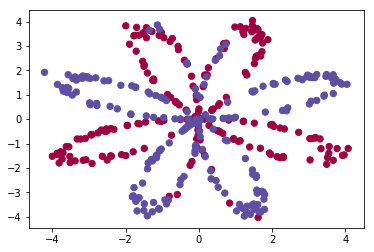

In [46]:
# Visualize the data:
plt.scatter(X[0, :], X[1, :], c=Y, s=40, cmap=plt.cm.Spectral);

You have:
    - a numpy-array (matrix) X that contains your features (x1, x2)
    - a numpy-array (vector) Y that contains your labels (red:0, blue:1).

Lets first get a better sense of what our data is like. 

**Exercise**: How many training examples do you have? In addition, what is the `shape` of the variables `X` and `Y`? 

**Hint**: How do you get the shape of a numpy array? [(help)](https://docs.scipy.org/doc/numpy/reference/generated/numpy.ndarray.shape.html)

In [47]:
### START CODE HERE ### (≈ 3 lines of code)
shape_X = X.shape
shape_Y = Y.shape
m = shape_X[1]  # training set size
### END CODE HERE ###

print ('The shape of X is: ' + str(shape_X))
print ('The shape of Y is: ' + str(shape_Y))
print ('I have m = %d training examples!' % (m))

The shape of X is: (2, 400)
The shape of Y is: (1, 400)
I have m = 400 training examples!


**Expected Output**:
       
<table style="width:20%">
  
  <tr>
    <td>**shape of X**</td>
    <td> (2, 400) </td> 
  </tr>
  
  <tr>
    <td>**shape of Y**</td>
    <td>(1, 400) </td> 
  </tr>
  
    <tr>
    <td>**m**</td>
    <td> 400 </td> 
  </tr>
  
</table>

## 3 - Simple Logistic Regression

Before building a full neural network, lets first see how logistic regression performs on this problem. You can use sklearn's built-in functions to do that. Run the code below to train a logistic regression classifier on the dataset.

In [48]:
# Train the logistic regression classifier
clf = sklearn.linear_model.LogisticRegressionCV();
clf.fit(X.T, Y.T);

You can now plot the decision boundary of these models. Run the code below.

Accuracy of logistic regression: 47 % (percentage of correctly labelled datapoints)


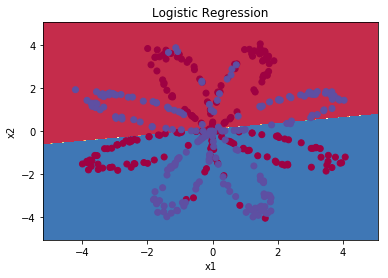

In [49]:
# Plot the decision boundary for logistic regression
plot_decision_boundary(lambda x: clf.predict(x), X, Y)
plt.title("Logistic Regression")

# Print accuracy
LR_predictions = clf.predict(X.T)
print ('Accuracy of logistic regression: %d ' % float((np.dot(Y,LR_predictions) + np.dot(1-Y,1-LR_predictions))/float(Y.size)*100) +
       '% ' + "(percentage of correctly labelled datapoints)")

**Expected Output**:

<table style="width:20%">
  <tr>
    <td>**Accuracy**</td>
    <td> 47% </td> 
  </tr>
  
</table>


**Interpretation**: The dataset is not linearly separable, so logistic regression doesn't perform well. Hopefully a neural network will do better. Let's try this now! 

## 4 - Neural Network model

Logistic regression did not work well on the "flower dataset". You are going to train a Neural Network with a single hidden layer.

**Here is our model**:
<img src="images/classification_kiank.png" style="width:600px;height:300px;">

**Mathematically**:

For one example $x^{(i)}$:
$$z^{[1] (i)} =  W^{[1]} x^{(i)} + b^{[1]}\tag{1}$$ 
$$a^{[1] (i)} = \tanh(z^{[1] (i)})\tag{2}$$
$$z^{[2] (i)} = W^{[2]} a^{[1] (i)} + b^{[2]}\tag{3}$$
$$\hat{y}^{(i)} = a^{[2] (i)} = \sigma(z^{ [2] (i)})\tag{4}$$
$$y^{(i)}_{prediction} = \begin{cases} 1 & \mbox{if } a^{[2](i)} > 0.5 \\ 0 & \mbox{otherwise } \end{cases}\tag{5}$$

Given the predictions on all the examples, you can also compute the cost $J$ as follows: 
$$J = - \frac{1}{m} \sum\limits_{i = 0}^{m} \large\left(\small y^{(i)}\log\left(a^{[2] (i)}\right) + (1-y^{(i)})\log\left(1- a^{[2] (i)}\right)  \large  \right) \small \tag{6}$$

**Reminder**: The general methodology to build a Neural Network is to:
    1. Define the neural network structure ( # of input units,  # of hidden units, etc). 
    2. Initialize the model's parameters
    3. Loop:
        - Implement forward propagation
        - Compute loss
        - Implement backward propagation to get the gradients
        - Update parameters (gradient descent)

You often build helper functions to compute steps 1-3 and then merge them into one function we call `nn_model()`. Once you've built `nn_model()` and learnt the right parameters, you can make predictions on new data.

### 4.1 - Defining the neural network structure ####

**Exercise**: Define three variables:
    - n_x: the size of the input layer
    - n_h: the size of the hidden layer (set this to 4) 
    - n_y: the size of the output layer

**Hint**: Use shapes of X and Y to find n_x and n_y. Also, hard code the hidden layer size to be 4.

In [50]:
# GRADED FUNCTION: layer_sizes

def layer_sizes(X, Y):
    """
    Arguments:
    X -- input dataset of shape (input size, number of examples)
    Y -- labels of shape (output size, number of examples)
    
    Returns:
    n_x -- the size of the input layer
    n_h -- the size of the hidden layer
    n_y -- the size of the output layer
    """
    ### START CODE HERE ### (≈ 3 lines of code)
    n_x = X.shape[0] # size of input layer
    n_h = 4
    n_y = Y.shape[0] # size of output layer
    ### END CODE HERE ###
    return (n_x, n_h, n_y)

In [51]:
X_assess, Y_assess = layer_sizes_test_case()
(n_x, n_h, n_y) = layer_sizes(X_assess, Y_assess)
print("The size of the input layer is: n_x = " + str(n_x))
print("The size of the hidden layer is: n_h = " + str(n_h))
print("The size of the output layer is: n_y = " + str(n_y))

The size of the input layer is: n_x = 5
The size of the hidden layer is: n_h = 4
The size of the output layer is: n_y = 2


**Expected Output** (these are not the sizes you will use for your network, they are just used to assess the function you've just coded).

<table style="width:20%">
  <tr>
    <td>**n_x**</td>
    <td> 5 </td> 
  </tr>
  
    <tr>
    <td>**n_h**</td>
    <td> 4 </td> 
  </tr>
  
    <tr>
    <td>**n_y**</td>
    <td> 2 </td> 
  </tr>
  
</table>

### 4.2 - Initialize the model's parameters ####

**Exercise**: Implement the function `initialize_parameters()`.

**Instructions**:
- Make sure your parameters' sizes are right. Refer to the neural network figure above if needed.
- You will initialize the weights matrices with random values. 
    - Use: `np.random.randn(a,b) * 0.01` to randomly initialize a matrix of shape (a,b).
- You will initialize the bias vectors as zeros. 
    - Use: `np.zeros((a,b))` to initialize a matrix of shape (a,b) with zeros.

In [52]:
# GRADED FUNCTION: initialize_parameters

def initialize_parameters(n_x, n_h, n_y):
    """
    Argument:
    n_x -- size of the input layer
    n_h -- size of the hidden layer
    n_y -- size of the output layer
    
    Returns:
    params -- python dictionary containing your parameters:
                    W1 -- weight matrix of shape (n_h, n_x)
                    b1 -- bias vector of shape (n_h, 1)
                    W2 -- weight matrix of shape (n_y, n_h)
                    b2 -- bias vector of shape (n_y, 1)
    """
    
    np.random.seed(2) # we set up a seed so that your output matches ours although the initialization is random.
    
    ### START CODE HERE ### (≈ 4 lines of code)
    W1 = np.random.randn(n_h,n_x)* 0.01
    b1 = np.zeros((n_h,1))
    W2 = np.random.randn(n_y,n_h)* 0.01
    b2 = np.zeros((n_y,1))
    ### END CODE HERE ###
    
    assert (W1.shape == (n_h, n_x))
    assert (b1.shape == (n_h, 1))
    assert (W2.shape == (n_y, n_h))
    assert (b2.shape == (n_y, 1))
    
    parameters = {"W1": W1,
                  "b1": b1,
                  "W2": W2,
                  "b2": b2}
    
    return parameters

In [53]:
n_x, n_h, n_y = initialize_parameters_test_case()

parameters = initialize_parameters(n_x, n_h, n_y)
print("W1 = " + str(parameters["W1"]))
print("b1 = " + str(parameters["b1"]))
print("W2 = " + str(parameters["W2"]))
print("b2 = " + str(parameters["b2"]))

W1 = [[-0.00416758 -0.00056267]
 [-0.02136196  0.01640271]
 [-0.01793436 -0.00841747]
 [ 0.00502881 -0.01245288]]
b1 = [[ 0.]
 [ 0.]
 [ 0.]
 [ 0.]]
W2 = [[-0.01057952 -0.00909008  0.00551454  0.02292208]]
b2 = [[ 0.]]


**Expected Output**:

<table style="width:90%">
  <tr>
    <td>**W1**</td>
    <td> [[-0.00416758 -0.00056267]
 [-0.02136196  0.01640271]
 [-0.01793436 -0.00841747]
 [ 0.00502881 -0.01245288]] </td> 
  </tr>
  
  <tr>
    <td>**b1**</td>
    <td> [[ 0.]
 [ 0.]
 [ 0.]
 [ 0.]] </td> 
  </tr>
  
  <tr>
    <td>**W2**</td>
    <td> [[-0.01057952 -0.00909008  0.00551454  0.02292208]]</td> 
  </tr>
  

  <tr>
    <td>**b2**</td>
    <td> [[ 0.]] </td> 
  </tr>
  
</table>



### 4.3 - The Loop ####

**Question**: Implement `forward_propagation()`.

**Instructions**:
- Look above at the mathematical representation of your classifier.
- You can use the function `sigmoid()`. It is built-in (imported) in the notebook.
- You can use the function `np.tanh()`. It is part of the numpy library.
- The steps you have to implement are:
    1. Retrieve each parameter from the dictionary "parameters" (which is the output of `initialize_parameters()`) by using `parameters[".."]`.
    2. Implement Forward Propagation. Compute $Z^{[1]}, A^{[1]}, Z^{[2]}$ and $A^{[2]}$ (the vector of all your predictions on all the examples in the training set).
- Values needed in the backpropagation are stored in "`cache`". The `cache` will be given as an input to the backpropagation function.

In [54]:
# GRADED FUNCTION: forward_propagation

def forward_propagation(X, parameters):
    """
    Argument:
    X -- input data of size (n_x, m)
    parameters -- python dictionary containing your parameters (output of initialization function)
    
    Returns:
    A2 -- The sigmoid output of the second activation
    cache -- a dictionary containing "Z1", "A1", "Z2" and "A2"
    """
    # Retrieve each parameter from the dictionary "parameters"
    ### START CODE HERE ### (≈ 4 lines of code)
    W1 = parameters['W1']
    b1 = parameters['b1']
    W2 = parameters['W2']
    b2 = parameters['b2']
    ### END CODE HERE ###
    
    # Implement Forward Propagation to calculate A2 (probabilities)
    ### START CODE HERE ### (≈ 4 lines of code)
    Z1 = np.dot(W1,X)+b1 
    A1 = np.tanh(Z1)
    Z2 = np.dot(W2,A1)+b2
    A2 = sigmoid(Z2)
    ### END CODE HERE ###
    
    assert(A2.shape == (1, X.shape[1]))
    
    cache = {"Z1": Z1,
             "A1": A1,
             "Z2": Z2,
             "A2": A2}
    print(Z1)
    print(A1)
    print(Z2)
    print(A2)
    return A2, cache

In [55]:
X_assess, parameters = forward_propagation_test_case()
A2, cache = forward_propagation(X_assess, parameters)

# Note: we use the mean here just to make sure that your output matches ours. 
print(np.mean(cache['Z1']) ,np.mean(cache['A1']),np.mean(cache['Z2']),np.mean(cache['A2']))

[[ 1.7386459   1.74687437  1.74830797]
 [-0.81350569 -0.73394355 -0.78767559]
 [ 0.29893918  0.32272601  0.34788465]
 [-0.2278403  -0.2632236  -0.22336567]]
[[ 0.9400694   0.94101876  0.94118266]
 [-0.67151964 -0.62547205 -0.65709025]
 [ 0.29034152  0.31196971  0.33449821]
 [-0.22397799 -0.25730819 -0.2197236 ]]
[[-1.30737426 -1.30844761 -1.30717618]]
[[ 0.21292656  0.21274673  0.21295976]]
0.262818640198 0.091999045227 -1.30766601287 0.212877681719


**Expected Output**:
<table style="width:50%">
  <tr>
    <td> 0.262818640198 0.091999045227 -1.30766601287 0.212877681719 </td> 
  </tr>
</table>

Now that you have computed $A^{[2]}$ (in the Python variable "`A2`"), which contains $a^{[2](i)}$ for every example, you can compute the cost function as follows:

$$J = - \frac{1}{m} \sum\limits_{i = 0}^{m} \large{(} \small y^{(i)}\log\left(a^{[2] (i)}\right) + (1-y^{(i)})\log\left(1- a^{[2] (i)}\right) \large{)} \small\tag{13}$$

**Exercise**: Implement `compute_cost()` to compute the value of the cost $J$.

**Instructions**:
- There are many ways to implement the cross-entropy loss. To help you, we give you how we would have implemented
$- \sum\limits_{i=0}^{m}  y^{(i)}\log(a^{[2](i)})$:
```python
logprobs = np.multiply(np.log(A2),Y)
cost = - np.sum(logprobs)                # no need to use a for loop!
```

(you can use either `np.multiply()` and then `np.sum()` or directly `np.dot()`).


In [56]:
# GRADED FUNCTION: compute_cost

def compute_cost(A2, Y, parameters):
    """
    Computes the cross-entropy cost given in equation (13)
    
    Arguments:
    A2 -- The sigmoid output of the second activation, of shape (1, number of examples)
    Y -- "true" labels vector of shape (1, number of examples)
    parameters -- python dictionary containing your parameters W1, b1, W2 and b2
    
    Returns:
    cost -- cross-entropy cost given equation (13)
    """
    
    m = Y.shape[1] # number of example

    # Compute the cross-entropy cost
    ### START CODE HERE ### (≈ 2 lines of code)
    logprobs = np.multiply(np.log(1-A2),(1-Y)) + np.multiply(np.log(A2),Y)
    cost = - np.sum(logprobs)/m
    ### END CODE HERE ###
    
    cost = np.squeeze(cost)     # makes sure cost is the dimension we expect. 
                                # E.g., turns [[17]] into 17 
    assert(isinstance(cost, float))
    
    return cost

In [57]:
A2, Y_assess, parameters = compute_cost_test_case()

print("cost = " + str(compute_cost(A2, Y_assess, parameters)))

cost = 0.693058761039


**Expected Output**:
<table style="width:20%">
  <tr>
    <td>**cost**</td>
    <td> 0.693058761... </td> 
  </tr>
  
</table>

Using the cache computed during forward propagation, you can now implement backward propagation.

**Question**: Implement the function `backward_propagation()`.

**Instructions**:
Backpropagation is usually the hardest (most mathematical) part in deep learning. To help you, here again is the slide from the lecture on backpropagation. You'll want to use the six equations on the right of this slide, since you are building a vectorized implementation.  

<img src="images/grad_summary.png" style="width:600px;height:300px;">

<!--
$\frac{\partial \mathcal{J} }{ \partial z_{2}^{(i)} } = \frac{1}{m} (a^{[2](i)} - y^{(i)})$

$\frac{\partial \mathcal{J} }{ \partial W_2 } = \frac{\partial \mathcal{J} }{ \partial z_{2}^{(i)} } a^{[1] (i) T} $

$\frac{\partial \mathcal{J} }{ \partial b_2 } = \sum_i{\frac{\partial \mathcal{J} }{ \partial z_{2}^{(i)}}}$

$\frac{\partial \mathcal{J} }{ \partial z_{1}^{(i)} } =  W_2^T \frac{\partial \mathcal{J} }{ \partial z_{2}^{(i)} } * ( 1 - a^{[1] (i) 2}) $

$\frac{\partial \mathcal{J} }{ \partial W_1 } = \frac{\partial \mathcal{J} }{ \partial z_{1}^{(i)} }  X^T $

$\frac{\partial \mathcal{J} _i }{ \partial b_1 } = \sum_i{\frac{\partial \mathcal{J} }{ \partial z_{1}^{(i)}}}$

- Note that $*$ denotes elementwise multiplication.
- The notation you will use is common in deep learning coding:
    - dW1 = $\frac{\partial \mathcal{J} }{ \partial W_1 }$
    - db1 = $\frac{\partial \mathcal{J} }{ \partial b_1 }$
    - dW2 = $\frac{\partial \mathcal{J} }{ \partial W_2 }$
    - db2 = $\frac{\partial \mathcal{J} }{ \partial b_2 }$
    
!-->

- Tips:
    - To compute dZ1 you'll need to compute $g^{[1]'}(Z^{[1]})$. Since $g^{[1]}(.)$ is the tanh activation function, if $a = g^{[1]}(z)$ then $g^{[1]'}(z) = 1-a^2$. So you can compute 
    $g^{[1]'}(Z^{[1]})$ using `(1 - np.power(A1, 2))`.

In [58]:
# GRADED FUNCTION: backward_propagation

def backward_propagation(parameters, cache, X, Y):
    """
    Implement the backward propagation using the instructions above.
    
    Arguments:
    parameters -- python dictionary containing our parameters 
    cache -- a dictionary containing "Z1", "A1", "Z2" and "A2".
    X -- input data of shape (2, number of examples)
    Y -- "true" labels vector of shape (1, number of examples)
    
    Returns:
    grads -- python dictionary containing your gradients with respect to different parameters
    """
    m = X.shape[1]
    
    # First, retrieve W1 and W2 from the dictionary "parameters".
    ### START CODE HERE ### (≈ 2 lines of code)
    W1 = parameters['W1']
    W2 = parameters['W2']
    ### END CODE HERE ###
        
    # Retrieve also A1 and A2 from dictionary "cache".
    ### START CODE HERE ### (≈ 2 lines of code)
    A1 = cache['A1']
    A2 = cache['A2']
    ### END CODE HERE ###
    
    # Backward propagation: calculate dW1, db1, dW2, db2. 
    ### START CODE HERE ### (≈ 6 lines of code, corresponding to 6 equations on slide above)
    dZ2 = A2-Y
    dW2 = np.dot(dZ2,A1.T)/m 
    db2 = np.sum(dZ2,axis=1,keepdims=True)/m
    dZ1 = np.dot(W2.T,dZ2)*(1 - np.power(A1, 2))
    dW1 = np.dot(dZ1,X.T)/m
    db1 = np.sum(dZ1,axis=1,keepdims=True)/m
    ### END CODE HERE ###
    
    grads = {"dW1": dW1,
             "db1": db1,
             "dW2": dW2,
             "db2": db2}
    
    return grads

In [59]:
parameters, cache, X_assess, Y_assess = backward_propagation_test_case()

grads = backward_propagation(parameters, cache, X_assess, Y_assess)
print ("dW1 = "+ str(grads["dW1"]))
print ("db1 = "+ str(grads["db1"]))
print ("dW2 = "+ str(grads["dW2"]))
print ("db2 = "+ str(grads["db2"]))

dW1 = [[ 0.00301023 -0.00747267]
 [ 0.00257968 -0.00641288]
 [-0.00156892  0.003893  ]
 [-0.00652037  0.01618243]]
db1 = [[ 0.00176201]
 [ 0.00150995]
 [-0.00091736]
 [-0.00381422]]
dW2 = [[ 0.00078841  0.01765429 -0.00084166 -0.01022527]]
db2 = [[-0.16655712]]


**Expected output**:



<table style="width:80%">
  <tr>
    <td>**dW1**</td>
    <td> [[ 0.00301023 -0.00747267]
 [ 0.00257968 -0.00641288]
 [-0.00156892  0.003893  ]
 [-0.00652037  0.01618243]] </td> 
  </tr>
  
  <tr>
    <td>**db1**</td>
    <td>  [[ 0.00176201]
 [ 0.00150995]
 [-0.00091736]
 [-0.00381422]] </td> 
  </tr>
  
  <tr>
    <td>**dW2**</td>
    <td> [[ 0.00078841  0.01765429 -0.00084166 -0.01022527]] </td> 
  </tr>
  

  <tr>
    <td>**db2**</td>
    <td> [[-0.16655712]] </td> 
  </tr>
  
</table>  

**Question**: Implement the update rule. Use gradient descent. You have to use (dW1, db1, dW2, db2) in order to update (W1, b1, W2, b2).

**General gradient descent rule**: $ \theta = \theta - \alpha \frac{\partial J }{ \partial \theta }$ where $\alpha$ is the learning rate and $\theta$ represents a parameter.

**Illustration**: The gradient descent algorithm with a good learning rate (converging) and a bad learning rate (diverging). Images courtesy of Adam Harley.

<img src="images/sgd.gif" style="width:400;height:400;"> <img src="images/sgd_bad.gif" style="width:400;height:400;">



In [60]:
# GRADED FUNCTION: update_parameters

def update_parameters(parameters, grads, learning_rate = 1.2):
    """
    Updates parameters using the gradient descent update rule given above
    
    Arguments:
    parameters -- python dictionary containing your parameters 
    grads -- python dictionary containing your gradients 
    
    Returns:
    parameters -- python dictionary containing your updated parameters 
    """
    # Retrieve each parameter from the dictionary "parameters"
    ### START CODE HERE ### (≈ 4 lines of code)
    W1 = parameters['W1']
    b1 = parameters['b1']
    W2 = parameters['W2']
    b2 = parameters['b2']
    ### END CODE HERE ###
    
    # Retrieve each gradient from the dictionary "grads"
    ### START CODE HERE ### (≈ 4 lines of code)
    dW1 = grads['dW1']
    db1 = grads['db1']
    dW2 = grads['dW2']
    db2 = grads['db2']
    ## END CODE HERE ###
    
    # Update rule for each parameter
    ### START CODE HERE ### (≈ 4 lines of code)
    W1 = W1-learning_rate*dW1
    b1 = b1-learning_rate*db1
    W2 = W2-learning_rate*dW2
    b2 = b2-learning_rate*db2
    ### END CODE HERE ###
    
    parameters = {"W1": W1,
                  "b1": b1,
                  "W2": W2,
                  "b2": b2}
    
    return parameters

In [61]:
parameters, grads = update_parameters_test_case()
parameters = update_parameters(parameters, grads)

print("W1 = " + str(parameters["W1"]))
print("b1 = " + str(parameters["b1"]))
print("W2 = " + str(parameters["W2"]))
print("b2 = " + str(parameters["b2"]))

W1 = [[-0.00643025  0.01936718]
 [-0.02410458  0.03978052]
 [-0.01653973 -0.02096177]
 [ 0.01046864 -0.05990141]]
b1 = [[ -1.02420756e-06]
 [  1.27373948e-05]
 [  8.32996807e-07]
 [ -3.20136836e-06]]
W2 = [[-0.01041081 -0.04463285  0.01758031  0.04747113]]
b2 = [[ 0.00010457]]


**Expected Output**:


<table style="width:80%">
  <tr>
    <td>**W1**</td>
    <td> [[-0.00643025  0.01936718]
 [-0.02410458  0.03978052]
 [-0.01653973 -0.02096177]
 [ 0.01046864 -0.05990141]]</td> 
  </tr>
  
  <tr>
    <td>**b1**</td>
    <td> [[ -1.02420756e-06]
 [  1.27373948e-05]
 [  8.32996807e-07]
 [ -3.20136836e-06]]</td> 
  </tr>
  
  <tr>
    <td>**W2**</td>
    <td> [[-0.01041081 -0.04463285  0.01758031  0.04747113]] </td> 
  </tr>
  

  <tr>
    <td>**b2**</td>
    <td> [[ 0.00010457]] </td> 
  </tr>
  
</table>  

### 4.4 - Integrate parts 4.1, 4.2 and 4.3 in nn_model() ####

**Question**: Build your neural network model in `nn_model()`.

**Instructions**: The neural network model has to use the previous functions in the right order.

In [62]:
# GRADED FUNCTION: nn_model

def nn_model(X, Y, n_h, num_iterations = 10000, print_cost=False):
    """
    Arguments:
    X -- dataset of shape (2, number of examples)
    Y -- labels of shape (1, number of examples)
    n_h -- size of the hidden layer
    num_iterations -- Number of iterations in gradient descent loop
    print_cost -- if True, print the cost every 1000 iterations
    
    Returns:
    parameters -- parameters learnt by the model. They can then be used to predict.
    """
    
    np.random.seed(3)
    n_x = layer_sizes(X, Y)[0]
    n_y = layer_sizes(X, Y)[2]
    
    # Initialize parameters, then retrieve W1, b1, W2, b2. Inputs: "n_x, n_h, n_y". Outputs = "W1, b1, W2, b2, parameters".
    ### START CODE HERE ### (≈ 5 lines of code)
    parameters = initialize_parameters(n_x, n_h, n_y)
    W1 = parameters['W1']
    b1 = parameters['b1']
    W2 = parameters['W2']
    b2 = parameters['b2']
    ### END CODE HERE ###
    
    # Loop (gradient descent)

    for i in range(0, num_iterations):
         
        ### START CODE HERE ### (≈ 4 lines of code)
        # Forward propagation. Inputs: "X, parameters". Outputs: "A2, cache".
        A2, cache = forward_propagation(X, parameters)
        
        # Cost function. Inputs: "A2, Y, parameters". Outputs: "cost".
        cost = compute_cost(A2, Y, parameters)
 
        # Backpropagation. Inputs: "parameters, cache, X, Y". Outputs: "grads".
        grads = backward_propagation(parameters, cache, X, Y)
 
        # Gradient descent parameter update. Inputs: "parameters, grads". Outputs: "parameters".
        parameters = update_parameters(parameters, grads)
        
        ### END CODE HERE ###
        
        # Print the cost every 1000 iterations
        if print_cost and i % 1000 == 0:
            print ("Cost after iteration %i: %f" %(i, cost))

    return parameters

In [63]:
X_assess, Y_assess = nn_model_test_case()
parameters = nn_model(X_assess, Y_assess, 4, num_iterations=10000, print_cost=True)
print("W1 = " + str(parameters["W1"]))
print("b1 = " + str(parameters["b1"]))
print("W2 = " + str(parameters["W2"]))
print("b2 = " + str(parameters["b2"]))

[[-0.00616586  0.00206261  0.0034962 ]
 [-0.05229879  0.02726335 -0.02646868]
 [-0.0200999   0.00368691  0.02884556]
 [ 0.02153008 -0.01385323  0.02600471]]
[[-0.00616578  0.0020626   0.00349619]
 [-0.05225116  0.02725659 -0.0264625 ]
 [-0.0200972   0.00368689  0.02883756]
 [ 0.02152676 -0.01385234  0.02599885]]
[[ 0.00092281 -0.00056678  0.00095853]]
[[ 0.5002307   0.49985831  0.50023963]]
Cost after iteration 0: 0.692739
[[-0.02376939  0.00991831 -0.01734867]
 [-0.06739606  0.03400488 -0.044357  ]
 [-0.01092842 -0.00040685  0.03970388]
 [ 0.05965262 -0.03086809  0.07114251]]
[[-0.02376491  0.00991798 -0.01734693]
 [-0.0672942   0.03399178 -0.04432793]
 [-0.01092799 -0.00040685  0.03968303]
 [ 0.05958197 -0.03085829  0.07102273]]
[[ 0.20420533  0.19763649  0.20416889]]
[[ 0.55087467  0.54924892  0.55086565]]
[[-0.04142233  0.01858667 -0.0380584 ]
 [-0.11363305  0.05673389 -0.09863635]
 [-0.00093654 -0.00531371  0.05141909]
 [ 0.11337948 -0.05728468  0.13412687]]
[[-0.04139866  0.01858

 [ 0.94089647 -0.88791004  0.95057099]]
[[ 4.44247413 -3.48826404  4.52271134]]
[[ 0.98837006  0.02964801  0.98925712]]
[[-1.15785319  0.89566921 -1.22842232]
 [-1.70744422  1.37436358 -1.77927622]
 [ 0.7912491  -0.60449898  0.89598206]
 [ 1.75579019 -1.42218802  1.84739075]]
[[-0.82033902  0.71418258 -0.84212109]
 [-0.93633322  0.87968285 -0.94461726]
 [ 0.65911606 -0.5402432   0.71433583]
 [ 0.94203095 -0.89005449  0.95149961]]
[[ 4.50885265 -3.56043417  4.58887356]]
[[ 0.98910884  0.02764075  0.98993797]]
[[-1.17111614  0.90779178 -1.24183098]
 [-1.71709298  1.38414652 -1.78878773]
 [ 0.80492449 -0.61593597  0.90991877]
 [ 1.76505564 -1.43166079  1.85641756]]
[[-0.82462965  0.72007069 -0.84597699]
 [-0.93751203  0.88187639 -0.94563248]
 [ 0.66678084 -0.54829208  0.72109326]
 [ 0.94306498 -0.89200644  0.95234668]]
[[ 4.57132268 -3.62825215  4.65112462]]
[[ 0.98976164  0.02587526  0.9905395 ]]
[[-1.18351771  0.9191295  -1.25436602]
 [-1.7260875   1.3932509  -1.79765801]
 [ 0.81781174 

[[-0.88099674  0.80014355 -0.8962738 ]
 [-0.95326911  0.91099871 -0.95925988]
 [ 0.77533175 -0.66901133  0.8149833 ]
 [ 0.95696416 -0.91798828  0.96380308]]
[[ 5.64619704 -4.78238057  5.72046264]]
[[ 0.9964815   0.00830646  0.99673252]]
[[-1.38401786  1.10249781 -1.45679505]
 [-1.86912496  1.53602304 -1.93923395]
 [ 1.03792362 -0.81266897  1.14609836]
 [ 1.91115325 -1.57865734  1.99938214]]
[[-0.88184779  0.80139445 -0.89702834]
 [-0.95351473  0.91144967 -0.95947322]
 [ 0.7770668  -0.67105996  0.81645742]
 [ 0.95718217 -0.91839195  0.9639839 ]]
[[ 5.66750502 -4.80505513  5.74163738]]
[[ 0.99655543  0.00812175  0.99680076]]
[[-1.38774344  1.10590279 -1.46055444]
 [-1.87175942  1.5386172  -1.94185092]
 [ 1.04219182 -0.81630556  1.15040594]
 [ 1.9136874  -1.58116805  2.00187274]]
[[-0.88267343  0.80260931 -0.89776023]
 [-0.95375336  0.91188771 -0.95968051]
 [ 0.77875212 -0.67305405  0.81788851]
 [ 0.95739403 -0.91878411  0.96415965]]
[[ 5.68837772 -4.82725985  5.76237903]]
[[ 0.99662634  

[[ 6.04983937 -5.21078593  6.1215032 ]]
[[ 0.99764731  0.00542776  0.99780965]]
[[-1.4529906   1.16550436 -1.52639341]
 [-1.91787364  1.58382496 -1.98771498]
 [ 1.11774978 -0.88087267  1.22657181]
 [ 1.95806386 -1.62492664  2.04554675]]
[[-0.89628264  0.82282563 -0.90980538]
 [-0.95774175  0.91919715 -0.96314928]
 [ 0.80678479 -0.70685623  0.84158207]
 [ 0.96094182 -0.92533568  0.9671081 ]]
[[ 6.0642223  -5.22600901  6.13579105]]
[[ 0.99768083  0.0053462   0.99784066]]
[[-1.45538678  1.16769202 -1.5288114 ]
 [-1.91956721  1.58547812 -1.98940137]
 [ 1.12055134 -0.88327356  1.22939286]
 [ 1.9596943  -1.62652702  2.04715353]]
[[-0.8967529   0.82353088 -0.91022097]
 [-0.95788163  0.91945312 -0.96327108]
 [ 0.8077606  -0.70805549  0.84240313]
 [ 0.9610665  -0.9255654   0.96721191]]
[[ 6.07840416 -5.24101655  6.14987906]]
[[ 0.99771341  0.00526698  0.9978708 ]]
[[-1.4577454   1.16984528 -1.53119148]
 [-1.92123429  1.58710494 -1.99106151]
 [ 1.12331066 -0.88563873  1.23217117]
 [ 1.96129928 -

[[ 6.33788784 -5.51513775  6.40763033]]
[[ 0.99823509  0.00400923  0.99835379]]
[[-1.50019578  1.20858445 -1.5740303 ]
 [-1.95125471  1.61631921 -2.02098032]
 [ 1.17324115 -0.92851769  1.28241252]
 [ 1.99021002 -1.65638703  2.07725434]]
[[-0.90518363  0.83625437 -0.91766447]
 [-0.96041687  0.92408843 -0.96548026]
 [ 0.82530843 -0.72990205  0.85712637]
 [ 0.96332934 -0.92972889  0.96909796]]
[[ 6.34872858 -5.52657104  6.41839826]]
[[ 0.99825408  0.00396384  0.99837139]]
[[-1.50194056  1.21017607 -1.57579115]
 [-1.95248951  1.61751761 -2.02221187]
 [ 1.17530354 -0.93029209  1.28448647]
 [ 1.99139953 -1.65754744  2.07842873]]
[[-0.90549831  0.8367323  -0.91794205]
 [-0.96051258  0.92426327 -0.96556372]
 [ 0.82596494 -0.73073005  0.85767568]
 [ 0.96341488 -0.92988608  0.96916934]]
[[ 6.35945426 -5.53788151  6.42905187]]
[[ 0.99827268  0.00391943  0.99838862]]
[[-1.50366459  1.2117487  -1.57753107]
 [-1.9537097   1.61870158 -2.02342893]
 [ 1.17734214 -0.93204626  1.2865364 ]
 [ 1.992575   -

[[-1.53713945  1.24227419 -1.61131629]
 [-1.97742158  1.64166132 -2.04709399]
 [ 1.2170611  -0.96627357  1.32645765]
 [ 2.01542344 -1.68092874  2.10216419]]
[[-0.91163844  0.84610296 -0.92335431]
 [-0.96239719  0.92770445 -0.96720806]
 [ 0.83878512 -0.74706216  0.86838089]
 [ 0.96510121 -0.93298197  0.97057768]]
[[ 6.57911108 -5.7691985   6.64723047]]
[[ 0.99861284  0.00311254  0.99870407]]
[[-1.53848868  1.24350414 -1.61267811]
 [-1.9783782   1.64258569 -2.04804927]
 [ 1.21866711 -0.96765951  1.32807112]
 [ 2.01634545 -1.68182403  2.10307576]]
[[-0.91186606  0.84645204 -0.92355481]
 [-0.96246771  0.92783317 -0.96726963]
 [ 0.83926056 -0.74767397  0.86877711]
 [ 0.96516439 -0.93309785  0.97063048]]
[[ 6.58765673 -5.77818578  6.6557186 ]]
[[ 0.99862463  0.00308478  0.99871501]]
[[-1.5398251   1.2447224  -1.614027  ]
 [-1.97932581  1.64350121 -2.0489956 ]
 [ 1.22025824 -0.96903276  1.3296696 ]
 [ 2.0172588  -1.68271076  2.10397881]]
[[-0.91209097  0.84679708 -0.92375291]
 [-0.96253744  0

[[ 0.99882453  0.00261621  0.99890062]]
[[-1.56417595  1.26691508 -1.63860645]
 [-1.99660634  1.66017187 -2.06626016]
 [ 1.24931089 -0.99413352  1.35884741]
 [ 2.03391769 -1.69885847  2.12045782]]
[[-0.9160944   0.85295934 -0.92727751]
 [-0.96378703  0.93024033 -0.9684218 ]
 [ 0.84809029 -0.75911936  0.87612547]
 [ 0.96634716 -0.93526622  0.97161971]]
[[ 6.75216145 -5.95102115  6.81911778]]
[[ 0.99883301  0.00259642  0.99890851]]
[[-1.56528818  1.26792851 -1.63972919]
 [-1.99739632  1.66093286 -2.06704973]
 [ 1.25064049 -0.99528345  1.36018234]
 [ 2.03467939 -1.69959566  2.12121165]]
[[-0.91627303  0.85323522 -0.9274347 ]
 [-0.96384317  0.93034273 -0.96847084]
 [ 0.84846315 -0.7596062   0.87643535]
 [ 0.96639753 -0.9353585   0.97166186]]
[[ 6.75936266 -5.95857968  6.8262707 ]]
[[ 0.99884138  0.00257692  0.99891628]]
[[-1.56639151  1.26893381 -1.64084294]
 [-1.99818003  1.66168772 -2.06783308]
 [ 1.25195966 -0.99642447  1.36150677]
 [ 2.03543507 -1.70032691  2.12195955]]
[[-0.91644988  

[[ 0.99898669  0.00223946  0.99905135]]
[[-1.58677491  1.28750262 -1.66141975]
 [-2.01267036  1.67562772 -2.08232157]
 [ 1.27636715 -1.01755407  1.3860056 ]
 [ 2.04940925 -1.71383205  2.13579536]]
[[-0.91965337  0.85847106 -0.93040817]
 [-0.9649119   0.93229185 -0.96940479]
 [ 0.85551399 -0.76886842  0.88228898]
 [ 0.96735708 -0.93711602  0.97246525]]
[[ 6.89977472 -6.1058382   6.96574387]]
[[ 0.998993    0.00222485  0.99905723]]
[[-1.5877182   1.28836177 -1.66237204]
 [-2.01334149  1.6762726  -2.08299285]
 [ 1.27749826 -1.01853412  1.38714068]
 [ 2.05005658 -1.71445686  2.13643653]]
[[-0.91979874  0.85869688 -0.93053598]
 [-0.96495814  0.93237617 -0.96944521]
 [ 0.85581694 -0.7692688   0.88254022]
 [ 0.96739863 -0.93719208  0.97250005]]
[[ 6.90599582 -6.11235737  6.97192351]]
[[ 0.99899924  0.00221043  0.99906303]]
[[-1.58865496  1.28921497 -1.66331773]
 [-2.01400803  1.676913   -2.08365955]
 [ 1.27862168 -1.01950757  1.38826802]
 [ 2.05069949 -1.71507733  2.13707334]]
[[-0.91994285  

[[ 7.02295387 -6.234837    7.08810462]]
[[ 0.9991096   0.00195611  0.99916572]]
[[-1.60613961  1.30513748 -1.68096989]
 [-2.02645858  1.68886321 -2.09611676]
 [ 1.29961365 -1.03771083  1.40932912]
 [ 2.06271036 -1.72665662  2.14897423]]
[[-0.92258752  0.86303988 -0.9329873 ]
 [-0.96584999  0.93400226 -0.97022499]
 [ 0.86162367 -0.77698248  0.88735158]
 [ 0.96820039 -0.93865959  0.97317192]]
[[ 7.02845901 -6.24059823  7.09357333]]
[[ 0.99911449  0.0019449   0.99917026]]
[[-1.60695672  1.30588147 -1.68179486]
 [-2.02704089  1.68942156 -2.09669955]
 [ 1.3005957  -1.03856304  1.41031421]
 [ 2.06327219 -1.72719768  2.14953109]]
[[-0.92270904  0.86322959 -0.93309408]
 [-0.96588906  0.9340735  -0.97025916]
 [ 0.86187643 -0.77731999  0.88756084]
 [ 0.96823553 -0.9387239   0.97320138]]
[[ 7.03393414 -6.24632771  7.09901223]]
[[ 0.99911932  0.00193381  0.99917476]]
[[-1.60776885  1.30662092 -1.6826148 ]
 [-2.0276197   1.68997651 -2.09727885]
 [ 1.30157185 -1.03941019  1.41129338]
 [ 2.06383064 -

[[ 7.13759707 -6.3547432   7.2019917 ]]
[[ 0.99920597  0.00173546  0.99925545]]
[[-1.62304789  1.3205308  -1.69804144]
 [-2.038517    1.70041565 -2.10818811]
 [ 1.31995233 -1.05537184  1.42972761]
 [ 2.07434606 -1.73785204  2.16051042]]
[[-0.92506513  0.86691587 -0.93516378]
 [-0.96665016  0.93546101 -0.9709249 ]
 [ 0.86677207 -0.78388606  0.89161077]
 [ 0.9689205  -0.93997703  0.9737758 ]]
[[ 7.14250947 -6.35987785  7.20687184]]
[[ 0.99920986  0.00172659  0.99925908]]
[[-1.62376737  1.32118573 -1.6987679 ]
 [-2.03903054  1.70090718 -2.10870233]
 [ 1.32081856 -1.05612455  1.43059624]
 [ 2.07484166 -1.73832841  2.16100193]]
[[-0.92516885  0.8670785  -0.93525487]
 [-0.96668383  0.93552238 -0.97095436]
 [ 0.86698735 -0.78417608  0.89178872]
 [ 0.96895081 -0.94003247  0.97380123]]
[[ 7.14739794 -6.36498723  7.21172821]]
[[ 0.99921371  0.00171781  0.99926266]]
[[-1.62448295  1.32183709 -1.69949041]
 [-2.03954131  1.70139603 -2.1092138 ]
 [ 1.32168013 -1.05687327  1.43146018]
 [ 2.0753346  -

 [ 0.96949269 -0.94102349  0.97425592]]
[[ 7.23602036 -6.45756902  7.2997708 ]]
[[ 0.99928035  0.00156615  0.99932476]]
[[-1.63738543  1.33358057 -1.71251845]
 [-2.04875717  1.71021002 -2.11844414]
 [ 1.33722501 -1.07038913  1.44704581]
 [ 2.08422967 -1.74734497  2.17031486]]
[[-0.92710618  0.87012173 -0.93695581]
 [-0.96731518  0.93667331 -0.97150681]
 [ 0.87100412 -0.78960778  0.89510718]
 [ 0.96951955 -0.94107261  0.97427847]]
[[ 7.24047466 -6.46222006  7.30419606]]
[[ 0.99928354  0.00155889  0.99932774]]
[[-1.63803045  1.33416759 -1.71316976]
 [-2.04921819  1.71065063 -2.11890598]
 [ 1.33800259 -1.07106558  1.44782533]
 [ 2.0846747  -1.74777205  2.17075643]]
[[-0.92719673  0.87026423 -0.93703529]
 [-0.96734481  0.93672732 -0.97153274]
 [ 0.87119166 -0.78986234  0.89526203]
 [ 0.96954625 -0.94112144  0.97430088]]
[[ 7.24490926 -6.46685032  7.30860176]]
[[ 0.99928671  0.0015517   0.9993307 ]]
[[-1.63867228  1.3347517  -1.71381786]
 [-2.04967697  1.71108907 -2.11936558]
 [ 1.33877638 

[[ 0.999342    0.0014265   0.99938225]]
[[-1.65029973  1.34533257 -1.72555916]
 [-2.05799336  1.71903175 -2.12769843]
 [ 1.35280129 -1.08394613  1.46265916]
 [ 2.09314621 -1.75589621  2.1791641 ]]
[[-0.92889874  0.87294713 -0.93852895]
 [-0.96790381  0.93774634 -0.97202202]
 [ 0.87471286 -0.79465789  0.89816783]
 [ 0.97005022 -0.94204289  0.97472399]]
[[ 7.32971539 -6.5553573   7.39285731]]
[[ 0.99934467  0.00142045  0.99938474]]
[[-1.65088365  1.3458639  -1.72614882]
 [-2.05841127  1.71943063 -2.12811725]
 [ 1.35350596 -1.08455976  1.46336541]
 [ 2.0935497  -1.75628288  2.17956464]]
[[-0.92897878  0.8730735  -0.93859917]
 [-0.96793019  0.93779444 -0.97204512]
 [ 0.87487827 -0.79488391  0.89830426]
 [ 0.97007402 -0.94208639  0.97474397]]
[[ 7.33377306 -6.5595901   7.39688874]]
[[ 0.99934732  0.00141446  0.99938722]]
[[-1.65146494  1.34639282 -1.72673582]
 [-2.05882732  1.71982772 -2.1285342 ]
 [ 1.35420747 -1.08517069  1.4640685 ]
 [ 2.0939514  -1.75666782  2.1799634 ]]
[[-0.92905837  

[[-0.93091448  0.87613559 -0.94029713]
 [-0.96857104  0.93896274 -0.9726062 ]
 [ 0.87887302 -0.80036372  0.90159721]
 [ 0.97065228 -0.94314346  0.97522971]]
[[ 7.43388752 -6.66397018  7.49635875]]
[[ 0.99940946  0.00127444  0.99944521]]
[[-1.66572181  1.35936392 -1.74113321]
 [-2.06903947  1.72956714 -2.13877081]
 [ 1.37142208 -1.10017101  1.48131949]
 [ 2.10381245 -1.76610985  2.18975491]]
[[-0.9309838   0.87624546 -0.94035792]
 [-0.96859409  0.93900476 -0.97262639]
 [ 0.87901588 -0.80056044  0.90171491]
 [ 0.97067309 -0.94318149  0.97524719]]
[[ 7.43754526 -6.66778177  7.49999306]]
[[ 0.99941162  0.0012696   0.99944722]]
[[-1.66623962  1.35983498 -1.74165613]
 [-2.06941066  1.72992089 -2.13914298]
 [ 1.37204761 -1.1007164   1.48194626]
 [ 2.10417093 -1.76645283  2.19011095]]
[[-0.93105277  0.87635479 -0.94041841]
 [-0.96861703  0.93904658 -0.97264648]
 [ 0.87915801 -0.8007562   0.90183199]
 [ 0.9706938  -0.94321935  0.97526459]]
[[ 7.4411897  -6.67157935  7.50361416]]
[[ 0.99941376  

 [ 2.11651323 -1.77825013  2.20237293]]
[[-0.9333847   0.88005976 -0.94246278]
 [-0.9693968   0.94046831 -0.97332941]
 [ 0.88395415 -0.8073935   0.90578041]
 [ 0.97139814 -0.94450664  0.97585659]]
[[ 7.5674811  -6.80309192  7.62910197]]
[[ 0.99948327  0.00110911  0.99951414]]
[[-1.68449462  1.37644009 -1.76009244]
 [-2.08251078  1.74239408 -2.15228083]
 [ 1.39411319 -1.11996897  1.5040521 ]
 [ 2.11682413 -1.77854702  2.2026819 ]]
[[-0.93344238  0.88015161 -0.94251333]
 [-0.96941619  0.94050367 -0.9733464 ]
 [ 0.88407255 -0.80755812  0.90587782]
 [ 0.97141566 -0.94453867  0.97587133]]
[[ 7.57068279 -6.80642383  7.63228342]]
[[ 0.99948492  0.00110542  0.99951568]]
[[-1.68494105  1.37684612 -1.76054332]
 [-2.08283148  1.74269916 -2.15260254]
 [ 1.39465308 -1.12044037  1.50459289]
 [ 2.11713394 -1.77884286  2.20298979]]
[[-0.9334998   0.88024307 -0.94256366]
 [-0.9694355   0.94053888 -0.97336331]
 [ 0.88419041 -0.80772204  0.90597478]
 [ 0.97143312 -0.94457057  0.975886  ]]
[[ 7.57387427 -

 [ 2.12311229 -1.78454896  2.20893196]]
[[-0.93459794  0.88199407 -0.94352593]
 [-0.96980576  0.94121409 -0.97368768]
 [ 0.88644207 -0.81086068  0.90782653]
 [ 0.97176785 -0.9451823   0.97616749]]
[[ 7.63565604 -6.87401693  7.69684744]]
[[ 0.99951731  0.00103325  0.99954595]]
[[-1.69396575  1.38505381 -1.76965821]
 [-2.08931821  1.74886715 -2.15911054]
 [ 1.40556978 -1.12997582  1.51552696]
 [ 2.12340082 -1.78482423  2.20921879]]
[[-0.93465046  0.88207792 -0.94357195]
 [-0.96982352  0.94124647 -0.97370324]
 [ 0.88654965 -0.81101099  0.90791497]
 [ 0.97178391 -0.94521165  0.97618099]]
[[ 7.63864726 -6.87712772  7.69981988]]
[[ 0.99951875  0.00103004  0.9995473 ]]
[[-1.69437964  1.38543021 -1.77007625]
 [-2.08961587  1.74915006 -2.15940921]
 [ 1.40607054 -1.13041339  1.51602848]
 [ 2.12368841 -1.78509859  2.20950468]]
[[-0.93470276  0.88216143 -0.94361778]
 [-0.96984121  0.94127873 -0.97371874]
 [ 0.88665678 -0.8111607   0.90800304]
 [ 0.97179991 -0.94524088  0.97619445]]
[[ 7.64162957 -

[[-1.70276704  1.39305755 -1.7785478 ]
 [-2.09565101  1.75488376 -2.16546568]
 [ 1.41622047 -1.13928536  1.52619308]
 [ 2.12951989 -1.7906593   2.2153026 ]]
[[-0.93575408  0.88384176 -0.94453876]
 [-0.97019765  0.94192882 -0.97403105]
 [ 0.88880781 -0.81417331  0.90977086]
 [ 0.97212234 -0.9458301   0.97646567]]
[[ 7.70228883 -6.94329184  7.76306348]]
[[  9.99548412e-01   9.64156949e-04   9.99575029e-01]]
[[-1.70315262  1.39340817 -1.77893726]
 [-2.0959286   1.75514738 -2.16574428]
 [ 1.41668716 -1.13969343  1.52666041]
 [ 2.12978813 -1.79091498  2.21556933]]
[[-0.93580202  0.88391846 -0.94458074]
 [-0.97021395  0.94195854 -0.97404533]
 [ 0.88890578 -0.81431084  0.90985136]
 [ 0.97213708 -0.94585705  0.97647807]]
[[ 7.70508764 -6.94620066  7.76584486]]
[[  9.99549674e-01   9.61359160e-04   9.99576208e-01]]
[[-1.703537    1.3937577  -1.7793255 ]
 [-2.09620534  1.75541018 -2.16602203]
 [ 1.4171524  -1.14010024  1.52712629]
 [ 2.13005555 -1.79116986  2.21583526]]
[[-0.93584977  0.88399488

[[-1.71134396  1.40085655 -1.78721108]
 [-2.10182882  1.76074844 -2.17166675]
 [ 1.42660314 -1.14836674  1.53658939]
 [ 2.13549007 -1.79634751  2.22124001]]
[[-0.93681223  0.88553665 -0.94546545]
 [-0.97055823  0.94258654 -0.97434703]
 [ 0.89096837 -0.81721229  0.91154548]
 [ 0.97244867 -0.94642646  0.97674025]]
[[ 7.7647604  -7.00819994  7.82514714]]
[[  9.99575749e-01   9.03617895e-04   9.99600600e-01]]
[[-1.71170364  1.40118359 -1.78757439]
 [-2.10208804  1.76099442 -2.17192697]
 [ 1.42703862 -1.14874777  1.53702541]
 [ 2.1357406  -1.79658609  2.2214892 ]]
[[-0.93685623  0.88560722 -0.94550399]
 [-0.97057326  0.94261397 -0.9743602 ]
 [ 0.89105812 -0.81733882  0.91161917]
 [ 0.97246228 -0.94645133  0.9767517 ]]
[[ 7.76739004 -7.01093129  7.82776051]]
[[  9.99576862e-01   9.01155392e-04   9.99601642e-01]]
[[-1.71206227  1.40150968 -1.78793664]
 [-2.10234651  1.76123968 -2.17218645]
 [ 1.42747283 -1.1491277   1.53746016]
 [ 2.1359904  -1.79682399  2.22173766]]
[[-0.93690008  0.88567753

[[-1.72103602  1.40966881 -1.79700111]
 [-2.10881771  1.76737762 -2.17868368]
 [ 1.43833931 -1.15863923  1.54833933]
 [ 2.1422451  -1.80277779  2.22795988]]
[[-0.93798766  0.88742378 -0.94649457]
 [-0.97096096  0.9433213  -0.9747    ]
 [ 0.89336293 -0.82059592  0.91351107]
 [ 0.97281336 -0.94709292  0.9770472 ]]
[[ 7.83589692 -7.08206362  7.89584532]]
[[  9.99604869e-01   8.39332769e-04   9.99627851e-01]]
[[-1.72136834  1.40997094 -1.79733679]
 [-2.10905749  1.76760496 -2.17892445]
 [ 1.43874177 -1.15899163  1.54874224]
 [ 2.14247688 -1.80299832  2.22819049]]
[[-0.93802759  0.88748796 -0.94652952]
 [-0.97097468  0.94334633 -0.97471203]
 [ 0.89344416 -0.82071099  0.91357773]
 [ 0.97282579 -0.94711563  0.97705766]]
[[ 7.83834628 -7.08460599  7.89827965]]
[[  9.99605835e-01   8.37203371e-04   9.99628756e-01]]
[[-1.72169975  1.41027226 -1.79767156]
 [-2.10929662  1.76783168 -2.17916458]
 [ 1.43914314 -1.15934309  1.54914405]
 [ 2.14270804 -1.80321825  2.22842048]]
[[-0.93806738  0.88755193

 [ 2.14979584 -1.8099585   2.23547368]]
[[-0.93927464  0.88949538 -0.94762098]
 [-0.97140464  0.94413093 -0.97508892]
 [ 0.89597772 -0.82430976  0.915656  ]
 [ 0.97321538 -0.94782763  0.97738568]]
[[ 7.91598342 -7.16516081  7.97544271]]
[[  9.99635268e-01   7.72457502e-04   9.99656315e-01]]
[[-1.73215795  1.41978024 -1.80823593]
 [-2.11684814  1.77498773 -2.18674856]
 [ 1.45181069 -1.17043998  1.56182445]
 [ 2.1500082  -1.81016034  2.23568504]]
[[-0.93931043  0.88955307 -0.94765229]
 [-0.97141702  0.94415352 -0.97509977]
 [ 0.89605033 -0.82441317  0.91571553]
 [ 0.9732266  -0.94784814  0.97739513]]
[[ 7.91824451 -7.16750598  7.97769005]]
[[  9.99636092e-01   7.70649471e-04   9.99657087e-01]]
[[-1.73246119  1.42005591 -1.80854225]
 [-2.11706725  1.77519527 -2.18696864]
 [ 1.45217803 -1.17076191  1.56219214]
 [ 2.15022003 -1.81036168  2.23589587]]
[[-0.93934611  0.88961059 -0.94768352]
 [-0.97142936  0.94417605 -0.97511059]
 [ 0.89612271 -0.82451627  0.91577488]
 [ 0.97323779 -0.94786859

[[  9.99651060e-01   7.37817142e-04   9.99671108e-01]]
[[-1.73808235  1.42516601 -1.81422066]
 [-2.12113044  1.77904289 -2.19105018]
 [ 1.45898791 -1.17673126  1.56900811]
 [ 2.15414853 -1.81409458  2.2398062 ]]
[[-0.94000384  0.89067169 -0.94825902]
 [-0.97165732  0.94459212 -0.97531044]
 [ 0.89745585 -0.82641811  0.91686784]
 [ 0.97344445 -0.94824631  0.9775786 ]]
[[ 7.96242457 -7.21331923  8.0216024 ]]
[[  9.99651814e-01   7.36165451e-04   9.99671814e-01]]
[[-1.73837105  1.42542846 -1.81451231]
 [-2.1213392   1.77924053 -2.1912599 ]
 [ 1.45933768 -1.17703793  1.56935818]
 [ 2.15435038 -1.81428633  2.24000714]]
[[-0.94003744  0.89072592 -0.94828841]
 [-0.97166898  0.94461341 -0.97532067]
 [ 0.89752389 -0.82651531  0.91692361]
 [ 0.97345503 -0.94826564  0.9775875 ]]
[[ 7.96458316 -7.21555713  8.02374794]]
[[  9.99652564e-01   7.34521041e-04   9.99672517e-01]]
[[-1.73865906  1.42569028 -1.81480326]
 [-2.12154748  1.77943769 -2.19146913]
 [ 1.45968662 -1.17734388  1.56970741]
 [ 2.15455

 [ 2.16601484 -1.82535843  2.25162161]]
[[-0.94194567  0.89381333 -0.94995748]
 [-0.97233492  0.94582929 -0.97590458]
 [ 0.90137929 -0.83204644  0.92008217]
 [ 0.97405919 -0.94936998  0.97809649]]
[[ 8.09005732 -7.34556496  8.14846995]]
[[  9.99693522e-01   6.45032277e-04   9.99710906e-01]]
[[-1.75528372  1.44080231 -1.83159798]
 [-2.13358281  1.79082322 -2.20356243]
 [ 1.47983039 -1.19501722  1.58986591]
 [ 2.16619045 -1.825525    2.25179651]]
[[-0.94197391  0.89385912 -0.94998217]
 [-0.97234483  0.94584738 -0.97591327]
 [ 0.90143621 -0.83212843  0.92012877]
 [ 0.97406818 -0.94938642  0.97810406]]
[[ 8.09195743 -7.34753258  8.15035876]]
[[  9.99694103e-01   6.43765162e-04   9.99711451e-01]]
[[-1.75553372  1.44102955 -1.83185055]
 [-2.133764    1.79099451 -2.20374453]
 [ 1.48013334 -1.19528319  1.59016905]
 [ 2.16636569 -1.82569121  2.25197105]]
[[-0.94200207  0.89390479 -0.9500068 ]
 [-0.97235471  0.94586542 -0.97592193]
 [ 0.90149297 -0.83221022  0.92017525]
 [ 0.97407715 -0.94940282

[[ 8.14013359 -7.397409    8.19824938]]
[[  9.99708487e-01   6.12463228e-04   9.99724941e-01]]
[[-1.76185508  1.44677536 -1.83823685]
 [-2.13834746  1.7953263  -2.20835143]
 [ 1.48779362 -1.20201006  1.5978337 ]
 [ 2.17079899 -1.82989486  2.2563869 ]]
[[-0.94270984  0.89505341 -0.95062562]
 [-0.97260352  0.94631986 -0.97614013]
 [ 0.90291795 -0.83426669  0.92134182]
 [ 0.97430304 -0.94981579  0.97830199]]
[[ 8.14194094 -7.39927971  8.20004605]]
[[  9.99709013e-01   6.11319257e-04   9.99725434e-01]]
[[-1.76209159  1.44699033 -1.83847579]
 [-2.13851902  1.79548839 -2.20852388]
 [ 1.48808022 -1.2022618   1.59812045]
 [ 2.17096494 -1.83005217  2.25655221]]
[[-0.94273615  0.89509615 -0.95064862]
 [-0.97261279  0.9463368  -0.97614826]
 [ 0.90297088 -0.8343432   0.92138514]
 [ 0.97431146 -0.94983118  0.97830909]]
[[ 8.14374502 -7.40114702  8.20183948]]
[[  9.99709537e-01   6.10179500e-04   9.99725926e-01]]
[[-1.76232762  1.44720487 -1.83871424]
 [-2.13869024  1.79565016 -2.20869599]
 [ 1.4883

[[  9.99732660e-01   5.60008719e-04   9.99747621e-01]]
[[-1.77313359  1.45702657 -1.84963157]
 [-2.14653501  1.80305879 -2.2165826 ]
 [ 1.50146133 -1.21402043  1.61150763]
 [ 2.17871949 -1.83739931  2.26427822]]
[[-0.94395186  0.89707356 -0.95171125]
 [-0.97304249  0.94712186 -0.97652513]
 [ 0.90541198 -0.83788144  0.92338251]
 [ 0.97470179 -0.95054489  0.97863813]]
[[ 8.22837858 -7.48871229  8.28597599]]
[[  9.99733102e-01   5.59050081e-04   9.99748037e-01]]
[[-1.77334845  1.45722186 -1.84984865]
 [-2.14669111  1.80320615 -2.21673956]
 [ 1.50172171 -1.21424933  1.6117681 ]
 [ 2.17887051 -1.83754234  2.26442872]]
[[-0.94397526  0.89711168 -0.9517317 ]
 [-0.97305079  0.94713703 -0.97653241]
 [ 0.90545889 -0.83794963  0.92342089]
 [ 0.97470933 -0.95055868  0.97864449]]
[[ 8.23003331 -7.49042368  8.28762105]]
[[  9.99733544e-01   5.58094681e-04   9.99748451e-01]]
[[-1.77356292  1.45741679 -1.85006534]
 [-2.14684693  1.80335324 -2.21689623]
 [ 1.50198161 -1.21447782  1.6120281 ]
 [ 2.17902

[[  9.99751608e-01   5.19031582e-04   9.99765410e-01]]
[[-1.7826291   1.46565687 -1.85922526]
 [-2.15343808  1.80957287 -2.22352419]
 [ 1.51296809 -1.22413991  1.62301808]
 [ 2.18539861 -1.84372199  2.2709347 ]]
[[-0.94497722  0.89874571 -0.9526072 ]
 [-0.97340719  0.94778843 -0.97684504]
 [ 0.90746436 -0.84087113  0.92506083]
 [ 0.97503329 -0.95115115  0.97891766]]
[[ 8.30179488 -7.56461835  8.35896562]]
[[  9.99751990e-01   5.18206530e-04   9.99765768e-01]]
[[-1.78282716  1.46583688 -1.85942537]
 [-2.15358216  1.80970878 -2.22366909]
 [ 1.51320809 -1.22435105  1.62325814]
 [ 2.18553803 -1.84385391  2.27107366]]
[[-0.94499841  0.89878031 -0.95262572]
 [-0.97341475  0.94780225 -0.97685167]
 [ 0.90750671 -0.84093297  0.92509546]
 [ 0.97504016 -0.95116372  0.97892345]]
[[ 8.30333248 -7.56620757  8.36049433]]
[[  9.99752371e-01   5.17384066e-04   9.99766126e-01]]
[[-1.78302487  1.46601658 -1.85962513]
 [-2.153726    1.80984446 -2.22381375]
 [ 1.51344768 -1.22456184  1.62349779]
 [ 2.18567

[[-0.94592808  0.90030001 -0.95343782]
 [-0.97374733  0.9484103  -0.97714342]
 [ 0.90936207 -0.84364787  0.92661188]
 [ 0.97534263 -0.95171699  0.97917856]]
[[ 8.37161996 -7.636766    8.42838882]]
[[  9.99768713e-01   4.82153386e-04   9.99781474e-01]]
[[-1.79177295  1.47396735 -1.86846393]
 [-2.16009417  1.81584939 -2.2302189 ]
 [ 1.52404794 -1.23389089  1.63410018]
 [ 2.1918398  -1.8498147   2.27735572]]
[[-0.94594736  0.90033157 -0.95345466]
 [-0.97375424  0.94842295 -0.97714949]
 [ 0.9094005  -0.84370422  0.92664328]
 [ 0.97534892 -0.9517285   0.97918387]]
[[ 8.37305384 -7.63824712  8.42981449]]
[[  9.99769044e-01   4.81440131e-04   9.99781786e-01]]
[[-1.79195595  1.47413368 -1.86864884]
 [-2.16022747  1.81597505 -2.23035299]
 [ 1.52426968 -1.2340861   1.63432195]
 [ 2.19196881 -1.84993668  2.27748435]]
[[-0.94596661  0.90036307 -0.95347147]
 [-0.97376115  0.94843558 -0.97715554]
 [ 0.90943885 -0.84376047  0.92667461]
 [ 0.9753552  -0.95173999  0.97918916]]
[[ 8.37448567 -7.63972609

[[  9.99782445e-01   4.52627725e-04   9.99794377e-01]]
[[-1.79956159  1.48104603 -1.87633354]
 [-2.16577057  1.82119869 -2.23592935]
 [ 1.5334847  -1.24220121  1.64353788]
 [ 2.19733375 -1.85500782  2.28283373]]
[[-0.94676059  0.90166378 -0.95416486]
 [-0.97404668  0.9489578  -0.97740604]
 [ 0.91101903 -0.84608222  0.92796552]
 [ 0.97561502 -0.95221535  0.97940835]]
[[ 8.43419008 -7.70138024  8.49060208]]
[[  9.99782738e-01   4.51998208e-04   9.99794653e-01]]
[[-1.7997326   1.48120146 -1.87650633]
 [-2.16589528  1.82131618 -2.23605481]
 [ 1.53369188 -1.24238372  1.64374508]
 [ 2.19745445 -1.85512188  2.2829541 ]]
[[-0.94677831  0.90169284 -0.95418033]
 [-0.97405306  0.94896949 -0.97741165]
 [ 0.91105426 -0.84613407  0.92799429]
 [ 0.97562083 -0.95222599  0.97941325]]
[[ 8.43553697 -7.70277075  8.49194132]]
[[  9.99783031e-01   4.51370421e-04   9.99794927e-01]]
[[-1.79990335  1.48135665 -1.87667887]
 [-2.1660198   1.82143349 -2.23618009]
 [ 1.53389876 -1.24256596  1.64395196]
 [ 2.19757

[[ 8.49434088 -7.76346343  8.55041273]]
[[  9.99795419e-01   4.24801600e-04   9.99806572e-01]]
[[-1.80733456  1.48811044 -1.8841875 ]
 [-2.17144188  1.82654014 -2.24163568]
 [ 1.54290132 -1.25049871  1.65295456]
 [ 2.20282351 -1.86019376  2.28830872]]
[[-0.94756032  0.90297646 -0.95486308]
 [-0.97433563  0.94948648 -0.97765957]
 [ 0.91260661 -0.84842343  0.92926195]
 [ 0.97587808 -0.95269674  0.97963031]]
[[ 8.49560911 -7.76477206  8.55167382]]
[[  9.99795678e-01   4.24246292e-04   9.99806816e-01]]
[[-1.80749432  1.48825564 -1.88434893]
 [-2.17155851  1.82664995 -2.24175304]
 [ 1.54309484 -1.25066929  1.65314807]
 [ 2.20293641 -1.86030038  2.28842133]]
[[-0.94757663  0.90300327 -0.95487733]
 [-0.97434154  0.94949729 -0.97766476]
 [ 0.91263895 -0.84847121  0.92928835]
 [ 0.97588346 -0.95270659  0.97963485]]
[[ 8.49687573 -7.76607901  8.55293331]]
[[  9.99795937e-01   4.23692418e-04   9.99807059e-01]]
[[-1.80765385  1.48840063 -1.88451012]
 [-2.17167498  1.82675962 -2.24187024]
 [ 1.5432

 [ 2.20775591 -1.86485051  2.29322882]]
[[-0.94826803  0.90414029 -0.95548083]
 [-0.97459251  0.94995662 -0.97788497]
 [ 0.91400806 -0.85049741  0.93040593]
 [ 0.97611204 -0.95312498  0.97982776]]
[[ 8.55107431 -7.82199041  8.60682796]]
[[  9.99806700e-01   4.00662492e-04   9.99817180e-01]]
[[-1.81446026  1.49458658 -1.89138759]
 [-2.17664654  1.83143946 -2.24687336]
 [ 1.55153254 -1.25810848  1.66158508]
 [ 2.20786221 -1.86495084  2.29333486]]
[[-0.94828317  0.90416521 -0.95549405]
 [-0.97459802  0.94996671 -0.9778898 ]
 [ 0.914038   -0.8505418   0.93043037]
 [ 0.97611705 -0.95313416  0.97983199]]
[[ 8.55227256 -7.82322623  8.60801951]]
[[  9.99806932e-01   4.00167848e-04   9.99817398e-01]]
[[-1.8146103   1.49472295 -1.8915392 ]
 [-2.17675618  1.83154264 -2.24698371]
 [ 1.55171427 -1.25826874  1.66176678]
 [ 2.20796837 -1.86505103  2.29344076]]
[[-0.94829828  0.90419009 -0.95550724]
 [-0.97460352  0.94997677 -0.97789462]
 [ 0.9140679  -0.85058612  0.93045477]
 [ 0.97612206 -0.95314334

 [ 2.21230645 -1.86914451  2.2977688 ]]
[[-0.94891199  0.90520109 -0.95604282]
 [-0.97482723  0.95038633 -0.97809092]
 [ 0.91528037 -0.85238626  0.93144415]
 [ 0.97632589 -0.9535165   0.98000827]]
[[ 8.60248266 -7.87499985  8.65795017]]
[[  9.99816384e-01   3.79984571e-04   9.99826290e-01]]
[[-1.8208803   1.50042143 -1.89787478]
 [-2.18134042  1.83585585 -2.25159773]
 [ 1.55930782 -1.26496714  1.66935911]
 [ 2.21240697 -1.86923934  2.29786909]]
[[-0.94892612  0.90522438 -0.95605515]
 [-0.97483239  0.95039578 -0.97809545]
 [ 0.91530825 -0.85242772  0.9314669 ]
 [ 0.9763306  -0.95352511  0.98001224]]
[[ 8.60362082 -7.87617321  8.65908202]]
[[  9.99816593e-01   3.79539145e-04   9.99826487e-01]]
[[-1.82102205  1.50055025 -1.898018  ]
 [-2.1814441   1.83595339 -2.25170209]
 [ 1.55947947 -1.26511859  1.66953072]
 [ 2.21250736 -1.86933405  2.29796926]]
[[-0.94894023  0.90524764 -0.95606746]
 [-0.97483754  0.95040522 -0.97809997]
 [ 0.91533609 -0.85246912  0.93148961]
 [ 0.97633529 -0.95353371

 [ 0.97653108 -0.95389223  0.98018149]]
[[ 8.65245772 -7.92650963  8.70764909]]
[[  9.99825334e-01   3.60914088e-04   9.99834711e-01]]
[[-1.8270881   1.50606343 -1.90414759]
 [-2.18588335  1.84012836 -2.25617078]
 [ 1.56682483 -1.27160116  1.67687436]
 [ 2.21680606 -1.87338841  2.30225871]]
[[-0.94954041  0.90623796 -0.95659113]
 [-0.97505718  0.95080746 -0.97829271]
 [ 0.91651923 -0.85423102  0.93245476]
 [ 0.9765355  -0.95390032  0.98018522]]
[[ 8.65354036 -7.92762529  8.70872577]]
[[  9.99825523e-01   3.60511803e-04   9.99834889e-01]]
[[-1.82722222  1.50618533 -1.90428312]
 [-2.18598155  1.84022069 -2.25626964]
 [ 1.56698722 -1.27174451  1.67703671]
 [ 2.21690115 -1.87347808  2.3023536 ]]
[[-0.94955361  0.90625975 -0.95660264]
 [-0.97506202  0.95081632 -0.97829696]
 [ 0.91654521 -0.85426976  0.93247595]
 [ 0.97653991 -0.9539084   0.98018894]]
[[ 8.65462183 -7.92873972  8.70980128]]
[[  9.99825711e-01   3.60110404e-04   9.99835066e-01]]
[[-1.82735618  1.50630708 -1.90441849]
 [-2.186

[[ 8.70211424 -7.97767005  8.75703318]]
[[  9.99833794e-01   3.42920118e-04   9.99842674e-01]]
[[-1.83322414  1.5116403  -1.910348  ]
 [-2.19037789  1.84435358 -2.26069572]
 [ 1.57425364 -1.27816043  1.68430093]
 [ 2.22115876 -1.87749185  2.30660272]]
[[-0.95014053  0.90722971 -0.95711464]
 [-0.97527763  0.95121131 -0.97848617]
 [ 0.91769973 -0.85599402  0.93341745]
 [ 0.97673651 -0.95426849  0.98035494]]
[[ 8.70314439 -7.97873118  8.7580577 ]]
[[  9.99833965e-01   3.42556552e-04   9.99842835e-01]]
[[-1.8333511   1.51175569 -1.91047629]
 [-2.19047092  1.84444102 -2.26078939]
 [ 1.57440733 -1.27829616  1.68445457]
 [ 2.22124886 -1.87757678  2.30669266]]
[[-0.95015287  0.90725012 -0.9571254 ]
 [-0.97528217  0.95121964 -0.97849016]
 [ 0.91772398 -0.85603029  0.93343722]
 [ 0.97674066 -0.95427608  0.98035844]]
[[ 8.70417348 -7.97979121  8.75908117]]
[[  9.99834135e-01   3.42193749e-04   9.99842996e-01]]
[[-1.83347791  1.51187095 -1.91060443]
 [-2.19056386  1.84452837 -2.26088296]
 [ 1.5745

 [ 0.97692565 -0.95461499  0.98051466]]
[[ 8.75040068 -8.02739899  8.80505659]]
[[  9.99841627e-01   3.26289567e-04   9.99850050e-01]]
[[-1.83916038  1.51703568 -1.91634659]
 [-2.19473     1.84844327 -2.26507783]
 [ 1.58143921 -1.28450784  1.69148385]
 [ 2.22537398 -1.88146394  2.31081017]]
[[-0.95071449  0.90817968 -0.95761523]
 [-0.97548926  0.95159913 -0.9786719 ]
 [ 0.91882636 -0.85768133  0.93433595]
 [ 0.97692956 -0.95462214  0.98051795]]
[[ 8.75138223 -8.02840966  8.80603281]]
[[  9.99841783e-01   3.25960069e-04   9.99850196e-01]]
[[-1.83928074  1.51714508 -1.91646821]
 [-2.19481828  1.84852621 -2.26516673]
 [ 1.58158488 -1.28463656  1.69162947]
 [ 2.22545949 -1.8815445   2.31089553]]
[[-0.95072606  0.90819884 -0.95762532]
 [-0.97549353  0.95160696 -0.97867565]
 [ 0.91884904 -0.85771535  0.93435444]
 [ 0.97693346 -0.95462929  0.98052125]]
[[ 8.75236282 -8.02941933  8.80700808]]
[[  9.99841938e-01   3.25631230e-04   9.99850342e-01]]
[[-1.83940097  1.51725435 -1.91658971]
 [-2.194

[[  9.99848471e-01   3.11785458e-04   9.99856495e-01]]
[[-1.84456586  1.52194876 -1.92180891]
 [-2.19869637  1.85216909 -2.26907201]
 [ 1.58798105 -1.29028912  1.69802288]
 [ 2.22921597 -1.88508286  2.31464563]]
[[-0.95123152  0.90903667 -0.95806609]
 [-0.97568057  0.95194982 -0.9788398 ]
 [ 0.9198392  -0.85920224  0.93516145]
 [ 0.97710413 -0.95494202  0.98066539]]
[[ 8.79552137 -8.07385001  8.84993316]]
[[  9.99848613e-01   3.11484324e-04   9.99856629e-01]]
[[-1.84468049  1.52205294 -1.92192474]
 [-2.19878051  1.85224812 -2.26915674]
 [ 1.58811976 -1.29041173  1.69816153]
 [ 2.22929748 -1.88515962  2.31472701]]
[[-0.95124242  0.90905476 -0.9580756 ]
 [-0.97568462  0.95195723 -0.97884335]
 [ 0.91986055 -0.85923433  0.93517885]
 [ 0.97710782 -0.95494878  0.9806685 ]]
[[ 8.79645958 -8.0748157   8.85086631]]
[[  9.99848755e-01   3.11183765e-04   9.99856763e-01]]
[[-1.84479499  1.52215702 -1.92204045]
 [-2.19886457  1.85232706 -2.2692414 ]
 [ 1.58825833 -1.29053421  1.69830003]
 [ 2.22937

[[  9.99855009e-01   2.97953002e-04   9.99862654e-01]]
[[-1.84993773  1.5268314  -1.92723732]
 [-2.20264129  1.85587349 -2.27304502]
 [ 1.59448097 -1.2960357   1.70451962]
 [ 2.23303756 -1.88868119  2.31846122]]
[[-0.95174009  0.90988079 -0.9585095 ]
 [-0.97586939  0.95229604 -0.97900552]
 [ 0.92083355 -0.86069912  0.93597168]
 [ 0.97727648 -0.95525789  0.98081096]]
[[ 8.83958963 -8.11920133  8.89376455]]
[[  9.99855139e-01   2.97677745e-04   9.99862777e-01]]
[[-1.8500469   1.52693063 -1.92734764]
 [-2.20272149  1.85594879 -2.2731258 ]
 [ 1.59461305 -1.2961525   1.70465163]
 [ 2.23311527 -1.88875434  2.31853881]]
[[-0.95175037  0.90989787 -0.95851847]
 [-0.97587321  0.95230305 -0.97900887]
 [ 0.92085363 -0.86072939  0.93598805]
 [ 0.97727997 -0.95526429  0.98081391]]
[[ 8.84048735 -8.12012502  8.89465747]]
[[  9.99855269e-01   2.97402991e-04   9.99862899e-01]]
[[-1.85015597  1.52702977 -1.92745786]
 [-2.20280162  1.85602402 -2.27320651]
 [ 1.594745   -1.29626918  1.70478352]
 [ 2.23319

[[ 8.88007156 -8.16084787  8.93403025]]
[[  9.99860885e-01   2.85538569e-04   9.99868192e-01]]
[[-1.85495504  1.5313919  -1.9323075 ]
 [-2.20632875  1.85933499 -2.27675914]
 [ 1.60055067 -1.30140405  1.71058602]
 [ 2.23661007 -1.89204378  2.32202858]]
[[-0.95221043  0.91066248 -0.95891951]
 [-0.97604457  0.95261736 -0.97915927]
 [ 0.9217514  -0.86208417  0.9367194 ]
 [ 0.97743644 -0.95555112  0.98094608]]
[[ 8.88093363 -8.16173459  8.93488772]]
[[  9.99861005e-01   2.85285560e-04   9.99868305e-01]]
[[-1.85505934  1.5314867  -1.9324129 ]
 [-2.20640544  1.85940696 -2.27683638]
 [ 1.60067683 -1.30151565  1.71071211]
 [ 2.23668437 -1.8921137   2.32210277]]
[[-0.95222016  0.91067867 -0.95892799]
 [-0.9760482   0.95262401 -0.97916246]
 [ 0.92177037 -0.86211283  0.93673485]
 [ 0.97743975 -0.9555572   0.98094888]]
[[ 8.88179496 -8.16262054  8.93574446]]
[[  9.99861125e-01   2.85032994e-04   9.99868417e-01]]
[[-1.85516354  1.53158142 -1.93251819]
 [-2.20648205  1.85947887 -2.27691355]
 [ 1.6008

[[ 8.91980515 -8.20171156  8.97355284]]
[[  9.99866304e-01   2.74108729e-04   9.99873299e-01]]
[[-1.85975253  1.53575271 -1.93715559]
 [-2.20985731  1.86264631 -2.28031354]
 [ 1.6063533  -1.30653811  1.71638519]
 [ 2.24002893 -1.89526066  2.3254429 ]]
[[-0.95265597  0.9114039  -0.95930784]
 [-0.97621103  0.95292276 -0.97930537]
 [ 0.92261932 -0.86339683  0.93742628]
 [ 0.97758847 -0.95582988  0.98107453]]
[[ 8.9206336  -8.20256344  8.97437691]]
[[  9.99866414e-01   2.73875385e-04   9.99873403e-01]]
[[-1.85985235  1.53584345 -1.93725646]
 [-2.20993075  1.86271523 -2.28038753]
 [ 1.60647402 -1.30664494  1.71650584]
 [ 2.24010009 -1.89532761  2.32551397]]
[[-0.9526652   0.91141926 -0.95931588]
 [-0.97621448  0.95292909 -0.9793084 ]
 [ 0.92263728 -0.86342402  0.93744091]
 [ 0.97759162 -0.95583566  0.98107719]]
[[ 8.92146137 -8.20341461  8.97520029]]
[[  9.99866525e-01   2.73642434e-04   9.99873507e-01]]
[[-1.85995208  1.5359341  -1.93735724]
 [-2.21000413  1.86278408 -2.28046145]
 [ 1.6065

 [ 0.97771516 -0.95606222  0.98118157]]
[[ 8.95402154 -8.23689093  9.00758853]]
[[  9.99870800e-01   2.64635910e-04   9.99877538e-01]]
[[-1.86386816  1.53949383 -1.94131465]
 [-2.21288643  1.86548817 -2.28336512]
 [ 1.61133028 -1.31094314  1.72135897]
 [ 2.2429641  -1.89802162  2.3283745 ]]
[[-0.95303496  0.91203528 -0.95963812]
 [-0.97635301  0.95318332 -0.97942999]
 [ 0.92335637 -0.86451386  0.93802646]
 [ 0.97771819 -0.95606777  0.98118412]]
[[ 8.95482209 -8.2377139   9.00838487]]
[[  9.99870904e-01   2.64418270e-04   9.99877636e-01]]
[[-1.86396428  1.53958121 -1.94141178]
 [-2.2129572   1.86555456 -2.28343642]
 [ 1.6114465  -1.31104603  1.72147512]
 [ 2.24303268 -1.89808611  2.328443  ]]
[[-0.95304377  0.91204997 -0.9596458 ]
 [-0.97635632  0.95318939 -0.9794329 ]
 [ 0.9233735  -0.86453985  0.93804041]
 [ 0.97772121 -0.95607331  0.98118668]]
[[ 8.955622   -8.23853621  9.00918057]]
[[  9.99871007e-01   2.64200983e-04   9.99877733e-01]]
[[-1.86406031  1.5396685  -1.94150883]
 [-2.213

[[-0.95343941  0.91270981 -0.95999054]
 [-0.97650494  0.95346222 -0.97956335]
 [ 0.9241417  -0.86570639  0.93866583]
 [ 0.97785702 -0.95632243  0.98130144]]
[[ 8.99174197 -8.27566208  9.04511083]]
[[  9.99875582e-01   2.54574588e-04   9.99882048e-01]]
[[-1.86838853  1.54360298 -1.94588275]
 [-2.21621565  1.86861077 -2.28671931]
 [ 1.61679566 -1.31578205  1.72682061]
 [ 2.24619033 -1.90105548  2.33159712]]
[[-0.95344781  0.91272381 -0.95999785]
 [-0.9765081   0.95346801 -0.97956612]
 [ 0.92415799 -0.86573114  0.93867909]
 [ 0.97785991 -0.95632773  0.98130388]]
[[ 8.99251285 -8.27645432  9.04587767]]
[[  9.99875678e-01   2.54373035e-04   9.99882138e-01]]
[[-1.86848073  1.54368679 -1.94597593]
 [-2.21628358  1.86867448 -2.28678775]
 [ 1.61690713 -1.31588075  1.72693199]
 [ 2.24625616 -1.90111737  2.33166288]]
[[-0.95345619  0.91273781 -0.96000516]
 [-0.97651125  0.9534738  -0.97956889]
 [ 0.92417425 -0.86575587  0.93869233]
 [ 0.97786279 -0.95633301  0.98130631]]
[[ 8.99328314 -8.27724595

[[ 9.02511017 -8.30995034  9.07830469]]
[[  9.99879665e-01   2.45995732e-04   9.99885898e-01]]
[[-1.87237279  1.5472249  -1.94990912]
 [-2.21915198  1.87136416 -2.2896779 ]
 [ 1.62161194 -1.32004764  1.73163337]
 [ 2.24903602 -1.90373075  2.33443992]]
[[-0.95380875  0.91332645 -0.96031232]
 [-0.97664405  0.95371764 -0.97968545]
 [ 0.92485772 -0.86679578  0.93924866]
 [ 0.97798418 -0.95655571  0.98140889]]
[[ 9.02585573 -8.31071636  9.07904636]]
[[  9.99879755e-01   2.45807415e-04   9.99885983e-01]]
[[-1.87246165  1.54730568 -1.94999892]
 [-2.21921749  1.87142559 -2.28974391]
 [ 1.62171936 -1.32014279  1.7317407 ]
 [ 2.24909951 -1.90379043  2.33450336]]
[[-0.95381677  0.91333984 -0.9603193 ]
 [-0.97664707  0.95372319 -0.9796881 ]
 [ 0.92487325 -0.86681943  0.9392613 ]
 [ 0.97798694 -0.95656078  0.98141123]]
[[ 9.02660073 -8.3114818   9.07978748]]
[[  9.99879844e-01   2.45619382e-04   9.99886067e-01]]
[[-1.87255045  1.5473864  -1.95008865]
 [-2.21928295  1.87148696 -2.28980987]
 [ 1.6218

[[-1.87664337  1.55110723 -1.95422485]
 [-2.22230134  1.87431661 -2.29285138]
 [ 1.62677333 -1.32462032  1.73679077]
 [ 2.2520884  -1.90659956  2.33748949]]
[[-0.9541926   0.91396799 -0.9606467 ]
 [-0.976789    0.95398385 -0.97981268]
 [ 0.9256007  -0.86792834  0.93985333]
 [ 0.9781167  -0.9567989   0.98152089]]
[[ 9.0617224  -8.34756195  9.11472662]]
[[  9.99883990e-01   2.36917425e-04   9.99889979e-01]]
[[-1.87672879  1.55118488 -1.95431117]
 [-2.22236435  1.87437567 -2.29291488]
 [ 1.62687656 -1.32471178  1.73689391]
 [ 2.25214947 -1.90665696  2.33755051]]
[[-0.95420025  0.91398078 -0.96065336]
 [-0.97679189  0.95398916 -0.97981522]
 [ 0.92561548 -0.86795091  0.93986536]
 [ 0.97811935 -0.95680375  0.98152312]]
[[ 9.06244112 -8.34830019  9.11544162]]
[[  9.99884074e-01   2.36742630e-04   9.99890057e-01]]
[[-1.87681413  1.55126247 -1.95439742]
 [-2.22242731  1.87443469 -2.29297832]
 [ 1.6269797  -1.32480317  1.73699697]
 [ 2.2522105  -1.90671431  2.33761148]]
[[-0.95420788  0.91399355

[[-1.88042145  1.55454195 -1.95804291]
 [-2.22508925  1.8769296  -2.29566086]
 [ 1.6313386  -1.32866612  1.74135233]
 [ 2.25479066 -1.90913867  2.34018951]]
[[-0.95452958  0.91453179 -0.96094021]
 [-0.97691657  0.95421821 -0.97992466]
 [ 0.92625198 -0.86892295  0.94038328]
 [ 0.97823337 -0.95701302  0.98161949]]
[[ 9.09356338 -8.38026353  9.14640296]]
[[  9.99887626e-01   2.29296908e-04   9.99893409e-01]]
[[-1.88050392  1.55461692 -1.95812624]
 [-2.22515012  1.87698664 -2.29572221]
 [ 1.63143824 -1.32875443  1.74145189]
 [ 2.25484966 -1.9091941   2.34024847]]
[[-0.95453691  0.91454406 -0.96094659]
 [-0.97691935  0.95422332 -0.9799271 ]
 [ 0.92626613 -0.86894458  0.94039479]
 [ 0.97823591 -0.95701768  0.98162164]]
[[ 9.09425955 -8.38097843  9.14709554]]
[[  9.99887704e-01   2.29133080e-04   9.99893483e-01]]
[[-1.88058632  1.55469183 -1.95820952]
 [-2.22521095  1.87704365 -2.2957835 ]
 [ 1.63153781 -1.32884268  1.74155137]
 [ 2.25490862 -1.90924949  2.34030738]]
[[-0.95454423  0.91455631

[[  9.99889245e-01   2.25904583e-04   9.99894937e-01]]
[[-1.88222122  1.55617818 -1.95986172]
 [-2.22641791  1.8781747  -2.29699987]
 [ 1.63351306 -1.33059356  1.74352496]
 [ 2.25607856 -1.9103486   2.34147643]]
[[-0.95468926  0.91479913 -0.96107928]
 [-0.97697712  0.95432948 -0.97997781]
 [ 0.92656025 -0.86939433  0.94063409]
 [ 0.97828875 -0.95711469  0.98166631]]
[[ 9.10876811 -8.39587642  9.16152935]]
[[  9.99889321e-01   2.25745524e-04   9.99895009e-01]]
[[-1.88230231  1.55625191 -1.95994367]
 [-2.22647778  1.8782308  -2.29706021]
 [ 1.63361103 -1.33068041  1.74362285]
 [ 2.2561366  -1.91040312  2.34153442]]
[[-0.95469644  0.91481116 -0.96108553]
 [-0.97697985  0.95433449 -0.9799802 ]
 [ 0.92657411 -0.86941553  0.94064537]
 [ 0.97829125 -0.95711926  0.98166841]]
[[ 9.10945376 -8.39658044  9.16221147]]
[[  9.99889397e-01   2.25586687e-04   9.99895080e-01]]
[[-1.88238335  1.55632558 -1.96002556]
 [-2.22653762  1.87828687 -2.29712051]
 [ 1.63370893 -1.33076719  1.74372067]
 [ 2.25619

[[  9.99891187e-01   2.21839996e-04   9.99896770e-01]]
[[-1.88430995  1.55807716 -1.96197256]
 [-2.22796037  1.87961999 -2.29855439]
 [ 1.6360364  -1.33283058  1.74604613]
 [ 2.25757375 -1.9117531   2.34297054]]
[[-0.95487389  0.9151084  -0.96124006]
 [-0.97704722  0.9544583  -0.98003934]
 [ 0.92691644 -0.86993944  0.94092386]
 [ 0.97835288 -0.95723241  0.98172051]]
[[ 9.1264438  -8.41402435  9.17911419]]
[[  9.99891260e-01   2.21686560e-04   9.99896839e-01]]
[[-1.88438948  1.55814947 -1.96205293]
 [-2.2280191   1.87967502 -2.29861359]
 [ 1.63613247 -1.33291575  1.74614212]
 [ 2.25763069 -1.91180658  2.34302744]]
[[-0.9548809   0.91512015 -0.96124617]
 [-0.97704989  0.9544632  -0.98004168]
 [ 0.92692996 -0.86996016  0.94093487]
 [ 0.97835532 -0.95723689  0.98172257]]
[[ 9.12711743 -8.41471593  9.17978436]]
[[  9.99891333e-01   2.21533335e-04   9.99896908e-01]]
[[-1.88446895  1.55822172 -1.96213324]
 [-2.2280778   1.87973002 -2.29867275]
 [ 1.63622847 -1.33300086  1.74623803]
 [ 2.25768

[[  9.99892777e-01   2.18512330e-04   9.99898271e-01]]
[[-1.88604603  1.55965556 -1.96372702]
 [-2.22924279  1.88082149 -2.2998469 ]
 [ 1.6381335  -1.33469     1.74814139]
 [ 2.25881692 -1.91292072  2.34421287]]
[[-0.95502678  0.91536464 -0.96137321]
 [-0.97710534  0.95456512 -0.98009036]
 [ 0.92721119 -0.87039093  0.94116364]
 [ 0.97840606 -0.95733004  0.98176546]]
[[ 9.14115956 -8.42913142  9.1937545 ]]
[[  9.99892848e-01   2.18363423e-04   9.99898338e-01]]
[[-1.88612428  1.5597267  -1.9638061 ]
 [-2.22930059  1.88087565 -2.29990516]
 [ 1.63822801 -1.3347738   1.74823582]
 [ 2.25887296 -1.91297335  2.34426887]]
[[-0.95503366  0.91537617 -0.9613792 ]
 [-0.97710796  0.95456993 -0.98009266]
 [ 0.92722445 -0.87041125  0.94117442]
 [ 0.97840845 -0.95733444  0.98176748]]
[[ 9.14182333 -8.4298128   9.19441487]]
[[  9.99892920e-01   2.18214717e-04   9.99898405e-01]]
[[-1.88620247  1.55979779 -1.96388511]
 [-2.22935836  1.88092977 -2.29996338]
 [ 1.63832246 -1.33485755  1.74833018]
 [ 2.25892

 [ 2.26015087 -1.91417347  2.34554596]]
[[-0.95519023  0.91563868 -0.96151553]
 [-0.97716755  0.95467946 -0.98014496]
 [ 0.92752606 -0.87087364  0.94141976]
 [ 0.97846297 -0.95743454  0.98181357]]
[[ 9.15696953 -8.44535994  9.20948359]]
[[  9.99894529e-01   2.14849063e-04   9.99899924e-01]]
[[-1.88798519  1.56141861 -1.96568672]
 [-2.23067563  1.8821638  -2.30129105]
 [ 1.64047569 -1.33676702  1.75048148]
 [ 2.26020596 -1.9142252   2.34560102]]
[[-0.95519697  0.91564998 -0.9615214 ]
 [-0.97717011  0.95468417 -0.98014721]
 [ 0.92753904 -0.87089353  0.94143031]
 [ 0.97846532 -0.95743885  0.98181555]]
[[ 9.15762287 -8.44603054  9.2101336 ]]
[[  9.99894598e-01   2.14705064e-04   9.99899989e-01]]
[[-1.88806203  1.56148848 -1.96576437]
 [-2.23073242  1.88221699 -2.30134829]
 [ 1.64056849 -1.33684932  1.7505742 ]
 [ 2.26026101 -1.91427689  2.34565603]]
[[-0.9552037   0.91566127 -0.96152726]
 [-0.97717267  0.95468889 -0.98014946]
 [ 0.927552   -0.87091341  0.94144085]
 [ 0.97846766 -0.95744316

 [ 2.26140814 -1.91535408  2.34680248]]
[[-0.9553437   0.91589612 -0.96164917]
 [-0.97722602  0.95478695 -0.98019629]
 [ 0.92782152 -0.87132694  0.94166007]
 [ 0.97851648 -0.9575328   0.9818588 ]]
[[ 9.17188938 -8.46067301  9.2243273 ]]
[[  9.99896091e-01   2.11584817e-04   9.99901399e-01]]
[[-1.8897386   1.56301282 -1.9674587 ]
 [-2.23197161  1.88337776 -2.3025973 ]
 [ 1.64259332 -1.33864517  1.75259717]
 [ 2.26146235 -1.91540497  2.34685666]]
[[-0.95535031  0.91590721 -0.96165492]
 [-0.97722854  0.95479158 -0.9801985 ]
 [ 0.92783423 -0.87134645  0.94167041]
 [ 0.97851878 -0.95753703  0.98186075]]
[[ 9.17253303 -8.46133359  9.22496768]]
[[  9.99896158e-01   2.11445123e-04   9.99901462e-01]]
[[-1.88981419  1.56308154 -1.96753508]
 [-2.23202748  1.88343009 -2.30265362]
 [ 1.6426846  -1.33872613  1.75268837]
 [ 2.26151651 -1.91545584  2.34691079]]
[[-0.95535691  0.91591828 -0.96166066]
 [-0.97723105  0.95479621 -0.98020071]
 [ 0.92784693 -0.87136594  0.94168073]
 [ 0.97852108 -0.95754126

[[ 9.18658954 -8.47575893  9.23895261]]
[[  9.99897607e-01   2.08417481e-04   9.99902830e-01]]
[[-1.89146361  1.56458123 -1.96920198]
 [-2.23324694  1.88457227 -2.30388279]
 [ 1.64467645 -1.34049297  1.75467837]
 [ 2.26269876 -1.91656587  2.34809238]]
[[-0.95550066  0.91615954 -0.96178583]
 [-0.97728588  0.95489702 -0.98024884]
 [ 0.92812348 -0.8717906   0.94190565]
 [ 0.97857127 -0.95763342  0.98190512]]
[[ 9.18722379 -8.47640979  9.23958364]]
[[  9.99897672e-01   2.08281902e-04   9.99902891e-01]]
[[-1.89153798  1.56464885 -1.96927714]
 [-2.23330193  1.88462377 -2.30393821]
 [ 1.64476626 -1.34057263  1.75476809]
 [ 2.26275207 -1.91661592  2.34814567]]
[[-0.95550713  0.9161704  -0.96179146]
 [-0.97728835  0.95490156 -0.98025101]
 [ 0.92813593 -0.87180972  0.94191578]
 [ 0.97857353 -0.95763757  0.98190703]]
[[ 9.18785764 -8.47706024  9.24021427]]
[[  9.99897737e-01   2.08146499e-04   9.99902953e-01]]
[[-1.8916123   1.56471642 -1.96935224]
 [-2.23335688  1.88467524 -2.30399361]
 [ 1.6448

 [ 2.26381073 -1.91760982  2.34920378]]
[[-0.95563542  0.91638579 -0.96190315]
 [-0.97733734  0.95499164 -0.98029401]
 [ 0.92838257 -0.87218873  0.94211636]
 [ 0.97861836 -0.95771992  0.98194493]]
[[ 9.20045088 -8.48998251  9.25274353]]
[[  9.99899016e-01   2.05474626e-04   9.99904161e-01]]
[[-1.89308784  1.56605803 -1.97084342]
 [-2.23444808  1.88569719 -2.30509352]
 [ 1.64663771 -1.34223288  1.75663776]
 [ 2.26386329 -1.91765916  2.3492563 ]]
[[-0.95564178  0.91639647 -0.96190869]
 [-0.97733977  0.9549961  -0.98029614]
 [ 0.92839479 -0.87220751  0.94212629]
 [ 0.97862058 -0.957724    0.98194681]]
[[ 9.20107639 -8.49062433  9.25336586]]
[[  9.99899079e-01   2.05342817e-04   9.99904220e-01]]
[[-1.89316108  1.56612463 -1.97091743]
 [-2.23450225  1.88574792 -2.30514813]
 [ 1.64672614 -1.34231134  1.75672611]
 [ 2.26391581 -1.91770846  2.3493088 ]]
[[-0.95564813  0.91640713 -0.96191422]
 [-0.97734219  0.95500057 -0.98029827]
 [ 0.928407   -0.87222629  0.94213622]
 [ 0.9786228  -0.95772808

[[ 9.21473941 -8.50464291  9.26695961]]
[[  9.99900449e-01   2.02484866e-04   9.99905514e-01]]
[[-1.89475975  1.56757821 -1.97253304]
 [-2.23568481  1.88685533 -2.30634017]
 [ 1.64865636 -1.34402394  1.75865447]
 [ 2.26506234 -1.91878475  2.35045478]]
[[-0.95578659  0.91663969 -0.96203475]
 [-0.97739511  0.95509789 -0.98034472]
 [ 0.92867301 -0.87263536  0.94235254]
 [ 0.97867125 -0.95781706  0.98198964]]
[[ 9.21535604 -8.50527554  9.26757311]]
[[  9.99900510e-01   2.02356832e-04   9.99905571e-01]]
[[-1.89483185  1.56764377 -1.9726059 ]
 [-2.23573814  1.88690527 -2.30639393]
 [ 1.6487434  -1.34410117  1.75874143]
 [ 2.26511406 -1.9188333   2.35050647]]
[[-0.95579282  0.91665016 -0.96204018]
 [-0.9773975   0.95510227 -0.98034682]
 [ 0.92868499 -0.87265378  0.94236227]
 [ 0.97867343 -0.95782107  0.98199149]]
[[ 9.21597228 -8.50590779  9.26818624]]
[[  9.99900571e-01   2.02228960e-04   9.99905629e-01]]
[[-1.89490389  1.56770928 -1.97267871]
 [-2.23579145  1.88695519 -2.30644767]
 [ 1.6488

[[ 9.24271723 -8.53334438  9.29479604]]
[[  9.99903195e-01   1.96756988e-04   9.99908107e-01]]
[[-1.89802648  1.57054857 -1.9758344 ]
 [-2.23810218  1.8891188  -2.30877704]
 [ 1.65260005 -1.34752366  1.76259426]
 [ 2.2674062  -1.92098468  2.35279764]]
[[-0.95606819  0.91711298 -0.96227989]
 [-0.97750291  0.95529616 -0.98043935]
 [ 0.92921355 -0.87346753  0.94279205]
 [ 0.97876994 -0.95799836  0.98207308]]
[[ 9.24331682 -8.53395941  9.29539261]]
[[  9.99903253e-01   1.96636037e-04   9.99908162e-01]]
[[-1.89809639  1.57061214 -1.97590505]
 [-2.23815393  1.88916724 -2.3088292 ]
 [ 1.65268444 -1.34759855  1.76267857]
 [ 2.26745638 -1.92103177  2.35284779]]
[[-0.95607419  0.91712308 -0.96228511]
 [-0.97750522  0.9553004  -0.98044137]
 [ 0.92922507 -0.87348528  0.94280142]
 [ 0.97877204 -0.95800223  0.98207487]]
[[ 9.24391605 -8.53457407  9.29598882]]
[[  9.99903311e-01   1.96515233e-04   9.99908217e-01]]
[[-1.89816625  1.57067566 -1.97597565]
 [-2.23820564  1.88921566 -2.30888134]
 [ 1.6527

[[ 9.26817987 -8.55946047  9.32013052]]
[[  9.99905629e-01   1.91685955e-04   9.99910406e-01]]
[[-1.90099156  1.57324472 -1.97883091]
 [-2.24029742  1.89117393 -2.3109901 ]
 [ 1.65617895 -1.35070041  1.76616952]
 [ 2.26953479 -1.9229822   2.35492546]]
[[-0.95632226  0.91754035 -0.96250104]
 [-0.97760037  0.95547545 -0.98052489]
 [ 0.92970067 -0.8742185   0.94318808]
 [ 0.97885917 -0.95816232  0.98214853]]
[[ 9.26876437 -8.56005991  9.32071208]]
[[  9.99905684e-01   1.91571108e-04   9.99910458e-01]]
[[-1.90105953  1.57330653 -1.97889961]
 [-2.24034776  1.89122105 -2.31104085]
 [ 1.65626098 -1.35077324  1.76625147]
 [ 2.2695836  -1.923028    2.35497425]]
[[-0.95632807  0.91755012 -0.9625061 ]
 [-0.9776026   0.95547955 -0.98052685]
 [ 0.9297118  -0.87423567  0.94319712]
 [ 0.97886121 -0.95816607  0.98215026]]
[[ 9.26934852 -8.56065899  9.3212933 ]]
[[  9.99905739e-01   1.91456397e-04   9.99910510e-01]]
[[-1.90112746  1.57336831 -1.97896826]
 [-2.24039806  1.89126814 -2.31109157]
 [ 1.6563

[[-0.95643758  0.91773441 -0.9626014 ]
 [-0.97764465  0.95555694 -0.98056377]
 [ 0.92992156 -0.87455937  0.94336764]
 [ 0.97889973 -0.95823685  0.98218283]]
[[ 9.28038299 -8.57197503  9.33227239]]
[[  9.99906773e-01   1.89302489e-04   9.99911487e-01]]
[[-1.9024099   1.57453446 -1.98026429]
 [-2.24134788  1.89215724 -2.31204913]
 [ 1.6578907  -1.35222007  1.76787949]
 [ 2.2705534  -1.92393796  2.35594375]]
[[-0.95644329  0.91774404 -0.96260638]
 [-0.97764685  0.95556098 -0.9805657 ]
 [ 0.92993251 -0.87457628  0.94337655]
 [ 0.97890174 -0.95824055  0.98218453]]
[[ 9.28096039 -8.57256714  9.33284689]]
[[  9.99906827e-01   1.89190456e-04   9.99911538e-01]]
[[-1.90247697  1.57459545 -1.98033207]
 [-2.24139755  1.89220373 -2.31209921]
 [ 1.65797163 -1.35229193  1.76796034]
 [ 2.27060157 -1.92398316  2.3559919 ]]
[[-0.95644901  0.91775366 -0.96261135]
 [-0.97764905  0.95556502 -0.98056763]
 [ 0.92994345 -0.87459317  0.94338544]
 [ 0.97890375 -0.95824425  0.98218623]]
[[ 9.28153745 -8.5731589 

[[  9.99907995e-01   1.86758595e-04   9.99912641e-01]]
[[-1.90394173  1.57592742 -1.98181237]
 [-2.24248266  1.89321939 -2.31319319]
 [ 1.65973926 -1.35386138  1.76972611]
 [ 2.2716538  -1.92497038  2.35704384]]
[[-0.95657364  0.91796349 -0.96271982]
 [-0.97769696  0.95565319 -0.98060969]
 [ 0.93018205 -0.87496162  0.9435794 ]
 [ 0.97894764 -0.95832489  0.98222333]]
[[ 9.29414917 -8.58609121  9.34596962]]
[[  9.99908048e-01   1.86649529e-04   9.99912691e-01]]
[[-1.90400783  1.57598753 -1.98187917]
 [-2.24253163  1.89326522 -2.31324257]
 [ 1.65981902 -1.3539322   1.76980578]
 [ 2.27170129 -1.92501494  2.35709131]]
[[-0.95657926  0.91797295 -0.96272471]
 [-0.97769912  0.95565717 -0.98061158]
 [ 0.9301928  -0.87497822  0.94358813]
 [ 0.97894961 -0.95832853  0.98222501]]
[[ 9.29471866 -8.58667515  9.34653626]]
[[  9.99908100e-01   1.86540589e-04   9.99912740e-01]]
[[-1.90407389  1.5760476  -1.98194593]
 [-2.24258057  1.89331103 -2.31329191]
 [ 1.65989873 -1.35400298  1.76988541]
 [ 2.27174

[[ 9.30547774 -8.59770674  9.35724156]]
[[  9.99909083e-01   1.84494437e-04   9.99913670e-01]]
[[-1.90532116  1.57718181 -1.98320643]
 [-2.24350477  1.89417601 -2.3142237 ]
 [ 1.66140376 -1.35533942  1.77138883]
 [ 2.27264497 -1.92590025  2.35803476]]
[[-0.95669069  0.91816063 -0.96282169]
 [-0.977742    0.95573608 -0.98064922]
 [ 0.93040602 -0.87530769  0.94376144]
 [ 0.97898889 -0.95840072  0.98225822]]
[[ 9.30604081 -8.59828404  9.35780181]]
[[  9.99909135e-01   1.84387977e-04   9.99913718e-01]]
[[-1.9053864   1.57724114 -1.98327236]
 [-2.24355311  1.89422126 -2.31427244]
 [ 1.66148248 -1.35540933  1.77146747]
 [ 2.27269186 -1.92594423  2.35808163]]
[[-0.95669622  0.91816995 -0.9628265 ]
 [-0.97774413  0.95574    -0.98065109]
 [ 0.93041659 -0.87532404  0.94377004]
 [ 0.97899084 -0.9584043   0.98225987]]
[[ 9.30660356 -8.59886102  9.35836175]]
[[  9.99909186e-01   1.84281640e-04   9.99913766e-01]]
[[-1.90545159  1.57730043 -1.98333824]
 [-2.24360143  1.89426648 -2.31432115]
 [ 1.6615

 [ 0.97903722 -0.95848955  0.98229908]]
[[ 9.32001528 -8.61261112  9.37170656]]
[[  9.99910395e-01   1.81765548e-04   9.99914909e-01]]
[[-1.90700432  1.57871244 -1.98490744]
 [-2.24475225  1.89534347 -2.31548145]
 [ 1.66343459 -1.35714298  1.77341747]
 [ 2.27385472 -1.92703507  2.35924425]]
[[-0.9568331   0.91840058 -0.96294562]
 [-0.97779685  0.95583703 -0.98069737]
 [ 0.93067833 -0.87572876  0.94398278]
 [ 0.97903913 -0.95849307  0.9823007 ]]
[[ 9.32057021 -8.61318002  9.37225873]]
[[  9.99910445e-01   1.81662190e-04   9.99914956e-01]]
[[-1.90706852  1.57877082 -1.98497233]
 [-2.24479984  1.89538801 -2.31552944]
 [ 1.66351205 -1.35721177  1.77349484]
 [ 2.27390088 -1.92707836  2.35929039]]
[[-0.95683852  0.91840971 -0.96295034]
 [-0.97779894  0.95584088 -0.9806992 ]
 [ 0.9306887  -0.8757448   0.9439912 ]
 [ 0.97904105 -0.95849659  0.98230232]]
[[ 9.32112483 -8.6137486   9.37281058]]
[[  9.99910495e-01   1.81558947e-04   9.99915003e-01]]
[[-1.90713269  1.57882917 -1.98503717]
 [-2.244

[[ 9.33160453 -8.62449169  9.3832381 ]]
[[  9.99911428e-01   1.79619233e-04   9.99915885e-01]]
[[-1.90834438  1.57993107 -1.98626172]
 [-2.24574567  1.8962731  -2.31648309]
 [ 1.6650513  -1.35857892  1.77503241]
 [ 2.27481813 -1.92793872  2.36020748]]
[[-0.95694615  0.91859113 -0.96304399]
 [-0.97784043  0.95591726 -0.98073563]
 [ 0.93089438 -0.87606306  0.94415837]
 [ 0.97907906 -0.95856646  0.98233447]]
[[ 9.33215306 -8.62505398  9.3837839 ]]
[[  9.99911476e-01   1.79518281e-04   9.99915931e-01]]
[[-1.90840777  1.57998872 -1.98632577]
 [-2.24579267  1.89631708 -2.31653047]
 [ 1.66512777 -1.35864684  1.77510879]
 [ 2.27486371 -1.92798147  2.36025305]]
[[-0.95695149  0.91860013 -0.96304864]
 [-0.97784249  0.95592105 -0.98073744]
 [ 0.93090459 -0.87607885  0.94416666]
 [ 0.97908095 -0.95856993  0.98233606]]
[[ 9.33270129 -8.62561596  9.3843294 ]]
[[  9.99911525e-01   1.79417442e-04   9.99915976e-01]]
[[-1.90847112  1.58004633 -1.9863898 ]
 [-2.24583964  1.89636103 -2.31657783]
 [ 1.6652

[[ 9.34576921 -8.63901106  9.39733239]]
[[  9.99912673e-01   1.77030573e-04   9.99917062e-01]]
[[-1.90998012  1.58141863 -1.98791481]
 [-2.24695859  1.89740804 -2.31770606]
 [ 1.66702456 -1.36033175  1.77700348]
 [ 2.27599443 -1.92904198  2.3613836 ]]
[[-0.95708375  0.91882315 -0.96316373]
 [-0.97789353  0.95601501 -0.98078224]
 [ 0.93115721 -0.87646999  0.94437196]
 [ 0.97912771 -0.9586559   0.98237561]]
[[ 9.34631001 -8.63956538  9.3978705 ]]
[[  9.99912721e-01   1.76932487e-04   9.99917106e-01]]
[[-1.91004253  1.58147538 -1.98797788]
 [-2.24700487  1.89745135 -2.31775272]
 [ 1.66709984 -1.36039862  1.77707868]
 [ 2.27603931 -1.92908407  2.36142848]]
[[-0.95708899  0.91883199 -0.96316829]
 [-0.97789555  0.95601874 -0.98078401]
 [ 0.93116721 -0.87648549  0.9443801 ]
 [ 0.97912956 -0.95865931  0.98237717]]
[[ 9.34685052 -8.64011939  9.39840833]]
[[  9.99912768e-01   1.76834509e-04   9.99917151e-01]]
[[-1.9101049   1.5815321  -1.98804091]
 [-2.24705112  1.89749463 -2.31779936]
 [ 1.6671

[[ 9.35706498 -8.65058864  9.40857213]]
[[  9.99913654e-01   1.74993164e-04   9.99917989e-01]]
[[-1.91128291  1.58260341 -1.98923142]
 [-2.24792484  1.89831211 -2.31868034]
 [ 1.66859603 -1.36172782  1.77857318]
 [ 2.27693153 -1.92992081  2.36232059]]
[[-0.95719304  0.9190075  -0.96325882]
 [-0.97793573  0.95609272 -0.98081929]
 [ 0.93136582 -0.8767932   0.94454149]
 [ 0.97916638 -0.958727    0.98240831]]
[[ 9.3575997  -8.65113667  9.4091042 ]]
[[  9.99913700e-01   1.74897305e-04   9.99918032e-01]]
[[-1.91134454  1.58265947 -1.98929371]
 [-2.24797056  1.89835489 -2.31872644]
 [ 1.66867037 -1.36179387  1.77864744]
 [ 2.27697587 -1.9299624   2.36236492]]
[[-0.9571982   0.91901621 -0.96326331]
 [-0.97793773  0.9560964  -0.98082104]
 [ 0.93137567 -0.87680848  0.9445495 ]
 [ 0.97916821 -0.95873037  0.98240986]]
[[ 9.35813413 -8.65168441  9.40963599]]
[[  9.99913747e-01   1.74801550e-04   9.99918076e-01]]
[[-1.91140614  1.58271549 -1.98935596]
 [-2.24801625  1.89839764 -2.31877251]
 [ 1.6687

[[  9.99914838e-01   1.72534231e-04   9.99919108e-01]]
[[-1.91287373  1.58405017 -1.99083912]
 [-2.249105    1.89941624 -2.31987034]
 [ 1.67051476 -1.3634326   1.78048973]
 [ 2.27807612 -1.93099415  2.36346507]]
[[-0.95732611  0.91923206 -0.96337461]
 [-0.97798718  0.95618745 -0.98086445]
 [ 0.93161971 -0.87718682  0.9447478 ]
 [ 0.97921352 -0.95881369  0.98244818]]
[[ 9.37140281 -8.66528281  9.42283899]]
[[  9.99914883e-01   1.72441025e-04   9.99919150e-01]]
[[-1.91293443  1.58410538 -1.99090047]
 [-2.24915004  1.89945837 -2.31991575]
 [ 1.67058797 -1.36349765  1.78056286]
 [ 2.2781198  -1.93103511  2.36350875]]
[[-0.95733119  0.91924062 -0.96337902]
 [-0.97798914  0.95619107 -0.98086617]
 [ 0.93162938 -0.87720181  0.94475566]
 [ 0.97921532 -0.95881699  0.9824497 ]]
[[ 9.37192991 -8.66582297  9.42336348]]
[[  9.99914928e-01   1.72347920e-04   9.99919193e-01]]
[[-1.9129951   1.58416055 -1.99096178]
 [-2.24919505  1.89950048 -2.31996114]
 [ 1.67066114 -1.36356267  1.78063595]
 [ 2.27816

 [ 0.97925102 -0.95888263  0.98247989]]
[[ 9.38241382 -8.67656644  9.43379559]]
[[  9.99915815e-01   1.70506531e-04   9.99920031e-01]]
[[-1.91420115  1.5852574  -1.99218062]
 [-2.25008998  1.9003377  -2.32086356]
 [ 1.67211566 -1.36485513  1.78208879]
 [ 2.27903144 -1.93188993  2.36442033]]
[[-0.95743685  0.91941899 -0.96347095]
 [-0.97803003  0.95626636 -0.98090206]
 [ 0.93183085 -0.87751436  0.94491936]
 [ 0.97925279 -0.95888589  0.98248139]]
[[ 9.38293513 -8.67710064  9.43431434]]
[[  9.99915859e-01   1.70415485e-04   9.99920073e-01]]
[[-1.91426109  1.58531191 -1.9922412 ]
 [-2.25013446  1.90037931 -2.32090841]
 [ 1.67218794 -1.36491937  1.78216099]
 [ 2.27907458 -1.93193038  2.36446347]]
[[-0.95744184  0.91942742 -0.96347529]
 [-0.97803196  0.95626992 -0.98090376]
 [ 0.93184037 -0.87752914  0.9449271 ]
 [ 0.97925456 -0.95888915  0.98248289]]
[[ 9.38345618 -8.67763456  9.43483281]]
[[  9.99915903e-01   1.70324537e-04   9.99920114e-01]]
[[-1.91432099  1.58536639 -1.99230174]
 [-2.250

[[-1.91568937  1.5866109  -1.99368464]
 [-2.25119454  1.90137094 -2.32197738]
 [ 1.67391034 -1.36645004  1.78388138]
 [ 2.28010276 -1.93289439  2.36549162]]
[[-0.95756066  0.91962807 -0.96357867]
 [-0.97807797  0.95635467 -0.98094415]
 [ 0.9320668  -0.87788063  0.94511108]
 [ 0.97929674 -0.95896671  0.98251855]]
[[ 9.39588035 -8.69036519  9.44719572]]
[[  9.99916941e-01   1.68170305e-04   9.99921096e-01]]
[[-1.91574846  1.58666465 -1.99374436]
 [-2.2512384   1.90141197 -2.32202161]
 [ 1.67398159 -1.36651336  1.78395255]
 [ 2.2801453  -1.93293428  2.36553416]]
[[-0.95756557  0.91963637 -0.96358294]
 [-0.97807988  0.95635817 -0.98094582]
 [ 0.93207615 -0.87789515  0.94511867]
 [ 0.97929848 -0.95896992  0.98252003]]
[[ 9.39639468 -8.69089219  9.44770752]]
[[  9.99916984e-01   1.68081718e-04   9.99921136e-01]]
[[-1.91580752  1.58671836 -1.99380404]
 [-2.25128224  1.90145298 -2.32206582]
 [ 1.6740528  -1.36657665  1.78402368]
 [ 2.28018782 -1.93297414  2.36557668]]
[[-0.95757048  0.91964465

 [ 2.2810753  -1.93380617  2.36646416]]
[[-0.95767273  0.91981739 -0.96367616]
 [-0.97812141  0.95643468 -0.98098228]
 [ 0.93228023 -0.87821216  0.94528449]
 [ 0.97933655 -0.95903994  0.98255223]]
[[ 9.40764349 -8.70241744  9.45890097]]
[[  9.99917913e-01   1.66155973e-04   9.99922014e-01]]
[[-1.91709836  1.58789237 -1.99510858]
 [-2.25224053  1.90234934 -2.32303217]
 [ 1.67560931 -1.36796005  1.78557836]
 [ 2.28111731 -1.93384555  2.36650616]]
[[-0.95767756  0.91982555 -0.96368036]
 [-0.97812329  0.95643813 -0.98098393]
 [ 0.93228944 -0.87822646  0.94529196]
 [ 0.97933827 -0.9590431   0.98255368]]
[[ 9.4081518  -8.70293822  9.45940678]]
[[  9.99917954e-01   1.66069480e-04   9.99922053e-01]]
[[-1.91715666  1.58794539 -1.9951675 ]
 [-2.25228381  1.90238982 -2.32307582]
 [ 1.6756796  -1.36802253  1.78564856]
 [ 2.28115929 -1.93388491  2.36654815]]
[[-0.95768239  0.91983371 -0.96368456]
 [-0.97812516  0.95644158 -0.98098557]
 [ 0.93229863 -0.87824074  0.94529943]
 [ 0.97933999 -0.95904626

[[ 9.42027425 -8.7153575   9.47146967]]
[[  9.99918943e-01   1.64020106e-04   9.99922988e-01]]
Cost after iteration 2000: 0.000107
[[-1.91854607  1.58920907 -1.99657165]
 [-2.25331551  1.90335478 -2.32411622]
 [ 1.67735481 -1.3695116   1.78732178]
 [ 2.28215999 -1.93482302  2.36754888]]
[[-0.95779734  0.92002797 -0.96378456]
 [-0.97816976  0.95652374 -0.98102472]
 [ 0.93251744 -0.87858084  0.9454772 ]
 [ 0.97938087 -0.95912145  0.98258971]]
[[ 9.42077617 -8.71587169  9.47196913]]
[[  9.99918983e-01   1.63935805e-04   9.99923026e-01]]
[[-1.91860356  1.58926136 -1.99662975]
 [-2.2533582   1.90339471 -2.32415927]
 [ 1.67742413 -1.36957321  1.78739101]
 [ 2.28220141 -1.93486184  2.3675903 ]]
[[-0.95780209  0.920036   -0.96378869]
 [-0.9781716   0.95652714 -0.98102634]
 [ 0.93252648 -0.87859489  0.94548454]
 [ 0.97938256 -0.95912456  0.98259114]]
[[ 9.42127784 -8.71638562  9.47246834]]
[[  9.99919024e-01   1.63851589e-04   9.99923065e-01]]
[[-1.91866102  1.58931362 -1.99668782]
 [-2.2534008

 [ 2.28298402 -1.93559544  2.36837295]]
[[-0.95789175  0.92018756 -0.96386668]
 [-0.97820641  0.95659127 -0.9810569 ]
 [ 0.93269705 -0.87886016  0.94562311]
 [ 0.97941447 -0.95918327  0.98261813]]
[[ 9.43076196 -8.72610117  9.48190596]]
[[  9.99919788e-01   1.62267646e-04   9.99923787e-01]]
[[-1.91974676  1.59030113 -1.99778509]
 [-2.25420726  1.90418879 -2.32501552]
 [ 1.67880238 -1.37079844  1.78876761]
 [ 2.28302498 -1.93563385  2.36841392]]
[[-0.95789644  0.92019549 -0.96387076]
 [-0.97820823  0.95659463 -0.9810585 ]
 [ 0.93270596 -0.87887403  0.94563035]
 [ 0.97941614 -0.95918634  0.98261954]]
[[ 9.43125864 -8.72660995  9.4824002 ]]
[[  9.99919828e-01   1.62185122e-04   9.99923825e-01]]
[[-1.91980359  1.59035282 -1.99784253]
 [-2.25424948  1.90422827 -2.32505809]
 [ 1.67887089 -1.37085935  1.78883604]
 [ 2.28306593 -1.93567223  2.36845487]]
[[-0.95790112  0.92020341 -0.96387484]
 [-0.97821005  0.95659798 -0.98106009]
 [ 0.93271488 -0.87888789  0.94563759]
 [ 0.97941781 -0.95918941

[[ 9.44261455 -8.73824205  9.49370052]]
[[  9.99920733e-01   1.60309799e-04   9.99924681e-01]]
[[-1.92110221  1.59153397 -1.99915493]
 [-2.25521417  1.90513044 -2.32603096]
 [ 1.68043638 -1.37225117  1.79039963]
 [ 2.28400168 -1.93654932  2.3693907 ]]
[[-0.95800803  0.9203842  -0.96396783]
 [-0.9782516   0.95667453 -0.98109656]
 [ 0.93291816 -0.87920422  0.94580273]
 [ 0.9794559  -0.95925948  0.98265317]]
[[ 9.44310536 -8.73874478  9.49418894]]
[[  9.99920772e-01   1.60229239e-04   9.99924718e-01]]
[[-1.92115831  1.59158499 -1.99921162]
 [-2.25525584  1.90516941 -2.32607298]
 [ 1.680504   -1.37231129  1.79046717]
 [ 2.28404211 -1.93658721  2.36943113]]
[[-0.95801264  0.920392   -0.96397184]
 [-0.97825339  0.95667783 -0.98109813]
 [ 0.93292693 -0.87921787  0.94580985]
 [ 0.97945754 -0.9592625   0.98265456]]
[[ 9.44359594 -8.73924727  9.49467711]]
[[  9.99920811e-01   1.60148760e-04   9.99924754e-01]]
[[-1.92121437  1.59163599 -1.99926828]
 [-2.25529749  1.90520836 -2.32611499]
 [ 1.6805

 [ 0.97948859 -0.95931962  0.98268082]]
[[ 9.45287137 -8.74874753  9.50390721]]
[[  9.99921542e-01   1.58634749e-04   9.99925446e-01]]
[[-1.92227389  1.59259968 -2.00033904]
 [-2.25608473  1.90594453 -2.32690892]
 [ 1.68184873 -1.37350695  1.79181025]
 [ 2.28484615 -1.93734081  2.37023526]]
[[-0.95810425  0.92054698 -0.96405153]
 [-0.97828902  0.95674349 -0.98112941]
 [ 0.93310105 -0.87948897  0.94595129]
 [ 0.97949021 -0.95932261  0.98268219]]
[[ 9.45335717 -8.74924509  9.50439064]]
[[  9.99921580e-01   1.58555851e-04   9.99925482e-01]]
[[-1.92232935  1.59265013 -2.0003951 ]
 [-2.25612594  1.90598307 -2.32695048]
 [ 1.68191559 -1.3735664   1.79187702]
 [ 2.28488613 -1.93737828  2.37027525]]
[[-0.9581088   0.92055467 -0.96405548]
 [-0.97829079  0.95674675 -0.98113097]
 [ 0.93310969 -0.87950243  0.94595831]
 [ 0.97949183 -0.95932559  0.98268357]]
[[ 9.45384273 -8.7497424   9.50487384]]
[[  9.99921618e-01   1.58477030e-04   9.99925518e-01]]
[[-1.92238479  1.59270055 -2.00045112]
 [-2.256

 [ 0.97952569 -0.9593879   0.98271221]]
[[ 9.46398542 -8.76013017  9.51496704]]
[[  9.99922409e-01   1.56839586e-04   9.99926266e-01]]
[[-1.92354215  1.59375325 -2.00162076]
 [-2.25702723  1.90682585 -2.32785945]
 [ 1.68337738 -1.37486627  1.79333701]
 [ 2.28576043 -1.93819766  2.37114966]]
[[-0.95820817  0.92072282 -0.96414191]
 [-0.97832946  0.95681802 -0.98116491]
 [ 0.93329846 -0.87979648  0.94611163]
 [ 0.9795273  -0.95939084  0.98271356]]
[[ 9.46446585 -8.76062218  9.51544513]]
[[  9.99922447e-01   1.56762450e-04   9.99926301e-01]]
[[-1.92359694  1.59380309 -2.00167614]
 [-2.25706796  1.90686393 -2.32790052]
 [ 1.68344342 -1.37492499  1.79340296]
 [ 2.28579993 -1.93823468  2.37118917]]
[[-0.95821265  0.9207304  -0.96414581]
 [-0.97833121  0.95682124 -0.98116645]
 [ 0.93330697 -0.87980975  0.94611855]
 [ 0.9795289  -0.95939379  0.98271491]]
[[ 9.46494604 -8.76111396  9.51592298]]
[[  9.99922484e-01   1.56685389e-04   9.99926336e-01]]
[[-1.9236517   1.5938529  -2.00173148]
 [-2.257

 [ 0.97960308 -0.9595303   0.98277766]]
[[ 9.48725849 -8.78396277  9.53812686]]
[[  9.99924194e-01   1.53146446e-04   9.99927954e-01]]
[[-1.92619339  1.59616481 -2.00430015]
 [-2.25899813  1.90866863 -2.32984721]
 [ 1.68657256 -1.37770794  1.79652818]
 [ 2.28767237 -1.93998933  2.37306193]]
[[-0.95842459  0.92108921 -0.96433013]
 [-0.9784138   0.95697346 -0.98123894]
 [ 0.93370926 -0.88043698  0.94644529]
 [ 0.97960463 -0.95953316  0.98277898]]
[[ 9.48772785 -8.78444338  9.53859394]]
[[  9.99924230e-01   1.53072872e-04   9.99927987e-01]]
[[-1.92624679  1.59621339 -2.00435412]
 [-2.25903784  1.90870576 -2.32988726]
 [ 1.68663692 -1.37776518  1.79659246]
 [ 2.28771089 -1.94002542  2.37310046]]
[[-0.95842894  0.92109657 -0.96433391]
 [-0.97841549  0.95697659 -0.98124043]
 [ 0.93371751 -0.88044985  0.94645199]
 [ 0.97960619 -0.95953602  0.98278029]]
[[ 9.48819699 -8.78492375  9.5390608 ]]
[[  9.99924265e-01   1.52999369e-04   9.99928021e-01]]
[[-1.92630017  1.59626195 -2.00440807]
 [-2.259

[[ 9.51046015 -8.80771838  9.56121602]]
[[  9.99925933e-01   1.49551769e-04   9.99929598e-01]]
[[-1.92883043  1.59856356 -2.00696518]
 [-2.26095932  1.9105021  -2.33182525]
 [ 1.68975009 -1.38053448  1.79970164]
 [ 2.28957497 -1.941772    2.37496497]]
[[-0.95863876  0.92145204 -0.96451639]
 [-0.97849739  0.95712757 -0.98131233]
 [ 0.93411537 -0.88107089  0.94677511]
 [ 0.97968131 -0.95967428  0.98284384]]
[[ 9.51091872 -8.80818787  9.56167238]]
[[  9.99925966e-01   1.49481584e-04   9.99929630e-01]]
[[-1.92888249  1.59861091 -2.0070178 ]
 [-2.26099804  1.9105383  -2.33186431]
 [ 1.68981281 -1.38059028  1.79976429]
 [ 2.28961254 -1.9418072   2.37500255]]
[[-0.95864298  0.92145919 -0.96452005]
 [-0.97849904  0.95713061 -0.98131377]
 [ 0.93412336 -0.88108338  0.9467816 ]
 [ 0.97968282 -0.95967706  0.98284512]]
[[ 9.51137709 -8.80865714  9.56212852]]
[[  9.99926000e-01   1.49411463e-04   9.99929662e-01]]
[[-1.92893452  1.59865824 -2.00707038]
 [-2.26103675  1.91057449 -2.33190335]
 [ 1.6898

[[  9.99927430e-01   1.46456855e-04   9.99931015e-01]]
[[-1.93114748  1.6006713  -2.00930684]
 [-2.26268322  1.91211355 -2.33356404]
 [ 1.69254158 -1.3830181   1.80248951]
 [ 2.29124746 -1.94333885  2.37663792]]
[[-0.95882605  0.92176954 -0.96467925]
 [-0.97857061  0.95726257 -0.9813766 ]
 [ 0.93447016 -0.8816253   0.94706322]
 [ 0.97974847 -0.95979791  0.98290065]]
[[ 9.53133966 -8.82909312  9.58199464]]
[[  9.99927463e-01   1.46389523e-04   9.99931045e-01]]
[[-1.93119838  1.60071761 -2.00935828]
 [-2.2627211   1.91214896 -2.33360225]
 [ 1.6926029  -1.38307267  1.80255075]
 [ 2.29128421 -1.94337328  2.37667468]]
[[-0.95883016  0.9217765  -0.96468282]
 [-0.97857221  0.95726554 -0.98137801]
 [ 0.93447793 -0.88163745  0.94706953]
 [ 0.97974995 -0.95980062  0.9829019 ]]
[[ 9.53178875 -8.82955283  9.58244156]]
[[  9.99927495e-01   1.46322252e-04   9.99931076e-01]]
[[-1.93124926  1.60076389 -2.0094097 ]
 [-2.26275896  1.91218435 -2.33364044]
 [ 1.6926642  -1.3831272   1.80261196]
 [ 2.29132

[[ 9.55223141 -8.85047729  9.60278576]]
[[  9.99928962e-01   1.43292782e-04   9.99932464e-01]]
[[-1.93356286  1.60286857 -2.01174786]
 [-2.26448097  1.91379385 -2.33537738]
 [ 1.69545108 -1.38560719  1.80539515]
 [ 2.29299166 -1.9449727   2.37838269]]
[[-0.95902041  0.92209921 -0.96484824]
 [-0.9786467   0.9574029  -0.98144339]
 [ 0.93483798 -0.88220067  0.94736188]
 [ 0.97981828 -0.95992644  0.98295971]]
[[ 9.5526712  -8.85092741  9.60322344]]
[[  9.99928994e-01   1.43228306e-04   9.99932494e-01]]
[[-1.93361258  1.6029138  -2.01179811]
 [-2.26451798  1.91382845 -2.33541472]
 [ 1.69551097 -1.38566048  1.80545496]
 [ 2.29302757 -1.94500633  2.37841861]]
[[-0.9590244   0.92210598 -0.96485171]
 [-0.97864826  0.95740579 -0.98144476]
 [ 0.93484553 -0.88221249  0.94736801]
 [ 0.97981972 -0.95992908  0.98296093]]
[[ 9.5531108  -8.85137734  9.60366092]]
[[  9.99929025e-01   1.43163889e-04   9.99932523e-01]]
[[-1.93366228  1.60295901 -2.01184833]
 [-2.26455498  1.91386303 -2.33545203]
 [ 1.6955

[[  9.99930341e-01   1.40447312e-04   9.99933769e-01]]
[[-1.93577685  1.60488271 -2.01398536]
 [-2.26612945  1.91533448 -2.33704022]
 [ 1.69811758 -1.38798046  1.80805808]
 [ 2.29459111 -1.94647077  2.37998273]]
[[-0.95919777  0.92240024 -0.96500245]
 [-0.97871623  0.95753117 -0.98150443]
 [ 0.93517334 -0.88272578  0.94763416]
 [ 0.97988209 -0.96004393  0.98301369]]
[[ 9.57226386 -8.870979    9.62272203]]
[[  9.99930371e-01   1.40385353e-04   9.99933797e-01]]
[[-1.93582552  1.60492698 -2.01403454]
 [-2.26616569  1.91536834 -2.33707678]
 [ 1.69817619 -1.38803262  1.8081166 ]
 [ 2.29462627 -1.9465037   2.38001791]]
[[-0.95920166  0.92240684 -0.96500583]
 [-0.97871776  0.95753399 -0.98150577]
 [ 0.93518069 -0.8827373   0.94764013]
 [ 0.97988349 -0.96004651  0.98301488]]
[[ 9.57269492 -8.87142012  9.62315101]]
[[  9.99930401e-01   1.40323448e-04   9.99933826e-01]]
[[-1.93587415  1.60497123 -2.01408369]
 [-2.26620191  1.91540219 -2.33711331]
 [ 1.69823476 -1.38808476  1.8081751 ]
 [ 2.29466

[[-1.93794408  1.60685438 -2.01617559]
 [-2.26774369  1.91684295 -2.33866857]
 [ 1.70072737 -1.39030365  1.81066431]
 [ 2.29615739 -1.94793761  2.38154967]]
[[-0.95937066  0.92269383 -0.96515276]
 [-0.97878411  0.95765639 -0.98156401]
 [ 0.93549994 -0.88323768  0.94789931]
 [ 0.97994438 -0.96015864  0.98306639]]
[[ 9.5914794  -8.89064201  9.64184558]]
[[  9.99931696e-01   1.37652293e-04   9.99935051e-01]]
[[-1.93799172  1.60689772 -2.01622374]
 [-2.26777918  1.91687611 -2.33870438]
 [ 1.70078474 -1.39035472  1.8107216 ]
 [ 2.29619183 -1.94796987  2.38158412]]
[[-0.95937445  0.92270027 -0.96515605]
 [-0.9787856   0.95765914 -0.98156532]
 [ 0.9355071  -0.88324891  0.94790512]
 [ 0.97994575 -0.96016116  0.98306755]]
[[ 9.59190223 -8.89107466  9.64226639]]
[[  9.99931725e-01   1.37592758e-04   9.99935078e-01]]
[[-1.93803935  1.60694105 -2.01627187]
 [-2.26781466  1.91690926 -2.33874017]
 [ 1.70084208 -1.39040577  1.81077886]
 [ 2.29622626 -1.9480021   2.38161856]]
[[-0.95937824  0.92270671

[[ 9.61074698 -8.91035568  9.6610212 ]]
[[  9.99933000e-01   1.34965597e-04   9.99936285e-01]]
[[-1.9401597   1.60887014 -2.01841474]
 [-2.26939456  1.91838551 -2.34033394]
 [ 1.70339504 -1.39267876  1.81332829]
 [ 2.29775929 -1.94943765  2.3831523 ]]
[[-0.95954667  0.92299289 -0.96530576]
 [-0.9788533   0.95778407 -0.98162475]
 [ 0.93583214 -0.88375885  0.94816899]
 [ 0.98000789 -0.96027562  0.98312012]]
[[ 9.61116174 -8.91078001  9.66143399]]
[[  9.99933028e-01   1.34908346e-04   9.99936311e-01]]
[[-1.94020633  1.60891256 -2.01846186]
 [-2.26942931  1.91841797 -2.340369  ]
 [ 1.70345117 -1.39272874  1.81338434]
 [ 2.29779301 -1.94946922  2.38318603]]
[[-0.95955036  0.92299917 -0.96530897]
 [-0.97885476  0.95778676 -0.98162603]
 [ 0.93583911 -0.88376979  0.94817465]
 [ 0.98000923 -0.96027808  0.98312125]]
[[ 9.61157633 -8.91120416  9.6618466 ]]
[[  9.99933055e-01   1.34851144e-04   9.99936337e-01]]
[[-1.94025293  1.60895496 -2.01850895]
 [-2.26946404  1.91845042 -2.34040403]
 [ 1.7035

 [ 2.29843075 -1.95006636  2.38382409]]
[[-0.9596202   0.92311788 -0.96536968]
 [-0.97888224  0.95783748 -0.98165015]
 [ 0.93597084 -0.8839766   0.94828158]
 [ 0.98003446 -0.96032455  0.9831426 ]]
[[ 9.61942093 -8.91922959  9.66965384]]
[[  9.99933578e-01   1.33773381e-04   9.99936832e-01]]
[[-1.94113436  1.6097569  -2.01939974]
 [-2.27012097  1.91906421 -2.34106675]
 [ 1.70456842 -1.39372358  1.81450003]
 [ 2.29846417 -1.95009765  2.38385752]]
[[-0.95962386  0.9231241  -0.96537286]
 [-0.97888368  0.95784013 -0.98165142]
 [ 0.93597773 -0.88398742  0.94828717]
 [ 0.98003578 -0.96032698  0.98314372]]
[[ 9.6198321  -8.91965023  9.67006305]]
[[  9.99933606e-01   1.33717131e-04   9.99936858e-01]]
[[-1.94118054  1.60979892 -2.01944641]
 [-2.27015539  1.91909637 -2.34110147]
 [ 1.70462401 -1.39377309  1.81455555]
 [ 2.29849757 -1.95012893  2.38389094]]
[[-0.95962751  0.92313031 -0.96537604]
 [-0.97888512  0.95784279 -0.98165268]
 [ 0.93598462 -0.88399824  0.94829277]
 [ 0.9800371  -0.96032942

[[ 9.63005672 -8.93010987  9.68023906]]
[[  9.99934281e-01   1.32325970e-04   9.99937497e-01]]
[[-1.94232832  1.61084321 -2.02060638]
 [-2.271011    1.91989574 -2.34196462]
 [ 1.70600572 -1.39500352  1.81593531]
 [ 2.29932783 -1.95090628  2.38472163]]
[[-0.95971822  0.92328454 -0.96545488]
 [-0.97892084  0.95790871 -0.98168404]
 [ 0.93615564 -0.88426686  0.94843158]
 [ 0.98006989 -0.96038982  0.98317258]]
[[ 9.63046353 -8.93052602  9.68064394]]
[[  9.99934308e-01   1.32270922e-04   9.99937523e-01]]
[[-1.94237397  1.61088474 -2.02065251]
 [-2.27104502  1.91992753 -2.34199895]
 [ 1.70606066 -1.39505245  1.81599018]
 [ 2.29936085 -1.9509372   2.38475466]]
[[-0.95972182  0.92329067 -0.96545801]
 [-0.97892226  0.95791133 -0.98168528]
 [ 0.93616243 -0.88427753  0.9484371 ]
 [ 0.98007119 -0.96039222  0.98317368]]
[[ 9.63087018 -8.930942    9.68104866]]
[[  9.99934334e-01   1.32215918e-04   9.99937548e-01]]
[[-1.94241959  1.61092625 -2.02069862]
 [-2.27107904  1.9199593  -2.34203327]
 [ 1.7061

[[  9.99934864e-01   1.31125312e-04   9.99938049e-01]]
[[-1.94332781  1.61175259 -2.02161648]
 [-2.27175618  1.92059191 -2.34271639]
 [ 1.70720881 -1.39607498  1.8171367 ]
 [ 2.30005096 -1.9515833   2.38544514]]
[[-0.95979704  0.9234186  -0.9655234 ]
 [-0.9789519   0.95796605 -0.9817113 ]
 [ 0.93630419 -0.88450029  0.94855216]
 [ 0.9800984  -0.96044236  0.9831967 ]]
[[ 9.63937177 -8.93963841  9.68950988]]
[[  9.99934890e-01   1.31071251e-04   9.99938074e-01]]
[[-1.94337301  1.61179372 -2.02166216]
 [-2.27178988  1.9206234  -2.34275039]
 [ 1.70726321 -1.39612344  1.81719102]
 [ 2.30008366 -1.95161392  2.38547786]]
[[-0.9598006   0.92342466 -0.96552649]
 [-0.9789533   0.95796864 -0.98171253]
 [ 0.9363109  -0.88451084  0.9485576 ]
 [ 0.98009969 -0.96044474  0.98319779]]
[[ 9.63977481 -8.94005067  9.68991101]]
[[  9.99934917e-01   1.31017233e-04   9.99938099e-01]]
[[-1.94341819  1.61183483 -2.02170781]
 [-2.27182357  1.92065487 -2.34278438]
 [ 1.70731759 -1.39617187  1.81724533]
 [ 2.30011

 [ 0.98012661 -0.96049433  0.98322057]]
[[ 9.64820123 -8.94866965  9.69829748]]
[[  9.99935463e-01   1.29892996e-04   9.99938616e-01]]
[[-1.94436235  1.61269389 -2.022662  ]
 [-2.27252763  1.92131259 -2.34349467]
 [ 1.70845401 -1.39718404  1.81838013]
 [ 2.30079959 -1.95228416  2.38619418]]
[[-0.95987847  0.92355713 -0.96559418]
 [-0.97898401  0.95802532 -0.98173949]
 [ 0.93645759 -0.88474145  0.94867666]
 [ 0.98012788 -0.96049668  0.98322165]]
[[ 9.64860072 -8.94907826  9.69869507]]
[[  9.99935488e-01   1.29839938e-04   9.99938640e-01]]
[[-1.94440709  1.6127346  -2.02270722]
 [-2.272561    1.92134376 -2.34352834]
 [ 1.70850786 -1.397232    1.8184339 ]
 [ 2.30083197 -1.95231447  2.38622658]]
[[-0.95988199  0.92356312 -0.96559723]
 [-0.9789854   0.95802788 -0.98174071]
 [ 0.93646421 -0.88475187  0.94868204]
 [ 0.98012916 -0.96049902  0.98322273]]
[[ 9.64900005 -8.9494867   9.69909251]]
[[  9.99935514e-01   1.29786924e-04   9.99938665e-01]]
[[-1.94445182  1.6127753  -2.02275242]
 [-2.272

 [ 2.30163697 -1.95306807  2.38703205]]
[[-0.95996935  0.92371177 -0.96567316]
 [-0.97901987  0.95809152 -0.98177096]
 [ 0.9366287  -0.88501059  0.94881554]
 [ 0.98016081 -0.96055734  0.9832495 ]]
[[ 9.65893172 -8.95964467  9.70897717]]
[[  9.99936151e-01   1.28475395e-04   9.99939268e-01]]
[[-1.94556356  1.61378685 -2.02387596]
 [-2.27342352  1.92214949 -2.34439852]
 [ 1.7098997  -1.39847177  1.81982374]
 [ 2.301669   -1.95309804  2.38706409]]
[[-0.95997282  0.92371768 -0.96567618]
 [-0.97902124  0.95809405 -0.98177217]
 [ 0.93663524 -0.88502087  0.94882085]
 [ 0.98016207 -0.96055966  0.98325057]]
[[ 9.65932694 -8.96004888  9.70937052]]
[[  9.99936177e-01   1.28423481e-04   9.99939292e-01]]
[[-1.94560778  1.61382709 -2.02392065]
 [-2.27345651  1.9221803  -2.34443179]
 [ 1.70995292 -1.39851917  1.81987688]
 [ 2.301701   -1.95312801  2.38709611]]
[[-0.95997629  0.92372359 -0.96567919]
 [-0.97902261  0.95809658 -0.98177337]
 [ 0.93664177 -0.88503114  0.94882615]
 [ 0.98016332 -0.96056198

[[ 9.67267215 -8.97369703  9.72265267]]
[[  9.99937023e-01   1.26682865e-04   9.99940093e-01]]
[[-1.94709987  1.61518476 -2.02542858]
 [-2.27456961  1.92322004 -2.34555479]
 [ 1.71174853 -1.40011876  1.82166989]
 [ 2.30278123 -1.95413917  2.38817698]]
[[-0.96009317  0.92392255 -0.96578078]
 [-0.97906877  0.9581818  -0.98181389]
 [ 0.93686172 -0.88537732  0.94900466]
 [ 0.98020571 -0.96064008  0.9832875 ]]
[[ 9.67306196 -8.97409568  9.72304065]]
[[  9.99937047e-01   1.26632379e-04   9.99940116e-01]]
[[-1.94714343  1.61522439 -2.0254726 ]
 [-2.27460211  1.9232504  -2.34558758]
 [ 1.71180094 -1.40016546  1.82172223]
 [ 2.30281276 -1.95416869  2.38820854]]
[[-0.96009657  0.92392835 -0.96578374]
 [-0.97907011  0.95818429 -0.98181507]
 [ 0.93686813 -0.88538741  0.94900986]
 [ 0.98020695 -0.96064236  0.98328854]]
[[ 9.67345163 -8.97449417  9.72342848]]
[[  9.99937072e-01   1.26581934e-04   9.99940139e-01]]
[[-1.94718697  1.615264   -2.0255166 ]
 [-2.27463459  1.92328074 -2.34562035]
 [ 1.7118

[[  9.99937679e-01   1.25333638e-04   9.99940714e-01]]
[[-1.94826937  1.61624891 -2.02661049]
 [-2.27544224  1.92403512 -2.3464352 ]
 [ 1.71315578 -1.40137252  1.82307509]
 [ 2.3036281  -1.95493186  2.38902439]]
[[-0.96018454  0.92407816 -0.96586019]
 [-0.97910488  0.9582485  -0.98184559]
 [ 0.93703359 -0.88564796  0.94914413]
 [ 0.98023888 -0.96070121  0.98331556]]
[[ 9.68352993 -8.98480039  9.73345925]]
[[  9.99937703e-01   1.25284215e-04   9.99940737e-01]]
[[-1.94831243  1.61628809 -2.02665401]
 [-2.27547437  1.92406513 -2.34646762]
 [ 1.71320759 -1.40141868  1.82312683]
 [ 2.30365928 -1.95496105  2.38905559]]
[[-0.9601879   0.92408388 -0.96586311]
 [-0.97910621  0.95825095 -0.98184676]
 [ 0.93703991 -0.88565791  0.94914926]
 [ 0.9802401  -0.96070346  0.98331659]]
[[ 9.68391553 -8.9851947   9.73384303]]
[[  9.99937727e-01   1.25234830e-04   9.99940759e-01]]
[[-1.94835546  1.61632725 -2.0266975 ]
 [-2.27550649  1.92409512 -2.34650002]
 [ 1.71325937 -1.40146482  1.82317854]
 [ 2.30369

[[-1.94938296  1.61726222 -2.0277359 ]
 [-2.27627332  1.92481134 -2.3472737 ]
 [ 1.71449565 -1.40256635  1.824413  ]
 [ 2.30443466 -1.95568677  2.38983148]]
[[-0.96027136  0.92422604 -0.96593564]
 [-0.97913922  0.95831191 -0.98187574]
 [ 0.9371968  -0.88590511  0.94927659]
 [ 0.98027041 -0.96075934  0.98334225]]
[[ 9.6935075  -8.99500292  9.74338984]]
[[  9.99938321e-01   1.24012655e-04   9.99941322e-01]]
[[-1.94942555  1.61730097 -2.02777894]
 [-2.2763051   1.92484102 -2.34730577]
 [ 1.71454689 -1.40261201  1.82446417]
 [ 2.30446551 -1.95571565  2.38986234]]
[[-0.96027468  0.92423169 -0.96593852]
 [-0.97914054  0.95831434 -0.98187689]
 [ 0.93720304 -0.88591494  0.94928165]
 [ 0.98027162 -0.96076156  0.98334327]]
[[ 9.69388927 -8.99539328  9.74376981]]
[[  9.99938345e-01   1.23964261e-04   9.99941344e-01]]
[[-1.94946812  1.61733971 -2.02782197]
 [-2.27633688  1.9248707  -2.34733783]
 [ 1.71459811 -1.40265765  1.82451531]
 [ 2.30449635 -1.95574451  2.3898932 ]]
[[-0.96027799  0.92423734

 [ 2.30504924 -1.95626197  2.39044646]]
[[-0.96033738  0.92433852 -0.96599301]
 [-0.97916535  0.95836017 -0.98189867]
 [ 0.93732087 -0.88610066  0.94937726]
 [ 0.98029441 -0.96080357  0.98336255]]
[[ 9.70111527 -9.00278176  9.75096184]]
[[  9.99938789e-01   1.23051841e-04   9.99941765e-01]]
[[-1.95027356  1.61807263 -2.02863596]
 [-2.27693809  1.9254322  -2.34794442]
 [ 1.71556715 -1.40352113  1.82548292]
 [ 2.30507984 -1.9562906   2.39047708]]
[[-0.96034066  0.92434412 -0.96599586]
 [-0.97916665  0.95836257 -0.98189981]
 [ 0.93732703 -0.88611038  0.94938227]
 [ 0.9802956  -0.96080577  0.98336356]]
[[ 9.70149414 -9.00316914  9.75133893]]
[[  9.99938812e-01   1.23004189e-04   9.99941787e-01]]
[[-1.95031578  1.61811105 -2.02867862]
 [-2.2769696   1.92546163 -2.34797621]
 [ 1.71561794 -1.40356639  1.82553363]
 [ 2.30511042 -1.95631923  2.39050768]]
[[-0.96034394  0.92434971 -0.96599871]
 [-0.97916795  0.95836497 -0.98190095]
 [ 0.9373332  -0.8861201   0.94938727]
 [ 0.9802968  -0.96080797

 [ 0.98032645 -0.96086263  0.98338967]]
[[ 9.71129465 -9.01318941  9.76109342]]
[[  9.99939408e-01   1.21777957e-04   9.99942352e-01]]
[[-1.95140725  1.61910426 -2.02978168]
 [-2.27778444  1.92622262 -2.34879835]
 [ 1.716931   -1.40473652  1.82684474]
 [ 2.30590125 -1.95705934  2.39129906]]
[[-0.96042871  0.92449417 -0.96607237]
 [-0.97920152  0.95842697 -0.98193042]
 [ 0.93749242 -0.88637118  0.94951647]
 [ 0.98032763 -0.9608648   0.98339066]]
[[ 9.71166968 -9.01357284  9.76146669]]
[[  9.99939431e-01   1.21731279e-04   9.99942373e-01]]
[[-1.95144899  1.61914225 -2.02982386]
 [-2.27781561  1.92625173 -2.3488298 ]
 [ 1.71698122 -1.40478128  1.82689489]
 [ 2.3059315  -1.95708765  2.39132933]]
[[-0.96043194  0.92449969 -0.96607518]
 [-0.9792028   0.95842934 -0.98193155]
 [ 0.9374985  -0.88638077  0.9495214 ]
 [ 0.98032881 -0.96086698  0.98339166]]
[[ 9.71204457 -9.01395612  9.76183982]]
[[  9.99939454e-01   1.21684636e-04   9.99942395e-01]]
[[-1.95149072  1.61918022 -2.02986604]
 [-2.277

[[-1.95302271  1.62057433 -2.03141428]
 [-2.27899073  1.92734913 -2.35001548]
 [ 1.71887425 -1.40646842  1.82878508]
 [ 2.30707204 -1.95815498  2.39247068]]
[[-0.96055383  0.92470749 -0.9661811 ]
 [-0.97925112  0.95851859 -0.98197396]
 [ 0.93772733 -0.88674183  0.94970708]
 [ 0.98037319 -0.96094879  0.98342922]]
[[ 9.72618697 -9.02841442  9.77591595]]
[[  9.99940304e-01   1.19938150e-04   9.99943200e-01]]
[[-1.95306379  1.62061171 -2.0314558 ]
 [-2.27902142  1.92737778 -2.35004644]
 [ 1.71892367 -1.40651246  1.82883443]
 [ 2.30710182 -1.95818285  2.39250048]]
[[-0.96055701  0.92471291 -0.96618386]
 [-0.97925238  0.95852092 -0.98197506]
 [ 0.9377333  -0.88675124  0.94971192]
 [ 0.98037435 -0.96095093  0.98343019]]
[[ 9.72655645 -9.02879213  9.7762837 ]]
[[  9.99940326e-01   1.19892862e-04   9.99943221e-01]]
[[-1.95310486  1.62064909 -2.0314973 ]
 [-2.27905209  1.92740643 -2.35007738]
 [ 1.71897307 -1.40655649  1.82888375]
 [ 2.30713159 -1.9582107   2.39253027]]
[[-0.96056019  0.92471833

[[  9.99940785e-01   1.18949600e-04   9.99943656e-01]]
[[-1.95396346  1.62143043 -2.03236502]
 [-2.27969336  1.92800525 -2.35072443]
 [ 1.72000579 -1.40747698  1.82991491]
 [ 2.307754   -1.95879313  2.39315314]]
[[-0.96062652  0.92483146 -0.96624426]
 [-0.97927995  0.95857186 -0.98199927]
 [ 0.93786373 -0.88695716  0.94981775]
 [ 0.98039968 -0.96099763  0.98345163]]
[[ 9.73465053 -9.03706637  9.78433991]]
[[  9.99940807e-01   1.18905050e-04   9.99943676e-01]]
[[-1.95400417  1.62146748 -2.03240615]
 [-2.27972376  1.92803365 -2.35075511]
 [ 1.72005475 -1.40752062  1.8299638 ]
 [ 2.30778351 -1.95882074  2.39318267]]
[[-0.96062966  0.92483682 -0.96624699]
 [-0.9792812   0.95857416 -0.98200036]
 [ 0.93786962 -0.88696647  0.94982253]
 [ 0.98040082 -0.96099974  0.9834526 ]]
[[ 9.73501689 -9.03744087  9.78470456]]
[[  9.99940829e-01   1.18860534e-04   9.99943697e-01]]
[[-1.95404485  1.6215045  -2.03244727]
 [-2.27975416  1.92806202 -2.35078577]
 [ 1.72010369 -1.40756424  1.83001266]
 [ 2.30781

[[ 9.74304294 -9.04564511  9.79269311]]
[[  9.99941302e-01   1.17889477e-04   9.99944145e-01]]
[[-1.95493587  1.62231536 -2.03334775]
 [-2.28041975  1.92868354 -2.35145736]
 [ 1.72117532 -1.40851949  1.83108267]
 [ 2.30845903 -1.95945284  2.39385871]]
[[-0.96070152  0.92495939 -0.96630942]
 [-0.97930972  0.95862686 -0.9820254 ]
 [ 0.9380044  -0.88717933  0.94993188]
 [ 0.98042703 -0.96104806  0.98347477]]
[[ 9.74340623 -9.04601646  9.79305471]]
[[  9.99941323e-01   1.17845713e-04   9.99944165e-01]]
[[-1.95497619  1.62235205 -2.03338849]
 [-2.28044986  1.92871166 -2.35148775]
 [ 1.72122381 -1.40856271  1.83113108]
 [ 2.30848826 -1.95948019  2.39388796]]
[[-0.96070463  0.92496469 -0.96631212]
 [-0.97931095  0.95862914 -0.98202648]
 [ 0.93801023 -0.88718853  0.94993661]
 [ 0.98042816 -0.96105015  0.98347573]]
[[ 9.74376939 -9.04638767  9.79341617]]
[[  9.99941344e-01   1.17801980e-04   9.99944185e-01]]
[[-1.95501649  1.62238872 -2.03342922]
 [-2.28047997  1.92873977 -2.35151813]
 [ 1.7212

[[  9.99941976e-01   1.16504836e-04   9.99944784e-01]]
[[-1.95621803  1.62348219 -2.03464351]
 [-2.28137768  1.929578   -2.35242395]
 [ 1.72271726 -1.40989408  1.83262225]
 [ 2.30938883 -1.96032282  2.39478923]]
[[-0.96080019  0.92512776 -0.96639515]
 [-0.97934891  0.95869928 -0.9820598 ]
 [ 0.93818939 -0.88747164  0.95008197]
 [ 0.98046304 -0.96111446  0.98350525]]
[[ 9.75496231 -9.05782831  9.80455689]]
[[  9.99941997e-01   1.16462087e-04   9.99944804e-01]]
[[-1.95625783  1.62351842 -2.03468374]
 [-2.28140743  1.92960577 -2.35245397]
 [ 1.72276513 -1.40993676  1.83267005]
 [ 2.3094177  -1.96034983  2.39481812]]
[[-0.96080325  0.92513298 -0.96639781]
 [-0.97935013  0.95870153 -0.98206087]
 [ 0.93819513 -0.8874807   0.95008663]
 [ 0.98046415 -0.96111652  0.98350619]]
[[ 9.75532129 -9.05819522  9.8049142 ]]
[[  9.99942018e-01   1.16419368e-04   9.99944823e-01]]
[[-1.95629762  1.62355463 -2.03472395]
 [-2.28143716  1.92963353 -2.35248397]
 [ 1.72281298 -1.40997942  1.83271782]
 [ 2.30944

[[  9.99942899e-01   1.14611466e-04   9.99945658e-01]]
[[-1.95799392  1.6250984  -2.03643825]
 [-2.28270485  1.93081714 -2.35376313]
 [ 1.72485274 -1.41179802  1.83475444]
 [ 2.31067704 -1.96152807  2.39607848]]
[[-0.96093646  0.92536037 -0.96651355]
 [-0.97940309  0.9587994  -0.98210736]
 [ 0.93844471 -0.88787534  0.95028911]
 [ 0.98051282 -0.96120626  0.98354737]]
[[ 9.77099002 -9.07420925  9.82051   ]]
[[  9.99942919e-01   1.14570085e-04   9.99945677e-01]]
[[-1.95803303  1.625134   -2.03647777]
 [-2.28273408  1.93084443 -2.35379263]
 [ 1.72489977 -1.41183995  1.83480139]
 [ 2.31070542 -1.96155462  2.39610688]]
[[-0.96093945  0.92536548 -0.96651615]
 [-0.97940429  0.95880161 -0.9821084 ]
 [ 0.93845032 -0.88788422  0.95029366]
 [ 0.98051391 -0.96120828  0.9835483 ]]
[[ 9.77134328 -9.07457028  9.82086162]]
[[  9.99942940e-01   1.14528734e-04   9.99945696e-01]]
[[-1.95807213  1.62516958 -2.03651728]
 [-2.28276331  1.93087171 -2.35382212]
 [ 1.72494677 -1.41188186  1.83484833]
 [ 2.31073

[[-0.96102278  0.92550777 -0.96658854]
 [-0.97943744  0.95886289 -0.98213751]
 [ 0.93860635 -0.88813108  0.95042024]
 [ 0.98054438 -0.96126448  0.98357409]]
[[ 9.78118429 -9.08462729  9.83065692]]
[[  9.99943498e-01   1.13382819e-04   9.99946225e-01]]
[[-1.9591607   1.6261603  -2.03761741]
 [-2.28357702  1.93163142 -2.35464322]
 [ 1.72625561 -1.41304893  1.83615514]
 [ 2.31152364 -1.96232009  2.39692578]]
[[-0.96102574  0.92551282 -0.96659111]
 [-0.97943862  0.95886507 -0.98213854]
 [ 0.93861189 -0.88813984  0.95042473]
 [ 0.98054546 -0.96126647  0.983575  ]]
[[ 9.78153397 -9.08498463  9.83100497]]
[[  9.99943518e-01   1.13342315e-04   9.99946244e-01]]
[[-1.95919936  1.62619548 -2.03765648]
 [-2.28360593  1.9316584  -2.35467239]
 [ 1.72630209 -1.41309038  1.83620155]
 [ 2.3115517  -1.96234634  2.39695386]]
[[-0.96102869  0.92551787 -0.96659367]
 [-0.9794398   0.95886724 -0.98213958]
 [ 0.93861742 -0.88814859  0.95042922]
 [ 0.98054654 -0.96126847  0.98357592]]
[[ 9.78188352 -9.08534185

[[  9.99944450e-01   1.11431344e-04   9.99947127e-01]]
[[-1.96103782  1.62786872 -2.03951444]
 [-2.28498053  1.93294168 -2.3560595 ]
 [ 1.72851231 -1.4150614   1.8384083 ]
 [ 2.31288603 -1.96359457  2.39828934]]
[[-0.96116894  0.92575747 -0.96671552]
 [-0.97949567  0.95897051 -0.98218861]
 [ 0.93887988 -0.88856413  0.95064213]
 [ 0.98059789 -0.96136317  0.98361937]]
[[ 9.79851981 -9.10234174  9.84791209]]
[[  9.99944469e-01   1.11392213e-04   9.99947145e-01]]
[[-1.96107577  1.62790326 -2.03955279]
 [-2.28500891  1.93296817 -2.35608813]
 [ 1.72855792 -1.41510209  1.83845384]
 [ 2.31291357 -1.96362033  2.39831691]]
[[-0.96117183  0.9257624  -0.96671803]
 [-0.97949682  0.95897264 -0.98218963]
 [ 0.93888529 -0.88857269  0.95064651]
 [ 0.98059895 -0.96136513  0.98362026]]
[[ 9.79886347 -9.10269289  9.84825416]]
[[  9.99944488e-01   1.11353109e-04   9.99947163e-01]]
[[-1.9611137   1.62793778 -2.03959112]
 [-2.28503727  1.93299465 -2.35611675]
 [ 1.72860352 -1.41514275  1.83849937]
 [ 2.31294

[[  9.99945297e-01   1.09697050e-04   9.99947929e-01]]
[[-1.96273136  1.62941012 -2.04122594]
 [-2.28624715  1.93412407 -2.35733767]
 [ 1.73054803 -1.41687707  1.8404408 ]
 [ 2.31411558 -1.96474468  2.39951999]]
[[-0.9612977   0.92597753 -0.96682737]
 [-0.97954701  0.95906544 -0.98223368]
 [ 0.93912066 -0.88894563  0.95083744]
 [ 0.98064508 -0.96145023  0.98365931]]
[[ 9.81386851 -9.11802425  9.86318983]]
[[  9.99945315e-01   1.09659119e-04   9.99947947e-01]]
[[-1.96276867  1.62944408 -2.04126365]
 [-2.28627506  1.93415012 -2.35736583]
 [ 1.73059288 -1.41691707  1.84048558]
 [ 2.31414267 -1.96477002  2.3995471 ]]
[[-0.96130054  0.92598237 -0.96682983]
 [-0.97954814  0.95906753 -0.98223468]
 [ 0.93912596 -0.88895402  0.95084173]
 [ 0.98064612 -0.96145215  0.98366018]]
[[ 9.81420693 -9.11837001  9.86352668]]
[[  9.99945334e-01   1.09621214e-04   9.99947964e-01]]
[[-1.96280597  1.62947802 -2.04130134]
 [-2.28630296  1.93417616 -2.35739399]
 [ 1.73063771 -1.41695706  1.84053034]
 [ 2.31416

[[  9.99946189e-01   1.07868582e-04   9.99948775e-01]]
[[-1.9645435   1.63105952 -2.0430573 ]
 [-2.28760287  1.93538954 -2.35870579]
 [ 1.73272604 -1.4188199   1.84261533]
 [ 2.31543166 -1.96597565  2.40083729]]
[[-0.96143502  0.92621232 -0.96694664]
 [-0.97960183  0.9591668  -0.9822818 ]
 [ 0.93937726 -0.88935248  0.95104556]
 [ 0.98069547 -0.9615432   0.98370195]]
[[ 9.83031747 -9.13482921  9.87956293]]
[[  9.99946207e-01   1.07831897e-04   9.99948792e-01]]
[[-1.96458014  1.63109287 -2.04309434]
 [-2.28763029  1.93541513 -2.35873346]
 [ 1.73277007 -1.41885919  1.8426593 ]
 [ 2.31545828 -1.96600054  2.40086393]]
[[-0.96143779  0.92621706 -0.96694905]
 [-0.97960294  0.95916885 -0.98228277]
 [ 0.93938243 -0.88936069  0.95104976]
 [ 0.98069648 -0.96154508  0.98370281]]
[[ 9.83065036 -9.13516929  9.87989429]]
[[  9.99946225e-01   1.07795237e-04   9.99948809e-01]]
[[-1.96461677  1.63112621 -2.04313135]
 [-2.2876577   1.93544072 -2.35876112]
 [ 1.7328141  -1.41889846  1.84270325]
 [ 2.31548

[[-1.96628745  1.6326469  -2.04481974]
 [-2.28890795  1.93660767 -2.36002285]
 [ 1.73482179 -1.42068963  1.84470771]
 [ 2.31669864 -1.96716058  2.40210548]]
[[-0.96156671  0.9264376  -0.96706103]
 [-0.97965446  0.95926414 -0.982328  ]
 [ 0.93962317 -0.8897427   0.95124501]
 [ 0.98074385 -0.96163248  0.9837429 ]]
[[ 9.84617217 -9.15102534  9.8953447 ]]
[[  9.99947053e-01   1.06099688e-04   9.99949594e-01]]
[[-1.96632346  1.63267968 -2.04485614]
 [-2.28893491  1.93663282 -2.36005005]
 [ 1.73486507 -1.42072824  1.84475091]
 [ 2.3167248  -1.96718505  2.40213167]]
[[-0.96156943  0.92644225 -0.96706339]
 [-0.97965555  0.95926614 -0.98232895]
 [ 0.93962824 -0.88975075  0.95124912]
 [ 0.98074485 -0.96163433  0.98374374]]
[[ 9.84649981 -9.15136003  9.89567083]]
[[  9.99947071e-01   1.06064188e-04   9.99949610e-01]]
[[-1.96635946  1.63271245 -2.04489252]
 [-2.28896185  1.93665797 -2.36007724]
 [ 1.73490832 -1.42076683  1.8447941 ]
 [ 2.31675096 -1.96720951  2.40215785]]
[[-0.96157214  0.92644689

 [ 0.98078934 -0.96171645  0.9837814 ]]
[[ 9.86113358 -9.16630742  9.91023744]]
[[  9.99947840e-01   1.04490759e-04   9.99950339e-01]]
[[-1.96796611  1.63417492 -2.04651621]
 [-2.29016454  1.93778045 -2.36129099]
 [ 1.73683884 -1.42248937  1.84672147]
 [ 2.31791856 -1.96830143  2.40332661]]
[[-0.96169306  0.92665384 -0.96717077]
 [-0.97970501  0.95935763 -0.98237237]
 [ 0.93985894 -0.89011709  0.95143622]
 [ 0.98079032 -0.96171825  0.98378223]]
[[ 9.86145635 -9.16663709  9.91055874]]
[[  9.99947856e-01   1.04456321e-04   9.99950355e-01]]
[[-1.96800152  1.63420715 -2.046552  ]
 [-2.29019105  1.93780519 -2.36131775]
 [ 1.73688138 -1.42252733  1.84676395]
 [ 2.3179443  -1.9683255   2.40335238]]
[[-0.96169573  0.92665839 -0.96717308]
 [-0.97970608  0.9593596  -0.9823733 ]
 [ 0.9398639  -0.89012498  0.95144025]
 [ 0.9807913  -0.96172006  0.98378306]]
[[ 9.86177901 -9.16696666  9.91087992]]
[[  9.99947873e-01   1.04421905e-04   9.99950371e-01]]
[[-1.96803692  1.63423937 -2.04658777]
 [-2.290

 [ 0.98083594 -0.96180244  0.98382084]]
[[ 9.87651007 -9.18201194  9.92554354]]
[[  9.99948635e-01   1.02862768e-04   9.99951093e-01]]
[[-1.96965187  1.63570944 -2.04821984]
 [-2.2914268   1.93895845 -2.36256489]
 [ 1.73886415 -1.42429672  1.84874346]
 [ 2.31914403 -1.96944737  2.40455333]]
[[-0.96181954  0.92687038 -0.96728061]
 [-0.97975566  0.95945133 -0.98241683]
 [ 0.94009477 -0.89049186  0.95162748]
 [ 0.9808369  -0.96180422  0.98382165]]
[[ 9.8768279  -9.18233654  9.92585992]]
[[  9.99948652e-01   1.02829388e-04   9.99951109e-01]]
[[-1.96968669  1.63574114 -2.04825503]
 [-2.29145287  1.93898278 -2.3625912 ]
 [ 1.73890598 -1.42433405  1.84878522]
 [ 2.31916935 -1.96947105  2.40457867]]
[[-0.96182215  0.92687484 -0.96728288]
 [-0.97975671  0.95945327 -0.98241775]
 [ 0.94009963 -0.89049959  0.95163142]
 [ 0.98083786 -0.96180599  0.98382247]]
[[ 9.87714564 -9.18266104  9.92617621]]
[[  9.99948668e-01   1.02796029e-04   9.99951124e-01]]
[[-1.9697215   1.63577283 -2.04829021]
 [-2.291

 [ 2.32027474 -1.97050464  2.40568523]]
[[-0.96193584  0.92706958 -0.96738161]
 [-0.97980229  0.95953759 -0.98245775]
 [ 0.94031148 -0.89083648  0.95180321]
 [ 0.98087977 -0.96188336  0.98385794]]
[[ 9.89102692 -9.19683705  9.93999408]]
[[  9.99949376e-01   1.01349218e-04   9.99951795e-01]]
[[-1.97124111  1.63715615 -2.04982593]
 [-2.2926171   1.94006922 -2.36376619]
 [ 1.74077325 -1.42600059  1.85064941]
 [ 2.32029967 -1.97052795  2.40571019]]
[[-0.9619384   0.92707396 -0.96738383]
 [-0.97980331  0.95953949 -0.98245865]
 [ 0.94031625 -0.89084407  0.95180708]
 [ 0.98088072 -0.9618851   0.98385874]]
[[ 9.89134017 -9.19715693  9.9403059 ]]
[[  9.99949391e-01   1.01316806e-04   9.99951810e-01]]
[[-1.97127538  1.63718735 -2.04986056]
 [-2.29264277  1.94009318 -2.3637921 ]
 [ 1.74081441 -1.42603733  1.8506905 ]
 [ 2.3203246  -1.97055126  2.40573514]]
[[-0.96194095  0.92707835 -0.96738606]
 [-0.97980434  0.95954139 -0.98245956]
 [ 0.94032102 -0.89085165  0.95181095]
 [ 0.98088166 -0.96188685

[[-1.9728054   1.6385802  -2.0514068 ]
 [-2.29378902  1.94116279 -2.36494898]
 [ 1.74265216 -1.42767771  1.85252518]
 [ 2.32143751 -1.97159181  2.40684925]]
[[-0.96205503  0.92727382 -0.96748512]
 [-0.97985012  0.95962611 -0.98249974]
 [ 0.94053346 -0.8911897   0.95198321]
 [ 0.98092376 -0.96196457  0.98389517]]
[[ 9.90564451 -9.21176364  9.95454505]]
[[  9.99950110e-01   9.98478042e-05   9.99952491e-01]]
[[-1.97283914  1.63861091 -2.05144089]
 [-2.2938143   1.94118638 -2.36497449]
 [ 1.74269268 -1.42771388  1.85256563]
 [ 2.32146205 -1.97161475  2.40687382]]
[[-0.96205754  0.92727813 -0.9674873 ]
 [-0.97985113  0.95962797 -0.98250062]
 [ 0.94053813 -0.89119715  0.951987  ]
 [ 0.98092469 -0.96196629  0.98389596]]
[[ 9.90595321 -9.21207885  9.95485235]]
[[  9.99950126e-01   9.98163393e-05   9.99952506e-01]]
[[-1.97287286  1.63864161 -2.05147497]
 [-2.29383957  1.94120995 -2.36499999]
 [ 1.74273318 -1.42775003  1.85260607]
 [ 2.32148659 -1.97163769  2.40689838]]
[[-0.96206005  0.92728243

 [ 0.98096697 -0.96204436  0.98393175]]
[[ 9.92005117 -9.22647347  9.9688862 ]]
[[  9.99950824e-01   9.83899532e-05   9.99953167e-01]]
[[-1.97441191  1.64004273 -2.05303033]
 [-2.2949929   1.9422861  -2.36616403]
 [ 1.74458154 -1.4294001   1.85445132]
 [ 2.3226064  -1.97268462  2.40801943]]
[[-0.96217445  0.92747854 -0.96758882]
 [-0.97989809  0.95971488 -0.98254184]
 [ 0.9407557  -0.89154359  0.95216341]
 [ 0.98096788 -0.96204604  0.98393252]]
[[ 9.92035544 -9.22678413  9.9691891 ]]
[[  9.99950839e-01   9.83593945e-05   9.99953182e-01]]
[[-1.97444511  1.64007295 -2.05306388]
 [-2.29501778  1.94230932 -2.36618914]
 [ 1.74462141 -1.42943569  1.85449112]
 [ 2.32263056 -1.97270721  2.40804362]]
[[-0.96217692  0.92748276 -0.96759096]
 [-0.97989908  0.95971672 -0.98254271]
 [ 0.94076028 -0.8915509   0.95216713]
 [ 0.98096879 -0.96204772  0.98393329]]
[[ 9.92065963 -9.2270947   9.9694919 ]]
[[  9.99950854e-01   9.83288547e-05   9.99953196e-01]]
[[-1.97447829  1.64010316 -2.05309742]
 [-2.295

[[  9.99951517e-01   9.69738013e-05   9.99953825e-01]]
[[-1.97596019  1.64145229 -2.05459502]
 [-2.29615344  1.94336892 -2.36733538]
 [ 1.74644077 -1.43106005  1.8563074 ]
 [ 2.32373325 -1.97373807  2.40914756]]
[[-0.9622892   0.92767532 -0.96768845]
 [-0.97994423  0.95980028 -0.98258234]
 [ 0.94096909 -0.89188363  0.95233643]
 [ 0.98101032 -0.96212441  0.98396844]]
[[ 9.93455287 -9.24127898  9.98332212]]
[[  9.99951532e-01   9.69441104e-05   9.99953839e-01]]
[[-1.97599287  1.64148204 -2.05462805]
 [-2.29617794  1.94339178 -2.36736011]
 [ 1.74648001 -1.43109509  1.85634657]
 [ 2.32375704 -1.97376031  2.40917138]]
[[-0.96229161  0.92767946 -0.96769055]
 [-0.9799452   0.95980208 -0.98258319]
 [ 0.94097359 -0.8918908   0.95234008]
 [ 0.98101121 -0.96212606  0.9839692 ]]
[[ 9.93485276 -9.24158514  9.98362065]]
[[  9.99951546e-01   9.69144376e-05   9.99953852e-01]]
[[-1.97602554  1.64151179 -2.05466107]
 [-2.29620243  1.94341463 -2.36738483]
 [ 1.74651924 -1.43113012  1.85638573]
 [ 2.32378

[[  9.99952191e-01   9.55975896e-05   9.99954464e-01]]
[[-1.9774847   1.64284026 -2.05613568]
 [-2.29729646  1.94443533 -2.36848906]
 [ 1.74827122 -1.43269452  1.85813472]
 [ 2.32484312 -1.97477556  2.41025872]]
[[-0.96240184  0.92786858 -0.96778626]
 [-0.97998956  0.95988421 -0.98262213]
 [ 0.94117846 -0.89221746  0.95250618]
 [ 0.98105202 -0.96220143  0.98400374]]
[[ 9.94855124 -9.25556931  9.99725711]]
[[  9.99952205e-01   9.55687301e-05   9.99954477e-01]]
[[-1.97751688  1.64286956 -2.05616821]
 [-2.29732059  1.94445784 -2.36851342]
 [ 1.74830986 -1.43272902  1.8581733 ]
 [ 2.32486655 -1.97479747  2.41028218]]
[[-0.96240422  0.92787265 -0.96778832]
 [-0.97999052  0.95988598 -0.98262297]
 [ 0.94118287 -0.8922245   0.95250976]
 [ 0.9810529  -0.96220306  0.98400449]]
[[ 9.94884695 -9.25587118  9.99755149]]
[[  9.99952220e-01   9.55398879e-05   9.99954491e-01]]
[[-1.97754906  1.64289885 -2.05620072]
 [-2.29734471  1.94448035 -2.36853777]
 [ 1.74834848 -1.43276352  1.85821186]
 [ 2.32488

 [ 2.32593648 -1.97579757  2.41135338]]
[[-0.96251246  0.92805843 -0.9678823 ]
 [-0.98003413  0.95996672 -0.98266125]
 [ 0.94138393 -0.89254529  0.95267276]
 [ 0.98109302 -0.96227716  0.98403845]]
[[  9.96235605  -9.2696608   10.01099957]]
[[  9.99952861e-01   9.42315940e-05   9.99955099e-01]]
[[-1.97901782  1.64423611 -2.05768504]
 [-2.29844623  1.94550798 -2.36964959]
 [ 1.75011179 -1.43433822  1.85997214]
 [ 2.32595957 -1.97581915  2.4113765 ]]
[[-0.96251479  0.92806243 -0.96788433]
 [-0.98003507  0.95996846 -0.98266207]
 [ 0.94138826 -0.8925522   0.95267627]
 [ 0.98109389 -0.96227876  0.98403918]]
[[  9.9626477  -9.2699585  10.0112899]]
[[  9.99952874e-01   9.42035482e-05   9.99955112e-01]]
[[-1.97904951  1.64426496 -2.05771707]
 [-2.29846999  1.94553015 -2.36967358]
 [ 1.75014984 -1.4343722   1.86001011]
 [ 2.32598265 -1.97584072  2.4113996 ]]
[[-0.96251713  0.92806643 -0.96788635]
 [-0.98003601  0.9599702  -0.9826629 ]
 [ 0.94139259 -0.89255911  0.95267978]
 [ 0.98109475 -0.96228

[[  9.97626028  -9.28385255  10.02484113]]
[[  9.99953512e-01   9.29038514e-05   9.99955716e-01]]
[[-1.98052757  1.64561073 -2.05921079]
 [-2.29957876  1.94656448 -2.37079273]
 [ 1.75192409 -1.43595686  1.8617813 ]
 [ 2.32705931 -1.97684705  2.41247757]]
[[-0.9626257   0.92825285 -0.96798061]
 [-0.98007979  0.96005127 -0.98270132]
 [ 0.94159413 -0.89288088  0.95284316]
 [ 0.98113503 -0.96235477  0.98407401]]
[[  9.97654791  -9.2841461   10.02512746]]
[[  9.99953525e-01   9.28765853e-05   9.99955729e-01]]
[[-1.98055878  1.64563915 -2.05924233]
 [-2.29960217  1.94658633 -2.37081637]
 [ 1.75196155 -1.43599032  1.86181869]
 [ 2.32708205 -1.9768683   2.41250034]]
[[-0.96262799  0.92825678 -0.9679826 ]
 [-0.98008071  0.96005298 -0.98270213]
 [ 0.94159838 -0.89288766  0.95284661]
 [ 0.98113588 -0.96235634  0.98407473]]
[[  9.97683545  -9.28443958  10.02541371]]
[[  9.99953538e-01   9.28493352e-05   9.99955741e-01]]
[[-1.98058998  1.64566755 -2.05927386]
 [-2.29962558  1.94660816 -2.37083999]


[[  9.99954093e-01   9.17190068e-05   9.99956267e-01]]
[[-1.98189156  1.64685267 -2.06058922]
 [-2.30060219  1.94751917 -2.37182577]
 [ 1.75356123 -1.43741922  1.86341557]
 [ 2.32805314 -1.9777759   2.41347263]]
[[-0.96272562  0.92842447 -0.96806735]
 [-0.98012012  0.96012595 -0.98273672]
 [ 0.94177949 -0.893177    0.95299343]
 [ 0.98117214 -0.96242332  0.98410542]]
[[  9.98912196  -9.29697907  10.03764496]]
[[  9.99954106e-01   9.16924275e-05   9.99956279e-01]]
[[-1.98192234  1.6468807  -2.06062032]
 [-2.30062528  1.94754071 -2.37184909]
 [ 1.75359817 -1.43745222  1.86345245]
 [ 2.32807557 -1.97779687  2.41349509]]
[[-0.96272787  0.92842834 -0.96806931]
 [-0.98012102  0.96012764 -0.98273752]
 [ 0.94178367 -0.89318368  0.95299681]
 [ 0.98117298 -0.96242487  0.98410613]]
[[  9.9894059   -9.29726884  10.03792762]]
[[  9.99954119e-01   9.16658634e-05   9.99956292e-01]]
[[-1.98195311  1.64690872 -2.06065142]
 [-2.30064838  1.94756225 -2.3718724 ]
 [ 1.7536351  -1.43748521  1.86348932]
 [ 2

[[  9.99954659e-01   9.05638226e-05   9.99956804e-01]]
[[-1.98323697  1.64807773 -2.06194887]
 [-2.30161191  1.94846102 -2.372845  ]
 [ 1.75517589 -1.43886166  1.8650274 ]
 [ 2.32903368 -1.97869229  2.41445441]]
[[-0.96282392  0.92859337 -0.96815269]
 [-0.98015982  0.9601995  -0.98277157]
 [ 0.94196176 -0.89346834  0.95314117]
 [ 0.98120868 -0.96249084  0.98413635]]
[[ 10.00153962  -9.30965142  10.05000688]]
[[  9.99954672e-01   9.05379044e-05   9.99956816e-01]]
[[-1.98326734  1.64810538 -2.06197956]
 [-2.3016347   1.94848228 -2.372868  ]
 [ 1.75521233 -1.43889421  1.86506378]
 [ 2.32905581 -1.97871297  2.41447657]]
[[-0.96282614  0.92859718 -0.96815461]
 [-0.98016072  0.96020116 -0.98277236]
 [ 0.94196586 -0.89347491  0.9531445 ]
 [ 0.9812095  -0.96249236  0.98413705]]
[[ 10.00182006  -9.30993759  10.05028605]]
[[  9.99954685e-01   9.05120010e-05   9.99956828e-01]]
[[-1.98329769  1.64813302 -2.06201024]
 [-2.30165748  1.94850353 -2.372891  ]
 [ 1.75524876 -1.43892676  1.86510015]
 [ 2

[[-1.98453432  1.64925906 -2.06325995]
 [-2.30258577  1.94936938 -2.37382804]
 [ 1.75673271 -1.44025256  1.86658147]
 [ 2.32997942 -1.9795761   2.41540137]]
[[-0.96291847  0.92875588 -0.96823477]
 [-0.98019805  0.9602703  -0.98280512]
 [ 0.94213697 -0.89374856  0.95328319]
 [ 0.98124386 -0.96255584  0.98416613]]
[[ 10.01352765  -9.32188439  10.0619412 ]]
[[  9.99955212e-01   8.94372019e-05   9.99957329e-01]]
[[-1.98456429  1.64928635 -2.06329024]
 [-2.30260827  1.94939037 -2.37385076]
 [ 1.75676867 -1.44028469  1.86661737]
 [ 2.33000127 -1.97959652  2.41542325]]
[[-0.96292065  0.92875963 -0.96823666]
 [-0.98019893  0.96027194 -0.98280589]
 [ 0.94214101 -0.89375502  0.95328647]
 [ 0.98124467 -0.96255734  0.98416682]]
[[ 10.01380474  -9.32216713  10.06221704]]
[[  9.99955225e-01   8.94119205e-05   9.99957340e-01]]
[[-1.98459425  1.64931363 -2.06332052]
 [-2.30263077  1.94941134 -2.37387346]
 [ 1.75680462 -1.44031681  1.86665326]
 [ 2.33002311 -1.97961693  2.41544512]]
[[-0.96292283  0.92

 [ 2.33108551 -1.9806097   2.41650891]]
[[-0.96302872  0.92894544 -0.96833047]
 [-0.98024266  0.96035295 -0.98284427]
 [ 0.94234115 -0.89407531  0.9534487 ]
 [ 0.98128492 -0.96263172  0.98420089]]
[[ 10.0275619   -9.33620422  10.07591269]]
[[  9.99955836e-01   8.81657147e-05   9.99957921e-01]]
[[-1.98608073  1.65066724 -2.06482274]
 [-2.30374688  1.95045234 -2.37500012]
 [ 1.7585882  -1.44191049  1.86843366]
 [ 2.33110703 -1.98062981  2.41653046]]
[[-0.96303086  0.92894913 -0.96833232]
 [-0.98024352  0.96035456 -0.98284503]
 [ 0.94234512 -0.89408166  0.95345191]
 [ 0.98128571 -0.9626332   0.98420156]]
[[ 10.02783512  -9.33648299  10.07618469]]
[[  9.99955848e-01   8.81411427e-05   9.99957932e-01]]
[[-1.98611024  1.6506941  -2.06485255]
 [-2.30376904  1.950473   -2.37502248]
 [ 1.7586236  -1.44194212  1.868469  ]
 [ 2.33112854 -1.98064992  2.416552  ]]
[[-0.963033    0.92895281 -0.96833418]
 [-0.98024439  0.96035616 -0.98284579]
 [ 0.94234908 -0.89408801  0.95345512]
 [ 0.98128651 -0.96

[[  9.99956278e-01   8.72655264e-05   9.99958340e-01]]
[[-1.98716647  1.65165594 -2.06591996]
 [-2.30456227  1.95121281 -2.37582323]
 [ 1.7598908  -1.44307452  1.86973393]
 [ 2.33189891 -1.98136976  2.4173234 ]]
[[-0.96310957  0.92908451 -0.96840064]
 [-0.9802754   0.96041362 -0.98287301]
 [ 0.94249081 -0.89431494  0.95357   ]
 [ 0.98131505 -0.96268742  0.9842264 ]]
[[ 10.03789201  -9.34674375  10.0861967 ]]
[[  9.99956290e-01   8.72414505e-05   9.99958351e-01]]
[[-1.98719564  1.65168251 -2.06594945]
 [-2.30458419  1.95123325 -2.37584535]
 [ 1.7599258  -1.4431058   1.86976887]
 [ 2.33192019 -1.98138965  2.41734471]]
[[-0.96311169  0.92908814 -0.96840248]
 [-0.98027625  0.96041521 -0.98287376]
 [ 0.94249472 -0.89432121  0.95357317]
 [ 0.98131584 -0.96268888  0.98422707]]
[[ 10.03816242  -9.34701962  10.0864659 ]]
[[  9.99956302e-01   8.72173877e-05   9.99958362e-01]]
[[-1.98722481  1.65170907 -2.06597893]
 [-2.3046061   1.95125368 -2.37586747]
 [ 1.7599608  -1.44313707  1.8698038 ]
 [ 2

 [ 0.98135258 -0.96275679  0.98425817]]
[[ 10.05078964  -9.35990188  10.09903687]]
[[  9.99956850e-01   8.61011331e-05   9.99958883e-01]]
[[-1.98858613  1.65294877 -2.06735465]
 [-2.30562867  1.95220735 -2.37689973]
 [ 1.76159385 -1.44459654  1.87143391]
 [ 2.33293459 -1.98233747  2.41836048]]
[[-0.96321224  0.92926115 -0.96848976]
 [-0.98031701  0.96049073 -0.98290953]
 [ 0.94268075 -0.89461924  0.95372394]
 [ 0.98135336 -0.96275823  0.98425883]]
[[ 10.05105658  -9.3601742   10.09930262]]
[[  9.99956862e-01   8.60776915e-05   9.99958893e-01]]
[[-1.98861489  1.65297496 -2.06738371]
 [-2.30565028  1.9522275  -2.37692154]
 [ 1.76162835 -1.44462737  1.87146835]
 [ 2.33295557 -1.98235708  2.41838149]]
[[-0.96321432  0.92926473 -0.96849156]
 [-0.98031785  0.96049229 -0.98291027]
 [ 0.9426846  -0.89462539  0.95372706]
 [ 0.98135413 -0.96275966  0.98425948]]
[[ 10.05132344  -9.36044644  10.0995683 ]]
[[  9.99956873e-01   8.60542626e-05   9.99958904e-01]]
[[-1.98864364  1.65300114 -2.06741277]

[[-0.96330909  0.92942784 -0.96857381]
 [-0.98035629  0.96056353 -0.98294401]
 [ 0.94285982 -0.89490628  0.95386907]
 [ 0.98138952 -0.96282508  0.98428944]]
[[ 10.06352278  -9.37289118  10.1117134 ]]
[[  9.99957396e-01   8.49900668e-05   9.99959400e-01]]
[[-1.98995721  1.65419739 -2.06874024]
 [-2.30665882  1.95316803 -2.37793966]
 [ 1.76323843 -1.44606648  1.87307552]
 [ 2.33393508 -1.98327226  2.41936235]]
[[-0.96331114  0.92943136 -0.96857559]
 [-0.98035712  0.96056507 -0.98294474]
 [ 0.9428636  -0.89491234  0.95387213]
 [ 0.98139028 -0.96282649  0.98429009]]
[[ 10.06378634  -9.37316002  10.11197579]]
[[  9.99957407e-01   8.49672226e-05   9.99959411e-01]]
[[-1.98998557  1.65422322 -2.0687689 ]
 [-2.30668013  1.9531879  -2.37796118]
 [ 1.76327245 -1.44609688  1.87310948]
 [ 2.33395578 -1.98329159  2.41938308]]
[[-0.96331318  0.92943488 -0.96857736]
 [-0.98035795  0.96056661 -0.98294546]
 [ 0.94286738 -0.89491839  0.95387519]
 [ 0.98139105 -0.96282791  0.98429074]]
[[ 10.06404982  -9.

[[-0.96340238  0.92958845 -0.96865477]
 [-0.98039416  0.96063373 -0.98297724]
 [ 0.94303221 -0.89518276  0.95400877]
 [ 0.98142438 -0.96288954  0.98431896]]
[[ 10.07557486  -9.38518477  10.123712  ]]
[[  9.99957906e-01   8.39517171e-05   9.99959885e-01]]
[[-1.99125344  1.65537788 -2.07005017]
 [-2.30763293  1.95407642 -2.37892305]
 [ 1.76479306 -1.44745615  1.87462731]
 [ 2.33488119 -1.98415618  2.42030978]]
[[-0.96340439  0.92959192 -0.96865652]
 [-0.98039498  0.96063524 -0.98297796]
 [ 0.94303592 -0.89518872  0.95401178]
 [ 0.98142514 -0.96289093  0.9843196 ]]
[[ 10.07583526  -9.38545037  10.12397124]]
[[  9.99957917e-01   8.39294243e-05   9.99959895e-01]]
[[-1.99128142  1.65540337 -2.07007846]
 [-2.30765397  1.95409604 -2.37894429]
 [ 1.76482662 -1.44748615  1.87466082]
 [ 2.33490162 -1.98417526  2.42033024]]
[[-0.9634064   0.92959538 -0.96865827]
 [-0.9803958   0.96063676 -0.98297868]
 [ 0.94303964 -0.89519468  0.95401479]
 [ 0.98142589 -0.96289233  0.98432023]]
[[ 10.07609558  -9.

 [ 2.33575462 -1.98497216  2.42118446]]
[[-0.96349025  0.9297398  -0.96873104]
 [-0.98042986  0.96069991 -0.98300858]
 [ 0.94319451 -0.8954432   0.9541403 ]
 [ 0.98145726 -0.96295033  0.98434679]]
[[ 10.08696839  -9.39680576  10.13505506]]
[[  9.99958383e-01   8.29818419e-05   9.99960337e-01]]
[[-1.99247747  1.65649265 -2.07128715]
 [-2.308553    1.95493437 -2.37985189]
 [ 1.76626095 -1.44876842  1.87609251]
 [ 2.33577481 -1.98499102  2.42120468]]
[[-0.96349223  0.92974321 -0.96873276]
 [-0.98043067  0.9607014  -0.98300928]
 [ 0.94319817 -0.89544908  0.95414326]
 [ 0.981458   -0.9629517   0.98434742]]
[[ 10.08722583  -9.39706833  10.13531136]]
[[  9.99958394e-01   8.29600581e-05   9.99960347e-01]]
[[-1.99250511  1.65651783 -2.07131508]
 [-2.30857378  1.95495375 -2.37987286]
 [ 1.7662941  -1.44879805  1.8761256 ]
 [ 2.33579499 -1.98500988  2.42122489]]
[[-0.96349422  0.92974663 -0.96873448]
 [-0.98043147  0.9607029  -0.98300999]
 [ 0.94320183 -0.89545495  0.95414623]
 [ 0.98145874 -0.96

[[-0.96357489  0.92988561 -0.96880448]
 [-0.98046427  0.96076371 -0.98303878]
 [ 0.94335075 -0.89569404  0.9542669 ]
 [ 0.98148894 -0.96300892  0.98437361]]
[[ 10.09797875  -9.40803517  10.14601674]]
[[  9.99958839e-01   8.20552935e-05   9.99960769e-01]]
[[-1.99365909  1.65756883 -2.07248126]
 [-2.30944136  1.95576272 -2.38074873]
 [ 1.76767783 -1.45003521  1.87750679]
 [ 2.33663766 -1.98579708  2.42206877]]
[[-0.96357684  0.92988897 -0.96880618]
 [-0.98046507  0.96076518 -0.98303948]
 [ 0.94335435 -0.89569984  0.95426983]
 [ 0.98148967 -0.96301027  0.98437423]]
[[ 10.09823336  -9.40829484  10.14627023]]
[[  9.99958850e-01   8.20339905e-05   9.99960779e-01]]
[[-1.9936864   1.6575937  -2.07250886]
 [-2.30946189  1.95578187 -2.38076946]
 [ 1.76771058 -1.45006449  1.87753947]
 [ 2.3366576  -1.98581572  2.42208875]]
[[-0.96357879  0.92989234 -0.96880787]
 [-0.98046586  0.96076665 -0.98304017]
 [ 0.94335796 -0.89570562  0.95427275]
 [ 0.9814904  -0.96301162  0.98437485]]
[[ 10.09848791  -9.

 [ 0.98152164 -0.9630694   0.9844013 ]]
[[ 10.10937266  -9.41965496  10.15736036]]
[[  9.99959305e-01   8.11074231e-05   9.99961212e-01]]
[[-1.99488057  1.65868135 -2.07371566]
 [-2.31035988  1.95661916 -2.38167603]
 [ 1.76914238 -1.45134473  1.87896862]
 [ 2.33752982 -1.98663049  2.42296224]]
[[-0.9636641   0.93003935 -0.9688819 ]
 [-0.98050057  0.96083101 -0.98307063]
 [ 0.94351535 -0.89595845  0.95440029]
 [ 0.98152237 -0.96307074  0.98440191]]
[[ 10.10962439  -9.41991167  10.15761098]]
[[  9.99959316e-01   8.10866065e-05   9.99961222e-01]]
[[-1.99490754  1.65870591 -2.07374292]
 [-2.31038016  1.95663807 -2.38169651]
 [ 1.76917471 -1.45137365  1.8790009 ]
 [ 2.33754952 -1.98664889  2.42298197]]
[[-0.96366602  0.93004266 -0.96888357]
 [-0.98050135  0.96083246 -0.98307132]
 [ 0.9435189  -0.89596416  0.95440316]
 [ 0.98152309 -0.96307207  0.98440252]]
[[ 10.10987605  -9.42016831  10.15786153]]
[[  9.99959326e-01   8.10658006e-05   9.99961231e-01]]
[[-1.99493451  1.65873047 -2.07377016]

[[ 10.12063801  -9.43114285  10.16857608]]
[[  9.99959761e-01   8.01810758e-05   9.99961645e-01]]
[[-1.99608698  1.65978016 -2.07493482]
 [-2.31126724  1.95746517 -2.38259209]
 [ 1.7705887  -1.45263809  1.88041225]
 [ 2.33841117 -1.98745376  2.4238449 ]]
[[-0.96375008  0.93018757 -0.9689565 ]
 [-0.98053558  0.96089594 -0.98310136]
 [ 0.94367391 -0.89621328  0.95452877]
 [ 0.98155461 -0.96313037  0.98442921]]
[[ 10.12088692  -9.43139666  10.16882389]]
[[  9.99959771e-01   8.01607292e-05   9.99961654e-01]]
[[-1.99611362  1.65980443 -2.07496174]
 [-2.31128728  1.95748386 -2.38261232]
 [ 1.77062064 -1.45266665  1.88044413]
 [ 2.33843064 -1.98747194  2.42386439]]
[[-0.96375197  0.93019084 -0.96895815]
 [-0.98053635  0.96089737 -0.98310204]
 [ 0.94367741 -0.8962189   0.9545316 ]
 [ 0.98155532 -0.96313169  0.98442981]]
[[ 10.12113576  -9.43165041  10.16907163]]
[[  9.99959781e-01   8.01403928e-05   9.99961664e-01]]
[[-1.99614025  1.65982869 -2.07498866]
 [-2.31130732  1.95750253 -2.38263254]


[[-1.99730499  1.66088958 -2.0761657 ]
 [-2.31218352  1.95831946 -2.38351715]
 [ 1.77204878 -1.45394387  1.8818696 ]
 [ 2.33930119 -1.98828509  2.42473626]]
[[-0.96383668  0.93033691 -0.96903165]
 [-0.98057087  0.96096139 -0.98313233]
 [ 0.94383354 -0.89646996  0.95465811]
 [ 0.98158711 -0.9631905   0.98445673]]
[[ 10.13226991  -9.44300369  10.18015681]]
[[  9.99960226e-01   7.92357537e-05   9.99962086e-01]]
[[-1.9973313   1.66091354 -2.07619229]
 [-2.31220332  1.95833791 -2.38353714]
 [ 1.77208032 -1.45397207  1.88190108]
 [ 2.33932042 -1.98830305  2.42475552]]
[[-0.96383855  0.93034013 -0.96903327]
 [-0.98057163  0.9609628  -0.983133  ]
 [ 0.94383698 -0.8964755   0.9546609 ]
 [ 0.98158781 -0.96319179  0.98445732]]
[[ 10.13251593  -9.44325454  10.18040175]]
[[  9.99960236e-01   7.92158812e-05   9.99962095e-01]]
[[-1.9973576   1.6609375  -2.07621887]
 [-2.31222311  1.95835636 -2.38355712]
 [ 1.77211185 -1.45400027  1.88193255]
 [ 2.33933964 -1.98832101  2.42477477]]
[[-0.96384042  0.93

[[  9.99960691e-01   7.82929207e-05   9.99962527e-01]]
[[-1.99858592  1.66205634 -2.07746017]
 [-2.31314734  1.95921803 -2.38449023]
 [ 1.77358413 -1.4553171   1.88340206]
 [ 2.34023742 -1.98915954  2.42567391]]
[[-0.96392754  0.93049363 -0.96911048]
 [-0.98060793  0.96103012 -0.98316485]
 [ 0.94400092 -0.89673925  0.95479373]
 [ 0.98162124 -0.96325363  0.98448562]]
[[ 10.1442542   -9.45522298  10.19208849]]
[[  9.99960700e-01   7.82735154e-05   9.99962536e-01]]
[[-1.99861188  1.66207999 -2.07748641]
 [-2.31316688  1.95923624 -2.38450996]
 [ 1.77361526 -1.45534494  1.88343313]
 [ 2.3402564  -1.98917726  2.42569292]]
[[-0.96392938  0.93049681 -0.96911208]
 [-0.98060868  0.96103151 -0.98316551]
 [ 0.94400431 -0.89674471  0.95479647]
 [ 0.98162193 -0.96325491  0.98448621]]
[[ 10.14449728  -9.45547082  10.19233051]]
[[  9.99960710e-01   7.82541198e-05   9.99962545e-01]]
[[-1.99863784  1.66210364 -2.07751264]
 [-2.31318641  1.95925446 -2.38452968]
 [ 1.77364637 -1.45537277  1.88346418]
 [ 2

[[  9.99961116e-01   7.74290522e-05   9.99962931e-01]]
[[-1.99974763  1.66311454 -2.07863416]
 [-2.31402163  1.9600331  -2.38537294]
 [ 1.77497645 -1.45656252  1.88479174]
 [ 2.3410867  -1.98995274  2.4265245 ]]
[[-0.96400975  0.93063549 -0.96918181]
 [-0.98064148  0.96109236 -0.9831943 ]
 [ 0.9441523  -0.89698291  0.95491637]
 [ 0.98165214 -0.96331081  0.98451179]]
[[ 10.15513489  -9.46631626  10.2029215 ]]
[[  9.99961126e-01   7.74100703e-05   9.99962939e-01]]
[[-1.99977329  1.66313791 -2.07866009]
 [-2.31404095  1.96005111 -2.38539244]
 [ 1.7750072  -1.45659002  1.88482244]
 [ 2.34110546 -1.98997026  2.42654329]]
[[-0.96401156  0.93063862 -0.96918338]
 [-0.98064222  0.96109373 -0.98319495]
 [ 0.94415563 -0.89698828  0.95491908]
 [ 0.98165282 -0.96331208  0.98451237]]
[[ 10.15537534  -9.46656141  10.2031609 ]]
[[  9.99961135e-01   7.73910977e-05   9.99962948e-01]]
[[-1.99979895  1.66316128 -2.07868601]
 [-2.31406025  1.96006911 -2.38541193]
 [ 1.77503794 -1.45661752  1.88485312]
 [ 2

 [ 2.34188905 -1.99070208  2.42732811]]
[[-0.96408723  0.93076922 -0.96924903]
 [-0.98067312  0.96115106 -0.98322207]
 [ 0.94429489 -0.89721255  0.9550319 ]
 [ 0.98168129 -0.96336475  0.98453647]]
[[ 10.16542237  -9.47680408  10.21316397]]
[[  9.99961523e-01   7.66025125e-05   9.99963317e-01]]
[[-2.00087029  1.66413719 -2.07976867]
 [-2.31486669  1.9608209  -2.38622615]
 [ 1.77632182 -1.45776605  1.88613456]
 [ 2.3419076  -1.99071941  2.42734669]]
[[-0.96408902  0.93077231 -0.96925058]
 [-0.98067385  0.96115242 -0.98322271]
 [ 0.94429819 -0.89721785  0.95503457]
 [ 0.98168197 -0.963366    0.98453704]]
[[ 10.16566036  -9.47704669  10.21340092]]
[[  9.99961533e-01   7.65839314e-05   9.99963326e-01]]
[[-2.00089565  1.6641603  -2.0797943 ]
 [-2.31488579  1.9608387  -2.38624543]
 [ 1.77635222 -1.45779324  1.8861649 ]
 [ 2.34192615 -1.99073673  2.42736527]]
[[-0.9640908   0.93077539 -0.96925214]
 [-0.98067458  0.96115378 -0.98322335]
 [ 0.94430148 -0.89722315  0.95503723]
 [ 0.98168264 -0.96

[[-2.00198014  1.6651482  -2.08089024]
 [-2.31570227  1.96159983 -2.38706979]
 [ 1.77765172 -1.45895584  1.88746192]
 [ 2.34271931 -1.99147746  2.42815968]]
[[-0.96416721  0.93090731 -0.96931843]
 [-0.98070581  0.96121172 -0.98325076]
 [ 0.94444203 -0.89744961  0.95515111]
 [ 0.98171141 -0.96342048  0.98456197]]
[[ 10.17607603  -9.48766451  10.22377109]]
[[  9.99961931e-01   7.57751403e-05   9.99963704e-01]]
[[-2.00200521  1.66517105 -2.08091558]
 [-2.31572115  1.96161743 -2.38708885]
 [ 1.77768177 -1.45898273  1.88749191]
 [ 2.34273765 -1.99149459  2.42817805]]
[[-0.96416898  0.93091036 -0.96931996]
 [-0.98070653  0.96121306 -0.98325139]
 [ 0.94444528 -0.89745484  0.95515374]
 [ 0.98171207 -0.96342171  0.98456253]]
[[ 10.17631149  -9.48790453  10.22400553]]
[[  9.99961940e-01   7.57569560e-05   9.99963713e-01]]
[[-2.00203028  1.66519388 -2.08094092]
 [-2.31574003  1.96163503 -2.38710791]
 [ 1.77771181 -1.4590096   1.88752189]
 [ 2.34275599 -1.99151171  2.42819642]]
[[-0.96417074  0.93

[[ 10.18545145  -9.49722131  10.23310563]]
[[  9.99962286e-01   7.50544753e-05   9.99964041e-01]]
[[-2.00300303  1.66608002 -2.08192393]
 [-2.31647252  1.96231783 -2.38784748]
 [ 1.77887731 -1.46005241  1.88868516]
 [ 2.34346757 -1.99217622  2.42890914]]
[[-0.96423913  0.93103152 -0.96938082]
 [-0.98073522  0.9612663  -0.98327657]
 [ 0.94457428 -0.89766278  0.95525824]
 [ 0.98173851 -0.96347063  0.98458491]]
[[ 10.18568471  -9.49745908  10.23333787]]
[[  9.99962295e-01   7.50366333e-05   9.99964050e-01]]
[[-2.00302784  1.66610263 -2.08194901]
 [-2.31649121  1.96233525 -2.38786635]
 [ 1.77890704 -1.46007901  1.88871483]
 [ 2.34348572 -1.99219318  2.42892732]]
[[-0.96424088  0.93103453 -0.96938233]
 [-0.98073594  0.96126763 -0.9832772 ]
 [ 0.94457749 -0.89766794  0.95526084]
 [ 0.98173916 -0.96347185  0.98458547]]
[[ 10.18591792  -9.49769679  10.23357006]]
[[  9.99962304e-01   7.50187996e-05   9.99964058e-01]]
[[-2.00305265  1.66612523 -2.08197408]
 [-2.31650989  1.96235267 -2.38788521]


 [ 2.3444235  -1.99306889  2.42986662]]
[[-0.96433079  0.93118986 -0.96946033]
 [-0.98077274  0.96133592 -0.98330949]
 [ 0.94474273 -0.89793443  0.95539471]
 [ 0.98177307 -0.96353461  0.98461418]]
[[ 10.19797023  -9.50998145  10.2455699 ]]
[[  9.99962756e-01   7.41029248e-05   9.99964487e-01]]
[[-2.00433401  1.66729255 -2.08326897]
 [-2.31747497  1.96325226 -2.38885963]
 [ 1.7804719  -1.46147926  1.89027667]
 [ 2.34444141 -1.99308562  2.42988456]]
[[-0.96433251  0.93119282 -0.96946182]
 [-0.98077344  0.96133722 -0.98331011]
 [ 0.94474589 -0.89793952  0.95539726]
 [ 0.98177372 -0.9635358   0.98461472]]
[[ 10.19820058  -9.51021624  10.24579926]]
[[  9.99962764e-01   7.40855297e-05   9.99964495e-01]]
[[-2.00435849  1.66731485 -2.0832937 ]
 [-2.3174934   1.96326944 -2.38887825]
 [ 1.78050122 -1.4615055   1.89030593]
 [ 2.34445933 -1.99310235  2.4299025 ]]
[[-0.96433422  0.93119579 -0.96946331]
 [-0.98077414  0.96133853 -0.98331072]
 [ 0.94474904 -0.8979446   0.95539981]
 [ 0.98177436 -0.96

[[-2.00550198  1.66835659 -2.08444926]
 [-2.31835482  1.96407237 -2.38974801]
 [ 1.78187102 -1.46273133  1.89167308]
 [ 2.34529618 -1.99388378  2.43074073]]
[[-0.96441424  0.93133407 -0.96953273]
 [-0.98080692  0.96139937 -0.98333949]
 [ 0.94489603 -0.89818178  0.95551889]
 [ 0.98180456 -0.96359291  0.98464084]]
[[ 10.2091956   -9.52142244  10.2567465 ]]
[[  9.99963171e-01   7.32600075e-05   9.99964881e-01]]
[[-2.00552616  1.66837862 -2.0844737 ]
 [-2.31837303  1.96408935 -2.38976641]
 [ 1.78189999 -1.46275725  1.89170199]
 [ 2.34531388 -1.99390031  2.43075846]]
[[-0.96441593  0.931337   -0.96953419]
 [-0.98080761  0.96140065 -0.9833401 ]
 [ 0.94489913 -0.89818679  0.9555214 ]
 [ 0.9818052  -0.96359409  0.98464138]]
[[ 10.20942339  -9.52165458  10.25697329]]
[[  9.99963180e-01   7.32430036e-05   9.99964889e-01]]
[[-2.00555034  1.66840065 -2.08449813]
 [-2.31839125  1.96410633 -2.3897848 ]
 [ 1.78192895 -1.46278317  1.89173089]
 [ 2.34533158 -1.99391684  2.43077618]]
[[-0.96441762  0.93

[[ 10.21984551  -9.53227618  10.2673502 ]]
[[  9.99963561e-01   7.24692188e-05   9.99965252e-01]]
[[-2.00665603  1.66940799 -2.08561549]
 [-2.31922436  1.96488284 -2.390626  ]
 [ 1.78325334 -1.46396847  1.89305271]
 [ 2.34614095 -1.99467258  2.4315869 ]]
[[-0.96449483  0.93147337 -0.96960263]
 [-0.98083995  0.96146068 -0.98336848]
 [ 0.94504398 -0.89842061  0.95563873]
 [ 0.981835   -0.96364925  0.98466662]]
[[ 10.22007087  -9.53250585  10.26757459]]
[[  9.99963570e-01   7.24525779e-05   9.99965260e-01]]
[[-2.00667993  1.66942976 -2.08563964]
 [-2.31924236  1.96489962 -2.39064418]
 [ 1.78328197 -1.46399409  1.89308127]
 [ 2.34615845 -1.99468891  2.43160442]]
[[-0.9644965   0.93147625 -0.96960408]
 [-0.98084063  0.96146195 -0.98336908]
 [ 0.94504704 -0.89842555  0.95564121]
 [ 0.98183563 -0.96365042  0.98466715]]
[[ 10.22029619  -9.53273547  10.26779892]]
[[  9.99963578e-01   7.24359446e-05   9.99965267e-01]]
[[-2.00670382  1.66945153 -2.08566378]
 [-2.31926037  1.9649164  -2.39066236]


[[-2.00777286  1.67042551 -2.08674411]
 [-2.32006602  1.9656673  -2.39147584]
 [ 1.78459096 -1.46516572  1.89438771]
 [ 2.34695865 -1.99543607  2.43240597]]
[[-0.96457264  0.93160792 -0.96967013]
 [-0.98087186  0.96151993 -0.98339649]
 [ 0.94518678 -0.89865124  0.9557544 ]
 [ 0.98186442 -0.96370371  0.98469152]]
[[ 10.23060602  -9.54324195  10.2780641 ]]
[[  9.99963951e-01   7.16789360e-05   9.99965622e-01]]
[[-2.00779649  1.67044703 -2.08676798]
 [-2.32008382  1.9656839  -2.39149382]
 [ 1.78461925 -1.46519104  1.89441594]
 [ 2.34697595 -1.99545222  2.4324233 ]]
[[-0.96457429  0.93161076 -0.96967155]
 [-0.98087254  0.96152119 -0.98339708]
 [ 0.9451898  -0.89865612  0.95575685]
 [ 0.98186504 -0.96370486  0.98469205]]
[[ 10.23082896  -9.54346915  10.27828609]]
[[  9.99963959e-01   7.16626540e-05   9.99965630e-01]]
[[-2.0078201   1.67046855 -2.08679185]
 [-2.32010162  1.96570049 -2.39151179]
 [ 1.78464754 -1.46521636  1.89444417]
 [ 2.34699325 -1.99546837  2.43244062]]
[[-0.96457593  0.93

[[-0.96464941  0.93174069 -0.96973671]
 [-0.98090337  0.96157843 -0.98342414]
 [ 0.94532758 -0.89887875  0.95586845]
 [ 0.98189345 -0.96375748  0.98471611]]
[[ 10.24103116  -9.55386529  10.28844417]]
[[  9.99964325e-01   7.09215504e-05   9.99965977e-01]]
[[-2.0089003   1.67145273 -2.08788344]
 [-2.32091583  1.96645934 -2.39233393]
 [ 1.78594115 -1.46637432  1.89573524]
 [ 2.3477843  -1.99620694  2.43323301]]
[[-0.96465103  0.93174349 -0.96973812]
 [-0.98090404  0.96157967 -0.98342472]
 [ 0.94533056 -0.89888356  0.95587086]
 [ 0.98189407 -0.96375862  0.98471663]]
[[ 10.2412518   -9.55409011  10.28866385]]
[[  9.99964333e-01   7.09056086e-05   9.99965985e-01]]
[[-2.00892365  1.671474   -2.08790704]
 [-2.32093343  1.96647574 -2.3923517 ]
 [ 1.78596911 -1.46639935  1.89576315]
 [ 2.3478014  -1.99622291  2.43325014]]
[[-0.96465265  0.9317463  -0.96973952]
 [-0.9809047   0.96158091 -0.9834253 ]
 [ 0.94533353 -0.89888836  0.95587327]
 [ 0.98189468 -0.96375975  0.98471715]]
[[ 10.24147238  -9.

[[ 10.25156696  -9.56460071  10.29893448]]
[[  9.99964699e-01   7.01643032e-05   9.99966332e-01]]
[[-2.01001474  1.67246812 -2.08900964]
 [-2.32175601  1.96724236 -2.3931823 ]
 [ 1.78727564 -1.46756897  1.8970671 ]
 [ 2.34860059 -1.99696905  2.4340507 ]]
[[-0.96472834  0.93187725 -0.96980517]
 [-0.98093579  0.96163864 -0.98345259]
 [ 0.9454723  -0.89911269  0.95598567]
 [ 0.98192334 -0.96381281  0.98474141]]
[[ 10.25178527  -9.56482316  10.29915186]]
[[  9.99964707e-01   7.01486981e-05   9.99966340e-01]]
[[-2.01003783  1.67248915 -2.08903296]
 [-2.32177341  1.96725858 -2.39319987]
 [ 1.78730328 -1.46759372  1.89709468]
 [ 2.34861749 -1.99698484  2.43406764]]
[[-0.96472994  0.93188002 -0.96980656]
 [-0.98093645  0.96163986 -0.98345316]
 [ 0.94547523 -0.89911744  0.95598804]
 [ 0.98192394 -0.96381394  0.98474192]]
[[ 10.25200354  -9.56504556  10.29936919]]
[[  9.99964715e-01   7.01331000e-05   9.99966347e-01]]
[[-2.0100609   1.67251018 -2.08905628]
 [-2.32179081  1.9672748  -2.39321744]


 [ 2.34939101 -1.99770698  2.43484249]]
[[-0.96480303  0.9320065  -0.96986995]
 [-0.98096649  0.96169565 -0.98347953]
 [ 0.94560917 -0.89933405  0.95609652]
 [ 0.98195163 -0.96386522  0.98476537]]
[[ 10.26199274  -9.57522338  10.30931533]]
[[  9.99965065e-01   6.94229674e-05   9.99966680e-01]]
[[-2.01111647  1.67347196 -2.09012298]
 [-2.32258675  1.96801657 -2.39402115]
 [ 1.78859478 -1.46874999  1.89838362]
 [ 2.34940773 -1.9977226   2.43485924]]
[[-0.96480461  0.93200924 -0.96987132]
 [-0.98096714  0.96169686 -0.9834801 ]
 [ 0.94561207 -0.89933873  0.95609887]
 [ 0.98195223 -0.96386633  0.98476588]]
[[ 10.26220879  -9.5754435   10.30953045]]
[[  9.99965073e-01   6.94076885e-05   9.99966687e-01]]
[[-2.01113929  1.67349276 -2.09014604]
 [-2.32260396  1.96803261 -2.39403853]
 [ 1.7886221  -1.46877445  1.89841089]
 [ 2.34942445 -1.99773821  2.43487599]]
[[-0.96480619  0.93201197 -0.96987269]
 [-0.98096779  0.96169806 -0.98348067]
 [ 0.94561496 -0.89934341  0.95610121]
 [ 0.98195283 -0.96

[[ 10.27188299  -9.58529979  10.31916303]]
[[  9.99965409e-01   6.87269931e-05   9.99967006e-01]]
[[-2.01216061  1.67442336 -2.09117813]
 [-2.32337421  1.96875043 -2.39481631]
 [ 1.78984485 -1.46986926  1.8996312 ]
 [ 2.35017284 -1.99843687  2.43562569]]
[[-0.96487674  0.9321341  -0.96993388]
 [-0.98099681  0.96175196 -0.98350613]
 [ 0.94574419 -0.89955251  0.95620587]
 [ 0.98197958 -0.96391698  0.98478904]]
[[ 10.27209691  -9.58551773  10.31937603]]
[[  9.99965416e-01   6.87120173e-05   9.99967013e-01]]
[[-2.01218318  1.67444393 -2.09120094]
 [-2.32339124  1.9687663  -2.39483351]
 [ 1.78987188 -1.46989346  1.89965817]
 [ 2.35018938 -1.99845232  2.43564226]]
[[-0.9648783   0.9321368  -0.96993523]
 [-0.98099745  0.96175315 -0.98350669]
 [ 0.94574704 -0.89955713  0.95620818]
 [ 0.98198017 -0.96391807  0.98478954]]
[[ 10.27231079  -9.58573563  10.31958898]]
[[  9.99965424e-01   6.86970480e-05   9.99967020e-01]]
[[-2.01220575  1.67446449 -2.09122374]
 [-2.32340826  1.96878216 -2.39485069]


 [ 2.3509299  -1.99914361  2.43638408]]
[[-0.96494796  0.93225741 -0.96999564]
 [-0.98102612  0.9618064  -0.98353185]
 [ 0.94587458 -0.89976357  0.95631147]
 [ 0.9820066  -0.96396703  0.98481191]]
[[ 10.28188807  -9.5954926   10.32912512]]
[[  9.99965753e-01   6.80300773e-05   9.99967333e-01]]
[[-2.01321589  1.67538494 -2.09224453]
 [-2.32417023  1.96949223 -2.39562012]
 [ 1.79110815 -1.47100047  1.90089198]
 [ 2.35094627 -1.99915889  2.43640048]]
[[-0.96494949  0.93226007 -0.96999697]
 [-0.98102675  0.96180758 -0.98353241]
 [ 0.94587739 -0.89976813  0.95631376]
 [ 0.98200718 -0.96396811  0.98481241]]
[[ 10.28209986  -9.59570836  10.329336  ]]
[[  9.99965761e-01   6.80154020e-05   9.99967340e-01]]
[[-2.01323822  1.67540528 -2.09226709]
 [-2.32418707  1.96950792 -2.39563712]
 [ 1.79113488 -1.47102441  1.90091865]
 [ 2.35096264 -1.99917417  2.43641687]]
[[-0.96495103  0.93226274 -0.96999831]
 [-0.98102738  0.96180875 -0.98353296]
 [ 0.94588021 -0.89977269  0.95631603]
 [ 0.98200776 -0.96

[[  9.99966162e-01   6.72035137e-05   9.99967721e-01]]
[[-2.01448037  1.67653718 -2.09352234]
 [-2.32512423  1.97038122 -2.39658347]
 [ 1.79262174 -1.47235592  1.90240252]
 [ 2.35187323 -2.00002419  2.43732909]]
[[-0.96503648  0.93241073 -0.97007241]
 [-0.98106257  0.96187413 -0.98356384]
 [ 0.94603657 -0.90002592  0.95644267]
 [ 0.98204021 -0.96402929  0.98484038]]
[[ 10.29409816  -9.60793098  10.34128285]]
[[  9.99966169e-01   6.71891909e-05   9.99967728e-01]]
[[-2.01450241  1.67655726 -2.09354461]
 [-2.32514085  1.97039672 -2.39660026]
 [ 1.79264812 -1.47237955  1.90242885]
 [ 2.35188938 -2.00003927  2.43734527]]
[[-0.96503799  0.93241335 -0.97007372]
 [-0.9810632   0.96187529 -0.98356439]
 [ 0.94603934 -0.90003041  0.95644491]
 [ 0.98204078 -0.96403035  0.98484086]]
[[ 10.29430738  -9.6081441   10.34149117]]
[[  9.99966176e-01   6.71748741e-05   9.99967735e-01]]
[[-2.01452444  1.67657733 -2.09356687]
 [-2.32515748  1.97041221 -2.39661704]
 [ 1.79267449 -1.47240316  1.90245516]
 [ 2

 [ 0.98206708 -0.96407907  0.98486313]]
[[ 10.30388418  -9.61789933  10.35102697]]
[[  9.99966498e-01   6.65227973e-05   9.99968041e-01]]
[[-2.01553246  1.6774959  -2.09458551]
 [-2.32591814  1.97112102 -2.39738517]
 [ 1.79388096 -1.47348369  1.9036592 ]
 [ 2.35264465 -2.00074428  2.4381019 ]]
[[-0.96510869  0.93253584 -0.97013503]
 [-0.98109234  0.96192943 -0.98358996]
 [ 0.94616865 -0.90023992  0.95654963]
 [ 0.98206765 -0.96408013  0.98486361]]
[[ 10.30409136  -9.61811036  10.35123326]]
[[  9.99966505e-01   6.65087615e-05   9.99968048e-01]]
[[-2.01555426  1.67751576 -2.09460754]
 [-2.32593459  1.97113634 -2.39740178]
 [ 1.79390705 -1.47350705  1.90368524]
 [ 2.35266063 -2.0007592   2.43811791]]
[[-0.96511018  0.93253843 -0.97013632]
 [-0.98109295  0.96193057 -0.9835905 ]
 [ 0.94617138 -0.90024435  0.95655184]
 [ 0.98206821 -0.96408118  0.98486409]]
[[ 10.30429849  -9.61832134  10.3514395 ]]
[[  9.99966512e-01   6.64947316e-05   9.99968054e-01]]
[[-2.01557605  1.67753562 -2.09462956]

[[  9.99966815e-01   6.58831903e-05   9.99968342e-01]]
[[-2.01653002  1.67840496 -2.09559358]
 [-2.32667103  1.97182257 -2.39814547]
 [ 1.79507482 -1.47455299  1.90485063]
 [ 2.35337623 -2.00142715  2.43883481]]
[[-0.96517702  0.93265426 -0.97019428]
 [-0.98112052  0.96198179 -0.98361469]
 [ 0.94629358 -0.90044244  0.9566508 ]
 [ 0.98209363 -0.96412827  0.98488561]]
[[ 10.31357523  -9.62777036  10.36067659]]
[[  9.99966821e-01   6.58694217e-05   9.99968348e-01]]
[[-2.01655159  1.67842461 -2.09561538]
 [-2.32668732  1.97183774 -2.39816191]
 [ 1.79510063 -1.47457611  1.9048764 ]
 [ 2.35339205 -2.00144192  2.43885066]]
[[-0.96517849  0.93265682 -0.97019556]
 [-0.98112113  0.96198292 -0.98361523]
 [ 0.94629628 -0.90044681  0.95665299]
 [ 0.98209419 -0.96412931  0.98488609]]
[[ 10.31378041  -9.62797934  10.36088088]]
[[  9.99966828e-01   6.58556587e-05   9.99968354e-01]]
[[-2.01657316  1.67844427 -2.09563717]
 [-2.32670359  1.97185291 -2.39817835]
 [ 1.79512644 -1.47459923  1.90490215]
 [ 2

[[  9.99967138e-01   6.52286871e-05   9.99968649e-01]]
[[-2.01756002  1.6793436  -2.09663442]
 [-2.32744855  1.97254704 -2.39893063]
 [ 1.79630738 -1.47565706  1.90608069]
 [ 2.35413174 -2.00213234  2.4395917 ]]
[[-0.96524743  0.93277632 -0.97025534]
 [-0.98114958  0.96203579 -0.98364019]
 [ 0.94642227 -0.90065112  0.95675501]
 [ 0.98212043 -0.96417792  0.98490831]]
[[ 10.32337634  -9.63775294  10.37043586]]
[[  9.99967145e-01   6.52151892e-05   9.99968655e-01]]
[[-2.01758136  1.67936305 -2.09665599]
 [-2.32746466  1.97256205 -2.3989469 ]
 [ 1.79633292 -1.47567993  1.90610617]
 [ 2.3541474  -2.00214695  2.43960739]]
[[-0.96524889  0.93277885 -0.97025661]
 [-0.98115018  0.96203691 -0.98364072]
 [ 0.94642493 -0.90065544  0.95675717]
 [ 0.98212098 -0.96417895  0.98490877]]
[[ 10.32357951  -9.63795986  10.37063816]]
[[  9.99967152e-01   6.52016967e-05   9.99968662e-01]]
[[-2.0176027   1.67938249 -2.09667755]
 [-2.32748076  1.97257706 -2.39896316]
 [ 1.79635845 -1.4757028   1.90613165]
 [ 2

 [ 2.35491036 -2.00285907  2.44037176]]
[[-0.96531984  0.93290187 -0.97031813]
 [-0.98117948  0.96209136 -0.98366643]
 [ 0.94655454 -0.90086571  0.95686212]
 [ 0.982148   -0.96422902  0.98493165]]
[[ 10.33348455  -9.6480477   10.38050099]]
[[  9.99967476e-01   6.45473013e-05   9.99968969e-01]]
[[-2.01864241  1.68033002 -2.09772821]
 [-2.32826576  1.97330847 -2.39975589]
 [ 1.79760252 -1.47681727  1.90737319]
 [ 2.35492585 -2.00287352  2.44038727]]
[[-0.96532128  0.93290437 -0.97031937]
 [-0.98118007  0.96209247 -0.98366695]
 [ 0.94655717 -0.90086997  0.95686425]
 [ 0.98214855 -0.96423004  0.98493212]]
[[ 10.33368567  -9.64825253  10.38070125]]
[[  9.99967482e-01   6.45340823e-05   9.99968975e-01]]
[[-2.01866351  1.68034925 -2.09774954]
 [-2.32828169  1.97332332 -2.39977198]
 [ 1.79762777 -1.47683989  1.90739838]
 [ 2.35494133 -2.00288797  2.44040279]]
[[-0.96532272  0.93290686 -0.97032062]
 [-0.98118066  0.96209357 -0.98366747]
 [ 0.9465598  -0.90087423  0.95686637]
 [ 0.98214909 -0.96

[[  9.99967767e-01   6.39577297e-05   9.99969246e-01]]
[[-2.01958742  1.68119126 -2.09868317]
 [-2.32897936  1.97397336 -2.40047653]
 [ 1.79873318 -1.47783022  1.90850152]
 [ 2.35561929 -2.00352073  2.44108201]]
[[-0.96538563  0.93301597 -0.97037517]
 [-0.98120666  0.96214189 -0.98369028]
 [ 0.94667467 -0.90106067  0.95695939]
 [ 0.98217307 -0.96427548  0.98495288]]
[[ 10.34269459  -9.65742719  10.38967183]]
[[  9.99967774e-01   6.39447497e-05   9.99969253e-01]]
[[-2.01960831  1.6812103  -2.09870428]
 [-2.32899514  1.97398806 -2.40049247]
 [ 1.79875818 -1.47785262  1.90852647]
 [ 2.35563462 -2.00353504  2.44109737]]
[[-0.96538705  0.93301844 -0.9703764 ]
 [-0.98120725  0.96214298 -0.9836908 ]
 [ 0.94667726 -0.90106488  0.95696149]
 [ 0.98217361 -0.96427648  0.98495334]]
[[ 10.34289386  -9.65763013  10.38987026]]
[[  9.99967780e-01   6.39317750e-05   9.99969259e-01]]
[[-2.0196292   1.68122934 -2.09872539]
 [-2.32901092  1.97400276 -2.4005084 ]
 [ 1.79878317 -1.47787501  1.90855141]
 [ 2

[[-2.02052319  1.68204411 -2.0996288 ]
 [-2.32968611  1.97463184 -2.40119026]
 [ 1.7998527  -1.47883326  1.90961873]
 [ 2.35630608 -2.00416171  2.44177009]]
[[-0.96544923  0.93312631 -0.97043032]
 [-0.98123295  0.96219077 -0.98371336]
 [ 0.94679076 -0.90124916  0.95705339]
 [ 0.98219732 -0.96432043  0.98497342]]
[[ 10.35162295  -9.66651934  10.39856225]]
[[  9.99968060e-01   6.33660262e-05   9.99969525e-01]]
[[-2.02054388  1.68206296 -2.0996497 ]
 [-2.32970174  1.9746464  -2.40120604]
 [ 1.79987745 -1.47885544  1.90964344]
 [ 2.35632127 -2.00417588  2.44178531]]
[[-0.96545064  0.93312875 -0.97043153]
 [-0.98123354  0.96219185 -0.98371387]
 [ 0.94679332 -0.90125333  0.95705546]
 [ 0.98219785 -0.96432143  0.98497387]]
[[ 10.35182045  -9.66672046  10.39875891]]
[[  9.99968066e-01   6.33532840e-05   9.99969531e-01]]
[[-2.02056457  1.68208182 -2.09967061]
 [-2.32971736  1.97466096 -2.40122182]
 [ 1.7999022  -1.47887761  1.90966813]
 [ 2.35633645 -2.00419006  2.44180052]]
[[-0.96545204  0.93

[[  9.99968379e-01   6.27226077e-05   9.99969827e-01]]
[[-2.02159326  1.68301937 -2.10071012]
 [-2.33049442  1.97538492 -2.40200656]
 [ 1.80113276 -1.47998024  1.91089615]
 [ 2.35709158 -2.00489479  2.44255708]]
[[-0.96552182  0.93325227 -0.97049325]
 [-0.98126299  0.9622466  -0.98373971]
 [ 0.94692319 -0.90146428  0.95716062]
 [ 0.98222502 -0.96437177  0.98499688]]
[[ 10.36184171  -9.67692498  10.40873765]]
[[  9.99968385e-01   6.27101215e-05   9.99969833e-01]]
[[-2.02161372  1.68303802 -2.1007308 ]
 [-2.33050988  1.97539932 -2.40202217]
 [ 1.80115724 -1.48000217  1.91092058]
 [ 2.3571066  -2.00490881  2.44257213]]
[[-0.96552321  0.93325468 -0.97049446]
 [-0.98126356  0.96224767 -0.98374021]
 [ 0.94692572 -0.90146839  0.95716267]
 [ 0.98222555 -0.96437276  0.98499732]]
[[ 10.3620372   -9.67712405  10.40893232]]
[[  9.99968391e-01   6.26976403e-05   9.99969839e-01]]
[[-2.02163418  1.68305666 -2.10075147]
 [-2.33052533  1.97541372 -2.40203778]
 [ 1.80118171 -1.4800241   1.910945  ]
 [ 2

[[-0.96558525  0.93336235 -0.97054824]
 [-0.98128924  0.96229542 -0.98376275]
 [ 0.94703885 -0.90165223  0.95725427]
 [ 0.98224923 -0.96441667  0.98501738]]
[[ 10.37079503  -9.68604154  10.41765304]]
[[  9.99968667e-01   6.21410546e-05   9.99970101e-01]]
[[-2.02255024  1.68389159 -2.10167718]
 [-2.33121743  1.97605852 -2.40273673]
 [ 1.80227745 -1.48100599  1.91203846]
 [ 2.3577942  -2.0055505   2.44326104]]
[[-0.96558662  0.93336473 -0.97054943]
 [-0.98128981  0.96229647 -0.98376325]
 [ 0.94704135 -0.90165629  0.95725629]
 [ 0.98224975 -0.96441764  0.98501783]]
[[ 10.37098878  -9.68623881  10.41784597]]
[[  9.99968673e-01   6.21287977e-05   9.99970107e-01]]
[[-2.0225705   1.68391006 -2.10169765]
 [-2.33123274  1.97607278 -2.40275218]
 [ 1.80230168 -1.4810277   1.91206264]
 [ 2.35780907 -2.00556439  2.44327594]]
[[-0.96558799  0.93336711 -0.97055062]
 [-0.98129037  0.96229753 -0.98376374]
 [ 0.94704385 -0.90166036  0.95725832]
 [ 0.98225028 -0.96441861  0.98501827]]
[[ 10.37118249  -9.

[[ 10.37986082  -9.69527214  10.42668047]]
[[  9.99968949e-01   6.15701300e-05   9.99970370e-01]]
[[-2.02349774  1.68475519 -2.10263464]
 [-2.33193339  1.97672553 -2.40345978]
 [ 1.80341069 -1.48202156  1.91316934]
 [ 2.35848998 -2.00619981  2.44395816]]
[[-0.96565065  0.9334759  -0.97060494]
 [-0.98131633  0.96234579 -0.98378652]
 [ 0.94715808 -0.90184605  0.9573508 ]
 [ 0.98227422 -0.96446299  0.98503854]]
[[ 10.38005282  -9.69546762  10.42687166]]
[[  9.99968955e-01   6.15580960e-05   9.99970375e-01]]
[[-2.0235178   1.68477347 -2.10265491]
 [-2.33194855  1.97673965 -2.40347509]
 [ 1.80343467 -1.48204306  1.91319328]
 [ 2.35850471 -2.00621356  2.44397291]]
[[-0.965652    0.93347825 -0.97060612]
 [-0.98131689  0.96234683 -0.98378701]
 [ 0.94716055 -0.90185006  0.9573528 ]
 [ 0.98227474 -0.96446395  0.98503898]]
[[ 10.38024478  -9.69566306  10.42706281]]
[[  9.99968961e-01   6.15460667e-05   9.99970381e-01]]
[[-2.02353785  1.68479175 -2.10267517]
 [-2.3319637   1.97675376 -2.40349039]


[[ 10.38865473  -9.70422545  10.43543722]]
[[  9.99969221e-01   6.10213673e-05   9.99970628e-01]]
[[-2.02441606  1.68559221 -2.10356261]
 [-2.33262742  1.97737208 -2.40416069]
 [ 1.80450894 -1.48300585  1.9142653 ]
 [ 2.35916445 -2.00682922  2.44463393]]
[[-0.9657126   0.93358348 -0.97065865]
 [-0.981342    0.96239353 -0.98380905]
 [ 0.94727096 -0.90202963  0.95744219]
 [ 0.9822979  -0.96450691  0.9850586 ]]
[[ 10.38884504  -9.70441921  10.43562674]]
[[  9.99969227e-01   6.10095457e-05   9.99970634e-01]]
[[-2.02443592  1.68561032 -2.10358269]
 [-2.33264243  1.97738607 -2.40417585]
 [ 1.8045327  -1.48302715  1.91428901]
 [ 2.35917904 -2.00684283  2.44464856]]
[[-0.96571394  0.9335858  -0.97065981]
 [-0.98134256  0.96239457 -0.98380953]
 [ 0.9472734  -0.90203359  0.95744417]
 [ 0.98229842 -0.96450786  0.98505903]]
[[ 10.38903532  -9.70461293  10.43581621]]
[[  9.99969233e-01   6.09977286e-05   9.99970639e-01]]
[[-2.02445578  1.68562842 -2.10360276]
 [-2.33265744  1.97740005 -2.40419101]


[[-2.02536497  1.68645715 -2.1045215 ]
 [-2.33334468  1.97804027 -2.40488507]
 [ 1.80564369 -1.48402293  1.91539767]
 [ 2.35986152 -2.00747969  2.44533236]]
[[-0.9657765   0.93369446 -0.97071404]
 [-0.9813685   0.96244281 -0.9838323 ]
 [ 0.94738735 -0.90221898  0.95753642]
 [ 0.98232235 -0.96455223  0.9850793 ]]
[[ 10.39793775  -9.71367624  10.44468107]]
[[  9.99969506e-01   6.04474181e-05   9.99970898e-01]]
[[-2.02538464  1.68647508 -2.10454138]
 [-2.33335954  1.97805412 -2.40490008]
 [ 1.80566721 -1.48404401  1.91542114]
 [ 2.35987597 -2.00749317  2.44534684]]
[[-0.96577782  0.93369676 -0.97071519]
 [-0.98136905  0.96244383 -0.98383278]
 [ 0.94738976 -0.9022229   0.95753837]
 [ 0.98232285 -0.96455317  0.98507973]]
[[ 10.3981263   -9.7138682   10.44486883]]
[[  9.99969511e-01   6.04358167e-05   9.99970904e-01]]
[[-2.0254043   1.686493   -2.10456125]
 [-2.33337441  1.97806797 -2.4049151 ]
 [ 1.80569072 -1.48406509  1.91544461]
 [ 2.35989041 -2.00750665  2.44536132]]
[[-0.96577914  0.93

 [ 0.98234552 -0.96459521  0.98509893]]
[[ 10.40657457  -9.72246872  10.45328151]]
[[  9.99969768e-01   5.99182970e-05   9.99971147e-01]]
[[-2.02628505  1.68729582 -2.10545126]
 [-2.33404025  1.97868824 -2.40558756]
 [ 1.80674387 -1.48500909  1.91649553]
 [ 2.36053752 -2.00811049  2.4460097 ]]
[[-0.96583834  0.93380191 -0.97076765]
 [-0.98139416  0.96249054 -0.98385481]
 [ 0.94749996 -0.90240224  0.95762759]
 [ 0.98234602 -0.96459613  0.98509935]]
[[ 10.4067615   -9.72265901  10.45346766]]
[[  9.99969774e-01   5.99068967e-05   9.99971153e-01]]
[[-2.02630453  1.68731358 -2.10547094]
 [-2.33405498  1.97870196 -2.40560243]
 [ 1.80676716 -1.48502997  1.91651878]
 [ 2.36055184 -2.00812384  2.44602404]]
[[-0.96583965  0.93380418 -0.97076879]
 [-0.9813947   0.96249155 -0.98385529]
 [ 0.94750234 -0.90240612  0.95762951]
 [ 0.98234652 -0.96459706  0.98509977]]
[[ 10.4069484   -9.72284927  10.45365376]]
[[  9.99969779e-01   5.98955007e-05   9.99971158e-01]]
[[-2.02632401  1.68733133 -2.10549062]

[[  9.99970031e-01   5.93871063e-05   9.99971398e-01]]
[[-2.02719633  1.6881265  -2.10637212]
 [-2.33472928  1.9793301  -2.40628344]
 [ 1.80783344 -1.48598581  1.9175828 ]
 [ 2.36120718 -2.00873534  2.44668068]]
[[-0.96589948  0.93390817 -0.97082066]
 [-0.98141954  0.96253776 -0.98387709]
 [ 0.94761124 -0.90258343  0.95771768]
 [ 0.98236944 -0.96463957  0.98511918]]
[[ 10.41550797  -9.73156266  10.46217733]]
[[  9.99970037e-01   5.93759061e-05   9.99971403e-01]]
[[-2.02721563  1.68814409 -2.10639162]
 [-2.33474387  1.97934369 -2.40629818]
 [ 1.8078565  -1.48600649  1.91760582]
 [ 2.36122136 -2.00874857  2.44669489]]
[[-0.96590078  0.93391041 -0.97082178]
 [-0.98142008  0.96253876 -0.98387756]
 [ 0.9476136  -0.90258726  0.95771959]
 [ 0.98236994 -0.96464049  0.9851196 ]]
[[ 10.41569324  -9.73175125  10.46236181]]
[[  9.99970042e-01   5.93647102e-05   9.99971408e-01]]
[[-2.02723492  1.68816167 -2.10641111]
 [-2.33475846  1.97935728 -2.40631291]
 [ 1.80787957 -1.48602717  1.91762883]
 [ 2

 [ 0.98239163 -0.96468073  0.98513798]]
[[ 10.42381107  -9.74001455  10.47044553]]
[[  9.99970284e-01   5.88762117e-05   9.99971638e-01]]
[[-2.02807986  1.68893189 -2.10726493]
 [-2.33539743  1.97995249 -2.40695824]
 [ 1.80888973 -1.48693277  1.91863686]
 [ 2.36185654 -2.00934125  2.44733134]]
[[-0.96595866  0.93401103 -0.97087195]
 [-0.98144413  0.96258349 -0.98389866]
 [ 0.94771891 -0.90275879  0.95780484]
 [ 0.98239212 -0.96468164  0.98513839]]
[[ 10.4239948   -9.74020157  10.47062849]]
[[  9.99970290e-01   5.88652024e-05   9.99971644e-01]]
[[-2.02809897  1.68894932 -2.10728424]
 [-2.33541189  1.97996596 -2.40697284]
 [ 1.80891258 -1.48695326  1.91865966]
 [ 2.3618706  -2.00935436  2.44734542]]
[[-0.96595994  0.93401325 -0.97087306]
 [-0.98144466  0.96258448 -0.98389912]
 [ 0.94772124 -0.90276258  0.95780673]
 [ 0.98239261 -0.96468255  0.98513881]]
[[ 10.4241785   -9.74038855  10.47081142]]
[[  9.99970295e-01   5.88541972e-05   9.99971649e-01]]
[[-2.02811809  1.68896674 -2.10730356]

[[  9.99970539e-01   5.83631636e-05   9.99971880e-01]]
[[-2.02897419  1.68974716 -2.10816866]
 [-2.33607385  1.98058258 -2.40764141]
 [ 1.80995886 -1.48789131  1.91970372]
 [ 2.36251397 -2.00995466  2.44799008]]
[[-0.96601846  0.934115   -0.97092379]
 [-0.98146898  0.96262973 -0.98392046]
 [ 0.94782767 -0.90293599  0.95789289]
 [ 0.98241505 -0.96472418  0.98515781]]
[[ 10.43259227  -9.74895267  10.47918988]]
[[  9.99970544e-01   5.83523443e-05   9.99971885e-01]]
[[-2.02899313  1.68976442 -2.10818779]
 [-2.33608818  1.98059592 -2.40765587]
 [ 1.8099815  -1.48791161  1.91972631]
 [ 2.36252789 -2.00996765  2.44800403]]
[[-0.96601973  0.9341172  -0.97092489]
 [-0.98146951  0.96263071 -0.98392093]
 [ 0.94782997 -0.90293974  0.95789475]
 [ 0.98241554 -0.96472508  0.98515822]]
[[ 10.43277439  -9.74913804  10.47937124]]
[[  9.99970550e-01   5.83415290e-05   9.99971890e-01]]
[[-2.02901206  1.68978168 -2.10820692]
 [-2.3361025   1.98060926 -2.40767034]
 [ 1.81000413 -1.4879319   1.91974889]
 [ 2

[[-0.96607385  0.93421131 -0.9709718 ]
 [-0.98149201  0.96267259 -0.98394067]
 [ 0.94792836 -0.90310011  0.9579744 ]
 [ 0.98243631 -0.9647636   0.98517581]]
[[ 10.44057442  -9.75707708  10.48713858]]
[[  9.99970778e-01   5.78802137e-05   9.99972108e-01]]
[[-2.02982265  1.69052063 -2.10902603]
 [-2.33671568  1.98118042 -2.40828963]
 [ 1.81097308 -1.48880068  1.92071577]
 [ 2.36313777 -2.01053669  2.44861515]]
[[-0.9660751   0.93421349 -0.97097288]
 [-0.98149253  0.96267356 -0.98394113]
 [ 0.94793064 -0.90310382  0.95797624]
 [ 0.98243679 -0.96476449  0.98517622]]
[[ 10.44075509  -9.75726097  10.4873185 ]]
[[  9.99970784e-01   5.78695718e-05   9.99972113e-01]]
[[-2.02984142  1.69053774 -2.109045  ]
 [-2.33672987  1.98119365 -2.40830397]
 [ 1.81099552 -1.48882079  1.92073816]
 [ 2.36315157 -2.01054956  2.44862897]]
[[-0.96607635  0.93421567 -0.97097397]
 [-0.98149305  0.96267452 -0.98394159]
 [ 0.94793291 -0.90310753  0.95797808]
 [ 0.98243727 -0.96476538  0.98517663]]
[[ 10.44093573  -9.

[[-2.030645    1.6912703  -2.10985701]
 [-2.33733783  1.98175993 -2.408918  ]
 [ 1.81195601 -1.48968204  1.92169659]
 [ 2.36374247 -2.01110087  2.44922107]]
[[-0.96612991  0.93430882 -0.97102039]
 [-0.98151533  0.96271599 -0.98396114]
 [ 0.94803024 -0.90326622  0.95805687]
 [ 0.98245783 -0.96480353  0.98519404]]
[[ 10.44867252  -9.76531913  10.49520279]]
[[  9.99971014e-01   5.74051499e-05   9.99972332e-01]]
[[-2.03066361  1.69128727 -2.10987582]
 [-2.33735191  1.98177304 -2.40893222]
 [ 1.81197824 -1.48970198  1.92171878]
 [ 2.36375615 -2.01111364  2.44923478]]
[[-0.96613115  0.93431097 -0.97102146]
 [-0.98151585  0.96271695 -0.98396159]
 [ 0.94803249 -0.90326989  0.95805869]
 [ 0.98245831 -0.96480441  0.98519444]]
[[ 10.44885174  -9.76550153  10.49538125]]
[[  9.99971019e-01   5.73946810e-05   9.99972337e-01]]
[[-2.03068221  1.69130423 -2.10989461]
 [-2.33736598  1.98178615 -2.40894644]
 [ 1.81200048 -1.48972192  1.92174097]
 [ 2.36376983 -2.0111264   2.44924849]]
[[-0.96613239  0.93

[[ 10.45688326  -9.77367543  10.5033792 ]]
[[  9.99971251e-01   5.69274810e-05   9.99972557e-01]]
[[-2.03151561  1.692064   -2.11073677]
 [-2.3379966   1.98237353 -2.40958336]
 [ 1.81299654 -1.49061513  1.9227349 ]
 [ 2.36438276 -2.01169825  2.44986268]]
[[-0.96618784  0.93440959 -0.97107059]
 [-0.98153945  0.96276086 -0.9839823 ]
 [ 0.94813548 -0.90343787  0.95814206]
 [ 0.98248008 -0.96484482  0.98521289]]
[[ 10.457061    -9.77385633  10.5035562 ]]
[[  9.99971256e-01   5.69171847e-05   9.99972562e-01]]
[[-2.03153405  1.69208081 -2.1107554 ]
 [-2.33801055  1.98238653 -2.40959745]
 [ 1.81301858 -1.49063489  1.92275689]
 [ 2.36439633 -2.0117109   2.44987626]]
[[-0.96618906  0.93441173 -0.97107166]
 [-0.98153996  0.96276181 -0.98398274]
 [ 0.94813771 -0.9034415   0.95814386]
 [ 0.98248055 -0.96484569  0.98521329]]
[[ 10.45723872  -9.77403719  10.50373318]]
[[  9.99971261e-01   5.69068922e-05   9.99972567e-01]]
[[-2.03155248  1.69209762 -2.11077403]
 [-2.3380245   1.98239952 -2.40961154]


[[-0.96624272  0.93450509 -0.97111816]
 [-0.9815623   0.9628034  -0.98400235]
 [ 0.94823514 -0.90360048  0.95822273]
 [ 0.98250118 -0.96488396  0.98523075]]
[[ 10.46502703  -9.7819632   10.51148898]]
[[  9.99971484e-01   5.64576553e-05   9.99972779e-01]]
[[-2.03236004  1.69283385 -2.11159006]
 [-2.33863564  1.98296875 -2.41022879]
 [ 1.8140057  -1.49152014  1.92374188]
 [ 2.3650039  -2.01227774  2.45048508]]
[[-0.96624393  0.9345072  -0.97111921]
 [-0.98156281  0.96280434 -0.98400279]
 [ 0.94823735 -0.90360407  0.95822451]
 [ 0.98250164 -0.96488482  0.98523115]]
[[ 10.46520334  -9.78214262  10.51166454]]
[[  9.99971489e-01   5.64475274e-05   9.99972784e-01]]
[[-2.03237831  1.69285051 -2.11160852]
 [-2.33864947  1.98298163 -2.41024276]
 [ 1.81402754 -1.49153972  1.92376367]
 [ 2.36501734 -2.01229028  2.45049856]]
[[-0.96624514  0.93450931 -0.97112026]
 [-0.98156332  0.96280528 -0.98400324]
 [ 0.94823955 -0.90360766  0.9582263 ]
 [ 0.98250211 -0.96488569  0.98523154]]
[[ 10.46537961  -9.

[[-0.96629823  0.93460172 -0.97116628]
 [-0.98158544  0.96284646 -0.98402265]
 [ 0.94833593 -0.90376498  0.95830432]
 [ 0.98252253 -0.96492358  0.98524884]]
[[ 10.47310493  -9.79018356  10.51953319]]
[[  9.99971714e-01   5.59954817e-05   9.99972997e-01]]
[[-2.033197    1.69359691 -2.11243581]
 [-2.33926913  1.98355878 -2.41086863]
 [ 1.81500587 -1.49241715  1.92473989]
 [ 2.36561964 -2.01285219  2.4511021 ]]
[[-0.96629944  0.93460381 -0.97116732]
 [-0.98158594  0.9628474  -0.98402309]
 [ 0.94833811 -0.90376854  0.95830608]
 [ 0.98252299 -0.96492444  0.98524923]]
[[ 10.47327981  -9.79036152  10.51970735]]
[[  9.99971719e-01   5.59855180e-05   9.99973002e-01]]
[[-2.03321512  1.69361342 -2.11245411]
 [-2.33928285  1.98357155 -2.41088248]
 [ 1.81502752 -1.49243656  1.92476149]
 [ 2.36563297 -2.01286462  2.45111546]]
[[-0.96630064  0.9346059  -0.97116836]
 [-0.98158644  0.96284833 -0.98402353]
 [ 0.94834029 -0.9037721   0.95830784]
 [ 0.98252345 -0.96492529  0.98524962]]
[[ 10.47345467  -9.

[[-0.96635199  0.9346953  -0.97121286]
 [-0.98160785  0.96288818 -0.98404231]
 [ 0.94843349 -0.90392426  0.95838328]
 [ 0.98254321 -0.96496197  0.98526635]]
[[ 10.4809445   -9.79816102  10.52734011]]
[[  9.99971935e-01   5.55505819e-05   9.99973207e-01]]
[[-2.03400868  1.69433693 -2.113256  ]
 [-2.33988357  1.98413106 -2.41148922]
 [ 1.81597575 -1.49328705  1.92570767]
 [ 2.36621687 -2.01340935  2.45170058]]
[[-0.96635318  0.93469737 -0.97121389]
 [-0.98160835  0.96288911 -0.98404275]
 [ 0.94843565 -0.90392778  0.95838502]
 [ 0.98254367 -0.96496282  0.98526674]]
[[ 10.48111801  -9.79833758  10.5275129 ]]
[[  9.99971939e-01   5.55407751e-05   9.99973212e-01]]
[[-2.03402664  1.6943533  -2.11327415]
 [-2.33989717  1.98414372 -2.41150296]
 [ 1.81599721 -1.49330629  1.92572908]
 [ 2.36623009 -2.01342168  2.45171382]]
[[-0.96635437  0.93469944 -0.97121492]
 [-0.98160884  0.96289003 -0.98404318]
 [ 0.9484378  -0.9039313   0.95838677]
 [ 0.98254413 -0.96496366  0.98526713]]
[[ 10.4812915   -9.

 [ 0.98256506 -0.96500251  0.98528486]]
[[ 10.48923941  -9.80660145  10.53560052]]
[[  9.99972166e-01   5.50837095e-05   9.99973427e-01]]
[[-2.03486686  1.69511938 -2.11412319]
 [-2.34053331  1.9847362  -2.41214548]
 [ 1.81700112 -1.49420678  1.92673082]
 [ 2.36684843 -2.01399852  2.45233346]]
[[-0.96640991  0.93479615 -0.97126306]
 [-0.98163201  0.96293316 -0.98406351]
 [ 0.94853857 -0.90409587  0.95846833]
 [ 0.98256551 -0.96500336  0.98528524]]
[[ 10.48941149  -9.80677655  10.53577189]]
[[  9.99972171e-01   5.50740660e-05   9.99973432e-01]]
[[-2.03488466  1.6951356  -2.11414117]
 [-2.34054678  1.98474875 -2.41215909]
 [ 1.81702239 -1.49422585  1.92675203]
 [ 2.36686153 -2.01401074  2.45234658]]
[[-0.96641109  0.9347982  -0.97126408]
 [-0.9816325   0.96293407 -0.98406394]
 [ 0.9485407  -0.90409936  0.95847005]
 [ 0.98256597 -0.9650042   0.98528562]]
[[ 10.48958354  -9.80695161  10.53594322]]
[[  9.99972176e-01   5.50644259e-05   9.99973436e-01]]
[[-2.03490245  1.69515182 -2.11415915]

[[  9.99972385e-01   5.46435581e-05   9.99973635e-01]]
[[-2.03568205  1.69586263 -2.11494693]
 [-2.34115058  1.98531109 -2.41276895]
 [ 1.81797505 -1.49508042  1.92770262]
 [ 2.36744843 -2.01455824  2.45293472]]
[[-0.96646371  0.93488985 -0.97130969]
 [-0.98165447  0.96297497 -0.98408321]
 [ 0.94863614 -0.90425528  0.9585473 ]
 [ 0.98258624 -0.96504183  0.9853028 ]]
[[ 10.4972953   -9.81479829  10.54362295]]
[[  9.99972390e-01   5.46340673e-05   9.99973640e-01]]
[[-2.03569969  1.69587872 -2.11496476]
 [-2.34116394  1.98532353 -2.41278244]
 [ 1.81799612 -1.49509933  1.92772365]
 [ 2.36746142 -2.01457036  2.45294774]]
[[-0.96646488  0.93489188 -0.97131069]
 [-0.98165495  0.96297587 -0.98408364]
 [ 0.94863825 -0.90425873  0.95854901]
 [ 0.98258669 -0.96504266  0.98530318]]
[[ 10.497466    -9.81497197  10.54379293]]
[[  9.99972394e-01   5.46245798e-05   9.99973644e-01]]
[[-2.03571733  1.6958948  -2.11498258]
 [-2.3411773   1.98533597 -2.41279593]
 [ 1.8180172  -1.49511824  1.92774468]
 [ 2

 [ 0.98260721 -0.96508076  0.98532056]]
[[ 10.50528672  -9.82292917  10.55158121]]
[[  9.99972609e-01   5.41916695e-05   9.99973849e-01]]
[[-2.03652525  1.69663145 -2.11579897]
 [-2.34178915  1.98590581 -2.41341393]
 [ 1.81898236 -1.49598408  1.92870773]
 [ 2.36806915 -2.01513727  2.45355676]]
[[-0.96651928  0.93498664 -0.97135784]
 [-0.98167767  0.96301817 -0.98410357]
 [ 0.94873686 -0.90441991  0.95862882]
 [ 0.98260766 -0.96508158  0.98532093]]
[[ 10.50545606  -9.82310146  10.55174984]]
[[  9.99972614e-01   5.41823343e-05   9.99973853e-01]]
[[-2.03654274  1.6966474  -2.11581664]
 [-2.34180239  1.98591814 -2.41342731]
 [ 1.81900325 -1.49600282  1.92872858]
 [ 2.36808203 -2.01514928  2.45356966]]
[[-0.96652043  0.93498865 -0.97135883]
 [-0.98167815  0.96301906 -0.98410399]
 [ 0.94873895 -0.90442332  0.95863051]
 [ 0.9826081  -0.9650824   0.98532131]]
[[ 10.50562537  -9.82327371  10.55191845]]
[[  9.99972619e-01   5.41730022e-05   9.99973857e-01]]
[[-2.03656022  1.69666334 -2.11583431]

[[-0.96657198  0.93507846 -0.97140351]
 [-0.98169968  0.96305916 -0.98412289]
 [ 0.94883237 -0.90457605  0.95870612]
 [ 0.98262798 -0.96511931  0.98533815]]
[[ 10.5132147   -9.83099513  10.55947633]]
[[  9.99972826e-01   5.37563428e-05   9.99974054e-01]]
[[-2.03734365  1.69737768 -2.11662595]
 [-2.34240903  1.9864831  -2.41404005]
 [ 1.81995998 -1.49686115  1.92968321]
 [ 2.36867171 -2.01569935  2.4541606 ]]
[[-0.96657312  0.93508045 -0.97140449]
 [-0.98170016  0.96306005 -0.9841233 ]
 [ 0.94883443 -0.90457943  0.95870779]
 [ 0.98262842 -0.96512013  0.98533852]]
[[ 10.51338269  -9.83116605  10.55964364]]
[[  9.99972830e-01   5.37471562e-05   9.99974059e-01]]
[[-2.03736099  1.69739349 -2.11664347]
 [-2.34242216  1.98649533 -2.41405331]
 [ 1.81998069 -1.49687973  1.92970387]
 [ 2.36868448 -2.01571126  2.4541734 ]]
[[-0.96657426  0.93508243 -0.97140548]
 [-0.98170064  0.96306094 -0.98412372]
 [ 0.9488365  -0.9045828   0.95870946]
 [ 0.98262886 -0.96512094  0.98533889]]
[[ 10.51355066  -9.

[[  9.99973039e-01   5.33279194e-05   9.99974257e-01]]
[[-2.03815502  1.69811751 -2.11744583]
 [-2.34302367  1.98705551 -2.41466088]
 [ 1.82092912 -1.49773067  1.93065022]
 [ 2.36926919 -2.01625667  2.45475936]]
[[-0.96662641  0.93517333 -0.97145068]
 [-0.98172244  0.96310154 -0.98414285]
 [ 0.94893098 -0.90473733  0.95878593]
 [ 0.98264899 -0.96515831  0.98535594]]
[[ 10.52124691  -9.83916679  10.5674753 ]]
[[  9.99973043e-01   5.33188778e-05   9.99974261e-01]]
[[-2.03817221  1.69813318 -2.1174632 ]
 [-2.34303669  1.98706764 -2.41467403]
 [ 1.82094965 -1.49774909  1.93067071]
 [ 2.36928184 -2.01626848  2.45477204]]
[[-0.96662754  0.93517529 -0.97145165]
 [-0.98172291  0.96310242 -0.98414326]
 [ 0.94893302 -0.90474067  0.95878758]
 [ 0.98264943 -0.96515912  0.98535631]]
[[ 10.52141356  -9.83933633  10.56764127]]
[[  9.99973048e-01   5.33098393e-05   9.99974265e-01]]
[[-2.03818939  1.69814885 -2.11748056]
 [-2.34304971  1.98707976 -2.41468718]
 [ 1.82097018 -1.49776751  1.93069119]
 [ 2

[[-2.03897651  1.69886659 -2.11827593]
 [-2.34364606  1.98763513 -2.41528954]
 [ 1.82191029 -1.49861104  1.93162922]
 [ 2.36987421 -2.01682102  2.45536568]]
[[-0.96668029  0.93526723 -0.97149736]
 [-0.98174497  0.9631435  -0.98416262]
 [ 0.94902854 -0.90489694  0.95886489]
 [ 0.98266979 -0.96519693  0.98537356]]
[[ 10.52921503  -9.84727288  10.57541049]]
[[  9.99973257e-01   5.28884400e-05   9.99974464e-01]]
[[-2.03899355  1.69888212 -2.11829315]
 [-2.34365897  1.98764715 -2.41530258]
 [ 1.82193063 -1.4986293   1.93164953]
 [ 2.36988676 -2.01683273  2.45537826]]
[[-0.9666814   0.93526918 -0.97149833]
 [-0.98174543  0.96314437 -0.98416303]
 [ 0.94903057 -0.90490025  0.95886653]
 [ 0.98267022 -0.96519773  0.98537392]]
[[ 10.52938036  -9.84744107  10.57557514]]
[[  9.99973262e-01   5.28795460e-05   9.99974469e-01]]
[[-2.03901059  1.69889766 -2.11831036]
 [-2.34367188  1.98765917 -2.41531562]
 [ 1.82195098 -1.49864755  1.93166983]
 [ 2.3698993  -2.01684443  2.45539083]]
[[-0.96668252  0.93

 [ 0.98269082 -0.96523597  0.98539137]]
[[ 10.53728411  -9.8554813   10.58344625]]
[[  9.99973472e-01   5.24561088e-05   9.99974669e-01]]
[[-2.03982469  1.69964001 -2.11913299]
 [-2.34428876  1.98823365 -2.41593872]
 [ 1.82292324 -1.49951999  1.93263994]
 [ 2.37049898 -2.01740378  2.45599181]]
[[-0.96673582  0.93536405 -0.97154548]
 [-0.9817682   0.96318678 -0.984183  ]
 [ 0.94912908 -0.90506147  0.95894625]
 [ 0.98269124 -0.96523676  0.98539173]]
[[ 10.5374481   -9.85564813  10.58360957]]
[[  9.99973476e-01   5.24473590e-05   9.99974673e-01]]
[[-2.03984157  1.69965541 -2.11915006]
 [-2.34430156  1.98824556 -2.41595165]
 [ 1.82294341 -1.49953808  1.93266006]
 [ 2.37051142 -2.01741538  2.45600427]]
[[-0.96673693  0.93536598 -0.97154644]
 [-0.98176866  0.96318764 -0.98418341]
 [ 0.94913108 -0.90506475  0.95894787]
 [ 0.98269167 -0.96523755  0.98539209]]
[[ 10.53761208  -9.85581493  10.58377287]]
[[  9.99973481e-01   5.24386120e-05   9.99974677e-01]]
[[-2.03985846  1.69967081 -2.11916712]

[[  9.99973679e-01   5.20393656e-05   9.99974866e-01]]
[[-2.04063181  1.70037603 -2.11994858]
 [-2.34490044  1.98880327 -2.41655658]
 [ 1.8238871  -1.50038494  1.93360166]
 [ 2.37109361 -2.01795841  2.45658773]]
[[-0.96678858  0.93545606 -0.9715912 ]
 [-0.98179029  0.96322792 -0.98420238]
 [ 0.94922456 -0.90521779  0.95902353]
 [ 0.98271164 -0.96527463  0.985409  ]]
[[ 10.5452885   -9.86362357  10.59141765]]
[[  9.99973684e-01   5.20307535e-05   9.99974870e-01]]
[[-2.04064855  1.7003913  -2.11996549]
 [-2.34491313  1.98881508 -2.4165694 ]
 [ 1.82390709 -1.50040288  1.93362161]
 [ 2.37110594 -2.01796992  2.45660009]]
[[-0.96678968  0.93545797 -0.97159214]
 [-0.98179075  0.96322878 -0.98420278]
 [ 0.94922654 -0.90522103  0.95902513]
 [ 0.98271206 -0.96527542  0.98540936]]
[[ 10.54545119  -9.86378906  10.59157966]]
[[  9.99973688e-01   5.20221442e-05   9.99974874e-01]]
[[-2.04066529  1.70040656 -2.11998241]
 [-2.34492582  1.9888269  -2.41658221]
 [ 1.82392708 -1.50042082  1.93364155]
 [ 2

[[ 10.55258339  -9.87104379  10.59868249]]
[[  9.99973875e-01   5.16461225e-05   9.99975052e-01]]
[[-2.04139887  1.70107552 -2.12072367]
 [-2.34548184  1.98934467 -2.41714385]
 [ 1.82480304 -1.50120694  1.93451556]
 [ 2.3716588  -2.01848557  2.45715416]]
[[-0.96683865  0.93554339 -0.97163458]
 [-0.98181126  0.96326699 -0.98422078]
 [ 0.94931514 -0.90536612  0.95909682]
 [ 0.982731   -0.96531059  0.9854254 ]]
[[ 10.5527449   -9.87120807  10.59884333]]
[[  9.99973879e-01   5.16376394e-05   9.99975056e-01]]
[[-2.04141548  1.70109067 -2.12074045]
 [-2.34549443  1.9893564  -2.41715656]
 [ 1.82482287 -1.50122474  1.93453535]
 [ 2.37167104 -2.01849698  2.45716642]]
[[-0.96683973  0.93554528 -0.97163552]
 [-0.98181171  0.96326783 -0.98422118]
 [ 0.9493171  -0.90536933  0.95909841]
 [ 0.98273142 -0.96531137  0.98542576]]
[[ 10.55290637  -9.87137232  10.59900414]]
[[  9.99973883e-01   5.16291590e-05   9.99975060e-01]]
[[-2.04143208  1.70110581 -2.12075722]
 [-2.34550701  1.98936811 -2.41716927]


[[ 10.56030631  -9.87889908  10.60637364]]
[[  9.99974076e-01   5.12420374e-05   9.99975243e-01]]
[[-2.04219266  1.70179941 -2.12152577]
 [-2.34608358  1.98990502 -2.41775167]
 [ 1.82575084 -1.50205759  1.93546125]
 [ 2.37224378 -2.01903118  2.45774043]]
[[-0.96689038  0.93563364 -0.9716794 ]
 [-0.98183294  0.96330738 -0.9842398 ]
 [ 0.9494087  -0.90551938  0.95917254]
 [ 0.98275102 -0.96534777  0.98544236]]
[[ 10.56046657  -9.87906208  10.60653325]]
[[  9.99974080e-01   5.12336859e-05   9.99975247e-01]]
[[-2.04220913  1.70181443 -2.12154241]
 [-2.34609606  1.98991664 -2.41776428]
 [ 1.8257705  -1.50207523  1.93548087]
 [ 2.37225591 -2.01904249  2.45775259]]
[[-0.96689146  0.93563551 -0.97168033]
 [-0.98183339  0.96330821 -0.98424019]
 [ 0.94941064 -0.90552256  0.95917411]
 [ 0.98275144 -0.96534854  0.98544271]]
[[ 10.56062681  -9.87922506  10.60669282]]
[[  9.99974084e-01   5.12253370e-05   9.99975251e-01]]
[[-2.04222559  1.70182944 -2.12155905]
 [-2.34610854  1.98992826 -2.41777689]


 [ 0.98277003 -0.96538307  0.98545846]]
[[ 10.56781091  -9.88653197  10.61384741]]
[[  9.99974270e-01   5.08524211e-05   9.99975427e-01]]
[[-2.04296348  1.70250237 -2.12230466]
 [-2.34666798  1.9904492  -2.41834198]
 [ 1.82667114 -1.5028836   1.93637949]
 [ 2.37281191 -2.01956105  2.45830981]]
[[-0.96694054  0.93572116 -0.97172286]
 [-0.98185397  0.96334656 -0.98425825]
 [ 0.94949938 -0.90566798  0.95924592]
 [ 0.98277044 -0.96538384  0.9854588 ]]
[[ 10.56796997  -9.88669375  10.61400581]]
[[  9.99974274e-01   5.08441954e-05   9.99975431e-01]]
[[-2.04297981  1.70251726 -2.12232116]
 [-2.34668036  1.99046073 -2.41835449]
 [ 1.82669064 -1.5029011   1.93639895]
 [ 2.37282395 -2.01957228  2.45832188]]
[[-0.96694161  0.93572301 -0.97172378]
 [-0.98185441  0.96334739 -0.98425864]
 [ 0.9495013  -0.90567113  0.95924747]
 [ 0.98277085 -0.9653846   0.98545915]]
[[ 10.56812901  -9.8868555   10.6141642 ]]
[[  9.99974278e-01   5.08359724e-05   9.99975435e-01]]
[[-2.04299614  1.70253215 -2.12233766]

[[ 10.5768372   -9.89571216  10.62283666]]
[[  9.99974501e-01   5.03877459e-05   9.99975647e-01]]
[[-2.04388989  1.70334724 -2.12324077]
 [-2.34737045  1.99110332 -2.41905156]
 [ 1.82777712 -1.50387635  1.937483  ]
 [ 2.37349483 -2.02019798  2.45899425]]
[[-0.96700073  0.9358262  -0.97177501]
 [-0.98187921  0.9633936  -0.9842804 ]
 [ 0.94960815 -0.90584628  0.95933394]
 [ 0.98279375 -0.96542714  0.98547855]]
[[ 10.57699483  -9.89587247  10.62299364]]
[[  9.99974505e-01   5.03796691e-05   9.99975651e-01]]
[[-2.04390606  1.70336199 -2.12325711]
 [-2.34738271  1.99111474 -2.41906395]
 [ 1.82779643 -1.50389368  1.93750226]
 [ 2.37350675 -2.0202091   2.4590062 ]]
[[-0.96700178  0.93582803 -0.97177592]
 [-0.98187965  0.96339442 -0.98428078]
 [ 0.94961005 -0.90584939  0.95933547]
 [ 0.98279416 -0.9654279   0.9854789 ]]
[[ 10.57715244  -9.89603276  10.6231506 ]]
[[  9.99974509e-01   5.03715949e-05   9.99975655e-01]]
[[-2.04392223  1.70337673 -2.12327345]
 [-2.34739497  1.99112616 -2.41907634]


[[  9.99974692e-01   5.00029447e-05   9.99975829e-01]]
[[-2.044663    1.70405232 -2.12402197]
 [-2.34795676  1.99164927 -2.41964382]
 [ 1.82870001 -1.5047048   1.93840381]
 [ 2.37406484 -2.02072958  2.45956553]]
[[-0.96705088  0.93591373 -0.97181845]
 [-0.98190025  0.96343282 -0.98429886]
 [ 0.94969874 -0.90599483  0.95940724]
 [ 0.98281319 -0.96546325  0.98549501]]
[[ 10.58453196  -9.90353776  10.63049989]]
[[  9.99974696e-01   4.99949902e-05   9.99975833e-01]]
[[-2.04467904  1.70406695 -2.12403818]
 [-2.34796892  1.99166059 -2.4196561 ]
 [ 1.82871916 -1.50472199  1.93842292]
 [ 2.37407666 -2.02074061  2.45957739]]
[[-0.96705192  0.93591555 -0.97181935]
 [-0.98190069  0.96343363 -0.98429924]
 [ 0.94970062 -0.90599791  0.95940876]
 [ 0.98281359 -0.965464    0.98549536]]
[[ 10.58468838  -9.90369683  10.63065567]]
[[  9.99974700e-01   4.99870382e-05   9.99975837e-01]]
[[-2.04469508  1.70408157 -2.12405438]
 [-2.34798109  1.99167192 -2.41966839]
 [ 1.8287383  -1.50473917  1.93844202]
 [ 2

 [ 0.98283205 -0.96549828  0.98551099]]
[[ 10.59185736  -9.9109874   10.6377953 ]]
[[  9.99974881e-01   4.96239476e-05   9.99976009e-01]]
[[-2.04542979  1.70475165 -2.12479679]
 [-2.34853835  1.99219081 -2.42023131]
 [ 1.8296153  -1.50552648  1.93931704]
 [ 2.37463026 -2.02125691  2.46013223]]
[[-0.96710054  0.93600044 -0.97186147]
 [-0.98192111  0.96347168 -0.98431715]
 [ 0.94978843 -0.90614194  0.95947982]
 [ 0.98283245 -0.96549902  0.98551133]]
[[ 10.59201264  -9.91114531  10.63794994]]
[[  9.99974885e-01   4.96161126e-05   9.99976012e-01]]
[[-2.0454457   1.70476616 -2.12481286]
 [-2.34855042  1.99220205 -2.4202435 ]
 [ 1.82963429 -1.50554352  1.93933598]
 [ 2.37464199 -2.02126785  2.46014399]]
[[-0.96710157  0.93600224 -0.97186236]
 [-0.98192154  0.96347249 -0.98431753]
 [ 0.94979029 -0.90614499  0.95948132]
 [ 0.98283285 -0.96549977  0.98551166]]
[[ 10.59216789  -9.91130319  10.63810456]]
[[  9.99974889e-01   4.96082801e-05   9.99976016e-01]]
[[-2.04546161  1.70478067 -2.12482894]

 [ 0.98285114 -0.96553374  0.98552715]]
[[ 10.59928357  -9.91853926  10.64519114]]
[[  9.99975067e-01   4.92506245e-05   9.99976185e-01]]
[[-2.04619037  1.70544533 -2.12556532]
 [-2.34911531  1.99272802 -2.42081412]
 [ 1.83052309 -1.50634148  1.94022278]
 [ 2.37519119 -2.02178002  2.46069442]]
[[-0.96714972  0.93608633 -0.97190408]
 [-0.98194177  0.96351019 -0.98433528]
 [ 0.94987722 -0.90628765  0.95955167]
 [ 0.98285153 -0.96553448  0.98552749]]
[[ 10.59943769  -9.91869599  10.64534464]]
[[  9.99975071e-01   4.92429064e-05   9.99976189e-01]]
[[-2.04620615  1.70545972 -2.12558126]
 [-2.34912728  1.99273917 -2.42082621]
 [ 1.83054193 -1.50635839  1.94024157]
 [ 2.37520282 -2.02179087  2.46070608]]
[[-0.96715074  0.93608812 -0.97190497]
 [-0.9819422   0.96351099 -0.98433566]
 [ 0.94987907 -0.90629067  0.95955316]
 [ 0.98285193 -0.96553521  0.98552782]]
[[ 10.5995918   -9.9188527   10.64549811]]
[[  9.99975074e-01   4.92351907e-05   9.99976193e-01]]
[[-2.04622192  1.70547411 -2.12559721]

[[  9.99975246e-01   4.88904555e-05   9.99976356e-01]]
[[-2.04692916  1.70611916 -2.12631184]
 [-2.34967581  1.99324991 -2.42138031]
 [ 1.83140484 -1.50713314  1.94110252]
 [ 2.37573612 -2.02228821  2.46124059]]
[[-0.96719743  0.93616966 -0.97194541]
 [-0.98196182  0.96354756 -0.98435287]
 [ 0.94996333 -0.90642897  0.95962134]
 [ 0.98287005 -0.96556889  0.98554318]]
[[ 10.60665496  -9.92603507  10.65253243]]
[[  9.99975250e-01   4.88828493e-05   9.99976360e-01]]
[[-2.04694482  1.70613344 -2.12632766]
 [-2.34968769  1.99326097 -2.42139231]
 [ 1.83142352 -1.50714991  1.94112117]
 [ 2.37574767 -2.02229898  2.46125217]]
[[-0.96719844  0.93617143 -0.97194629]
 [-0.98196224  0.96354836 -0.98435324]
 [ 0.94996515 -0.90643196  0.95962281]
 [ 0.98287044 -0.96556962  0.98554351]]
[[ 10.60680795  -9.92619064  10.6526848 ]]
[[  9.99975254e-01   4.88752454e-05   9.99976363e-01]]
[[-2.04696047  1.70614772 -2.12634347]
 [-2.34969956  1.99327203 -2.42140431]
 [ 1.8314422  -1.50716668  1.94113981]
 [ 2

 [ 2.37627687 -2.02279249  2.46178257]]
[[-0.9672447   0.93625224 -0.97198636]
 [-0.98198169  0.96358461 -0.98437031]
 [ 0.95004861 -0.90656898  0.95969034]
 [ 0.98288841 -0.965603    0.98555872]]
[[ 10.61382044  -9.93332121  10.65966868]]
[[  9.99975427e-01   4.85279938e-05   9.99976528e-01]]
[[-2.0476777   1.7068019  -2.12706821]
 [-2.35024378  1.99377875 -2.42195406]
 [ 1.83229815 -1.50793523  1.94199381]
 [ 2.37628833 -2.02280317  2.46179406]]
[[-0.9672457   0.93625399 -0.97198723]
 [-0.98198211  0.9635854  -0.98437067]
 [ 0.95005041 -0.90657195  0.9596918 ]
 [ 0.9828888  -0.96560372  0.98555905]]
[[ 10.61397234  -9.93347566  10.65981996]]
[[  9.99975430e-01   4.85204993e-05   9.99976531e-01]]
[[-2.04769324  1.70681607 -2.1270839 ]
 [-2.35025557  1.99378972 -2.42196596]
 [ 1.83231669 -1.50795188  1.9420123 ]
 [ 2.37629979 -2.02281386  2.46180554]]
[[-0.9672467   0.93625573 -0.97198809]
 [-0.98198253  0.96358618 -0.98437104]
 [ 0.95005222 -0.90657491  0.95969326]
 [ 0.98288919 -0.96

 [ 2.37680212 -2.0232823   2.46230902]]
[[-0.96729054  0.93633234 -0.97202607]
 [-0.98200097  0.96362056 -0.98438722]
 [ 0.95013129 -0.90670477  0.95975724]
 [ 0.98290622 -0.9656361   0.98557381]]
[[ 10.62078403  -9.94040178  10.66660389]]
[[  9.99975597e-01   4.81856178e-05   9.99976690e-01]]
[[-2.04838948  1.70745112 -2.12778743]
 [-2.35078393  1.99428167 -2.4224997 ]
 [ 1.83314754 -1.50869793  1.94284126]
 [ 2.37681349 -2.0232929   2.46232042]]
[[-0.96729153  0.93633407 -0.97202693]
 [-0.98200139  0.96362134 -0.98438759]
 [ 0.95013308 -0.90670771  0.95975869]
 [ 0.98290661 -0.96563682  0.98557414]]
[[ 10.62093487  -9.94055516  10.66675412]]
[[  9.99975601e-01   4.81782282e-05   9.99976693e-01]]
[[-2.0484049   1.70746518 -2.12780301]
 [-2.35079563  1.99429256 -2.42251152]
 [ 1.83316593 -1.50871445  1.94285961]
 [ 2.37682487 -2.02330351  2.46233182]]
[[-0.96729252  0.9363358  -0.97202779]
 [-0.98200181  0.96362212 -0.98438795]
 [ 0.95013487 -0.90671065  0.95976014]
 [ 0.98290699 -0.96

[[  9.99975758e-01   4.78625962e-05   9.99976843e-01]]
[[-2.04906529  1.70806754 -2.1284703 ]
 [-2.35129683  1.99475921 -2.42301782]
 [ 1.83395394 -1.50942207  1.94364582]
 [ 2.37731217 -2.02375793  2.46282025]]
[[-0.96733499  0.93641002 -0.97206457]
 [-0.98201968  0.96365544 -0.98440363]
 [ 0.95021144 -0.90683644  0.95982209]
 [ 0.9829235  -0.96566821  0.98558845]]
[[ 10.62754957  -9.94728072  10.6733419 ]]
[[  9.99975762e-01   4.78553049e-05   9.99976847e-01]]
[[-2.04908059  1.7080815  -2.12848576]
 [-2.35130845  1.99477003 -2.42302956]
 [ 1.8339722  -1.50943846  1.94366404]
 [ 2.37732347 -2.02376846  2.46283157]]
[[-0.96733597  0.93641174 -0.97206542]
 [-0.98202009  0.96365621 -0.984404  ]
 [ 0.95021321 -0.90683935  0.95982352]
 [ 0.98292388 -0.96566892  0.98558877]]
[[ 10.6276994   -9.94743306  10.67349111]]
[[  9.99975765e-01   4.78480158e-05   9.99976850e-01]]
[[-2.04909589  1.70809545 -2.12850122]
 [-2.35132006  1.99478084 -2.42304129]
 [ 1.83399045 -1.50945486  1.94368225]
 [ 2

 [ 0.9829414  -0.96570147  0.98560361]]
[[ 10.63456721  -9.95441572  10.680331  ]]
[[  9.99975931e-01   4.75150887e-05   9.99977008e-01]]
[[-2.049797    1.70873497 -2.12920966]
 [-2.35185224  1.99527632 -2.42357888]
 [ 1.83482699 -1.5102061   1.94451688]
 [ 2.37785218 -2.02426149  2.4633615 ]]
[[-0.96738198  0.93649215 -0.97210527]
 [-0.98203946  0.96369232 -0.98442099]
 [ 0.95029614 -0.90697562  0.95989062]
 [ 0.98294178 -0.96570218  0.98560393]]
[[ 10.63471599  -9.95456699  10.68047917]]
[[  9.99975935e-01   4.75079024e-05   9.99977011e-01]]
[[-2.04981218  1.70874882 -2.129225  ]
 [-2.35186376  1.99528705 -2.42359053]
 [ 1.83484511 -1.51022237  1.94453495]
 [ 2.37786339 -2.02427194  2.46337273]]
[[-0.96738295  0.93649385 -0.97210612]
 [-0.98203987  0.96369309 -0.98442135]
 [ 0.9502979  -0.90697851  0.95989204]
 [ 0.98294216 -0.96570288  0.98560425]]
[[ 10.63486474  -9.95471823  10.68062732]]
[[  9.99975938e-01   4.75007182e-05   9.99977015e-01]]
[[-2.04982736  1.70876267 -2.12924034]

 [ 0.98295914 -0.96573446  0.98561864]]
[[ 10.64153588  -9.96150067  10.68727137]]
[[  9.99976098e-01   4.71796526e-05   9.99977167e-01]]
[[-2.05050795  1.70938348 -2.12992804]
 [-2.35239195  1.99577882 -2.4241241 ]
 [ 1.83567522 -1.51096789  1.94536317]
 [ 2.37837694 -2.02475082  2.46388748]]
[[-0.96742757  0.93657186 -0.97214477]
 [-0.98205866  0.96372813 -0.98443783]
 [ 0.9503783  -0.90711066  0.95995709]
 [ 0.98295952 -0.96573515  0.98561896]]
[[ 10.64168363  -9.96165087  10.68741851]]
[[  9.99976102e-01   4.71725669e-05   9.99977170e-01]]
[[-2.05052302  1.70939722 -2.12994327]
 [-2.35240339  1.99578947 -2.42413566]
 [ 1.8356932  -1.51098404  1.9453811 ]
 [ 2.37838806 -2.02476119  2.46389863]]
[[-0.96742853  0.93657355 -0.9721456 ]
 [-0.98205907  0.96372889 -0.98443819]
 [ 0.95038004 -0.90711352  0.9599585 ]
 [ 0.98295989 -0.96573585  0.98561927]]
[[ 10.64183135  -9.96180105  10.68756563]]
[[  9.99976105e-01   4.71654832e-05   9.99977174e-01]]
[[-2.05053809  1.70941097 -2.12995849]

 [ 0.98297599 -0.96576577  0.98563291]]
[[ 10.64816276  -9.96823786  10.69387135]]
[[  9.99976256e-01   4.68628773e-05   9.99977317e-01]]
[[-2.05118362  1.70999981 -2.13061077]
 [-2.35290494  1.99625642 -2.42464232]
 [ 1.8364813  -1.51169186  1.94616739]
 [ 2.37887572 -2.02521592  2.46438742]]
[[-0.96747084  0.93664752 -0.97218225]
 [-0.9820769   0.96376214 -0.98445383]
 [ 0.95045626 -0.90723883  0.96002016]
 [ 0.98297636 -0.96576647  0.98563322]]
[[ 10.64830952  -9.96838707  10.69401752]]
[[  9.99976260e-01   4.68558860e-05   9.99977320e-01]]
[[-2.05119858  1.71001346 -2.13062588]
 [-2.3529163   1.99626699 -2.4246538 ]
 [ 1.83649915 -1.51170789  1.9461852 ]
 [ 2.37888677 -2.02522622  2.46439849]]
[[-0.9674718   0.93664919 -0.97218308]
 [-0.9820773   0.96376289 -0.98445418]
 [ 0.95045798 -0.90724167  0.96002156]
 [ 0.98297674 -0.96576716  0.98563354]]
[[ 10.64845627  -9.96853625  10.69416367]]
[[  9.99976263e-01   4.68488966e-05   9.99977324e-01]]
[[-2.05121354  1.7100271  -2.130641  ]

 [ 2.37936001 -2.0256675   2.46487284]]
[[-0.96751279  0.93672089 -0.97221859]
 [-0.98209458  0.96379512 -0.98446934]
 [ 0.95053182 -0.9073631   0.96008129]
 [ 0.9829927  -0.96579684  0.98564707]]
[[ 10.65474595  -9.9749304   10.70042786]]
[[  9.99976412e-01   4.65503072e-05   9.99977465e-01]]
[[-2.05185443  1.71061173 -2.13128858]
 [-2.3534143   1.99673064 -2.42515688]
 [ 1.83728154 -1.51241062  1.94696578]
 [ 2.37937098 -2.02567772  2.46488384]]
[[-0.96751374  0.93672255 -0.97221941]
 [-0.98209498  0.96379587 -0.9844697 ]
 [ 0.95053353 -0.90736591  0.96008268]
 [ 0.98299307 -0.96579753  0.98564738]]
[[ 10.65489175  -9.97507863  10.70057307]]
[[  9.99976415e-01   4.65434083e-05   9.99977468e-01]]
[[-2.05186928  1.71062528 -2.13130359]
 [-2.35342558  1.99674114 -2.42516827]
 [ 1.83729925 -1.51242654  1.94698346]
 [ 2.37938195 -2.02568795  2.46489483]]
[[-0.96751469  0.93672421 -0.97222023]
 [-0.98209538  0.96379661 -0.98447005]
 [ 0.95053524 -0.90736872  0.96008406]
 [ 0.98299344 -0.96

[[-2.05252045  1.71121929 -2.13196156]
 [-2.35392008  1.99720152 -2.42566782]
 [ 1.838076   -1.51312424  1.94775842]
 [ 2.37986277 -2.02613628  2.46537677]]
[[-0.96755629  0.93679697 -0.97225626]
 [-0.98211292  0.96382933 -0.98448543]
 [ 0.95061012 -0.90749192  0.96014465]
 [ 0.98300965 -0.96582835  0.98566142]]
[[ 10.66143088  -9.98172613  10.70708572]]
[[  9.99976569e-01   4.62350509e-05   9.99977615e-01]]
[[-2.0525352   1.71123274 -2.13197646]
 [-2.35393128  1.99721194 -2.42567914]
 [ 1.83809359 -1.51314004  1.94777597]
 [ 2.37987365 -2.02614643  2.46538769]]
[[-0.96755723  0.93679862 -0.97225707]
 [-0.98211332  0.96383007 -0.98448578]
 [ 0.95061182 -0.9074947   0.96014602]
 [ 0.98301002 -0.96582903  0.98566173]]
[[ 10.66157571  -9.98187336  10.70722996]]
[[  9.99976572e-01   4.62282447e-05   9.99977618e-01]]
[[-2.05254994  1.71124619 -2.13199136]
 [-2.35394247  1.99722237 -2.42569045]
 [ 1.83811118 -1.51315584  1.94779351]
 [ 2.37988454 -2.02615659  2.4653986 ]]
[[-0.96755817  0.93

 [ 0.98302682 -0.96586028  0.98567597]]
[[ 10.66821523  -9.98862268  10.71384263]]
[[  9.99976728e-01   4.59173002e-05   9.99977765e-01]]
[[-2.05322567  1.71186262 -2.13267414]
 [-2.35445569  1.99770016 -2.42620891]
 [ 1.83891717 -1.51387985  1.94859764]
 [ 2.38038356 -2.02662188  2.4658988 ]]
[[-0.96760127  0.93687567 -0.97229522]
 [-0.9821319   0.96386473 -0.98450208]
 [ 0.9506911  -0.90762516  0.96021016]
 [ 0.98302719 -0.96586095  0.98567628]]
[[ 10.66835908  -9.98876891  10.71398589]]
[[  9.99976731e-01   4.59105868e-05   9.99977769e-01]]
[[-2.0532403   1.71187597 -2.13268893]
 [-2.3544668   1.99771051 -2.42622013]
 [ 1.83893463 -1.51389553  1.94861506]
 [ 2.38039437 -2.02663196  2.46590963]]
[[-0.96760221  0.9368773  -0.97229603]
 [-0.9821323   0.96386547 -0.98450243]
 [ 0.95069278 -0.90762792  0.96021151]
 [ 0.98302755 -0.96586163  0.98567658]]
[[ 10.6685029   -9.98891511  10.71412914]]
[[  9.99976734e-01   4.59038753e-05   9.99977772e-01]]
[[-2.05325493  1.71188932 -2.13270371]

 [ 0.9830435  -0.96589127  0.98569009]]
[[ 10.6748109   -9.99532719  10.72041165]]
[[  9.99976880e-01   4.56104910e-05   9.99977911e-01]]
[[-2.05389652  1.71247462 -2.133352  ]
 [-2.35496526  1.99817456 -2.42672369]
 [ 1.83971731 -1.51459864  1.94939592]
 [ 2.38087904 -2.02708387  2.46639545]]
[[-0.96764401  0.93695046 -0.97233224]
 [-0.98214994  0.96389838 -0.98451791]
 [ 0.950768   -0.90775174  0.96027237]
 [ 0.98304386 -0.96589194  0.98569039]]
[[ 10.6749538   -9.99547245  10.72055397]]
[[  9.99976884e-01   4.56038665e-05   9.99977914e-01]]
[[-2.05391105  1.71248788 -2.13336668]
 [-2.3549763   1.99818484 -2.42673484]
 [ 1.83973464 -1.51461421  1.94941321]
 [ 2.38088978 -2.02709388  2.46640621]]
[[-0.96764494  0.93695207 -0.97233304]
 [-0.98215033  0.96389911 -0.98451825]
 [ 0.95076967 -0.90775448  0.96027372]
 [ 0.98304422 -0.96589262  0.9856907 ]]
[[ 10.67509668  -9.99561768  10.72069628]]
[[  9.99976887e-01   4.55972440e-05   9.99977917e-01]]
Cost after iteration 7000: 0.000030
[[

[[ 10.68150527 -10.00213178  10.72707899]]
[[  9.99977035e-01   4.53011980e-05   9.99978058e-01]]
[[-2.05457701  1.71309542 -2.13403959]
 [-2.35548221  1.99865582 -2.42724593]
 [ 1.84052888 -1.51532774  1.95020561]
 [ 2.38138171 -2.02755254  2.46689931]]
[[-0.96768731  0.93702623 -0.97236973]
 [-0.98216822  0.96393249 -0.98453395]
 [ 0.95084588 -0.90787997  0.96033538]
 [ 0.98306075 -0.96592336  0.9857047 ]]
[[ 10.68164721 -10.00227606  10.72722036]]
[[  9.99977038e-01   4.52946626e-05   9.99978061e-01]]
[[-2.05459144  1.71310858 -2.13405416]
 [-2.35549317  1.99866602 -2.427257  ]
 [ 1.84054609 -1.5153432   1.95022277]
 [ 2.38139236 -2.02756248  2.46690999]]
[[-0.96768822  0.93702783 -0.97237053]
 [-0.98216861  0.96393321 -0.98453429]
 [ 0.95084753 -0.90788268  0.96033671]
 [ 0.98306111 -0.96592402  0.98570501]]
[[ 10.68178914 -10.00242032  10.72736172]]
[[  9.99977041e-01   4.52881291e-05   9.99978064e-01]]
[[-2.05460586  1.71312173 -2.13406874]
 [-2.35550412  1.99867622 -2.42726807]


[[  9.99977193e-01   4.49831574e-05   9.99978209e-01]]
[[-2.0552812   1.71373785 -2.13475112]
 [-2.35601722  1.99915389 -2.42778642]
 [ 1.84136866 -1.51608223  1.95104343]
 [ 2.38190194 -2.0280376   2.46742078]]
[[-0.96773205  0.93710454 -0.97240848]
 [-0.98218712  0.96396775 -0.98455053]
 [ 0.95092635 -0.90801248  0.96040047]
 [ 0.98307822 -0.96595584  0.9857195 ]]
[[ 10.68857801 -10.00932071  10.73412322]]
[[  9.99977197e-01   4.49767130e-05   9.99978212e-01]]
[[-2.05529551  1.71375091 -2.13476559]
 [-2.3560281   1.99916401 -2.42779741]
 [ 1.84138573 -1.51609757  1.95106046]
 [ 2.38191252 -2.02804746  2.46743139]]
[[-0.96773296  0.93710613 -0.97240927]
 [-0.98218751  0.96396847 -0.98455086]
 [ 0.95092798 -0.90801517  0.96040179]
 [ 0.98307857 -0.9659565   0.9857198 ]]
[[ 10.68871896 -10.00946397  10.7342636 ]]
[[  9.99977200e-01   4.49702705e-05   9.99978215e-01]]
[[-2.05530983  1.71376397 -2.13478005]
 [-2.35603897  1.99917414 -2.42780839]
 [ 1.8414028  -1.5161129   1.95107749]
 [ 2

 [ 0.98309554 -0.96598804  0.98573417]]
[[ 10.69546105 -10.01631656  10.74097853]]
[[  9.99977353e-01   4.46631751e-05   9.99978361e-01]]
[[-2.0559943   1.71438843 -2.13547166]
 [-2.35655907  1.99965832 -2.42833382]
 [ 1.84221902 -1.51684626  1.9518918 ]
 [ 2.38242884 -2.02852885  2.46794894]]
[[-0.9677773   0.93718376 -0.97244767]
 [-0.98220624  0.96400343 -0.9845673 ]
 [ 0.95100769 -0.90814648  0.96046628]
 [ 0.98309589 -0.9659887   0.98573447]]
[[ 10.69560102 -10.01645882  10.74111794]]
[[  9.99977356e-01   4.46568216e-05   9.99978364e-01]]
[[-2.0560085   1.71440139 -2.13548602]
 [-2.35656987  1.99966837 -2.42834473]
 [ 1.84223596 -1.51686148  1.9519087 ]
 [ 2.38243933 -2.02853864  2.46795946]]
[[-0.9677782   0.93718534 -0.97244845]
 [-0.98220662  0.96400414 -0.98456764]
 [ 0.95100931 -0.90814915  0.96046759]
 [ 0.98309624 -0.96598935  0.98573477]]
[[ 10.69574098 -10.01660107  10.74125734]]
[[  9.99977359e-01   4.46504700e-05   9.99978367e-01]]
[[-2.05602271  1.71441435 -2.13550037]

[[-2.05663145  1.71496972 -2.13611546]
 [-2.35704327  2.00010907 -2.42882299]
 [ 1.84297875 -1.5175289   1.95264975]
 [ 2.38289967 -2.02896783  2.4684209 ]]
[[-0.96781767  0.93725446 -0.97248263]
 [-0.98222331  0.96403528 -0.98458228]
 [ 0.95108026 -0.90826605  0.96052498]
 [ 0.98311167 -0.96601804  0.98574783]]
[[ 10.70187979 -10.02284026  10.74737144]]
[[  9.99977498e-01   4.43727669e-05   9.99978499e-01]]
[[-2.05664556  1.7149826  -2.13612971]
 [-2.35705399  2.00011905 -2.42883382]
 [ 1.84299558 -1.51754402  1.95266654]
 [ 2.3829101  -2.02897755  2.46843135]]
[[-0.96781856  0.93725602 -0.97248341]
 [-0.98222369  0.96403599 -0.98458261]
 [ 0.95108187 -0.9082687   0.96052628]
 [ 0.98311201 -0.96601869  0.98574813]]
[[ 10.70201887 -10.02298161  10.74750996]]
[[  9.99977501e-01   4.43664954e-05   9.99978502e-01]]
[[-2.05665966  1.71499547 -2.13614397]
 [-2.35706471  2.00012903 -2.42884465]
 [ 1.8430124  -1.51755913  1.95268332]
 [ 2.38292052 -2.02898727  2.46844181]]
[[-0.96781946  0.93

 [ 0.98312732 -0.96604716  0.98576109]]
[[ 10.70811932 -10.02918162  10.75358589]]
[[  9.99977638e-01   4.40922860e-05   9.99978632e-01]]
[[-2.05727827  1.71555986 -2.13676903]
 [-2.35753487  2.0005667  -2.42931963]
 [ 1.84374997 -1.5182219   1.95341917]
 [ 2.38337771 -2.02941351  2.46890009]]
[[-0.96785861  0.93732615 -0.97251808]
 [-0.98224063  0.9640676  -0.98459746]
 [ 0.95115382 -0.90838729  0.96058448]
 [ 0.98312767 -0.9660478   0.98576139]]
[[ 10.70825753 -10.02932209  10.75372355]]
[[  9.99977641e-01   4.40860932e-05   9.99978635e-01]]
[[-2.05729228  1.71557264 -2.13678318]
 [-2.35754552  2.00057662 -2.42933039]
 [ 1.84376668 -1.51823691  1.95343583]
 [ 2.38338806 -2.02942317  2.46891048]]
[[-0.96785949  0.9373277  -0.97251885]
 [-0.982241    0.9640683  -0.98459779]
 [ 0.95115541 -0.90838991  0.96058577]
 [ 0.98312802 -0.96604845  0.98576168]]
[[ 10.70839573 -10.02946253  10.75386119]]
[[  9.99977644e-01   4.40799021e-05   9.99978638e-01]]
[[-2.05730629  1.71558542 -2.13679734]

[[-2.0579067   1.71613322 -2.13740401]
 [-2.35801255  2.00101137 -2.42980221]
 [ 1.84449922 -1.51889519  1.95416665]
 [ 2.38384221 -2.02984658  2.46936572]]
[[-0.96789833  0.93739573 -0.97255248]
 [-0.98225744  0.96409896 -0.98461221]
 [ 0.95122517 -0.90850493  0.96064221]
 [ 0.9831432  -0.9660767   0.98577455]]
[[ 10.71445747 -10.03562299  10.75989859]]
[[  9.99977779e-01   4.38091965e-05   9.99978766e-01]]
[[-2.05792061  1.71614592 -2.13741807]
 [-2.35802313  2.00102122 -2.4298129 ]
 [ 1.84451581 -1.5189101   1.95418321]
 [ 2.3838525  -2.02985617  2.46937603]]
[[-0.96789921  0.93739727 -0.97255325]
 [-0.98225781  0.96409966 -0.98461254]
 [ 0.95122675 -0.90850753  0.96064348]
 [ 0.98314355 -0.96607734  0.98577484]]
[[ 10.71459481 -10.03576256  10.76003538]]
[[  9.99977782e-01   4.38030825e-05   9.99978769e-01]]
[[-2.05793453  1.71615862 -2.13743213]
 [-2.3580337   2.00103107 -2.42982358]
 [ 1.8445324  -1.51892501  1.95419976]
 [ 2.38386279 -2.02986576  2.46938635]]
[[-0.96790009  0.93

[[-2.05857236  1.71674058 -2.13807661]
 [-2.35851858  2.00148243 -2.43031344]
 [ 1.84529282 -1.51960837  1.95495838]
 [ 2.3843343  -2.03030535  2.46985901]]
[[-0.96794036  0.93746935 -0.97258888]
 [-0.98227522  0.96413217 -0.98462781]
 [ 0.95130064 -0.90862939  0.96070325]
 [ 0.98315965 -0.96610728  0.98578847]]
[[ 10.72102859 -10.04230089  10.76644335]]
[[  9.99977925e-01   4.35176304e-05   9.99978905e-01]]
[[-2.05858618  1.71675319 -2.13809058]
 [-2.35852909  2.00149221 -2.43032405]
 [ 1.84530929 -1.51962317  1.95497481]
 [ 2.38434452 -2.03031487  2.46986925]]
[[-0.96794123  0.93747088 -0.97258963]
 [-0.98227559  0.96413285 -0.98462814]
 [ 0.95130221 -0.90863197  0.96070452]
 [ 0.98315999 -0.96610792  0.98578876]]
[[ 10.72116503 -10.04243954  10.76657924]]
[[  9.99977928e-01   4.35115972e-05   9.99978908e-01]]
[[-2.0586      1.71676579 -2.13810453]
 [-2.35853959  2.00150199 -2.43033467]
 [ 1.84532576 -1.51963797  1.95499125]
 [ 2.38435473 -2.03032439  2.46987948]]
[[-0.9679421   0.93

 [ 2.38482294 -2.0307609   2.47034884]]
[[-0.96798203  0.93754237 -0.97262496]
 [-0.98229287  0.9641651  -0.98464329]
 [ 0.95137546 -0.90875279  0.96076377]
 [ 0.98317596 -0.96613763  0.98580229]]
[[ 10.72755676 -10.04893491  10.77294535]]
[[  9.99978068e-01   4.32299016e-05   9.99979042e-01]]
[[-2.05924701  1.71735613 -2.13875829]
 [-2.3590315   2.0019599  -2.43083163]
 [ 1.84609706 -1.52033116  1.95576073]
 [ 2.38483309 -2.03077036  2.47035901]]
[[-0.96798289  0.93754389 -0.97262571]
 [-0.98229324  0.96416579 -0.98464361]
 [ 0.95137701 -0.90875535  0.96076503]
 [ 0.9831763  -0.96613826  0.98580258]]
[[ 10.72769231 -10.04907265  10.77308036]]
[[  9.99978071e-01   4.32239475e-05   9.99979044e-01]]
[[-2.05926072  1.71736865 -2.13877215]
 [-2.35904193  2.00196961 -2.43084217]
 [ 1.84611342 -1.52034585  1.95577704]
 [ 2.38484323 -2.03077981  2.47036918]]
[[-0.96798376  0.9375454  -0.97262646]
 [-0.9822936   0.96416647 -0.98464394]
 [ 0.95137856 -0.90875791  0.96076628]
 [ 0.98317663 -0.96

[[ 10.73404253 -10.05552562  10.77940515]]
[[  9.99978210e-01   4.29459349e-05   9.99979176e-01]]
[[-2.05990316  1.71795483 -2.13942127]
 [-2.35953042  2.00242432 -2.43133568]
 [ 1.84687921 -1.52103412  1.95654103]
 [ 2.38531826 -2.03122267  2.47084537]]
[[-0.96802421  0.93761629 -0.97266149]
 [-0.98231074  0.96419846 -0.98465897]
 [ 0.95145117 -0.9088777   0.96082501]
 [ 0.98319248 -0.96616836  0.98581628]]
[[ 10.73417721 -10.05566247  10.77953929]]
[[  9.99978213e-01   4.29400584e-05   9.99979179e-01]]
[[-2.05991678  1.71796726 -2.13943504]
 [-2.35954077  2.00243396 -2.43134614]
 [ 1.84689545 -1.52104871  1.95655723]
 [ 2.38532833 -2.03123206  2.47085547]]
[[-0.96802507  0.9376178  -0.97266223]
 [-0.9823111   0.96419914 -0.98465929]
 [ 0.95145271 -0.90888024  0.96082625]
 [ 0.98319281 -0.96616898  0.98581657]]
[[ 10.73431186 -10.0557993   10.7796734 ]]
[[  9.99978216e-01   4.29341835e-05   9.99979182e-01]]
[[-2.05993039  1.71797968 -2.1394488 ]
 [-2.35955113  2.0024436  -2.4313566 ]


[[-0.96806433  0.93768662 -0.97269623]
 [-0.98232775  0.96423021 -0.98467389]
 [ 0.95152316 -0.90899652  0.96088325]
 [ 0.9832082  -0.9661976   0.9858296 ]]
[[ 10.74048646 -10.06207358  10.78582331]]
[[  9.99978350e-01   4.26656571e-05   9.99979310e-01]]
[[-2.06055469  1.71854932 -2.1400796 ]
 [-2.36002588  2.00288552 -2.43183624]
 [ 1.84765581 -1.52173214  1.95731579]
 [ 2.38580008 -2.03167185  2.47132837]]
[[-0.96806518  0.93768811 -0.97269697]
 [-0.98232811  0.96423088 -0.9846742 ]
 [ 0.95152469 -0.90899904  0.96088448]
 [ 0.98320853 -0.96619822  0.98582988]]
[[ 10.74062027 -10.06220954  10.78595658]]
[[  9.99978353e-01   4.26598567e-05   9.99979312e-01]]
[[-2.06056821  1.71856167 -2.14009326]
 [-2.36003617  2.0028951  -2.43184663]
 [ 1.84767193 -1.52174663  1.95733187]
 [ 2.38581009 -2.03168117  2.4713384 ]]
[[-0.96806603  0.9376896  -0.97269771]
 [-0.98232847  0.96423155 -0.98467452]
 [ 0.95152621 -0.90900156  0.96088571]
 [ 0.98320886 -0.96619884  0.98583016]]
[[ 10.74075406 -10.

 [ 2.38622891 -2.03207161  2.47175825]]
[[-0.9681016   0.93775196 -0.9727285 ]
 [-0.98234355  0.96425971 -0.98468775]
 [ 0.95159002 -0.90910689  0.96093732]
 [ 0.9832228  -0.96622478  0.98584197]]
[[ 10.74635709 -10.06803879  10.79167048]]
[[  9.99978477e-01   4.24119156e-05   9.99979430e-01]]
[[-2.06114793  1.71909064 -2.14067902]
 [-2.36047706  2.0033055  -2.43229206]
 [ 1.84836289 -1.52236769  1.95802118]
 [ 2.38623885 -2.03208088  2.47176822]]
[[-0.96810245  0.93775344 -0.97272924]
 [-0.9823439   0.96426037 -0.98468806]
 [ 0.95159153 -0.90910939  0.96093855]
 [ 0.98322313 -0.9662254   0.98584225]]
[[ 10.74649012 -10.06817396  10.79180297]]
[[  9.99978480e-01   4.24061837e-05   9.99979433e-01]]
[[-2.06116137  1.7191029  -2.14069259]
 [-2.36048728  2.00331501 -2.43230239]
 [ 1.8483789  -1.52238209  1.95803716]
 [ 2.38624879 -2.03209015  2.47177818]]
[[-0.96810329  0.93775492 -0.97272997]
 [-0.98234426  0.96426104 -0.98468837]
 [ 0.95159305 -0.90911188  0.96093977]
 [ 0.98322346 -0.96

[[  9.99978602e-01   4.21611604e-05   9.99979550e-01]]
[[-2.06173739  1.71962852 -2.14127462]
 [-2.36092541  2.00372284 -2.43274503]
 [ 1.84906542 -1.5229992   1.95872204]
 [ 2.38667487 -2.03248735  2.47220532]]
[[-0.96813943  0.93781828 -0.97276126]
 [-0.98235959  0.96428966 -0.98470182]
 [ 0.95165786 -0.9092189   0.96099219]
 [ 0.98323763 -0.96625238  0.98585454]]
[[ 10.75232567 -10.07410334  10.79761522]]
[[  9.99978605e-01   4.21554958e-05   9.99979552e-01]]
[[-2.06175074  1.7196407  -2.14128811]
 [-2.36093557  2.00373229 -2.43275529]
 [ 1.84908133 -1.5230135   1.95873792]
 [ 2.38668475 -2.03249656  2.47221522]]
[[-0.96814027  0.93781975 -0.97276198]
 [-0.98235994  0.96429032 -0.98470213]
 [ 0.95165936 -0.90922138  0.96099341]
 [ 0.98323796 -0.96625299  0.98585481]]
[[ 10.7524579  -10.07423769  10.79774692]]
[[  9.99978608e-01   4.21498326e-05   9.99979555e-01]]
[[-2.06176409  1.71965289 -2.1413016 ]
 [-2.36094572  2.00374175 -2.43276555]
 [ 1.84909724 -1.5230278   1.95875379]
 [ 2

[[ 10.75865307 -10.08053228  10.80391739]]
[[  9.99978740e-01   4.18853611e-05   9.99979681e-01]]
[[-2.06238944  1.72022352 -2.14193346]
 [-2.36142142  2.00418454 -2.43324616]
 [ 1.8498425  -1.52369775  1.95949727]
 [ 2.38715724 -2.03293702  2.47268889]]
[[-0.96818029  0.93788994 -0.97279664]
 [-0.98237693  0.96432203 -0.98471703]
 [ 0.95173112 -0.9093399   0.96105145]
 [ 0.98325366 -0.9662822   0.98586811]]
[[ 10.75878447 -10.08066578  10.80404826]]
[[  9.99978743e-01   4.18797700e-05   9.99979683e-01]]
[[-2.0624027   1.72023562 -2.14194686]
 [-2.36143151  2.00419393 -2.43325635]
 [ 1.8498583  -1.52371195  1.95951304]
 [ 2.38716705 -2.03294617  2.47269872]]
[[-0.96818112  0.9378914  -0.97279736]
 [-0.98237728  0.96432269 -0.98471734]
 [ 0.95173261 -0.90934236  0.96105266]
 [ 0.98325399 -0.96628281  0.98586839]]
[[ 10.75891585 -10.08079927  10.80417912]]
[[  9.99978745e-01   4.18741803e-05   9.99979686e-01]]
[[-2.06241596  1.72024772 -2.14196025]
 [-2.3614416   2.00420332 -2.43326654]


[[-2.06302376  1.72080236 -2.14257438]
 [-2.361904    2.00463373 -2.43373371]
 [ 1.85059841 -1.5243773   1.96025137]
 [ 2.38762656 -2.03337452  2.47315937]]
[[-0.96821999  0.93795957 -0.97283101]
 [-0.98239378  0.9643535  -0.98473181]
 [ 0.95180228 -0.90945746  0.96110901]
 [ 0.98326924 -0.9663112   0.98588131]]
[[ 10.76507122 -10.0870532   10.81030996]]
[[  9.99978876e-01   4.16131301e-05   9.99979810e-01]]
[[-2.06303693  1.72081438 -2.14258769]
 [-2.36191402  2.00464305 -2.43374383]
 [ 1.8506141  -1.5243914   1.96026703]
 [ 2.3876363  -2.0333836   2.47316914]]
[[-0.96822082  0.93796102 -0.97283173]
 [-0.98239413  0.96435415 -0.98473212]
 [ 0.95180376 -0.9094599   0.9611102 ]
 [ 0.98326957 -0.9663118   0.98588159]]
[[ 10.76520177 -10.08718584  10.81043999]]
[[  9.99978879e-01   4.16076111e-05   9.99979813e-01]]
[[-2.0630501   1.72082639 -2.14260099]
 [-2.36192404  2.00465238 -2.43375395]
 [ 1.85062979 -1.52440551  1.96028268]
 [ 2.38764604 -2.03339268  2.4731789 ]]
[[-0.96822164  0.93

 [ 2.38808304 -2.03380005  2.473617  ]]
[[-0.96825856  0.93802722 -0.9728644 ]
 [-0.98241015  0.96438408 -0.98474617]
 [ 0.95187139 -0.90957165  0.9611649 ]
 [ 0.98328438 -0.96633937  0.98589414]]
[[ 10.77118888 -10.09326862  10.81640327]]
[[  9.99979005e-01   4.13552997e-05   9.99979933e-01]]
[[-2.06365376  1.72137726 -2.14321094]
 [-2.36238334  2.0050799  -2.43421799]
 [ 1.85134911 -1.5250522   1.96100028]
 [ 2.38809272 -2.03380907  2.4736267 ]]
[[-0.96825938  0.93802866 -0.97286511]
 [-0.9824105   0.96438473 -0.98474648]
 [ 0.95187285 -0.90957407  0.96116609]
 [ 0.9832847  -0.96633997  0.98589441]]
[[ 10.77131864 -10.09340045  10.81653251]]
[[  9.99979007e-01   4.13498485e-05   9.99979935e-01]]
[[-2.06366684  1.72138919 -2.14322415]
 [-2.36239329  2.00508916 -2.43422805]
 [ 1.85136469 -1.52506621  1.96101582]
 [ 2.3881024  -2.03381809  2.4736364 ]]
[[-0.96826019  0.93803009 -0.97286582]
 [-0.98241085  0.96438537 -0.98474678]
 [ 0.95187432 -0.90957649  0.96116727]
 [ 0.98328502 -0.96

[[  9.99979124e-01   4.11167922e-05   9.99980046e-01]]
[[-2.0642275   1.72190084 -2.14379065]
 [-2.36281992  2.00548627 -2.43465909]
 [ 1.85203275 -1.52566684  1.96168227]
 [ 2.38851732 -2.03420487  2.47405236]]
[[-0.9682952   0.93809151 -0.97289613]
 [-0.98242572  0.96441315 -0.98475983]
 [ 0.95193703 -0.90968014  0.96121799]
 [ 0.98329877 -0.96636616  0.98590633]]
[[ 10.77701132 -10.09918391  10.82220255]]
[[  9.99979127e-01   4.11114034e-05   9.99980049e-01]]
[[-2.0642405   1.7219127  -2.14380378]
 [-2.36282981  2.00549547 -2.43466908]
 [ 1.85204823 -1.52568077  1.96169772]
 [ 2.38852694 -2.03421383  2.474062  ]]
[[-0.96829601  0.93809293 -0.97289683]
 [-0.98242606  0.96441379 -0.98476013]
 [ 0.95193848 -0.90968254  0.96121917]
 [ 0.98329909 -0.96636675  0.9859066 ]]
[[ 10.77714032 -10.09931497  10.82233104]]
[[  9.99979129e-01   4.11060160e-05   9.99980051e-01]]
[[-2.0642535   1.72192456 -2.14381692]
 [-2.3628397   2.00550468 -2.43467907]
 [ 1.85206372 -1.52569469  1.96171317]
 [ 2

[[ 10.78267173 -10.10493442  10.82784047]]
[[  9.99979244e-01   4.08756799e-05   9.99980161e-01]]
[[-2.06481062  1.72243298 -2.14437984]
 [-2.36326369  2.00589931 -2.43510743]
 [ 1.85272751 -1.52629152  1.96237537]
 [ 2.3889489  -2.03460717  2.47448502]]
[[-0.96833157  0.93815533 -0.97292762]
 [-0.98244117  0.96444201 -0.98477338]
 [ 0.95200217 -0.90978783  0.96127067]
 [ 0.98331306 -0.96639275  0.98591843]]
[[ 10.78280001 -10.10506473  10.82796824]]
[[  9.99979247e-01   4.08703538e-05   9.99980164e-01]]
[[-2.06482354  1.72244477 -2.14439289]
 [-2.36327352  2.00590846 -2.43511736]
 [ 1.8527429  -1.52630536  1.96239073]
 [ 2.38895846 -2.03461608  2.47449461]]
[[-0.96833237  0.93815674 -0.97292831]
 [-0.98244151  0.96444265 -0.98477368]
 [ 0.95200361 -0.90979021  0.96127184]
 [ 0.98331338 -0.96639334  0.9859187 ]]
[[ 10.78292826 -10.10519503  10.82809598]]
[[  9.99979250e-01   4.08650291e-05   9.99980166e-01]]
[[-2.06483645  1.72245656 -2.14440594]
 [-2.36328334  2.00591761 -2.43512729]


 [ 2.38935881 -2.03498926  2.47489596]]
[[-0.96836607  0.93821588 -0.97295749]
 [-0.98245584  0.9644694  -0.98478624]
 [ 0.95206394 -0.90988998  0.96132064]
 [ 0.98332662 -0.96641799  0.98592992]]
[[ 10.78830025 -10.11065235  10.83344664]]
[[  9.99979361e-01   4.06426319e-05   9.99980272e-01]]
[[-2.06537724  1.72295008 -2.14495235]
 [-2.36369493  2.00630071 -2.43554314]
 [ 1.85340259 -1.52689852  1.96304882]
 [ 2.38936831 -2.03499812  2.47490549]]
[[-0.96836687  0.93821728 -0.97295818]
 [-0.98245618  0.96447004 -0.98478654]
 [ 0.95206538 -0.90989235  0.96132179]
 [ 0.98332694 -0.96641858  0.98593019]]
[[ 10.7884278  -10.11078193  10.83357369]]
[[  9.99979363e-01   4.06373660e-05   9.99980274e-01]]
[[-2.06539008  1.72296179 -2.14496532]
 [-2.36370471  2.0063098  -2.43555301]
 [ 1.85341788 -1.52691227  1.96306408]
 [ 2.38937782 -2.03500698  2.47491502]]
[[-0.96836767  0.93821868 -0.97295887]
 [-0.98245652  0.96447067 -0.98478684]
 [ 0.95206681 -0.90989471  0.96132295]
 [ 0.98332725 -0.96

 [ 2.38981355 -2.03541314  2.47535185]]
[[-0.9684043   0.93828297 -0.97299058]
 [-0.98247209  0.96449976 -0.9848005 ]
 [ 0.95213238 -0.91000316  0.96137598]
 [ 0.98334165 -0.96644597  0.98594265]]
[[ 10.79440449 -10.11685338  10.83952667]]
[[  9.99979486e-01   4.03913958e-05   9.99980391e-01]]
[[-2.06599143  1.7235106  -2.14557293]
 [-2.36416243  2.00673584 -2.43601547]
 [ 1.85413429 -1.52755646  1.96377876]
 [ 2.38982299 -2.03542194  2.47536132]]
[[-0.96840509  0.93828436 -0.97299127]
 [-0.98247243  0.9645004  -0.9848008 ]
 [ 0.95213379 -0.91000551  0.96137713]
 [ 0.98334197 -0.96644656  0.98594292]]
[[ 10.79453126 -10.11698216  10.83965294]]
[[  9.99979489e-01   4.03861946e-05   9.99980394e-01]]
[[-2.06600418  1.72352223 -2.14558581]
 [-2.36417214  2.00674487 -2.43602528]
 [ 1.85414948 -1.52757012  1.96379391]
 [ 2.38983243 -2.03543074  2.47537078]]
[[-0.96840588  0.93828576 -0.97299195]
 [-0.98247277  0.96450103 -0.98480109]
 [ 0.95213521 -0.91000786  0.96137828]
 [ 0.98334228 -0.96

 [ 2.39028408 -2.03585174  2.47582358]]
[[-0.9684438   0.93835232 -0.97302478]
 [-0.98248889  0.96453116 -0.98481524]
 [ 0.95220307 -0.91012012  0.96143316]
 [ 0.98335719 -0.9664749   0.98595581]]
[[ 10.80072364 -10.12327252  10.84582078]]
[[  9.99979616e-01   4.01329585e-05   9.99980515e-01]]
[[-2.06662688  1.72409053 -2.14621499]
 [-2.36464617  2.00718608 -2.43650421]
 [ 1.85489129 -1.52823719  1.96453393]
 [ 2.39029346 -2.03586048  2.47583298]]
[[-0.96844459  0.9383537  -0.97302546]
 [-0.98248923  0.96453178 -0.98481554]
 [ 0.95220448 -0.91012244  0.96143429]
 [ 0.9833575  -0.96647548  0.98595608]]
[[ 10.80084962 -10.12340049  10.84594626]]
[[  9.99979618e-01   4.01278233e-05   9.99980517e-01]]
[[-2.06663955  1.72410209 -2.14622779]
 [-2.36465581  2.00719505 -2.43651396]
 [ 1.85490637 -1.52825076  1.96454898]
 [ 2.39030284 -2.03586922  2.47584238]]
[[-0.96844537  0.93835508 -0.97302614]
 [-0.98248956  0.96453241 -0.98481583]
 [ 0.95220589 -0.91012477  0.96143543]
 [ 0.98335781 -0.96

[[-2.06722024  1.72463207 -2.14681452]
 [-2.36509791  2.00760653 -2.43696063]
 [ 1.85559809 -1.52887281  1.96523902]
 [ 2.39073282 -2.03627001  2.47627346]]
[[-0.96848142  0.93841838 -0.97305735]
 [-0.9825049   0.96456107 -0.98482928]
 [ 0.95227038 -0.9102315   0.96148759]
 [ 0.983372   -0.96650247  0.98596836]]
[[ 10.80675265 -10.12939673  10.85182592]]
[[  9.99979738e-01   3.98879368e-05   9.99980631e-01]]
[[-2.06723283  1.72464355 -2.14682723]
 [-2.36510749  2.00761545 -2.43697031]
 [ 1.85561308 -1.52888629  1.96525397]
 [ 2.39074214 -2.03627869  2.4762828 ]]
[[-0.9684822   0.93841975 -0.97305803]
 [-0.98250524  0.96456169 -0.98482958]
 [ 0.95227178 -0.91023381  0.96148872]
 [ 0.98337231 -0.96650304  0.98596862]]
[[ 10.80687787 -10.12952392  10.85195064]]
[[  9.99979741e-01   3.98828639e-05   9.99980634e-01]]
[[-2.06724541  1.72465503 -2.14683994]
 [-2.36511707  2.00762436 -2.43697999]
 [ 1.85562807 -1.52889977  1.96526892]
 [ 2.39075146 -2.03628738  2.47629214]]
[[-0.96848298  0.93

[[  9.99979854e-01   3.96559029e-05   9.99980742e-01]]
[[-2.0678098   1.72517014 -2.1474102 ]
 [-2.36554681  2.00802433 -2.43741417]
 [ 1.85630033 -1.52950436  1.96593956]
 [ 2.39116942 -2.03667696  2.47671117]]
[[-0.96851798  0.93848257 -0.973089  ]
 [-0.98252047  0.96459014 -0.98484294]
 [ 0.95233578 -0.91033974  0.96154048]
 [ 0.98338639 -0.96652926  0.98598055]]
[[ 10.812621   -10.13535755  10.85767105]]
[[  9.99979857e-01   3.96508885e-05   9.99980744e-01]]
[[-2.06782231  1.72518155 -2.14742284]
 [-2.36555633  2.00803319 -2.43742379]
 [ 1.85631522 -1.52951775  1.96595441]
 [ 2.39117868 -2.03668559  2.47672045]]
[[-0.96851875  0.93848393 -0.97308967]
 [-0.9825208   0.96459076 -0.98484323]
 [ 0.95233716 -0.91034203  0.9615416 ]
 [ 0.9833867  -0.96652983  0.98598081]]
[[ 10.81274548 -10.13548399  10.85779505]]
[[  9.99979859e-01   3.96458754e-05   9.99980746e-01]]
[[-2.06783481  1.72519296 -2.14743547]
 [-2.36556585  2.00804205 -2.43743341]
 [ 1.85633011 -1.52953114  1.96596927]
 [ 2

[[  9.99979971e-01   3.94215838e-05   9.99980853e-01]]
[[-2.06839561  1.7257048  -2.1480021 ]
 [-2.36599289  2.00843951 -2.43786488]
 [ 1.85699806 -1.53013188  1.96663559]
 [ 2.39160328 -2.03708136  2.47714614]]
[[-0.96855426  0.9385463  -0.97312041]
 [-0.98253592  0.96461901 -0.98485649]
 [ 0.95240066 -0.91044716  0.96159295]
 [ 0.98340068 -0.96655587  0.98599265]]
[[ 10.81845507 -10.14128338  10.86348207]]
[[  9.99979974e-01   3.94166283e-05   9.99980856e-01]]
[[-2.06840803  1.72571614 -2.14801465]
 [-2.36600235  2.00844832 -2.43787444]
 [ 1.85701286 -1.53014519  1.96665035]
 [ 2.39161248 -2.03708993  2.47715537]]
[[-0.96855503  0.93854765 -0.97312107]
 [-0.98253625  0.96461962 -0.98485678]
 [ 0.95240204 -0.91044944  0.96159406]
 [ 0.98340099 -0.96655643  0.98599291]]
[[ 10.81857883 -10.14140908  10.86360534]]
[[  9.99979976e-01   3.94116739e-05   9.99980858e-01]]
[[-2.06842046  1.72572748 -2.1480272 ]
 [-2.36601181  2.00845712 -2.437884  ]
 [ 1.85702765 -1.53015849  1.96666511]
 [ 2

[[-0.96858875  0.93860688 -0.97315026]
 [-0.98255061  0.96464646 -0.98486938]
 [ 0.95246232 -0.91054926  0.96164281]
 [ 0.98341427 -0.96658117  0.98600416]]
[[ 10.82400913 -10.14692462  10.8690142 ]]
[[  9.99980085e-01   3.91949042e-05   9.99980961e-01]]
[[-2.06896536  1.72622482 -2.14857777]
 [-2.36642679  2.00884335 -2.43830328]
 [ 1.85767663 -1.5307422   1.96731251]
 [ 2.3920253  -2.03747471  2.47756925]]
[[-0.96858951  0.93860822 -0.97315092]
 [-0.98255094  0.96464707 -0.98486966]
 [ 0.95246368 -0.91055152  0.96164392]
 [ 0.98341457 -0.96658173  0.98600442]]
[[ 10.8241322  -10.14704962  10.86913679]]
[[  9.99980087e-01   3.91900052e-05   9.99980964e-01]]
[[-2.06897771  1.72623609 -2.14859025]
 [-2.3664362   2.0088521  -2.43831278]
 [ 1.85769134 -1.53075542  1.96732718]
 [ 2.39203445 -2.03748324  2.47757842]]
[[-0.96859028  0.93860956 -0.97315158]
 [-0.98255126  0.96464768 -0.98486995]
 [ 0.95246505 -0.91055378  0.96164502]
 [ 0.98341487 -0.96658229  0.98600467]]
[[ 10.82425526 -10.

 [ 0.98343016 -0.96661075  0.98601762]]
[[ 10.83051121 -10.15352856  10.87549063]]
[[  9.99980214e-01   3.89369261e-05   9.99981084e-01]]
[[-2.06961747  1.72682001 -2.14923666]
 [-2.36692346  2.00930561 -2.4388051 ]
 [ 1.85845325 -1.53144072  1.96808723]
 [ 2.39250838 -2.03792497  2.47805357]]
[[-0.96862981  0.93867902 -0.97318581]
 [-0.98256811  0.96467916 -0.98488472]
 [ 0.95253571 -0.91067082  0.96170217]
 [ 0.98343045 -0.96661131  0.98601788]]
[[ 10.83063348 -10.15365275  10.87561242]]
[[  9.99980216e-01   3.89320911e-05   9.99981086e-01]]
[[-2.06962973  1.7268312  -2.14924904]
 [-2.3669328   2.0093143  -2.43881454]
 [ 1.85846785 -1.53145386  1.96810179]
 [ 2.39251746 -2.03793343  2.47806267]]
[[-0.96863057  0.93868035 -0.97318646]
 [-0.98256843  0.96467977 -0.98488501]
 [ 0.95253706 -0.91067306  0.96170326]
 [ 0.98343075 -0.96661186  0.98601813]]
[[ 10.83075574 -10.15377692  10.8757342 ]]
[[  9.99980219e-01   3.89272573e-05   9.99981089e-01]]
[[-2.06964199  1.72684239 -2.14926143]

 [ 0.98344355 -0.96663569  0.98602897]]
[[ 10.83599881 -10.15910196  10.88095661]]
[[  9.99980322e-01   3.87205272e-05   9.99981187e-01]]
[[-2.07016754  1.72732208 -2.14979244]
 [-2.36734246  2.00969556 -2.43922845]
 [ 1.8591083  -1.53202994  1.96874068]
 [ 2.39291592 -2.03830481  2.47846215]]
[[-0.96866376  0.93873868 -0.9732152 ]
 [-0.98258258  0.96470622 -0.98489742]
 [ 0.95259638 -0.91077133  0.96175123]
 [ 0.98344384 -0.96663624  0.98602922]]
[[ 10.83612041 -10.15922546  10.88107773]]
[[  9.99980325e-01   3.87157455e-05   9.99981190e-01]]
[[-2.07017973  1.72733321 -2.14980475]
 [-2.36735174  2.0097042  -2.43923783]
 [ 1.85912281 -1.532043    1.96875516]
 [ 2.39292494 -2.03831323  2.47847121]]
[[-0.96866451  0.93874    -0.97321585]
 [-0.9825829   0.96470681 -0.9848977 ]
 [ 0.95259772 -0.91077356  0.96175231]
 [ 0.98344414 -0.96663679  0.98602947]]
[[ 10.836242   -10.15934895  10.88119884]]
[[  9.99980327e-01   3.87109650e-05   9.99981192e-01]]
[[-2.07019191  1.72734433 -2.14981706]

[[  9.99980429e-01   3.85065095e-05   9.99981289e-01]]
[[-2.07071433  1.72782118 -2.15034491]
 [-2.367759    2.01008323 -2.43964931]
 [ 1.85975941 -1.53261565  1.9693902 ]
 [ 2.39332107 -2.03868243  2.47886835]]
[[-0.96869748  0.93879793 -0.97324438]
 [-0.98259696  0.96473309 -0.98491003]
 [ 0.95265661 -0.91087114  0.96179993]
 [ 0.98345714 -0.96666101  0.98604048]]
[[ 10.84157737 -10.16476757  10.8865132 ]]
[[  9.99980432e-01   3.85017803e-05   9.99981291e-01]]
[[-2.07072645  1.72783223 -2.15035715]
 [-2.36776823  2.01009182 -2.43965864]
 [ 1.85977384 -1.53262863  1.96940459]
 [ 2.39333004 -2.03869079  2.47887735]]
[[-0.96869822  0.93879924 -0.97324503]
 [-0.98259728  0.96473368 -0.98491031]
 [ 0.95265794 -0.91087335  0.96180101]
 [ 0.98345744 -0.96666156  0.98604073]]
[[ 10.8416983  -10.16489039  10.88663365]]
[[  9.99980434e-01   3.84970522e-05   9.99981294e-01]]
[[-2.07073856  1.72784329 -2.15036939]
 [-2.36777746  2.01010041 -2.43966796]
 [ 1.85978826 -1.5326416   1.96941898]
 [ 2

 [ 2.39376847 -2.03909942  2.47931692]]
[[-0.96873466  0.93886328 -0.97327657]
 [-0.98261282  0.96476274 -0.98492394]
 [ 0.95272302 -0.91098122  0.96185364]
 [ 0.98347182 -0.96668834  0.98605291]]
[[ 10.84760589 -10.17088999  10.892518  ]]
[[  9.99980549e-01   3.82667856e-05   9.99981403e-01]]
[[-2.07133012  1.72838325 -2.15096709]
 [-2.36822815  2.01051986 -2.44012333]
 [ 1.86049265 -1.53327525  1.97012164]
 [ 2.39377739 -2.03910773  2.47932586]]
[[-0.9687354   0.93886459 -0.97327721]
 [-0.98261314  0.96476333 -0.98492422]
 [ 0.95272434 -0.91098341  0.96185471]
 [ 0.98347211 -0.96668888  0.98605316]]
[[ 10.84772609 -10.17101206  10.89263773]]
[[  9.99980552e-01   3.82621149e-05   9.99981406e-01]]
[[-2.07134216  1.72839424 -2.15097925]
 [-2.36823732  2.01052839 -2.4401326 ]
 [ 1.86050697 -1.53328814  1.97013593]
 [ 2.39378631 -2.03911604  2.4793348 ]]
[[-0.96873614  0.93886589 -0.97327785]
 [-0.98261346  0.96476392 -0.9849245 ]
 [ 0.95272567 -0.9109856   0.96185578]
 [ 0.9834724  -0.96

 [ 0.98348435 -0.96671168  0.98606353]]
[[ 10.85276147 -10.17612572  10.89765332]]
[[  9.99980649e-01   3.80669623e-05   9.99981499e-01]]
[[-2.07184613  1.72885426 -2.15148845]
 [-2.36862131  2.01088577 -2.44052058]
 [ 1.86110703 -1.53382797  1.97073451]
 [ 2.39415981 -2.03946415  2.47970928]]
[[-0.96876715  0.93892039 -0.97330469]
 [-0.98262669  0.96478865 -0.9849361 ]
 [ 0.95278103 -0.91107738  0.96190055]
 [ 0.98348464 -0.96671223  0.98606378]]
[[ 10.85288105 -10.17624715  10.89777243]]
[[  9.99980652e-01   3.80623399e-05   9.99981501e-01]]
[[-2.07185809  1.72886518 -2.15150054]
 [-2.36863043  2.01089425 -2.4405298 ]
 [ 1.86112128 -1.53384078  1.97074873]
 [ 2.39416868 -2.03947242  2.47971817]]
[[-0.96876788  0.93892168 -0.97330532]
 [-0.982627    0.96478924 -0.98493638]
 [ 0.95278234 -0.91107956  0.96190161]
 [ 0.98348493 -0.96671277  0.98606402]]
[[ 10.85300062 -10.17636858  10.89789153]]
[[  9.99980654e-01   3.80577187e-05   9.99981503e-01]]
[[-2.07187005  1.7288761  -2.15151263]

[[ 10.85860418 -10.18205908  10.90347308]]
[[  9.99980762e-01   3.78417742e-05   9.99981606e-01]]
[[-2.07243061  1.72938778 -2.15207901]
 [-2.3690667   2.01130027 -2.4409706 ]
 [ 1.86180292 -1.53445403  1.97142869]
 [ 2.39459303 -2.03986791  2.48014363]]
[[-0.96880307  0.93898354 -0.97333578]
 [-0.98264202  0.96481732 -0.98494955]
 [ 0.95284515 -0.91118372  0.9619524 ]
 [ 0.98349882 -0.96673865  0.98607579]]
[[ 10.85872306 -10.18217981  10.9035915 ]]
[[  9.99980764e-01   3.78372062e-05   9.99981608e-01]]
[[-2.0724425   1.72939864 -2.15209102]
 [-2.36907576  2.0113087  -2.44097975]
 [ 1.86181707 -1.53446677  1.97144281]
 [ 2.39460184 -2.03987613  2.48015246]]
[[-0.9688038   0.93898483 -0.97333641]
 [-0.98264233  0.9648179  -0.98494983]
 [ 0.95284646 -0.91118588  0.96195345]
 [ 0.98349911 -0.96673919  0.98607604]]
[[ 10.85884193 -10.18230052  10.9037099 ]]
[[  9.99980767e-01   3.78326392e-05   9.99981610e-01]]
[[-2.07245439  1.72940949 -2.15210303]
 [-2.36908482  2.01131713 -2.44098891]


[[-2.07297594  1.72988558 -2.15263   ]
 [-2.36948229  2.01168704 -2.44139051]
 [ 1.86245215 -1.53503815  1.97207632]
 [ 2.39499727 -2.04024466  2.48054892]]
[[-0.96883654  0.93904241 -0.97336475]
 [-0.98265632  0.96484404 -0.98496209]
 [ 0.9529049  -0.91128281  0.96200071]
 [ 0.98351205 -0.96676328  0.986087  ]]
[[ 10.86417648 -10.18771768  10.90902351]]
[[  9.99980869e-01   3.76282557e-05   9.99981708e-01]]
[[-2.07298776  1.72989637 -2.15264194]
 [-2.3694913   2.01169542 -2.44139961]
 [ 1.86246622 -1.53505081  1.97209036]
 [ 2.39500603 -2.04025283  2.48055771]]
[[-0.96883727  0.93904369 -0.97336538]
 [-0.98265663  0.96484462 -0.98496237]
 [ 0.9529062  -0.91128496  0.96200176]
 [ 0.98351234 -0.96676382  0.98608724]]
[[ 10.8642947  -10.18783773  10.90914127]]
[[  9.99980871e-01   3.76237388e-05   9.99981710e-01]]
[[-2.07299958  1.72990715 -2.15265388]
 [-2.3695003   2.01170381 -2.44140871]
 [ 1.86248029 -1.53506347  1.97210439]
 [ 2.39501479 -2.04026099  2.48056649]]
[[-0.96883799  0.93

[[-2.07360026  1.73045549 -2.15326079]
 [-2.36995812  2.01212987 -2.4418713 ]
 [ 1.86319538 -1.53570687  1.97281772]
 [ 2.39546011 -2.04067602  2.48101298]]
[[-0.96887483  0.93910974 -0.97339789]
 [-0.98267267  0.96487462 -0.98497644]
 [ 0.95297321 -0.91139613  0.96205595]
 [ 0.98352718 -0.96679147  0.98609982]]
[[ 10.87042306 -10.19406081  10.91524561]]
[[  9.99980988e-01   3.73903389e-05   9.99981821e-01]]
[[-2.073612    1.7304662  -2.15327265]
 [-2.36996707  2.0121382  -2.44188034]
 [ 1.86320935 -1.53571944  1.97283166]
 [ 2.39546882 -2.04068413  2.48102171]]
[[-0.96887554  0.939111   -0.97339851]
 [-0.98267298  0.96487519 -0.98497671]
 [ 0.95297449 -0.91139826  0.96205699]
 [ 0.98352746 -0.966792    0.98610006]]
[[ 10.87054055 -10.19418011  10.91536263]]
[[  9.99980990e-01   3.73858787e-05   9.99981823e-01]]
[[-2.07362374  1.73047692 -2.15328451]
 [-2.36997602  2.01214653 -2.44188938]
 [ 1.86322333 -1.53573201  1.9728456 ]
 [ 2.39547752 -2.04069224  2.48103044]]
[[-0.96887626  0.93

[[-2.07416204  1.73096831 -2.15382839]
 [-2.37038633  2.01252838 -2.44230396]
 [ 1.86386411 -1.53630858  1.9734848 ]
 [ 2.39587664 -2.04106421  2.4814306 ]]
[[-0.96890923  0.93917026 -0.97342767]
 [-0.98268738  0.96490211 -0.98498934]
 [ 0.95303459 -0.91149798  0.96210558]
 [ 0.98354078 -0.96681682  0.98611134]]
[[ 10.87604683 -10.19977133  10.92084735]]
[[  9.99981095e-01   3.71774371e-05   9.99981923e-01]]
[[-2.0741737   1.73097896 -2.15384018]
 [-2.37039522  2.01253665 -2.44231295]
 [ 1.863878   -1.53632108  1.97349865]
 [ 2.39588529 -2.04107227  2.48143928]]
[[-0.96890995  0.93917151 -0.97342829]
 [-0.98268768  0.96490268 -0.9849896 ]
 [ 0.95303586 -0.9115001   0.96210661]
 [ 0.98354107 -0.96681734  0.98611158]]
[[ 10.87616366 -10.19988996  10.92096372]]
[[  9.99981097e-01   3.71730273e-05   9.99981925e-01]]
[[-2.07418537  1.73098961 -2.15385197]
 [-2.37040412  2.01254493 -2.44232193]
 [ 1.86389189 -1.53633358  1.9735125 ]
 [ 2.39589394 -2.04108033  2.48144795]]
[[-0.96891066  0.93

 [ 0.98355402 -0.96684147  0.98612255]]
[[ 10.88152293 -10.20533174  10.92630201]]
[[  9.99981198e-01   3.69712966e-05   9.99982021e-01]]
[[-2.07472038  1.73147802 -2.15439253]
 [-2.37081197  2.01292449 -2.44273403]
 [ 1.86452873 -1.53690663  1.97414777]
 [ 2.39629066 -2.04145006  2.48184572]]
[[-0.96894339  0.93923035 -0.97345724]
 [-0.98270198  0.96492942 -0.98500214]
 [ 0.95309551 -0.9115991   0.96215484]
 [ 0.9835543  -0.96684199  0.98612279]]
[[ 10.88163911 -10.20544972  10.92641775]]
[[  9.99981200e-01   3.69669354e-05   9.99982023e-01]]
[[-2.07473198  1.7314886  -2.15440425]
 [-2.37082081  2.01293271 -2.44274297]
 [ 1.86454253 -1.53691905  1.97416154]
 [ 2.39629926 -2.04145808  2.48185434]]
[[-0.9689441   0.9392316  -0.97345785]
 [-0.98270229  0.96492999 -0.98500241]
 [ 0.95309678 -0.9116012   0.96215587]
 [ 0.98355458 -0.96684251  0.98612302]]
[[ 10.88175529 -10.20556768  10.92653347]]
[[  9.99981202e-01   3.69625752e-05   9.99982025e-01]]
[[-2.07474357  1.73149919 -2.15441596]

[[ 10.88662242 -10.2105096   10.93138156]]
[[  9.99981294e-01   3.67803661e-05   9.99982112e-01]]
[[-2.07522923  1.73194254 -2.15490665]
 [-2.3711999   2.01328551 -2.44312601]
 [ 1.86513439 -1.53745164  1.97475192]
 [ 2.39666802 -2.04180174  2.48222408]]
[[-0.96897449  0.93928507 -0.97348415]
 [-0.98271528  0.96495429 -0.98501381]
 [ 0.95315096 -0.91169115  0.96219968]
 [ 0.9835666  -0.96686492  0.98613321]]
[[ 10.88673801 -10.21062698  10.93149671]]
[[  9.99981296e-01   3.67760495e-05   9.99982114e-01]]
[[-2.07524076  1.73195306 -2.1549183 ]
 [-2.37120869  2.01329369 -2.44313489]
 [ 1.86514811 -1.53746399  1.97476561]
 [ 2.39667657 -2.04180971  2.48223265]]
[[-0.9689752   0.93928631 -0.97348476]
 [-0.98271558  0.96495485 -0.98501407]
 [ 0.95315222 -0.91169324  0.9622007 ]
 [ 0.98356688 -0.96686544  0.98613345]]
[[ 10.88685359 -10.21074433  10.93161184]]
[[  9.99981298e-01   3.67717340e-05   9.99982116e-01]]
[[-2.07525229  1.73196359 -2.15492995]
 [-2.37121748  2.01330187 -2.44314378]


[[  9.99981403e-01   3.65615023e-05   9.99982217e-01]]
[[-2.0758155   1.73247776 -2.155499  ]
 [-2.37164691  2.0137015  -2.44357768]
 [ 1.86583218 -1.53807958  1.97544798]
 [ 2.39710284 -2.04220697  2.48266005]]
[[-0.96901029  0.93934806 -0.97351513]
 [-0.98273059  0.96498292 -0.98502724]
 [ 0.95321477 -0.9117971   0.96225127]
 [ 0.98358077 -0.96689132  0.98614521]]
[[ 10.89261571 -10.21659484  10.93735144]]
[[  9.99981405e-01   3.65572367e-05   9.99982219e-01]]
[[-2.07582696  1.73248822 -2.15551058]
 [-2.37165565  2.01370963 -2.44358651]
 [ 1.86584581 -1.53809185  1.97546158]
 [ 2.39711134 -2.04221489  2.48266858]]
[[-0.96901099  0.93934929 -0.97351574]
 [-0.98273089  0.96498348 -0.9850275 ]
 [ 0.95321602 -0.91179917  0.96225228]
 [ 0.98358105 -0.96689183  0.98614545]]
[[ 10.89273062 -10.2167115   10.9374659 ]]
[[  9.99981407e-01   3.65529722e-05   9.99982221e-01]]
[[-2.07583842  1.73249868 -2.15552216]
 [-2.37166438  2.01371776 -2.44359534]
 [ 1.86585945 -1.53810412  1.97547518]
 [ 2

 [ 0.98359456 -0.96691702  0.9861569 ]]
[[ 10.89834478 -10.22241162  10.94305815]]
[[  9.99981512e-01   3.63452163e-05   9.99982320e-01]]
[[-2.07639804  1.73300958 -2.15608758]
 [-2.37209112  2.01411488 -2.44402652]
 [ 1.86652548 -1.53870352  1.97613955]
 [ 2.39753495 -2.04260966  2.48309331]]
[[-0.96904581  0.93941058 -0.97354588]
 [-0.9827458   0.96501136 -0.98504057]
 [ 0.95327808 -0.91190226  0.96230247]
 [ 0.98359484 -0.96691753  0.98615713]]
[[ 10.89845903 -10.22252761  10.94317195]]
[[  9.99981514e-01   3.63410009e-05   9.99982322e-01]]
[[-2.07640943  1.73301997 -2.15609909]
 [-2.3720998   2.01412296 -2.44403529]
 [ 1.86653903 -1.53871571  1.97615307]
 [ 2.39754339 -2.04261753  2.48310177]]
[[-0.96904651  0.93941181 -0.97354648]
 [-0.9827461   0.96501191 -0.98504083]
 [ 0.95327932 -0.91190431  0.96230347]
 [ 0.98359511 -0.96691804  0.98615736]]
[[ 10.89857326 -10.22264359  10.94328574]]
[[  9.99981516e-01   3.63367864e-05   9.99982324e-01]]
[[-2.07642081  1.73303036 -2.15611059]

[[  9.99981612e-01   3.61439676e-05   9.99982416e-01]]
[[-2.07694294  1.73350705 -2.15663813]
 [-2.37250666  2.01450159 -2.4444464 ]
 [ 1.86717395 -1.53928713  1.97678641]
 [ 2.39793917 -2.04298636  2.48349861]]
[[-0.96907901  0.93946901 -0.97357461]
 [-0.98276001  0.96503793 -0.98505304]
 [ 0.95333723 -0.9120005   0.96235029]
 [ 0.98360798 -0.96694203  0.98616827]]
[[ 10.90392756 -10.22807971  10.94861916]]
[[  9.99981614e-01   3.61397985e-05   9.99982418e-01]]
[[-2.07695426  1.73351738 -2.15664957]
 [-2.37251529  2.01450962 -2.44445512]
 [ 1.86718742 -1.53929926  1.97679984]
 [ 2.39794757 -2.04299419  2.48350703]]
[[-0.9690797   0.93947023 -0.9735752 ]
 [-0.9827603   0.96503849 -0.9850533 ]
 [ 0.95333845 -0.91200254  0.96235128]
 [ 0.98360826 -0.96694254  0.9861685 ]]
[[ 10.90404117 -10.22819505  10.94873232]]
[[  9.99981617e-01   3.61356303e-05   9.99982420e-01]]
[[-2.07696558  1.73352771 -2.156661  ]
 [-2.37252392  2.01451765 -2.44446385]
 [ 1.86720088 -1.53931138  1.97681327]
 [ 2

[[-2.07746211  1.73398103 -2.15716267]
 [-2.37290262  2.01487006 -2.44484649]
 [ 1.86779176 -1.53984318  1.97740267]
 [ 2.39832435 -2.04334531  2.48388482]]
[[-0.9691106   0.93952463 -0.97360195]
 [-0.98277354  0.96506324 -0.9850649 ]
 [ 0.95339351 -0.91209401  0.96239579]
 [ 0.9836205  -0.96696536  0.98617887]]
[[ 10.9091403  -10.23337195  10.95381158]]
[[  9.99981710e-01   3.59490499e-05   9.99982509e-01]]
[[-2.07747336  1.7339913  -2.15717404]
 [-2.3729112   2.01487804 -2.44485517]
 [ 1.86780515 -1.53985523  1.97741603]
 [ 2.3983327  -2.04335309  2.48389319]]
[[-0.96911129  0.93952584 -0.97360254]
 [-0.98277383  0.96506379 -0.98506516]
 [ 0.95339473 -0.91209604  0.96239678]
 [ 0.98362078 -0.96696587  0.9861791 ]]
[[ 10.90925332 -10.23348669  10.95392416]]
[[  9.99981712e-01   3.59449255e-05   9.99982511e-01]]
[[-2.07748461  1.73400157 -2.15718541]
 [-2.37291978  2.01488603 -2.44486384]
 [ 1.86781854 -1.53986729  1.97742939]
 [ 2.39834105 -2.04336087  2.48390156]]
[[-0.96911197  0.93

[[  9.99981807e-01   3.57562141e-05   9.99982601e-01]]
[[-2.07800072  1.73447277 -2.15770686]
 [-2.37331344  2.01525236 -2.44526161]
 [ 1.86843268 -1.54042005  1.97804199]
 [ 2.39872399 -2.04371773  2.48428553]]
[[-0.96914335  0.93958228 -0.97363029]
 [-0.98278756  0.96508948 -0.98507721]
 [ 0.95345182 -0.91219093  0.96244294]
 [ 0.98363348 -0.96698955  0.98618987]]
[[ 10.91455082 -10.23886486  10.95920104]]
[[  9.99981809e-01   3.57521336e-05   9.99982603e-01]]
[[-2.0780119   1.73448298 -2.15771817]
 [-2.37332197  2.0152603  -2.44527023]
 [ 1.86844599 -1.54043203  1.97805526]
 [ 2.39873229 -2.04372547  2.48429385]]
[[-0.96914402  0.93958348 -0.97363087]
 [-0.98278786  0.96509002 -0.98507746]
 [ 0.95345303 -0.91219294  0.96244392]
 [ 0.98363375 -0.96699006  0.9861901 ]]
[[ 10.91466323 -10.23897897  10.95931301]]
[[  9.99981811e-01   3.57480540e-05   9.99982605e-01]]
[[-2.07802309  1.73449319 -2.15772947]
 [-2.37333051  2.01526824 -2.44527885]
 [ 1.8684593  -1.54044401  1.97806854]
 [ 2

[[  9.99981914e-01   3.55412171e-05   9.99982704e-01]]
[[-2.07859176  1.73501239 -2.15830403]
 [-2.3737643   2.01567192 -2.44571718]
 [ 1.86913595 -1.54105307  1.97874349]
 [ 2.39916258 -2.04412645  2.4847253 ]]
[[-0.96917924  0.93964549 -0.97366135]
 [-0.98280294  0.96511825 -0.98509069]
 [ 0.95351573 -0.91229715  0.96249461]
 [ 0.98364772 -0.96701608  0.98620193]]
[[ 10.9204911 -10.2448954  10.9651182]]
[[  9.99981916e-01   3.55371853e-05   9.99982706e-01]]
[[-2.07860288  1.73502254 -2.15831526]
 [-2.37377278  2.01567981 -2.44572574]
 [ 1.86914917 -1.54106497  1.97875669]
 [ 2.39917083 -2.04413414  2.48473357]]
[[-0.96917991  0.93964668 -0.97366193]
 [-0.98280323  0.96511879 -0.98509095]
 [ 0.95351693 -0.91229915  0.96249558]
 [ 0.98364798 -0.96701658  0.98620215]]
[[ 10.92060284 -10.24500884  10.96522951]]
[[  9.99981918e-01   3.55331544e-05   9.99982708e-01]]
[[-2.07861399  1.73503269 -2.15832649]
 [-2.37378126  2.0156877  -2.44573431]
 [ 1.8691624  -1.54107687  1.97876988]
 [ 2.39

[[ 10.92506229 -10.24953593  10.96967163]]
[[  9.99981999e-01   3.53726617e-05   9.99982784e-01]]
[[-2.07905743  1.73543756 -2.15877452]
 [-2.37411955  2.01600251 -2.44607615]
 [ 1.86969001 -1.5415518   1.97929617]
 [ 2.39950817 -2.0444485   2.48507182]]
[[-0.96920749  0.93969524 -0.97368579]
 [-0.98281505  0.9651409  -0.98510132]
 [ 0.95356601 -0.91238076  0.96253527]
 [ 0.98365892 -0.96703697  0.98621142]]
[[ 10.92517352 -10.24964885  10.96978243]]
[[  9.99982001e-01   3.53686678e-05   9.99982786e-01]]
[[-2.07906849  1.73544765 -2.15878569]
 [-2.37412799  2.01601036 -2.44608467]
 [ 1.86970317 -1.54156365  1.97930929]
 [ 2.39951638 -2.04445615  2.48508005]]
[[-0.96920816  0.93969642 -0.97368637]
 [-0.98281534  0.96514144 -0.98510157]
 [ 0.95356721 -0.91238274  0.96253623]
 [ 0.98365919 -0.96703747  0.98621165]]
[[ 10.92528474 -10.24976175  10.96989321]]
[[  9.99982003e-01   3.53646749e-05   9.99982788e-01]]
[[-2.07907955  1.73545775 -2.15879686]
 [-2.37413643  2.01601821 -2.44609319]


[[-0.96924023  0.93975292 -0.97371413]
 [-0.98282909  0.96516717 -0.98511363]
 [ 0.95362429 -0.91247767  0.96258238]
 [ 0.98367192 -0.96706119  0.98622243]]
[[ 10.93060875 -10.25516638  10.97519654]]
[[  9.99982099e-01   3.51740643e-05   9.99982879e-01]]
[[-2.07960872  1.7359409  -2.15933151]
 [-2.37454016  2.01639391 -2.44650115]
 [ 1.87034591 -1.54214223  1.97995042]
 [ 2.39991734 -2.04482979  2.4854821 ]]
[[-0.9692409   0.93975409 -0.9737147 ]
 [-0.98282938  0.9651677  -0.98511388]
 [ 0.95362547 -0.91247964  0.96258334]
 [ 0.98367218 -0.96706168  0.98622265]]
[[ 10.93071936 -10.25527867  10.97530673]]
[[  9.99982100e-01   3.51701150e-05   9.99982881e-01]]
[[-2.07961971  1.73595093 -2.15934262]
 [-2.37454855  2.01640171 -2.44650963]
 [ 1.87035899 -1.542154    1.97996346]
 [ 2.3999255  -2.0448374   2.48549028]]
[[-0.96924156  0.93975526 -0.97371528]
 [-0.98282967  0.96516824 -0.98511413]
 [ 0.95362666 -0.91248161  0.9625843 ]
 [ 0.98367244 -0.96706218  0.98622288]]
[[ 10.93082997 -10.

[[  9.99982185e-01   3.50011262e-05   9.99982962e-01]]
[[-2.0800911   1.73638134 -2.15981889]
 [-2.37490824  2.01673642 -2.44687308]
 [ 1.87091981 -1.54265886  1.98052287]
 [ 2.40027541 -2.04516346  2.48584114]]
[[-0.9692701   0.93980554 -0.97373998]
 [-0.98284191  0.96519114 -0.98512487]
 [ 0.95367744 -0.91256607  0.96262535]
 [ 0.98368377 -0.9670833   0.98623247]]
[[ 10.93557437 -10.26020706  10.98014289]]
[[  9.99982187e-01   3.49972154e-05   9.99982964e-01]]
[[-2.08010204  1.73639133 -2.15982994]
 [-2.37491658  2.01674418 -2.44688151]
 [ 1.87093282 -1.54267057  1.98053584]
 [ 2.40028353 -2.04517103  2.48584927]]
[[-0.96927076  0.93980671 -0.97374055]
 [-0.98284219  0.96519167 -0.98512512]
 [ 0.95367862 -0.91256803  0.9626263 ]
 [ 0.98368404 -0.96708379  0.9862327 ]]
[[ 10.93568443 -10.26031879  10.98025253]]
[[  9.99982189e-01   3.49933056e-05   9.99982965e-01]]
[[-2.08011297  1.73640131 -2.15984099]
 [-2.37492492  2.01675195 -2.44688994]
 [ 1.87094582 -1.54268228  1.98054882]
 [ 2

 [ 2.40065585 -2.04551797  2.4862226 ]]
[[-0.9693011   0.93986015 -0.9737668 ]
 [-0.98285521  0.96521602 -0.98513653]
 [ 0.95373258 -0.91265781  0.96266993]
 [ 0.98369608 -0.96710624  0.9862429 ]]
[[ 10.94073445 -10.26544502  10.98528297]]
[[  9.99982279e-01   3.48143872e-05   9.99983051e-01]]
[[-2.08061445  1.73685919 -2.16034766]
 [-2.3753076   2.01710804 -2.44727662]
 [ 1.8715424  -1.54321936  1.98114389]
 [ 2.40066392 -2.04552549  2.4862307 ]]
[[-0.96930176  0.93986131 -0.97376737]
 [-0.98285549  0.96521655 -0.98513678]
 [ 0.95373375 -0.91265975  0.96267088]
 [ 0.98369634 -0.96710673  0.98624312]]
[[ 10.94084395 -10.26555617  10.98539204]]
[[  9.99982281e-01   3.48105179e-05   9.99983053e-01]]
[[-2.08062532  1.73686912 -2.16035864]
 [-2.37531589  2.01711576 -2.447285  ]
 [ 1.87155533 -1.543231    1.98115679]
 [ 2.40067199 -2.04553301  2.48623879]]
[[-0.96930241  0.93986247 -0.97376794]
 [-0.98285577  0.96521708 -0.98513703]
 [ 0.95373492 -0.9126617   0.96267182]
 [ 0.9836966  -0.96

[[  9.99982373e-01   3.46257931e-05   9.99983141e-01]]
[[-2.08114561  1.73734419 -2.16088432]
 [-2.37571296  2.01748525 -2.44768623]
 [ 1.87217426 -1.54378822  1.98177416]
 [ 2.40105827 -2.04589297  2.48662612]]
[[-0.96933385  0.93991787 -0.97379514]
 [-0.98286926  0.96524233 -0.98514886]
 [ 0.95379083 -0.91275473  0.96271703]
 [ 0.98370909 -0.9671305   0.98625392]]
[[ 10.9461948  -10.27098762  10.99072216]]
[[  9.99982375e-01   3.46219654e-05   9.99983143e-01]]
[[-2.08115642  1.73735406 -2.16089524]
 [-2.37572121  2.01749292 -2.44769456]
 [ 1.87218712 -1.54379979  1.98178698]
 [ 2.4010663  -2.04590044  2.48663417]]
[[-0.9693345   0.93991902 -0.97379571]
 [-0.98286954  0.96524285 -0.9851491 ]
 [ 0.95379199 -0.91275666  0.96271797]
 [ 0.98370935 -0.96713098  0.98625414]]
[[ 10.94630371 -10.27109816  10.99083064]]
[[  9.99982377e-01   3.46181386e-05   9.99983145e-01]]
[[-2.08116723  1.73736393 -2.16090615]
 [-2.37572946  2.0175006  -2.44770289]
 [ 1.87219998 -1.54381137  1.98179981]
 [ 2

[[  9.99982458e-01   3.44581685e-05   9.99983221e-01]]
[[-2.08161995  1.73777731 -2.16136356]
 [-2.37607499  2.01782213 -2.44805204]
 [ 1.8727385  -1.54429621  1.98233697]
 [ 2.40141047 -2.04622115  2.48697928]]
[[-0.96936248  0.93996833 -0.97381992]
 [-0.98288156  0.96526533 -0.98515964]
 [ 0.95384174 -0.91283947  0.96275819]
 [ 0.98372047 -0.96715171  0.98626356]]
[[ 10.95097534 -10.27584004  10.99548419]]
[[  9.99982459e-01   3.44543776e-05   9.99983223e-01]]
[[-2.0816307   1.73778712 -2.16137442]
 [-2.37608319  2.01782976 -2.44806034]
 [ 1.87275129 -1.54430773  1.98234972]
 [ 2.40141845 -2.04622859  2.48698728]]
[[-0.96936313  0.93996947 -0.97382048]
 [-0.98288184  0.96526585 -0.98515988]
 [ 0.9538429  -0.91284139  0.96275912]
 [ 0.98372073 -0.96715219  0.98626378]]
[[ 10.95108373 -10.27595005  10.99559216]]
[[  9.99982461e-01   3.44505876e-05   9.99983225e-01]]
[[-2.08164145  1.73779694 -2.16138528]
 [-2.3760914   2.0178374  -2.44806863]
 [ 1.87276408 -1.54431924  1.98236248]
 [ 2

 [ 2.40177676 -2.04656247  2.48734656]]
[[-0.96939223  0.94002076 -0.97384566]
 [-0.98289433  0.96528924 -0.98517084]
 [ 0.95389463 -0.9129275   0.96280094]
 [ 0.9837323  -0.96717376  0.98627358]]
[[ 10.95594884 -10.2808882   11.00043844]]
[[  9.99982546e-01   3.42808908e-05   9.99983306e-01]]
[[-2.08212391  1.73823748 -2.16187273]
 [-2.37645966  2.01818007 -2.44844075]
 [ 1.87333794 -1.54483593  1.98293489]
 [ 2.4017847  -2.04656987  2.48735453]]
[[-0.96939288  0.9400219  -0.97384622]
 [-0.98289461  0.96528976 -0.98517109]
 [ 0.95389577 -0.91292941  0.96280187]
 [ 0.98373255 -0.96717424  0.9862738 ]]
[[ 10.95605668 -10.28099766  11.00054587]]
[[  9.99982548e-01   3.42771387e-05   9.99983308e-01]]
[[-2.0821346   1.73824724 -2.16188354]
 [-2.37646782  2.01818767 -2.44844899]
 [ 1.87335066 -1.54484738  1.98294758]
 [ 2.40179264 -2.04657726  2.48736249]]
[[-0.96939352  0.94002303 -0.97384677]
 [-0.98289489  0.96529028 -0.98517133]
 [ 0.95389692 -0.91293131  0.9628028 ]
 [ 0.98373281 -0.96

 [ 0.98374252 -0.96719282  0.98628224]]
[[ 10.96025358 -10.28525746  11.00472654]]
[[  9.99982621e-01   3.41314405e-05   9.99983377e-01]]
[[-2.08255063  1.73862713 -2.16230386]
 [-2.37678539  2.01848317 -2.44876989]
 [ 1.87384548 -1.54529292  1.98344115]
 [ 2.40210159 -2.04686515  2.48767229]]
[[-0.96941859  0.94006722 -0.97386846]
 [-0.98290565  0.96531043 -0.98518077]
 [ 0.95394147 -0.91300549  0.96283882]
 [ 0.98374277 -0.9671933   0.98628246]]
[[ 10.96036096 -10.28536645  11.00483351]]
[[  9.99982623e-01   3.41277209e-05   9.99983379e-01]]
[[-2.08256127  1.73863684 -2.16231461]
 [-2.37679351  2.01849073 -2.4487781 ]
 [ 1.87385814 -1.54530431  1.98345377]
 [ 2.40210949 -2.04687252  2.48768021]]
[[-0.96941923  0.94006835 -0.97386902]
 [-0.98290593  0.96531094 -0.98518101]
 [ 0.95394261 -0.91300739  0.96283974]
 [ 0.98374303 -0.96719377  0.98628267]]
[[ 10.96046833 -10.28547542  11.00494046]]
[[  9.99982625e-01   3.41240020e-05   9.99983381e-01]]
[[-2.08257191  1.73864656 -2.16232537]

[[ 10.9651812  -10.29025882  11.00963513]]
[[  9.99982707e-01   3.39611687e-05   9.99983459e-01]]
[[-2.08303888  1.73907298 -2.16279717]
 [-2.37715813  2.01883001 -2.44914655]
 [ 1.8744262  -1.54581581  1.98402038]
 [ 2.40246422 -2.04720305  2.48803591]]
[[-0.96944798  0.94011904 -0.9738939 ]
 [-0.98291828  0.96533407 -0.98519185]
 [ 0.95399371 -0.91309247  0.96288104]
 [ 0.98375447 -0.9672151   0.98629236]]
[[ 10.96528805 -10.29036727  11.00974157]]
[[  9.99982709e-01   3.39574859e-05   9.99983460e-01]]
[[-2.08304947  1.73908264 -2.16280786]
 [-2.37716621  2.01883753 -2.44915471]
 [ 1.87443879 -1.54582715  1.98403294]
 [ 2.40247208 -2.04721038  2.4880438 ]]
[[-0.96944862  0.94012016 -0.97389445]
 [-0.98291856  0.96533458 -0.98519209]
 [ 0.95399484 -0.91309435  0.96288196]
 [ 0.98375472 -0.96721557  0.98629258]]
[[ 10.96539489 -10.29047571  11.009848  ]]
[[  9.99982711e-01   3.39538039e-05   9.99983462e-01]]
[[-2.08306005  1.73909231 -2.16281856]
 [-2.37717429  2.01884505 -2.44916288]


 [ 2.40284059 -2.04755375  2.48841332]]
[[-0.96947845  0.94017277 -0.97392026]
 [-0.98293138  0.96535858 -0.98520334]
 [ 0.95404785 -0.91318265  0.96292481]
 [ 0.98376659 -0.96723771  0.98630263]]
[[ 10.97040359 -10.29555923  11.01483736]]
[[  9.99982797e-01   3.37816430e-05   9.99983545e-01]]
[[-2.08355612  1.73954529 -2.16331975]
 [-2.37755303  2.01919747 -2.44954558]
 [ 1.87504134 -1.54636973  1.98463396]
 [ 2.40284841 -2.04756104  2.48842116]]
[[-0.96947909  0.94017388 -0.97392081]
 [-0.98293165  0.96535909 -0.98520358]
 [ 0.95404897 -0.91318452  0.96292572]
 [ 0.98376684 -0.96723818  0.98630285]]
[[ 10.97050988 -10.29566711  11.01494324]]
[[  9.99982799e-01   3.37779989e-05   9.99983546e-01]]
[[-2.08356664  1.7395549  -2.16333038]
 [-2.37756106  2.01920495 -2.4495537 ]
 [ 1.87505386 -1.546381    1.98464645]
 [ 2.40285623 -2.04756832  2.488429  ]]
[[-0.96947972  0.940175   -0.97392136]
 [-0.98293193  0.9653596  -0.98520381]
 [ 0.9540501  -0.91318639  0.96292663]
 [ 0.98376709 -0.96

[[  9.99982884e-01   3.36076040e-05   9.99983628e-01]]
[[-2.08405995  1.74000538 -2.16382879]
 [-2.37793773  2.01955543 -2.44993432]
 [ 1.87564052 -1.54690929  1.98523162]
 [ 2.40322268 -2.04790978  2.48879646]]
[[-0.96950936  0.94022726 -0.973947  ]
 [-0.98294467  0.96538345 -0.98521499]
 [ 0.95410274 -0.91327409  0.96296919]
 [ 0.98377889 -0.96726065  0.98631305]]
[[ 10.97559881 -10.30083193  11.02001254]]
[[  9.99982886e-01   3.36039972e-05   9.99983629e-01]]
[[-2.08407042  1.74001494 -2.16383937]
 [-2.37794572  2.01956287 -2.4499424 ]
 [ 1.87565297 -1.5469205   1.98524404]
 [ 2.40323046 -2.04791702  2.48880426]]
[[-0.96950999  0.94022837 -0.97394755]
 [-0.98294494  0.96538396 -0.98521523]
 [ 0.95410386 -0.91327595  0.96297009]
 [ 0.98377914 -0.96726112  0.98631327]]
[[ 10.97570456 -10.30093925  11.02011788]]
[[  9.99982888e-01   3.36003912e-05   9.99983631e-01]]
[[-2.08408089  1.7400245  -2.16384994]
 [-2.37795371  2.01957031 -2.44995048]
 [ 1.87566542 -1.54693171  1.98525645]
 [ 2

[[-2.0845506   1.74045344 -2.16432451]
 [-2.37831239  2.01990406 -2.45031292]
 [ 1.87622399 -1.54743473  1.9858136 ]
 [ 2.40358719 -2.04824942  2.48916198]]
[[-0.96953881  0.9402792  -0.97397248]
 [-0.98295734  0.96540716 -0.9852261 ]
 [ 0.95415504 -0.91336124  0.96301147]
 [ 0.98379062 -0.96728252  0.98632299]]
[[ 10.98055673 -10.30586365  11.02495135]]
[[  9.99982971e-01   3.34353415e-05   9.99983710e-01]]
[[-2.08456101  1.74046295 -2.16433503]
 [-2.37832034  2.01991145 -2.45032096]
 [ 1.87623637 -1.54744588  1.98582595]
 [ 2.40359492 -2.04825663  2.48916973]]
[[-0.96953943  0.94028031 -0.97397303]
 [-0.98295761  0.96540767 -0.98522633]
 [ 0.95415615 -0.91336308  0.96301237]
 [ 0.98379086 -0.96728298  0.9863232 ]]
[[ 10.98066195 -10.30597044  11.02505616]]
[[  9.99982972e-01   3.34317714e-05   9.99983712e-01]]
[[-2.08457142  1.74047245 -2.16434555]
 [-2.37832829  2.01991885 -2.45032899]
 [ 1.87624875 -1.54745702  1.98583829]
 [ 2.40360266 -2.04826383  2.48917749]]
[[-0.96954006  0.94

[[ 10.98559486 -10.31097666  11.02997008]]
[[  9.99983056e-01   3.32648285e-05   9.99983792e-01]]
[[-2.08505932  1.740918   -2.16483849]
 [-2.37870089  2.02026555 -2.4507055 ]
 [ 1.87682892 -1.54797951  1.98641698]
 [ 2.40396516 -2.0486016   2.48954099]]
[[-0.96956931  0.94033301 -0.97399888]
 [-0.98297046  0.96543173 -0.98523761]
 [ 0.95420921 -0.9134515   0.96305526]
 [ 0.98380276 -0.96730518  0.98633328]]
[[ 10.98569955 -10.3110829   11.03007436]]
[[  9.99983058e-01   3.32612945e-05   9.99983793e-01]]
[[-2.08506967  1.74092746 -2.16484894]
 [-2.3787088   2.0202729  -2.45071349]
 [ 1.87684123 -1.5479906   1.98642926]
 [ 2.40397285 -2.04860877  2.4895487 ]]
[[-0.96956993  0.94033411 -0.97399942]
 [-0.98297073  0.96543223 -0.98523784]
 [ 0.95421031 -0.91345334  0.96305615]
 [ 0.98380301 -0.96730564  0.98633349]]
[[ 10.98580423 -10.31118914  11.03017864]]
[[  9.99983060e-01   3.32577613e-05   9.99983795e-01]]
[[-2.08508002  1.74093691 -2.1648594 ]
 [-2.3787167   2.02028026 -2.45072148]


[[ 10.99050353 -10.31595815  11.03485985]]
[[  9.99983139e-01   3.30995374e-05   9.99983871e-01]]
[[-2.0855446   1.74136118 -2.16532879]
 [-2.37907152  2.02061042 -2.45108003]
 [ 1.87740595 -1.5484992   1.98699254]
 [ 2.40432575 -2.04893759  2.48990259]]
[[-0.96959839  0.9403843  -0.97402403]
 [-0.98298297  0.96545516 -0.98524858]
 [ 0.95426081 -0.91353752  0.96309698]
 [ 0.98381435 -0.96732678  0.98634309]]
[[ 10.99060771 -10.31606387  11.03496363]]
[[  9.99983141e-01   3.30960384e-05   9.99983872e-01]]
[[-2.0855549   1.74137058 -2.16533919]
 [-2.37907939  2.02061773 -2.45108797]
 [ 1.8774182  -1.54851022  1.98700475]
 [ 2.40433341 -2.04894472  2.48991026]]
[[-0.969599    0.94038539 -0.97402456]
 [-0.98298324  0.96545565 -0.98524881]
 [ 0.95426191 -0.91353935  0.96309786]
 [ 0.98381459 -0.96732724  0.9863433 ]]
[[ 10.99071187 -10.31616958  11.0350674 ]]
[[  9.99983143e-01   3.30925400e-05   9.99983874e-01]]
[[-2.0855652   1.74137998 -2.16534959]
 [-2.37908725  2.02062505 -2.45109592]


 [ 2.40469208 -2.04927891  2.49026993]]
[[-0.96962789  0.94043635 -0.97404956]
 [-0.98299567  0.96547894 -0.98525972]
 [ 0.95431318 -0.91362482  0.9631393 ]
 [ 0.98382611 -0.96734871  0.98635305]]
[[ 10.99559552 -10.32112556  11.03993227]]
[[  9.99983225e-01   3.29289453e-05   9.99983952e-01]]
[[-2.08604779  1.74182071 -2.16583717]
 [-2.37945586  2.02096803 -2.45146841]
 [ 1.87800425 -1.54903805  1.9875893 ]
 [ 2.40469969 -2.049286    2.49027756]]
[[-0.9696285   0.94043743 -0.97405009]
 [-0.98299594  0.96547943 -0.98525995]
 [ 0.95431426 -0.91362663  0.96314018]
 [ 0.98382635 -0.96734917  0.98635326]]
[[ 10.99569917 -10.32123074  11.04003552]]
[[  9.99983227e-01   3.29254820e-05   9.99983954e-01]]
[[-2.08605803  1.74183006 -2.16584752]
 [-2.37946369  2.02097531 -2.45147631]
 [ 1.87801642 -1.54904901  1.98760145]
 [ 2.4047073  -2.04929309  2.49028519]]
[[-0.96962911  0.94043851 -0.97405062]
 [-0.9829962   0.96547992 -0.98526018]
 [ 0.95431535 -0.91362844  0.96314106]
 [ 0.98382659 -0.96

 [ 2.40503373 -2.04959725  2.49061254]]
[[-0.96965538  0.94048486 -0.97407334]
 [-0.98300751  0.9655011  -0.9852701 ]
 [ 0.95436195 -0.91370615  0.96317873]
 [ 0.98383706 -0.96736916  0.98636234]]
[[ 11.00024909 -10.32584794  11.04456795]]
[[  9.99983303e-01   3.27738141e-05   9.99984027e-01]]
[[-2.08650746  1.7422405  -2.16630158]
 [-2.37980699  2.02129475 -2.45182322]
 [ 1.87855077 -1.54953029  1.98813442]
 [ 2.40504131 -2.04960431  2.49062013]]
[[-0.96965599  0.94048593 -0.97407387]
 [-0.98300777  0.96550159 -0.98527033]
 [ 0.95436303 -0.91370796  0.96317961]
 [ 0.98383731 -0.96736961  0.98636254]]
[[ 11.00035225 -10.32595263  11.04467072]]
[[  9.99983304e-01   3.27703833e-05   9.99984028e-01]]
[[-2.08651764  1.74224981 -2.16631188]
 [-2.37981477  2.02130199 -2.45183109]
 [ 1.87856288 -1.5495412   1.9881465 ]
 [ 2.40504888 -2.04961136  2.49062772]]
[[-0.96965659  0.94048701 -0.97407439]
 [-0.98300803  0.96550208 -0.98527056]
 [ 0.95436411 -0.91370976  0.96318048]
 [ 0.98383755 -0.96

[[ 11.00477837 -10.33044409  11.04907985]]
[[  9.99983378e-01   3.26235312e-05   9.99984098e-01]]
[[-2.08695466  1.74264892 -2.16675341]
 [-2.38014862  2.02161262 -2.45216845]
 [ 1.87908245 -1.55000918  1.98866473]
 [ 2.4053737  -2.04991401  2.49095345]]
[[-0.9696827   0.94053308 -0.97409698]
 [-0.98301928  0.96552314 -0.98528042]
 [ 0.95441043 -0.913787    0.96321792]
 [ 0.98384796 -0.96738948  0.98637157]]
[[ 11.00488107 -10.3305483   11.04918215]]
[[  9.99983380e-01   3.26201316e-05   9.99984100e-01]]
[[-2.0869648   1.74265818 -2.16676365]
 [-2.38015637  2.02161983 -2.45217628]
 [ 1.8790945  -1.55002004  1.98867675]
 [ 2.40538123 -2.04992103  2.490961  ]]
[[-0.96968331  0.94053415 -0.9740975 ]
 [-0.98301954  0.96552363 -0.98528065]
 [ 0.9544115  -0.9137888   0.96321879]
 [ 0.9838482  -0.96738993  0.98637177]]
[[ 11.00498376 -10.33065251  11.04928445]]
[[  9.99983382e-01   3.26167328e-05   9.99984102e-01]]
[[-2.08697494  1.74266744 -2.16677389]
 [-2.38016411  2.02162704 -2.4521841 ]


 [ 2.40571948 -2.05023618  2.4913002 ]]
[[-0.96971047  0.94058209 -0.974121  ]
 [-0.98303124  0.96554554 -0.98529091]
 [ 0.95445968 -0.91386916  0.96325773]
 [ 0.98385904 -0.96741015  0.98638095]]
[[ 11.00959389 -10.33533059  11.05387689]]
[[  9.99983458e-01   3.24645103e-05   9.99984175e-01]]
[[-2.08742993  1.74308298 -2.16723358]
 [-2.38051173  2.02195048 -2.45253538]
 [ 1.87964747 -1.55051812  1.9892283 ]
 [ 2.40572698 -2.05024317  2.49130772]]
[[-0.96971107  0.94058315 -0.97412152]
 [-0.9830315   0.96554602 -0.98529114]
 [ 0.95446075 -0.91387094  0.9632586 ]
 [ 0.98385928 -0.9674106   0.98638116]]
[[ 11.0096961 -10.3354343  11.0539787]]
[[  9.99983460e-01   3.24611436e-05   9.99984176e-01]]
[[-2.08744002  1.74309219 -2.16724377]
 [-2.38051943  2.02195765 -2.45254316]
 [ 1.87965946 -1.55052892  1.98924026]
 [ 2.40573448 -2.05025015  2.49131523]]
[[-0.96971167  0.94058421 -0.97412204]
 [-0.98303176  0.96554651 -0.98529137]
 [ 0.95446181 -0.91387272  0.96325946]
 [ 0.98385952 -0.96741

 [ 2.40606353 -2.05055674  2.49164521]]
[[-0.96973807  0.94063081 -0.97414488]
 [-0.98304314  0.96556781 -0.98530134]
 [ 0.95450862 -0.91395082  0.9632973 ]
 [ 0.98387005 -0.9674307   0.98639028]]
[[ 11.01428458 -10.34009031  11.0585496 ]]
[[  9.99983535e-01   3.23103605e-05   9.99984248e-01]]
[[-2.08789269  1.74350561 -2.16770112]
 [-2.3808653   2.02227946 -2.45289267]
 [ 1.88019759 -1.55101366  1.989777  ]
 [ 2.40607099 -2.05056369  2.49165269]]
[[-0.96973867  0.94063186 -0.9741454 ]
 [-0.9830434   0.9655683  -0.98530157]
 [ 0.95450968 -0.91395258  0.96329815]
 [ 0.98387029 -0.96743114  0.98639049]]
[[ 11.01438631 -10.34019353  11.05865093]]
[[  9.99983537e-01   3.23070256e-05   9.99984250e-01]]
[[-2.08790272  1.74351478 -2.16771125]
 [-2.38087296  2.02228659 -2.45290042]
 [ 1.88020951 -1.5510244   1.9897889 ]
 [ 2.40607845 -2.05057064  2.49166017]]
[[-0.96973926  0.94063292 -0.97414591]
 [-0.98304365  0.96556878 -0.98530179]
 [ 0.95451074 -0.91395435  0.96329901]
 [ 0.98387053 -0.96

 [ 0.98388195 -0.9674529   0.98640037]]
[[ 11.0193583  -10.34523857  11.06360388]]
[[  9.99983619e-01   3.21444512e-05   9.99984328e-01]]
[[-2.08839302  1.74396257 -2.16820661]
 [-2.38124761  2.02263518 -2.453279  ]
 [ 1.88079234 -1.55154942  1.99037022]
 [ 2.40644296 -2.05091026  2.49202571]]
[[-0.96976847  0.94068449 -0.97417119]
 [-0.98305625  0.96559236 -0.98531284]
 [ 0.95456253 -0.91404078  0.96334087]
 [ 0.98388219 -0.96745334  0.98640057]]
[[ 11.01945951 -10.34534127  11.0637047 ]]
[[  9.99983620e-01   3.21411503e-05   9.99984329e-01]]
[[-2.08840299  1.74397168 -2.16821669]
 [-2.38125523  2.02264227 -2.45328671]
 [ 1.8808042  -1.55156011  1.99038205]
 [ 2.40645038 -2.05091717  2.49203315]]
[[-0.96976907  0.94068554 -0.9741717 ]
 [-0.9830565   0.96559284 -0.98531306]
 [ 0.95456359 -0.91404253  0.96334173]
 [ 0.98388243 -0.96745378  0.98640077]]
[[ 11.01956072 -10.34544395  11.06380551]]
[[  9.99983622e-01   3.21378501e-05   9.99984331e-01]]
[[-2.08841297  1.7439808  -2.16822677]

[[-2.08883103  1.74436262 -2.16864914]
 [-2.38158232  2.02294661 -2.45361725]
 [ 1.88131299 -1.55201845  1.99088953]
 [ 2.40676863 -2.05121369  2.49235229]]
[[-0.96979455  0.94073052 -0.97419374]
 [-0.98306749  0.96561342 -0.9853227 ]
 [ 0.95460875 -0.91411791  0.96337823]
 [ 0.9838926  -0.96747276  0.98640939]]
[[ 11.02390272 -10.34984964  11.06813089]]
[[  9.99983693e-01   3.19965768e-05   9.99984399e-01]]
[[-2.08884096  1.74437169 -2.16865917]
 [-2.38158991  2.02295367 -2.45362492]
 [ 1.8813248  -1.55202908  1.9909013 ]
 [ 2.40677602 -2.05122057  2.4923597 ]]
[[-0.96979514  0.94073156 -0.97419425]
 [-0.98306774  0.9656139  -0.98532292]
 [ 0.9546098  -0.91411966  0.96337908]
 [ 0.98389283 -0.9674732   0.98640959]]
[[ 11.02400347 -10.34995187  11.06823126]]
[[  9.99983695e-01   3.19933061e-05   9.99984400e-01]]
[[-2.08885089  1.74438076 -2.1686692 ]
 [-2.3815975   2.02296073 -2.45363258]
 [ 1.8813366  -1.55203972  1.99091307]
 [ 2.4067834  -2.05122745  2.4923671 ]]
[[-0.96979573  0.94

[[ 11.02872741 -10.35474499  11.07293713]]
[[  9.99983772e-01   3.18403302e-05   9.99984473e-01]]
[[-2.08931633  1.74480587 -2.16913945]
 [-2.38195321  2.0232917  -2.45399204]
 [ 1.88188983 -1.55253812  1.99146487]
 [ 2.4071295  -2.05154991  2.49271418]]
[[-0.96982341  0.94078148 -0.97421871]
 [-0.98307994  0.96563674 -0.98533361]
 [ 0.9546599  -0.9142033   0.96341958]
 [ 0.98390413 -0.96749427  0.98641915]]
[[ 11.02882768 -10.35484672  11.07303702]]
[[  9.99983773e-01   3.18370912e-05   9.99984475e-01]]
[[-2.0893262   1.74481489 -2.16914942]
 [-2.38196076  2.02329872 -2.45399967]
 [ 1.88190157 -1.55254869  1.99147658]
 [ 2.40713684 -2.05155675  2.49272154]]
[[-0.969824    0.94078252 -0.97421922]
 [-0.98308019  0.96563721 -0.98533384]
 [ 0.95466094 -0.91420504  0.96342042]
 [ 0.98390436 -0.96749471  0.98641935]]
[[ 11.02892794 -10.35494844  11.07313689]]
[[  9.99983775e-01   3.18338529e-05   9.99984476e-01]]
[[-2.08933608  1.74482391 -2.1691594 ]
 [-2.38196831  2.02330575 -2.4540073 ]


**Expected Output**:

<table style="width:90%">

<tr> 
    <td> 
        **cost after iteration 0**
    </td>
    <td> 
        0.692739
    </td>
</tr>

<tr> 
    <td> 
        <center> $\vdots$ </center>
    </td>
    <td> 
        <center> $\vdots$ </center>
    </td>
</tr>

  <tr>
    <td>**W1**</td>
    <td> [[-0.65848169  1.21866811]
 [-0.76204273  1.39377573]
 [ 0.5792005  -1.10397703]
 [ 0.76773391 -1.41477129]]</td> 
  </tr>
  
  <tr>
    <td>**b1**</td>
    <td> [[ 0.287592  ]
 [ 0.3511264 ]
 [-0.2431246 ]
 [-0.35772805]] </td> 
  </tr>
  
  <tr>
    <td>**W2**</td>
    <td> [[-2.45566237 -3.27042274  2.00784958  3.36773273]] </td> 
  </tr>
  

  <tr>
    <td>**b2**</td>
    <td> [[ 0.20459656]] </td> 
  </tr>
  
</table>  

### 4.5 Predictions

**Question**: Use your model to predict by building predict().
Use forward propagation to predict results.

**Reminder**: predictions = $y_{prediction} = \mathbb 1 \text{{activation > 0.5}} = \begin{cases}
      1 & \text{if}\ activation > 0.5 \\
      0 & \text{otherwise}
    \end{cases}$  
    
As an example, if you would like to set the entries of a matrix X to 0 and 1 based on a threshold you would do: ```X_new = (X > threshold)```

In [66]:
# GRADED FUNCTION: predict

def predict(parameters, X):
    """
    Using the learned parameters, predicts a class for each example in X
    
    Arguments:
    parameters -- python dictionary containing your parameters 
    X -- input data of size (n_x, m)
    
    Returns
    predictions -- vector of predictions of our model (red: 0 / blue: 1)
    """
    
    # Computes probabilities using forward propagation, and classifies to 0/1 using 0.5 as the threshold.
    ### START CODE HERE ### (≈ 2 lines of code)
    A2, cache = forward_propagation(X, parameters)
    predictions = np.round(A2)
    ### END CODE HERE ###
    
    return predictions

In [67]:
parameters, X_assess = predict_test_case()

predictions = predict(parameters, X_assess)
print("predictions mean = " + str(np.mean(predictions)))

[[-0.02812668  0.01838885 -0.03565327]
 [-0.07120365  0.04129958 -0.05998367]
 [-0.00868182 -0.00481409  0.04927367]
 [ 0.0690361  -0.0491532   0.11055304]]
[[-0.02811926  0.01838678 -0.03563817]
 [-0.07108356  0.04127611 -0.05991183]
 [-0.0086816  -0.00481406  0.04923383]
 [ 0.06892664 -0.04911366  0.11010484]]
[[ 0.00616267 -0.00401735  0.00855136]]
[[ 0.50154066  0.49899566  0.50213783]]
predictions mean = 0.666666666667


**Expected Output**: 


<table style="width:40%">
  <tr>
    <td>**predictions mean**</td>
    <td> 0.666666666667 </td> 
  </tr>
  
</table>

It is time to run the model and see how it performs on a planar dataset. Run the following code to test your model with a single hidden layer of $n_h$ hidden units.

In [ ]:
# Build a model with a n_h-dimensional hidden layer
parameters = nn_model(X, Y, n_h = 4, num_iterations = 10000, print_cost=True)

# Plot the decision boundary
plot_decision_boundary(lambda x: predict(parameters, x.T), X, Y)
plt.title("Decision Boundary for hidden layer size " + str(4))

[[-0.00703177  0.00017253  0.00032324 ..., -0.00186492 -0.00016112
  -0.00477204]
 [ 0.03292871 -0.02770197 -0.0230294  ...,  0.02384596 -0.041643    0.034718  ]
 [-0.05170274  0.00962977  0.00906579 ..., -0.01841071  0.01199644
  -0.03893366]
 [-0.03847601  0.01925542  0.01641811 ..., -0.02049423  0.02798562
  -0.03453458]]
[[-0.00703166  0.00017253  0.00032324 ..., -0.00186491 -0.00016112
  -0.004772  ]
 [ 0.03291681 -0.02769489 -0.02302533 ...,  0.02384144 -0.04161894
   0.03470405]
 [-0.05165672  0.00962948  0.00906554 ..., -0.01840864  0.01199586
  -0.038914  ]
 [-0.03845703  0.01925304  0.01641664 ..., -0.02049136  0.02797832
  -0.03452085]]
[[ -1.39120298e-03   7.44345187e-04   6.32178052e-04   1.06915026e-03
   -1.19514714e-03   2.32481575e-03  -1.14787931e-03   4.14864953e-04
   -1.05589373e-03  -8.17994181e-04  -1.21551576e-03   1.84605919e-03
   -9.33288126e-04  -8.02467828e-04  -1.16581534e-03  -1.96997895e-04
   -1.29692347e-03  -6.01253094e-04  -1.50948494e-03  -1.3317227

  -0.1140517 ]]
[[ -9.65918197e-03   4.73634386e-03   4.06505004e-03   6.67264970e-03
   -8.04983617e-03   1.37183151e-02  -8.35416245e-03   2.71724300e-03
   -7.00623988e-03  -5.26699193e-03  -8.87374200e-03   1.12546450e-02
   -6.07182931e-03  -5.21529525e-03  -8.49785585e-03  -1.17971225e-03
   -8.68682574e-03  -3.85009980e-03  -1.03570047e-02  -9.57540582e-03
   -5.16010216e-03  -6.73367455e-03  -8.07870131e-03  -8.86856479e-03
   -6.06229551e-03  -1.04500029e-02  -9.52563679e-03  -8.67395481e-03
   -9.43508575e-03  -6.36756531e-03  -1.00119863e-02  -9.69485347e-03
   -1.02101326e-02  -1.08090352e-02  -9.61471562e-03  -6.33286733e-03
   -9.30647909e-03  -4.22512676e-03   2.81827746e-03  -8.18172730e-04
   -5.43930664e-03  -8.59873596e-03  -7.80366989e-03   2.97025093e-03
   -1.94636541e-03  -6.22876845e-03  -7.65639384e-04   1.67856288e-03
   -6.84517341e-04   2.38640308e-03   1.42576819e-03  -1.32101604e-03
   -4.56955541e-03  -1.13631015e-03   4.32394779e-04   2.92002583e-03
    

[[ 0.4943509   0.50270775  0.50232909  0.50379679  0.49531499  0.50765401
   0.49505664  0.50156079  0.49593162  0.49695727  0.49474922  0.506349
   0.49648692  0.49698013  0.49497089  0.49932128  0.49495449  0.49777426
   0.493964    0.49435702  0.49701841  0.49595989  0.49517787  0.49474623
   0.49636121  0.49392638  0.49440143  0.49495488  0.49445292  0.49617707
   0.49414383  0.49429145  0.49401381  0.493676    0.49434199  0.49620429
   0.49454788  0.49743688  0.50182787  0.4994893   0.49672036  0.49490239
   0.49534883  0.50200978  0.49880329  0.49625198  0.49952195  0.50135144
   0.49957057  0.50152749  0.5008985   0.49918246  0.49724359  0.49929171
   0.50026755  0.50193861  0.50161409  0.50167729  0.50171487  0.50168801
   0.5000972   0.50103633  0.50167531  0.50164511  0.50163095  0.50170644
   0.50054843  0.49994871  0.49974642  0.50043543  0.50023609  0.50167518
   0.50124994  0.50014114  0.50087762  0.50000304  0.50159409  0.499876
   0.50050382  0.49981555  0.50097999  0.5

[[ 0.48751568  0.50594535  0.505123    0.50829853  0.48964606  0.51635567
   0.48898034  0.50344053  0.49100703  0.49328057  0.48830566  0.513717
   0.49224162  0.49332169  0.48879104  0.49850035  0.48887312  0.49507663
   0.48670366  0.48747579  0.49341412  0.49090291  0.48919509  0.48829163
   0.49179705  0.48664298  0.48759116  0.48886505  0.48770113  0.49138442
   0.48706577  0.48733885  0.48676686  0.4860527   0.48745303  0.49145314
   0.48793205  0.49417617  0.50430368  0.49881851  0.49258268  0.48862979
   0.48958155  0.50482797  0.49725603  0.49154135  0.49889379  0.50349007
   0.49900371  0.50357382  0.50208609  0.49811808  0.4937584   0.49836311
   0.50061467  0.50461594  0.50391979  0.50412963  0.50407084  0.50420154
   0.50021981  0.50283194  0.50411518  0.50387394  0.50405736  0.50408961
   0.50169429  0.50028497  0.49957768  0.50100332  0.50054198  0.50402424
   0.50323804  0.50073374  0.50246378  0.50000228  0.50403546  0.50007346
   0.50160544  0.49990833  0.50268875  0

[[ 0.47483952  0.51211645  0.51045904  0.51681888  0.47902654  0.5321772
   0.47763022  0.50704283  0.48173142  0.48630442  0.47630787  0.52732789
   0.48421139  0.48637923  0.47725762  0.49693248  0.47752031  0.48993655
   0.47329729  0.47471659  0.48657285  0.48137927  0.47800823  0.47627405
   0.48317356  0.47319863  0.47495613  0.47749675  0.47516754  0.48234237
   0.47397022  0.47445656  0.47338038  0.47202728  0.47468108  0.48248728
   0.47563669  0.48797178  0.50904645  0.49753679  0.48474455  0.47693204
   0.47877921  0.51022222  0.49429714  0.48264891  0.49769384  0.50759917
   0.49792126  0.507499    0.50436992  0.49608232  0.48713414  0.49658726
   0.50128648  0.50974228  0.50834229  0.50883238  0.50858677  0.50902167
   0.5004606   0.50628874  0.50879399  0.50814726  0.50871178  0.50865821
   0.50390814  0.50094546  0.49926316  0.50209881  0.50113465  0.50852822
   0.50705993  0.5018863   0.50552044  0.50000625  0.50871988  0.5004665
   0.50373485  0.50009984  0.50597938  0

[[ -2.21349343e-01   1.11168398e-01   9.61890242e-02   1.52964025e-01
   -1.86950117e-01   2.78927544e-01  -1.98091444e-01   6.50728228e-02
   -1.64032506e-01  -1.24273221e-01  -2.09008162e-01   2.41159746e-01
   -1.42647810e-01  -1.23550668e-01  -2.01175667e-01  -2.80204228e-02
   -1.99596909e-01  -9.17902562e-02  -2.33847943e-01  -2.22101348e-01
   -1.21889286e-01  -1.66079527e-01  -1.94677221e-01  -2.09249224e-01
   -1.50646481e-01  -2.34719694e-01  -2.20247563e-01  -1.99746953e-01
   -2.18522527e-01  -1.57806653e-01  -2.28351556e-01  -2.24227943e-01
   -2.32996686e-01  -2.43781829e-01  -2.22433895e-01  -1.56607014e-01
   -2.14817495e-01  -1.08352709e-01   8.13402791e-02  -2.20564078e-02
   -1.36882597e-01  -2.03812085e-01  -1.88281582e-01   9.11312755e-02
   -5.14709337e-02  -1.55105954e-01  -2.06334361e-02   6.63759309e-02
   -1.85569096e-02   6.77194064e-02   3.97620088e-02  -3.52714652e-02
   -1.15888481e-01  -3.06555607e-02   1.19407520e-02   8.71728556e-02
    7.42805005e-02  

[[ 0.42387181  0.5398458   0.53451892  0.55451595  0.43501338  0.59634006
   0.43185029  0.52342983  0.44263392  0.45611183  0.42827043  0.58415568
   0.44981547  0.45641958  0.43084081  0.49006304  0.4307577   0.46746951
   0.41972588  0.42388019  0.45694364  0.44289642  0.43324846  0.42822902
   0.44808896  0.41935551  0.42439193  0.4307537   0.4249618   0.44568685
   0.42161363  0.42316471  0.42019866  0.41668362  0.42372521  0.44604354
   0.42604989  0.46269195  0.52731485  0.49257684  0.45285459  0.43003103
   0.43531395  0.52994509  0.48239036  0.44665554  0.49306423  0.52029296
   0.49379061  0.52292944  0.51363646  0.48800556  0.4600011   0.48963131
   0.5042195   0.52891851  0.52418365  0.52510028  0.52566612  0.52525007
   0.50166961  0.51561289  0.52507273  0.52464994  0.5244168   0.52553949
   0.50834621  0.49938377  0.49639523  0.5067307   0.50374856  0.52508194
   0.51879673  0.50226083  0.51325355  0.50025987  0.52386597  0.49830363
   0.50767691  0.49740403  0.51477879 

[[ 0.40747175  0.55033364  0.54359795  0.56874062  0.42040258  0.61969925
   0.41770443  0.52963774  0.42943307  0.44557543  0.41346345  0.60496172
   0.43794847  0.44606748  0.41651691  0.4876797   0.41518516  0.45961308
   0.40234846  0.40800187  0.44660722  0.4316983   0.41993491  0.41349251
   0.43789402  0.40172823  0.40842149  0.41527187  0.40911562  0.43505095
   0.40481726  0.40710067  0.40331457  0.39904705  0.40772065  0.43537808
   0.41016201  0.45577783  0.53066698  0.4915916   0.44380571  0.4156729
   0.42228651  0.53222596  0.47947907  0.43633082  0.49215869  0.51840127
   0.49303535  0.52610776  0.5158429   0.48617415  0.45233039  0.48816222
   0.50512122  0.53171852  0.52547459  0.52561612  0.52836043  0.52510694
   0.50218201  0.51196053  0.52572693  0.52769374  0.52432074  0.52766829
   0.50370351  0.49369255  0.49365592  0.50802245  0.50457491  0.52704072
   0.51692233  0.49695313  0.50925101  0.50054648  0.52276333  0.49306489
   0.50272466  0.49238841  0.51118476  

[[-0.4369012   0.24893177  0.21497765  0.34184671 -0.37827813  0.60140113
  -0.38008244  0.14584417 -0.33636621 -0.261428   -0.4000323   0.52455953
  -0.29742282 -0.25798328 -0.38556065 -0.05880855 -0.40460204 -0.19347552
  -0.46395673 -0.4288377  -0.25635885 -0.30596812 -0.36351506 -0.3990531
  -0.27753163 -0.46886433 -0.42882211 -0.40327388 -0.4252936  -0.29030486
  -0.44951115 -0.43374222 -0.45497028 -0.47695933 -0.43123564 -0.28983199
  -0.42284367 -0.1921528   0.11460736 -0.03282717 -0.24832234 -0.38828923
  -0.35364602  0.105344   -0.08545183 -0.28314406 -0.03048885  0.02275111
  -0.02655987  0.10141389  0.06462495 -0.05616422 -0.2099628  -0.0469943
   0.02277276  0.11045874  0.07733659  0.06837775  0.10111522  0.05927723
   0.01093433 -0.0129691   0.07030051  0.10368643  0.0579909   0.09265167
  -0.04426793 -0.08096069 -0.04788809  0.03452603  0.02053759  0.0891017
   0.01943355 -0.06849066 -0.02349031  0.00424096  0.04233681 -0.07756186
  -0.05013735 -0.07680299 -0.01417288 -0.

[[ 0.3859408   0.56794461  0.55868634  0.59294422  0.40016791  0.65900048
   0.40171238  0.53987254  0.41069935  0.42983221  0.39672734  0.6400411
   0.42049747  0.43091941  0.40036068  0.48408411  0.39325033  0.44792668
   0.37875635  0.38898437  0.43118636  0.42208955  0.40705834  0.3971357
   0.42925774  0.37719907  0.38861185  0.39374274  0.38953376  0.42608447
   0.38281557  0.38764694  0.3817811   0.37606074  0.38818541  0.42600242
   0.38967564  0.45171377  0.52516961  0.49233203  0.43707888  0.39991924
   0.40931008  0.5197009   0.47907104  0.4281442   0.49289861  0.49502074
   0.49391321  0.52317372  0.51543907  0.48648287  0.4467534   0.48889586
   0.5057764   0.52241627  0.51302658  0.5089595   0.52113039  0.50539746
   0.50296139  0.48485036  0.50971209  0.52284142  0.50548476  0.51795705
   0.47790426  0.46992601  0.48405259  0.50858361  0.50523793  0.51691397
   0.49476748  0.47274804  0.48247384  0.50134806  0.49995826  0.47180138
   0.47618049  0.47262167  0.48492871  0

[[ 0.50613983 -0.19531031 -0.16967588 ...,  0.23647145 -0.27646319
   0.42729159]
 [ 0.57775006 -0.33636207 -0.28136409 ...,  0.3513534  -0.50299183
   0.55061884]
 [-0.59972434  0.20233318  0.17792929 ..., -0.26296253  0.28129077
  -0.49238032]
 [-0.59306112  0.35419991  0.29529018 ..., -0.36955693  0.53227775
  -0.57166118]]
[[ 0.46693209 -0.19286419 -0.1680661  ...,  0.23216013 -0.26962854
   0.40305537]
 [ 0.52102821 -0.32422575 -0.27416711 ...,  0.33757526 -0.46446682
   0.50098388]
 [-0.53685339  0.19961657  0.17607509 ..., -0.25706439  0.2740993
  -0.45610362]
 [-0.53209362  0.34009497  0.28699659 ..., -0.3536041   0.48712029
  -0.51657821]]
[[-0.50596709  0.30797881  0.26533707  0.42331407 -0.44466479  0.72513025
  -0.4276752   0.17961242 -0.39824964 -0.31406797 -0.44945002  0.64049319
  -0.35552603 -0.30846156 -0.43346774 -0.07154453 -0.47687199 -0.23273663
  -0.54062292 -0.48676858 -0.30792319 -0.32985872 -0.39754758 -0.44671072
  -0.29940737 -0.54932289 -0.49053689 -0.473959

[[ 0.53750249 -0.19181179 -0.16775343 ...,  0.24209918 -0.26887414
   0.44643581]
 [ 0.57945791 -0.35096242 -0.29226691 ...,  0.36475128 -0.52822304
   0.56135618]
 [-0.65159089  0.19861795  0.17643496 ..., -0.2732679   0.27192397
  -0.52489299]
 [-0.60479928  0.3784667   0.31402728 ..., -0.39185388  0.57259017
  -0.59411055]]
[[ 0.49109512 -0.18949354 -0.16619735 ...,  0.23747753 -0.26257691
   0.41896484]
 [ 0.52227132 -0.33722879 -0.28421994 ...,  0.34939221 -0.4840216
   0.50898297]
 [-0.57273997  0.19604675  0.17462671 ..., -0.26666299  0.26541419
  -0.4814676 ]
 [-0.54045583  0.36137515  0.30409642 ..., -0.37295734  0.51725897
  -0.53284552]]
[[-0.54290596  0.33285168  0.2868972   0.45596182 -0.47874102  0.75881108
  -0.45741715  0.19416333 -0.42944914 -0.33957889 -0.48008255  0.68052528
  -0.38391754 -0.3335238  -0.46340332 -0.07826197 -0.51304137 -0.25223608
  -0.57998413 -0.52049708 -0.33299212 -0.35059426 -0.42251267 -0.47674818
  -0.31891078 -0.58950011 -0.52539524 -0.509869

[[ -5.94089752e-01   3.62252485e-01   3.12693990e-01   4.93257827e-01
   -5.24821085e-01   7.87312405e-01  -5.01477436e-01   2.11696103e-01
   -4.71108504e-01  -3.72665303e-01  -5.25359275e-01   7.22269409e-01
   -4.21036853e-01  -3.66497337e-01  -5.07760560e-01  -8.71799500e-02
   -5.61384258e-01  -2.77759544e-01  -6.33516631e-01  -5.69106859e-01
   -3.65554514e-01  -3.84731283e-01  -4.61713899e-01  -5.21447617e-01
   -3.51231247e-01  -6.43388922e-01  -5.74942646e-01  -5.58246453e-01
   -5.69990428e-01  -3.65557380e-01  -6.09605412e-01  -5.76902518e-01
   -6.11818848e-01  -6.42730773e-01  -5.75214851e-01  -3.68198023e-01
   -5.73589388e-01  -2.36673087e-01   9.25388156e-02  -3.75002802e-02
   -3.09784444e-01  -5.07070389e-01  -4.54030499e-01   4.00914116e-02
   -1.02441122e-01  -3.53050266e-01  -3.48284002e-02  -8.50488615e-02
   -2.96870121e-02   9.48286386e-02   6.87554609e-02  -6.60841159e-02
   -2.64335547e-01  -5.36585951e-02   2.61405485e-02   6.48479727e-02
    1.66698924e-02  

[[ 0.33968501  0.59851263  0.58552083  0.63159105  0.3570527   0.69328563
   0.36262637  0.55825918  0.37094549  0.39716638  0.35679815  0.68369252
   0.3843021   0.39858531  0.36109377  0.47517324  0.34810253  0.42253106
   0.33033302  0.34593636  0.39902931  0.39286025  0.37325408  0.35785885
   0.40141642  0.32812761  0.34437296  0.34875114  0.34557759  0.39776325
   0.33596342  0.34401399  0.33548694  0.32816331  0.34437501  0.39697544
   0.34463588  0.43190849  0.52797727  0.48799963  0.41237904  0.36141309
   0.37494902  0.51329006  0.46917491  0.40111682  0.48880306  0.48171505
   0.49028474  0.52862305  0.52052351  0.47964103  0.42443048  0.48316365
   0.5072814   0.52022402  0.50763551  0.49918652  0.52171273  0.49294522
   0.50325625  0.47176318  0.50055226  0.52627504  0.49397492  0.51554515
   0.46683548  0.45941225  0.47498693  0.51127846  0.50650918  0.51404098
   0.48250037  0.46230169  0.47016512  0.5009348   0.48579233  0.46093541
   0.46522381  0.46154906  0.47226805 

[[ -8.07740464e-01   4.74037875e-01   4.12102673e-01   6.30070512e-01
   -7.19711251e-01   8.70358225e-01  -6.90452389e-01   2.79789607e-01
   -6.47714362e-01  -5.11258215e-01  -7.17422385e-01   8.66240458e-01
   -5.77056809e-01  -5.06190361e-01  -6.97433250e-01  -1.25667213e-01
   -7.63721813e-01  -3.85877430e-01  -8.54408456e-01  -7.72543641e-01
   -5.02157582e-01  -5.38217326e-01  -6.31036970e-01  -7.11054815e-01
   -4.99624148e-01  -8.65100988e-01  -7.82514219e-01  -7.61332523e-01
   -7.76528232e-01  -5.15838490e-01  -8.25918593e-01  -7.82464768e-01
   -8.26846991e-01  -8.63506005e-01  -7.81392475e-01  -5.20881578e-01
   -7.83003794e-01  -3.54739690e-01   1.55368076e-01  -7.35215966e-02
   -4.46907666e-01  -6.93929574e-01  -6.25813307e-01   8.23128424e-02
   -1.72219979e-01  -4.98779173e-01  -6.90278216e-02  -4.51224728e-02
   -6.13404914e-02   1.60008119e-01   1.13976739e-01  -1.18039533e-01
   -3.90963929e-01  -1.00322819e-01   3.59569479e-02   1.16422394e-01
    6.25715263e-02  

[[ -9.75310289e-01   5.69639882e-01   4.97610821e-01   7.45241646e-01
   -8.81071623e-01   9.46788747e-01  -8.35332073e-01   3.38611039e-01
   -7.97724288e-01  -6.32543493e-01  -8.62447356e-01   9.88114336e-01
   -7.12177637e-01  -6.28422696e-01  -8.42112052e-01  -1.60866026e-01
   -9.30157820e-01  -4.81904976e-01  -1.02752518e+00  -9.26700296e-01
   -6.21836893e-01  -6.53049492e-01  -7.55121275e-01  -8.53278778e-01
   -6.13909686e-01  -1.04047869e+00  -9.42176350e-01  -9.27656683e-01
   -9.35510793e-01  -6.29751580e-01  -9.94105717e-01  -9.38453339e-01
   -9.91483574e-01  -1.03192658e+00  -9.38642725e-01  -6.37976843e-01
   -9.47397320e-01  -4.50171282e-01   1.99441602e-01  -1.08115979e-01
   -5.53205209e-01  -8.34620463e-01  -7.54254463e-01   1.05656102e-01
   -2.35285005e-01  -6.08444192e-01  -1.01972840e-01  -2.19995777e-02
   -9.20074010e-02   2.11618944e-01   1.54521735e-01  -1.66557491e-01
   -4.93624712e-01  -1.44317220e-01   4.45057319e-02   1.48093409e-01
    9.09082682e-02  

[[ 0.25240641  0.65453183  0.63642282  0.69591802  0.27060147  0.73194377
   0.28315984  0.59425911  0.28849459  0.32735758  0.27782554  0.74561158
   0.30817775  0.32816025  0.2818686   0.45329891  0.26044975  0.36534177
   0.24199926  0.26385969  0.32995792  0.32637873  0.30318733  0.28012256
   0.33481605  0.23923576  0.25998129  0.26102416  0.26134783  0.33152763
   0.24890325  0.26132583  0.25001737  0.242075    0.26107112  0.32909609
   0.25811476  0.37468872  0.55544951  0.4666364   0.34964762  0.28408018
   0.30255608  0.52843985  0.43050808  0.33699306  0.46845286  0.49682504
   0.47134077  0.56043193  0.54549824  0.44975681  0.36334408  0.45604635
   0.51258072  0.540366    0.52569813  0.51337258  0.5464747   0.50582328
   0.50242966  0.48986469  0.51514476  0.55523092  0.50753078  0.53648961
   0.48774306  0.48189045  0.47864678  0.52236798  0.51070795  0.53457187
   0.49827236  0.48452593  0.48926485  0.49675581  0.49908649  0.48147974
   0.48666646  0.48048917  0.49051539 

[[ 0.23359655  0.6699959   0.65070557  0.71288006  0.25041385  0.74306751
   0.26616318  0.6046243   0.2681593   0.30852464  0.26123035  0.76137761
   0.28837593  0.3092356   0.26502359  0.44654139  0.24033082  0.34911049
   0.22314284  0.24662937  0.31125674  0.3126173   0.2889564   0.26389251
   0.32049193  0.22013551  0.24204543  0.24100087  0.2434198   0.31759015
   0.2303502   0.24396352  0.23204186  0.22412769  0.24349865  0.31456307
   0.23937093  0.36159891  0.55972579  0.46019213  0.33609381  0.26786082
   0.28749244  0.52924071  0.41992173  0.3236699   0.46228128  0.49816468
   0.46556274  0.56700146  0.5521342   0.44112265  0.3492248   0.44813362
   0.5139527   0.54234571  0.5273844   0.51422897  0.55001124  0.50656246
   0.50195917  0.49183615  0.51606358  0.56034604  0.5083628   0.53887449
   0.49031391  0.48530469  0.47947161  0.52544403  0.51175073  0.53686745
   0.49971037  0.48767336  0.49141921  0.49527423  0.50007062  0.4849029
   0.48932502  0.48386696  0.49250666  

[[-1.32043428  0.80541762  0.71019262  1.0220756  -1.23516774  1.14081201
  -1.12330726  0.48618429 -1.14059698 -0.92834116 -1.14699844  1.2749242
  -1.0335754  -0.92519551 -1.1283098  -0.25497642 -1.29205715 -0.72362258
  -1.38390504 -1.23279809 -0.91434406 -0.86587197 -0.98516605 -1.1299403
  -0.8326133  -1.4044665  -1.26430502 -1.28724101 -1.25633848 -0.84351236
  -1.33777696 -1.24898848 -1.32324094 -1.37082764 -1.25321693 -0.86202915
  -1.28600791 -0.63933488  0.25669402 -0.19725438 -0.75529394 -1.10857083
  -0.99835703  0.11611205 -0.38261666 -0.81074843 -0.18735089 -0.00364677
  -0.17193883  0.30089587  0.24563037 -0.28613459 -0.70087572 -0.25373372
   0.06302004  0.17412751  0.11312518  0.0571346   0.21341444  0.02658856
   0.00428989 -0.02568371  0.06463642  0.26444895  0.03401455  0.16247424
  -0.02912841 -0.04460091 -0.07791534  0.11891806  0.05229039  0.15400272
   0.00277593 -0.03670615 -0.02657878 -0.02833995  0.0023375  -0.04560542
  -0.03263768 -0.04946128 -0.02300721 -0

[[ -1.42633583e+00   8.91026470e-01   7.88297800e-01   1.11892587e+00
   -1.34839995e+00   1.20733002e+00  -1.21034057e+00   5.41144123e-01
   -1.25445112e+00  -1.03395609e+00  -1.23248623e+00   1.36988850e+00
   -1.14487857e+00  -1.03072600e+00  -1.21459026e+00  -2.92888113e-01
   -1.40642497e+00  -8.13665257e-01  -1.49259485e+00  -1.32554683e+00
   -1.01909212e+00  -9.25587604e-01  -1.05093093e+00  -1.21260309e+00
   -8.95377074e-01  -1.51545331e+00  -1.36256230e+00  -1.40057863e+00
   -1.35422218e+00  -9.03916245e-01  -1.44278112e+00  -1.34319736e+00
   -1.42420601e+00  -1.47366135e+00  -1.34884148e+00  -9.26544764e-01
   -1.39014729e+00  -6.94426026e-01   2.65589529e-01  -2.32162205e-01
   -8.12398167e-01  -1.19034635e+00  -1.06941660e+00   1.12087176e-01
   -4.33876359e-01  -8.66792480e-01  -2.21013442e-01  -2.14677953e-03
   -2.03685898e-01   3.23381321e-01   2.76788946e-01  -3.30495696e-01
   -7.62671876e-01  -2.94818388e-01   6.88169804e-02   1.73410779e-01
    1.12397980e-01  

[[ 0.18489997  0.71932889  0.69727587  0.76392683  0.19620896  0.77641026
   0.2213759   0.63965179  0.21121455  0.25069198  0.21772416  0.80566303
   0.23005719  0.25133038  0.22071546  0.42154171  0.18719604  0.29587169
   0.17496189  0.20165683  0.25356794  0.27743734  0.2523216   0.22139706
   0.28317935  0.17154729  0.19530978  0.1881694   0.19665314  0.28172843
   0.18251362  0.19870814  0.18560669  0.17812659  0.19769322  0.2766898
   0.19053847  0.32660117  0.56681209  0.43693697  0.30101945  0.22534732
   0.24829594  0.52723059  0.38617956  0.28982895  0.4398515   0.49964089
   0.44439662  0.58290391  0.57319294  0.41169947  0.31092461  0.42080122
   0.51798256  0.54281741  0.52771333  0.51329181  0.55500454  0.50603949
   0.49924103  0.49518189  0.51513288  0.57056047  0.50784954  0.54067627
   0.49493581  0.49245149  0.48213707  0.53558569  0.51458076  0.53849129
   0.50119971  0.49389193  0.49512794  0.48886629  0.5007047   0.49251742
   0.49420642  0.49180379  0.49579952  

[[ 0.17781191  0.72828705  0.70595878  0.77256685  0.18816435  0.78203345
   0.2145402   0.64647236  0.20240113  0.24074318  0.21107906  0.81244595
   0.22051462  0.24140608  0.21395075  0.41614987  0.17947632  0.28594314
   0.16810014  0.19487624  0.24358838  0.27217001  0.24671675  0.21488629
   0.27755513  0.1647185   0.18834918  0.18047664  0.18967702  0.27635844
   0.1755632   0.19190955  0.17878044  0.17144576  0.19083194  0.27096092
   0.1833583   0.32130989  0.56728961  0.43203192  0.29581101  0.21883123
   0.24229333  0.5265082   0.38001759  0.28483103  0.43508251  0.49983457
   0.43985486  0.58512303  0.57716291  0.4058918   0.30501811  0.41531689
   0.51864474  0.54230215  0.52730281  0.51290541  0.55516257  0.5058537
   0.49843162  0.49570437  0.51471521  0.57162978  0.50762107  0.54038184
   0.49559245  0.49349569  0.48278253  0.53755859  0.51498218  0.53818452
   0.50134881  0.4947733   0.49568542  0.48726047  0.50078528  0.49366919
   0.49491172  0.49305808  0.49629408  

[[ 1.00546911 -0.09209719 -0.0983769  ...,  0.31489221 -0.08829124
   0.71962066]
 [ 0.71850497 -0.63791594 -0.51622618 ...,  0.61464753 -0.99816913
   0.81861957]
 [-2.44791137  0.48236029  0.44085901 ..., -0.94161201  0.63646938
  -1.88882568]
 [-1.03978552  0.85039315  0.69630566 ..., -0.80537737  1.30874338
  -1.12505244]]
[[ 0.76388149 -0.09183769 -0.09806076 ...,  0.30488116 -0.08806254
   0.61667428]
 [ 0.61598239 -0.56347887 -0.47478212 ...,  0.54739034 -0.76082417
   0.67431783]
 [-0.98515549  0.4481319   0.41435622 ..., -0.73596201  0.5624908
  -0.95527053]
 [-0.77780335  0.69127481  0.6020176  ..., -0.66703229  0.86395711
  -0.80931916]]
[[ -1.58782898e+00   1.04422831e+00   9.30309755e-01   1.28412012e+00
   -1.52345454e+00   1.31880122e+00  -1.34676580e+00   6.43121602e-01
   -1.43623817e+00  -1.21661142e+00  -1.36679329e+00   1.51795798e+00
   -1.33037166e+00  -1.21257286e+00  -1.34991539e+00  -3.69326344e-01
   -1.58035623e+00  -9.78262905e-01  -1.65560352e+00  -1.470511

[[-1.61715943  1.0778548   0.96210562  1.31822274 -1.55517446  1.34192003
  -1.37338126  0.66659317 -1.47040773 -1.25449773 -1.39320028  1.54448187
  -1.36708033 -1.25015783 -1.37638969 -0.38829493 -1.61105375 -1.01485215
  -1.68428525 -1.49847969 -1.23887008 -1.03329059 -1.17382572 -1.36840572
  -1.00847867 -1.70824593 -1.54362903 -1.60394863 -1.53481058 -1.01240174
  -1.63184538 -1.51834064 -1.60829755 -1.65912529 -1.52607691 -1.04362948
  -1.5795217  -0.7914791   0.27257673 -0.31751706 -0.91283291 -1.34425936
  -1.20205413  0.10047525 -0.5417339  -0.96584456 -0.30403379  0.00206524
  -0.28274406  0.36011077  0.3453244  -0.43163009 -0.87455373 -0.39004901
   0.07962481  0.16453846  0.10557363  0.04917338  0.22101245  0.02303906
  -0.01468012 -0.01182745  0.05603843  0.29498463  0.02960083  0.1583748
  -0.01156308 -0.01724765 -0.06214503  0.16748742  0.0625782   0.149517
   0.00758603 -0.01336729 -0.01172935 -0.06656417  0.00509831 -0.01575652
  -0.01387568 -0.01730482 -0.00976216 -0.

[[ -1.65102705e+00   1.12168740e+00   1.00410495e+00   1.36084910e+00
   -1.59138264e+00   1.37125819e+00  -1.40624408e+00   6.98213670e-01
   -1.51034723e+00  -1.30176222e+00  -1.42603167e+00   1.57400344e+00
   -1.41145531e+00  -1.29696912e+00  -1.40916431e+00  -4.14763210e-01
   -1.64531489e+00  -1.06262289e+00  -1.71646514e+00  -1.53261967e+00
   -1.28633245e+00  -1.05546876e+00  -1.20035775e+00  -1.40065455e+00
   -1.03108257e+00  -1.73913961e+00  -1.57804169e+00  -1.63843060e+00
   -1.56923753e+00  -1.03434845e+00  -1.66548242e+00  -1.55259646e+00
   -1.64234250e+00  -1.69250364e+00  -1.56040088e+00  -1.06728044e+00
   -1.61392999e+00  -8.09527162e-01   2.72660218e-01  -3.40334929e-01
   -9.32235585e-01  -1.37609468e+00  -1.22998838e+00   9.82488113e-02
   -5.65895281e-01  -9.85705947e-01  -3.26440029e-01   4.25606636e-03
   -3.04306856e-01   3.66919671e-01   3.62530764e-01  -4.56570859e-01
   -8.96107907e-01  -4.14000824e-01   8.18900343e-02   1.62055259e-01
    1.03908755e-01  

[[ -1.67522461e+00   1.15893466e+00   1.04045222e+00   1.39496532e+00
   -1.61662248e+00   1.39548734e+00  -1.43257383e+00   7.26349897e-01
   -1.53925690e+00  -1.33941803e+00  -1.45261019e+00   1.59346951e+00
   -1.44523274e+00  -1.33420209e+00  -1.43553050e+00  -4.39188749e-01
   -1.66820947e+00  -1.10314333e+00  -1.73824929e+00  -1.55943996e+00
   -1.32433422e+00  -1.07410698e+00  -1.22308468e+00  -1.42705603e+00
   -1.04958098e+00  -1.75901724e+00  -1.60421253e+00  -1.66180513e+00
   -1.59548822e+00  -1.05255058e+00  -1.68958960e+00  -1.57929623e+00
   -1.66763104e+00  -1.71671206e+00  -1.58693165e+00  -1.08673578e+00
   -1.63904620e+00  -8.23490734e-01   2.72456029e-01  -3.60928836e-01
   -9.47867218e-01  -1.40217182e+00  -1.25341044e+00   9.67416187e-02
   -5.85887080e-01  -1.00221969e+00  -3.46755694e-01   6.75047120e-03
   -3.23954202e-01   3.72311690e-01   3.77959147e-01  -4.78208807e-01
   -9.13072879e-01  -4.34980873e-01   8.38460893e-02   1.60043636e-01
    1.02668836e-01  

    9.08986186e-01  -8.61986227e-01]]
[[ -1.69203807e+00   1.19092013e+00   1.07230458e+00   1.42230131e+00
   -1.63348499e+00   1.41590762e+00  -1.45408749e+00   7.51793843e-01
   -1.55967681e+00  -1.36941392e+00  -1.47458406e+00   1.60534063e+00
   -1.47070260e+00  -1.36382871e+00  -1.45717747e+00  -4.61912543e-01
   -1.68241487e+00  -1.13775693e+00  -1.75204912e+00  -1.58076731e+00
   -1.35478326e+00  -1.09040676e+00  -1.24323348e+00  -1.44918392e+00
   -1.06528218e+00  -1.77041800e+00  -1.62414680e+00  -1.67669266e+00
   -1.61555779e+00  -1.06824942e+00  -1.70641306e+00  -1.60030840e+00
   -1.68625046e+00  -1.73390476e+00  -1.60758522e+00  -1.10332241e+00
   -1.65709061e+00  -8.34589726e-01   2.72101294e-01  -3.79608003e-01
   -9.60958841e-01  -1.42405690e+00  -1.27368363e+00   9.57731756e-02
   -6.02538268e-01  -1.01654954e+00  -3.65265353e-01   9.43751360e-03
   -3.41938047e-01   3.76667918e-01   3.92010480e-01  -4.97090904e-01
   -9.26786662e-01  -4.53457129e-01   8.56422725e-02

[[ 0.15445931  0.77027765  0.74866908  0.80806858  0.16230898  0.80658193
   0.18748975  0.68299848  0.17226574  0.20004439  0.1843287   0.83343488
   0.18481398  0.20097348  0.18699985  0.38313586  0.15601699  0.23900433
   0.14707035  0.16901483  0.20234046  0.24966491  0.22172118  0.18813965
   0.25451511  0.14500533  0.16318151  0.156701    0.16434167  0.25392808
   0.15258608  0.16632969  0.15501964  0.14902152  0.1653676   0.24726142
   0.15894949  0.3013543   0.56753583  0.40344718  0.27513476  0.19202614
   0.21654038  0.52381722  0.35157501  0.26399593  0.40691908  0.50282173
   0.41262996  0.59366076  0.5988693   0.37557476  0.28198565  0.38590086
   0.52168803  0.53929182  0.52529372  0.51239937  0.554177    0.50691301
   0.49182669  0.50030575  0.51389637  0.57443109  0.50826329  0.53808666
   0.50038725  0.49959506  0.48847473  0.54906744  0.51631554  0.53592596
   0.50388995  0.50020353  0.50032578  0.47559699  0.50338871  0.50011964
   0.49997734  0.50004374  0.50066886 

[[ -1.70831326e+00   1.23547252e+00   1.11793989e+00   1.45675986e+00
   -1.64859847e+00   1.44429021e+00  -1.48256975e+00   7.89913020e-01
   -1.58051996e+00  -1.40694292e+00  -1.50411551e+00   1.61426860e+00
   -1.49996577e+00  -1.40088680e+00  -1.48602348e+00  -4.96748486e-01
   -1.69259231e+00  -1.18547052e+00  -1.76224375e+00  -1.60764482e+00
   -1.39321191e+00  -1.11452500e+00  -1.27324843e+00  -1.47952952e+00
   -1.08766990e+00  -1.77586645e+00  -1.64748305e+00  -1.68828975e+00
   -1.63922347e+00  -1.09111005e+00  -1.72280106e+00  -1.62632178e+00
   -1.70659060e+00  -1.75121690e+00  -1.63269784e+00  -1.12705864e+00
   -1.67596901e+00  -8.49072725e-01   2.71265584e-01  -4.07131265e-01
   -9.79415945e-01  -1.45417034e+00  -1.30296995e+00   9.48972963e-02
   -6.24637811e-01  -1.03765952e+00  -3.92692479e-01   1.40861101e-02
   -3.68731379e-01   3.82236981e-01   4.13090182e-01  -5.23614958e-01
   -9.45036788e-01  -4.79686133e-01   8.85642640e-02   1.56250049e-01
    1.00623251e-01  

[[ -1.71181920e+00   1.25097447e+00   1.13422199e+00   1.46769432e+00
   -1.65150613e+00   1.45428188e+00  -1.49212505e+00   8.04074614e-01
   -1.58568464e+00  -1.41878836e+00  -1.51413216e+00   1.61561456e+00
   -1.50842390e+00  -1.41259479e+00  -1.49575206e+00  -5.09801204e-01
   -1.69340169e+00  -1.20189505e+00  -1.76302543e+00  -1.61614858e+00
   -1.40544360e+00  -1.12354341e+00  -1.28443632e+00  -1.49001845e+00
   -1.09582243e+00  -1.77459995e+00  -1.65426536e+00  -1.68971454e+00
   -1.64616969e+00  -1.09956845e+00  -1.72634366e+00  -1.63438557e+00
   -1.71192711e+00  -1.75513913e+00  -1.64032934e+00  -1.13571203e+00
   -1.68067105e+00  -8.53980965e-01   2.70829854e-01  -4.17026656e-01
   -9.86107790e-01  -1.46462726e+00  -1.31363010e+00   9.46768506e-02
   -6.31930201e-01  -1.04555712e+00  -4.02600308e-01   1.59363819e-02
   -3.78451186e-01   3.83985073e-01   4.20848904e-01  -5.32780085e-01
   -9.51313979e-01  -4.88820273e-01   8.97690592e-02   1.55468421e-01
    1.00215488e-01  

[[ 0.15276531  0.77873857  0.75805151  0.81346669  0.16077407  0.8113872
   0.18293315  0.69231775  0.16969582  0.19400412  0.17963272  0.8342451
   0.18062097  0.19498359  0.18237834  0.37375006  0.15534117  0.22976235
   0.14643128  0.16520277  0.1960685   0.24453665  0.21586961  0.18317476
   0.24977974  0.14511909  0.1601349   0.15578482  0.16121476  0.24904654
   0.15089366  0.16273527  0.15263072  0.14721922  0.16195775  0.24233509
   0.15675785  0.2981113   0.56723616  0.3960971   0.27103815  0.18700483
   0.2110191   0.52362607  0.34630944  0.25933351  0.39954944  0.50421216
   0.4053768   0.59502236  0.60458336  0.36886461  0.27801979  0.37915707
   0.52258118  0.53869211  0.52498048  0.51280995  0.55363729  0.50783685
   0.48965367  0.50208457  0.51419293  0.57453066  0.50903517  0.53749321
   0.50207906  0.50135434  0.49054228  0.55260431  0.51666343  0.53535948
   0.50511276  0.50187422  0.50207853  0.47188633  0.50473327  0.50182589
   0.50174578  0.5018169   0.50236863  0

[[ 0.15255035  0.78114524  0.76079556  0.81486038  0.16061516  0.81277822
   0.1816769   0.69518633  0.16921313  0.19245084  0.17832812  0.83430664
   0.17964373  0.19343953  0.18109839  0.37084898  0.15546949  0.22716649
   0.14658656  0.16423282  0.19444119  0.24293122  0.21406332  0.18176662
   0.24832884  0.1455312   0.15944168  0.15583239  0.16049234  0.24752988
   0.15068155  0.1618452   0.15217479  0.14697352  0.16113415  0.24082744
   0.15636718  0.29718027  0.56709845  0.39393897  0.26978133  0.18557055
   0.20935214  0.5235735   0.34489676  0.25786638  0.39737388  0.50465914
   0.40322588  0.5953564   0.60631653  0.36697778  0.27686669  0.37724644
   0.52289787  0.53849346  0.52486771  0.5129454   0.55342449  0.50813967
   0.4889924   0.50265192  0.51429064  0.57449315  0.50928761  0.53728108
   0.50260891  0.50187741  0.49115709  0.55375802  0.51680592  0.53515625
   0.50550363  0.50237976  0.50263521  0.47074118  0.50516922  0.50231125
   0.50230035  0.50230792  0.50290969 

[[ 0.15246076  0.78339585  0.76339294  0.81611151  0.16056582  0.81408023
   0.18051776  0.69796635  0.16884544  0.19105515  0.17712375  0.83432619
   0.17880215  0.19204964  0.17991595  0.36804696  0.15570664  0.22475186
   0.14687376  0.16337928  0.19297356  0.24135986  0.21231339  0.18045444
   0.2469171   0.14607221  0.1588695   0.15599083  0.15988975  0.24604778
   0.15059878  0.16107428  0.15184894  0.14686557  0.1604303   0.23936248
   0.15609804  0.29629545  0.56693417  0.39191544  0.26855547  0.18422808
   0.20774989  0.52351176  0.34362268  0.25642504  0.39532883  0.50508995
   0.40120023  0.59563405  0.60797118  0.3652427   0.27576514  0.37548516
   0.52322746  0.53828156  0.52473842  0.51306829  0.55318588  0.50842952
   0.48836603  0.50320052  0.51437567  0.57441673  0.5095269   0.5370498
   0.50311649  0.50236554  0.49171986  0.55490249  0.51696508  0.53493385
   0.5058779   0.50285559  0.50317236  0.46964465  0.50559043  0.50275182
   0.50283251  0.50274572  0.50343185  

[[ 0.1524748   0.78551184  0.76586258  0.81724508  0.16059751  0.81529558
   0.17944261  0.70067015  0.16856271  0.18978639  0.17600835  0.83432358
   0.17806515  0.19078355  0.17881857  0.3653375   0.15602294  0.22249174
   0.14726885  0.16262876  0.19163514  0.23981765  0.21061575  0.17922829
   0.24553657  0.14671472  0.15840174  0.15623148  0.1593904   0.24459408
   0.15062482  0.16040857  0.15163615  0.14687802  0.15983128  0.23793225
   0.1559296   0.29544695  0.5667379   0.3900216   0.26735323  0.18296733
   0.2062053   0.52343302  0.34247344  0.25500472  0.39340997  0.50550053
   0.39929639  0.59585507  0.60954916  0.36364919  0.27470341  0.37386472
   0.52357082  0.53804855  0.52458578  0.5131724   0.55291544  0.50870108
   0.48777592  0.50372737  0.51444164  0.57429787  0.50974753  0.53679238
   0.50359897  0.50281676  0.49222266  0.5560381   0.51714186  0.53468533
   0.5062313   0.50329937  0.50368699  0.46859806  0.50599254  0.5031457
   0.5033396   0.50312839  0.50393197  

[[ 0.39004237  0.24906566  0.19747476 ...,  0.00350909  0.38468442
   0.18173941]
 [ 0.72604909 -0.66219907 -0.56846249 ...,  0.6492296  -0.8470178
   0.77711624]
 [-0.9992343   0.64460006  0.59446841 ..., -0.92228188  0.78380561
  -0.99586116]
 [-0.90037185  0.83753066  0.76336369 ..., -0.79340738  0.9503148
  -0.91523669]]
[[ -1.71394126e+00   1.31572146e+00   1.20469426e+00   1.50800515e+00
   -1.65265510e+00   1.49586310e+00  -1.53017637e+00   8.69312411e-01
   -1.59808351e+00  -1.46259577e+00  -1.55416339e+00   1.61642202e+00
   -1.53608369e+00  -1.45608734e+00  -1.53465454e+00  -5.69141330e-01
   -1.68377226e+00  -1.26948495e+00  -1.75020513e+00  -1.64581502e+00
   -1.45118473e+00  -1.16613098e+00  -1.33602455e+00  -1.53312714e+00
   -1.13350380e+00  -1.75180240e+00  -1.67417084e+00  -1.68299664e+00
   -1.66712314e+00  -1.13923609e+00  -1.72808510e+00  -1.66131624e+00
   -1.72288163e+00  -1.75758950e+00  -1.66489792e+00  -1.17560823e+00
   -1.68958074e+00  -8.74930450e-01   2.670

   -1.00677946e+00  -1.43422572e+00   1.53387849e+00  -1.67657099e+00]]
[[ 0.15274826  0.78940315  0.77047419  0.81923102  0.16082175  0.8174671
   0.17751033  0.70588386  0.16816691  0.18753986  0.17401615  0.83429093
   0.17681569  0.188534    0.17684714  0.36017482  0.15680598  0.21835329
   0.14830712  0.16140035  0.18925635  0.23681463  0.20737339  0.17701033
   0.24285367  0.1482173   0.15773187  0.15687532  0.15865413  0.24176194
   0.15094084  0.15935433  0.15149915  0.1472109   0.15890603  0.23516045
   0.1558333   0.29383681  0.56622595  0.38660586  0.26500621  0.18066685
   0.20327561  0.52319677  0.34050811  0.25222172  0.3899357   0.50624865
   0.3958418   0.59612065  0.61247765  0.36085409  0.27267164  0.37101852
   0.52429916  0.53748974  0.52418542  0.51330312  0.55225433  0.50917211
   0.48670742  0.50470739  0.51449443  0.57391554  0.51011452  0.53617247
   0.50448046  0.50360254  0.49302116  0.55828062  0.5175491   0.53408363
   0.50686204  0.50408362  0.50464032  0.

[[ 0.30011383  0.29587003  0.23955231 ..., -0.04451918  0.44305463
   0.09568122]
 [ 0.74024092 -0.67378715 -0.58012692 ...,  0.66082692 -0.8556866
   0.78895726]
 [-0.99946078  0.66364305  0.61266784 ..., -0.93312978  0.80201405
  -0.99687996]
 [-0.91110885  0.85219144  0.78117344 ..., -0.8059489   0.95689486
  -0.92417351]]
[[ -1.71029240e+00   1.33743228e+00   1.22923436e+00   1.51988606e+00
   -1.65021629e+00   1.50870774e+00  -1.54205797e+00   8.93670296e-01
   -1.60011360e+00  -1.47589188e+00  -1.56647749e+00   1.61607679e+00
   -1.54356609e+00  -1.46939609e+00  -1.54679376e+00  -5.90551925e-01
   -1.67717467e+00  -1.29194531e+00  -1.74048752e+00  -1.65303856e+00
   -1.46520808e+00  -1.18229347e+00  -1.35482136e+00  -1.54683538e+00
   -1.14770078e+00  -1.73873148e+00  -1.67744523e+00  -1.67734557e+00
   -1.67090070e+00  -1.15428491e+00  -1.72391110e+00  -1.66729255e+00
   -1.72197137e+00  -1.75279562e+00  -1.66997498e+00  -1.19056134e+00
   -1.68880418e+00  -8.82314738e-01   2.64

[[ -1.70779267e+00   1.34760094e+00   1.24089256e+00   1.52519614e+00
   -1.64871592e+00   1.51431338e+00  -1.54733599e+00   9.05568825e-01
   -1.60084176e+00  -1.48198511e+00  -1.57186441e+00   1.61583922e+00
   -1.54689601e+00  -1.47551681e+00  -1.55217185e+00  -6.00834136e-01
   -1.67366602e+00  -1.30248729e+00  -1.73502765e+00  -1.65573678e+00
   -1.47165199e+00  -1.19012655e+00  -1.36373706e+00  -1.55292851e+00
   -1.15459116e+00  -1.73179889e+00  -1.67823696e+00  -1.67424967e+00
   -1.67195732e+00  -1.16159053e+00  -1.72106170e+00  -1.66935096e+00
   -1.72058439e+00  -1.74940849e+00  -1.67161511e+00  -1.19779978e+00
   -1.68773527e+00  -8.85811376e-01   2.62672135e-01  -4.76870509e-01
   -1.03462751e+00  -1.52864562e+00  -1.38678936e+00   9.08239263e-02
   -6.69531302e-01  -1.10462257e+00  -4.63162814e-01   2.81228366e-02
   -4.38274384e-01   3.89186128e-01   4.71365240e-01  -5.83937630e-01
   -9.93191882e-01  -5.40202125e-01   1.01206411e-01   1.46433739e-01
    9.38558066e-02  

[[ 0.15383421  0.79532842  0.77767555  0.82202539  0.16150954  0.82044909
   0.17478039  0.71449024  0.16778601  0.18425795  0.17126678  0.83417903
   0.17508739  0.18522645  0.17407281  0.35186295  0.15841992  0.21204718
   0.15069187  0.16006087  0.18576432  0.23187911  0.20225633  0.17386967
   0.2384326   0.15127564  0.15730309  0.1582928   0.15810099  0.23709129
   0.15216765  0.1583252   0.15205748  0.14863446  0.15807589  0.23061781
   0.15627608  0.29128542  0.56480132  0.38173584  0.2611114   0.17733865
   0.19869141  0.52240188  0.33799508  0.24759628  0.38494297  0.50729413
   0.39086024  0.59594108  0.61685946  0.35708607  0.26937946  0.36718441
   0.52568957  0.53606135  0.52305701  0.51319625  0.55056728  0.50970643
   0.48518909  0.50618144  0.51423986  0.57266066  0.51045185  0.53460902
   0.50574527  0.50459524  0.49364373  0.56208458  0.51841833  0.53255644
   0.5076832   0.50511303  0.50605877  0.46374684  0.50775046  0.50442703
   0.50563005  0.50419447  0.50622534 

[[ -1.69944012e+00   1.37122444e+00   1.26841329e+00   1.53687829e+00
   -1.64412157e+00   1.52608419e+00  -1.55818462e+00   9.34566163e-01
   -1.60188436e+00  -1.49587737e+00  -1.58261135e+00   1.61494499e+00
   -1.55421117e+00  -1.48951518e+00  -1.56316671e+00  -6.25469519e-01
   -1.66427325e+00  -1.32716674e+00  -1.71960671e+00  -1.65940076e+00
   -1.48638834e+00  -1.20854063e+00  -1.38405859e+00  -1.56543453e+00
   -1.17084562e+00  -1.71335870e+00  -1.67744409e+00  -1.66569706e+00
   -1.67186071e+00  -1.17881117e+00  -1.71157038e+00  -1.67138891e+00
   -1.71414595e+00  -1.73786629e+00  -1.67273129e+00  -1.21481728e+00
   -1.68289777e+00  -8.93771567e-01   2.56990537e-01  -4.89367083e-01
   -1.04814692e+00  -1.54203763e+00  -1.40512292e+00   8.74545830e-02
   -6.75597836e-01  -1.12125507e+00  -4.76026442e-01   3.05571867e-02
   -4.51069898e-01   3.86957941e-01   4.82887853e-01  -5.93359703e-01
   -1.00426574e+00  -5.49650502e-01   1.05357641e-01   1.41000597e-01
    8.94336637e-02  

[[ 0.15511485  0.79899126  0.78224674  0.82360542  0.162219    0.822003
   0.17346104  0.7202856   0.16771495  0.18228666  0.17001809  0.83402716
   0.1741177   0.18322999  0.17274689  0.3463867   0.15974511  0.20809513
   0.15283534  0.15985415  0.18365618  0.22878534  0.19923612  0.1723571
   0.23563882  0.15376541  0.15766085  0.15952049  0.15836479  0.23414625
   0.15360625  0.15833817  0.15315006  0.15036327  0.15820017  0.22776721
   0.1571134   0.28976883  0.56315169  0.37903452  0.25864092  0.17565616
   0.19601428  0.5213812   0.33685094  0.24466064  0.38214129  0.50783358
   0.38805383  0.59515095  0.61936216  0.35517201  0.26732296  0.36524497
   0.52673481  0.53448743  0.5217608   0.51276553  0.54873906  0.50981586
   0.48434486  0.50708344  0.51368473  0.57110843  0.51039515  0.5329271
   0.50645407  0.50501453  0.49338609  0.56466367  0.51912407  0.53090917
   0.50803111  0.50558954  0.50690987  0.46200983  0.50827404  0.50449622
   0.5064193   0.50407006  0.50703508  0.5

[[ 0.15580523  0.80033885  0.78395499  0.82415371  0.16259125  0.82251289
   0.17315709  0.72252709  0.16775704  0.18157872  0.16976893  0.83394537
   0.17379795  0.18251329  0.17244838  0.34427804  0.16035406  0.20662082
   0.15385057  0.16002821  0.18289554  0.22773027  0.19826835  0.17200886
   0.23467796  0.15488093  0.15803212  0.16010288  0.15869715  0.23313653
   0.1543765   0.15859869  0.1538222   0.15129297  0.15849524  0.22679265
   0.15763182  0.28928582  0.56225805  0.3781185   0.25779335  0.17522964
   0.19516809  0.52080574  0.33654672  0.24365065  0.38118195  0.50799745
   0.38708987  0.59461214  0.62019291  0.35457588  0.26662067  0.36464263
   0.52715169  0.53364996  0.52106574  0.51247229  0.54778004  0.50977546
   0.48405005  0.50742066  0.51333351  0.57025438  0.51027712  0.5320472
   0.50669748  0.50511256  0.49308968  0.56564871  0.51941287  0.53004711
   0.5081046   0.50571866  0.50722239  0.46138123  0.50842986  0.50442245
   0.50670102  0.5038974   0.50732788  

[[ 0.1566477   0.80162218  0.78559699  0.82465652  0.16304585  0.82296967
   0.17304051  0.72472528  0.16786171  0.18092206  0.16972763  0.83385171
   0.17352921  0.18185038  0.17234354  0.34220417  0.16104076  0.20520386
   0.15500385  0.16041377  0.1821868   0.22683992  0.19750704  0.17187401
   0.23385984  0.15610768  0.15859278  0.1607721   0.15921791  0.23228001
   0.1553113   0.15906946  0.15468878  0.1524191   0.15899286  0.22596753
   0.15830599  0.28891343  0.56116728  0.37729195  0.25707653  0.17500892
   0.19451452  0.52008511  0.33634013  0.2427923   0.38030974  0.50812267
   0.38621116  0.59389547  0.62090729  0.35407749  0.26602673  0.36413903
   0.52755972  0.53263348  0.52022072  0.51207643  0.54662965  0.50966552
   0.48377195  0.50774655  0.51287245  0.56920822  0.51007963  0.53099162
   0.50691591  0.50516368  0.4926627   0.56659803  0.5196973   0.52901289
   0.50812714  0.50580626  0.50751995  0.46078271  0.50854469  0.50427735
   0.50696349  0.50363822  0.50760247 

[[ 0.15769974  0.80284059  0.78717187  0.82511309  0.16361914  0.82338074
   0.17318018  0.72687866  0.16805531  0.1803265   0.16996946  0.83374619
   0.17332774  0.18125287  0.17250328  0.34015545  0.16184213  0.20384588
   0.15634964  0.16108576  0.18153935  0.22618518  0.19703337  0.17203015
   0.23324671  0.1574941   0.15941075  0.16156741  0.15999473  0.23164344
   0.1564715   0.15982479  0.15581879  0.15381078  0.15976495  0.22535586
   0.15919416  0.28869901  0.55980403  0.37655393  0.25654959  0.17506956
   0.19412858  0.51915555  0.33624676  0.24215341  0.37952301  0.50819209
   0.38541551  0.59294192  0.62148239  0.35368264  0.26558798  0.3637384
   0.52795038  0.53136393  0.51916413  0.51153259  0.54521462  0.50945408
   0.48350295  0.50805729  0.5122534   0.56790076  0.50976683  0.52969024
   0.50710128  0.50515492  0.49208235  0.56750167  0.51996904  0.52773772
   0.50807668  0.50583988  0.50779759  0.46020707  0.50859943  0.50404124
   0.50720118  0.50326986  0.50785211  

[[ -1.65913434e+00   1.41487112e+00   1.32128067e+00   1.55544341e+00
   -1.62268836e+00   1.54317093e+00  -1.55665655e+00   9.94682268e-01
   -1.59549630e+00  -1.51910257e+00  -1.57754270e+00   1.61107771e+00
   -1.56298943e+00  -1.51275183e+00  -1.56099862e+00  -6.76223365e-01
   -1.63319847e+00  -1.37421853e+00  -1.66625963e+00  -1.63675759e+00
   -1.51142596e+00  -1.23150994e+00  -1.40406107e+00  -1.56381204e+00
   -1.19172922e+00  -1.65789502e+00  -1.64808222e+00  -1.63505637e+00
   -1.64424959e+00  -1.20066300e+00  -1.66678143e+00  -1.64515888e+00
   -1.67124955e+00  -1.68340952e+00  -1.64562228e+00  -1.23628558e+00
   -1.64977625e+00  -9.00941010e-01   2.28813669e-01  -5.08183268e-01
   -1.06506296e+00  -1.54388429e+00  -1.42207617e+00   6.84268933e-02
   -6.79437543e-01  -1.14246469e+00  -4.95890418e-01   3.23972189e-02
   -4.71002337e-01   3.67451498e-01   4.98027849e-01  -6.04490658e-01
   -1.01807967e+00  -5.60822995e-01   1.14018841e-01   1.14866244e-01
    6.77392936e-02  

[[-1.64364812  1.42131064  1.32948821  1.55751667 -1.61396762  1.54535648
  -1.54674322  1.00485119 -1.59072254 -1.52125329 -1.56588874  1.60996129
  -1.56200115 -1.51473288 -1.55064012 -0.68535468 -1.62283403 -1.38135322
  -1.64911168 -1.62158319 -1.51393726 -1.22786499 -1.39748695 -1.55253964
  -1.18884979 -1.64156398 -1.63278411 -1.62436034 -1.62932103 -1.19742974
  -1.64991302 -1.62938823 -1.65328027 -1.66335559 -1.63008016 -1.23312014
  -1.63541888 -0.89774238  0.21744017 -0.51027691 -1.06224092 -1.53369164
  -1.41562148  0.05967439 -0.67777296 -1.13926404 -0.49824918  0.03099087
  -0.47343848  0.35867868  0.498028   -0.60468163 -1.01593716 -0.56110992
   0.11511108  0.10402826  0.05865491  0.03507535  0.15824239  0.03157315
  -0.06888913  0.03435685  0.03689865  0.25144944  0.03138404  0.09740748
   0.0288027   0.01845473 -0.04133317  0.2795267   0.08201115  0.08999114
   0.02878787  0.02171395  0.03286175 -0.16520424  0.03224785  0.01087867
   0.03001419  0.00603744  0.03259947 

[[ -1.60792718e+00   1.42892032e+00   1.33985857e+00   1.55868801e+00
   -1.59270914e+00   1.54781826e+00  -1.51623698e+00   1.01881950e+00
   -1.57716430e+00  -1.52081685e+00  -1.53122959e+00   1.60730014e+00
   -1.55584554e+00  -1.51373264e+00  -1.51898353e+00  -6.99241321e-01
   -1.59927701e+00  -1.38975629e+00  -1.61206901e+00  -1.58185017e+00
   -1.51411220e+00  -1.20795661e+00  -1.36976412e+00  -1.51791635e+00
   -1.17214496e+00  -1.60728072e+00  -1.59463694e+00  -1.59975090e+00
   -1.59174853e+00  -1.17920204e+00  -1.61147337e+00  -1.58896892e+00
   -1.61124038e+00  -1.61857020e+00  -1.59058224e+00  -1.21539720e+00
   -1.60100731e+00  -8.84444778e-01   1.88815580e-01  -5.12169903e-01
   -1.04681637e+00  -1.50122159e+00  -1.38944982e+00   3.47906859e-02
   -6.71700289e-01  -1.12115673e+00  -5.00664818e-01   2.35598889e-02
   -4.76086723e-01   3.36645269e-01   4.94050287e-01  -6.02692198e-01
   -1.00396167e+00  -5.59504802e-01   1.15760787e-01   7.54033069e-02
    3.42719299e-02  

[[ -1.56928590e+00   1.43079717e+00   1.34373331e+00   1.55633020e+00
   -1.56786316e+00   1.54786375e+00  -1.47625544e+00   1.02593109e+00
   -1.55931388e+00  -1.51497605e+00  -1.48693927e+00   1.60348939e+00
   -1.54493420e+00  -1.50711852e+00  -1.47772399e+00  -7.08514042e-01
   -1.57325358e+00  -1.39163667e+00  -1.57418813e+00  -1.53523247e+00
   -1.50876985e+00  -1.17462707e+00  -1.32773191e+00  -1.47288538e+00
   -1.14360366e+00  -1.57285278e+00  -1.55119152e+00  -1.57240959e+00
   -1.54863550e+00  -1.14831892e+00  -1.57053086e+00  -1.54227336e+00
   -1.56588955e+00  -1.57228539e+00  -1.54513115e+00  -1.18552829e+00
   -1.56259656e+00  -8.63142184e-01   1.52622351e-01  -5.11847247e-01
   -1.02045155e+00  -1.45803190e+00  -1.35031294e+00  -2.03091762e-03
   -6.62546776e-01  -1.09024082e+00  -5.00868626e-01   6.90491238e-03
   -4.76622292e-01   3.09511605e-01   4.86092156e-01  -5.98246214e-01
   -9.83271997e-01  -5.55703756e-01   1.14763637e-01   3.65672699e-02
    2.47312131e-04  

[[ 0.18101086  0.80616901  0.79258373  0.82442198  0.17872565  0.82391702
   0.19677219  0.73645671  0.17868216  0.18280721  0.19591787  0.83118588
   0.17939141  0.18419748  0.19680714  0.32806378  0.17796691  0.20021885
   0.17976246  0.18829894  0.18364058  0.24851267  0.22290018  0.19843655
   0.2527856   0.17919692  0.18501934  0.17839483  0.1853916   0.25269333
   0.18116208  0.18712342  0.18277596  0.18164732  0.18641179  0.24530517
   0.18216277  0.30631892  0.52048009  0.37559278  0.27606649  0.20053615
   0.21810382  0.47803866  0.34458755  0.26395378  0.37796293  0.48797714
   0.38351193  0.56427963  0.61494596  0.35723039  0.28130269  0.36671024
   0.52770416  0.4885312   0.48119141  0.47839566  0.50533427  0.48124705
   0.48048361  0.49536633  0.47816401  0.53229216  0.48040936  0.48926822
   0.4946567   0.49312199  0.47960286  0.569018    0.51922046  0.48774117
   0.48634141  0.49325643  0.49529451  0.45598609  0.48622095  0.4895866
   0.49607044  0.48787281  0.49407316  

  -0.97128486]]
[[-1.36677093  1.36666913  1.28753358  1.480793   -1.39311132  1.49317987
  -1.23660286  0.99114562 -1.40269307 -1.40452519 -1.24180021  1.53493559
  -1.41371844 -1.391414   -1.23592018 -0.71800078 -1.40261527 -1.319162
  -1.38567257 -1.3005174  -1.40025784 -0.91542417 -1.06199824 -1.22353808
  -0.89925664 -1.39631873 -1.32805871 -1.39635522 -1.32469808 -0.89534295
  -1.36639166 -1.31037271 -1.3505662  -1.36530665 -1.31619466 -0.9391653
  -1.35425691 -0.64788885 -0.16254598 -0.4852977  -0.77859167 -1.20891336
  -1.09347167 -0.44932169 -0.55762651 -0.83272552 -0.47848012 -0.44290666
  -0.45828471  0.08406295  0.39557611 -0.53607617 -0.77193867 -0.50220036
   0.09046285 -0.35785923 -0.39445844 -0.45970484 -0.23826828 -0.47887572
  -0.09411672 -0.39862491 -0.45373642 -0.08695824 -0.46783423 -0.33687693
  -0.32884785 -0.23997404 -0.1362119   0.25116575  0.05727225 -0.34527139
  -0.42768146 -0.2686966  -0.37621621 -0.18959277 -0.4742699  -0.22570173
  -0.32165335 -0.21209818

[[ 0.21932427  0.78237811  0.76961214  0.80037075  0.21670717  0.80460332
   0.24119463  0.7165208   0.2157715   0.21464064  0.23945551  0.8101522
   0.21384605  0.2169696   0.24104883  0.33035185  0.21467732  0.22603325
   0.21592405  0.22932915  0.21523209  0.30272537  0.27120062  0.24236002
   0.30818892  0.21428434  0.22525016  0.21568093  0.22586368  0.30797283
   0.21904889  0.22769397  0.22117953  0.21850962  0.22692144  0.29938755
   0.221557    0.36757549  0.42737454  0.38357651  0.33539209  0.24521026
   0.26642378  0.34695373  0.38018052  0.32119806  0.38448002  0.3328949
   0.38839065  0.49566908  0.58623145  0.37810327  0.33884402  0.38417311
   0.51787496  0.37305503  0.3597134   0.33846796  0.40584688  0.33024032
   0.47162123  0.33737077  0.34069508  0.44816264  0.33369955  0.37760999
   0.35879286  0.39641027  0.46492035  0.55747337  0.50957871  0.37498284
   0.33811867  0.3835829   0.34343043  0.44809061  0.3271815   0.40874046
   0.35944171  0.41808877  0.34051468  0

  -2.32011687]]
[[-0.99442146  0.87934831  0.83304946 ..., -0.88132581  0.95795789
  -0.98701545]
 [ 0.90087594 -0.79693579 -0.7146938  ...,  0.78829419 -0.9312917
   0.91165676]
 [-0.99996534  0.80776558  0.75842204 ..., -0.97961474  0.91626654
  -0.99966216]
 [-0.98045063  0.94762559  0.90908479 ..., -0.90688658  0.99037219
  -0.98087379]]
[[-1.21956249  1.21122913  1.13870362  1.32557388 -1.22245548  1.37579964
  -1.11142527  0.86558279 -1.21948778 -1.2141171  -1.12403613  1.40117349
  -1.2226663  -1.20106072 -1.11348833 -0.70362792 -1.23604302 -1.15324416
  -1.23778547 -1.17421457 -1.21049661 -0.81866634 -0.97678416 -1.11115006
  -0.78035339 -1.24543592 -1.19212243 -1.23122725 -1.18883053 -0.78830288
  -1.22242321 -1.18220264 -1.2137748  -1.22788902 -1.18516791 -0.82429512
  -1.20756834 -0.47941003 -0.40601784 -0.47520458 -0.64874759 -1.09599646
  -0.99344339 -0.79053364 -0.42104335 -0.72904424 -0.47535017 -0.89184609
  -0.46380122 -0.10884104  0.30491393 -0.46295035 -0.61134055 -0

[[ -1.22710582e+00   1.20729949e+00   1.13148335e+00   1.32936718e+00
   -1.22520298e+00   1.39031592e+00  -1.12505380e+00   8.50483547e-01
   -1.21791010e+00  -1.20213131e+00  -1.13886153e+00   1.41020113e+00
   -1.21551671e+00  -1.18917667e+00  -1.12761877e+00  -7.06176098e-01
   -1.23949231e+00  -1.13451083e+00  -1.24440617e+00  -1.18648174e+00
   -1.19793432e+00  -8.36823939e-01  -9.98925603e-01  -1.12712334e+00
   -7.91387679e-01  -1.25122540e+00  -1.20235343e+00  -1.23513562e+00
   -1.19917374e+00  -8.03093666e-01  -1.23032970e+00  -1.19393465e+00
   -1.22306055e+00  -1.23638358e+00  -1.19637312e+00  -8.37514885e-01
   -1.21560326e+00  -4.60188919e-01  -4.81650933e-01  -4.68417596e-01
   -6.52730680e-01  -1.11208654e+00  -1.01253236e+00  -9.00155575e-01
   -3.75311403e-01  -7.43633165e-01  -4.71394980e-01  -1.02564165e+00
   -4.63070560e-01  -1.69682118e-01   2.72322487e-01  -4.33632064e-01
   -6.00067584e-01  -4.23201187e-01   3.31868351e-02  -7.58227878e-01
   -8.57057474e-01  

[[-1.24801636  1.22064687  1.14069806  1.35013099 -1.24299822  1.41761383
  -1.15067963  0.84780621 -1.23255778 -1.2073595  -1.16528235  1.43360864
  -1.2255484  -1.19438218 -1.15359193 -0.70698539 -1.25767489 -1.12976756
  -1.2644832  -1.21087309 -1.20250012 -0.86482393 -1.03072223 -1.15438746
  -0.81326133 -1.2706809  -1.22526088 -1.2536517  -1.22218496 -0.82814444
  -1.25142089 -1.21790476 -1.24511558 -1.25773286 -1.21997452 -0.86154767
  -1.23695841 -0.45146736 -0.55073992 -0.45583023 -0.66736344 -1.13947687
  -1.04208255 -1.00609152 -0.32957137 -0.76805649 -0.46164587 -1.15650998
  -0.45646736 -0.22409007  0.24202813 -0.40005819 -0.60028254 -0.39388507
   0.0210384  -0.85060896 -0.96875773 -1.0948445  -0.68405104 -1.14446016
  -0.17911733 -1.15392194 -1.08111535 -0.45922068 -1.12864189 -0.849877
  -1.06011001 -0.80269686 -0.13929888  0.18727341 -0.01459789 -0.86910225
  -1.13474772 -0.9029966  -1.13129647 -0.27764131 -1.16988517 -0.68800734
  -1.05922188 -0.59783123 -1.14068287 -1

  -0.98788971]]
[[-1.28970712  1.2572013   1.17132538  1.39527343 -1.28184917  1.46729286
  -1.19817702  0.8584798  -1.26829312 -1.23171742 -1.21348921  1.47947463
  -1.25610584 -1.21863462 -1.20142983 -0.70264335 -1.29669075 -1.13761311
  -1.30503382 -1.25652232 -1.22591902 -0.9147308  -1.0852858  -1.20355564
  -0.85557844 -1.31051583 -1.26924689 -1.2930409  -1.26631971 -0.87436881
  -1.29320377 -1.26303645 -1.28792545 -1.29959732 -1.26471531 -0.90675645
  -1.27927126 -0.45063737 -0.63919093 -0.42815697 -0.69957461 -1.1888861
  -1.09415401 -1.1526585  -0.26276575 -0.8131517  -0.43807532 -1.34092282
  -0.43738394 -0.29109582  0.20417944 -0.3444731  -0.61303188 -0.3430116
   0.00927623 -0.97548123 -1.12358926 -1.26476121 -0.79532271 -1.32027373
  -0.19463097 -1.34381216 -1.24926627 -0.54590753 -1.30404078 -0.98425736
  -1.256231   -0.98013012 -0.16094056  0.17616888 -0.02697146 -1.00752185
  -1.32021737 -1.09235479 -1.32369457 -0.29334345 -1.35023496 -0.84607238
  -1.25586738 -0.7379460

[[-0.9997213   0.96462347  0.94133082 ..., -0.9701674   0.99292012
  -0.99899138]
 [ 0.9449928  -0.8479685  -0.77673561 ...,  0.83429535 -0.95487815
   0.94636115]
 [-0.99998742  0.86866167  0.82581649 ..., -0.98693503  0.95183301
  -0.99985463]
 [-0.98987183  0.96610024  0.93776855 ..., -0.92983251  0.99470865
  -0.98917148]]
[[-1.31988022  1.28663445  1.197448    1.4285729  -1.31086377  1.50143426
  -1.23172054  0.87170787 -1.29596777 -1.2535513  -1.24728912  1.51187997
  -1.28127371 -1.24039265 -1.23512053 -0.69645749 -1.3256367  -1.14885068
  -1.33451018 -1.28881157 -1.24721383 -0.94980933 -1.12270795 -1.23787287
  -0.88648357 -1.33960645 -1.30066005 -1.32218569 -1.29782816 -0.90742328
  -1.32337305 -1.29502936 -1.31860999 -1.32971413 -1.29651422 -0.93931391
  -1.30983463 -0.4553033  -0.68923534 -0.40530567 -0.72446546 -1.22339675
  -1.13029565 -1.242034   -0.22023886 -0.84548595 -0.41780446 -1.45516382
  -0.41991279 -0.32731625  0.18377973 -0.3054934  -0.62640305 -0.30616907
   0.

[[ 0.20584479  0.78873548  0.7730159   0.81181052  0.20745226  0.82265724
   0.22009508  0.70842866  0.21006676  0.21798324  0.2174118   0.8239801
   0.21283717  0.2202457   0.21949452  0.33438264  0.20506014  0.23811649
   0.20356947  0.21066448  0.21914404  0.2719135   0.23874378  0.21894075
   0.28535851  0.20279875  0.20882523  0.2055949   0.20927815  0.28073341
   0.20527998  0.20967711  0.20598834  0.20426375  0.20945743  0.27442355
   0.20743034  0.38632865  0.32439387  0.40611968  0.32068384  0.2213889
   0.23756094  0.20990475  0.45517712  0.29353957  0.40252195  0.1732438
   0.40138295  0.41136299  0.54151558  0.43388632  0.34476495  0.43337033
   0.50084379  0.24625385  0.21308871  0.1872282   0.28494925  0.17772643
   0.44907603  0.17192619  0.18996868  0.34563987  0.18024124  0.24235467
   0.18348337  0.23097331  0.45293855  0.54248428  0.49162581  0.23713519
   0.17609171  0.20980144  0.17439119  0.4248903   0.17253738  0.25961582
   0.18343716  0.28511463  0.17352961  0.

[[-1.39407396  1.36280832  1.26788203  1.50917126 -1.38355392  1.58023377
  -1.31339835  0.91457059 -1.36687489 -1.31468414 -1.32911895  1.58776504
  -1.3482255  -1.3014041  -1.31698981 -0.67441056 -1.39780317 -1.18769646
  -1.40713349 -1.36723119 -1.30734514 -1.03647389 -1.21263753 -1.32075264
  -0.96518437 -1.41145754 -1.3773623  -1.39475505 -1.37475888 -0.9902846
  -1.39744453 -1.3728095  -1.39363187 -1.40347854 -1.37394401 -1.02117307
  -1.38493963 -0.47783325 -0.7922202  -0.33930121 -0.79090706 -1.30686175
  -1.21784533 -1.44121092 -0.12351232 -0.92698545 -0.35762243 -1.71306119
  -0.36597218 -0.39767386  0.14462993 -0.20735346 -0.6685994  -0.21042066
   0.00348419 -1.21267213 -1.4288698  -1.60555749 -1.00045297 -1.67525242
  -0.20648268 -1.72630188 -1.58589413 -0.69535896 -1.6573716  -1.2425868
  -1.65288722 -1.3570388  -0.20792068  0.17008307 -0.03374718 -1.2751023
  -1.69374911 -1.4862272  -1.71086781 -0.30409823 -1.7153662  -1.18948977
  -1.65364602 -1.04741572 -1.71570598 -1.

[[ 0.19438862  0.80086402  0.78505381  0.82321586  0.19608214  0.83310534
   0.20687693  0.71770566  0.19877226  0.20761135  0.20432285  0.83403506
   0.20190702  0.20980528  0.20628398  0.33971715  0.19389253  0.23050976
   0.19244138  0.19840105  0.20886624  0.25547036  0.22337387  0.20562738
   0.26972692  0.19181026  0.19688427  0.19434767  0.19728213  0.26456465
   0.19387309  0.1975519   0.19442362  0.19295706  0.19738882  0.25867233
   0.19576846  0.37991535  0.30424172  0.42282148  0.30619791  0.20786069
   0.2225979   0.18050417  0.4777131   0.27712452  0.4178531   0.14106221
   0.41529379  0.39641344  0.53295774  0.45775536  0.33457494  0.45700358
   0.50118579  0.21918992  0.18170982  0.15563644  0.259334    0.1462194
   0.44858588  0.13918398  0.15838685  0.32532611  0.14853146  0.21316858
   0.14778545  0.18942737  0.44527761  0.54262901  0.49183063  0.20735714
   0.14339264  0.16993737  0.14091992  0.42473797  0.14096605  0.21775519
   0.14765614  0.24440736  0.14041619  

[[ 0.19032855  0.80518596  0.78946144  0.82710054  0.19201576  0.83657098
   0.20218127  0.72143795  0.19468534  0.20367342  0.19969383  0.83738895
   0.19787405  0.20583237  0.20159759  0.34191334  0.1899122   0.22728913
   0.18849753  0.19407138  0.20494462  0.24941965  0.21790255  0.20092157
   0.26383309  0.18791263  0.19266079  0.19034005  0.19303838  0.25853702
   0.18983426  0.19327079  0.19033576  0.1889597   0.19312477  0.25280899
   0.19163377  0.37675488  0.29741634  0.42973712  0.30049361  0.20306924
   0.21724912  0.17066599  0.48561108  0.27094653  0.42427751  0.13066675
   0.4212202   0.39145681  0.53007481  0.46685804  0.33019572  0.46623182
   0.50163659  0.21001415  0.17124885  0.14526672  0.25059467  0.135949
   0.44879526  0.12866956  0.14800027  0.31842964  0.13818555  0.20329707
   0.13635881  0.1757014   0.44252745  0.54294691  0.49224107  0.19730756
   0.13283332  0.15699374  0.13019182  0.42513241  0.13072959  0.20357155
   0.13620941  0.23031986  0.12978822  0

   0.26527174  0.20473935  0.83221167  0.18684543]]
[[-5.63558729  2.49416573  2.16861278 ..., -2.67490339  3.51493511
  -4.82139033]
 [ 2.06066888 -1.43225579 -1.1995747  ...,  1.3260291  -2.13247837
   2.03589677]
 [-6.5433743   1.52470003  1.34949503 ..., -2.74885909  2.12081595
  -5.21743634]
 [-2.97865673  2.28076814  1.93964084 ..., -1.81904093  3.30909947
  -2.90903291]]
[[-0.99997453  0.98645826  0.97419189 ..., -0.99054676  0.99823147
  -0.99987022]
 [ 0.96807236 -0.89212795 -0.83352484 ...,  0.86827547 -0.97228452
   0.96647787]
 [-0.99999585  0.90951324  0.87393405 ..., -0.9918412   0.97163974
  -0.99994122]
 [-0.99483964  0.97932398  0.95950552 ..., -0.94874271  0.99733189
  -0.99407093]]
[[-1.48404451  1.45679804  1.35857073  1.60150956 -1.47310884  1.66628771
  -1.41290127  0.97866922 -1.45601395 -1.39802379 -1.42807753  1.6713996
  -1.43523335 -1.38486113 -1.41649778 -0.64090148 -1.48617601 -1.25134482
  -1.49517033 -1.46176383 -1.38999611 -1.14761193 -1.32250431 -1.4208

[[-1.49528893  1.46852434  1.37014463  1.61256018 -1.48438181  1.67632251
  -1.4254683   0.98742998 -1.46734289 -1.40903118 -1.44051723  1.68117842
  -1.44646044 -1.39591589 -1.42904877 -0.6365901  -1.49725664 -1.2605346
  -1.50615651 -1.47358426 -1.40095866 -1.16231913 -1.33652962 -1.43349083
  -1.08400524 -1.50955624 -1.48168695 -1.49472214 -1.47943655 -1.11310288
  -1.49831183 -1.47828888 -1.49550346 -1.50363309 -1.47907069 -1.14230721
  -1.48750352 -0.53373483 -0.91881326 -0.22727073 -0.89838507 -1.42081094
  -1.33929384 -1.70719051 -0.00240048 -1.04950548 -0.25299971 -2.05923731
  -0.26898117 -0.47853399  0.09915138 -0.06456018 -0.74848013 -0.06483809
   0.01093418 -1.42559659 -1.71063336 -1.92303463 -1.18035273 -2.00682035
  -0.20255575 -2.0805173  -1.8992257  -0.81869147 -1.98695846 -1.47692201
  -2.01898987 -1.71668808 -0.25113157  0.17525584 -0.02689355 -1.51883187
  -2.04053253 -1.85607312 -2.06852575 -0.29694639 -2.05639407 -1.52338182
  -2.0206687  -1.35224532 -2.07108576 -

[[-1.51658925  1.49072177  1.39221636  1.63319174 -1.5057824   1.69489957
  -1.44938992  1.00450144 -1.48891361 -1.43023759 -1.4641567   1.69929125
  -1.46793396 -1.4172387  -1.45292897 -0.62854952 -1.51826236 -1.2787494
  -1.52695257 -1.49599361 -1.42210748 -1.19084531 -1.36336468 -1.45743279
  -1.11166074 -1.53015734 -1.50366592 -1.51584294 -1.50150219 -1.14136075
  -1.51951231 -1.50049588 -1.5168999  -1.52463909 -1.50121164 -1.17006564
  -1.5091262  -0.55045895 -0.94619348 -0.20042233 -0.92470118 -1.44509744
  -1.36567414 -1.76611199  0.02118981 -1.07807303 -0.22765123 -2.13549505
  -0.24509491 -0.49574944  0.08900535 -0.03328543 -0.76970681 -0.03193301
   0.01325796 -1.47255349 -1.7731356  -1.99333865 -1.21992424 -2.08013889
  -0.20073024 -2.15828872 -1.96863435 -0.84545073 -2.0598433  -1.52881659
  -2.09909348 -1.79614462 -0.26026399  0.17676594 -0.02465798 -1.57284858
  -2.11688286 -1.93733958 -2.14693798 -0.29412396 -2.13167308 -1.59768998
  -2.10094283 -1.4204028  -2.14907343 -

   -1.04346865e+00  -1.42022069e+00   1.66250346e+00  -1.53416371e+00]]
[[ 0.17706519  0.8192569   0.80422263  0.83916009  0.17862375  0.84704879
   0.18667737  0.73515756  0.18107736  0.18994856  0.18449284  0.84756405
   0.1842058   0.19193449  0.18614853  0.34947061  0.17685893  0.2147293
   0.17563082  0.17993034  0.1912057   0.2282536   0.19962687  0.18546236
   0.24260673  0.17519386  0.17886092  0.17719524  0.17916632  0.23710612
   0.1766545   0.17929593  0.1770085   0.17593849  0.17919945  0.23204808
   0.17810903  0.36168351  0.27439942  0.45649087  0.27874746  0.1872789
   0.19932349  0.13912656  0.51054904  0.24865953  0.44940493  0.09901061
   0.44477316  0.37465683  0.51973861  0.49899859  0.31190316  0.49981527
   0.50389151  0.1798202   0.13787432  0.11298513  0.22133353  0.1043111
   0.45045911  0.09687734  0.11557045  0.29501765  0.10626079  0.1709907
   0.10198625  0.13331694  0.43320333  0.54442459  0.49439549  0.16455922
   0.10067573  0.11766169  0.0978241   0.427

[[ 0.17317113  0.82338582  0.80868381  0.84252051  0.17466113  0.84988419
   0.18205206  0.73970998  0.17700748  0.18566168  0.17998569  0.8503244
   0.1800498   0.18757358  0.18154741  0.35152675  0.17301527  0.21036351
   0.17186148  0.17577033  0.18689237  0.2214781   0.1940787   0.18087417
   0.23560004  0.17146841  0.17480308  0.17332303  0.17508484  0.23012451
   0.17278967  0.17518863  0.17310241  0.17212787  0.17510545  0.22532118
   0.1741307   0.35528109  0.26699153  0.46567173  0.27112258  0.18257405
   0.1938662   0.12976181  0.51726657  0.24127755  0.4581115   0.09017902
   0.45305761  0.36908185  0.5160016   0.50902905  0.30493182  0.51067543
   0.50472797  0.17053123  0.12801882  0.1037421   0.2120961   0.09536893
   0.45117802  0.0880758   0.10625091  0.28740432  0.09721722  0.16112753
   0.09252713  0.12138944  0.43031732  0.54487471  0.49521353  0.15461881
   0.09170058  0.10675671  0.08888314  0.4288086   0.09066354  0.14559455
   0.0923434   0.17102751  0.08878126  

  -0.99649936]]
[[-1.5873045   1.56461772  1.46740078  1.69895863 -1.57727874  1.75257143
  -1.53018008  1.06665994 -1.56160946 -1.50416762 -1.5435652   1.755582
  -1.54123707 -1.49187652 -1.5334639  -0.60546718 -1.58812301 -1.34774415
  -1.59581577 -1.57064798 -1.49613684 -1.2934352  -1.45567021 -1.53795914
  -1.21348046 -1.59834455 -1.57680787 -1.58612387 -1.57497796 -1.24438039
  -1.58981699 -1.57439664 -1.58784967 -1.59416563 -1.57490225 -1.27077808
  -1.5810589  -0.62516002 -1.04566723 -0.10318422 -1.02619813 -1.52708399
  -1.45656524 -1.97908968  0.09076878 -1.18362715 -0.13516545 -2.40815533
  -0.15684648 -0.55919446  0.04893633  0.07173757 -0.85684146  0.08208569
   0.02205652 -1.64277848 -1.99945732 -2.24642044 -1.36412955 -2.34330041
  -0.19308959 -2.43554658 -2.21868257 -0.94330382 -2.3215891  -1.7174398
  -2.38388664 -2.07987023 -0.29123114  0.18139254 -0.01604515 -1.76912106
  -2.38987349 -2.22671265 -2.42620006 -0.28236002 -2.40123213 -1.86421316
  -2.38623146 -1.66547767

[[ 0.16773092  0.82919339  0.81507843  0.84708929  0.16909976  0.85366466
   0.17551225  0.7466436   0.17125918  0.17945379  0.17363858  0.85400822
   0.17412475  0.18123771  0.17504888  0.35386626  0.16763818  0.2036291
   0.16660446  0.169946    0.18062686  0.2114302   0.18613202  0.1744075
   0.22500569  0.16627389  0.16912545  0.167904    0.16937165  0.21965453
   0.16739457  0.16944227  0.16765037  0.16681545  0.16937702  0.21527054
   0.16856495  0.34405372  0.25566253  0.47955964  0.25914279  0.17592511
   0.18603766  0.11634223  0.52560961  0.23008659  0.47135653  0.07803397
   0.46578367  0.36026815  0.50968573  0.52324619  0.2934275   0.52650033
   0.50600627  0.15686838  0.11394741  0.09081994  0.19823158  0.08297371
   0.45232149  0.07602592  0.09318991  0.27566324  0.08466214  0.1467049
   0.07962254  0.10494588  0.42608891  0.54539849  0.49647762  0.14014517
   0.07935312  0.09183751  0.076657    0.43055491  0.07857816  0.12739864
   0.0794446   0.15177944  0.07661544  0.

  -1.10275355 -1.51356744  1.73827145 -1.61911643]]
[[ 0.16499862  0.83214764  0.81839357  0.84933338  0.16629435  0.8554838
   0.17218748  0.75046366  0.16834186  0.17622913  0.17042454  0.85578205
   0.17109146  0.17793573  0.17174861  0.35462797  0.16493433  0.1999227
   0.16396874  0.16701392  0.17736283  0.20608122  0.18203982  0.17113008
   0.21926231  0.16367023  0.16626926  0.16517802  0.16649634  0.214022
   0.164687    0.1665516   0.1649144   0.16415281  0.16649507  0.20988229
   0.16576561  0.3371225   0.24937005  0.48698993  0.25241531  0.17254632
   0.1820004   0.10937309  0.52908242  0.22400526  0.47847981  0.07197528
   0.47269445  0.35519547  0.50580933  0.53034935  0.28667989  0.53466272
   0.5066973   0.14958325  0.10666678  0.08427103  0.19068464  0.07674375
   0.45294677  0.0700392   0.08655482  0.26908615  0.07834231  0.13906151
   0.07323185  0.09672988  0.42383301  0.54557335  0.49716771  0.1325079
   0.07319079  0.08443361  0.07058911  0.43151067  0.07253657  0.

[[-6.75918959  2.9021406   2.51620584 ..., -3.23523886  4.11253709
  -5.78827885]
 [ 2.39435427 -1.6580262  -1.39759314 ...,  1.48694484 -2.44357358
   2.33228571]
 [-7.28664985  1.75169276  1.54873042 ..., -3.07452768  2.43835065
  -5.82467497]
 [-3.47533775  2.57584676  2.19222492 ..., -2.08985284  3.73400781
  -3.36420497]]
[[-0.99999731  0.99398888  0.98703843 ..., -0.99690782  0.99946444
  -0.99998123]
 [ 0.98349101 -0.92995083 -0.88483029 ...,  0.90276103 -0.98502712
   0.98132937]
 [-0.99999906  0.94156789  0.91357577 ..., -0.99573811  0.98487108
  -0.99998255]
 [-0.99808586  0.98848747  0.97536767 ..., -0.96985528  0.99885853
  -0.99760999]]
[[-1.63900262  1.61985626  1.52574839  1.74465957 -1.6300398   1.79088607
  -1.59099125  1.12041909 -1.61595776 -1.56218527 -1.60282283  1.79301058
  -1.59705028 -1.55085037 -1.59394581 -0.59740265 -1.63930527 -1.40855171
  -1.64593903 -1.62558227 -1.55457951 -1.37884815 -1.52732804 -1.59818618
  -1.30128117 -1.64793211 -1.6305151  -1.63766

[[ 0.16116567  0.83636932  0.82321818  0.85243177  0.16234325  0.85794465
   0.16747072  0.75636101  0.16421062  0.17156791  0.16588137  0.85818263
   0.16676284  0.17314807  0.16707116  0.35491135  0.16113737  0.19428836
   0.16027721  0.16289164  0.17263253  0.19817404  0.1761665   0.16649363
   0.21063448  0.1600246   0.16225641  0.16134858  0.162455    0.20561809
   0.16089145  0.16249035  0.16107918  0.1604246   0.1624457   0.20186655
   0.16183346  0.32549555  0.23959173  0.4978748   0.24199532  0.16775479
   0.17619807  0.09921419  0.53268284  0.21485225  0.48896354  0.06345841
   0.48296317  0.34703885  0.49919972  0.54003327  0.2758317   0.54620775
   0.50773274  0.13869795  0.0960922   0.07493626  0.179186    0.067929
   0.45386498  0.06165231  0.07707692  0.25878323  0.06938843  0.12770907
   0.06430342  0.08516943  0.42042278  0.54565148  0.49821041  0.12121093
   0.06452481  0.07407475  0.06209582  0.4329022   0.06402871  0.10504682
   0.06414337  0.12762295  0.06210687  0

[[ 0.15984727  0.83785128  0.82493964  0.85348562  0.16097956  0.85876582
   0.1658326   0.75857791  0.16277804  0.16992324  0.16430847  0.85898392
   0.16525197  0.17145433  0.16544806  0.35471132  0.15983018  0.19221631
   0.1590092   0.16147104  0.17095986  0.19533213  0.17410675  0.16488734
   0.20749221  0.15877264  0.16087433  0.16002979  0.16106262  0.20257452
   0.1595867   0.16109161  0.15976084  0.15914427  0.16105094  0.19897031
   0.1604794   0.32087705  0.23590464  0.50172508  0.23810599  0.16609131
   0.17416076  0.0955865   0.53345438  0.21151406  0.49268659  0.06050894
   0.48664207  0.34387532  0.49651214  0.54322326  0.27166081  0.55016295
   0.5081117   0.13472797  0.09232842  0.07166596  0.17492249  0.06485991
   0.45418775  0.05875588  0.07375048  0.25487224  0.06626742  0.12359056
   0.06122688  0.08116339  0.41915413  0.54561645  0.49859451  0.11712694
   0.06152271  0.0705017   0.05916468  0.43338282  0.06107809  0.10044956
   0.06107191  0.12257456  0.05918368 

[[ 0.15806547  0.83988681  0.82733102  0.85490132  0.15913237  0.85985408
   0.16360472  0.76177065  0.16083147  0.16766291  0.16217368  0.86004597
   0.16319019  0.1691225   0.16324184  0.35411342  0.15806248  0.18929167
   0.15729703  0.15954879  0.16865779  0.19138099  0.17128787  0.16270631
   0.20308612  0.15708238  0.15900487  0.15824604  0.15917882  0.19832225
   0.15782405  0.15919966  0.15797988  0.15741574  0.15916428  0.19492964
   0.15864806  0.314037    0.23059498  0.50699476  0.23256713  0.16382952
   0.17137029  0.09054671  0.53399406  0.20682967  0.49779559  0.05649225
   0.49172279  0.33923612  0.49244753  0.54735439  0.26560809  0.55545355
   0.50864915  0.12913521  0.08711165  0.06717939  0.16885065  0.06066604
   0.45462579  0.05481821  0.06918163  0.24921543  0.06199961  0.11780966
   0.05705027  0.07570603  0.41732947  0.54550306  0.49914134  0.11140793
   0.05743355  0.06564846  0.05518154  0.43402117  0.05705617  0.09414537
   0.05690303  0.11560207  0.05520988 

[[ -1.68457490e+00   1.67111219e+00   1.58222172e+00   1.78363301e+00
   -1.67698281e+00   1.82190129e+00  -1.64621366e+00   1.17928551e+00
   -1.66493858e+00  -1.61695030e+00  -1.65616308e+00   1.82331540e+00
   -1.64823794e+00  -1.60691886e+00  -1.64874224e+00  -6.05022550e-01
   -1.68451166e+00  -1.47241876e+00  -1.68992842e+00  -1.67433191e+00
   -1.61006353e+00  -1.46453317e+00  -1.59443654e+00  -1.65252237e+00
   -1.39239239e+00  -1.69141230e+00  -1.67807173e+00  -1.68323209e+00
   -1.67685925e+00  -1.42154174e+00  -1.68627125e+00  -1.67675297e+00
   -1.68521198e+00  -1.68913367e+00  -1.67698515e+00  -1.44205564e+00
   -1.68050923e+00  -8.12568047e-01  -1.23369293e+00   4.67952575e-02
   -1.22319256e+00  -1.64477319e+00  -1.59368526e+00  -2.36428590e+00
    1.35730191e-01  -1.37067976e+00   9.47327062e-03  -2.88498359e+00
   -1.47734743e-02  -6.86884057e-01  -4.65760297e-02   2.03803937e-01
   -1.04693159e+00   2.41325058e-01   3.66281305e-02  -1.95566217e+00
   -2.41079262e+00  

[[ -1.69518407e+00   1.68365762e+00   1.59649304e+00   1.79255955e+00
   -1.68798246e+00   1.82871295e+00  -1.65932891e+00   1.19558131e+00
   -1.67651928e+00  -1.63031520e+00  -1.66875434e+00   1.82997078e+00
   -1.66048727e+00  -1.62066969e+00  -1.66173529e+00  -6.10266230e-01
   -1.69505107e+00  -1.48912382e+00  -1.70013923e+00  -1.68572994e+00
   -1.62365658e+00  -1.48626261e+00  -1.61069931e+00  -1.66536768e+00
   -1.41601588e+00  -1.70149922e+00  -1.68917540e+00  -1.69386306e+00
   -1.68804473e+00  -1.44456249e+00  -1.69676891e+00  -1.68797976e+00
   -1.69581041e+00  -1.69943289e+00  -1.68818371e+00  -1.46414022e+00
   -1.69140193e+00  -8.43328738e-01  -1.26151949e+00   6.35324452e-02
   -1.25104953e+00  -1.65806689e+00  -1.60980713e+00  -2.41938218e+00
    1.33017314e-01  -1.39550952e+00   2.57889607e-02  -2.95130930e+00
    1.71925603e-03  -7.06602470e-01  -6.29762668e-02   2.15091604e-01
   -1.07585388e+00   2.57396741e-01   3.85622514e-02  -2.00102941e+00
   -2.46984691e+00  

[[ 0.15425304  0.84441213  0.83277745  0.85789949  0.15516182  0.86209047
   0.15877839  0.76961672  0.1566208   0.16266048  0.15756815  0.86222888
   0.15869144  0.16394386  0.15846779  0.35106476  0.15427546  0.18247315
   0.15363992  0.15542631  0.16354863  0.18244939  0.16510749  0.15799711
   0.19296023  0.15347306  0.15499839  0.15442308  0.15513981  0.18861872
   0.15405555  0.15514522  0.15417253  0.1537249   0.1551207   0.18573243
   0.1547239   0.29661125  0.21762153  0.51839947  0.21946026  0.15893267
   0.16524146  0.07907557  0.53248459  0.19605206  0.50891299  0.0477017
   0.50294141  0.32750769  0.48153393  0.55511488  0.25076175  0.56631808
   0.50995179  0.11604708  0.07529773  0.05722015  0.15433534  0.05142738
   0.45555083  0.04622812  0.05901688  0.23527566  0.05258554  0.1043846
   0.04796413  0.06375691  0.41278678  0.54492134  0.50047441  0.09818932
   0.04848128  0.05508183  0.04649938  0.435261    0.04823866  0.08016159
   0.04783686  0.09991007  0.04654217  0

[[-0.9999993   0.99617916  0.99114703 ..., -0.99844265  0.99972786
  -0.99999416]
 [ 0.99045837 -0.94942662 -0.91257816 ...,  0.92608161 -0.99066617
   0.98860976]
 [-0.99999971  0.95864986  0.93595039 ..., -0.99746154  0.99076145
  -0.99999337]
 [-0.9992282   0.99252399  0.9827691  ..., -0.98213494  0.99940729
  -0.99896814]]
[[-1.71044348  1.7022856   1.61808646  1.80529667 -1.70385932  1.83818782
  -1.67838778  1.22158252 -1.69331649 -1.65003528 -1.68699229  1.83922723
  -1.67837114 -1.64101287 -1.68060012 -0.62129241 -1.71022308 -1.51469054
  -1.71480417 -1.70215855 -1.64375514 -1.51892961 -1.63457445 -1.68398723
  -1.45194974 -1.71598239 -1.70516915 -1.70917214 -1.70416219 -1.47940873
  -1.71185851 -1.70415129 -1.71104495 -1.71422223 -1.70431567 -1.49750023
  -1.70708804 -0.89311404 -1.30596306  0.08732934 -1.29427319 -1.6773786
  -1.6335031  -2.50677494  0.12437424 -1.43332283  0.04906966 -3.05557821
   0.02552839 -0.73837704 -0.09021758  0.22907983 -1.1216989   0.27930773
   0.0

[[-1.71581152  1.70903009  1.62603709  1.80974327 -1.70946162  1.84141722
  -1.68515045  1.23160844 -1.69926863 -1.65712723 -1.69344566  1.84238171
  -1.68474445 -1.64834532 -1.68728891 -0.62637527 -1.71556449 -1.52417287
  -1.71995684 -1.70794777 -1.65099608 -1.53085438 -1.64311796 -1.69057958
  -1.46519702 -1.72107014 -1.71080216 -1.71456336 -1.70984052 -1.49220224
  -1.71716401 -1.70984692 -1.71640133 -1.71941773 -1.70999773 -1.50972784
  -1.71261176 -0.9124167  -1.32309062  0.09557338 -1.31047006 -1.68422871
  -1.64199149 -2.54031554  0.1197268  -1.44727483  0.05716138 -3.09529677
   0.03389818 -0.75069097 -0.10103155  0.23321866 -1.13918152  0.28658233
   0.04285064 -2.10105698 -2.59963309 -2.89990099 -1.76364561 -3.01460625
  -0.1765362  -3.12860235 -2.86643109 -1.22336635 -2.99101397 -2.22855537
  -3.09183729 -2.79169594 -0.36357089  0.1781332   0.00501536 -2.29946195
  -3.07859368 -2.94815405 -3.12291384 -0.25851139 -3.08293433 -2.54062642
  -3.09462667 -2.29177783 -3.12175389 

[[-1.7231794   1.71847281  1.63730032  1.81580916 -1.71716674  1.84574653
  -1.69448455  1.24627164 -1.7074781  -1.66700648 -1.70233638  1.84660994
  -1.69356856 -1.65857481 -1.69651641 -0.63459766 -1.72289974 -1.53765471
  -1.72702366 -1.7159022  -1.66109491 -1.54762099 -1.65497431 -1.69966522
  -1.48394509 -1.72804706 -1.71853946 -1.72196838 -1.71764161 -1.51025859
  -1.72444353 -1.7176701  -1.72375053 -1.72654243 -1.71780265 -1.52696759
  -1.72019827 -0.94064459 -1.34811384  0.10673503 -1.33363735 -1.69368111
  -1.65378009 -2.58923781  0.11171731 -1.46702954  0.0681425  -3.15293818
   0.04535418 -0.76872649 -0.11711692  0.23809066 -1.16447693  0.29610984
   0.04464335 -2.14167361 -2.65219215 -2.95584646 -1.79978556 -3.07147691
  -0.1756718  -3.18638902 -2.92204143 -1.24911969 -3.0478548  -2.27410617
  -3.15068094 -2.85133543 -0.37012124  0.1767817   0.00685464 -2.34662309
  -3.13643511 -3.00827396 -3.18094246 -0.25776352 -3.14026216 -2.59788945
  -3.15346057 -2.34520369 -3.17968487 

[[-1.72767766  1.7243521   1.64439681  1.81948647 -1.72188032  1.84832331
  -1.70021391  1.25580617 -1.71251425 -1.67312651 -1.70778374  1.84912607
  -1.69900224 -1.66492095 -1.70217756 -0.64042733 -1.72738051 -1.54617382
  -1.73133497 -1.72076338 -1.66735826 -1.5580976  -1.66228972 -1.70523401
  -1.49573407 -1.73230305 -1.72326655 -1.72649255 -1.72240857 -1.52158246
  -1.72888637 -1.72244953 -1.72823575 -1.73088849 -1.72257116 -1.53776888
  -1.7248329  -0.95895665 -1.36436366  0.11344321 -1.34835381 -1.69948155
  -1.66105917 -2.62098103  0.10578222 -1.47945645  0.07475823 -3.19015542
   0.05231955 -0.78045674 -0.1277312   0.24054174 -1.18072301  0.30162826
   0.0458364  -2.16806779 -2.68630914 -2.99206222 -1.8233106  -3.10824273
  -0.17515657 -3.22367322 -2.95805287 -1.26587937 -3.0846116  -2.30373054
  -3.18863413 -2.88984399 -0.37445637  0.17584474  0.00807777 -2.3772886
  -3.17378679 -3.0470634  -3.2183784  -0.25741269 -3.1772886  -2.63491855
  -3.19140416 -2.37979475 -3.21706276 -

[[ 0.15034781  0.84940255  0.83905111  0.86091329  0.15106324  0.86420651
   0.15373755  0.77991215  0.15222808  0.1572408   0.15279039  0.86429414
   0.15392962  0.15830191  0.15349081  0.34377898  0.15038764  0.17446061
   0.14990372  0.15118931  0.157988    0.17249477  0.15853468  0.15310582
   0.18138592  0.14978701  0.15088452  0.15049587  0.15098962  0.17764744
   0.15020021  0.15098298  0.15027824  0.14995655  0.15096867  0.17536815
   0.15069502  0.27351706  0.20096434  0.52986877  0.20383299  0.15382434
   0.15870292  0.06586173  0.52483965  0.18372366  0.52020388  0.03818191
   0.51469403  0.31174992  0.46549374  0.56031095  0.23210204  0.57604202
   0.511756    0.1002957   0.06181918  0.04620046  0.13629614  0.04132259
   0.45643966  0.03696826  0.0477311   0.21715573  0.042269    0.0884434
   0.03821253  0.05081496  0.4064227   0.54361078  0.50232578  0.08261273
   0.03878257  0.04373509  0.03715205  0.43605934  0.03866384  0.0647012
   0.03811129  0.08214037  0.03720104  0

  -0.99939466]]
[[ -1.73766133e+00   1.73774101e+00   1.66082392e+00   1.82755187e+00
   -1.73236939e+00   1.85382606e+00  -1.71301711e+00   1.27883830e+00
   -1.72376236e+00  -1.68697320e+00  -1.71992812e+00   1.85449739e+00
   -1.71119905e+00  -1.67930626e+00  -1.71482016e+00  -6.55997523e-01
   -1.73733264e+00  -1.56595493e+00  -1.74089504e+00  -1.73156555e+00
   -1.68155093e+00  -1.58205196e+00  -1.67874495e+00  -1.71765465e+00
   -1.52291205e+00  -1.74173925e+00  -1.73376703e+00  -1.73654332e+00
   -1.73300021e+00  -1.54759748e+00  -1.73874284e+00  -1.73306574e+00
   -1.73818572e+00  -1.74052386e+00  -1.73316385e+00  -1.56255365e+00
   -1.73512736e+00  -1.00289590e+00  -1.40354077e+00   1.27968755e-01
   -1.38272571e+00  -1.71243858e+00  -1.67744950e+00  -2.69753234e+00
    8.92808684e-02  -1.50811688e+00   8.91330151e-02  -3.27932105e+00
    6.76608662e-02  -8.08749458e-01  -1.53805298e-01   2.44297811e-01
   -1.21921219e+00   3.12910258e-01   4.88408998e-02  -2.23183366e+00
   -

[[ 0.1491595   0.85101942  0.84116342  0.86180642  0.14980824  0.86479446
   0.15218106  0.78376463  0.15087126  0.15551458  0.15132308  0.86486762
   0.15244115  0.15649711  0.15195634  0.34016604  0.14920231  0.17174598
   0.148769    0.14989717  0.15621047  0.16926969  0.15647842  0.15160236
   0.17756522  0.14866774  0.14963066  0.14929798  0.14972402  0.17405522
   0.14902821  0.14971471  0.1490947   0.14881271  0.14970325  0.17198139
   0.14946699  0.26508113  0.19487231  0.53319743  0.1985222   0.15224886
   0.15665175  0.06139252  0.52052474  0.17965511  0.52351169  0.03510921
   0.51825702  0.30583699  0.45908491  0.56094152  0.22552087  0.57848232
   0.51251238  0.09478946  0.05730068  0.04258798  0.12984636  0.03803755
   0.45669364  0.03398879  0.04402213  0.21047538  0.03891075  0.08293435
   0.03508558  0.04664012  0.40383223  0.54300509  0.50309954  0.07726147
   0.03565166  0.04009755  0.03414728  0.43610311  0.03556714  0.05963562
   0.03499358  0.07620654  0.03419616 

[[ 0.14873845  0.85160532  0.84194083  0.86211786  0.14936253  0.86499338
   0.15162674  0.78524079  0.15038783  0.15489242  0.15080154  0.86506153
   0.15190842  0.15584562  0.15141017  0.33866158  0.14878199  0.17074554
   0.14836718  0.14943902  0.15556897  0.16810162  0.15574284  0.15106783
   0.17617221  0.1482714   0.14918616  0.14887314  0.14927527  0.17274933
   0.14861308  0.14926516  0.14867552  0.14840775  0.14925467  0.17075091
   0.1490316   0.2618984   0.19255887  0.53434643  0.19656685  0.15168804
   0.1559172   0.05974131  0.51868326  0.17817218  0.52465811  0.03399287
   0.51951186  0.30357604  0.45657974  0.56101217  0.22306655  0.57926255
   0.51282041  0.09273064  0.05563738  0.04126852  0.12741606  0.03684111
   0.45678233  0.03290741  0.04266625  0.2079321   0.03768713  0.08088387
   0.03395209  0.04512399  0.40279932  0.54276141  0.50341399  0.0752741
   0.03451417  0.03877934  0.03305708  0.43608315  0.03444128  0.05778583
   0.03386354  0.07402451  0.03310567  

[[ 0.14834467  0.85215967  0.84268288  0.86240598  0.14894517  0.86517402
   0.15110695  0.78668148  0.14993435  0.15430517  0.15031302  0.86523757
   0.15140749  0.15523016  0.15089817  0.33713066  0.14838874  0.16978982
   0.14799151  0.14901042  0.15496302  0.16699648  0.15505147  0.15056706
   0.17484956  0.14790086  0.14877034  0.14847563  0.14885545  0.17151133
   0.14822491  0.14884465  0.1482836   0.1480292   0.14883505  0.16958473
   0.1486243   0.25882192  0.19031183  0.53540372  0.19470073  0.15116231
   0.15522639  0.0581608   0.51679017  0.17676444  0.52571552  0.03293391
   0.52068053  0.30137316  0.4541102   0.56099411  0.22070835  0.57994578
   0.5131324   0.09074718  0.0540486   0.04001339  0.12506521  0.03570471
   0.456865    0.03188214  0.04137588  0.20545868  0.03652467  0.07891355
   0.03287815  0.0436862   0.4017672   0.54251855  0.50373208  0.07336669
   0.03343515  0.03753062  0.03202364  0.43604416  0.0333729   0.05602646
   0.0327929   0.07194129  0.03207183 

   0.20884357  0.15579783  0.86333118  0.14798439]]
[[-8.01913167  3.32422186  2.87225897 ..., -3.87493453  4.74206904
  -6.87511517]
 [ 2.97277095 -1.99636631 -1.68852835 ...,  1.79342039 -2.92716989
   2.85634186]
 [-8.50777405  2.12157675  1.87418254 ..., -3.6046019   2.95364701
  -6.81893615]
 [-4.44593121  3.02511201  2.5644211  ..., -2.66039846  4.41853152
  -4.2633861 ]]
[[-0.99999978  0.99741128  0.99361986 ..., -0.99913877  0.99984791
  -0.99999787]
 [ 0.9947787  -0.96376996 -0.93395951 ...,  0.94612038 -0.99428154
   0.99341417]
 [-0.99999992  0.97168225  0.9539718  ..., -0.9985216   0.99457568
  -0.99999761]
 [-0.99972503  0.99529642  0.98822293 ..., -0.99026986  0.99970954
  -0.99960389]]
[[-1.7533079   1.75977338  1.68881697  1.83974716 -1.74889331  1.86162284
  -1.73334158  1.32167459 -1.741612   -1.70952194 -1.73911809  1.86209862
  -1.73074937 -1.70281839 -1.73486419 -0.69012137 -1.75295366 -1.5998491
  -1.75585355 -1.74852998 -1.70473343 -1.62178481 -1.70518971 -1.7372

[[ 0.14746579  0.85341978  0.84439568  0.86303487  0.14801174  0.86555462
   0.14994182  0.79013412  0.14891716  0.15297408  0.14921988  0.86560815
   0.15027924  0.15383321  0.14975107  0.33321454  0.14751041  0.16758015
   0.14715343  0.14805334  0.15358791  0.16448274  0.15349587  0.14944627
   0.17182345  0.14707425  0.14784193  0.14758768  0.14791793  0.16868616
   0.14735879  0.14790589  0.14740922  0.14718488  0.14789819  0.16692464
   0.1477148   0.25157769  0.18496773  0.5376933   0.19039577  0.14998441
   0.15367048  0.05449126  0.51188343  0.1735449   0.5280151   0.03051164
   0.52326807  0.29611226  0.44809907  0.56061648  0.2152082   0.58128494
   0.51393225  0.0860923   0.05037329  0.03712941  0.11951173  0.03309987
   0.45705042  0.02953881  0.03840871  0.19956478  0.03385921  0.07431008
   0.03042633  0.04039915  0.39918716  0.54192042  0.50454578  0.06891915
   0.03096708  0.03468089  0.02966233  0.43587262  0.03092758  0.05198491
   0.03034877  0.06712578  0.02970915 

  -1.34938289 -1.69834952  1.846814   -1.75574627]]
[[ 0.14715163  0.85387789  0.84502831  0.86325363  0.14767739  0.86568162
   0.1495236   0.79145787  0.14855174  0.15249089  0.14882818  0.86573167
   0.14987226  0.15332541  0.14933952  0.33162184  0.14719621  0.16676221
   0.14685398  0.14771108  0.15308813  0.16356739  0.15293544  0.14904458
   0.17071521  0.14677889  0.14750994  0.14727     0.14758264  0.16765413
   0.14704927  0.14757024  0.14709678  0.14688326  0.1475632   0.16595328
   0.14738953  0.24885092  0.18293304  0.53848461  0.18880664  0.14956181
   0.15310937  0.0531263   0.50986879  0.17236634  0.52881358  0.02962367
   0.52418475  0.29410307  0.44576159  0.56035182  0.21315635  0.58169253
   0.5142609   0.08434244  0.04901129  0.0360676   0.11741093  0.03214306
   0.45711783  0.02868041  0.03731549  0.19731689  0.03287983  0.07258737
   0.02952917  0.03919487  0.39815439  0.54168652  0.50487942  0.06725809
   0.03006236  0.0336386   0.02879759  0.43577772  0.0300306

  -4.38608328]]
[[-0.99999983  0.99763067  0.99407901 ..., -0.99924529  0.9998667
  -0.9999983 ]
 [ 0.99552068 -0.96663362 -0.93836656 ...,  0.95036582 -0.99493627
   0.99427321]
 [-0.99999994  0.97428863  0.9577049  ..., -0.99870783  0.99526    -0.99999815]
 [-0.99978884  0.99582966  0.98933268 ..., -0.9916759   0.99975856
  -0.99969007]]
[[-1.76059835  1.77050538  1.70299728  1.84509834 -1.75663301  1.86473883
  -1.74292841  1.34544964 -1.75003573 -1.7204517  -1.74812776  1.8651289
  -1.7400724  -1.71425735 -1.74430647 -0.71174203 -1.76024422 -1.61714112
  -1.76281356 -1.75644803 -1.71600538 -1.64135436 -1.7178108  -1.74652583
  -1.59165229 -1.76336898 -1.75793706 -1.75969399 -1.75739447 -1.61279833
  -1.76136407 -1.75749637 -1.76101637 -1.76260286 -1.7575455  -1.62449836
  -1.75882319 -1.12581637 -1.51645582  0.15855454 -1.47256697 -1.74267345
  -1.71647478 -2.91989737  0.02723658 -1.58064601  0.11973585 -3.53368059
   0.10188425 -0.88962603 -0.23171751  0.24056501 -1.32356444  0.33

[[ 0.14644595  0.85492116  0.84649181  0.86372933  0.14692498  0.86594497
   0.14858074  0.79463122  0.1477272   0.15138991  0.14794653  0.8659874
   0.14895042  0.1521669   0.14841214  0.3276      0.14649     0.1648645
   0.14618159  0.14694207  0.15194812  0.16147659  0.15166786  0.14814028
   0.16817037  0.14611568  0.14676404  0.14655589  0.14682922  0.16528981
   0.14635419  0.14681625  0.14639525  0.14620615  0.14681061  0.16372872
   0.14665864  0.24243346  0.17808348  0.54019993  0.18513134  0.14860954
   0.15183902  0.04994251  0.50475007  0.16966126  0.53055292  0.02758013
   0.5262247   0.28930607  0.4400886   0.55946016  0.20836528  0.58244609
   0.51510577  0.08022018  0.04584602  0.03361456  0.11243369  0.0299372
   0.45727432  0.02670616  0.03478825  0.19195167  0.03062133  0.06854709
   0.0274679   0.03642519  0.39556895  0.54111932  0.50573548  0.06336973
   0.0279804   0.03124504  0.02680927  0.4354845   0.02796531  0.0470617
   0.02739985  0.06120022  0.02685361  0.0

[[-0.99999986  0.9977901   0.9944172  ..., -0.99931904  0.99987981
  -0.99999857]
 [ 0.99604478 -0.96877443 -0.94169881 ...,  0.95358381 -0.99540929
   0.99488809]
 [-0.99999995  0.97622944  0.96051809 ..., -0.99884104  0.99575121
  -0.9999985 ]
 [-0.9998296   0.99622234  0.99016713 ..., -0.99266693  0.99979252
  -0.99974609]]
[[-1.76575816  1.77827345  1.71354527  1.84867283 -1.76212826  1.86665002
  -1.7497614   1.36422696 -1.7560446  -1.72838059 -1.75453112  1.86698201
  -1.7467666  -1.72257465 -1.75103103 -0.73010733 -1.76540962 -1.63009155
  -1.76773603 -1.76205653 -1.72419846 -1.65567289 -1.7268684  -1.75308761
  -1.60859842 -1.7682262  -1.76338229 -1.76491562 -1.76289317 -1.62872933
  -1.76644804 -1.76299839 -1.76614574 -1.76755823 -1.76303781 -1.63959775
  -1.76416263 -1.15904618 -1.54834317  0.1646595  -1.49540199 -1.74957087
  -1.72555133 -2.98354381  0.00657637 -1.59852639  0.12593762 -3.60521151
   0.10929861 -0.91207334 -0.25415052  0.236264   -1.35100851  0.33404049
   0.

[[ -1.76762382e+00   1.78111399e+00   1.71747189e+00   1.84990766e+00
   -1.76411899e+00   1.86726569e+00  -1.75224213e+00   1.37148445e+00
   -1.75822758e+00  -1.73129104e+00  -1.75685188e+00   1.86757728e+00
   -1.74920839e+00  -1.72563193e+00  -1.75347120e+00  -7.37506939e-01
   -1.76727853e+00  -1.63493851e+00  -1.76951522e+00  -1.76408521e+00
   -1.72720947e+00  -1.66095403e+00  -1.73017012e+00  -1.75546631e+00
   -1.61488713e+00  -1.76998183e+00  -1.76535176e+00  -1.76680507e+00
   -1.76488225e+00  -1.63462573e+00  -1.76828582e+00  -1.76498814e+00
   -1.76799971e+00  -1.76934893e+00  -1.76502420e+00  -1.64518281e+00
   -1.76609404e+00  -1.17170979e+00  -1.56069941e+00   1.66771884e-01
   -1.50395094e+00  -1.75207388e+00  -1.72886315e+00  -3.00833748e+00
   -1.73463796e-03  -1.60516108e+00   1.28096017e-01  -3.63292192e+00
    1.11946711e-01  -9.20705382e-01  -2.62863777e-01   2.34272247e-01
   -1.36138613e+00   3.34623031e-01   6.39600248e-02  -2.49195568e+00
   -3.10293946e+00  

[[-8.34724244  3.43664531  2.9673273  ..., -4.04095652  4.9089998
  -7.15810498]
 [ 3.17285403 -2.10464652 -1.78060109 ...,  1.90355086 -3.08504823
   3.03905842]
 [-8.91687084  2.24907845  1.98690771 ..., -3.77941856  3.1296027
  -7.15078707]
 [-4.78993279  3.18392446  2.69562853 ..., -2.86454121  4.66153718
  -4.58319319]]
[[-0.99999989  0.99793201  0.99472169 ..., -0.99938203  0.99989108
  -0.99999879]
 [ 0.99649762 -0.97072125 -0.94475977 ...,  0.95654042 -0.99582666
   0.99542551]
 [-0.99999996  0.97798602  0.96309083 ..., -0.99895758  0.99618177
  -0.99999877]
 [-0.9998618   0.99657419  0.99092885 ..., -0.99352094  0.99982134
  -0.99979103]]
[[-1.77023394  1.7851127   1.7230708   1.85157251 -1.76690762  1.86804778
  -1.75572194  1.38210724 -1.76129136 -1.73540459 -1.76010355  1.86833139
  -1.7526448  -1.72995711 -1.75689299 -0.74864055 -1.76989437 -1.64188012
  -1.77200383 -1.76692402 -1.73146863 -1.66844117 -1.73481395 -1.75879966
  -1.62383998 -1.77243754 -1.7681076  -1.7694498

[[-0.9999999   0.9979845   0.9948352  ..., -0.99940469  0.99989515
  -0.99999886]
 [ 0.99666134 -0.97145092 -0.94591504 ...,  0.95765551 -0.99597984
   0.99562134]
 [-0.99999997  0.97864186  0.96405826 ..., -0.9990001   0.99633901
  -0.99999886]
 [-0.99987273  0.99670459  0.99121486 ..., -0.99382905  0.99983162
  -0.99980646]]
[[-1.77185832  1.78761387  1.72661908  1.85256647 -1.76864523  1.86848235
  -1.75789304  1.3890172  -1.76320399 -1.73799041 -1.76213001  1.8687489
  -1.75479585 -1.7326785  -1.7590272  -0.75607662 -1.77152303 -1.64630069
  -1.7735523  -1.76869103 -1.73414811 -1.67316134 -1.7377188  -1.76087731
  -1.62950742 -1.77396559 -1.76982293 -1.77109663 -1.7693985  -1.64829986
  -1.77245619 -1.76950477 -1.77220631 -1.77341137 -1.76953353 -1.65812754
  -1.77047932 -1.20189009 -1.59065805  0.171351   -1.52398973 -1.75777308
  -1.73644193 -3.06877814 -0.02253188 -1.62058356  0.13280446 -3.70010724
   0.11788633 -0.94146155 -0.28400622  0.22874389 -1.38594064  0.33538732
   0.0

[[-1.77339733  1.78999089  1.73002721  1.85347433 -1.77029307  1.86885295
  -1.75995394  1.39579258 -1.76502042 -1.74045947 -1.76405196  1.86910362
  -1.75684303 -1.7352789  -1.76105258 -0.76351715 -1.77306663 -1.65056457
  -1.7750192  -1.77036536 -1.73670822 -1.6776782  -1.74048168 -1.762848
  -1.6349482  -1.77541319 -1.77144827 -1.77265747 -1.77104041 -1.65337595
  -1.77397159 -1.77114641 -1.77373468 -1.77488719 -1.77117264 -1.6629302
  -1.77207365 -1.21339829 -1.60228708  0.17293303 -1.53150753 -1.75985068
  -1.73921842 -3.09236904 -0.03083587 -1.62632193  0.13444301 -3.72618939
   0.12001903 -0.94944751 -0.29221111  0.22634503 -1.39523816  0.33545023
   0.06911048 -2.56256023 -3.1932288  -3.52177358 -2.17650128 -3.64178779
  -0.16996264 -3.75854075 -3.48586958 -1.51368349 -3.61885898 -2.74842436
  -3.73201407 -3.44464893 -0.45007165  0.15985579  0.03168776 -2.8371815
  -3.71214323 -3.60337576 -3.75506887 -0.26341336 -3.71160485 -3.17331642
  -3.73441202 -2.88696237 -3.75330326 -3.7

   0.1943479   0.15066301  0.86500017  0.14506573]]
[[-8.47354931  3.48071763  3.00467174 ..., -4.10466538  4.97419733
  -7.26701596]
 [ 3.25584245 -2.14882151 -1.81806788 ...,  1.94958648 -3.14974572
   3.11497111]
 [-9.08602661  2.30199967  2.03373981 ..., -3.85146263  3.20250294
  -7.28788166]
 [-4.93256167  3.25158775  2.75167704 ..., -2.94907943  4.76460864
  -4.7159467 ]]
[[-0.99999991  0.99810632  0.99510063 ..., -0.99945594  0.9999044
  -0.99999903]
 [ 0.99703246 -0.97316383 -0.94864543 ...,  0.96028721 -0.99633226
   0.99606861]
 [-0.99999997  0.98017505  0.96633539 ..., -0.9990974   0.99669894
  -0.99999906]
 [-0.99989609  0.99700714  0.99188687 ..., -0.99452604  0.99985462
  -0.99983976]]
[[-1.77555792  1.79333681  1.73488951  1.85468616 -1.77260905  1.86929828
  -1.76285371  1.40570879 -1.76757785 -1.74395867 -1.76675337  1.8695271
  -1.7597327  -1.73896751 -1.76390151 -0.77467575 -1.77523458 -1.65668235
  -1.7770783  -1.77271619 -1.74033921 -1.68409602 -1.74437839 -1.76561

  -0.99985124]]
[[-1.77690709  1.7954293   1.73797257  1.85540115 -1.77405684  1.86952721
  -1.76466834  1.41215865 -1.76917931 -1.74616414 -1.76844213  1.86974268
  -1.76154679 -1.74129438 -1.76568379 -0.78210709 -1.77658891 -1.66058535
  -1.77836396 -1.77418426 -1.74262945 -1.68815095 -1.74682252 -1.76735023
  -1.64763174 -1.77871413 -1.77515542 -1.77621932 -1.77478573 -1.66518151
  -1.77742695 -1.77489021 -1.77721917 -1.77825164 -1.77491093 -1.67409421
  -1.77571059 -1.24084868 -1.63053119  0.17635246 -1.54916701 -1.76460126
  -1.74559615 -3.14997937 -0.05149973 -1.63969678  0.13801322 -3.78954824
   0.12482602 -0.9686642  -0.31211052  0.21996768 -1.41727022  0.33509569
   0.07294017 -2.61103646 -3.25507424 -3.58538002 -2.21989388 -3.70534067
  -0.16941928 -3.82152948 -3.54938438 -1.5433027  -3.68259072 -2.80324041
  -3.79587718 -3.5102531  -0.46101123  0.1579876   0.03554183 -2.89381787
  -3.7758141  -3.66885423 -3.81823184 -0.26536733 -3.77488735 -3.23758011
  -3.79820927 -2.94804

[[ 0.14452694  0.85783428  0.85080579  0.86483554  0.14486795  0.86642426
   0.14599124  0.80510043  0.14545482  0.14826499  0.14553641  0.86644775
   0.14638038  0.14886609  0.14586856  0.31227007  0.14456563  0.15917821
   0.14435437  0.14484992  0.14870148  0.15550802  0.14815418  0.14566711
   0.1607896   0.14431309  0.14473471  0.14460954  0.14477874  0.15848064
   0.14446516  0.14476591  0.14448954  0.14436738  0.14476358  0.15732755
   0.14466915  0.22247055  0.1622592   0.54426593  0.17424917  0.14599804
   0.14830704  0.0402137   0.4850761   0.16182834  0.53475706  0.02157963
   0.53159791  0.27367343  0.42071691  0.55410893  0.1937811   0.58292028
   0.51861756  0.06723207  0.03629032  0.02633487  0.09648841  0.02342874
   0.45780022  0.02091779  0.02727449  0.17439027  0.02395319  0.0560042
   0.02144267  0.02831142  0.38570721  0.53923762  0.50927779  0.0513692
   0.0218689   0.02426146  0.02098409  0.43384244  0.02189185  0.03687644
   0.02139435  0.04871303  0.0210207   0

[[-1.77940693  1.79930638  1.74378181  1.8566281  -1.77674269  1.86983807
  -1.76803854  1.4246831  -1.77215608 -1.75029445 -1.77157491  1.87002943
  -1.76492862 -1.74565648 -1.76899279 -0.7969345  -1.7790995  -1.66799815
  -1.78074589 -1.77690452 -1.74692227 -1.69576561 -1.75137373 -1.77056357
  -1.65691746 -1.78106508 -1.77779615 -1.7787583  -1.77745395 -1.67379872
  -1.77988756 -1.77755656 -1.7797001  -1.78064701 -1.7775736  -1.68223804
  -1.77830182 -1.26153226 -1.65232487  0.17860645 -1.56222026 -1.76799548
  -1.75017906 -3.19474287 -0.06789105 -1.64948615  0.14039588 -3.83844863
   0.12819767 -0.98330747 -0.32741869  0.21454204 -1.43373596  0.3343591
   0.07608678 -2.64874683 -3.30309097 -3.63461294 -2.25362883 -3.75445857
  -0.16898317 -3.87011619 -3.59856646 -1.56617364 -3.73185954 -2.84589229
  -3.84512116 -3.560893   -0.46977713  0.15657851  0.0387064  -2.93787593
  -3.82495918 -3.71935492 -3.86694766 -0.26703613 -3.82374639 -3.28726881
  -3.84740032 -2.99535795 -3.86516505 -

[[-1.78056574  1.80110073  1.74651776  1.85714816 -1.77798921  1.86992649
  -1.76960432  1.43076253 -1.77354029 -1.75222937 -1.77302871  1.87010697
  -1.76650572 -1.74770204 -1.77052962 -0.80432415 -1.78026383 -1.67151948
  -1.78184997 -1.77816551 -1.74893506 -1.69934224 -1.7534936  -1.77205492
  -1.66129855 -1.78215487 -1.77902031 -1.77993585 -1.77869095 -1.67785651
  -1.78102805 -1.77879244 -1.78084988 -1.78175714 -1.77880785 -1.68607138
  -1.7795032  -1.27147432 -1.66297032  0.17959294 -1.5684173  -1.76957185
  -1.75231529 -3.21670779 -0.07602962 -1.65410403  0.14144892 -3.86233766
   0.12974458 -0.99039849 -0.33487577  0.21174016 -1.44160914  0.3338607
   0.07768567 -2.66726607 -3.3266389  -3.65870888 -2.27018865 -3.77847498
  -0.16876342 -3.89384352 -3.62264392 -1.57734969 -3.75595369 -2.86684006
  -3.86916415 -3.58563433 -0.47416248  0.15590087  0.04031404 -2.95951077
  -3.84896887 -3.74401494 -3.89073643 -0.26790124 -3.84762069 -3.3115716
  -3.87141687 -3.01852313 -3.88895295 -3

[[-1.78166873  1.80280501  1.74914739  1.85761092 -1.77917657  1.86997422
  -1.77109676  1.43672329 -1.77486043 -1.75408363 -1.77441339  1.87014452
  -1.76801265 -1.74966362 -1.77199414 -0.81169398 -1.78137241 -1.67492458
  -1.78290084 -1.77936573 -1.75086502 -1.70277546 -1.75551747 -1.77347547
  -1.66551623 -1.7831922  -1.78018551 -1.78105703 -1.77986841 -1.68175801
  -1.78211353 -1.77996871 -1.78194412 -1.78281365 -1.7799826  -1.68975613
  -1.78064682 -1.28116181 -1.67345536  0.18049415 -1.5744073  -1.77107402
  -1.75435577 -3.2384058  -0.08412627 -1.65854914  0.14241799 -3.8858679
   0.13120694 -0.99734173 -0.34220492  0.2088866  -1.44925471  0.33328419
   0.07930058 -2.68557068 -3.34989151 -3.68247127 -2.28655178 -3.80214407
  -0.16854208 -3.91720927 -3.6463922  -1.58835982 -3.77970189 -2.88754563
  -3.8928374  -3.6100059  -0.47854825  0.15524027  0.04193768 -2.98089303
  -3.87261863 -3.76829792 -3.91416166 -0.26878491 -3.87113988 -3.33552789
  -3.89506374 -3.04137428 -3.9123782  -

   0.18842178  0.1488929   0.86535067  0.14413588]]
[[-8.67125605  3.55068214  3.06404756 ..., -4.20413855  5.07740377
  -7.43745969]
 [ 3.39235908 -2.22066989 -1.87890147 ...,  2.02568691 -3.25528635
   3.2399743 ]
 [-9.3640827   2.38909758  2.11085699 ..., -3.96965931  3.32236318
  -7.51311063]
 [-5.16694037  3.36530833  2.84608008 ..., -3.08782945  4.93719863
  -4.93429882]]
[[-0.99999994  0.9983534   0.99564803 ..., -0.99955407  0.99992223
  -0.99999931]
 [ 0.9977407  -0.97671402 -0.9543943  ...,  0.96579815 -0.99702916
   0.99693692]
 [-0.99999999  0.98331798  0.97107745 ..., -0.99928736  0.99740165
  -0.9999994 ]
 [-0.99993498  0.99761525  0.99327807 ..., -0.99584976  0.99989705
  -0.99989645]]
[[-1.78271924  1.8044235   1.75167505  1.85801982 -1.78030827  1.86998398
  -1.77252009  1.44256773 -1.77612021 -1.75586147 -1.77573301  1.87014474
  -1.76945329 -1.75154557 -1.77339056 -0.81904152 -1.78242856 -1.67821845
  -1.78390171 -1.78050881 -1.75271647 -1.70607246 -1.75745067 -1.774

[[-1.78372039  1.80596023  1.75410488  1.8583781  -1.78138754  1.86995831
  -1.77387826  1.44829817 -1.77732305 -1.75756687 -1.77699133  1.87011015
  -1.7708313  -1.75335197 -1.77472277 -0.82636451 -1.78343538 -1.68140581
  -1.78485554 -1.78159812 -1.75449343 -1.70924002 -1.7592982  -1.77612042
  -1.67349184 -1.78512186 -1.78235288 -1.78314352 -1.78205872 -1.68912205
  -1.78413245 -1.78215638 -1.7839791  -1.78477855 -1.7821676  -1.69670848
  -1.78277437 -1.29980696 -1.69396451  0.18206287 -1.58580137 -1.7738727
  -1.75817026 -3.2810316  -0.10018491 -1.66695327  0.14412593 -3.93189464
   0.13389936 -1.01080196 -0.35648985  0.20304416 -1.46389717  0.33191935
   0.08257528 -2.721562   -3.39554317 -3.72903283 -2.31871168 -3.84848031
  -0.16809357 -3.96289987 -3.69293805 -1.60990235 -3.82620005 -2.92825775
  -3.93911986 -3.65768436 -0.48731759  0.15396728  0.04523017 -3.02292819
  -3.91888095 -3.8157787  -3.95996569 -0.27060281 -3.91715477 -3.38244152
  -3.94129368 -3.08617031 -3.95818471 -

[[-1.78467505  1.80741904  1.75644084  1.85868879 -1.7824174   1.86989961
  -1.77517494  1.45391691 -1.77847213 -1.75920352 -1.77819185  1.87004308
  -1.77215006 -1.75508665 -1.77599441 -0.83366091 -1.78439572 -1.68449113
  -1.7857651  -1.78263678 -1.75619967 -1.71228447 -1.76106474 -1.77735226
  -1.67726392 -1.78601985 -1.78336136 -1.78411483 -1.78307792 -1.69259846
  -1.78507181 -1.78317418 -1.78492582 -1.78569272 -1.78318421 -1.69998933
  -1.78376447 -1.30878085 -1.70399826  0.18274036 -1.59122189 -1.77517692
  -1.75995383 -3.30197369 -0.10814337 -1.67092728  0.1448746  -3.95441121
   0.13513907 -1.01732721 -0.36345085  0.20006398 -1.47091022  0.33114103
   0.08423346 -2.73926092 -3.41795747 -3.75184965 -2.33451962 -3.87116629
  -0.16786597 -3.98524533 -3.71575292 -1.62044428 -3.84896865 -2.94827729
  -3.96175032 -3.68101225 -0.49169946  0.15335337  0.0468976  -3.04359447
  -3.94151357 -3.83899811 -3.98236527 -0.27153469 -3.93967018 -3.40541802
  -3.96389806 -3.10813212 -3.98058663 

[[-1.78558592  1.80880357  1.75868671  1.85895475 -1.78340065  1.8698101
  -1.77641354  1.45942623 -1.77957045 -1.76077491 -1.77933784  1.86994574
  -1.77341274 -1.75675319 -1.77720885 -0.84092887 -1.78531224 -1.68747865
  -1.78663295 -1.78362771 -1.75783874 -1.71521182 -1.76275463 -1.77852822
  -1.68090096 -1.78687671 -1.78432353 -1.78504184 -1.78405036 -1.69594638
  -1.78596802 -1.78414516 -1.78582898 -1.78656487 -1.78415409 -1.70314816
  -1.7847092  -1.31753259 -1.71389087  0.1833526  -1.59646835 -1.77642246
  -1.76166082 -3.32267754 -0.11605278 -1.67475853  0.14555899 -3.9766092
   0.13631362 -1.02372116 -0.37029433  0.1970496  -1.47772798  0.33030474
   0.08590446 -2.75676968 -3.44010699 -3.77436823 -2.35015328 -3.89354267
  -0.16763589 -4.00727052 -3.73827329 -1.63083939 -3.87142865 -2.96808064
  -3.98405361 -3.70401243 -0.49607834  0.15275348  0.0485782  -3.06403496
  -3.96382643 -3.86188379 -4.00444295 -0.27248045 -3.96186994 -3.42808638
  -3.98617542 -3.12981381 -4.0026673  -4

[[ 0.14350784  0.85937605  0.8533156   0.86520118  0.14376807  0.86642262
   0.14460008  0.81227005  0.1442265   0.14650448  0.14424976  0.86643747
   0.14496844  0.14699649  0.14450461  0.29981757  0.14354079  0.15572688
   0.14338424  0.1437393   0.14686375  0.15212539  0.14624363  0.14434619
   0.15651252  0.14335558  0.14365706  0.14357281  0.14368946  0.15457347
   0.14346261  0.14367798  0.14347889  0.1433921   0.143677    0.15365846
   0.14361165  0.20981025  0.15140204  0.54584678  0.16776538  0.14459819
   0.14637811  0.03412021  0.46906156  0.15730036  0.53648083  0.01801277
   0.53430278  0.2630865   0.40684515  0.54834955  0.18477012  0.5816169
   0.52188288  0.05874027  0.03041305  0.02195423  0.08583238  0.01953886
   0.45824666  0.01748135  0.02274268  0.16231653  0.01996538  0.04798586
   0.01787985  0.02350643  0.37743412  0.53796848  0.51256517  0.04376139
   0.01823824  0.02014506  0.01752911  0.432063    0.01827526  0.03075529
   0.01784308  0.04104312  0.01755965  

[[-1.78768736  1.81196217  1.76393056  1.85944113 -1.78567153  1.86946493
  -1.77927641  1.47273536 -1.78211186 -1.76443876 -1.7819837   1.86958302
  -1.77634307 -1.76064298 -1.78001495 -0.85896375 -1.78742772 -1.69454535
  -1.78863529 -1.78591349 -1.76166382 -1.72205387 -1.76667014 -1.78124347
  -1.68944208 -1.7888539  -1.78654317 -1.78718155 -1.78629379 -1.70379235
  -1.78803552 -1.78638481 -1.78791225 -1.78857681 -1.78639135 -1.71054804
  -1.78688899 -1.33848768 -1.73803298  0.18462373 -1.6088694  -1.77930023
  -1.76561909 -3.37343558 -0.13560529 -1.68375376  0.14701431 -4.03076793
   0.13899033 -1.03915632 -0.38690565  0.18938553 -1.49396448  0.3279858
   0.09013284 -2.79974445 -3.49436615 -3.82941056 -2.38850721 -3.94818322
  -0.16704907 -4.06099136 -3.79333552 -1.65621276 -3.92628209 -3.01668048
  -4.03844134 -3.76013959 -0.50700727  0.15130998  0.05283274 -3.11418668
  -4.01826722 -3.91769997 -4.05828838 -0.27489921 -4.01604493 -3.48346439
  -4.04049907 -3.18284148 -4.05652273 -

[[ -1.78846343e+00   1.81311282e+00   1.76588853e+00   1.85957059e+00
   -1.78651104e+00   1.86928318e+00  -1.78033555e+00   1.47787905e+00
   -1.78305313e+00  -1.76580611e+00  -1.78296146e+00   1.86939499e+00
   -1.77743158e+00  -1.76209620e+00  -1.78105273e+00  -8.66119968e-01
   -1.78820933e+00  -1.69722079e+00  -1.78937482e+00  -1.78675746e+00
   -1.76309262e+00  -1.72461348e+00  -1.76812220e+00  -1.78224696e+00
   -1.69265249e+00  -1.78958424e+00  -1.78736281e+00  -1.78797212e+00
   -1.78712225e+00  -1.70673538e+00  -1.78879900e+00  -1.78721172e+00
   -1.78868145e+00  -1.78931978e+00  -1.78721742e+00  -1.71332264e+00
   -1.78769406e+00  -1.34651805e+00  -1.74746461e+00   1.85037723e-01
   -1.61356108e+00  -1.78036446e+00  -1.76708818e+00  -3.39335344e+00
   -1.43336103e-01  -1.68713410e+00   1.47503415e-01  -4.05191860e+00
    1.39966326e-01  -1.04511989e+00  -3.93357801e-01   1.86276191e-01
   -1.50015337e+00   3.26975991e-01   9.18424966e-02  -2.81662857e+00
   -3.51564040e+00  

[[ 0.14317014  0.85986913  0.85418031  0.86525804  0.14340231  0.86635168
   0.14413659  0.81501369  0.14381549  0.14590068  0.14382262  0.86636394
   0.14449143  0.14635317  0.14405068  0.2945803   0.14320064  0.15448944
   0.14306265  0.14337158  0.14623168  0.15096161  0.14560278  0.14390758
   0.15502078  0.14303805  0.1433001   0.1432287   0.1433286   0.15321894
   0.14313046  0.14331781  0.14314421  0.14306901  0.1433172   0.15238731
   0.14326114  0.20515893  0.14719493  0.54621832  0.16546591  0.14413245
   0.14572935  0.03188981  0.46231791  0.15572349  0.53691872  0.01674469
   0.53516509  0.25903921  0.40138354  0.54565886  0.18150607  0.58076725
   0.52337332  0.05554865  0.02828645  0.02038793  0.08177453  0.01815261
   0.45845429  0.01625995  0.0211204   0.15763748  0.01854395  0.04501631
   0.01661634  0.02180223  0.3738523   0.5374812   0.51406759  0.04095845
   0.01694808  0.01868839  0.01630175  0.4312181   0.01698842  0.02856751
   0.01658357  0.03826839  0.01632992 

[[ 0.14308305  0.8599936   0.85440572  0.86526547  0.14330786  0.86632562
   0.14401685  0.8157583   0.14370913  0.14574303  0.14371241  0.86633724
   0.14436757  0.146185    0.14393346  0.29311007  0.14311287  0.15416109
   0.1429797   0.14327678  0.14606648  0.15065741  0.14543682  0.14379441
   0.15462887  0.14295613  0.14320806  0.1431399   0.14323555  0.15286387
   0.1430448   0.14322496  0.14305792  0.14298568  0.14322444  0.15205418
   0.14317074  0.2039136   0.14604515  0.54629729  0.16485803  0.14401219
   0.14556118  0.03129329  0.46042278  0.15530942  0.53701697  0.01640895
   0.53538403  0.25793968  0.39988467  0.54487794  0.18063652  0.58050139
   0.52380425  0.05468659  0.02772013  0.01997252  0.08067314  0.01778534
   0.45851525  0.01593658  0.02068997  0.15635893  0.01816734  0.04421875
   0.01628207  0.02135143  0.37283485  0.53734779  0.51450241  0.04020709
   0.01660656  0.01830334  0.01597685  0.43097136  0.01664764  0.02798727
   0.01625035  0.03752937  0.01600438 

[[ -1.79092466e+00   1.81668507e+00   1.77216955e+00   1.85977007e+00
   -1.78917666e+00   1.86848059e+00  -1.78370111e+00   1.49511090e+00
   -1.78604849e+00  -1.77019752e+00  -1.78606441e+00   1.86857323e+00
   -1.78090770e+00  -1.76676939e+00  -1.78434917e+00  -8.90885390e-01
   -1.79068947e+00  -1.70596481e+00  -1.79172059e+00  -1.78943324e+00
   -1.76768637e+00  -1.73285747e+00  -1.77274955e+00  -1.78543181e+00
   -1.70305286e+00  -1.79190117e+00  -1.78996179e+00  -1.79048070e+00
   -1.78974931e+00  -1.71624546e+00  -1.79122020e+00  -1.78983327e+00
   -1.79112038e+00  -1.79167592e+00  -1.78983652e+00  -1.72228405e+00
   -1.79024744e+00  -1.37315848e+00  -1.77952985e+00   1.86118130e-01
   -1.62888193e+00  -1.78374462e+00  -1.77177435e+00  -3.46142947e+00
   -1.69981152e-01  -1.69808192e+00   1.48852547e-01  -4.12377738e+00
    1.43011960e-01  -1.06510641e+00  -4.15118893e-01   1.75240717e-01
   -1.52055021e+00   3.23125423e-01   9.78949637e-02  -2.87443045e+00
   -3.58827346e+00  

[[-1.79156193  1.81758636  1.77381226  1.85976239 -1.78986765  1.86820965
  -1.78457416  1.49982237 -1.78682666 -1.77134899 -1.78686828  1.86829752
  -1.78181398 -1.76799635 -1.78520394 -0.89787686 -1.79133197 -1.70829822
  -1.79232807 -1.79012581 -1.76889222 -1.73502529 -1.77395332 -1.78625696
  -1.70580385 -1.79250129 -1.79063459 -1.79113057 -1.79042941 -1.71875453
  -1.79184707 -1.79051178 -1.79175174 -1.79228597 -1.79051446 -1.7246472
  -1.7909086  -1.38037534 -1.78843521  0.18633248 -1.63296719 -1.78462102
  -1.77299463 -3.48043224 -0.17747552 -1.7009769   0.14914526 -4.1437176
   0.14378724 -1.07057648 -0.42111116  0.17205231 -1.5260395   0.3219452
   0.09964092 -2.89059307 -3.6085256  -3.94465443 -2.46950544 -4.06234169
  -0.16569429 -4.17296077 -3.90869222 -1.70919951 -4.04092356 -3.1193664
  -4.15175117 -3.87725912 -0.5309116   0.14836641  0.06241457 -3.22009097
  -4.13181163 -4.03402504 -4.17050249 -0.28043996 -4.12908048 -3.59929613
  -4.15367262 -3.29403193 -4.16876878 -4.1

  -5.35662769]]
[[-0.99999997  0.99872632  0.99650129 ..., -0.99968734  0.99994667
  -0.99999962]
 [ 0.99866657 -0.98221878 -0.96359717 ...,  0.97445711 -0.99801194
   0.99811089]
 [-0.99999999  0.98806411  0.9784663  ..., -0.99954837  0.9983645
  -0.99999975]
 [-0.9999737   0.99848854  0.99539945 ..., -0.99756656  0.99994828
  -0.9999555 ]]
[[-1.79246849  1.81884771  1.77615947  1.85970336 -1.79085119  1.86777334
  -1.78581725  1.50672035 -1.78793557 -1.77299793 -1.7880121   1.86785458
  -1.78310789 -1.76975462 -1.78642076 -0.90829072 -1.79224622 -1.7116712
  -1.79319237 -1.79111083 -1.77062004 -1.73813433 -1.77566987 -1.78743111
  -1.70976173 -1.79335518 -1.79159157 -1.79205531 -1.79139679 -1.72235938
  -1.79273882 -1.7914768  -1.79264979 -1.79315382 -1.79147869 -1.72804153
  -1.79184914 -1.39089215 -1.80159161  0.18658422 -1.63887013 -1.78586857
  -1.77473563 -3.50858035 -0.1886184  -1.70514127  0.14951583 -4.17315986
   0.14487989 -1.07859214 -0.42992018  0.16724662 -1.53401066  0.

[[ 0.14270018  0.86052189  0.85540643  0.86525435  0.14289214  0.86616459
   0.14348956  0.81924031  0.14323977  0.14503967  0.1432278   0.86617354
   0.14381863  0.14543356  0.14341747  0.28594032  0.14272676  0.15266648
   0.14261491  0.14286029  0.14532847  0.14929811  0.1447039   0.14329675
   0.1528665   0.1425958   0.1428036   0.14274931  0.14282664  0.15127165
   0.14266826  0.14281703  0.14267867  0.14261935  0.14281686  0.15056084
   0.14277334  0.19818053  0.14061004  0.54654202  0.16210317  0.14348293
   0.14481757  0.02855051  0.45116087  0.1534487   0.5373603   0.01488382
   0.53632701  0.25278501  0.39277169  0.5409157   0.17665793  0.57904661
   0.52598442  0.05067332  0.02513021  0.01808193  0.07551379  0.01611574
   0.4588314   0.01446746  0.01873019  0.15031707  0.01645527  0.04053251
   0.01476487  0.01930569  0.36779408  0.53671098  0.5167059   0.03674282
   0.01505556  0.01655747  0.01450113  0.42971009  0.01509911  0.02534612
   0.01473781  0.03414828  0.01452567 

[[-1.79385868  1.82072615  1.77977954  1.85949078 -1.79236077  1.86697583
  -1.78772605  1.5177815  -1.78964058 -1.77555273 -1.78976664  1.86704724
  -1.78510314 -1.77248182 -1.78828864 -0.92544611 -1.7936488  -1.71697424
  -1.79451805 -1.79262079 -1.7732995  -1.74296253 -1.77831172 -1.78923227
  -1.71593868 -1.79466508 -1.79305878 -1.79347395 -1.79287998 -1.72797323
  -1.79410629 -1.7929561  -1.79402672 -1.79448474 -1.79295687 -1.73332535
  -1.79329145 -1.40763921 -1.82300526  0.18683474 -1.64814543 -1.78778345
  -1.77741734 -3.5545788  -0.20692808 -1.71163891  0.1499677  -4.22103183
   0.14653071 -1.09146863 -0.44414089  0.15918754 -1.54663395  0.31692769
   0.10668006 -2.95378405 -3.68744712 -4.02387744 -2.52578595 -4.14063268
  -0.16465106 -4.24955929 -3.98804825 -1.74554498 -4.11957398 -3.19072598
  -4.22923077 -3.95749367 -0.54812958  0.14637181  0.06952679 -3.29363253
  -4.20953634 -4.11359954 -4.24725756 -0.2846077  -4.20649128 -3.67886313
  -4.23105788 -3.37062645 -4.24555307 

   -5.48375388]]
[[-0.99999998  0.99881789  0.99671671 ..., -0.99971733  0.99995218
  -0.99999968]
 [ 0.9988619  -0.98358395 -0.9659459  ...,  0.97661651 -0.9982354
   0.99836637]
 [-1.          0.98920952  0.98030021 ..., -0.99960624  0.99857707
  -0.99999981]
 [-0.99997996  0.99868756  0.99591051 ..., -0.99792702  0.99995817
  -0.99996549]]
[[-1.79462683  1.82172975  1.78178849  1.85930222 -1.79319559  1.86646068
  -1.78878207  1.52416695 -1.79058509 -1.77697875 -1.79073632  1.86652685
  -1.78621164 -1.77400573 -1.78932168 -0.93561568 -1.79442412 -1.71997746
  -1.79525073 -1.7934548  -1.77479645 -1.74566364 -1.77977654 -1.79022776
  -1.71941146 -1.79538916 -1.7938693  -1.79425814 -1.79369934 -1.73112263
  -1.79486188 -1.79377318 -1.79478743 -1.7952202  -1.79377337 -1.73628839
  -1.79408839 -1.41724464 -1.83556005  0.18689375 -1.65339545 -1.7888424
  -1.77890548 -3.58165006 -0.21775814 -1.71529108  0.15014949 -4.24906676
   0.14742925 -1.09891857 -0.45240765  0.15432924 -1.55383459  0

[[-0.99999998  0.99884962  0.99679195 ..., -0.99972747  0.99995405
  -0.9999997 ]
 [ 0.99892626 -0.9840569  -0.96676681 ...,  0.97736484 -0.99831079
   0.99845134]
 [-1.          0.98960276  0.98093523 ..., -0.99962561  0.9986481
  -0.99999983]
 [-0.99998187  0.99875453  0.99608543 ..., -0.9980457   0.99996133
  -0.99996858]]
[[-1.79534989  1.82264819  1.78368353  1.85907297 -1.79398184  1.86592179
  -1.7897769   1.53037126 -1.79147576 -1.77833089 -1.79164916  1.86598315
  -1.78725913 -1.77545186 -1.79029466 -0.94569064 -1.79515413 -1.72285539
  -1.79594054 -1.79423961 -1.7762168  -1.74822906 -1.7811587  -1.79116491
  -1.72272174 -1.79607093 -1.7946321  -1.79499648 -1.79447047 -1.73411993
  -1.79557311 -1.79454205 -1.79550341 -1.79591253 -1.79454174 -1.7391075
  -1.79483853 -1.42653599 -1.84790511  0.18689109 -1.6584247  -1.7898397
  -1.78031049 -3.60834037 -0.22847266 -1.71877173  0.15027108 -4.27660715
   0.14826573 -1.10617123 -0.46048297  0.14945831 -1.56077182  0.3129007
   0.1120

[[-1.79603107  1.82348709  1.78547103  1.85880677 -1.79472296  1.86536189
  -1.79071481  1.53640017 -1.7923163  -1.77961384 -1.79250916  1.86541884
  -1.7882497  -1.77682506 -1.79121176 -0.95566974 -1.79584205 -1.72561461
  -1.79659052 -1.79497872 -1.77756534 -1.7506671  -1.78246381 -1.79204785
  -1.72587895 -1.79671342 -1.79535057 -1.79569225 -1.79519679 -1.73697418
  -1.79624316 -1.79526617 -1.79617785 -1.79656482 -1.79526542 -1.74179126
  -1.79554518 -1.43552703 -1.86004832  0.18683177 -1.66324494 -1.79077967
  -1.78163796 -3.6346611  -0.23907285 -1.72209084  0.15033747 -4.30366964
   0.14904523 -1.11323401 -0.46837288  0.14457798 -1.56745824  0.31081619
   0.11466875 -3.02227994 -3.77249888 -4.10884363 -2.58674576 -4.2244379
  -0.1634185  -4.3313995  -4.07320666 -1.78448537 -4.20378749 -3.26799441
  -4.31198291 -4.04333047 -0.56728886  0.14421908  0.07762258 -3.37320686
  -4.29261423 -4.19862247 -4.3292561  -0.28938712 -4.28926328 -3.76418054
  -4.31370923 -3.45295343 -4.32758819 -

   0.17373812  0.14522835  0.86532098  0.1423641 ]]
[[ -9.22308907   3.75237031   3.23580873 ...,  -4.48012208   5.37300612
   -7.91296061]
 [  3.81244973  -2.43606606  -2.06061034 ...,   2.26205761  -3.57370336
    3.62527809]
 [-10.2219045    2.65775453   2.34894169 ...,  -4.33306333   3.69147615
   -8.20720124]
 [ -5.88789222   3.73371009   3.15334962 ...,  -3.51345098   5.49174332
   -5.60747557]]
[[-0.99999998  0.99889967  0.99691133 ..., -0.9997432   0.99995694
  -0.99999973]
 [ 0.99902419 -0.98480232 -0.96806868 ...,  0.97854406 -0.99842743
   0.99858145]
 [-1.          0.99021852  0.98193555 ..., -0.99965541  0.99875725
  -0.99999985]
 [-0.99998462  0.99885785  0.99635855 ..., -0.99822622  0.99996604
  -0.99997306]]
[[-1.79646339  1.82400474  1.78660593  1.85861049 -1.79519352  1.86497819
  -1.79131041  1.54032474 -1.79285051 -1.78043285 -1.79305498  1.86503239
  -1.78888031 -1.77770226 -1.79179404 -0.96226871 -1.79627875 -1.72739117
  -1.79700311 -1.79544768 -1.77842668 -1.752

   -5.63790285]]
[[-0.99999998  0.99891876  0.9969571  ..., -0.99974912  0.99995803
  -0.99999974]
 [ 0.99906036 -0.98508638 -0.96856746 ...,  0.97899326 -0.99847117
   0.99862979]
 [-1.          0.99045181  0.98231651 ..., -0.99966652  0.99879792
  -0.99999986]
 [-0.99998559  0.99889648  0.99646173 ..., -0.99829289  0.99996775
  -0.99997465]]
[[-1.79687922  1.8244908   1.78769739  1.85840026 -1.79564629  1.86458695
  -1.79188354  1.54417544 -1.79336491 -1.78122423 -1.79357997  1.86463856
  -1.78948834 -1.7785503  -1.79235428 -0.96882438 -1.79669887 -1.72911942
  -1.79740002 -1.79589865 -1.77925932 -1.75373297 -1.78409294 -1.79314723
  -1.72986552 -1.79751371 -1.79624495 -1.79655881 -1.79610094 -1.74057173
  -1.79707746 -1.79616745 -1.79701753 -1.79737711 -1.7961662  -1.7451728
  -1.79642502 -1.44707031 -1.87593804  0.18667238 -1.6693657  -1.79195058
  -1.78329613 -3.66919907 -0.25303087 -1.72628097  0.15034798 -4.33903668
   0.15000392 -1.12236775 -0.47861431  0.13806115 -1.57600367  

[[-1.79727934  1.82494667  1.78874701  1.85817698 -1.79608208  1.8641888
  -1.79243522  1.54795382 -1.79386038 -1.78198913 -1.79408509  1.86423796
  -1.79007476 -1.77937039 -1.79289349 -0.97533651 -1.79710318 -1.73080101
  -1.797782   -1.79633248 -1.78006442 -1.75519141 -1.78486307 -1.79366585
  -1.73176862 -1.79789137 -1.79666678 -1.79696771 -1.79652739 -1.7422865
  -1.79747105 -1.79659249 -1.79741362 -1.79776035 -1.79659102 -1.74678414
  -1.79684006 -1.45265947 -1.88375844  0.18656106 -1.67230166 -1.79250314
  -1.78408045 -3.68623641 -0.25993557 -1.72828088  0.15032259 -4.35642315
   0.15045154 -1.1268176  -0.48361936  0.13480026 -1.58012528  0.30652531
   0.12001258 -3.06654188 -3.82716607 -4.16323159 -2.62611731 -4.27799839
  -0.16256251 -4.3836294  -4.12774416 -1.80940423 -4.25762081 -3.31787095
  -4.36478011 -4.09817667 -0.57992238  0.14281479  0.0830545  -3.42453784
  -4.34564869 -4.25288839 -4.38158255 -0.29260795 -4.34211783 -3.8188018
  -4.36644249 -3.5057686  -4.37994036 -4.

[[ 0.14213561  0.86120968  0.8568974   0.86505683  0.14227745  0.86573744
   0.14270941  0.82515356  0.14254172  0.14396653  0.14251319  0.86574288
   0.14299421  0.14428293  0.14265484  0.27253379  0.14215659  0.15027606
   0.14207645  0.14224715  0.14419906  0.14721632  0.14361237  0.14256284
   0.15012582  0.14206362  0.14220777  0.14217257  0.14222423  0.14881214
   0.142113    0.14221646  0.14211971  0.14207894  0.14221666  0.14825603
   0.14218743  0.18875326  0.13107371  0.54647302  0.15773763  0.14270101
   0.14370693  0.0240536   0.43369499  0.15055937  0.53749903  0.01244864
   0.5376485   0.2439412   0.38023536  0.53283733  0.1702085   0.57567967
   0.53041102  0.04389526  0.02093766  0.01505342  0.06666841  0.01344694
   0.45952099  0.01212064  0.01558792  0.13972961  0.01371874  0.03441567
   0.0123462   0.0160469   0.35798807  0.53552743  0.52120449  0.0310276
   0.01258066  0.01378118  0.0121448   0.42710182  0.0126253   0.02111083
   0.0123262   0.02866406  0.01216442  

[[-1.79821555  1.82596276  1.79119805  1.8575671  -1.79710227  1.86316709
  -1.79372685  1.55709337 -1.79502173 -1.78379249 -1.79526686  1.86321067
  -1.79145232 -1.78130556 -1.7941556  -0.99142533 -1.79804946 -1.734811
  -1.79867599 -1.79734714 -1.78196394 -1.75863582 -1.78666905 -1.79487919
  -1.73628107 -1.7987754  -1.79765355 -1.7979247  -1.79752494 -1.74634533
  -1.79839201 -1.79758664 -1.79834032 -1.7986572  -1.79758469 -1.75059693
  -1.79781111 -1.46612734 -1.90296192  0.18619943 -1.67930114 -1.79379641
  -1.78592088 -3.72817683 -0.2769841  -1.73302192  0.15017869 -4.39905627
   0.15148726 -1.13761561 -0.49580702  0.12664617 -1.59001315  0.3028418
   0.12446618 -3.10262748 -3.87155572 -4.20726597 -2.65820634 -4.32131637
  -0.16182859 -4.42583263 -4.17191453 -1.82958212 -4.30116581 -3.35849831
  -4.40743397 -4.14253423 -0.59035912  0.14165311  0.08759259 -3.46632894
  -4.38850855 -4.29674117 -4.42386142 -0.29530461 -4.38484072 -3.86303946
  -4.40904507 -3.54860654 -4.42224112 -4.

  -0.99998119]]
[[-1.7987366   1.82649371  1.79255718  1.85716951 -1.79767038  1.86253867
  -1.79444616  1.56237435 -1.79566934 -1.7848048  -1.79592445  1.86257925
  -1.79222241 -1.78239294 -1.79485829 -1.00094668 -1.79857628 -1.73709129
  -1.79917371 -1.79791158 -1.78303109 -1.76057303 -1.7876766  -1.79555436
  -1.73883054 -1.79926765 -1.79820258 -1.79845748 -1.79807996 -1.74863397
  -1.7989046  -1.79813969 -1.79885603 -1.79915645 -1.79813751 -1.75274604
  -1.79835151 -1.47387765 -1.91425472  0.18593039 -1.68328043 -1.79451637
  -1.78694843 -3.75290673 -0.28706925 -1.73569993  0.15004227 -4.42408452
   0.15205673 -1.14387906 -0.50290411  0.12175535 -1.59567476  0.30059094
   0.12713565 -3.12394578 -3.89770184 -4.23314913 -2.67716028 -4.34675957
  -0.16137937 -4.45060612 -4.19788378 -1.84144567 -4.32674488 -3.38248353
  -4.4324689  -4.16858998 -0.59657998  0.14095713  0.09031782 -3.49099198
  -4.41366969 -4.32248526 -4.44867835 -0.29692586 -4.40992486 -3.889051
  -4.43405011 -3.5738217

[[ 0.14196452  0.86138213  0.85734602  0.86493436  0.14209078  0.8655432
   0.14247251  0.82718597  0.14232866  0.14363116  0.14229682  0.86554771
   0.14274031  0.14392211  0.14242346  0.26752051  0.14198359  0.14949568
   0.14191308  0.14206169  0.1438451   0.14656329  0.14327896  0.14234062
   0.14925346  0.14190207  0.14202742  0.14199761  0.1420419   0.14803428
   0.14194471  0.14203478  0.14195039  0.14191507  0.14203506  0.14752772
   0.14200994  0.18559164  0.12767308  0.5462998   0.15632284  0.14246389
   0.14336676  0.02254988  0.42709005  0.14964093  0.53741304  0.0116521
   0.53803059  0.24086037  0.37576836  0.52958953  0.16807363  0.57421638
   0.53218379  0.04156578  0.01955194  0.01406103  0.06358533  0.01257362
   0.45981778  0.01135249  0.01455754  0.13596015  0.01282341  0.03234815
   0.01155591  0.0149831   0.35418134  0.53506555  0.52301744  0.02910615
   0.01177164  0.01287614  0.01137383  0.42604466  0.01181586  0.01972051
   0.01153809  0.02684573  0.01139181  0

[[-1.79954368  1.82725949  1.79465091  1.85646146 -1.79855075  1.86147081
  -1.79556083  1.57085334 -1.79667422 -1.78638561 -1.79694271  1.86150691
  -1.79342019 -1.78409262 -1.79594694 -1.01659494 -1.79939253 -1.74069692
  -1.79994491 -1.79878541 -1.78469883 -1.76360365 -1.78924058 -1.79659984
  -1.74283667 -1.80003048 -1.7990527  -1.7992829  -1.79893936 -1.75222329
  -1.79969859 -1.79899593 -1.79965477 -1.79992991 -1.79899343 -1.75611533
  -1.79918844 -1.4862763  -1.9327122   0.18540507 -1.68957125 -1.79563166
  -1.78854458 -3.79342654 -0.30364287 -1.73990704  0.14974137 -4.46491888
   0.15292944 -1.15397663 -0.5143884   0.11361221 -1.60468768  0.29677996
   0.13157627 -3.1589436  -3.94049647 -4.27542782 -2.70827233 -4.38829033
  -0.16061609 -4.4910216  -4.24031276 -1.86083188 -4.36850127 -3.4218318
  -4.47330625 -4.21112672 -0.60687776  0.13979514  0.09486009 -3.53143693
  -4.45472036 -4.36448858 -4.48916325 -0.29963021 -4.45085517 -3.9315579
  -4.47483909 -3.61507035 -4.48757838 -4

[[ -9.44681079   3.83666193   3.30782561 ...,  -4.59132716   5.49580399
   -8.10562622]
 [  3.99561968  -2.52758586  -2.13756314 ...,   2.36584708  -3.70976991
    3.79343113]
 [-10.59884477   2.77556495   2.45341309 ...,  -4.49234318   3.85315787
   -8.51192117]
 [ -6.20411358   3.90283467   3.29495251 ...,  -3.69974298   5.74460498
   -5.90340992]]
[[-0.99999999  0.99907029  0.9973251  ..., -0.99979441  0.99996632
  -0.99999982]
 [ 0.9993234  -0.98732826 -0.9725611  ...,  0.98253087 -0.99880187
   0.99898637]
 [-1.          0.99226391  0.98531675 ..., -0.9997494   0.99910045
  -0.99999992]
 [-0.99999183  0.99918549  0.99725543 ..., -0.99877761  0.99997952
  -0.99998509]]
[[-1.79999404  1.82765304  1.79581098  1.85601274 -1.79904224  1.86082011
  -1.79618307  1.57575455 -1.79723591 -1.78727478 -1.79751071  1.86085378
  -1.79409129 -1.78504958 -1.79655451 -1.02585138 -1.79984815 -1.74275024
  -1.8003754  -1.79927276 -1.78563763 -1.76531134 -1.79011505 -1.79718302
  -1.74510398 -1.80045

  -1.59949462 -1.78187681  1.85682125 -1.79994991]]
[[ 0.14181684  0.86151016  0.85772804  0.86479552  0.14192952  0.86534158
   0.14226791  0.82905536  0.14214415  0.1433372   0.14211021  0.86534532
   0.14251943  0.14360527  0.14222373  0.26270291  0.14183418  0.14879599
   0.14177197  0.14190179  0.14353441  0.14598978  0.1429902   0.14214898
   0.14848135  0.14176247  0.14187186  0.14184651  0.14188462  0.14734816
   0.14179943  0.1418781   0.14180425  0.14177355  0.14187844  0.14688559
   0.14185677  0.18271446  0.12447314  0.54606762  0.15505848  0.14225925
   0.14307174  0.0211838   0.42069303  0.1488286   0.53727062  0.01093598
   0.53835399  0.23800152  0.37157639  0.52634689  0.16614416  0.57270688
   0.53394812  0.03941858  0.01830064  0.01316848  0.06072164  0.0117885
   0.46012614  0.01066156  0.01363056  0.13241679  0.01201861  0.03045948
   0.01084569  0.01402762  0.35044446  0.53460124  0.52482917  0.02735588
   0.01104455  0.01206377  0.01068048  0.42498706  0.01108807

[[ 0.14178311  0.8615361   0.85781427  0.86475875  0.14189266  0.86529036
   0.14222116  0.82949908  0.14210192  0.14326944  0.14206761  0.86529394
   0.14246874  0.14353215  0.14217812  0.26152858  0.14180004  0.14863242
   0.14173972  0.14186529  0.14346272  0.14585741  0.14292413  0.14210524
   0.14830228  0.14173056  0.14183634  0.14181199  0.14184872  0.14718937
   0.14176625  0.14184234  0.14177088  0.14174122  0.14184268  0.14673703
   0.14182179  0.18203555  0.12370219  0.5460018   0.15476347  0.14221252
   0.14300417  0.02086182  0.4191254   0.14864028  0.53722765  0.01076822
   0.53842717  0.23731896  0.37056882  0.52553784  0.16569081  0.57232347
   0.53438728  0.03890794  0.0180068   0.01295936  0.06003736  0.01160459
   0.46020501  0.01049964  0.01341335  0.13156368  0.01183011  0.03001282
   0.01067934  0.01380391  0.34952129  0.53448424  0.52528133  0.02694268
   0.01087425  0.01187363  0.01051802  0.42472306  0.01091756  0.01817475
   0.01066384  0.02481284  0.0105342  

[[ 0.14175054  0.86155983  0.85789705  0.86472128  0.14185708  0.8652389
   0.14217604  0.82993381  0.14206113  0.14320378  0.1420265   0.86524232
   0.14241972  0.14346128  0.14213408  0.26036612  0.14176708  0.1484731
   0.14170857  0.14183006  0.14339324  0.14572911  0.1428603   0.14206302
   0.14812839  0.14169974  0.14180205  0.14177866  0.14181406  0.14703529
   0.1417342   0.14180782  0.14173865  0.14170999  0.14180817  0.14659289
   0.14178802  0.18137182  0.12294229  0.54593321  0.15447631  0.14216741
   0.14293888  0.02054718  0.41757019  0.14845743  0.53718207  0.01060465
   0.53849763  0.23664865  0.36957677  0.52472961  0.16524833  0.57193793
   0.53482552  0.03840721  0.01772007  0.01275548  0.0593651   0.01142529
   0.46028457  0.01034176  0.01320155  0.13072303  0.01164634  0.02957579
   0.01051716  0.01358584  0.34860256  0.53436675  0.52573306  0.02653865
   0.01070823  0.01168832  0.0103596   0.42445934  0.01075132  0.01788835
   0.01050208  0.02443483  0.01037545  0

[[ 0.14171908  0.86158143  0.85797652  0.86468315  0.14182271  0.86518722
   0.14213246  0.83035977  0.1420217   0.14314016  0.14198681  0.86519049
   0.14237229  0.14339257  0.14209156  0.25921546  0.14173524  0.14831789
   0.14167849  0.14179605  0.14332588  0.14560472  0.14279862  0.14202226
   0.14795949  0.14166997  0.14176895  0.14174646  0.14178059  0.14688576
   0.14170326  0.14177449  0.14170753  0.14167983  0.14177485  0.14645303
   0.14175541  0.18072281  0.12219317  0.545862    0.15419674  0.14212385
   0.14287576  0.02023966  0.41602728  0.14827986  0.53713403  0.01044513
   0.53856554  0.23599028  0.36859996  0.52392229  0.16481637  0.57155037
   0.53526278  0.03791612  0.01744022  0.01255666  0.05870454  0.01125044
   0.46036483  0.01018777  0.01299501  0.12989455  0.01146715  0.0291481
   0.01035902  0.01337322  0.34768827  0.53424871  0.52618428  0.02614352
   0.01054634  0.01150766  0.0102051   0.42419594  0.01058919  0.01760894
   0.01034434  0.02406563  0.01022063  

[[ -9.56131266   3.88030632   3.34516101 ...,  -4.64809697   5.55923771
   -8.2042059 ]
 [  4.09116678  -2.57480771  -2.17721977 ...,   2.42010214  -3.78012803
    3.88115248]
 [-10.79660911   2.83729783   2.50816797 ...,  -4.57583832   3.93784964
   -8.67174169]
 [ -6.37010499   3.99312255   3.37064832 ...,  -3.79747285   5.87927719
   -6.05889813]]
[[-0.99999999  0.99914797  0.99751732 ..., -0.99981647  0.99997033
  -0.99999985]
 [ 0.99944106 -0.98846366 -0.97462676 ...,  0.98431313 -0.99895906
   0.99914941]
 [-1.          0.99315936  0.98682976 ..., -0.99978794  0.99924056
  -0.99999994]
 [-0.99999414  0.99932001  0.99764056 ..., -0.99899453  0.99998436
  -0.99998908]]
[[-1.80145624  1.82872741  1.79951402  1.85424577 -1.8006389   1.85839175
  -1.79820391  1.592608   -1.79906424 -1.79019871 -1.79935332  1.85841799
  -1.79628399 -1.78820139 -1.79852698 -1.05894362 -1.80132802 -1.7496411
  -1.80177397 -1.80085353 -1.78872865 -1.77094249 -1.79296218 -1.79907482
  -1.75263545 -1.801840

[[-1.80169368  1.82886739  1.80010289  1.85390786 -1.8008983   1.85794567
  -1.79853208  1.59549389 -1.79936179 -1.79067912 -1.79965224  1.85797076
  -1.79664211 -1.78872001 -1.79884718 -1.06481793 -1.80156842 -1.75079504
  -1.80200123 -1.80110997 -1.78923712 -1.77187002 -1.79342555 -1.79938171
  -1.75388461 -1.80206532 -1.80131536 -1.80148298 -1.80122659 -1.76207427
  -1.80181408 -1.80127406 -1.80178222 -1.80199165 -1.80127097 -1.76535434
  -1.80141719 -1.52203626 -1.98896951  0.18320447 -1.70718372 -1.79860201
  -1.79282328 -3.91761502 -0.35478298 -1.75150249  0.14828773 -4.58875562
   0.15521113 -1.18365944 -0.54845611  0.08768983 -1.63036467  0.28419103
   0.14566189 -3.26677034 -4.07129398 -4.40399614 -2.80410947 -4.51437213
  -0.15805426 -4.61357098 -4.36941009 -1.91988201 -4.49529472 -3.54282301
  -4.59710262 -4.34034994 -0.63922398  0.13601275  0.10934771 -3.65567409
  -4.57920779 -4.49189596 -4.61191295 -0.30826143 -4.57501551 -4.06102223
  -4.59849259 -3.74104107 -4.61039833 

[[ 0.14161711  0.86164162  0.85823023  0.86454523  0.14171124  0.86500515
   0.14199119  0.83178453  0.14189371  0.14293237  0.14185822  0.86500795
   0.14221799  0.14316796  0.14195374  0.25527974  0.14163198  0.14780509
   0.14158092  0.14168585  0.14310575  0.14519812  0.14259843  0.14189022
   0.14740511  0.1415734   0.14166166  0.14164206  0.14167214  0.14639585
   0.14160291  0.1416665   0.14160664  0.14158202  0.14166688  0.14599489
   0.14164971  0.17856104  0.11965261  0.54559415  0.15327439  0.14198271
   0.14267077  0.01921641  0.41072226  0.14769724  0.53694863  0.00991684
   0.53878516  0.23377619  0.36529693  0.52110482  0.16338279  0.57017968
   0.53678456  0.03626963  0.01651189  0.01189826  0.05648072  0.01067148
   0.46065114  0.00967761  0.01231096  0.12708663  0.01087384  0.02772103
   0.00983531  0.01266937  0.34452323  0.53383051  0.52775871  0.02482704
   0.01001026  0.01090978  0.0096933   0.42327726  0.01005225  0.0166828
   0.00982194  0.02283885  0.00970777  

[[ 0.14159011  0.86165474  0.8582962   0.86450472  0.14168172  0.8649529
   0.1419538   0.83217354  0.14185979  0.14287697  0.14182421  0.86495559
   0.142177    0.14310802  0.14191728  0.25418104  0.14160464  0.14766677
   0.14155507  0.1416567   0.14304702  0.14508962  0.14254539  0.1418553
   0.14725655  0.14154781  0.14163328  0.14161442  0.14164345  0.14626481
   0.14157635  0.14163792  0.14157993  0.14155611  0.14163831  0.14587238
   0.14162173  0.17797309  0.11894899  0.54551283  0.15302595  0.14194537
   0.14261642  0.01893841  0.40923325  0.14754117  0.53689125  0.00977396
   0.53884331  0.23316828  0.36438516  0.52030242  0.16299431  0.56978443
   0.53721666  0.0358189   0.01626044  0.01172023  0.05586941  0.01051493
   0.46073447  0.0095396   0.01212598  0.12630948  0.01071343  0.02733224
   0.00969368  0.0124791   0.3436289   0.53370939  0.52820694  0.02446891
   0.00986531  0.0107482   0.00955485  0.42301589  0.00990703  0.01643212
   0.00968066  0.02250599  0.00956903  0

[[-1.80246511  1.82924143  1.80198241  1.85269483 -1.80174127  1.85637988
  -1.79959805  1.60519148 -1.80032978 -1.79225128 -1.80062264  1.8564014
  -1.79780964 -1.79041887 -1.79988708 -1.08503618 -1.80234966 -1.75461792
  -1.80273991 -1.80194256 -1.79090237 -1.77490998 -1.79493268 -1.80037792
  -1.75799717 -1.80279663 -1.8021263  -1.80227278 -1.80204627 -1.7657218
  -1.80257331 -1.80209022 -1.80254547 -1.80273204 -1.80208702 -1.76877202
  -1.80221648 -1.53602065 -2.01236012  0.18205034 -1.71384996 -1.79966665
  -1.79436718 -3.96951237 -0.37629193 -1.75581597  0.1474745  -4.63993546
   0.15602441 -1.19550358 -0.56218016  0.07644197 -1.64027147  0.27854251
   0.15173992 -3.31210072 -4.12578644 -4.45727334 -2.84439968 -4.56653109
  -0.15687808 -4.66421481 -4.42293726 -1.94441384 -4.5477586  -3.59356897
  -4.64824908 -4.39386794 -0.65308046  0.13430629  0.11563972 -3.70772127
  -4.63065342 -4.54457148 -4.66263547 -0.31200707 -4.62634156 -4.11479205
  -4.64958203 -3.79351528 -4.66115068 -4

[[-1.80266976  1.82931774  1.80247081  1.85234093 -1.80196494  1.85593209
  -1.79988073  1.60785138 -1.80058688 -1.79267132 -1.80087983  1.85595271
  -1.7981204  -1.79087319 -1.80016279 -1.09071581 -1.80255696 -1.75565186
  -1.80293597 -1.80216328 -1.79134761 -1.77572334 -1.79533285 -1.80064195
  -1.7591025  -1.80299076 -1.80234133 -1.80248233 -1.8022636  -1.7667002
  -1.80277475 -1.8023066  -1.80274794 -1.80292852 -1.80230338 -1.76968845
  -1.80242847 -1.53984953 -2.0189174   0.18170389 -1.71565285 -1.79994889
  -1.7947774  -3.98408483 -0.3823449  -1.75697501  0.14722706 -4.65424763
   0.15624101 -1.19877037 -0.56597872  0.07324082 -1.64297016  0.27691676
   0.15346499 -3.3248597  -4.14106954 -4.47218569 -2.85574085 -4.58112177
  -0.15653602 -4.67837698 -4.43792272 -1.95128867 -4.56243556 -3.60783857
  -4.66255061 -4.40884697 -0.65700642  0.13381131  0.11743027 -3.72235004
  -4.64503951 -4.5593048  -4.67681925 -0.31307219 -4.64069576 -4.1298581
  -4.66386785 -3.80823524 -4.67534284 -4

[[-1.80286793  1.82938152  1.80293896  1.85198433 -1.80218153  1.85548447
  -1.80015441  1.61046386 -1.80083594 -1.79307926 -1.80112877  1.85550421
  -1.79842173 -1.79131462 -1.8004297  -1.09635266 -1.80275771 -1.75666129
  -1.80312586 -1.80237693 -1.79178018 -1.77651373 -1.79572044 -1.80089749
  -1.76017873 -1.8031788  -1.80254951 -1.80268526 -1.802474   -1.76765201
  -1.80296981 -1.80251607 -1.802944   -1.80311882 -1.80251284 -1.77057984
  -1.80263372 -1.54360766 -2.02542072  0.1813508  -1.717413   -1.80022209
  -1.79517487 -3.99854681 -0.38835759 -1.75810339  0.14697368 -4.6684261
   0.15645139 -1.20198689 -0.56972445  0.07004557 -1.64561314  0.27528635
   0.15518459 -3.33753552 -4.15622888 -4.48696442 -2.8670086  -4.59557806
  -0.15619131 -4.69240686 -4.45277523 -1.95810583 -4.57697774 -3.62200902
  -4.67671806 -4.42369192 -0.66091773  0.13331277  0.1192173  -3.73687418
  -4.65929104 -4.57390188 -4.69087038 -0.31413478 -4.65491633 -4.14479656
  -4.67801985 -3.82283797 -4.68940228 -

[[ 0.141479    0.8616942   0.8585608   0.86431782  0.14156022  0.86471744
   0.14180002  0.83383162  0.14171998  0.14264714  0.1416844   0.86471965
   0.14200768  0.14285909  0.14176732  0.24937528  0.14149208  0.14708529
   0.14144864  0.14153683  0.14280315  0.14463908  0.14232697  0.14171176
   0.14663676  0.14144242  0.1415165   0.14150062  0.14152542  0.14571924
   0.14146699  0.14152042  0.14147     0.14144945  0.14152081  0.14536247
   0.14150661  0.17547704  0.11589707  0.54512474  0.15198304  0.14179184
   0.1423924   0.01775977  0.40267527  0.1468903   0.53661303  0.0091712
   0.5390841   0.2305596   0.36044846  0.51670786  0.16135212  0.56798915
   0.53914437  0.03389093  0.01519816  0.01096944  0.05324159  0.00985471
   0.46111767  0.00895714  0.0113458   0.12294136  0.01003702  0.02567864
   0.00909626  0.01167681  0.33965895  0.53315392  0.53021331  0.02294831
   0.00925393  0.01006709  0.0089706   0.42184728  0.0092944   0.01537361
   0.00908467  0.02109651  0.00898359  

[[-1.8033367   1.82948957  1.80402527  1.85108271 -1.80269392  1.85436719
  -1.80080148  1.61679391 -1.80142552 -1.79404901 -1.80171715  1.85438493
  -1.79913611 -1.79236467 -1.80106068 -1.11025888 -1.80323265 -1.75908239
  -1.80357522 -1.80288203 -1.79280901 -1.77839436 -1.79663756 -1.80150143
  -1.76274808 -1.80362385 -1.80304176 -1.80316531 -1.8029715  -1.76992099
  -1.80343128 -1.80301133 -1.80340778 -1.8035691  -1.80300808 -1.77270425
  -1.80311915 -1.55270463 -2.04144936  0.18044142 -1.72163461 -1.80086787
  -1.79611583 -4.03422867 -0.40321595 -1.76079673  0.14631672 -4.70330217
   0.15695279 -1.20981449 -0.57886338  0.06208413 -1.65198645  0.27119194
   0.15945863 -3.36886933 -4.19359749 -4.5233403  -2.89486448 -4.63114518
  -0.15531814 -4.72691763 -4.4893383  -1.9749032  -4.61275782 -3.65701061
  -4.71156519 -4.46023293 -0.67063219  0.13205011  0.12366842 -3.77273646
  -4.69434599 -4.60981397 -4.72543273 -0.3167793  -4.68989779 -4.18159895
  -4.71282945 -3.85884526 -4.7239851  

[[ -9.76675663   3.95939032   3.41288635 ...,  -4.74971828   5.67394783
   -8.38103117]
 [  4.26430518  -2.65952666  -2.24829264 ...,   2.51856057  -3.90658428
    4.04009514]
 [-11.15750022   2.94981134   2.60798081 ...,  -4.72809617   4.09216448
   -8.96330836]
 [ -6.67345562   4.16047272   3.51110206 ...,  -3.97600293   6.12841623
   -6.34329259]]
[[-0.99999999  0.99927257  0.99783148 ..., -0.99985022  0.99997641
  -0.99999989]
 [ 0.99960462 -0.99025296 -0.97795178 ...,  0.98709893 -0.99919158
   0.99938097]
 [-1.          0.99453402  0.98920021 ..., -0.9998436   0.99944217
  -0.99999997]
 [-0.9999968   0.99951339  0.99821787 ..., -0.99929634  0.99999049
  -0.99999382]]
[[ -1.80360089e+00   1.82952163e+00   1.80462264e+00   1.85053603e+00
   -1.80298270e+00   1.85369879e+00  -1.80116592e+00   1.62045863e+00
   -1.80175804e+00  -1.79459851e+00  -1.80204840e+00   1.85371545e+00
   -1.79953968e+00  -1.79296015e+00  -1.80141601e+00  -1.11847619e+00
   -1.80350036e+00  -1.76046818e+00  -

   -1.64287035e+00  -1.79051987e+00   1.85093322e+00  -1.80355340e+00]]
[[ 0.14139272  0.86170576  0.85875643  0.86414702  0.14146587  0.86450874
   0.14168078  0.83518754  0.14161125  0.14246665  0.14157609  0.86451061
   0.14187554  0.14266328  0.14165108  0.24528819  0.14140465  0.1466194
   0.14136592  0.14144389  0.14261139  0.14428487  0.14215735  0.14160056
   0.14614586  0.14136049  0.14142592  0.14141225  0.14143387  0.14528854
   0.14138205  0.14142929  0.14138465  0.14136656  0.14142968  0.14496009
   0.14141728  0.17344648  0.11333073  0.54475447  0.15114925  0.14167287
   0.14221822  0.01680298  0.39703566  0.14637511  0.53634341  0.00868538
   0.53927482  0.22840348  0.35716491  0.5135373   0.16002494  0.56637461
   0.54083262  0.03230453  0.0143404   0.01036475  0.05106279  0.00932286
   0.46146932  0.00848739  0.01071737  0.12011283  0.00949225  0.0243298
   0.00861478  0.01103065  0.33620416  0.5326442   0.53197981  0.02171121
   0.00876133  0.00951878  0.00849948  0.4

[[ 0.14137276  0.86170565  0.85880014  0.86410386  0.14144404  0.86445679
   0.14165322  0.83551043  0.14158608  0.14242464  0.14155106  0.86445858
   0.14184489  0.14261767  0.14162422  0.24429276  0.14138442  0.14650972
   0.14134677  0.14142241  0.14256672  0.14420238  0.14211813  0.14157488
   0.14603106  0.14134151  0.14140498  0.14139181  0.1414127   0.145188
   0.1413624   0.14140822  0.1413649   0.14134737  0.14140862  0.14486619
   0.14139661  0.17296416  0.11270926  0.54465884  0.1509532   0.14164539
   0.14217791  0.016576    0.39565276  0.14625468  0.53627338  0.00857058
   0.53931976  0.2278868   0.35637402  0.51274854  0.1597109   0.56596875
   0.54125067  0.03192526  0.01413753  0.01022194  0.05053955  0.00919723
   0.46155882  0.00837635  0.01056894  0.1194284   0.00936358  0.02400895
   0.00850101  0.01087803  0.3353512   0.53251423  0.53241865  0.02141737
   0.00864494  0.00938929  0.00838812  0.4205661   0.00868396  0.01431726
   0.00849078  0.01968332  0.00839994  0

[[ 0.14135339  0.86170443  0.85884191  0.86406055  0.14142287  0.86440495
   0.1416265   0.83582716  0.14156166  0.14238379  0.1415268   0.86440668
   0.14181513  0.14257329  0.14159818  0.24330768  0.14136479  0.1464026
   0.14132818  0.14140158  0.14252328  0.14412216  0.14208009  0.14154998
   0.14591922  0.1413231   0.14138466  0.14137197  0.14139217  0.14509013
   0.14134333  0.14138779  0.14134574  0.14132876  0.14138818  0.14477479
   0.14137657  0.17249143  0.11209549  0.54456212  0.1507618   0.14161875
   0.14213881  0.01635366  0.39428045  0.14613736  0.53620245  0.00845827
   0.53936376  0.2273787   0.35559471  0.51196141  0.15940356  0.56556211
   0.54166705  0.03155258  0.01393904  0.01008226  0.05002451  0.00907435
   0.46164895  0.00826771  0.01042377  0.11875267  0.00923774  0.0236943
   0.00838971  0.01072875  0.33450251  0.53238319  0.5328563   0.0211294
   0.00853111  0.00926266  0.00827917  0.42031236  0.00856983  0.01411957
   0.00837973  0.0194181   0.00829077  0.

[[ -9.85040702   3.99185304   3.44071177 ...,  -4.79101091   5.72095472
   -8.45300936]
 [  4.33505082  -2.69383881  -2.2770535  ...,   2.55883055  -3.95787738
    4.10502736]
 [-11.30605743   2.99607434   2.64902739 ...,  -4.79073498   4.15560101
   -9.08330046]
 [ -6.79857195   4.23029384   3.56975104 ...,  -4.04961775   6.23220314
   -6.46067451]]
[[-0.99999999  0.99931829  0.99794874 ..., -0.99986209  0.99997853
  -0.99999991]
 [ 0.99965678 -0.99089647 -0.97917141 ...,  0.9880913  -0.99927037
   0.99945634]
 [-1.          0.99501587  0.99004715 ..., -0.99986202  0.99950862
  -0.99999997]
 [-0.99999751  0.99957679  0.99841496 ..., -0.99939264  0.99999228
  -0.99999511]]
[[-1.80432499  1.82948736  1.80619257  1.8488785  -1.8037741   1.85170739
  -1.8021635   1.63088649 -1.80267008 -1.79611542 -1.80295474  1.85172121
  -1.80064913 -1.79460581 -1.80238846 -1.14256793 -1.80423424 -1.76434857
  -1.80452351 -1.80394531 -1.79500407 -1.78240922 -1.79857076 -1.80277156
  -1.76827636 -1.80456

[[ 0.14131634  0.86169888  0.85891991  0.8639736   0.14138236  0.86430168
   0.14157542  0.83644275  0.14151492  0.14230539  0.14148044  0.86430327
   0.14175812  0.1424881   0.1415484   0.24136809  0.14132723  0.14619573
   0.14129262  0.14136175  0.14243988  0.14396819  0.14200736  0.14150239
   0.14570405  0.14128786  0.14134581  0.14133402  0.14135292  0.14490204
   0.14130684  0.14134872  0.14130909  0.14129313  0.14134911  0.14459915
   0.14133823  0.17157372  0.11089045  0.5443657   0.1503924   0.14156782
   0.14206401  0.01592235  0.39156713  0.14591172  0.53605813  0.00824088
   0.53944921  0.2263875   0.35407009  0.51039206  0.15880825  0.5647467
   0.54249469  0.03082641  0.01355467  0.00981199  0.04901833  0.00883655
   0.46183105  0.00805736  0.01014287  0.11742661  0.00899423  0.023083
   0.00817427  0.01043986  0.33281778  0.53211787  0.53372795  0.02057039
   0.00831077  0.00901762  0.00806823  0.41980755  0.0083489   0.01373673
   0.00816476  0.01890377  0.00807942  0.

[[-1.80461718  1.82941623  1.80679265  1.84813659 -1.80409339  1.85083083
  -1.80256535  1.63526276 -1.80303831 -1.79673195 -1.80331968  1.85084356
  -1.80109809 -1.79527545 -1.80278012 -1.15300985 -1.80453044 -1.76594976
  -1.80480416 -1.80425919 -1.79565973 -1.78360871 -1.79914166 -1.80314603
  -1.76994018 -1.80484151 -1.80438477 -1.80447682 -1.80432862 -1.77624565
  -1.8046922  -1.80436209 -1.80467465 -1.80480029 -1.80435891 -1.77862182
  -1.80444428 -1.57920025 -2.09068231  0.17732723 -1.73360877 -1.80262696
  -1.79868886 -4.14410176 -0.44916585 -1.7683314   0.14404045 -4.80976681
   0.15837544 -1.23295104 -0.60607253  0.03688197 -1.67034624  0.2579548
   0.17287254 -3.46590738 -4.30835776 -4.63457258 -2.98116829 -4.73977833
  -0.15241744 -4.83227252 -4.60119092 -2.02645079 -4.72205436 -3.76515083
  -4.81793068 -4.57202212 -0.70111429  0.12783775  0.13773081 -3.8834149
  -4.80134872 -4.71950702 -4.83093953 -0.32510808 -4.79669832 -4.2944735
  -4.81908482 -3.96957476 -4.829554   -4.

[[-1.80475709  1.82936912  1.80707201  1.84776504 -1.80424625  1.85039485
  -1.80275759  1.63739421 -1.80321465 -1.79702804 -1.80349425  1.85040708
  -1.8013133  -1.7955972  -1.80296748 -1.15817049 -1.80467228 -1.76672386
  -1.8049386  -1.80440939 -1.79597472 -1.78418497 -1.79941482 -1.80332513
  -1.7707416  -1.80497477 -1.80453134 -1.80462014 -1.80447671 -1.77694784
  -1.80483002 -1.80450947 -1.80481309 -1.80493494 -1.8045063  -1.77927843
  -1.80458897 -1.58225639 -2.09663025  0.17692077 -1.73495847 -1.80281856
  -1.7989699  -4.1573974  -0.45474549 -1.76917054  0.14374196 -4.82255734
   0.15853872 -1.23565206 -0.60926834  0.03376254 -1.67244385  0.25628944
   0.174519   -3.47770934 -4.32221297 -4.64795348 -2.99166978 -4.75283451
  -0.15204376 -4.84493062 -4.61465117 -2.03267321 -4.73519144 -3.77827519
  -4.8307087  -4.58547863 -0.70486098  0.12729155  0.13946707 -3.89683441
  -4.81420301 -4.73269306 -4.84361535 -0.32613311 -4.80953043 -4.30809075
  -4.83185008 -3.98296422 -4.84223719 

   -6.57560299]]
[[-1.          0.99936019  0.99805729 ..., -0.99987273  0.99998041
  -0.99999992]
 [ 0.9997009  -0.99147894 -0.98028764 ...,  0.98898396 -0.99933936
   0.99952082]
 [-1.          0.99544555  0.99081054 ..., -0.99987791  0.99956587
  -0.99999998]
 [-0.99999805  0.99963115  0.99858779 ..., -0.99947412  0.9999937
  -0.99999611]]
[[-1.80495968  1.82928495  1.80746648  1.84720737 -1.80446755  1.84974398
  -1.8030357   1.64052265 -1.80347    -1.79745771 -1.80374677  1.84975549
  -1.80162515 -1.79606432 -1.80323851 -1.16583678 -1.80487767 -1.76785327
  -1.80513332 -1.80462677 -1.79643199 -1.7850214  -1.79981004 -1.80358419
  -1.77190736 -1.8051678  -1.8047435  -1.80482764 -1.80469106 -1.77796828
  -1.80502959 -1.80472277 -1.80501354 -1.80512998 -1.80471964 -1.7802325
  -1.80479844 -1.58674242 -2.10547128  0.1763054  -1.73692764 -1.8030957
  -1.79937664 -4.17716632 -0.46304912 -1.77039099  0.14328991 -4.84153906
   0.15877914 -1.2396288  -0.61398098  0.02909665 -1.67551511  0.

[[ 0.14123258  0.86166882  0.85908533  0.86375513  0.14129082  0.86404633
   0.14146021  0.83788345  0.14140923  0.14212702  0.14137587  0.86404763
   0.14162893  0.14229403  0.14143613  0.23669266  0.14124231  0.1457183
   0.14121213  0.14127181  0.14224994  0.14361781  0.14184324  0.1413951
   0.1452117   0.14120808  0.14125806  0.14124821  0.14126425  0.1444727
   0.14122433  0.14126048  0.14122621  0.14121251  0.14126086  0.14419836
   0.1412516   0.16943042  0.10800216  0.5438599   0.14954112  0.141453
   0.14189509  0.0149169   0.3849615   0.14539564  0.53568571  0.00773634
   0.53965075  0.22404787  0.35044821  0.50649837  0.15742494  0.5626979
   0.54453269  0.0291162   0.01266211  0.00918529  0.04663438  0.00828495
   0.46229693  0.00756891  0.0094915   0.11425181  0.0084295   0.02165295
   0.00767425  0.00976975  0.32867869  0.53143502  0.53588445  0.01926525
   0.00779953  0.00844937  0.00757847  0.41856216  0.00783618  0.01284739
   0.0076658   0.01770534  0.00758871  0.007

   0.15916926  0.1425483   0.86378326  0.14123769]]
[[ -9.97618522   4.04092356   3.48279816 ...,  -4.85301088   5.79192952
   -8.56121471]
 [  4.4412839   -2.74503784  -2.31994524 ...,   2.61932854  -4.0344905
    4.20250868]
 [-11.53051172   3.06591666   2.71100037 ...,  -4.88533893   4.25135581
   -9.26456694]
 [ -6.9879662    4.33678199   3.65924788 ...,  -4.16103754   6.39034121
   -6.63844789]]
[[-1.          0.99938199  0.99811418 ..., -0.99987818  0.99998137
  -0.99999993]
 [ 0.99972246 -0.99177887 -0.98086729 ...,  0.98944128 -0.99937399
   0.99955262]
 [-1.          0.99566423  0.99120228 ..., -0.9998858   0.99959425
  -0.99999998]
 [-0.9999983   0.99965796  0.99867456 ..., -0.99951394  0.99999437
  -0.99999657]]
[[-1.80527913  1.82911122  1.80806198  1.84627806 -1.8048164   1.84866803
  -1.80347357  1.64555934 -1.8038726  -1.79813742 -1.80414432  1.84867845
  -1.80211738 -1.79680372 -1.80366521 -1.17841705 -1.80520155 -1.76965483
  -1.80544054 -1.80496926 -1.79715569 -1.7863

[[-1.80540094  1.82903085  1.80827967  1.84590673 -1.80494939  1.84824092
  -1.8036403   1.64751396 -1.80402608 -1.79839726 -1.80429568  1.84825094
  -1.8023052  -1.79708654 -1.80382767 -1.18338105 -1.80532506 -1.77034847
  -1.80555774 -1.80509975 -1.79743247 -1.78685091 -1.80066921 -1.80414724
  -1.7744678  -1.80558861 -1.80520529 -1.80527959 -1.80515756 -1.7802054
  -1.80546437 -1.80518699 -1.80545017 -1.80555502 -1.80518394 -1.78232353
  -1.8052545  -1.59677189 -2.1257353   0.17484638 -1.74127791 -1.80369801
  -1.80026142 -4.22249948 -0.48212367 -1.77307073  0.14221822 -4.88490563
   0.15932263 -1.24857063 -0.62460977  0.01827197 -1.6823476   0.24793902
   0.18264357 -3.53569378 -4.38995436 -4.71322791 -3.0432857  -4.81649045
  -0.15013975 -4.90663719 -4.68032671 -2.06310381 -4.79924485 -3.8426636
  -4.89299573 -4.65116027 -0.72338818  0.12449179  0.14806947 -3.9626286
  -4.87685914 -4.79699616 -4.90540683 -0.33119899 -4.87208445 -4.37465408
  -4.89407653 -4.04851413 -4.90406423 -4.

[[ 0.1411805   0.86163596  0.85917882  0.8636021   0.14123395  0.86387044
   0.14138882  0.83881471  0.14134354  0.14201541  0.14131109  0.86387158
   0.14154846  0.14217245  0.14136658  0.23356195  0.1411895   0.14541462
   0.14116203  0.14121601  0.14213099  0.14339864  0.14174159  0.14132865
   0.14490172  0.14115841  0.14120357  0.14119487  0.1412092   0.14420317
   0.14117302  0.14120571  0.14117468  0.14116234  0.14120608  0.14394685
   0.14119778  0.16804734  0.10607892  0.54349586  0.14900056  0.1413819
   0.14179035  0.01426959  0.38048318  0.14507093  0.53541769  0.0074131
   0.53978427  0.22251988  0.34806518  0.50379877  0.15653774  0.56125703
   0.54593174  0.02800162  0.0120901   0.00878429  0.04506935  0.00793183
   0.46263182  0.00725579  0.00907472  0.11214073  0.00806807  0.02072845
   0.0073539   0.00934072  0.32584176  0.53093989  0.53737356  0.01842348
   0.0074721   0.00808568  0.00726454  0.41770546  0.00750774  0.01227702
   0.0073461   0.01693397  0.00727418  0

   -6.72528221]]
[[-1.          0.99941089  0.99819007 ..., -0.99988529  0.99998262
  -0.99999993]
 [ 0.9997496  -0.99217298 -0.9816343  ...,  0.99003953 -0.99941855
   0.99959292]
 [-1.          0.99594877  0.99171548 ..., -0.99989586  0.99963037
  -0.99999998]
 [-0.99999858  0.99969194  0.99878612 ..., -0.99956403  0.99999518
  -0.99999712]]
[[-1.80569165  1.82880509  1.80877597  1.84498032 -1.80526665  1.84718178
  -1.80403757  1.65225617 -1.80439228 -1.79901874 -1.80465637  1.84719087
  -1.80275365 -1.7977633  -1.80421477 -1.19562319 -1.80561984 -1.77201873
  -1.80583759 -1.80541095 -1.7980947  -1.78806111 -1.80123359 -1.80451713
  -1.77616981 -1.80586615 -1.80550927 -1.80557731 -1.80546459 -1.78168923
  -1.80575088 -1.8054925  -1.80573786 -1.80583525 -1.80548952 -1.78371004
  -1.80555481 -1.60358086 -2.13990926  0.17378751 -1.74418967 -1.80409364
  -1.80084304 -4.2542201  -0.49549751 -1.77485139  0.14144134 -4.91511846
   0.15969913 -1.25468055 -0.63189809  0.01059404 -1.68695887 

[[-1.80580272  1.8287055   1.80895625  1.84461077 -1.80538781  1.8467617
  -1.80418909  1.65409699 -1.80453213 -1.79925663 -1.80479394  1.84677044
  -1.80292502 -1.79802247 -1.80436241 -1.20045364 -1.80573246 -1.77266232
  -1.80594456 -1.80552975 -1.79834828 -1.78852429 -1.80144877 -1.8046582
  -1.77682302 -1.80597226 -1.80562535 -1.80569105 -1.80558183 -1.78225801
  -1.80586037 -1.80560915 -1.80584778 -1.80594236 -1.80560619 -1.78424142
  -1.80566951 -1.60622582 -2.14551138  0.17336067 -1.74531157 -1.8042445
  -1.80106488 -4.26675859 -0.50078996 -1.77553464  0.14112854 -4.92703145
   0.15984764 -1.25706234 -0.6347449   0.00753553 -1.68874406  0.24207668
   0.18822048 -3.57530698 -4.43591149 -4.75737278 -3.07857127 -4.85950997
  -0.1487725  -4.9483337  -4.72475571 -2.08376295 -4.84253553 -3.88655947
  -4.93508086 -4.69562385 -0.73615703  0.12246253  0.15400913 -4.00744151
  -4.91919002 -4.84046998 -4.94715938 -0.33468335 -4.91435168 -4.41980868
  -4.93612222 -4.0930786  -4.94584035 -4.

[[ -1.80591097e+00   1.82860095e+00   1.80912661e+00   1.84424193e+00
   -1.80550587e+00   1.84634372e+00  -1.80433662e+00   1.65590670e+00
   -1.80466839e+00  -1.79948870e+00  -1.80492790e+00   1.84635213e+00
   -1.80309207e+00  -1.79827538e+00  -1.80450616e+00  -1.20524656e+00
   -1.80584223e+00  -1.77329248e+00  -1.80604886e+00  -1.80564549e+00
   -1.79859570e+00  -1.78897608e+00  -1.80165823e+00  -1.80479554e+00
   -1.77746116e+00  -1.80607571e+00  -1.80573845e+00  -1.80580190e+00
   -1.80569605e+00  -1.78281327e+00  -1.80596708e+00  -1.80572280e+00
   -1.80595491e+00  -1.80604679e+00  -1.80571987e+00  -1.78476012e+00
   -1.80578127e+00  -1.60882731e+00  -2.15107587e+00   1.72932139e-01
   -1.74640998e+00  -1.80439138e+00  -1.80128087e+00  -4.27921304e+00
   -5.06050311e-01  -1.77620204e+00   1.40814757e-01  -4.93884817e+00
    1.59995155e-01  -1.25940948e+00  -6.37553365e-01   4.48427276e-03
   -1.69049657e+00   2.40399968e-01   1.89796750e-01  -3.58648327e+00
   -4.44882957e+00  

[[ -1.80601651e+00   1.82849167e+00   1.80928739e+00   1.84387388e+00
   -1.80562095e+00   1.84592789e+00  -1.80448030e+00   1.65768590e+00
   -1.80480120e+00  -1.79971514e+00  -1.80505837e+00   1.84593598e+00
   -1.80325492e+00  -1.79852221e+00  -1.80464617e+00  -1.21000224e+00
   -1.80594926e+00  -1.77390955e+00  -1.80615057e+00  -1.80575828e+00
   -1.79883718e+00  -1.78941685e+00  -1.80186217e+00  -1.80492930e+00
   -1.77808466e+00  -1.80617662e+00  -1.80584868e+00  -1.80590998e+00
   -1.80580738e+00  -1.78335543e+00  -1.80607114e+00  -1.80583357e+00
   -1.80605938e+00  -1.80614863e+00  -1.80583067e+00  -1.78526654e+00
   -1.80589023e+00  -1.61138627e+00  -2.15660331e+00   1.72502050e-01
   -1.74748553e+00  -1.80453440e+00  -1.80149121e+00  -4.29158441e+00
   -5.11278896e-01  -1.77685405e+00   1.40500117e-01  -4.95056996e+00
    1.60141816e-01  -1.26172252e+00  -6.40324026e-01   1.44026479e-03
   -1.69221716e+00   2.38722665e-01   1.91365313e-01  -3.59759797e+00
   -4.46165530e+00  

[[ 0.14110778  0.86156837  0.85929404  0.86336291  0.1411546   0.86359956
   0.14128957  0.84016217  0.14125192  0.14185884  0.14122101  0.86360048
   0.14143602  0.14200169  0.14126988  0.2288668   0.14111576  0.14498188
   0.14109198  0.14113823  0.14196396  0.14309149  0.14160039  0.14123628
   0.14446448  0.14108892  0.14112757  0.14112039  0.14113245  0.14382409
   0.14110133  0.14112934  0.14110271  0.1410922   0.14112969  0.14359322
   0.14112269  0.16604736  0.10320645  0.5429118   0.14823159  0.14128309
   0.14164473  0.01333585  0.37367662  0.14461321  0.5349889   0.0069489
   0.53998636  0.22028574  0.34455574  0.49960088  0.15526278  0.55898527
   0.54808249  0.02637392  0.01126874  0.00820927  0.04276658  0.00742516
   0.46317214  0.00680584  0.00847708  0.10899242  0.00754961  0.0193894
   0.0068938   0.00872502  0.32148098  0.53013273  0.53967739  0.01720713
   0.00700205  0.00756387  0.00681347  0.4163859   0.00703612  0.01145712
   0.0068869   0.01582116  0.00682227  0

[[-1.80626918  1.82819912  1.80964939  1.84295772 -1.8058963   1.84489785
  -1.80482357  1.66200424 -1.80511891 -1.80025781 -1.80537014  1.84490521
  -1.8036447  -1.799114   -1.80498065 -1.22173036 -1.80620546 -1.77539724
  -1.80639419 -1.80602805 -1.79941605 -1.79047269 -1.80234909 -1.80524887
  -1.77958214 -1.80641835 -1.80611243 -1.80616866 -1.8060737  -1.78465601
  -1.80632028 -1.80609856 -1.80630947 -1.80639254 -1.80609573 -1.78648122
  -1.80615095 -1.61760348 -2.17026364  0.17142074 -1.75007828 -1.80487605
  -1.80199361 -4.32215567 -0.52421357 -1.77841965  0.13971049 -4.97946773
   0.16050549 -1.26735954 -0.64708865 -0.00613804 -1.69638385  0.23452739
   0.1952527  -3.62512018 -4.49332277 -4.81236449 -3.12297435 -4.91306753
  -0.14697441 -5.00024131 -4.7801154  -2.10959885 -4.89643309 -3.94164644
  -4.98746856 -4.75107214 -0.75233945  0.11976851  0.16154136 -4.06363016
  -4.97187805 -4.89461771 -4.99913534 -0.33908447 -4.96696609 -4.47622957
  -4.98846259 -4.14887707 -4.99784502 

  -1.68350889 -1.79734361  1.84308109 -1.80623442]]
[[ 0.1410779   0.86153223  0.85933516  0.86325509  0.14112204  0.86347884
   0.14124898  0.84073154  0.14121433  0.14179435  0.14118416  0.86347967
   0.14138985  0.1419313   0.14123034  0.22681951  0.14108546  0.14480132
   0.14106317  0.14110634  0.14189512  0.14296518  0.14154274  0.1411985
   0.14428367  0.14106033  0.14109639  0.1410898   0.14110096  0.14366773
   0.14107187  0.14109801  0.14107314  0.14106335  0.14109835  0.14344738
   0.14109186  0.16520203  0.10195708  0.54264267  0.14791123  0.1412427
   0.14158521  0.01294209  0.37067233  0.14442404  0.53479211  0.00675384
   0.54007636  0.21933301  0.34305016  0.49771084  0.15472686  0.55795057
   0.54904032  0.02568005  0.01092373  0.00796797  0.04177838  0.00721242
   0.46342325  0.00661665  0.0082263   0.10762492  0.00733197  0.01882271
   0.00670045  0.00846644  0.31953697  0.52975401  0.54070938  0.01669343
   0.00680458  0.00734477  0.00662383  0.4157973   0.00683796 

[[-10.17324157   4.11836477   3.54927469 ...,  -4.94994192   5.90375909
   -8.73068382]
 [  4.60647183  -2.82387717  -2.38594069 ...,   2.71343488  -4.15263037
    4.35401605]
 [-11.88327412   3.17555185   2.80829558 ...,  -5.03394029   4.40163605
   -9.54938771]
 [ -7.28667744   4.50649224   3.80198206 ...,  -4.33674802   6.64203601
   -6.91902985]]
[[-1.          0.99947064  0.99834876 ..., -0.99989964  0.9999851
  -0.99999995]
 [ 0.99980054 -0.99297392 -0.98321321 ...,  0.99124482 -0.9995057
   0.99966955]
 [-1.          0.99651644  0.99275232 ..., -0.99991516  0.99969956
  -0.99999999]
 [-0.99999906  0.99975639  0.99900355 ..., -0.99965794  0.9999966
  -0.99999804]]
[[-1.80650699  1.8278814   1.80995797  1.84204802 -1.80615526  1.84388182
  -1.80514568  1.66614434 -1.80541759 -1.8007691  -1.80566278  1.84388851
  -1.80401131 -1.79967187 -1.80529451 -1.23323194 -1.8064466  -1.77681044
  -1.80662367 -1.80628165 -1.79996168 -1.79146668 -1.80280547 -1.80554875
  -1.78099698 -1.80664609

[[-1.          0.99948097  0.99837644 ..., -0.99990207  0.99998552
  -0.99999995]
 [ 0.99980865 -0.99311028 -0.98348491 ...,  0.99144847 -0.99952006
   0.99968188]
 [-1.          0.99661157  0.99292794 ..., -0.99991829  0.99971077
  -0.99999999]
 [-0.99999913  0.99976673  0.99903924 ..., -0.99967286  0.99999681
  -0.99999818]]
[[-1.80664311  1.82767986  1.81011925  1.84150569 -1.80630338  1.84327905
  -1.80532955  1.66854633 -1.80558835 -1.80106183 -1.80582988  1.84328538
  -1.80422096 -1.79999141 -1.80547369 -1.24002599 -1.80658462 -1.77762459
  -1.8067551  -1.80642665 -1.80027417 -1.79203531 -1.80306572 -1.80571995
  -1.78180864 -1.80677655 -1.80650235 -1.80655142 -1.80646736 -1.7865857
  -1.80668911 -1.80649024 -1.80667964 -1.80675383 -1.80648754 -1.788283
  -1.80653655 -1.62704333 -2.19166783  0.16967579 -1.75395915 -1.80537947
  -1.80273348 -4.37003825 -0.54451312 -1.78074647  0.13844125 -5.02453628
   0.16108191 -1.27596313 -0.65744662 -0.01816932 -1.7026727   0.22781148
   0.201

[[-1.          0.99948771  0.99839456 ..., -0.99990365  0.99998579
  -0.99999995]
 [ 0.99981383 -0.99319898 -0.98366212 ...,  0.99158067 -0.99952933
   0.99968979]
 [-1.          0.9966732   0.99304201 ..., -0.99992031  0.99971796
  -0.99999999]
 [-0.99999917  0.99977335  0.99906224 ..., -0.9996824   0.99999694
  -0.99999826]]
[[-1.80673128  1.8275413   1.81021735  1.84114571 -1.80639927  1.84288011
  -1.80544844  1.67011454 -1.80569887 -1.80125144 -1.80593796  1.84288621
  -1.80435667 -1.80019844 -1.80558956 -1.24451142 -1.80667402 -1.7781539
  -1.80684027 -1.80652052 -1.80047662 -1.7924034  -1.80323387 -1.80583066
  -1.78233494 -1.80686109 -1.80659421 -1.80664165 -1.80656009 -1.78704111
  -1.8067761  -1.8065825  -1.80676694 -1.80683909 -1.80657983 -1.78870816
  -1.80662742 -1.6293107  -2.19693519  0.16923725 -1.75488117 -1.80549774
  -1.80290716 -4.38181605 -0.54951383 -1.78129631  0.13812335 -5.03558627
   0.16122554 -1.2780372  -0.65994956 -0.02115915 -1.70417635  0.22613226
   0.2

[[-1.80681748  1.82739958  1.81030821  1.84078702 -1.80649299  1.8424835
  -1.80556451  1.67165683 -1.80580685 -1.80143677 -1.80604349  1.84248937
  -1.80448926 -1.80040083 -1.80570267 -1.24896202 -1.80676142 -1.77867276
  -1.80692356 -1.80661224 -1.80067452 -1.79276301 -1.80339791 -1.80593876
  -1.78284979 -1.80694379 -1.80668399 -1.80672985 -1.80665072 -1.78748635
  -1.80686116 -1.80667266 -1.80685229 -1.80692246 -1.80667003 -1.78912378
  -1.80671624 -1.63154255 -2.20217009  0.16879794 -1.75578488 -1.80561318
  -1.80307663 -4.3935184  -0.55448548 -1.7818341   0.13780537 -5.04655168
   0.16136914 -1.28008151 -0.66241877 -0.02414181 -1.70565381  0.22445308
   0.2043812  -3.68968864 -4.56709595 -4.88277769 -3.18059226 -4.98159605
  -0.14450937 -5.06665949 -4.85102166 -2.14286389 -4.96539981 -4.0128564
  -5.05449562 -4.82218387 -0.77352036  0.11602812  0.17139399 -4.13618003
  -5.03927811 -4.96394985 -5.06563885 -0.34480925 -5.03428028 -4.54877644
  -5.055432   -4.22081912 -5.06438408 -5

[[ 0.14101299  0.86143437  0.85940925  0.86299952  0.14105141  0.86319561
   0.14116131  0.8419985   0.14113288  0.14165422  0.14110449  0.86319628
   0.14128975  0.1417782   0.14114491  0.22211592  0.14101964  0.14440424
   0.14100048  0.1410372   0.14174543  0.14269132  0.1414185   0.14111689
   0.14388954  0.1409981   0.14102874  0.14102337  0.14103267  0.14332772
   0.14100783  0.14103007  0.14100887  0.14100061  0.14103038  0.14313034
   0.14102495  0.16331872  0.09909034  0.54199035  0.14720779  0.14115548
   0.14145687  0.01206693  0.36367973  0.14401194  0.5343178   0.00632165
   0.54029065  0.21719356  0.33964991  0.49322108  0.1535395   0.5554643
   0.55128765  0.02412105  0.01015988  0.00743418  0.03954273  0.00674147
   0.46403938  0.00619724  0.00767158  0.10449168  0.00685031  0.01755878
   0.006272    0.00789391  0.3149651   0.52881513  0.54314602  0.01555004
   0.00636718  0.00685974  0.00620345  0.41441413  0.00639896  0.01034775
   0.00626622  0.01430764  0.00621115  

[[-10.27213087   4.15745674   3.58285603 ...,  -4.99849578   5.96013428
   -8.81570249]
 [  4.68840222  -2.86262549  -2.41835487 ...,   2.76011172  -4.2107645
    4.42911954]
 [-12.06015705   3.23046701   2.85703531 ...,  -5.10841695   4.47689665
   -9.69217479]
 [ -7.43701855   4.59263784   3.87447592 ...,  -4.42518004   6.76966421
   -7.0603325 ]]
[[-1.          0.99951044  0.99845594 ..., -0.99990893  0.99998669
  -0.99999996]
 [ 0.99983068 -0.99349615 -0.98425865 ...,  0.99202205 -0.99955994
   0.99971563]
 [-1.          0.99687821  0.99342327 ..., -0.9999269   0.99974154
  -0.99999999]
 [-0.99999931  0.99979494  0.99913798 ..., -0.99971338  0.99999736
  -0.99999853]]
[[-1.80702481  1.82703236  1.81050516  1.83989631 -1.80671825  1.84150224
  -1.80584296  1.67540235 -1.80606624 -1.80188228 -1.80629676  1.8415076
  -1.80480776 -1.80088748 -1.80597405 -1.25993803 -1.80697162 -1.77992591
  -1.80712402 -1.80683265 -1.80115035 -1.7936265  -1.80379095 -1.80619812
  -1.78408886 -1.8071428

   0.1549826   0.14194575  0.86296448  0.1410065 ]]
[[-10.2883845    4.1638953    3.58838843 ...,  -5.0064707    5.96941491
   -8.82967461]
 [  4.70178995  -2.86893423  -2.42363103 ...,   2.76773838  -4.22023378
    4.44138867]
 [-12.08919247   3.23947775   2.8650331  ...,  -5.12064018   4.48924497
   -9.71561163]
 [ -7.46173609   4.60684422   3.88643337 ...,  -4.43971921   6.79070386
   -7.08356927]]
[[-1.          0.99951671  0.99847291 ..., -0.99991037  0.99998694
  -0.99999996]
 [ 0.99983516 -0.99357744 -0.9844226  ...,  0.99214234 -0.99956819
   0.99972252]
 [-1.          0.99693388  0.99352729 ..., -0.99992867  0.99974785
  -0.99999999]
 [-0.99999934  0.99980069  0.99915835 ..., -0.99972159  0.99999747
  -0.99999859]]
[[-1.80710465  1.82688069  1.81057244  1.83954252 -1.80680493  1.84111388
  -1.80594989  1.67685769 -1.80616598 -1.80205368 -1.80639406  1.84111905
  -1.80493022 -1.80107476 -1.80607828 -1.26426898 -1.80705257 -1.78041025
  -1.80720126 -1.80691744 -1.80133344 -1.793

[[-1.80718282  1.82672648  1.81063346  1.83919021 -1.80688975  1.84072788
  -1.80605441  1.67828923 -1.80626356 -1.80222137 -1.8064892   1.84073287
  -1.80505001 -1.80125801 -1.80618016 -1.26856637 -1.80713181 -1.78088527
  -1.8072769  -1.80700042 -1.8015126  -1.79428272 -1.80408887 -1.80639513
  -1.78503315 -1.80729466 -1.80706414 -1.8071036  -1.80703436 -1.78937146
  -1.80722177 -1.80705438 -1.8072141  -1.80727612 -1.80705189 -1.79088328
  -1.80709245 -1.64116548 -2.2253384   0.16681329 -1.75963716 -1.80610034
  -1.80379075 -4.44526704 -0.57650618 -1.78411396  0.13637501 -5.09487821
   0.16201677 -1.28892455 -0.67312448 -0.03747573 -1.71199366  0.21689844
   0.21103838 -3.73680699 -4.62046113 -4.93353846 -3.22269006 -5.0309673
  -0.14261213 -5.11451468 -4.90215256 -2.16698954 -5.01508846 -4.06467568
  -5.10278609 -4.87353993 -0.78912163  0.11311315  0.17863613 -4.18891226
  -5.08782804 -5.01393979 -5.11355414 -0.34899215 -5.08277364 -4.60130609
  -5.103683   -4.27305416 -5.11232406 -

[[ 0.14096968  0.86135259  0.85944506  0.86281139  0.14100439  0.86298942
   0.14110328  0.84286446  0.14107875  0.14156093  0.1410517   0.86298999
   0.14122323  0.14167619  0.14108835  0.2187731   0.14097573  0.14413637
   0.14095858  0.14099121  0.14164572  0.14250969  0.14133661  0.14106283
   0.1436265   0.14095649  0.14098369  0.14097906  0.14098721  0.14310146
   0.14096508  0.14098483  0.14096598  0.14095867  0.14098513  0.1429194
   0.14098036  0.16202813  0.09705329  0.54149705  0.14673423  0.14109778
   0.1413722   0.01146904  0.35862818  0.14373713  0.53396203  0.00602738
   0.54045173  0.21571522  0.33728521  0.48989652  0.15273137  0.55359834
   0.55292488  0.02304184  0.00964044  0.00707146  0.03798198  0.00642116
   0.4645135   0.00591147  0.00729469  0.10226933  0.00652282  0.01669166
   0.00598023  0.0075044   0.31161999  0.52808362  0.54493544  0.01476759
   0.00606947  0.00652981  0.00591704  0.41340458  0.00610011  0.00982676
   0.00597495  0.01359357  0.00592425  

[[-10.34479611   4.18626929   3.60761658 ...,  -5.03413757   6.00165554
   -8.87816394]
 [  4.74806481  -2.8906901   -2.44182328 ...,   2.79409821  -4.25289794
    4.48378994]
 [-12.18985344   3.27070878   2.89275398 ...,  -5.16301143   4.5320422
   -9.79685949]
 [ -7.54751605   4.6562368    3.92801179 ...,  -4.49017655   6.86383837
   -7.16422154]]
[[-1.          0.99953785  0.99853048 ..., -0.9999152   0.99998775
  -0.99999996]
 [ 0.99984973 -0.99385006 -0.98497501 ...,  0.99254436 -0.9995955
   0.99974508]
 [-1.          0.99711927  0.99387531 ..., -0.99993446  0.99976853
  -0.99999999]
 [-0.99999944  0.99981943  0.99922548 ..., -0.99974831  0.99999782
  -0.9999988 ]]
[[-1.80737132  1.82633069  1.81075995  1.83831611 -1.80709412  1.83977331
  -1.8063057   1.68176679 -1.80649847 -1.8026251  -1.80671805  1.83977787
  -1.8053383  -1.8016993  -1.80642513 -1.2791649  -1.80732288 -1.78203361
  -1.80745942 -1.8072003  -1.80194399 -1.79506264 -1.80444219 -1.80662935
  -1.78615848 -1.8074759

[[-1.80744409  1.82616858  1.81080062  1.83796922 -1.80717295  1.83939566
  -1.80640241  1.68311841 -1.80658901 -1.80278068 -1.80680618  1.83940005
  -1.80544937 -1.80186939 -1.80651943 -1.28334706 -1.80739664 -1.78247784
  -1.80752993 -1.80727739 -1.80211025 -1.79536272 -1.80457794 -1.80671952
  -1.78659233 -1.80754601 -1.80733559 -1.80737074 -1.80730824 -1.79071461
  -1.80747976 -1.80732689 -1.8074729  -1.80752934 -1.80732451 -1.79213671
  -1.80736123 -1.64820246 -2.24293772  0.16526322 -1.76240832 -1.80644629
  -1.80429649 -4.48451669 -0.59324745 -1.78574115  0.13526535 -5.13135702
   0.16252448 -1.29541743 -0.68100928 -0.04774807 -1.71659794  0.21102635
   0.21610297 -3.77271947 -4.66086234 -4.97187178 -3.25480915 -5.06823554
  -0.14110898 -5.15064269 -4.94077326 -2.18529852 -5.05259697 -4.10408476
  -5.13924096 -4.91237979 -0.80109426  0.11078237  0.18417978 -4.22897937
  -5.12447298 -5.05169993 -5.14972678 -0.35217883 -5.11937856 -4.64111302
  -5.14010924 -4.31272125 -5.14851479 

[[-1.80751544  1.82600446  1.81083589  1.83762393 -1.80725021  1.83902038
  -1.80649707  1.68444813 -1.80667769 -1.80293302 -1.80689246  1.83902463
  -1.80555813 -1.80203596 -1.80661172 -1.28749692 -1.80746895 -1.78291376
  -1.80759908 -1.80735293 -1.80227307 -1.79565629 -1.80471065 -1.80680779
  -1.78701724 -1.80761472 -1.80740966 -1.80744368 -1.80738295 -1.79108021
  -1.80755024 -1.80740124 -1.80754359 -1.80759854 -1.80739889 -1.79247786
  -1.80743458 -1.65014534 -2.24790149  0.16481961 -1.76316652 -1.80654037
  -1.80443376 -4.49557527 -0.5979705  -1.78618447  0.13494904 -5.14160795
   0.1626705  -1.29721342 -0.68319371 -0.05066739 -1.71786433  0.20934946
   0.21753174 -3.78286589 -4.67223368 -4.98264622 -3.26388943 -5.0787083
  -0.14067522 -5.16079585 -4.95162966 -2.19045958 -5.06313734 -4.11520517
  -5.14948572 -4.923306   -0.80448973  0.1101064   0.18574922 -4.24027966
  -5.1347702  -5.06231503 -5.15989237 -0.35307852 -5.12966493 -4.65232395
  -5.15034613 -4.3239061  -5.15868538 -

[[-1.80758542  1.82583845  1.81086592  1.83728026 -1.80732593  1.83864749
  -1.80658973  1.68575635 -1.80676457 -1.80308224 -1.80697696  1.83865159
  -1.80566466 -1.80219912 -1.80670208 -1.29161474 -1.80753987 -1.78334156
  -1.80766693 -1.80742698 -1.80243256 -1.79594355 -1.80484042 -1.80689423
  -1.78743347 -1.80768214 -1.80748228 -1.8075152  -1.8074562  -1.79143814
  -1.80761937 -1.80747413 -1.80761293 -1.80766644 -1.80747181 -1.79281185
  -1.80750651 -1.65205921 -2.25283731  0.16437575 -1.76391047 -1.80663246
  -1.80456801 -4.50656598 -0.6026673  -1.78661865  0.13463314 -5.1517843
   0.16281701 -1.29898386 -0.68534842 -0.05357983 -1.71910975  0.20767301
   0.21895238 -3.79296252 -4.68353011 -4.99334324 -3.2729277  -5.08910484
  -0.14023957 -5.1708755  -4.96240857 -2.1955903  -5.07360102 -4.12626483
  -5.15965621 -4.93415794 -0.80787416  0.10942603  0.18731219 -4.25151564
  -5.14499234 -5.07285474 -5.16998433 -0.3539734  -5.13987646 -4.66346424
  -5.16050888 -4.33502636 -5.16878225 -

[[ 0.14092189  0.86124517  0.85946951  0.8625862   0.14095263  0.8627448
   0.1410398   0.84383495  0.1410193   0.14145853  0.14099386  0.86274527
   0.14115026  0.14156415  0.14102646  0.21488945  0.14092729  0.14383929
   0.14091227  0.14094059  0.14153622  0.14231126  0.14124747  0.14100365
   0.1433376   0.14091048  0.14093407  0.14093021  0.14093715  0.14285357
   0.14091788  0.14093502  0.14091864  0.14091233  0.1409353   0.14268832
   0.14093121  0.16057653  0.09468344  0.54089139  0.1462101   0.14103469
   0.14127998  0.01079851  0.35266665  0.14343553  0.53352902  0.00569822
   0.54065109  0.21404233  0.33459528  0.4858824   0.15182806  0.55131791
   0.55486936  0.02181694  0.00906029  0.00666655  0.03619652  0.00606326
   0.4651063   0.0055916   0.006874    0.09968844  0.006157    0.01571555
   0.00565382  0.00706904  0.3076247   0.52715856  0.54707731  0.01388878
   0.00573657  0.0061611   0.00559649  0.41220354  0.00576589  0.00924362
   0.00564907  0.01279172  0.00560316  

[[ 0.14091373  0.86122491  0.85947194  0.86254585  0.14094381  0.8627012
   0.14102903  0.84400176  0.14100919  0.14144113  0.14098404  0.86270166
   0.14113786  0.14154512  0.14101596  0.21420618  0.14091903  0.14378854
   0.14090436  0.14093197  0.14151762  0.14227768  0.1412324   0.14099361
   0.14328855  0.14090262  0.14092561  0.14092188  0.14092862  0.14281155
   0.14090982  0.14092653  0.14091055  0.14090441  0.14092681  0.14264915
   0.14092283  0.16032631  0.09426586  0.54078106  0.14612069  0.14102399
   0.14126439  0.01068315  0.35160694  0.14338435  0.53345061  0.00564167
   0.54068775  0.21375304  0.3341287   0.48515832  0.15167298  0.55090341
   0.55521621  0.02160458  0.00896074  0.00659708  0.03588538  0.00600182
   0.4652156   0.00553663  0.00680184  0.09923421  0.00609422  0.01554722
   0.00559775  0.00699429  0.30690894  0.5269868   0.54746136  0.01373745
   0.00567939  0.0060978   0.0055414   0.41198907  0.00570847  0.00914341
   0.00559308  0.01265364  0.00554798  

   0.15320417  0.14171001  0.86254598  0.14091636]]
[[-10.44773738   4.22720234   3.64280619 ...,  -5.0845789    6.06060279
   -8.96663328]
 [  4.83168017  -2.92979886  -2.47451539 ...,   2.84171864  -4.31165105
    4.56037568]
 [-12.37297641   3.32749424   2.94315998 ...,  -5.24007536   4.60985103
   -9.94465148]
 [ -7.70393115   4.74664811   4.00413818 ...,  -4.58218593   6.99764831
   -7.31133012]]
[[-1.          0.99957417  0.99863028 ..., -0.99992333  0.99998911
  -0.99999997]
 [ 0.99987287 -0.99431144 -0.98591928 ...,  0.99321938 -0.99964033
   0.99978128]
 [-1.          0.99742815  0.99446103 ..., -0.99994382  0.99980188 -1.        ]
 [-0.99999959  0.9998493   0.99933483 ..., -0.99979061  0.99999833
  -0.99999911]]
[[ -1.80782023e+00   1.82524391e+00   1.81093226e+00   1.83609053e+00
   -1.80757972e+00   1.83736111e+00  -1.80689932e+00   1.69017145e+00
   -1.80705536e+00  -1.80358117e+00  -1.80725952e+00   1.83736473e+00
   -1.80602090e+00  -1.80274475e+00  -1.80700403e+00  -1.3

[[ 0.14089786  0.86118383  0.85947509  0.86246573  0.14092667  0.86261482
   0.14100815  0.84432697  0.14098955  0.14140738  0.14096497  0.86261524
   0.1411138   0.14150818  0.14099559  0.21286004  0.14090295  0.14368984
   0.14088896  0.14091521  0.14148153  0.14221264  0.14120324  0.14097411
   0.14319342  0.14088731  0.14090916  0.14090566  0.14091203  0.14273011
   0.14089414  0.14091003  0.14089483  0.14088899  0.1409103   0.14257323
   0.14090654  0.15983775  0.09344241  0.54056029  0.14594691  0.14100324
   0.14123421  0.01045812  0.34950924  0.1432851   0.53329416  0.00553143
   0.54076151  0.21318756  0.33321553  0.48371541  0.15137072  0.55007458
   0.55590371  0.02118889  0.00876676  0.00646174  0.03527493  0.00588207
   0.46543557  0.00542943  0.00666124  0.09833897  0.00597186  0.0152185
   0.00548841  0.00684859  0.30548704  0.52664003  0.54822444  0.01344212
   0.00556793  0.00597441  0.00543399  0.41156372  0.00559655  0.00894801
   0.00548392  0.01238414  0.00544039  

[[ -1.80794785e+00   1.82489585e+00   1.81094491e+00   1.83542001e+00
   -1.80771745e+00   1.83663906e+00  -1.80706668e+00   1.69258447e+00
   -1.80721289e+00  -1.80385100e+00  -1.80741243e+00   1.83664243e+00
   -1.80621365e+00  -1.80303988e+00  -1.80716730e+00  -1.31370242e+00
   -1.80790710e+00  -1.78555813e+00  -1.80801872e+00  -1.80780976e+00
   -1.80325431e+00  -1.79741820e+00  -1.80550577e+00  -1.80733946e+00
   -1.78957726e+00  -1.80803180e+00  -1.80785791e+00  -1.80788545e+00
   -1.80783501e+00  -1.79327878e+00  -1.80797755e+00  -1.80785108e+00
   -1.80797211e+00  -1.80801845e+00  -1.80784893e+00  -1.79452928e+00
   -1.80787873e+00  -1.66209175e+00  -2.27950278e+00   1.61931424e-01
   -1.76776224e+00  -1.80710640e+00  -1.80525651e+00  -4.56583207e+00
   -6.28041829e-01  -1.78885390e+00   1.32903905e-01  -5.20646051e+00
    1.63633102e-01  -1.30828109e+00  -6.96684170e-01  -6.94766847e-02
   -1.72560414e+00   1.98461389e-01   2.26620695e-01  -3.84762729e+00
   -4.74435626e+00  

   -1.71459804e+00  -1.80183102e+00   1.83523620e+00  -1.80796008e+00]]
[[ 0.14087509  0.86112093  0.85947583  0.86234699  0.1409021   0.86248725
   0.14097833  0.84479458  0.14096146  0.14135919  0.14093772  0.86248763
   0.14107942  0.14145544  0.1409665   0.21089059  0.14087988  0.14354845
   0.14086683  0.1408912   0.14142999  0.14212009  0.14116175  0.14094626
   0.14305775  0.14086531  0.14088558  0.14088241  0.14088826  0.14261409
   0.14087163  0.14088637  0.14087225  0.14086686  0.14088663  0.14246507
   0.14088317  0.1591334   0.09223556  0.54022891  0.14569827  0.14097361
   0.14119126  0.01013416  0.3464159   0.14314364  0.53306045  0.00537288
   0.54087334  0.212371    0.33189445  0.48156411  0.15093625  0.54883186
   0.55691955  0.02058711  0.00848804  0.00626727  0.0343878   0.00570994
   0.46576888  0.00527521  0.00645924  0.09702808  0.00579601  0.01474449
   0.00533115  0.00663913  0.30337778  0.52611193  0.54935654  0.0130167
   0.00540765  0.00579703  0.00527946  0.

  -0.99999929]]
[[-1.80813121  1.82436421  1.81093249  1.83442723 -1.80791502  1.83557361
  -1.80730587  1.69606166 -1.80743849 -1.80423662 -1.80763125  1.83557666
  -1.80648933 -1.80346166 -1.80740071 -1.32536133 -1.80809283 -1.78667707
  -1.80819696 -1.80800292 -1.80366653 -1.79815391 -1.80583749 -1.80756301
  -1.79065115 -1.80820903 -1.80804763 -1.80807263 -1.80802626 -1.79419899
  -1.80815885 -1.80804142 -1.80815389 -1.80819679 -1.80803936 -1.79538787
  -1.80806682 -1.66723273 -2.29371957  0.16059692 -1.7697045  -1.80734403
  -1.80559989 -4.59734146 -0.64156589 -1.7899729   0.13196742 -5.23539471
   0.1640865  -1.31305265 -0.7025135  -0.07806247 -1.72890948  0.19344402
   0.23069995 -3.87684639 -4.77663379 -5.08126314 -3.34812543 -5.17452069
  -0.13646335 -5.25370555 -5.05102028 -2.23803536 -5.15956931 -4.21790336
  -5.24322871 -5.02352076 -0.83621023  0.10346967  0.20033512 -4.34451413
  -5.22897231 -5.15952102 -5.25291376 -0.36138545 -5.22377497 -4.75541929
  -5.24402083 -4.42704

[[-1.80821952  1.82409464  1.81091312  1.83393675 -1.80801004  1.83504877
  -1.80742051  1.69773866 -1.80754681 -1.80442135 -1.80773624  1.83505166
  -1.80662152 -1.80366372 -1.80751261 -1.33109078 -1.80818226 -1.78721455
  -1.80828288 -1.80809583 -1.803864   -1.79850523 -1.80599594 -1.80767024
  -1.79116496 -1.80829447 -1.80813893 -1.80816275 -1.80811828 -1.79463884
  -1.8082462  -1.808133   -1.80824146 -1.80828275 -1.80813098 -1.79579827
  -1.80815735 -1.66972098 -2.30074526  0.15992956 -1.77063683 -1.80745791
  -1.80576393 -4.61288671 -0.64824679 -1.79050811  0.13150113 -5.24963533
   0.16431558 -1.31536291 -0.70533814 -0.08233323 -1.73050367  0.1909374
   0.23271226 -3.89130301 -4.7925422  -5.09624255 -3.36110589 -5.18906777
  -0.13578384 -5.26781587 -5.06612082 -2.24531991 -5.17421054 -4.23365058
  -5.25746484 -5.03877798 -0.84113331  0.10238735  0.20258434 -4.3604764
  -5.24327468 -5.17429503 -5.26704071 -0.36265738 -5.23806441 -4.77115903
  -5.25824716 -4.4428396  -5.26588384 -5

[[ 0.14084647  0.86103508  0.85947008  0.86219145  0.14087129  0.86232089
   0.14094113  0.84538246  0.14092632  0.14129911  0.14090366  0.86232122
   0.14103651  0.14138969  0.14093019  0.2083543   0.14085089  0.14337151
   0.14083899  0.14086108  0.14136574  0.14200529  0.14111026  0.14091147
   0.142889    0.14083762  0.14085599  0.1408532   0.14085843  0.14246997
   0.14084331  0.14085668  0.14084387  0.140839    0.14085692  0.14233072
   0.14085382  0.15824422  0.09067678  0.53978686  0.14538762  0.14093666
   0.14113794  0.00972605  0.34238784  0.14296777  0.53275079  0.00517336
   0.54102487  0.21133854  0.33022036  0.47871979  0.15038999  0.54717603
   0.55824529  0.0198231   0.0081378   0.00602291  0.03325553  0.0054935
   0.46621936  0.00508106  0.00620545  0.09533707  0.00557492  0.01414594
   0.00513323  0.00637569  0.30060829  0.52539333  0.55084258  0.01248029
   0.00520598  0.00557395  0.00508492  0.41011274  0.00523308  0.00831311
   0.00512927  0.01150619  0.00509076  

[[-1.80836211  1.82364064  1.81086277  1.83312813 -1.80816327  1.83418558
  -1.80760478  1.70044615 -1.80772121 -1.80471806 -1.80790518  1.83418824
  -1.80683405 -1.80398824 -1.80769253 -1.34049472 -1.80832663 -1.78807952
  -1.8084217  -1.80824564 -1.80418116 -1.79906778 -1.80624982 -1.80784271
  -1.79198901 -1.80843255 -1.8082862  -1.80830821 -1.8082667  -1.7953437
  -1.80838726 -1.80828073 -1.80838286 -1.80842163 -1.80827877 -1.79645596
  -1.80830344 -1.67375146 -2.3123363   0.15881727 -1.77213626 -1.80764096
  -1.80602679 -4.63849206 -0.6592641  -1.79136623  0.13072697 -5.27304287
   0.16470104 -1.31910519 -0.70991607 -0.08941884 -1.7330781   0.18676291
   0.23602575 -3.91517611 -4.8187228  -5.12086692 -3.38255588 -5.2129781
  -0.13464293 -5.29101095 -5.09094631 -2.25733144 -5.19827563 -4.25962433
  -5.28086631 -5.06388053 -0.84928892  0.10056345  0.20630033 -4.38679255
  -5.26678297 -5.19858772 -5.29026296 -0.36475331 -5.26155197 -4.79708164
  -5.28163288 -4.46887823 -5.28911632 -5

[[-1.80841762  1.82345757  1.81083665  1.83280778 -1.80822285  1.83384432
  -1.80767625  1.70149942 -1.80778893 -1.80483302 -1.80797076  1.83384689
  -1.80691647 -1.80411396 -1.80776232 -1.34420623 -1.80838283 -1.78841514
  -1.80847578 -1.80830391 -1.80430402 -1.79928512 -1.80634799 -1.80790964
  -1.79230781 -1.80848635 -1.8083435  -1.80836482 -1.80832443 -1.7956162
  -1.80844219 -1.8083382  -1.80843793 -1.80847574 -1.80833627 -1.79671023
  -1.80836029 -1.67532409 -2.31693224  0.15837238 -1.77271771 -1.80771194
  -1.80612843 -4.64862966 -0.66363054 -1.79169811  0.13041837 -5.2822936
   0.16485653 -1.32056515 -0.71170267 -0.09224188 -1.73407996  0.18509427
   0.23733706 -3.92464919 -4.82908025 -5.13059932 -3.39107263 -5.22242717
  -0.13418369 -5.30017831 -5.10075887 -2.26209179 -5.20778585 -4.26992027
  -5.2901151  -5.07380944 -0.8525341   0.09982699  0.20777527 -4.39721992
  -5.27607325 -5.20819117 -5.29944099 -0.36558331 -5.27083424 -4.80734403
  -5.29087555 -4.47919626 -5.29829834 -5

[[ 0.14082286  0.86095849  0.85945941  0.862058    0.14084595  0.86217878
   0.1409107   0.84586568  0.1408975   0.14125006  0.14087575  0.86217908
   0.1410014   0.14133603  0.14090048  0.20621563  0.14082699  0.14322666
   0.14081599  0.1408363   0.1413133   0.14191215  0.14106841  0.14088299
   0.14275173  0.14081475  0.14083162  0.14082912  0.14083388  0.1423529
   0.14081996  0.14083224  0.14082046  0.140816    0.14083247  0.14222157
   0.14082964  0.15750975  0.08935747  0.53940002  0.14513378  0.14090644
   0.1410946   0.0093897   0.33895061  0.14282479  0.53248179  0.00500908
   0.54115984  0.210485    0.32883382  0.47625323  0.14994069  0.54572843
   0.55937855  0.01918831  0.0078499   0.00582204  0.03230941  0.00531543
   0.46661902  0.00492113  0.00599685  0.09390782  0.00539308  0.01365146
   0.00497026  0.00615892  0.29822394  0.52475141  0.55212089  0.01203782
   0.00503998  0.0053904   0.00492469  0.40940913  0.00506636  0.00802174
   0.00496653  0.01110207  0.00493028  

[[ -1.80852620e+00   1.82308925e+00   1.81077474e+00   1.83217244e+00
   -1.80833929e+00   1.83316862e+00  -1.80781554e+00   1.70355661e+00
   -1.80792110e+00  -1.80505688e+00  -1.80809869e+00   1.83317102e+00
   -1.80707714e+00  -1.80435875e+00  -1.80789838e+00  -1.35154480e+00
   -1.80849273e+00  -1.78906933e+00  -1.80858162e+00  -1.80841777e+00
   -1.80454327e+00  -1.79970727e+00  -1.80653884e+00  -1.80804018e+00
   -1.79292767e+00  -1.80859165e+00  -1.80845551e+00  -1.80847552e+00
   -1.80843728e+00  -1.79614575e+00  -1.80854966e+00  -1.80845053e+00
   -1.80854564e+00  -1.80858161e+00  -1.80844865e+00  -1.79720439e+00
   -1.80847144e+00  -1.67840382e+00  -2.32605654e+00   1.57482674e-01
   -1.77385045e+00  -1.80785029e+00  -1.80632605e+00  -4.66872875e+00
   -6.72295196e-01  -1.79234327e+00   1.29803016e-01  -5.30060639e+00
    1.65169754e-01  -1.32342338e+00  -7.15201053e-01  -9.78689828e-02
   -1.73603756e+00   1.81758984e-01   2.39935593e-01  -3.94346714e+00
   -4.84960185e+00  

[[ -1.80857932e+00   1.82290411e+00   1.81073917e+00   1.83185745e+00
   -1.80839619e+00   1.83283415e+00  -1.80788345e+00   1.70456112e+00
   -1.80798560e+00  -1.80516590e+00  -1.80816112e+00   1.83283647e+00
   -1.80715547e+00  -1.80447795e+00  -1.80796473e+00  -1.35517235e+00
   -1.80854650e+00  -1.78938817e+00  -1.80863342e+00  -1.80847342e+00
   -1.80465976e+00  -1.79991231e+00  -1.80663164e+00  -1.80810386e+00
   -1.79322904e+00  -1.80864320e+00  -1.80851028e+00  -1.80852966e+00
   -1.80849245e+00  -1.79640306e+00  -1.80860225e+00  -1.80850545e+00
   -1.80859834e+00  -1.80863344e+00  -1.80850360e+00  -1.79744452e+00
   -1.80852579e+00  -1.67991171e+00  -2.33058554e+00   1.57037875e-01
   -1.77440221e+00  -1.80791774e+00  -1.80642213e+00  -4.67869131e+00
   -6.76593842e-01  -1.79265686e+00   1.29496263e-01  -5.30966981e+00
    1.65327501e-01  -1.32482224e+00  -7.16913393e-01  -1.00673125e-01
   -1.73699391e+00   1.80092361e-01   2.41222848e-01  -3.95281284e+00
   -4.85976724e+00  

[[ 0.14080358  0.86089199  0.85944653  0.86194559  0.14082529  0.86205951
   0.14088604  0.8462582   0.14087407  0.14121039  0.14085308  0.86205977
   0.14097293  0.14129263  0.14087639  0.20443989  0.14080747  0.1431093
   0.14079719  0.14081609  0.14127089  0.14183725  0.14103468  0.14085986
   0.14264111  0.14079604  0.14081174  0.14080947  0.14081385  0.14225867
   0.14080087  0.1408123   0.14080133  0.14079718  0.14081253  0.14213369
   0.14080991  0.15691033  0.08825799  0.53906848  0.14492851  0.14088194
   0.14105967  0.00911573  0.33606709  0.14270963  0.53225269  0.00487537
   0.54127734  0.20978841  0.32770101  0.47415529  0.14957533  0.54448864
   0.56033016  0.01866769  0.00761592  0.00565876  0.03152969  0.0051706
   0.46696553  0.00479091  0.00582732  0.09271816  0.0052452   0.01324788
   0.00483759  0.00598259  0.29620825  0.52419177  0.55320029  0.01167714
   0.00490489  0.00524108  0.00479423  0.40881753  0.00493068  0.00778454
   0.00483405  0.01077252  0.00479961  0

   0.15094306  0.14142497  0.86193871  0.14080501]]
[[-10.68511089   4.32204027   3.72439078 ...,  -5.20067885   6.1970123
   -9.17056082]
 [  5.01976386  -3.01675858  -2.54715865 ...,   2.94876033  -4.44245567
    4.73247999]
 [-12.79134207   3.45708712   3.0582073  ...,  -5.41605215   4.78739058
  -10.28223136]
 [ -8.06314354   4.95581721   4.18033857 ...,  -4.79351613   7.30696264
   -7.64937106]]
[[-1.          0.99964773  0.99883638 ..., -0.99993922  0.99999171
  -0.99999998]
 [ 0.99991272 -0.99521737 -0.98781175 ...,  0.99452255 -0.99972311
   0.99984497]
 [-1.          0.99801477  0.99559701 ..., -0.99996049  0.99986109 -1.        ]
 [-0.9999998   0.99990082  0.99953234 ..., -0.99986278  0.9999991
  -0.99999955]]
[[-1.80870893  1.82243884  1.81063754  1.83107776 -1.80853486  1.83200776
  -1.80804846  1.70700433 -1.80814256 -1.80543035 -1.80831296  1.8320099
  -1.80734575 -1.80476706 -1.80812598 -1.36412147 -1.80867764 -1.79016218
  -1.80875989 -1.80860906 -1.80494232 -1.80040811

  -0.99999957]]
[[-1.80875955  1.8222519   1.81059206  1.830769   -1.80858896  1.83168108
  -1.80811264  1.7079551  -1.80820369 -1.80553304 -1.80837208  1.83168315
  -1.80741975 -1.8048793  -1.80818872 -1.36765383 -1.80872885 -1.79046285
  -1.80880933 -1.80866198 -1.80505202 -1.80059998 -1.8069435  -1.80831896
  -1.79424119 -1.80881826 -1.80869592 -1.80871328 -1.80867942 -1.79726663
  -1.80878072 -1.80869158 -1.80877719 -1.8088094  -1.80868983 -1.79825048
  -1.80871008 -1.68502795 -2.34626831  0.1554814  -1.77626027 -1.80814535
  -1.80674505 -4.71311265 -0.69146579 -1.79370969  0.12842746 -5.34091484
   0.16588557 -1.3295642  -0.72271774 -0.11043891 -1.74022834  0.1742646
   0.24566544 -3.98519757 -4.8948555  -5.19228114 -3.44558259 -5.28229968
  -0.13115979 -5.35827925 -5.16295755 -2.29244512 -5.26804562 -4.33558039
  -5.34873035 -5.13684012 -0.87339789  0.09494707  0.21720314 -4.46365955
  -5.33494162 -5.26908662 -5.35760882 -0.37086268 -5.32965399 -4.87261503
  -5.34945356 -4.544953

[[ 0.14078207  0.86081367  0.8594276   0.86181676  0.14080229  0.86192326
   0.14085874  0.8466924   0.14084808  0.14116662  0.14082794  0.86192349
   0.14094144  0.14124476  0.1408497   0.20243257  0.14078571  0.14297974
   0.14077619  0.1407936   0.14122411  0.14175513  0.14099757  0.14083423
   0.14251961  0.14077513  0.14078959  0.14078755  0.14079154  0.14215526
   0.14077957  0.1407901   0.14077998  0.14077618  0.14079031  0.14203725
   0.14078792  0.15624391  0.08700998  0.53868175  0.1447023   0.14085483
   0.14102124  0.00881172  0.33277378  0.14258322  0.53198712  0.00472708
   0.54141656  0.20901447  0.32644168  0.47172635  0.14917055  0.54304346
   0.5614175   0.01808612  0.00735682  0.00547793  0.03065449  0.00501008
   0.46737423  0.00464644  0.00563958  0.09136943  0.00508135  0.01279918
   0.00469046  0.00578715  0.29388838  0.52352822  0.5544406   0.01127665
   0.0047551   0.00507557  0.0046495   0.40814064  0.00478022  0.00752148
   0.00468711  0.01040639  0.00465466 

  -1.73067457 -1.80395041  1.83039476 -1.8087997 ]]
[[ 0.1407761   0.86079118  0.85942148  0.86178041  0.14079593  0.86188489
   0.14085121  0.84681198  0.14084089  0.14115458  0.140821    0.86188512
   0.14093276  0.14123159  0.14084234  0.20187141  0.14077968  0.1429441
   0.14077036  0.14078737  0.14121125  0.14173264  0.14098738  0.14082716
   0.14248629  0.14076933  0.14078345  0.14078148  0.14078536  0.14212693
   0.14077365  0.14078395  0.14077406  0.14077034  0.14078415  0.14201082
   0.14078182  0.1560597   0.08666001  0.53857127  0.14464014  0.14084735
   0.14101068  0.0087278   0.33184651  0.14254858  0.53191158  0.00468616
   0.54145675  0.20880072  0.32609382  0.47103601  0.14905894  0.54263081
   0.56172367  0.01792483  0.0072854   0.00542808  0.03041097  0.00496581
   0.46749185  0.00460657  0.00558783  0.09099154  0.00503616  0.01267515
   0.00464985  0.00573324  0.2932317   0.52333659  0.55479124  0.01116604
   0.00471377  0.00502992  0.00460955  0.40794985  0.0047387 

[[-1.80890755  1.82168877  1.81044021  1.8298534  -1.8087469   1.83071414
  -1.80829937  1.71071989 -1.80838183 -1.80583112 -1.80854432  1.83071602
  -1.80763495 -1.80520501 -1.80837131 -1.37809192 -1.80887855 -1.79133576
  -1.80895394 -1.80881652 -1.80537038 -1.80115471 -1.80719598 -1.80849447
  -1.79505912 -1.80896222 -1.80884816 -1.80886397 -1.80883271 -1.79796378
  -1.80892733 -1.80884421 -1.8089241  -1.80895406 -1.80884252 -1.79890124
  -1.80886127 -1.68922229 -2.35950912  0.1541477  -1.77776729 -1.8083308
  -1.80700646 -4.74207487 -0.70400348 -1.79456004  0.12751723 -5.36712112
   0.16637122 -1.33344469 -0.72746547 -0.11875026 -1.74286776  0.16927613
   0.24939606 -4.01256279 -4.92433787 -5.21985925 -3.47026335 -5.30906168
  -0.12974229 -5.38425751 -5.19077156 -2.30612605 -5.29498053 -4.36516972
  -5.37493757 -5.16508138 -0.88289751  0.09264245  0.22146157 -4.49356618
  -5.36125642 -5.29633176 -5.38361656 -0.37323228 -5.35594814 -4.90193105
  -5.37564496 -4.57456422 -5.38250873 -

   -7.75493795]]
[[-1.          0.99966816  0.9988947  ..., -0.99994349  0.9999924
  -0.99999998]
 [ 0.99992221 -0.99546186 -0.9883323  ...,  0.99486854 -0.9997442
   0.99986045]
 [-1.          0.99816804  0.99589983 ..., -0.99996458  0.99987558 -1.        ]
 [-0.99999984  0.99991303  0.99958134 ..., -0.99987974  0.99999926
  -0.99999963]]
[[-1.80895566  1.82150045  1.81038473  1.82955175 -1.80879816  1.83039615
  -1.80835978  1.71161314 -1.80843954 -1.8059273  -1.80860011  1.83039797
  -1.80770454 -1.80531008 -1.8084304  -1.38151905 -1.8089272  -1.79161737
  -1.80900098 -1.80886669 -1.80547308 -1.80133296 -1.80727733 -1.80855129
  -1.7953222  -1.80900906 -1.80889762 -1.80891293 -1.80888249 -1.79818788
  -1.80897501 -1.80889378 -1.80897187 -1.80900111 -1.80889212 -1.79911045
  -1.80891039 -1.69058294 -2.36388283  0.15370321 -1.77825303 -1.80839078
  -1.80709068 -4.75162028 -0.70814066 -1.79483345  0.12721501 -5.37574159
   0.16653457 -1.33470175 -0.72900265 -0.12150874 -1.7437216   0.1

  -1.73350191 -1.80431232  1.82947727 -1.80894749]]
[[ 0.14075864  0.86072347  0.85940139  0.86167258  0.14077732  0.86177129
   0.14082927  0.84715931  0.14081994  0.1411196   0.14080074  0.8617715
   0.14090748  0.14119336  0.14082089  0.20021992  0.14076202  0.14284061
   0.14075329  0.14076916  0.14117388  0.14166759  0.14095782  0.14080653
   0.14238988  0.14075233  0.1407655   0.14076371  0.14076729  0.14204497
   0.14075635  0.14076595  0.14075672  0.14075327  0.14076615  0.14193435
   0.140764    0.1555228   0.08562707  0.53823987  0.14445993  0.14082557
   0.14098008  0.0084835   0.32910029  0.14244834  0.53168582  0.00456707
   0.54157842  0.20817835  0.32508116  0.46897459  0.14873429  0.54139354
   0.56263026  0.01745346  0.00707775  0.00528311  0.02969717  0.00483701
   0.46784695  0.00449048  0.00543734  0.08987703  0.00490472  0.01231369
   0.00453167  0.00557639  0.29127768  0.52275637  0.55583319  0.01084393
   0.00459349  0.00489709  0.00449327  0.4073844   0.00461789

[[ 0.14075296  0.86070084  0.85939414  0.86163704  0.14077127  0.86173392
   0.14082217  0.8472714   0.14081315  0.1411083   0.14079418  0.86173412
   0.1408993   0.14118102  0.14081394  0.19967988  0.14075628  0.14280723
   0.14074773  0.14076324  0.14116182  0.14164669  0.14094829  0.14079984
   0.14235887  0.1407468   0.14075967  0.14075793  0.14076142  0.14201862
   0.14075072  0.14076011  0.14075108  0.14074771  0.1407603   0.14190976
   0.1407582   0.15534891  0.08528827  0.53812941  0.14440187  0.14081852
   0.14097021  0.00840448  0.32819656  0.14241611  0.53161085  0.00452855
   0.54161934  0.20797703  0.32475371  0.46829062  0.14862936  0.54098135
   0.5629285   0.01730037  0.00701066  0.00523626  0.02946467  0.00479537
   0.46796604  0.00445293  0.00538872  0.08951175  0.00486223  0.01219663
   0.00449344  0.00552568  0.2906316   0.52256123  0.5561772   0.01073968
   0.00455459  0.00485415  0.00445565  0.4071982   0.00457881  0.00716927
   0.00449034  0.00991514  0.00446052 

   -7.81752757]]
[[-1.          0.99967976  0.99892802 ..., -0.99994588  0.99999277
  -0.99999998]
 [ 0.9999273  -0.99559914 -0.98862661 ...,  0.99506165 -0.99975579
   0.99986881]
 [-1.          0.99825308  0.99606907 ..., -0.9999668   0.99988343 -1.        ]
 [-0.99999986  0.99991955  0.99960798 ..., -0.99988879  0.99999934
  -0.99999968]]
[[-1.80909661  1.82093417  1.81020482  1.82865735 -1.80894815  1.82945495
  -1.80853588  1.7142112  -1.80860804 -1.80620689 -1.80876297  1.8294566
  -1.80790726 -1.80561541 -1.8086027  -1.39164694 -1.8090697  -1.79243559
  -1.80913889 -1.80901351 -1.80577155 -1.80184888 -1.80751348 -1.80871712
  -1.79608427 -1.80914639 -1.80904238 -1.80905633 -1.8090282  -1.79883672
  -1.80911471 -1.80903888 -1.80911183 -1.80913906 -1.80903729 -1.79971627
  -1.80905422 -1.69455708 -2.3768882   0.15236993 -1.77966288 -1.80856567
  -1.80733514 -4.7799372  -0.72042872 -1.7956252   0.12631176 -5.40126629
   0.16702895 -1.33836717 -0.73348145 -0.12974884 -1.74620871  0.

[[-10.81863649   4.3756206    3.770513   ...,  -5.26586478   6.27398838
   -9.28522695]
 [  5.12228621  -3.06351827  -2.5861916  ...,   3.00704375  -4.51288948
    4.82617655]
 [-13.02362395   3.5289587    3.12201977 ...,  -5.51370727   4.88583446
  -10.46962046]
 [ -8.26375072   5.07345923   4.27947914 ...,  -4.91156141   7.48079528
   -7.83826939]]
[[-1.          0.99968352  0.99893886 ..., -0.99994665  0.9999929
  -0.99999998]
 [ 0.9999289  -0.99564343 -0.98872188 ...,  0.99512376 -0.99975949
   0.99987146]
 [-1.          0.99828034  0.99612354 ..., -0.9999675   0.99988592 -1.        ]
 [-0.99999987  0.99992161  0.99961644 ..., -0.99989164  0.99999936
  -0.99999969]]
[[-1.80914252  1.8207451   1.81014061  1.82836273 -1.80899693  1.82914542
  -1.80859297  1.71505076 -1.80866274 -1.80629725 -1.80881583  1.82914702
  -1.80797292 -1.80571404 -1.80865858 -1.39497249 -1.80911611 -1.79269977
  -1.80918385 -1.80906128 -1.80586797 -1.80201485 -1.80758969 -1.80877092
  -1.7963296  -1.80919116

[[-10.84062957   4.38445969   3.7781236  ...,  -5.27659368   6.28668134
   -9.30411056]
 [  5.13892937  -3.07106299  -2.59248766 ...,   3.01649993  -4.52426081
    4.84137818]
 [-13.061642     3.54071685   3.13245998 ...,  -5.52968738   4.90193855
  -10.5002882 ]
 [ -8.29666532   5.09281272   4.29579135 ...,  -4.93093182   7.50938486
   -7.86927034]]
[[-1.          0.99968907  0.99895488 ..., -0.99994778  0.99999307
  -0.99999998]
 [ 0.99993123 -0.99570853 -0.98886222 ...,  0.9952149  -0.9997649
   0.99987531]
 [-1.          0.99832028  0.99620349 ..., -0.99996852  0.99988953 -1.        ]
 [-0.99999988  0.99992459  0.99962874 ..., -0.99989576  0.9999994
  -0.99999971]]
[[-1.80921045  1.82046132  1.81004054  1.82792406 -1.80906905  1.82868502
  -1.80867716  1.71628606 -1.80874349 -1.80643023 -1.80889387  1.82868654
  -1.80806972 -1.80585917 -1.808741   -1.39991431 -1.80918476 -1.79308835
  -1.80925039 -1.8091319  -1.80600986 -1.80225843 -1.8077018  -1.80885032
  -1.79668979 -1.80925744 

  -0.99999972]]
[[ -1.80925513e+00   1.82027207e+00   1.80997144e+00   1.82763379e+00
   -1.80911644e+00   1.82838066e+00  -1.80873236e+00   1.71709388e+00
   -1.80879649e+00  -1.80651725e+00  -1.80894508e+00   1.82838213e+00
   -1.80813316e+00  -1.80595412e+00  -1.80879506e+00  -1.40317817e+00
   -1.80922991e+00  -1.79334240e+00  -1.80929418e+00  -1.80917832e+00
   -1.80610269e+00  -1.80241733e+00  -1.80777511e+00  -1.80890242e+00
   -1.79692486e+00  -1.80930105e+00  -1.80920499e+00  -1.80921750e+00
   -1.80919182e+00  -1.79955187e+00  -1.80927190e+00  -1.80920184e+00
   -1.80926929e+00  -1.80929437e+00  -1.80920033e+00  -1.80038418e+00
   -1.80921583e+00  -1.69899788e+00  -2.39184934e+00   1.50814627e-01
   -1.78122266e+00  -1.80876078e+00  -1.80760592e+00  -4.81238130e+00
   -7.34535811e-01  -1.79649806e+00   1.25264197e-01  -5.43042253e+00
    1.67613632e-01  -1.34244991e+00  -7.38461643e-01  -1.39296416e-01
   -1.74897582e+00   1.56832353e-01   2.58413873e-01  -4.07945641e+00
   -

[[-10.86984603   4.3962075    3.78823944 ...,  -5.29084301   6.30354885
   -9.32919491]
 [  5.1609296   -3.08101565  -2.60079229 ...,   3.02899733  -4.53926433
    4.86146888]
 [-13.11203613   3.55630041   3.14629704 ...,  -5.5508681    4.92328145
  -10.54093812]
 [ -8.34032976   5.11850838   4.31745008 ...,  -4.95662959   7.54734005
   -7.9103993 ]]
[[-1.          0.99969628  0.9989758  ..., -0.99994925  0.9999933
  -0.99999998]
 [ 0.99993419 -0.99579293 -0.98904468 ...,  0.99533274 -0.99977185
   0.99988022]
 [-1.          0.99837178  0.99630692 ..., -0.99996983  0.99989415 -1.        ]
 [-0.99999989  0.99992836  0.99964448 ..., -0.99990098  0.99999944
  -0.99999973]]
[[ -1.80929935e+00   1.82008279e+00   1.80990049e+00   1.82734524e+00
   -1.80916331e+00   1.82807834e+00  -1.80878686e+00   1.71788938e+00
   -1.80884884e+00  -1.80660300e+00  -1.80899568e+00   1.82807977e+00
   -1.80819576e+00  -1.80604765e+00  -1.80884844e+00  -1.40641773e+00
   -1.80927459e+00  -1.79359254e+00  -1.8

   -7.93087692]]
[[-1.          0.99969982  0.99898608 ..., -0.99994996  0.99999342
  -0.99999998]
 [ 0.99993561 -0.99583413 -0.98913397 ...,  0.99539014 -0.99977521
   0.99988258]
 [-1.          0.99839681  0.99635732 ..., -0.99997046  0.99989637 -1.        ]
 [-0.99999989  0.99993017  0.99965207 ..., -0.99990348  0.99999946
  -0.99999974]]
[[ -1.80934312e+00   1.81989352e+00   1.80982776e+00   1.82705841e+00
   -1.80920966e+00   1.82777804e+00  -1.80884067e+00   1.71867276e+00
   -1.80890057e+00  -1.80668751e+00  -1.80904566e+00   1.82777943e+00
   -1.80825753e+00  -1.80613982e+00  -1.80890115e+00  -1.40963321e+00
   -1.80931881e+00  -1.79383887e+00  -1.80938044e+00  -1.80926965e+00
   -1.80628426e+00  -1.80272711e+00  -1.80791844e+00  -1.80900471e+00
   -1.79738328e+00  -1.80938699e+00  -1.80929514e+00  -1.80930690e+00
   -1.80928252e+00  -1.79994166e+00  -1.80935917e+00  -1.80929218e+00
   -1.80935671e+00  -1.80938065e+00  -1.80929071e+00  -1.80074832e+00
   -1.80930547e+00  -1.701

[[ 0.14071491  0.86054199  0.85933658  0.86139388  0.14073089  0.86147899
   0.14077508  0.84800772  0.14076795  0.14103388  0.14075051  0.86147915
   0.14084515  0.14109979  0.14076783  0.19603981  0.14071782  0.14258783
   0.14071045  0.14072369  0.14108241  0.14151021  0.14088563  0.14075541
   0.14215621  0.14070966  0.14072065  0.14071925  0.14072216  0.14184655
   0.14071299  0.140721    0.14071328  0.14071042  0.14072117  0.14174915
   0.14071941  0.15419805  0.08298971  0.53735618  0.14402131  0.14077175
   0.14090536  0.00788267  0.32202848  0.14220563  0.53108979  0.00427431
   0.54191049  0.20664904  0.32259702  0.46354641  0.14793768  0.53809926
   0.56496147  0.01628181  0.00656868  0.00492752  0.02790901  0.00452075
   0.46880947  0.00420496  0.00506832  0.08703736  0.00458205  0.01142206
   0.00424109  0.0051912   0.28618034  0.52117194  0.55853925  0.0100509
   0.00429789  0.00457085  0.00420725  0.40592639  0.00432093  0.00671823
   0.0042383   0.00928427  0.00421177  

[[ 0.14070969  0.86051929  0.85932748  0.86135994  0.14072538  0.86144351
   0.14076869  0.84810637  0.14076181  0.14102386  0.14074457  0.86144367
   0.14083782  0.14108886  0.14076157  0.19553914  0.14071255  0.14255839
   0.14070533  0.14071829  0.14107172  0.14149202  0.14087721  0.14074937
   0.14212918  0.14070457  0.14071531  0.14071395  0.14071679  0.14182362
   0.14070782  0.14071565  0.1407081   0.1407053   0.14071582  0.14172774
   0.1407141   0.15404261  0.08267133  0.53724569  0.14397041  0.14076541
   0.14089665  0.00781236  0.32116928  0.14217758  0.53101585  0.00424005
   0.54195272  0.20647041  0.32230761  0.46287479  0.14784463  0.537688
   0.56524415  0.01614351  0.00650926  0.004886    0.02769655  0.00448378
   0.46893131  0.00417154  0.00502524  0.08669516  0.00454434  0.01131747
   0.00420709  0.00514618  0.28555436  0.52097025  0.55887014  0.00995802
   0.00426332  0.00453271  0.00417378  0.40574916  0.0042862   0.00665748
   0.00420434  0.00919913  0.00417824  0

[[-10.92792572   4.4195794    3.80836718 ...,  -5.31915822   6.33709835
   -9.37905579]
 [  5.20428934  -3.10056101  -2.61709833 ...,   3.0536193   -4.56873876
    4.90105139]
 [-13.21183189   3.58715322   3.17369284 ...,  -5.59280761   4.96553492
  -10.62143359]
 [ -8.42691659   5.16953314   4.36046174 ...,  -5.007592     7.62269852
   -7.99196888]]
[[-1.          0.99971015  0.99901619 ..., -0.99995204  0.99999374
  -0.99999999]
 [ 0.99993966 -0.99595389 -0.98939433 ...,  0.99555651 -0.99978491
   0.99988934]
 [-1.          0.99846914  0.99650348 ..., -0.99997226  0.99990273 -1.        ]
 [-0.9999999   0.99993531  0.99967378 ..., -0.99991057  0.99999952
  -0.99999977]]
[[ -1.80947187e+00   1.81932604e+00   1.80959949e+00   1.82620817e+00
   -1.80934583e+00   1.82688914e+00  -1.80899817e+00   1.72095222e+00
   -1.80905220e+00  -1.80693393e+00  -1.80919220e+00   1.82689040e+00
   -1.80843816e+00  -1.80640843e+00  -1.80905550e+00  -1.41913724e+00
   -1.80944884e+00  -1.79455574e+00  -1.

[[ 0.14069942  0.86047389  0.85930869  0.86129264  0.14071451  0.86137323
   0.14075614  0.84829905  0.14074972  0.14100424  0.14073289  0.86137338
   0.14082343  0.14106747  0.14074927  0.19455175  0.14070217  0.14250087
   0.14069524  0.14070764  0.14105081  0.14145654  0.14086073  0.1407375
   0.14207644  0.14069451  0.14070479  0.14070351  0.14070621  0.14177889
   0.14069762  0.14070511  0.14069789  0.14069521  0.14070528  0.14168595
   0.14070364  0.15373804  0.08204169  0.53702468  0.14387103  0.14075295
   0.1408796   0.00767472  0.31946684  0.14212286  0.5308683   0.00417301
   0.54203765  0.20612105  0.32174229  0.46153607  0.14766257  0.53686581
   0.56580376  0.01587202  0.00639304  0.00480477  0.02727862  0.00441143
   0.46917596  0.0041061   0.00494096  0.08601882  0.00447056  0.01111256
   0.00414053  0.00505806  0.28430963  0.52056458  0.55952707  0.00977616
   0.00419564  0.00445807  0.00410824  0.40539799  0.00421821  0.00653856
   0.00413786  0.00903237  0.00411261  

[[ 0.14069435  0.86045121  0.85929902  0.86125928  0.14070916  0.86133844
   0.14074998  0.84839314  0.14074377  0.14099463  0.14072715  0.86133858
   0.14081637  0.141057    0.14074323  0.19406492  0.14069706  0.14247275
   0.14069027  0.14070239  0.14104057  0.14143923  0.14085266  0.14073167
   0.14205072  0.14068956  0.1406996   0.14069837  0.14070099  0.14175707
   0.14069259  0.14069992  0.14069285  0.14069024  0.14070008  0.14166557
   0.14069849  0.15358885  0.08173037  0.53691414  0.14382251  0.14074682
   0.14087125  0.00760735  0.3186235   0.14209618  0.5307947   0.00414019
   0.54208033  0.20595024  0.32146627  0.46086896  0.14757351  0.5364549
   0.5660807   0.01573877  0.00633621  0.00476504  0.02707307  0.00437604
   0.46929877  0.00407407  0.00489974  0.0856846   0.00443446  0.0110122
   0.00410795  0.00501495  0.28369083  0.5203606   0.55985311  0.00968713
   0.00416251  0.00442155  0.00407616  0.40522404  0.00418493  0.00648036
   0.00410532  0.0089507   0.00408049  0

[[ 0.14068933  0.86042855  0.85928917  0.86122612  0.14070386  0.86130387
   0.14074388  0.84848576  0.14073789  0.14098516  0.14072146  0.861304
   0.14080939  0.14104667  0.14073725  0.1935826   0.14069199  0.14244505
   0.14068533  0.1406972   0.14103047  0.14142221  0.1408447   0.1407259
   0.14202542  0.14068464  0.14069447  0.14069327  0.14069583  0.14173561
   0.1406876   0.14069477  0.14068786  0.1406853   0.14069494  0.14164552
   0.14069338  0.15344165  0.08142134  0.53680359  0.14377476  0.14074077
   0.14086302  0.00754093  0.31778536  0.14206994  0.53072119  0.00410783
   0.54212315  0.20578196  0.32119461  0.46020333  0.14748573  0.53604409
   0.56635575  0.01560716  0.0062802   0.00472588  0.02686975  0.00434115
   0.4694219   0.00404249  0.00485911  0.08535296  0.00439888  0.0109132
   0.00407583  0.00497245  0.28307439  0.52015589  0.56017753  0.00959933
   0.00412986  0.00438555  0.00404453  0.40505117  0.00415212  0.00642297
   0.00407324  0.00887015  0.00404881  0.0

[[-1.80963806  1.81857109  1.80927368  1.82509809 -1.80952117  1.82573135
  -1.80919974  1.72383375 -1.80924672 -1.80724704 -1.8093802   1.82573246
  -1.80866886 -1.80674941 -1.80925315 -1.43148473 -1.80961664 -1.79546284
  -1.80967002 -1.80957502 -1.80688043 -1.80373359 -1.80838876 -1.80934462
  -1.79887376 -1.80967556 -1.80959687 -1.80960634 -1.80958595 -1.80120809
  -1.80965189 -1.80959447 -1.80964986 -1.80967027 -1.80959314 -1.80193196
  -1.80960557 -1.70953103 -2.42934752  0.14681402 -1.78485626 -1.80922496
  -1.8082407  -4.89300629 -0.76972878 -1.79851957  0.12259781 -5.50246832
   0.16915272 -1.35205753 -0.75011978 -0.16353286 -1.75548741  0.14195024
   0.26866354 -4.15702875 -5.07735949 -5.36230545 -3.60108684 -5.44723249
  -0.1217214  -5.51847399 -5.33448142 -2.37807066 -5.4340406  -4.52042656
  -5.5103271  -5.31159485 -0.93380162  0.07943147  0.24384574 -4.65012132
  -5.49714455 -5.43727007 -5.51798124 -0.3855297  -5.49173798 -5.0547692
  -5.51096079 -4.72975444 -5.51692255 -

[[-1.80969892  1.81828874  1.80914578  1.82468866 -1.80958524  1.82530506
  -1.80927305  1.72486998 -1.80931759 -1.80736022 -1.80944871  1.82530613
  -1.80875262 -1.80687257 -1.80932508 -1.43602176 -1.80967805 -1.79578948
  -1.80972984 -1.80963788 -1.80700092 -1.80393484 -1.80848381 -1.80941417
  -1.79917186 -1.80973519 -1.80965903 -1.80966807 -1.80964843 -1.80146125
  -1.80971232 -1.80965673 -1.80971037 -1.8097301  -1.80965544 -1.80216869
  -1.80966742 -1.71117194 -2.43546977  0.14614672 -1.78541397 -1.80929777
  -1.80833896 -4.90606651 -0.7754487  -1.79882848  0.12215673 -5.514084
   0.16941371 -1.35354197 -0.75190966 -0.16752964 -1.75649517  0.13947504
   0.27031228 -4.16968615 -5.0905505  -5.37453025 -3.61259593 -5.45908626
  -0.12097481 -5.52999638 -5.34681809 -2.38435902 -5.4459703  -4.53394919
  -5.5219494  -5.32422179 -0.93832426  0.07818925  0.2457947  -4.66372649
  -5.50880512 -5.44938358 -5.52951604 -0.38658762 -5.50339062 -5.06800288
  -5.52257739 -4.74325937 -5.5284612  -5

[[-1.80973907  1.81810079  1.80905891  1.82441776 -1.80962749  1.82502322
  -1.80932128  1.72554785 -1.80936426 -1.80743447 -1.80949382  1.82502425
  -1.80880767 -1.80695333 -1.80937241 -1.43901872 -1.80971858 -1.79600332
  -1.80976933 -1.80967933 -1.80707993 -1.8040664  -1.80854615 -1.80945996
  -1.79936671 -1.80977456 -1.80970003 -1.80970879 -1.80968964 -1.80162671
  -1.8097522  -1.8096978  -1.8097503  -1.80976959 -1.80969652 -1.80232344
  -1.80970821 -1.71224883 -2.43953214  0.14570172 -1.78577876 -1.80934567
  -1.80840339 -4.91471532 -0.77923962 -1.79903035  0.12186314 -5.52176777
   0.16958833 -1.35451402 -0.75307953 -0.17018756 -1.75715555  0.1378257
   0.27140211 -4.17808279 -5.09928143 -5.38261686 -3.62023536 -5.46692712
  -0.12047559 -5.53761878 -5.354979   -2.38852986 -5.45386136 -4.54291233
  -5.52963782 -5.33257924 -0.94133025  0.07735758  0.24708616 -4.67274153
  -5.51651846 -5.45739824 -5.53714662 -0.3872875  -5.51109874 -5.07676753
  -5.53026208 -4.75220987 -5.5360943  -

[[-1.80977891  1.8179131   1.80897082  1.82414848 -1.80966937  1.82474324
  -1.809369    1.72621555 -1.80941046 -1.80750777 -1.8095385   1.82474424
  -1.80886212 -1.80703304 -1.80941925 -1.44199371 -1.80975877 -1.79621411
  -1.80980852 -1.80972043 -1.80715792 -1.80419591 -1.80860769 -1.80950529
  -1.79955854 -1.80981363 -1.80974068 -1.80974918 -1.80973051 -1.80178959
  -1.80979176 -1.80973852 -1.80978992 -1.80980878 -1.80973726 -1.8024758
  -1.80974868 -1.71331234 -2.44357945  0.1452566  -1.78613806 -1.80939308
  -1.808467   -4.92331816 -0.78301282 -1.79922905  0.12156989 -5.52940404
   0.16976344 -1.35547224 -0.75423093 -0.17284026 -1.75780695  0.13617698
   0.2724845  -4.18644645 -5.1079624  -5.39065339 -3.62784845 -5.47471917
  -0.11997519 -5.54519432 -5.36308959 -2.39268383 -5.46170327 -4.5518343
  -5.53727892 -5.34088877 -0.94432904  0.07652316  0.24837134 -4.68171292
  -5.52418402 -5.46536462 -5.54473027 -0.38798309 -5.51875913 -5.08548639
  -5.53789951 -4.76111854 -5.54368042 -5

[[-1.80981843  1.81772567  1.80888154  1.82388082 -1.80971089  1.82446511
  -1.80941625  1.72687324 -1.80945623 -1.80758016 -1.80958276  1.82446608
  -1.80891597 -1.80711173 -1.80946563 -1.44494694 -1.80979865 -1.79642191
  -1.80984741 -1.80976119 -1.80723491 -1.80432344 -1.80866847 -1.8095502
  -1.79974741 -1.80985241 -1.80978101 -1.80978925 -1.80977104 -1.80194994
  -1.80983103 -1.80977891 -1.80982923 -1.80984768 -1.80977767 -1.80262581
  -1.80978881 -1.71436268 -2.44761192  0.14481134 -1.786492   -1.80944001
  -1.8085298  -4.93187539 -0.78676844 -1.79942466  0.12127696 -5.53699324
   0.16993902 -1.35641682 -0.75536403 -0.17548776 -1.75844954  0.13452888
   0.27355947 -4.19477742 -5.11659381 -5.39864028 -3.63543547 -5.48246286
  -0.11947363 -5.55272342 -5.37115033 -2.39682117 -5.46949648 -4.56071544
  -5.54487313 -5.34915081 -0.94732071  0.075686    0.24965027 -4.69064102
  -5.53180222 -5.47328313 -5.55226741 -0.38867439 -5.52637222 -5.09415986
  -5.54549012 -4.76998575 -5.55121999 -

[[-1.80985766  1.81753852  1.80879111  1.82361477 -1.80975207  1.8241888
  -1.80946302  1.7275211  -1.80950157 -1.80765166 -1.8096266   1.82418974
  -1.80896925 -1.80718943 -1.80951156 -1.44787859 -1.80983822 -1.79662678
  -1.80988602 -1.80980162 -1.80731094 -1.80444904 -1.80872849 -1.80959467
  -1.79993339 -1.8098909  -1.80982102 -1.80982901 -1.80981125 -1.80210783
  -1.80987    -1.80981898 -1.80986825 -1.80988629 -1.80981776 -1.80277354
  -1.80982864 -1.71540006 -2.45162976  0.14436594 -1.78684067 -1.80948647
  -1.80859181 -4.9403874  -0.79050663 -1.79961723  0.12098435 -5.5445358
   0.17011505 -1.35734795 -0.75647902 -0.1781301  -1.75908346  0.1328814
   0.27462706 -4.20307598 -5.12517609 -5.40657799 -3.64299667 -5.49015863
  -0.11897091 -5.5602065  -5.37916164 -2.40094209 -5.47724143 -4.56955608
  -5.55242085 -5.35736575 -0.95030533  0.07484615  0.25092297 -4.69952617
  -5.53937349 -5.4811542  -5.55975846 -0.38936143 -5.53393844 -5.10278831
  -5.55303431 -4.77881184 -5.55871344 -5.

[[-1.80991596  1.81725838  1.80865343  1.82321868 -1.80981322  1.82377774
  -1.80953232  1.72847477 -1.80956881 -1.80775727 -1.80969164  1.82377864
  -1.80904812 -1.80730415 -1.80957963 -1.452236   -1.80989702 -1.79692871
  -1.80994343 -1.80986166 -1.80742321 -1.80463389 -1.80881716 -1.80966063
  -1.80020707 -1.80994814 -1.80988046 -1.80988808 -1.80987097 -1.80234017
  -1.80992792 -1.80987851 -1.80992624 -1.8099437  -1.80987731 -1.80299097
  -1.80988781 -1.7169323  -2.45762956  0.14369753 -1.78735402 -1.80955532
  -1.8086834  -4.9530714  -0.79608155 -1.79990055  0.12054599 -5.55576309
   0.17037992 -1.35871983 -0.75811793 -0.18208401 -1.76001844  0.13041132
   0.27621465 -4.21546366 -5.13795826 -5.41839327 -3.65429063 -5.50161335
  -0.1182147  -5.57134574 -5.39108688 -2.40709317 -5.48876931 -4.58274178
  -5.56365622 -5.36960073 -0.9547692   0.07358142  0.25282035 -4.7127741
  -5.55064334 -5.49287275 -5.57090952 -0.39038406 -5.54520079 -5.1156474
  -5.56426448 -4.7919746  -5.56986802 -5

[[-1.80997363  1.81697896  1.8085134   1.82282616 -1.80987366  1.8233707
  -1.80960065  1.7294072  -1.80963515 -1.807861   -1.80975582  1.82337156
  -1.80912579 -1.80741677 -1.80964675 -1.45654592 -1.80995518 -1.79722437
  -1.81000024 -1.80992102 -1.80753343 -1.80481463 -1.80890425 -1.8097257
  -1.80047459 -1.81000479 -1.80993923 -1.80994651 -1.80993002 -1.80256726
  -1.80998523 -1.80993736 -1.80998362 -1.81000051 -1.80993619 -1.80320354
  -1.80994632 -1.71843656 -2.46359762  0.14302872 -1.78785611 -1.80962319
  -1.80877335 -4.96565564 -0.80161805 -1.80017742  0.12010824 -5.56688775
   0.17064571 -1.36006247 -0.75971708 -0.18602651 -1.76093478  0.12794258
   0.27778576 -4.22777994 -5.15063215 -5.43010027 -3.66552791 -5.51296262
  -0.11745597 -5.58238371 -5.40290332 -2.41320853 -5.50019101 -4.59583813
  -5.57478932 -5.38173198 -0.95921762  0.07231083  0.25470378 -4.72592728
  -5.56180996 -5.50448686 -5.58195917 -0.39139723 -5.55636001 -5.12840728
  -5.57539252 -4.80504672 -5.5809211  -5

[[-1.81001175  1.8167931   1.80841881  1.82256644 -1.80991357  1.82310156
  -1.80964567  1.73001726 -1.80967891 -1.80792914 -1.80979815  1.82310239
  -1.80917692 -1.80749072 -1.80969099 -1.4593931  -1.80999362 -1.7974181
  -1.8100378  -1.80996023 -1.80760581 -1.80493291 -1.80896147 -1.80976861
  -1.80064962 -1.81004225 -1.80997806 -1.80998511 -1.80996903 -1.80271584
  -1.81002312 -1.80997625 -1.81002155 -1.81003808 -1.80997509 -1.80334264
  -1.80998499 -1.71942417 -2.46755903  0.14258261 -1.78818474 -1.80966792
  -1.80883242 -4.9739903  -0.80528794 -1.80035851  0.11981672 -5.57424784
   0.17082338 -1.36094163 -0.76076138 -0.18864855 -1.76153556  0.1262975
   0.27882406 -4.23595158 -5.1590219  -5.43784549 -3.67298836 -5.5204709
  -0.11694878 -5.58968676 -5.41072121 -2.41726594 -5.50774717 -4.60451991
  -5.58215524 -5.38976249 -0.96217476  0.07146058  0.25595167 -4.73464398
  -5.56919769 -5.51217224 -5.58926991 -0.39206745 -5.56374287 -5.13685935
  -5.58275514 -4.81371165 -5.5882341  -5.

[[ 0.14063213  0.86015857  0.8591591   0.86084287  0.14064378  0.86090586
   0.14067556  0.84949148  0.14067169  0.14088044  0.14065745  0.86090595
   0.14073151  0.14093282  0.14067017  0.18812807  0.14063428  0.14214235
   0.14062905  0.14063823  0.14091907  0.14123751  0.14075685  0.14066095
   0.14175103  0.14062852  0.14063612  0.14063529  0.14063719  0.14150301
   0.14063078  0.14063633  0.14063097  0.14062901  0.14063647  0.14142801
   0.1406353   0.15181967  0.07787995  0.53547437  0.14325567  0.14067291
   0.14077223  0.00681168  0.30811619  0.14178572  0.52984583  0.00375254
   0.54264649  0.20394657  0.3182581   0.45232884  0.14652397  0.53112296
   0.5695107   0.01414578  0.00566727  0.00429695  0.02459225  0.00395846
   0.47092272  0.00369547  0.00441426  0.08156222  0.00400876  0.00982295
   0.00372307  0.00450637  0.27585322  0.51764463  0.56394624  0.00863448
   0.00377136  0.00399061  0.00369697  0.40305943  0.00379193  0.00579316
   0.00372086  0.0079837   0.00370078 

[[-1.81010595  1.81633007  1.80817826  1.82192392 -1.81001208  1.82243633
  -1.80975648  1.73150304 -1.8097867  -1.80809609 -1.80990248  1.8224371
  -1.80930259 -1.80767177 -1.80979992 -1.46642106 -1.81008858 -1.79789093
  -1.81013066 -1.81005704 -1.80778306 -1.80522116 -1.80910168 -1.80987431
  -1.80107597 -1.81013487 -1.81007395 -1.81008048 -1.81006536 -1.80307776
  -1.81011675 -1.81007227 -1.81011528 -1.81013094 -1.81007115 -1.80368158
  -1.81008049 -1.72184133 -2.47740345  0.14146638 -1.78898566 -1.80977802
  -1.80897716 -4.99463754 -0.81438972 -1.8007995   0.11908888 -5.59245374
   0.17126913 -1.36308499 -0.76329705 -0.19518192 -1.76300312  0.12218732
   0.28138808 -4.25624532 -5.17979085 -5.45700346 -3.69153248 -5.53904192
  -0.11567609 -5.60775261 -5.43005982 -2.42734275 -5.52643648 -4.6260547
  -5.60037636 -5.40964207 -0.96953847  0.06932407  0.25904449 -4.75625579
  -5.58747153 -5.53118781 -5.60735472 -0.39372489 -5.58200472 -5.15780126
  -5.60096826 -4.83520191 -5.60632436 -5

[[ 0.14062082  0.86010298  0.85912973  0.86076634  0.14063196  0.8608267
   0.14066228  0.84967854  0.14065877  0.14086047  0.14064494  0.86082679
   0.14071646  0.14091116  0.14065712  0.18706474  0.14062288  0.14208548
   0.14061789  0.14062661  0.14089787  0.14120305  0.14074008  0.14064828
   0.14169992  0.1406174   0.14062461  0.14062384  0.14062563  0.14145969
   0.14061954  0.1406248   0.14061971  0.14061786  0.14062494  0.14138745
   0.14062384  0.15151241  0.07717827  0.53519656  0.14315881  0.14065971
   0.14075493  0.00667412  0.30618803  0.14173286  0.52966464  0.00368549
   0.54275732  0.20360378  0.31771738  0.4507139   0.14634294  0.53009962
   0.57013478  0.01386659  0.00555207  0.00421624  0.02415275  0.00388635
   0.47124049  0.00362994  0.00433058  0.08081333  0.00393527  0.0096166
   0.00365649  0.00441855  0.27438796  0.51710962  0.56470288  0.00845229
   0.00370373  0.00391618  0.00363135  0.40266319  0.00372398  0.00567438
   0.00365435  0.00781604  0.00363507  0

[[-11.19821811   4.52862647   3.90231977 ...,  -5.45074711   6.49350442
   -9.61102088]
 [  5.39931181  -3.18722739  -2.68935245 ...,   3.16419342  -4.69960428
    5.07883243]
 [-13.66915966   3.72841843   3.29914231 ...,  -5.7849204    5.15896892
  -10.99025165]
 [ -8.82568758   5.40562804   4.55952705 ...,  -5.24236676   7.97122921
   -8.36780807]]
[[-1.          0.99976694  0.99918466 ..., -0.99996314  0.99999542
  -0.99999999]
 [ 0.99995915 -0.9965967  -0.99081479 ...,  0.99643654 -0.99983443
   0.99992245]
 [-1.          0.99884571  0.9972783  ..., -0.99998111  0.99993393 -1.        ]
 [-0.99999996  0.99995966  0.99978091 ..., -0.99994408  0.99999976
  -0.99999989]]
[[-1.81021704  1.81577766  1.80788255  1.8211655  -1.81012806  1.82165216
  -1.80988636  1.7332143  -1.80991323 -1.80829034 -1.81002499  1.82165287
  -1.80944954 -1.80788223 -1.80992766 -1.47468806 -1.81020054 -1.79843764
  -1.81024026 -1.81017107 -1.80798914 -1.8055537  -1.80926492 -1.80999839
  -1.8015674  -1.8102441

[[ 0.14060968  0.86004767  0.85909972  0.86069092  0.14062034  0.86074877
   0.14064928  0.84985856  0.1406461   0.14084104  0.14063267  0.86074885
   0.14070175  0.14089011  0.14064433  0.18602501  0.14061166  0.14203051
   0.14060691  0.14061518  0.14087726  0.1411698   0.14072376  0.14063585
   0.14165066  0.14060644  0.14061328  0.14061257  0.14061425  0.14141793
   0.14060847  0.14061346  0.14060863  0.14060687  0.14061359  0.14134834
   0.14061255  0.15121473  0.0764881   0.53491833  0.14306542  0.14064679
   0.14073809  0.00654104  0.30428816  0.14168194  0.52948371  0.00362061
   0.54286861  0.20327351  0.31719971  0.44910754  0.14616792  0.5290769
   0.57074766  0.01359536  0.00544075  0.00413822  0.02372435  0.0038166
   0.4715599   0.00356651  0.0042497   0.08007746  0.0038642   0.00941675
   0.00359206  0.00433361  0.27293556  0.51657084  0.56544984  0.00827597
   0.00363829  0.00384418  0.00356784  0.4022732   0.00365823  0.00555948
   0.00358998  0.0076537   0.00357148  0

[[-1.81027185  1.81550286  1.80773206  1.82079136 -1.8101852   1.82126574
  -1.80995012  1.73404168 -1.80997542 -1.80838511 -1.81008523  1.82126642
  -1.80952155 -1.80798482 -1.8099904  -1.47875478 -1.81025576 -1.79870291
  -1.81029436 -1.81022726 -1.80808961 -1.8057148  -1.80934461 -1.81005937
  -1.80180527 -1.81029816 -1.81024267 -1.81024834 -1.81023479 -1.8036969
  -1.81028173 -1.8102412  -1.81028042 -1.81029464 -1.81024015 -1.80426175
  -1.81024855 -1.72601314 -2.49491877  0.13945321 -1.79035673 -1.80997043
  -1.80922777 -5.03113477 -0.8305159  -1.80155334  0.11778153 -5.62454069
   0.17207634 -1.36675388 -0.7675979  -0.20686505 -1.76552652  0.11479785
   0.28589026 -4.29229747 -5.21645113 -5.49076613 -3.72453646 -5.57176724
  -0.11336882 -5.63959641 -5.46414397 -2.44524921 -5.55936983 -4.66421896
  -5.63249299 -5.4447325  -0.98269112  0.06544059  0.26451532 -4.79452245
  -5.61967683 -5.56471925 -5.63923164 -0.39664395 -5.61418901 -5.19483322
  -5.63307133 -4.8732778  -5.63821056 -

[[-11.24016814   4.54558616   3.91693757 ...,  -5.47114432   6.51781252
   -9.64701111]
 [  5.42855893  -3.20003386  -2.70002196 ...,   3.18074828  -4.71896795
    5.10545422]
 [-13.73904447   3.74998822   3.31829905 ...,  -5.81426575   5.18849984
  -11.04660209]
 [ -8.88690213   5.44201679   4.59021444 ...,  -5.27841797   8.02492762
   -8.42552687]]
[[-1.          0.99977471  0.99920814 ..., -0.99996461  0.99999564
  -0.99999999]
 [ 0.99996147 -0.99668262 -0.99100785 ...,  0.99655239 -0.99984072
   0.99992647]
 [-1.          0.99889442  0.99738047 ..., -0.99998218  0.99993772 -1.        ]
 [-0.99999996  0.99996249  0.99979395 ..., -0.99994797  0.99999979
  -0.9999999 ]]
[[-1.8103262   1.81522905  1.80757995  1.82042055 -1.8102418   1.82088301
  -1.81001313  1.73485083 -1.81003693 -1.80847839 -1.81014482  1.82088366
  -1.80959261 -1.80808573 -1.81005241 -1.48277774 -1.81031051 -1.798963
  -1.81034802 -1.81028295 -1.80818846 -1.80587259 -1.80942309 -1.81011969
  -1.80203811 -1.8103517  

[[-1.81036218  1.81504706  1.80747769  1.82017517 -1.81027925  1.8206299
  -1.81005473  1.73538034 -1.81007758 -1.80853978 -1.81018421  1.82063053
  -1.80963949 -1.80815211 -1.81009338 -1.48543568 -1.81034676 -1.7991336
  -1.81038356 -1.8103198  -1.80825348 -1.80597601 -1.80947475 -1.81015954
  -1.80219064 -1.81038716 -1.81033444 -1.81033968 -1.81032693 -1.80402413
  -1.81037158 -1.81033307 -1.81037036 -1.81038384 -1.81033206 -1.80456857
  -1.81033999 -1.72823615 -2.50454096  0.13833223 -1.79108154 -1.8100744
  -1.80936193 -5.05104902 -0.83933561 -1.80195141  0.11705629 -5.64199712
   0.17252697 -1.36869159 -0.76984532 -0.21331382 -1.7668662   0.11069732
   0.28832937 -4.31206849 -5.23642591 -5.50913288 -3.74266968 -5.58956813
  -0.11207824 -5.65692253 -5.48268727 -2.45507383 -5.57728365 -4.68509692
  -5.64996707 -5.463852   -0.98994329  0.06326309  0.26750164 -4.81543761
  -5.63719689 -5.58297091 -5.65657561 -0.39823051 -5.63169768 -5.21504694
  -5.65053831 -4.8941022  -5.65555941 -5.

[[-1.81039797  1.81486554  1.80737478  1.81993125 -1.81031648  1.82037839
  -1.81009603  1.73590206 -1.81011794 -1.80860054 -1.81022334  1.820379
  -1.80968598 -1.80821778 -1.81013404 -1.48807459 -1.81038281 -1.799302
  -1.81041892 -1.81035645 -1.80831783 -1.80607804 -1.8095259  -1.81019912
  -1.80234104 -1.81042244 -1.81037078 -1.81037587 -1.81036342 -1.80415186
  -1.81040719 -1.81036946 -1.810406   -1.8104192  -1.81036846 -1.80468839
  -1.81037621 -1.72910719 -2.50836897  0.13788326 -1.79136446 -1.81011545
  -1.80941465 -5.05894379 -0.84283621 -1.80210672  0.11676633 -5.64890741
   0.17270758 -1.3694473  -0.77071662 -0.21588511 -1.76739019  0.10905803
   0.28929271 -4.31992643 -5.24433907 -5.51640325 -3.74988353 -5.59661422
  -0.11156032 -5.66378161 -5.49002785 -2.45897987 -5.58437439 -4.69338452
  -5.65688464 -5.47142634 -0.99283349  0.06238824  0.26868565 -4.82373624
  -5.64413222 -5.59019783 -5.66344174 -0.3988582  -5.63862851 -5.22306197
  -5.65745313 -4.90236751 -5.66242744 -5.6

  -1.75966289 -1.80758705  1.81981237 -1.8104048 ]]
[[ 0.14058573  0.85992708  0.85903176  0.86052878  0.14059541  0.86058154
   0.14062156  0.85023127  0.14061903  0.14080007  0.14060644  0.86058161
   0.14067051  0.1408458   0.14061705  0.18381749  0.14058753  0.14191581
   0.14058325  0.14059065  0.14083385  0.1411006   0.14068931  0.14060931
   0.14154831  0.14058284  0.14058895  0.14058836  0.14058982  0.14133112
   0.14058464  0.14058911  0.14058478  0.14058322  0.14058923  0.14126697
   0.14058831  0.15059166  0.07500835  0.53430451  0.14287135  0.14061925
   0.14070257  0.00626309  0.3002051   0.1415762   0.52908623  0.00348507
   0.54311475  0.2025888   0.31613908  0.44560322  0.14580274  0.52682902
   0.57205711  0.01302523  0.00520867  0.00397546  0.02281907  0.00367098
   0.47226813  0.00343396  0.00408099  0.07850228  0.00371586  0.0089987
   0.00345745  0.00415632  0.26978421  0.51537297  0.56705943  0.00790756
   0.0035016   0.00369386  0.0034351   0.40143681  0.00352088

[[-1.81048666  1.81441378  1.80711484  1.81932773 -1.81040863  1.81975655
  -1.81019799  1.73717308 -1.81021768 -1.8087498  -1.81032004  1.81975712
  -1.80980057 -1.80837899 -1.81023447 -1.49458965 -1.81047212 -1.79971368
  -1.81050658 -1.81044717 -1.8084758  -1.80632727 -1.80965166 -1.81029693
  -1.80270808 -1.81050991 -1.8104608  -1.81046549 -1.81045378 -1.80446364
  -1.81049544 -1.81045957 -1.81049433 -1.81050686 -1.81045861 -1.80498092
  -1.81046593 -1.73124075 -2.51788836  0.13675929 -1.79205488 -1.81021679
  -1.80954421 -5.07850609 -0.85152052 -1.80248559  0.11604159 -5.66600541
   0.1731598  -1.37128946 -0.77282698 -0.22229301 -1.76867144  0.10496203
   0.29167055 -4.33944711 -5.26393304 -5.53439148 -3.76782138 -5.61404683
  -0.11026139 -5.68075386 -5.50819059 -2.46868702 -5.60191738 -4.71394697
  -5.67400135 -5.49018139 -1.00003286  0.06019182  0.27161948 -4.84431672
  -5.66129183 -5.60808371 -5.68043133 -0.40041033 -5.65577698 -5.24292606
  -5.67456316 -4.92287201 -5.67942164 

   0.14668819  0.14091249  0.86048545  0.14058055]]
[[-11.31663593   4.57652151   3.94360479 ...,  -5.50830829   6.56214093
   -9.71260761]
 [  5.48115611  -3.22292805  -2.71909077 ...,   3.21049917  -4.75360287
    5.15330104]
 [-13.86565471   3.78905496   3.35299658 ...,  -5.86742285   5.24198253
  -11.14868602]
 [ -8.9979841    5.508139     4.64598003 ...,  -5.34384625   8.12249192
   -8.53028132]]
[[-1.          0.99978823  0.99924925 ..., -0.99996715  0.99999601
  -0.99999999]
 [ 0.99996531 -0.99683086 -0.99134287 ...,  0.99675122 -0.99985138
   0.99993318]
 [-1.          0.99897747  0.99755588 ..., -0.99998398  0.99994404 -1.        ]
 [-0.99999997  0.99996714  0.99981569 ..., -0.99995435  0.99999982
  -0.99999992]]
[[-1.81052184  1.81423392  1.80700986  1.81908881 -1.81044514  1.81951056
  -1.81023828  1.73766849 -1.81025712 -1.80880849 -1.8103583   1.81951111
  -1.80984578 -1.80844233 -1.81027416 -1.4971632  -1.81050753 -1.79987474
  -1.81054135 -1.81048313 -1.80853788 -1.80642

[[-1.81053936  1.81414417  1.80695717  1.81896988 -1.81046332  1.81938814
  -1.81025832  1.73791347 -1.81027675 -1.80883762 -1.81037734  1.81938869
  -1.80986825 -1.80847377 -1.81029391 -1.4984431  -1.81052517 -1.79995452
  -1.81055868 -1.81050103 -1.80856869 -1.80647294 -1.80972572 -1.81035486
  -1.80292237 -1.81056191 -1.81051425 -1.81051873 -1.81050743 -1.8046457
  -1.81054788 -1.81051308 -1.81054681 -1.81055896 -1.81051214 -1.80515182
  -1.81051921 -1.73249144 -2.52356611  0.13608378 -1.79245792 -1.81027676
  -1.80962048 -5.09012523 -0.85668562 -1.8027067   0.11560679 -5.676144
   0.17343154 -1.37236319 -0.77404736 -0.22612398 -1.76942103  0.10250593
   0.29307645 -4.35107551 -5.27556156 -5.54505747 -3.77851878 -5.62438289
  -0.10947927 -5.69081852 -5.51896059 -2.47447246 -5.61231881 -4.72617842
  -5.68415152 -5.50131204 -1.00433489  0.05886774  0.27336191 -4.85655253
  -5.67146672 -5.61869249 -5.69050622 -0.40132997 -5.66594526 -5.25472702
  -5.68470945 -4.93506716 -5.68949921 -5.

[[-1.81057428  1.81396505  1.8068514   1.81873306 -1.81049954  1.81914446
  -1.8102982   1.73839804 -1.81031582 -1.80889547 -1.81041525  1.81914498
  -1.80991294 -1.80853616 -1.81033322 -1.50098924 -1.81056032 -1.80011257
  -1.81059322 -1.81053671 -1.80862985 -1.80656849 -1.80977453 -1.81039318
  -1.80306283 -1.81059638 -1.81054967 -1.81055401 -1.81054297 -1.80476507
  -1.81058265 -1.81054853 -1.8105816  -1.8105935  -1.8105476  -1.80526389
  -1.81055452 -1.73331328 -2.52733751  0.13563294 -1.79272209 -1.81031641
  -1.80967073 -5.09782266 -0.86011031 -1.8028516   0.1153169  -5.68285366
   0.17361282 -1.37306617 -0.77484215 -0.22867228 -1.76991299  0.10086914
   0.2940051  -4.35879324 -5.28326131 -5.55211595 -3.78562359 -5.63122284
  -0.10895672 -5.69747951 -5.52608812 -2.47831359 -5.61920199 -4.73428909
  -5.69086902 -5.50868213 -1.00719569  0.05798249  0.27451612 -4.86466344
  -5.67820031 -5.62571454 -5.69717396 -0.40193826 -5.67267446 -5.26254597
  -5.69142443 -4.94315298 -5.69616869 

[[-1.81060905  1.81378642  1.80674513  1.81849762 -1.81053557  1.81890229
  -1.81033782  1.73887552 -1.81035466 -1.80895278 -1.81045294  1.8189028
  -1.8099573  -1.80859795 -1.81037228 -1.50351729 -1.81059532 -1.80026868
  -1.81062761 -1.81057222 -1.80869042 -1.80666284 -1.80982291 -1.81043127
  -1.80320143 -1.8106307  -1.81058492 -1.81058912 -1.81057834 -1.80488286
  -1.81061725 -1.81058381 -1.81061624 -1.81062789 -1.81058289 -1.80537452
  -1.81058966 -1.73412572 -2.53109809  0.13518169 -1.79298272 -1.8103558
  -1.80972053 -5.10548152 -0.86352016 -1.80299455  0.11502698 -5.68952416
   0.17379418 -1.37375904 -0.77562205 -0.23121607 -1.77039886  0.09923283
   0.29492689 -4.3664836  -5.29091937 -5.55913308 -3.79270719 -5.63802257
  -0.10843329 -5.70410182 -5.53317407 -2.48214227 -5.62604467 -4.74236515
  -5.69754747 -5.5160123  -1.0100508   0.05709526  0.27566443 -4.87273764
  -5.68489452 -5.63269659 -5.70380297 -0.40254274 -5.67936432 -5.27032656
  -5.6981004  -4.95120367 -5.70279943 -5

[[ 0.14056035  0.8597974   0.8589551   0.86035764  0.14056908  0.86040546
   0.14059254  0.85060398  0.1405906   0.14075787  0.14057887  0.86040552
   0.14063796  0.14080026  0.14058845  0.18152828  0.14056198  0.1417996
   0.14055815  0.14056471  0.14078922  0.14103065  0.14065373  0.14058144
   0.14144519  0.14055779  0.14056321  0.14056272  0.14056399  0.14124361
   0.14055938  0.14056334  0.1405595   0.14055812  0.14056345  0.14118485
   0.14056265  0.14995821  0.07345103  0.53363164  0.14267597  0.1405904
   0.14066594  0.0059814   0.29589658  0.1414698   0.52865282  0.00334761
   0.54338453  0.20190313  0.31509904  0.44182581  0.14543308  0.5243799
   0.57342571  0.01244213  0.00497404  0.00381076  0.0218862   0.00352346
   0.4730489   0.00329948  0.00391032  0.07684841  0.00356561  0.00857403
   0.00332092  0.00397676  0.26641265  0.51404782  0.56876321  0.00753393
   0.00336301  0.00354156  0.00330044  0.40055733  0.00338161  0.00507637
   0.0033191   0.00696949  0.00330374  0.

[[ 0.14055619  0.85977599  0.85894211  0.86032968  0.14056477  0.86037673
   0.14058782  0.85066289  0.14058597  0.14075107  0.14057436  0.86037679
   0.14063268  0.14079293  0.14058379  0.18115827  0.14055779  0.14178106
   0.14055403  0.14056047  0.14078203  0.14101951  0.14064799  0.14057689
   0.1414288   0.14055368  0.14055899  0.14055852  0.14055976  0.1412297
   0.14055523  0.14055912  0.14055535  0.140554    0.14055922  0.14117177
   0.14055844  0.14985702  0.07319694  0.53351912  0.14264493  0.1405857
   0.14066003  0.00593648  0.29519276  0.1414529   0.52858055  0.00332568
   0.54342955  0.2017947   0.31493709  0.44120077  0.14537419  0.52397202
   0.57364783  0.01234865  0.00493669  0.00378452  0.02173596  0.00349994
   0.47317981  0.00327802  0.00388313  0.07657896  0.00354167  0.00850622
   0.00329914  0.00394814  0.26585721  0.51382522  0.56904194  0.00747434
   0.00334091  0.00351729  0.00327896  0.40041402  0.0033594   0.00503761
   0.00329734  0.00691447  0.00328223  0

[[ 0.14055204  0.85975464  0.85892907  0.86030188  0.14056048  0.86034817
   0.14058312  0.85072092  0.14058136  0.14074432  0.14056989  0.86034823
   0.14062743  0.14078567  0.14057915  0.18079146  0.14055362  0.14176275
   0.14054993  0.14055624  0.14077491  0.1410085   0.14064229  0.14057236
   0.14141263  0.14054958  0.14055479  0.14055433  0.14055554  0.14121596
   0.14055111  0.14055491  0.14055122  0.1405499   0.14055502  0.14115887
   0.14055426  0.14975703  0.07294437  0.53340649  0.14261432  0.14058103
   0.14065416  0.00589212  0.29449294  0.14143623  0.52850825  0.00330403
   0.54347458  0.20168787  0.3147783   0.440577    0.14531603  0.52356421
   0.57386827  0.01225619  0.00489981  0.00375861  0.02158717  0.00347672
   0.47331094  0.00325683  0.00385629  0.07631122  0.00351802  0.00843924
   0.00327763  0.00391988  0.26530359  0.51360214  0.5693192   0.00741548
   0.00331908  0.00349331  0.00325773  0.40027162  0.00333746  0.00499932
   0.00327585  0.00686011  0.00326098 

[[ 0.14054791  0.85973335  0.85891598  0.86027423  0.14055621  0.86031979
   0.14057845  0.85077808  0.14057677  0.14073764  0.14056543  0.86031984
   0.14062222  0.14077847  0.14057455  0.18042782  0.14054947  0.14174467
   0.14054584  0.14055203  0.14076785  0.14099763  0.14063664  0.14056787
   0.14139666  0.1405455   0.14055061  0.14055016  0.14055135  0.1412024
   0.140547    0.14055073  0.14054711  0.14054581  0.14055083  0.14114612
   0.14055009  0.14965822  0.07269328  0.53329373  0.14258411  0.14057639
   0.14064835  0.00584831  0.29379708  0.14141977  0.52843593  0.00328263
   0.54351961  0.20158262  0.31462264  0.43995451  0.1452586   0.5231565
   0.57408703  0.01216472  0.00486341  0.00373303  0.0214398   0.00345378
   0.47344228  0.00323589  0.00382979  0.07604517  0.00349467  0.00837305
   0.00325638  0.00389197  0.26475178  0.51337859  0.56959499  0.00735734
   0.00329751  0.00346963  0.00323677  0.40013013  0.00331579  0.00496151
   0.00325462  0.00680641  0.00323999  0

[[ 0.1405438   0.85971212  0.85890283  0.86024674  0.14055196  0.86029157
   0.14057381  0.8508344   0.14057221  0.14073102  0.140561    0.86029163
   0.14061705  0.14077134  0.14056997  0.1800673   0.14054533  0.1417268
   0.14054177  0.14054783  0.14076086  0.14098689  0.14063103  0.14056339
   0.14138091  0.14054144  0.14054645  0.14054601  0.14054717  0.14118901
   0.1405429   0.14054656  0.14054301  0.14054174  0.14054666  0.14113354
   0.14054593  0.14956057  0.07244367  0.53318085  0.1425543   0.14057177
   0.14064259  0.00580504  0.29310514  0.14140353  0.52836357  0.0032615
   0.54356464  0.20147893  0.31447009  0.43933328  0.14520188  0.52274886
   0.5743041   0.01207425  0.00482746  0.00370777  0.02129383  0.00343113
   0.47357384  0.0032152   0.00380362  0.07578079  0.0034716   0.00830766
   0.00323539  0.00386441  0.26420175  0.51315458  0.5698693   0.0072999
   0.00327621  0.00344625  0.00321606  0.39998955  0.00329439  0.00492417
   0.00323365  0.00675336  0.00321925  0.

  -1.76567568 -1.8083468   1.81721742 -1.81079074]]
[[ 0.14053971  0.85969095  0.85888964  0.86021941  0.14054773  0.86026353
   0.14056919  0.85088988  0.14056768  0.14072445  0.1405566   0.86026358
   0.14061191  0.14076428  0.14056541  0.17970988  0.14054121  0.14170915
   0.14053772  0.14054366  0.14075393  0.14097628  0.14062548  0.14055894
   0.14136535  0.14053739  0.1405423   0.14054188  0.14054301  0.14117579
   0.14053882  0.14054241  0.14053893  0.14053768  0.14054251  0.14112111
   0.1405418   0.14946408  0.07219551  0.53306785  0.14252488  0.14056718
   0.14063687  0.0057623   0.2924171   0.14138751  0.52829118  0.00324063
   0.54360966  0.20137677  0.31432062  0.43871331  0.14514587  0.5223413
   0.57451952  0.01198475  0.00479197  0.00368282  0.02114926  0.00340875
   0.4737056   0.00319477  0.00377778  0.07551805  0.00344882  0.00824304
   0.00321466  0.00383719  0.26365349  0.51293012  0.57014215  0.00724317
   0.00325517  0.00342315  0.0031956   0.39984987  0.00327325

[[-1.81086519  1.81246315  1.80593426  1.81677494 -1.81080045  1.81713314
  -1.81062737  1.74224152 -1.81063898 -1.80936653 -1.81072912  1.81713356
  -1.81028022 -1.8090432  -1.81065791 -1.52191641 -1.81085303 -1.80138086
  -1.81088119 -1.81083339 -1.8091271  -1.80733436 -1.81017299 -1.8107102
  -1.80418502 -1.81088383 -1.81084433 -1.81084763 -1.81083861 -1.80571946
  -1.8108723  -1.81084345 -1.81087146 -1.81088146 -1.81084262 -1.8061609
  -1.81084834 -1.73993305 -2.55897346  0.13178277 -1.79483076 -1.81064371
  -1.81008059 -5.1617217  -0.88863178 -1.80400815  0.11284971 -5.73833609
   0.17515509 -1.37864716 -0.78101067 -0.25015352 -1.77385841  0.08697526
   0.3016242  -4.42331028 -5.34705748 -5.61047639 -3.84517788 -5.68777055
  -0.10448047 -5.7525673  -5.58502627 -2.51047669 -5.67610625 -4.80185782
  -5.74642205 -5.56974583 -1.03128847  0.05038101  0.2840901  -4.93215063
  -5.73387769 -5.68381753 -5.75231693 -0.40695691 -5.7283154  -5.32748582
  -5.74695765 -5.01048878 -5.75132548 -5

[[ 0.14052954  0.85963829  0.85885648  0.86015174  0.14053723  0.86019414
   0.14055777  0.851025    0.14055644  0.14070827  0.14054568  0.86019419
   0.14059921  0.1407469   0.14055414  0.17882967  0.14053098  0.14166592
   0.14052764  0.1405333   0.14073688  0.1409503   0.14061177  0.14054792
   0.14132732  0.14052733  0.14053201  0.14053162  0.14053268  0.14114345
   0.14052869  0.14053211  0.14052879  0.14052761  0.14053221  0.1410907
   0.14053153  0.14922773  0.07158134  0.53278476  0.14245302  0.14055582
   0.14062278  0.0056577   0.29071381  0.14134834  0.52811003  0.00318953
   0.54372214  0.20112794  0.31396019  0.43716887  0.14500885  0.52132276
   0.57505079  0.01176517  0.00470519  0.0036218   0.02079377  0.003354
   0.47403588  0.00314474  0.00371457  0.07486827  0.00339308  0.00808482
   0.0031639   0.00377058  0.26229049  0.51236702  0.57081788  0.00710431
   0.00320367  0.00336663  0.00314551  0.39950457  0.00322149  0.00479702
   0.00316222  0.00657261  0.00314862  0.

[[ 0.14052549  0.85961733  0.85884314  0.86012494  0.14053306  0.86016667
   0.14055324  0.85107766  0.14055199  0.1407019   0.14054134  0.86016672
   0.14059418  0.14074005  0.14054967  0.17848283  0.14052691  0.14164898
   0.14052363  0.14052919  0.14073016  0.14094013  0.14060636  0.14054355
   0.14131244  0.14052333  0.14052792  0.14052754  0.14052858  0.1411308
   0.14052466  0.14052802  0.14052476  0.1405236   0.14052811  0.1410788
   0.14052745  0.1491351   0.07133812  0.53267129  0.14242492  0.14055132
   0.14061723  0.00561675  0.29003915  0.14133302  0.52803748  0.00316952
   0.5437671   0.20103098  0.31382124  0.43655327  0.14495522  0.52091548
   0.57526041  0.01167898  0.00467123  0.00359792  0.02065391  0.00333257
   0.47416835  0.00312515  0.00368983  0.07461113  0.00337126  0.00802283
   0.00314402  0.00374451  0.26174832  0.51214103  0.57108564  0.00704994
   0.0031835   0.0033445   0.00312589  0.399368    0.00320123  0.00476168
   0.00314236  0.00652233  0.00312897  0

[[ 0.14052146  0.85959644  0.85882977  0.86009828  0.1405289   0.86013936
   0.14054874  0.85112953  0.14054755  0.14069557  0.14053703  0.86013941
   0.14058919  0.14073326  0.14054522  0.17813894  0.14052286  0.14163224
   0.14051964  0.14052509  0.1407235   0.14093007  0.14060099  0.1405392
   0.14129775  0.14051934  0.14052384  0.14052348  0.1405245   0.14111829
   0.14052065  0.14052394  0.14052075  0.14051961  0.14052404  0.14106703
   0.14052339  0.14904355  0.07109627  0.53255768  0.14239719  0.14054684
   0.14061171  0.00557628  0.28936824  0.1413179   0.52796488  0.00314975
   0.54381203  0.20093545  0.31368524  0.43593891  0.14490223  0.52050828
   0.5754684   0.01159369  0.00463769  0.00357433  0.02051535  0.00331139
   0.474301    0.00310579  0.00366539  0.07435555  0.0033497   0.00796156
   0.00312438  0.00371875  0.26120785  0.51191462  0.57135194  0.00699621
   0.00316357  0.00332264  0.00310651  0.3992323   0.0031812   0.00472677
   0.00312273  0.00647265  0.00310956  

  -0.99999995]]
[[-1.81101543  1.81168354  1.80543827  1.81577653 -1.81095534  1.81610994
  -1.81079535  1.74409069 -1.81080434 -1.80960244 -1.81088995  1.8161103
  -1.81046652 -1.80929638 -1.8108238  -1.53249744 -1.81100411 -1.80200236
  -1.8110301  -1.81098627 -1.80937557 -1.80770942 -1.81037335 -1.8108725
  -1.80473176 -1.8110325  -1.81099629 -1.81099914 -1.81099102 -1.8061851
  -1.81102197 -1.81099552 -1.81102122 -1.81103036 -1.81099475 -1.8065992
  -1.81099992 -1.74319015 -2.5754378   0.12972964 -1.79585605 -1.81081079
  -1.81028639 -5.19448029 -0.90331933 -1.80457088  0.11153901 -5.76662699
   0.17597011 -1.38133423 -0.78386866 -0.26139965 -1.77578839  0.07963251
   0.30546248 -4.45670944 -5.37967682 -5.6402304  -3.87612601 -5.71659621
  -0.10208718 -5.78066233 -5.61507957 -2.52717338 -5.70511313 -4.83666872
  -5.77475276 -5.6009662  -1.04388888  0.04630519  0.28898941 -4.96685966
  -5.76226605 -5.71347023 -5.78043965 -0.40950681 -5.75668491 -5.36079934
  -5.77527898 -5.04515931 

[[ 0.14051145  0.85954449  0.85879619  0.86003228  0.14051859  0.86007178
   0.14053758  0.8512559   0.14053656  0.14067998  0.14052634  0.86007183
   0.14057683  0.14071654  0.1405342   0.17729193  0.1405128   0.14159123
   0.14050971  0.14051491  0.14070709  0.14090541  0.14058774  0.14052841
   0.1412618   0.14050943  0.14051372  0.14051339  0.14051434  0.14108769
   0.14051068  0.14051381  0.14051076  0.14050968  0.1405139   0.14103822
   0.14051329  0.14881922  0.07049754  0.53227303  0.1423294   0.14053574
   0.1405981   0.00547723  0.2877072   0.14128091  0.52778313  0.00310134
   0.54392419  0.20070277  0.31335794  0.43440838  0.14477257  0.5194906
   0.57598124  0.01138439  0.00455565  0.0035166   0.02017458  0.00325955
   0.47463348  0.00305837  0.0036056   0.07372327  0.00329694  0.00781149
   0.00307629  0.00365571  0.25986408  0.5113468   0.57201142  0.00686466
   0.00311478  0.00326912  0.00305903  0.39889685  0.00313217  0.00464132
   0.00307468  0.00635098  0.00306204  

[[-11.54985224   4.67101268   4.02508576 ...,  -5.62152771   6.69746114
   -9.91260911]
 [  5.63584811  -3.28916078  -2.77421618 ...,   3.29782439  -4.85394773
    5.29378428]
 [-14.24552546   3.90618263   3.45703447 ...,  -6.0268502    5.40230731
  -11.45492317]
 [ -9.33257692   5.70794766   4.81451504 ...,  -5.54099561   8.41723666
   -8.8459348 ]]
[[-1.          0.99982469  0.99936211 ..., -0.9999738   0.99999695 -1.        ]
 [ 0.99997454 -0.9972235  -0.99224309 ...,  0.99727113 -0.9998784
   0.99994955]
 [-1.          0.99919093  0.99801456 ..., -0.99998835  0.99995939 -1.        ]
 [-0.99999998  0.99997796  0.99986843 ..., -0.99996923  0.9999999
  -0.99999996]]
[[-1.81109793  1.81125521  1.80516037  1.81523282 -1.81104025  1.81555333
  -1.81088704  1.74506674 -1.81089471 -1.80972991 -1.81097791  1.81555368
  -1.81056789 -1.80943297 -1.81091439 -1.53823312 -1.81108705 -1.80233407
  -1.81111191 -1.81107012 -1.80950967 -1.80790965 -1.81048188 -1.81096122
  -1.80502272 -1.81111419 -1

[[ 0.1405035   0.85950321  0.85876918  0.85998014  0.14051041  0.86001842
   0.14052875  0.85135366  0.14052786  0.14066772  0.14051787  0.86001847
   0.14056708  0.14070341  0.14052548  0.17662713  0.1405048   0.14155925
   0.14050183  0.14050683  0.14069419  0.14088619  0.1405773   0.14051986
   0.14123382  0.14050156  0.14050568  0.14050537  0.14050629  0.14106386
   0.14050275  0.14050577  0.14050284  0.1405018   0.14050586  0.14101578
   0.14050527  0.14864434  0.07002447  0.53204463  0.1422767   0.14052696
   0.14058739  0.0054001   0.28639482  0.14125213  0.52763743  0.00306362
   0.54401374  0.20052277  0.31310893  0.43318944  0.14467162  0.51867679
   0.57638424  0.01122086  0.00449182  0.00347166  0.0199076   0.00321918
   0.4749003   0.00302143  0.00355907  0.07322416  0.00325586  0.00769454
   0.00303882  0.00360662  0.25879654  0.51089076  0.57253257  0.0067622
   0.00307678  0.00322745  0.00302205  0.39863236  0.00309398  0.00457477
   0.00303725  0.00625618  0.00302501  

[[ 0.14049954  0.85948267  0.85875564  0.85995428  0.14050634  0.85999198
   0.14052437  0.85140147  0.14052354  0.14066167  0.14051366  0.85999202
   0.14056224  0.14069692  0.14052114  0.17629892  0.14050083  0.14154353
   0.1404979   0.14050281  0.14068782  0.14087673  0.14057214  0.14051562
   0.14122008  0.14049763  0.14050169  0.14050139  0.14050228  0.14105215
   0.14049881  0.14050177  0.14049889  0.14049787  0.14050186  0.14100474
   0.14050128  0.14855838  0.06978987  0.53193019  0.14225085  0.1405226
   0.1405821   0.00536221  0.28574404  0.14123801  0.52756446  0.0030451
   0.54405843  0.20043477  0.31298864  0.43258179  0.14462205  0.51827
   0.57658333  0.01114037  0.00446048  0.00344959  0.01977594  0.00319936
   0.47503398  0.00300328  0.00353622  0.0729768   0.00323568  0.00763706
   0.00302042  0.00358252  0.25826523  0.51066217  0.57279101  0.00671187
   0.00305811  0.00320699  0.00300388  0.39850138  0.00307522  0.00454209
   0.00301886  0.0062096   0.00300681  0.00

[[ 0.1404956   0.8594622   0.85874207  0.85992856  0.14050228  0.85996568
   0.14052001  0.85144857  0.14051923  0.14065565  0.14050946  0.85996572
   0.14055743  0.14069048  0.14051683  0.17597346  0.14049686  0.14152798
   0.14049399  0.1404988   0.1406815   0.14086738  0.14056701  0.14051139
   0.14120651  0.14049373  0.1404977   0.14049741  0.14049828  0.14104058
   0.14049488  0.14049778  0.14049496  0.14049396  0.14049787  0.14099383
   0.14049731  0.14847339  0.06955654  0.5318156   0.14222532  0.14051826
   0.14057683  0.00532477  0.28509683  0.14122405  0.52749142  0.00302679
   0.54410307  0.20034806  0.31287111  0.43197533  0.14457306  0.51786328
   0.57678083  0.01106072  0.00442952  0.00342779  0.01964549  0.00317976
   0.47516783  0.00298535  0.00351364  0.07273087  0.00321574  0.00758025
   0.00300223  0.0035587   0.25773554  0.5104332   0.57304803  0.00666213
   0.00303966  0.00318676  0.00298592  0.39837125  0.00305668  0.0045098
   0.00300068  0.00616355  0.00298883  

[[ 0.14049166  0.85944178  0.85872847  0.85990298  0.14049824  0.85993953
   0.14051567  0.85149499  0.14051494  0.14064968  0.14050529  0.85993957
   0.14055265  0.1406841   0.14051254  0.17565073  0.14049291  0.14151261
   0.14049008  0.14049481  0.14067523  0.14085813  0.14056191  0.14050718
   0.14119309  0.14048983  0.14049373  0.14049345  0.1404943   0.14102914
   0.14049096  0.1404938   0.14049103  0.14049005  0.14049389  0.14098305
   0.14049334  0.14838935  0.06932445  0.53170085  0.14220011  0.14051394
   0.14057161  0.00528776  0.28445315  0.14121026  0.5274183   0.00300869
   0.54414765  0.20026264  0.31275632  0.43137008  0.14452466  0.51745663
   0.57697674  0.01098188  0.00439894  0.00340625  0.01951622  0.0031604
   0.47530186  0.00296761  0.00349134  0.07248636  0.00319604  0.00752408
   0.00298425  0.00353517  0.25720747  0.51020387  0.57330365  0.00661296
   0.00302142  0.00316678  0.00296817  0.39824195  0.00303836  0.00447788
   0.00298272  0.00611804  0.00297106  

[[ 0.14048774  0.85942143  0.85871486  0.85987754  0.14049421  0.85991353
   0.14051134  0.85154072  0.14051067  0.14064375  0.14050113  0.85991357
   0.14054789  0.14067776  0.14050826  0.17533069  0.14048897  0.1414974
   0.14048619  0.14049083  0.14066901  0.14084897  0.14055685  0.14050299
   0.14117983  0.14048594  0.14048977  0.1404895   0.14049033  0.14101783
   0.14048705  0.14048984  0.14048712  0.14048616  0.14048993  0.14097238
   0.14048939  0.14830626  0.0690936   0.53158593  0.1421752   0.14050963
   0.14056642  0.00525119  0.28381299  0.14119664  0.52734509  0.0029908
   0.54419216  0.20017849  0.31264425  0.43076602  0.14447682  0.51705005
   0.57717107  0.01090386  0.00436873  0.00338496  0.01938813  0.00314126
   0.47543606  0.00295008  0.0034693   0.07224325  0.00317657  0.00746854
   0.00296647  0.00351191  0.25668099  0.50997418  0.57355786  0.00656436
   0.0030034   0.00314702  0.00295062  0.39811348  0.00302024  0.00444634
   0.00296496  0.00607304  0.00295349  0

[[-1.81129342  1.81024129  1.80448813  1.81395865 -1.81124108  1.8142506
  -1.81110283  1.74726937 -1.81110771 -1.81002634 -1.81118545  1.81425089
  -1.81080553 -1.80974998 -1.81112776 -1.55159766 -1.81128351 -1.80309358
  -1.8113059  -1.81126858 -1.80982105 -1.80836852 -1.81073505 -1.81117042
  -1.80568676 -1.81130792 -1.8112771  -1.81127923 -1.81127257 -1.80699991
  -1.81129902 -1.81127651 -1.81129841 -1.81130615 -1.81127582 -1.80736738
  -1.81128012 -1.74892098 -2.6060571   0.12581864 -1.79764135 -1.81111671
  -1.81065738 -5.25443903 -0.93032262 -1.80555253  0.10904838 -5.81813088
   0.17749978 -1.38595327 -0.78854491 -0.28241355 -1.77916622  0.06578498
   0.31235343 -4.5184442  -5.43922279 -5.69439073 -3.93355608 -5.76905889
  -0.0975265  -5.83181877 -5.66979325 -2.55814539 -5.75790486 -4.90069865
  -5.82633534 -5.65795064 -1.06741898  0.03852072  0.29793055 -5.03059152
  -5.81394412 -5.76749715 -5.8316457  -0.41412968 -5.80832794 -5.42180673
  -5.82684569 -5.10888655 -5.83067215 -

[[-1.81132569  1.81007425  1.80437552  1.81375039 -1.81127418  1.81403788
  -1.81113825  1.74761818 -1.81114272 -1.81007452 -1.81121959  1.81403816
  -1.81084442 -1.80980142 -1.8111628  -1.55377145 -1.81131593 -1.80321542
  -1.81133794 -1.81130131 -1.80987161 -1.8084422  -1.81077631 -1.81120482
  -1.805793   -1.81133992 -1.81130967 -1.81131173 -1.81130522 -1.80709069
  -1.81133119 -1.8113091  -1.8113306  -1.81133819 -1.81130842 -1.80745308
  -1.81131263 -1.74956129 -2.60962106  0.12535544 -1.7978394  -1.81115197
  -1.81069967 -5.26133354 -0.93343788 -1.80566164  0.10875374 -5.82402957
   0.17767852 -1.38645998 -0.78903548 -0.28486661 -1.77954221  0.06415765
   0.3131338  -4.52559492 -5.44605638 -5.70059313 -3.94022786 -5.77506619
  -0.09698675 -5.83767841 -5.67605975 -2.56174355 -5.76394978 -4.90808817
  -5.83224353 -5.66448929 -1.07016508  0.03759815  0.2989559  -5.03793718
  -5.8198625  -5.77368839 -5.83751096 -0.41465737 -5.81424224 -5.42882418
  -5.83275216 -5.11623687 -5.83653865 

[[ 0.1404741   0.85935073  0.85866705  0.85978957  0.14048022  0.85982369
   0.14049635  0.85169556  0.14049586  0.14062334  0.14048668  0.85982373
   0.14053143  0.14065595  0.14049343  0.17423141  0.14047525  0.14144546
   0.14047264  0.14047698  0.14064758  0.14081768  0.14053937  0.14048844
   0.14113462  0.14047241  0.14047599  0.14047575  0.14047652  0.14097924
   0.14047344  0.14047606  0.14047351  0.14047261  0.14047614  0.14093596
   0.14047564  0.14802263  0.06829514  0.53118237  0.14209042  0.14049472
   0.14054851  0.00512649  0.28159968  0.1411502   0.52708813  0.00292978
   0.54434739  0.19989362  0.31227306  0.42866115  0.14431376  0.51562758
   0.57783884  0.010637    0.00426578  0.00331241  0.01894883  0.00307601
   0.47590708  0.00289029  0.00339419  0.07140316  0.00311018  0.00727906
   0.00290585  0.00343262  0.2548507   0.50916754  0.57443658  0.00639863
   0.00294192  0.00307968  0.00289075  0.39767029  0.00295846  0.0043388
   0.00290438  0.00591955  0.00289355  

[[-1.81140599  1.80965908  1.80409341  1.81323474 -1.8113565   1.81351143
  -1.8112262   1.74846837 -1.81122966 -1.81019356 -1.81130441  1.81351169
  -1.81094082 -1.80992841 -1.81124982 -1.5591406  -1.81139661 -1.80351443
  -1.81141769 -1.81138272 -1.80999642 -1.80862316 -1.81087839 -1.81129026
  -1.80605341 -1.81141957 -1.8113907  -1.81139258 -1.81138644 -1.80731334
  -1.81141125 -1.81139017 -1.8114107  -1.81141793 -1.81138951 -1.80766335
  -1.8113935  -1.75113253 -2.61849792  0.12419439 -1.7983242  -1.81123949
  -1.81080423 -5.27842709 -0.94117081 -1.80592895  0.10801541 -5.83863268
   0.17812395 -1.38769487 -0.79020892 -0.29098199 -1.78046366  0.0600909
   0.31505721 -4.54337148 -5.46298666 -5.71594775 -3.95683204 -5.78993712
  -0.0956346  -5.85218551 -5.69157371 -2.57069927 -5.77891383 -4.92643357
  -5.84687058 -5.68068766 -1.0770108   0.035286    0.30149511 -5.05616501
  -5.83451413 -5.78901888 -5.8520319  -0.41596208 -5.82888369 -5.44622426
  -5.84737502 -5.1344806  -5.8510626  -

  -0.99999997]]
[[-1.81143798  1.80949399  1.80398038  1.81303044 -1.81138927  1.81330296
  -1.81126113  1.74879992 -1.81126422 -1.81024063 -1.81133813  1.81330321
  -1.81097905 -1.80997858 -1.8112844  -1.56126245 -1.81142873 -1.80363184
  -1.81144946 -1.81141513 -1.81004574 -1.80869427 -1.81091881 -1.81132423
  -1.80615554 -1.81145131 -1.81142296 -1.81142478 -1.81141878 -1.80740073
  -1.81144314 -1.81142245 -1.8114426  -1.8114497  -1.8114218  -1.80774591
  -1.8114257  -1.75174946 -2.62203576  0.12372873 -1.7985141  -1.81127427
  -1.81084561 -5.28520803 -0.94424212 -1.80603375  0.10771935 -5.84441711
   0.17830151 -1.38817635 -0.79065737 -0.29342128 -1.780825    0.05846482
   0.31581563 -4.55044246 -5.46969795 -5.7220297  -3.96344401 -5.79582722
  -0.09509266 -5.85793215 -5.69771905 -2.57426601 -5.7848408  -4.9337209
  -5.85266464 -5.6871083  -1.0797414   0.03435891  0.30250117 -5.06340219
  -5.84031769 -5.79509266 -5.857784   -0.4164782  -5.83468318 -5.45312743
  -5.85316746 -5.141725

  -1.77482204 -1.80954357  1.81290408 -1.81145272]]
[[ 0.14046057  0.85928081  0.85861904  0.85970323  0.14046636  0.8597356
   0.14048157  0.85184262  0.14048124  0.1406034   0.14047242  0.85973563
   0.14051524  0.14063469  0.14047881  0.17316364  0.14046167  0.14139543
   0.14045921  0.14046328  0.14062668  0.14078749  0.14052226  0.14047407
   0.14109116  0.14045899  0.14046235  0.14046214  0.14046285  0.1409421
   0.14045996  0.14046241  0.14046002  0.14045918  0.14046249  0.14090088
   0.14046203  0.14774979  0.06751102  0.53077663  0.14200917  0.14048001
   0.14053099  0.00500671  0.27942793  0.14110561  0.52682991  0.00287114
   0.54450161  0.19962323  0.31193381  0.42657066  0.14415721  0.51420595
   0.57848758  0.01037948  0.00416703  0.00324277  0.01852311  0.00301335
   0.47638006  0.00283282  0.0033221   0.07057933  0.00304643  0.00709687
   0.0028476   0.0033565   0.25303932  0.50835687  0.57529833  0.00623942
   0.00288285  0.00301501  0.00283322  0.39723698  0.0028991  

[[-1.81151761  1.8090837   1.80369738  1.81252454 -1.81147078  1.81278693
  -1.81134791  1.74960808 -1.8113501  -1.81035696 -1.81142197  1.81278717
  -1.81107387 -1.81010248 -1.81137031 -1.5665036  -1.81150871 -1.80392011
  -1.81152857 -1.81149579 -1.81016757 -1.808869   -1.81101885 -1.81140865
  -1.80640599 -1.81153033 -1.81150326 -1.81150492 -1.81149925 -1.80761514
  -1.81152255 -1.81150279 -1.81152204 -1.81152881 -1.81150216 -1.80794859
  -1.81150586 -1.75326365 -2.63084917  0.12256137 -1.79897915 -1.81136064
  -1.81094801 -5.30202121 -0.95186641 -1.80629067  0.10697722 -5.85873814
   0.17874376 -1.38934972 -0.7917271  -0.29950257 -1.78171076  0.05440112
   0.31768452 -4.5680223  -5.4863263  -5.73708705 -3.97990095 -5.81040888
  -0.0937352  -5.87216025 -5.71293399 -2.5831451  -5.79951373 -4.95181386
  -5.86700991 -5.70301508 -1.08654907  0.03203584  0.30499242 -5.08136206
  -5.85468587 -5.81013306 -5.87202555 -0.41775431 -5.84904124 -5.47024496
  -5.86750878 -5.15970927 -5.8710603  

  -1.77582815 -1.80967993  1.81239814 -1.81153284]]
[[ 0.14045098  0.85923136  0.85858466  0.85964253  0.14045654  0.85967371
   0.14047113  0.85194312  0.14047091  0.14058943  0.14046233  0.85967374
   0.14050384  0.14061982  0.14046847  0.17241964  0.14045204  0.1413608
   0.14044968  0.14045357  0.14061205  0.14076656  0.14051025  0.14046391
   0.14106115  0.14044947  0.14045268  0.14045249  0.14045316  0.14091641
   0.14045039  0.14045274  0.14045045  0.14044965  0.14045281  0.1408766
   0.14045237  0.14756121  0.06695939  0.53048542  0.14195318  0.14046961
   0.14051869  0.00492403  0.27790151  0.14107482  0.52664462  0.00283066
   0.54461104  0.19943854  0.31171049  0.42508615  0.14404918  0.513191
   0.57893946  0.01020101  0.00409894  0.00319473  0.01822702  0.0029701
   0.47671905  0.00279313  0.00327238  0.07000048  0.00300243  0.006971
   0.00280738  0.00330397  0.25175676  0.50777551  0.57590357  0.0061295
   0.00284207  0.00297038  0.00279349  0.3969334   0.00285812  0.004

[[ 0.14044716  0.8592117   0.85857089  0.85961847  0.14045264  0.85964919
   0.14046698  0.8519823   0.1404668   0.1405839   0.14045831  0.85964922
   0.14049932  0.14061394  0.14046436  0.17212629  0.1404482   0.14134719
   0.14044588  0.1404497   0.14060627  0.14075833  0.14050549  0.14045987
   0.14104937  0.14044568  0.14044883  0.14044864  0.14044929  0.14090632
   0.14044658  0.14044888  0.14044664  0.14044585  0.14044896  0.14086706
   0.14044853  0.14748721  0.06674066  0.5303686   0.14193124  0.14046548
   0.14051382  0.00489161  0.27729664  0.14106274  0.52657029  0.00281478
   0.54465464  0.19936656  0.31162551  0.42449436  0.14400682  0.51278513
   0.57911755  0.01013085  0.00407226  0.0031759   0.0181104   0.00295314
   0.4768549   0.00277756  0.00325288  0.06977112  0.00298518  0.00692161
   0.0027916   0.00328338  0.25124632  0.50754246  0.57614329  0.00608639
   0.00282607  0.00295287  0.0027779   0.39681333  0.00284205  0.00413635
   0.00279022  0.0056302   0.00278057 

[[-1.81162835  1.80851512  1.80330047  1.81182764 -1.81158402  1.8120766
  -1.8114681   1.7506915  -1.81146914 -1.81051679 -1.81153827  1.81207681
  -1.81120487 -1.81027248 -1.81148935 -1.57369169 -1.81161991 -1.80431152
  -1.81163863 -1.81160788 -1.81033478 -1.80910663 -1.81115665 -1.81152572
  -1.8067454  -1.81164027 -1.81161488 -1.81161634 -1.81161111 -1.80790605
  -1.81163299 -1.81161446 -1.81163253 -1.81163886 -1.81161386 -1.80822381
  -1.8116173  -1.75531808 -2.64311594  0.12091912 -1.79960779 -1.8114803
  -1.81108895 -5.32523111 -0.96241285 -1.80663861  0.10593319 -5.87845704
   0.17935854 -1.39092216 -0.79310376 -0.30797613 -1.78291008  0.04871548
   0.32023638 -4.59240385 -5.50925222 -5.75781925 -4.0027691  -5.83048439
  -0.09182872 -5.89175261 -5.73388474 -2.59548815 -5.81971486 -4.97684799
  -5.88676302 -5.72494223 -1.09603577  0.02877136  0.30842316 -5.10619163
  -5.87446923 -5.83084939 -5.89163631 -0.41950725 -5.86881046 -5.49387738
  -5.88725664 -5.18458008 -5.89067489 -5

[[ 0.14043764  0.85916281  0.85853644  0.85955887  0.14044291  0.85958847
   0.14045667  0.85207777  0.14045658  0.14057024  0.14044833  0.8595885
   0.14048809  0.14059941  0.14045414  0.17140334  0.14043864  0.14131377
   0.14043642  0.14044007  0.14059198  0.14073809  0.14049369  0.14044982
   0.14102047  0.14043623  0.14043924  0.14043907  0.14043968  0.14088156
   0.14043709  0.14043929  0.14043714  0.14043639  0.14043936  0.14084363
   0.14043895  0.14730565  0.06619851  0.53007569  0.14187751  0.14045522
   0.14050176  0.00481212  0.27579849  0.14103312  0.52638391  0.00277584
   0.54476312  0.19919123  0.31142372  0.42301988  0.14390299  0.51177076
   0.57955619  0.00995849  0.00400688  0.00312974  0.01782326  0.00291156
   0.47719514  0.00273938  0.00320512  0.06920303  0.00294289  0.00680048
   0.00275292  0.00323291  0.24997661  0.50695859  0.57673666  0.0059807
   0.00278685  0.00290997  0.00273968  0.39651651  0.00280263  0.00406787
   0.00275157  0.0055322   0.00274231  0

[[ 0.14043385  0.85914337  0.85852265  0.85953524  0.14043903  0.85956442
   0.14045257  0.85211498  0.14045252  0.14056483  0.14044436  0.85956444
   0.14048364  0.14059367  0.14045008  0.17111827  0.14043483  0.14130063
   0.14043265  0.14043623  0.14058633  0.14073013  0.14048902  0.14044582
   0.14100912  0.14043246  0.14043541  0.14043525  0.14043585  0.14087183
   0.1404333   0.14043546  0.14043336  0.14043262  0.14043553  0.14083442
   0.14043513  0.14723438  0.0659835   0.52995817  0.14185645  0.14045113
   0.14049698  0.00478094  0.27520478  0.14102149  0.52630912  0.00276057
   0.54480631  0.1991229   0.31134721  0.42243208  0.14386227  0.51136513
   0.57972902  0.00989072  0.00398125  0.00311164  0.01771014  0.00289526
   0.47733148  0.0027244   0.00318639  0.06897788  0.00292631  0.00675294
   0.00273774  0.00321312  0.24947124  0.50672457  0.57697166  0.00593923
   0.00277147  0.00289315  0.00272468  0.39639911  0.00278717  0.00404101
   0.0027364   0.00549376  0.00272729 

[[ 0.14043006  0.859124    0.85850885  0.85951174  0.14043517  0.85954049
   0.14044849  0.85215166  0.14044847  0.14055945  0.14044039  0.85954051
   0.1404792   0.14058796  0.14044603  0.17083551  0.14043103  0.14128763
   0.14042888  0.1404324   0.14058071  0.14072224  0.14048437  0.14044183
   0.14099789  0.1404287   0.1404316   0.14043144  0.14043203  0.1408622
   0.14042953  0.14043165  0.14042958  0.14042886  0.14043172  0.14082529
   0.14043133  0.14716387  0.06576951  0.52984045  0.14183563  0.14044706
   0.14049223  0.00475011  0.2746142   0.14100999  0.52623419  0.00274546
   0.54484938  0.19905557  0.31127308  0.42184541  0.143822    0.51095956
   0.57990037  0.00982362  0.00395591  0.00309375  0.017598    0.00287913
   0.47746795  0.00270958  0.00316787  0.06875391  0.00290991  0.00670592
   0.00272273  0.00319354  0.2489673   0.5064903   0.57720531  0.00589822
   0.00275625  0.00287651  0.00270985  0.39628247  0.00277188  0.00401446
   0.0027214   0.00545573  0.00271244  

[[-1.81176955  1.80779402  1.80278945  1.81095047 -1.81172821  1.81118336
  -1.81162058  1.7520063  -1.81162031 -1.81071745 -1.81168608  1.81118355
  -1.81137051 -1.81048551 -1.81164045 -1.58268434 -1.81176166 -1.80479512
  -1.81177903 -1.81175068 -1.81054441 -1.80940095 -1.81133023 -1.81167445
  -1.8071637  -1.81178054 -1.81175713 -1.81175835 -1.81175364 -1.80826518
  -1.81177385 -1.81175677 -1.81177343 -1.81177926 -1.8117562  -1.80856394
  -1.81175933 -1.75785248 -2.65877117  0.11879342 -1.80037977 -1.81163213
  -1.81126635 -5.354523   -0.9757587  -1.80706709  0.10458138 -5.90325705
   0.1801405  -1.39282944 -0.79467246 -0.3188029  -1.78438571  0.04141124
   0.32340808 -4.62336711 -5.53813685 -5.78389313 -4.03188578 -5.85572928
  -0.08936781 -5.91639574 -5.7602362  -2.61121488 -5.84511773 -5.00853932
  -5.91160735 -5.75256055 -1.10816022  0.02455483  0.31273743 -5.13758941
  -5.89934954 -5.8569151  -5.91630233 -0.42170473 -5.89367266 -5.52370454
  -5.91209463 -5.21604258 -5.9153456  

[[-1.81180077  1.80763529  1.80267584  1.81075835 -1.81176005  1.81098784
  -1.81165417  1.75228706 -1.81165364 -1.81076134 -1.81171869  1.81098802
  -1.81140692 -1.81053205 -1.81167375 -1.58464554 -1.81179299 -1.80489974
  -1.81181008 -1.81178223 -1.81059022 -1.80946475 -1.81136829 -1.81170725
  -1.80725404 -1.81181156 -1.81178856 -1.81178974 -1.81178513 -1.80834283
  -1.81180499 -1.81178821 -1.81180458 -1.8118103  -1.81178765 -1.80863754
  -1.81179071 -1.75839998 -2.66223324  0.11831878 -1.80054604 -1.81166558
  -1.81130522 -5.36095014 -0.97869239 -1.80715958  0.10427942 -5.90868544
   0.18031286 -1.39323657 -0.79499108 -0.32119864 -1.78470392  0.03978894
   0.3240964  -4.6301904  -5.54446719 -5.78960035 -4.03831371 -5.86125453
  -0.08881954 -5.92179013 -5.76600459 -2.61468881 -5.85067757 -5.01550769
  -5.91704563 -5.75861197 -1.11084379  0.02361507  0.31368151 -5.14448798
  -5.9047954  -5.86262219 -5.92170169 -0.42218462 -5.89911451 -5.53024916
  -5.91753156 -5.22295701 -5.92074596 

[[ 0.14041687  0.85905668  0.85846055  0.85943041  0.14042171  0.85945773
   0.14043428  0.85227588  0.14043438  0.14054086  0.14042661  0.85945775
   0.14046379  0.14056825  0.14043195  0.16986371  0.14041779  0.1412431
   0.14041576  0.14041906  0.14056131  0.14069518  0.14046826  0.14042797
   0.1409595   0.14041559  0.14041831  0.14041818  0.14041872  0.14082922
   0.14041637  0.14041836  0.14041641  0.14041574  0.14041842  0.14079405
   0.14041806  0.14692291  0.06502856  0.52942678  0.1417646   0.14043292
   0.14047578  0.00464482  0.27257154  0.14097068  0.52597083  0.00269386
   0.54499908  0.19882764  0.31103201  0.41980092  0.14368453  0.50954058
   0.58048843  0.00959385  0.00386945  0.00303266  0.01721302  0.00282407
   0.47794663  0.00265897  0.00310466  0.06797907  0.00285391  0.00654525
   0.00267146  0.00312674  0.24721458  0.50566835  0.57801262  0.00575818
   0.00270428  0.00281971  0.00265919  0.39588006  0.00271966  0.0039238
   0.00267017  0.00532585  0.00266172  0

[[ -1.81187855e+00   1.80724083e+00   1.80239185e+00   1.81028239e+00
   -1.81183936e+00   1.81050363e+00  -1.81173772e+00   1.75297145e+00
   -1.81173655e+00  -1.81087002e+00  -1.81179984e+00   1.81050381e+00
   -1.81149734e+00  -1.81064719e+00  -1.81175659e+00  -1.58949067e+00
   -1.81187106e+00  -1.80515694e+00  -1.81188746e+00  -1.81186082e+00
   -1.81070359e+00  -1.80962178e+00  -1.81146267e+00  -1.81178887e+00
   -1.80747592e+00  -1.81188887e+00  -1.81186688e+00  -1.81186794e+00
   -1.81186358e+00  -1.80853370e+00  -1.81188259e+00  -1.81186655e+00
   -1.81188221e+00  -1.81188767e+00  -1.81186601e+00  -1.80881855e+00
   -1.81186892e+00  -1.75974459e+00  -2.67086282e+00   1.17128504e-01
   -1.80095368e+00  -1.81174879e+00  -1.81140159e+00  -5.37688972e+00
   -9.85976421e-01  -1.80738665e+00   1.03521918e-01  -5.92212722e+00
    1.80741332e-01  -1.39422884e+00  -7.95740981e-01  -3.27171941e-01
   -1.78548461e+00   3.57345604e-02   3.25791196e-01  -4.64715908e+00
   -5.56015489e+00  

   -1.78012307e+00  -1.81027696e+00   1.81015647e+00  -1.81189577e+00]]
[[ 0.1404075   0.85900908  0.85842604  0.8593732   0.14041215  0.85939955
   0.14042422  0.85236079  0.14042439  0.14052781  0.14041684  0.85939957
   0.14045292  0.14055442  0.14042198  0.1691862   0.14040839  0.1412122
   0.14040644  0.1404096   0.14054769  0.14067636  0.14045692  0.14041814
   0.1409329   0.14040627  0.14040888  0.14040876  0.14040927  0.14080635
   0.14040702  0.14040892  0.14040706  0.14040641  0.14040898  0.14077236
   0.14040864  0.14675616  0.06450671  0.5291297   0.14171556  0.1404229
   0.1404642   0.00457203  0.2711353   0.14094347  0.52578157  0.00265818
   0.54510498  0.1986719   0.31087698  0.41834893  0.14358953  0.50852751
   0.58089749  0.00943442  0.00380975  0.00299046  0.01694499  0.00278601
   0.47828947  0.00262397  0.003061    0.06743402  0.00281521  0.0064341
   0.00263601  0.00308059  0.24597299  0.50507947  0.57857936  0.00566137
   0.00266835  0.00278045  0.00262415  0.39

[[ -1.81195599e+00   1.80684976e+00   1.80210797e+00   1.80981253e+00
   -1.81191827e+00   1.81002588e+00  -1.81182067e+00   1.75363159e+00
   -1.81181891e+00  -1.81097725e+00  -1.81188049e+00   1.81002605e+00
   -1.81158694e+00  -1.81076067e+00  -1.81183885e+00  -1.59425443e+00
   -1.81194877e+00  -1.80540814e+00  -1.81196452e+00  -1.81193904e+00
   -1.81081535e+00  -1.80977545e+00  -1.81155599e+00  -1.81186997e+00
   -1.80769233e+00  -1.81196586e+00  -1.81194482e+00  -1.81194578e+00
   -1.81194167e+00  -1.80872007e+00  -1.81195987e+00  -1.81194453e+00
   -1.81195951e+00  -1.81196473e+00  -1.81194401e+00  -1.80899542e+00
   -1.81194676e+00  -1.76105563e+00  -2.67945712e+00   1.15932836e-01
   -1.80135021e+00  -1.81183141e+00  -1.81149683e+00  -5.39264863e+00
   -9.93189653e-01  -1.80760800e+00   1.02760524e-01  -5.93538691e+00
    1.81166172e-01  -1.39518573e+00  -7.96425340e-01  -3.33122518e-01
   -1.78624469e+00   3.16820817e-02   3.27449133e-01  -4.66400171e+00
   -5.57564801e+00  

[[ -1.81200231e+00   1.80661672e+00   1.80193772e+00   1.80953349e+00
   -1.81196543e+00   1.80974226e+00  -1.81187016e+00   1.75401639e+00
   -1.81186808e+00  -1.81104092e+00  -1.81192866e+00   1.80974242e+00
   -1.81164033e+00  -1.81082799e+00  -1.81188796e+00  -1.59707429e+00
   -1.81199524e+00  -1.80555608e+00  -1.81201061e+00  -1.81198580e+00
   -1.81088167e+00  -1.80986611e+00  -1.81161150e+00  -1.81191840e+00
   -1.80781964e+00  -1.81201191e+00  -1.81199143e+00  -1.81199232e+00
   -1.81198835e+00  -1.80882982e+00  -1.81200608e+00  -1.81199114e+00
   -1.81200574e+00  -1.81201082e+00  -1.81199063e+00  -1.80909963e+00
   -1.81199331e+00  -1.76182658e+00  -2.68459742e+00   1.15212793e-01
   -1.80158297e+00  -1.81188071e+00  -1.81155345e+00  -5.40201858e+00
   -9.97484049e-01  -1.80773818e+00   1.02301746e-01  -5.94325659e+00
    1.81419244e-01  -1.39574342e+00  -7.96805058e-01  -3.36682060e-01
   -1.78669115e+00   2.92514953e-02   3.28426347e-01  -4.67404776e+00
   -5.58485189e+00  

[[-1.81203312  1.80646203  1.80182428  1.80934863 -1.81199679  1.80955442
  -1.81190305  1.75426833 -1.81190076 -1.81108309 -1.81196068  1.80955458
  -1.81167576 -1.81087256 -1.81192059 -1.5989384  -1.81202616 -1.80565358
  -1.81204127 -1.8120169  -1.81092559 -1.80992592 -1.81164831 -1.81195059
  -1.80790349 -1.81204256 -1.81202243 -1.81202328 -1.8120194  -1.80890215
  -1.81203683 -1.81202215 -1.8120365  -1.81204148 -1.81202165 -1.80916834
  -1.81202427 -1.76233417 -2.68801771  0.11473165 -1.80173605 -1.81191348
  -1.81159099 -5.40823005 -1.00033314 -1.80782389  0.10199506 -5.94846756
   0.18158717 -1.39610854 -0.7970455  -0.33905062 -1.78698488  0.02763148
   0.32907056 -4.68072063 -5.59094993 -5.83142678 -4.08604939 -5.9017412
  -0.08469243 -5.96132651 -5.80828419 -2.64051608 -5.89141793 -5.06693605
  -5.95690191 -5.80302755 -1.13085163  0.01653819  0.32059462 -5.19534119
  -5.94470439 -5.90446455 -5.96127415 -0.42568873 -5.93899353 -5.57838869
  -5.95737839 -5.27394124 -5.96032555 -

  -1.78183413 -1.81052279  1.80922317 -1.8120511 ]]
[[ 0.14038887  0.85891506  0.85835707  0.85926089  0.14039319  0.85928542
   0.14040432  0.85252158  0.14040462  0.14050221  0.14039747  0.85928544
   0.14043145  0.14052735  0.14040224  0.16787123  0.1403897   0.14115254
   0.1403879   0.1403908   0.14052102  0.14063991  0.1404346   0.14039867
   0.14088165  0.14038775  0.14039014  0.14039004  0.1403905   0.14076219
   0.14038843  0.14039017  0.14038847  0.14038788  0.14039023  0.14073043
   0.14038992  0.14643542  0.06348078  0.52853137  0.14162146  0.14040308
   0.14044144  0.00443222  0.26831837  0.14089106  0.52540004  0.00258962
   0.54531393  0.19837712  0.31060853  0.41546565  0.14340708  0.50650257
   0.58168857  0.00912678  0.0036952   0.00290945  0.01642559  0.00271291
   0.47897733  0.0025567   0.00297719  0.06636407  0.0027409   0.00622038
   0.0025679   0.00299198  0.24351503  0.50389769  0.57968836  0.00547536
   0.00259932  0.00270507  0.00255682  0.39504759  0.0026141

[[ 0.14038516  0.85889644  0.85834329  0.85923876  0.14038942  0.85926294
   0.14040037  0.85255235  0.1404007   0.14049716  0.14039362  0.85926296
   0.1404272   0.14052202  0.14039832  0.16761447  0.14038598  0.14114093
   0.14038421  0.14038706  0.14051577  0.1406328   0.1404302   0.1403948
   0.14087169  0.14038407  0.14038641  0.14038632  0.14038676  0.1407536
   0.14038473  0.14038644  0.14038477  0.14038419  0.1403865   0.14072227
   0.1403862   0.14637323  0.06327835  0.52841102  0.14160325  0.14039915
   0.14043694  0.00440514  0.2677637   0.14088089  0.52532323  0.00257634
   0.54535524  0.19832071  0.31056134  0.41489227  0.14337175  0.50609778
   0.5818425   0.00906698  0.00367304  0.00289377  0.01632429  0.00269876
   0.47911524  0.00254367  0.00296097  0.0661532   0.00272651  0.00617896
   0.00255471  0.00297483  0.24302739  0.50366074  0.57990628  0.00543934
   0.00258595  0.00269048  0.00254378  0.39493959  0.00260074  0.00371761
   0.0025535   0.00503006  0.00254618  0

   -9.42801899]]
[[-1.          0.99987763  0.99953221 ..., -0.99998294  0.99999818 -1.        ]
 [ 0.99998517 -0.99777585 -0.99354585 ...,  0.99798473 -0.99991325
   0.99996905]
 [-1.          0.99947259  0.99864219 ..., -0.9999935   0.99997739 -1.        ]
 [-1.          0.99998949  0.99992955 ..., -0.99998513  0.99999997
  -0.99999999]]
[[-1.81214059  1.80592479  1.80142761  1.80870891 -1.81210612  1.80890466
  -1.8120175   1.75512202 -1.81201451 -1.81122908 -1.8120722   1.8089048
  -1.81179887 -1.81102668 -1.81203416 -1.60536489 -1.81213397 -1.80598797
  -1.81214826 -1.81212533 -1.81107747 -1.81013145 -1.81177597 -1.81206267
  -1.80819074 -1.81214946 -1.81213053 -1.81213126 -1.81212767 -1.80915019
  -1.81214409 -1.81213029 -1.81214378 -1.81214846 -1.8121298  -1.8094041
  -1.81213224 -1.76407148 -2.69994879  0.11304046 -1.80225905 -1.8120275
  -1.81172113 -5.42975177 -1.01021882 -1.80811738  0.10091624 -5.96648531
   0.1821697  -1.39734572 -0.79780837 -0.34731265 -1.78798902  0.0219

[[ 0.14037592  0.85885016  0.85830886  0.8591839   0.14038002  0.85920724
   0.14039055  0.85262734  0.14039093  0.14048466  0.14038404  0.85920726
   0.14041664  0.14050883  0.14038856  0.16698141  0.14037671  0.14111237
   0.14037501  0.14037773  0.14050277  0.14061527  0.14041926  0.14038517
   0.14084721  0.14037487  0.14037712  0.14037703  0.14037746  0.14073246
   0.14037551  0.14037714  0.14037554  0.14037499  0.1403772   0.14070217
   0.14037691  0.14622054  0.06277617  0.52810913  0.14155857  0.14038935
   0.14042579  0.00433867  0.26638945  0.14085588  0.52513041  0.00254374
   0.54545778  0.19818327  0.31045261  0.41346359  0.14328505  0.50508608
   0.58222116  0.0089199   0.00361868  0.0028553   0.01607469  0.00266402
   0.47946044  0.00251168  0.00292117  0.06563046  0.0026912   0.00607725
   0.00252232  0.00293275  0.24181394  0.50306757  0.58044547  0.0053509
   0.00255313  0.00265467  0.00251176  0.39467259  0.00256776  0.00366049
   0.00252114  0.00494801  0.00251412  

[[ 0.14037224  0.85883176  0.8582951   0.85916214  0.14037627  0.85918516
   0.14038663  0.85265658  0.14038703  0.14047971  0.14038022  0.85918517
   0.14041244  0.1405036   0.14038468  0.16673168  0.14037301  0.14110112
   0.14037134  0.14037401  0.14049762  0.14060836  0.14041491  0.14038133
   0.14083758  0.1403712   0.14037341  0.14037333  0.14037374  0.14072414
   0.14037183  0.14037344  0.14037186  0.14037132  0.14037349  0.14069425
   0.14037321  0.14616054  0.06257683  0.52798795  0.14154103  0.14038545
   0.14042137  0.00431257  0.26584468  0.14084605  0.52505297  0.00253094
   0.54549849  0.19812968  0.31041276  0.412894    0.14325101  0.50468151
   0.58237018  0.00886203  0.00359734  0.0028402   0.01597627  0.00265038
   0.4795987   0.00249911  0.00290555  0.06542311  0.00267733  0.0060373
   0.0025096   0.00291623  0.24133079  0.50282999  0.58065892  0.00531618
   0.00254024  0.0026406   0.00249918  0.39456698  0.0025548   0.00363806
   0.00250843  0.0049158   0.00250153  

[[-1.8122475   1.80539395  1.8010317   1.80808022 -1.81221478  1.8082665
  -1.81213097  1.75593363 -1.81212737 -1.81137264 -1.81218291  1.80826663
  -1.81192061 -1.81117802 -1.81214681 -1.61164219 -1.81224121 -1.8063121
  -1.81225472 -1.81223315 -1.81122667 -1.81033134 -1.81190189 -1.81217391
  -1.80846871 -1.81225585 -1.81223803 -1.81223864 -1.81223533 -1.80939065
  -1.8122508  -1.81223782 -1.81225052 -1.81225492 -1.81223736 -1.8096329
  -1.81223962 -1.76574979 -2.71182084  0.11133787 -1.80276299 -1.81214056
  -1.81184941 -5.4509401  -1.01997256 -1.8084012   0.09982864 -5.98416584
   0.18274373 -1.39852208 -0.79845146 -0.3555317  -1.78895732  0.01629952
   0.33341917 -4.72689477 -5.63280603 -5.86896354 -4.12988131 -5.93806464
  -0.08081888 -5.99680925 -5.8462354  -2.66428665 -5.92796964 -5.11365307
  -5.99266894 -5.84298565 -1.14934661  0.00989337  0.32678414 -5.24144195
  -5.98051494 -5.94203758 -5.99678866 -0.42881298 -5.97477633 -5.6218578
  -5.99313755 -5.32017306 -5.99584615 -5.9

[[ 0.14036304  0.85878602  0.85826074  0.85910819  0.14036693  0.85913042
   0.14037688  0.85272783  0.14037734  0.14046741  0.14037071  0.85913044
   0.14040199  0.14049065  0.140375    0.16611587  0.14036379  0.14107343
   0.14036218  0.14036474  0.14048485  0.1405913   0.14040412  0.14037178
   0.14081389  0.14036205  0.14036416  0.14036409  0.14036448  0.14070364
   0.14036265  0.14036419  0.14036268  0.14036216  0.14036424  0.14067474
   0.14036397  0.14601318  0.06208223  0.52768398  0.14149798  0.14037574
   0.14041037  0.00424849  0.2644949   0.14082186  0.52485854  0.00249951
   0.54559947  0.19799906  0.31032215  0.41147475  0.14316744  0.50367039
   0.58273662  0.00871967  0.00354499  0.00280313  0.01573375  0.00261691
   0.47994477  0.00246826  0.00286722  0.06490897  0.0026433   0.00593917
   0.00247838  0.0028757   0.24012845  0.50223534  0.58118698  0.00523092
   0.00250859  0.0026061   0.0024683   0.39430588  0.002523    0.00358303
   0.00247722  0.0048367   0.00247062 

[[-1.81232355  1.80501865  1.80074949  1.80763772 -1.81229201  1.80781757
  -1.81221146  1.75648874 -1.81220746 -1.81147379 -1.81226153  1.80781769
  -1.81200678 -1.8112845  -1.81222674 -1.61603688 -1.81231748 -1.80653767
  -1.81233047 -1.8123098  -1.81133169 -1.81047086 -1.81199084 -1.81225289
  -1.80866188 -1.81233154 -1.81231448 -1.81231502 -1.81231189 -1.80955801
  -1.81232672 -1.81231428 -1.81232645 -1.81233066 -1.81231384 -1.80979229
  -1.81231599 -1.76691388 -2.72026689  0.11011457 -1.80311184 -1.81222077
  -1.81193997 -5.46587507 -1.02686021 -1.80859831  0.09904616 -5.99659256
   0.18314825 -1.39932694 -0.79883934 -0.36137646 -1.78962795  0.01225582
   0.33490492 -4.74316412 -5.64741102 -5.88203186 -4.1453749  -5.95070767
  -0.079431   -6.00916196 -5.85944989 -2.67270435 -5.94069234 -5.13004893
  -6.00511995 -5.85691801 -1.15591263  0.00751239  0.32893423 -5.25759979
  -5.99298041 -5.95512249 -6.00915229 -0.42989584 -5.98723196 -5.63705128
  -6.00558594 -5.33637702 -6.00821184 

  -1.78485356 -1.81097023  1.80751345 -1.81234281]]
[[ 0.14035388  0.85874065  0.85822643  0.85905488  0.14035763  0.85907635
   0.14036719  0.85279653  0.14036769  0.14045525  0.14036124  0.85907637
   0.14039162  0.14047785  0.14036538  0.16551204  0.1403546   0.14104633
   0.14035306  0.14035551  0.14047223  0.14057457  0.14039342  0.14036227
   0.14079073  0.14035293  0.14035495  0.14035489  0.14035526  0.14068358
   0.1403535   0.14035497  0.14035353  0.14035303  0.14035503  0.14065563
   0.14035477  0.14586949  0.06159287  0.52737848  0.14145604  0.14036608
   0.14039948  0.00418605  0.26316224  0.14079823  0.52466292  0.00246888
   0.54569929  0.1978731   0.31024415  0.41006218  0.14308603  0.50265968
   0.58309443  0.00858055  0.00349402  0.00276703  0.0154961   0.00258429
   0.48029141  0.00243819  0.00282988  0.06440078  0.00261015  0.00584349
   0.00244795  0.00283622  0.23893387  0.50163974  0.58170717  0.00514783
   0.00247776  0.00257248  0.00243821  0.39404891  0.0024920

[[ -1.81239935e+00   1.80464653e+00   1.80046783e+00   1.80720052e+00
   -1.81236895e+00   1.80737421e+00  -1.81229150e+00   1.75702414e+00
   -1.81228714e+00  -1.81157382e+00  -1.81233978e+00   1.80737432e+00
   -1.81209233e+00  -1.81138970e+00  -1.81230625e+00  -1.62035893e+00
   -1.81239349e+00  -1.80675848e+00  -1.81240598e+00  -1.81238618e+00
   -1.81143547e+00  -1.81060779e+00  -1.81207900e+00  -1.81233148e+00
   -1.80885078e+00  -1.81240700e+00  -1.81239065e+00  -1.81239112e+00
   -1.81238817e+00  -1.80972189e+00  -1.81240239e+00  -1.81239048e+00
   -1.81240214e+00  -1.81240616e+00  -1.81239005e+00  -1.80994847e+00
   -1.81239209e+00  -1.76805005e+00  -2.72868620e+00   1.08885185e-01
   -1.80345181e+00  -1.81230054e+00  -1.81202969e+00  -5.48064707e+00
   -1.03368281e+00  -1.80879097e+00   9.82588204e-02  -6.00885381e+00
    1.83547966e-01  -1.40010362e+00  -7.99169008e-01  -3.67199790e-01
   -1.79028174e+00   8.21389014e-03   3.36355742e-01  -4.75932039e+00
   -5.66184013e+00  

   -1.78560144e+00  -1.81108410e+00   1.80707662e+00  -1.81241891e+00]]
[[ 0.14034474  0.85869566  0.85819218  0.85900219  0.14034836  0.85902293
   0.14035756  0.85286277  0.1403581   0.14044323  0.14035182  0.85902295
   0.14038133  0.14046521  0.1403558   0.1649199   0.14034544  0.14101981
   0.14034396  0.1403463   0.14045975  0.14055815  0.14038282  0.1403528
   0.14076808  0.14034384  0.14034577  0.14034572  0.14034607  0.14066393
   0.14034438  0.14034579  0.14034441  0.14034393  0.14034585  0.14063691
   0.1403456   0.14572935  0.06110863  0.52707143  0.14141518  0.14035648
   0.14038869  0.00412518  0.2618464   0.14077514  0.52446607  0.00243903
   0.54579789  0.19775159  0.31017852  0.40865625  0.14300669  0.5016494
   0.58344371  0.00844457  0.00344437  0.00273186  0.01526321  0.0025525
   0.48063859  0.00240888  0.00279351  0.06389839  0.00257785  0.00575019
   0.00241829  0.00279777  0.23774692  0.50104326  0.58221955  0.00506684
   0.00244771  0.00253973  0.00240887  0.39

[[ -1.81247491e+00   1.80427754e+00   1.80018676e+00   1.80676852e+00
   -1.81244559e+00   1.80693630e+00  -1.81237113e+00   1.75754052e+00
   -1.81236643e+00  -1.81167279e+00  -1.81241768e+00   1.80693640e+00
   -1.81217729e+00  -1.81149368e+00  -1.81238537e+00  -1.62460974e+00
   -1.81246925e+00  -1.80697472e+00  -1.81248126e+00  -1.81246229e+00
   -1.81153807e+00  -1.81074225e+00  -1.81216640e+00  -1.81240971e+00
   -1.80903557e+00  -1.81248224e+00  -1.81246657e+00  -1.81246697e+00
   -1.81246418e+00  -1.80988242e+00  -1.81247783e+00  -1.81246641e+00
   -1.81247759e+00  -1.81248144e+00  -1.81246600e+00  -1.81010158e+00
   -1.81246794e+00  -1.76915916e+00  -2.73708010e+00   1.07649611e-01
   -1.80378324e+00  -1.81237991e+00  -1.81211861e+00  -5.49525901e+00
   -1.04044128e+00  -1.80897935e+00   9.74664748e-02  -6.02095222e+00
    1.83942704e-01  -1.40085324e+00  -7.99441633e-01  -3.73001881e-01
   -1.79091925e+00   4.17373701e-03   3.37771975e-01  -4.77536570e+00
   -5.67609636e+00  

[[ -1.81250507e+00   1.80413081e+00   1.80007452e+00   1.80659714e+00
   -1.81247617e+00   1.80676262e+00  -1.81240287e+00   1.75774189e+00
   -1.81239804e+00  -1.81171209e+00  -1.81244875e+00   1.80676272e+00
   -1.81221111e+00  -1.81153494e+00  -1.81241690e+00  -1.62629041e+00
   -1.81249948e+00  -1.80705998e+00  -1.81251131e+00  -1.81249266e+00
   -1.81157879e+00  -1.81079536e+00  -1.81220116e+00  -1.81244090e+00
   -1.80910837e+00  -1.81251227e+00  -1.81249687e+00  -1.81249725e+00
   -1.81249452e+00  -1.80994573e+00  -1.81250794e+00  -1.81249672e+00
   -1.81250771e+00  -1.81251149e+00  -1.81249631e+00  -1.81016199e+00
   -1.81249821e+00  -1.76959542e+00  -2.74043083e+00   1.07153626e-01
   -1.80391350e+00  -1.81241154e+00  -1.81215395e+00  -5.50105961e+00
   -1.04312690e+00  -1.80905354e+00   9.71481028e-02  -6.02574656e+00
    1.84099165e-01  -1.40114577e+00  -7.99534965e-01  -3.75316812e-01
   -1.79116981e+00   2.55817157e-03   3.38328853e-01  -4.78175322e+00
   -5.68175112e+00  

[[-12.17092883   4.92336971   4.24285914 ...,  -5.92224446   7.05837917
  -10.4448358 ]
 [  6.00650137  -3.43971315  -2.89923003 ...,   3.50569024  -5.08310019
    5.62858417]
 [-15.21161546   4.20351175   3.72120155 ...,  -6.43189425   5.80912787
  -12.23343188]
 [-10.19050185   6.22369262   5.24962489 ...,  -6.0470532    9.17770882
   -9.65604062]]
[[-1.          0.99989417  0.99958729 ..., -0.99998564  0.99999852 -1.        ]
 [ 0.99998787 -0.99794465 -0.99395389 ...,  0.9981985  -0.99992311
   0.99997417]
 [-1.          0.99955351  0.99882893 ..., -0.99999482  0.999982   -1.        ]
 [-1.          0.99999214  0.99994489 ..., -0.99998882  0.99999998
  -0.99999999]]
[[ -1.81255024e+00   1.80391164e+00   1.79990636e+00   1.80634158e+00
   -1.81252196e+00   1.80650368e+00  -1.81245035e+00   1.75803853e+00
   -1.81244535e+00  -1.81177074e+00  -1.81249525e+00   1.80650378e+00
   -1.81226168e+00  -1.81159648e+00  -1.81246409e+00  -1.62879065e+00
   -1.81254477e+00  -1.80718656e+00  -1.81

[[ -1.81258031e+00   1.80376614e+00   1.79979438e+00   1.80617219e+00
   -1.81255244e+00   1.80633209e+00  -1.81248193e+00   1.75823274e+00
   -1.81247681e+00  -1.81180964e+00  -1.81252619e+00   1.80633219e+00
   -1.81229528e+00  -1.81163728e+00  -1.81249548e+00  -1.63044374e+00
   -1.81257491e+00  -1.80727011e+00  -1.81258629e+00  -1.81256841e+00
   -1.81167982e+00  -1.81092653e+00  -1.81228757e+00  -1.81251865e+00
   -1.80928768e+00  -1.81258721e+00  -1.81257245e+00  -1.81257276e+00
   -1.81257019e+00  -1.81010181e+00  -1.81258306e+00  -1.81257231e+00
   -1.81258285e+00  -1.81258647e+00  -1.81257191e+00  -1.81031101e+00
   -1.81257372e+00  -1.77066800e+00  -2.74879134e+00   1.05909223e-01
   -1.80423350e+00  -1.81249036e+00  -1.81224180e+00  -5.51545224e+00
   -1.04979705e+00  -1.80923621e+00   9.63485115e-02  -6.03762128e+00
    1.84486633e-01  -1.40185935e+00  -7.99729622e-01  -3.81089472e-01
   -1.79178543e+00  -1.47950207e-03   3.39697186e-01  -4.79764667e+00
   -5.69577032e+00  

   -1.78732311e+00  -1.81135146e+00   1.80604924e+00  -1.81260054e+00]]
[[ 0.14032294  0.85858916  0.85811028  0.85887818  0.14032625  0.85889729
   0.14033463  0.85301219  0.14033526  0.14041488  0.14032936  0.85889731
   0.14035691  0.14043546  0.14033301  0.16354481  0.14032358  0.14095835
   0.14032223  0.14032435  0.14043038  0.14051992  0.14035773  0.14033026
   0.14071569  0.14032212  0.14032387  0.14032384  0.14032414  0.14061838
   0.14032261  0.14032389  0.14032264  0.14032221  0.14032393  0.14059343
   0.14032372  0.14540683  0.05996651  0.52632804  0.14132124  0.14033362
   0.14036319  0.00398523  0.25875536  0.14072176  0.52398837  0.00237039
   0.54602933  0.19747708  0.31006997  0.40530888  0.14282433  0.49922648
   0.58424761  0.00813046  0.00333039  0.00265106  0.01472288  0.00247945
   0.48147383  0.00234148  0.00270997  0.0627154   0.00250361  0.00553548
   0.0023501   0.00270945  0.23492861  0.49960863  0.58341779  0.00488063
   0.00237861  0.00246449  0.00234141  0

[[ -1.81264034e+00   1.80347658e+00   1.79957079e+00   1.80583576e+00
   -1.81261326e+00   1.80599136e+00  -1.81254492e+00   1.75861280e+00
   -1.81253957e+00  -1.81188699e+00  -1.81258791e+00   1.80599145e+00
   -1.81236222e+00  -1.81171836e+00  -1.81255809e+00  -1.63371735e+00
   -1.81263510e+00  -1.80743520e+00  -1.81264613e+00  -1.81262884e+00
   -1.81175987e+00  -1.81102985e+00  -1.81235622e+00  -1.81258061e+00
   -1.80942845e+00  -1.81264702e+00  -1.81263274e+00  -1.81263301e+00
   -1.81263055e+00  -1.81022448e+00  -1.81264301e+00  -1.81263261e+00
   -1.81264280e+00  -1.81264630e+00  -1.81263223e+00  -1.81042822e+00
   -1.81263396e+00  -1.77150793e+00  -2.75546360e+00   1.04909087e-01
   -1.80448387e+00  -1.81255314e+00  -1.81231156e+00  -5.52685586e+00
   -1.05508843e+00  -1.80937954e+00   9.57050022e-02  -6.04700805e+00
    1.84792731e-01  -1.40241255e+00  -7.99846146e-01  -3.85692606e-01
   -1.79226708e+00  -4.70836338e-03   3.40767474e-01  -4.81028499e+00
   -5.70686613e+00  

[[ 0.1403157   0.85855412  0.85808309  0.85883758  0.14031892  0.85885619
   0.14032704  0.85305915  0.1403277   0.14040558  0.14032193  0.8588562
   0.14034885  0.14042571  0.14032548  0.16310042  0.14031633  0.14093851
   0.14031502  0.14031707  0.14042076  0.14050753  0.14034947  0.1403228
   0.14069881  0.14031491  0.14031661  0.14031658  0.14031687  0.14060367
   0.14031539  0.14031662  0.14031541  0.140315    0.14031667  0.14057938
   0.14031646  0.14530348  0.05959188  0.52607818  0.14129116  0.14032606
   0.1403548   0.00394041  0.25774553  0.14070457  0.52382742  0.00234841
   0.54610477  0.19739064  0.31004872  0.40420145  0.14276595  0.49841941
   0.58450495  0.00802944  0.00329393  0.00262521  0.01454838  0.00245607
   0.48175282  0.00231989  0.00268324  0.06232796  0.00247985  0.00546668
   0.00232827  0.0026812   0.23399848  0.4991296   0.58380743  0.00482099
   0.00235649  0.00244041  0.00231981  0.39301315  0.00237015  0.00331896
   0.00232721  0.0044566   0.00232196  0

[[ 0.14031209  0.85853668  0.85806951  0.85881742  0.14031527  0.85883578
   0.14032326  0.85308211  0.14032393  0.14040096  0.14031822  0.85883579
   0.14034483  0.14042087  0.14032172  0.16288077  0.14031271  0.14092872
   0.14031142  0.14031343  0.14041598  0.14050139  0.14034537  0.14031907
   0.14069048  0.14031131  0.14031298  0.14031295  0.14031324  0.1405964
   0.14031178  0.14031299  0.14031181  0.1403114   0.14031304  0.14057243
   0.14031284  0.14525254  0.05940567  0.52595286  0.14127633  0.14032229
   0.14035062  0.00391833  0.25724439  0.14069609  0.52374662  0.00233759
   0.54614216  0.19734831  0.31004083  0.4036493   0.1427372   0.49801599
   0.58463165  0.00797959  0.00327598  0.00261248  0.01446216  0.00244456
   0.48189241  0.00230926  0.00267008  0.06213549  0.00246815  0.00543277
   0.00231751  0.00266729  0.23353513  0.49888995  0.58400044  0.00479162
   0.00234559  0.00242856  0.00230916  0.39291805  0.0023592   0.00330007
   0.00231646  0.00442938  0.00231131  

[[ -1.81274508e+00   1.80297446e+00   1.79918065e+00   1.80525437e+00
   -1.81271932e+00   1.80540276e+00  -1.81265457e+00   1.75925191e+00
   -1.81264889e+00  -1.81202093e+00  -1.81269547e+00   1.80540284e+00
   -1.81247859e+00  -1.81185860e+00  -1.81266712e+00  -1.63934335e+00
   -1.81274008e+00  -1.80771792e+00  -1.81275054e+00  -1.81273424e+00
   -1.81189839e+00  -1.81120736e+00  -1.81247535e+00  -1.81268856e+00
   -1.80966927e+00  -1.81275138e+00  -1.81273791e+00  -1.81273811e+00
   -1.81273584e+00  -1.81043469e+00  -1.81274760e+00  -1.81273780e+00
   -1.81274741e+00  -1.81275071e+00  -1.81273743e+00  -1.81062921e+00
   -1.81273905e+00  -1.77294021e+00  -2.76710753e+00   1.03148839e-01
   -1.80491042e+00  -1.81266247e+00  -1.81243257e+00  -5.54658038e+00
   -1.06425405e+00  -1.80962464e+00   9.45704455e-02  -6.06319716e+00
    1.85319840e-01  -1.40334454e+00  -7.99967973e-01  -3.93716285e-01
   -1.79308758e+00  -1.03561250e-02   3.42588843e-01  -4.83224186e+00
   -5.72603280e+00  

  -1.78881585 -1.8115897   1.80513234 -1.81276588]]
[[ 0.14030308  0.85849333  0.85803562  0.8587674   0.14030615  0.85878516
   0.14031384  0.85313808  0.14031454  0.14038948  0.14030898  0.85878517
   0.14033484  0.14040886  0.14031235  0.16233895  0.14030368  0.14090455
   0.14030244  0.14030437  0.14040411  0.14048623  0.14033514  0.1403098
   0.14066994  0.14030234  0.14030394  0.14030391  0.14030418  0.14057846
   0.14030279  0.14030395  0.14030281  0.14030242  0.14030399  0.14055527
   0.1403038   0.14512735  0.05894332  0.52563838  0.14123991  0.1403129
   0.14034024  0.00386407  0.2560024   0.14067519  0.52354365  0.00231098
   0.54623464  0.19724504  0.31002896  0.40227343  0.14266654  0.49700775
   0.58494269  0.00785688  0.00323189  0.00258121  0.0142495   0.00241626
   0.48224167  0.00228313  0.00263775  0.0616579   0.00243941  0.00534942
   0.00229109  0.00263313  0.23238167  0.49829048  0.58447769  0.00471942
   0.00231882  0.00239943  0.00228301  0.39268291  0.00233229 

[[ 0.14029949  0.85847609  0.85802209  0.85874755  0.14030251  0.85876507
   0.14031008  0.8531599   0.14031079  0.14038491  0.14030529  0.85876508
   0.14033086  0.14040408  0.14030861  0.1621251   0.14030007  0.14089502
   0.14029885  0.14030075  0.1403994   0.14048024  0.14033108  0.14030609
   0.14066183  0.14029875  0.14030032  0.1403003   0.14030057  0.14057138
   0.14029919  0.14030034  0.14029921  0.14029883  0.14030038  0.1405485
   0.14030019  0.14507811  0.05875962  0.52551212  0.14122558  0.14030915
   0.14033611  0.00384273  0.25550991  0.14066695  0.52346206  0.00230053
   0.54627123  0.19720472  0.31002732  0.40172489  0.14263876  0.49660459
   0.58506483  0.00780853  0.00321456  0.00256892  0.01416559  0.00240514
   0.48238148  0.00227286  0.00262504  0.06146827  0.0024281   0.00531663
   0.0022807   0.00261971  0.23192224  0.49805056  0.5846665   0.00469103
   0.00230829  0.00238799  0.00227273  0.39258989  0.00232171  0.00323545
   0.00227967  0.00433621  0.00227484  

   0.14315371  0.14043583  0.85873279  0.14029696]]
[[-12.30239508   4.97687569   4.28905749 ...,  -5.98577152   7.13482967
  -10.55742852]
 [  6.07754061  -3.46697017  -2.92180506 ...,   3.54525044  -5.12480178
    5.69239092]
 [-15.40800713   4.26386      3.77483074 ...,  -6.51416074   5.89167002
  -12.39163564]
 [-10.36568961   6.32944607   5.33884963 ...,  -6.1504936    9.33361878
   -9.82157918]]
[[-1.          0.99990491  0.99962371 ..., -0.99998736  0.99999873 -1.        ]
 [ 0.99998948 -0.99805359 -0.99422003 ...,  0.99833543 -0.99992926
   0.99997727]
 [-1.          0.99960427  0.99894798 ..., -0.99999561  0.99998474 -1.        ]
 [-1.          0.99999364  0.99995389 ..., -0.99999091  0.99999998
  -0.99999999]]
[[-1.81284942  1.80247807  1.79879206  1.80468207 -1.81282492  1.80482365
  -1.81276356  1.75985928 -1.81275757 -1.81215315 -1.81280246  1.80482373
  -1.812594   -1.81199685 -1.8127755  -1.64484145 -1.81284466 -1.80799312
  -1.81285458 -1.8128392  -1.81203499 -1.8113808

[[-1.81287917  1.80233728  1.79868133  1.80452018 -1.812855    1.80465989
  -1.81279458  1.7600272  -1.81278851 -1.81219063 -1.81283294  1.80465996
  -1.8126268  -1.812036   -1.81280636 -1.64638931 -1.81287447 -1.80807042
  -1.81288424 -1.81286911 -1.81207368 -1.81142975 -1.81262677 -1.8128265
  -1.80996911 -1.81288501 -1.81287251 -1.81287263 -1.81287058 -1.81069702
  -1.81288152 -1.81287242 -1.81288135 -1.8128844  -1.81287207 -1.81088035
  -1.81287355 -1.77471416 -2.78202203  0.10086665 -1.80543819 -1.81280207
  -1.81258628 -5.57151745 -1.07586508 -1.80992957  0.09309553 -6.08357617
   0.18598094 -1.40447912 -0.79997508 -0.40397355 -1.79410241 -0.01761235
   0.34483521 -4.86018012 -5.75021695 -5.97355337 -4.25760174 -6.03919517
  -0.06910254 -6.09563986 -5.95202676 -2.7339822  -6.0297431  -5.2469433
  -6.09227537 -5.95477231 -1.20392068 -0.01019809  0.3438825  -5.37245625
  -6.08023164 -6.0467887  -6.09570443 -0.43740331 -6.07441201 -5.74432839
  -6.09272456 -5.45148537 -6.09477794 -6

[[-1.81290888  1.80219695  1.79857073  1.804359   -1.81288505  1.80449686
  -1.81282554  1.76019268 -1.8128194  -1.81222797 -1.81286336  1.80449693
  -1.81265954 -1.81207499 -1.81283716 -1.64792707 -1.81290425 -1.80814715
  -1.81291387 -1.81289899 -1.81211222 -1.81147833 -1.81266017 -1.81285703
  -1.81003431 -1.81291463 -1.81290233 -1.81290243 -1.81290043 -1.81075416
  -1.81291119 -1.81290225 -1.81291103 -1.81291403 -1.8129019  -1.81093509
  -1.81290335 -1.77509841 -2.78532837  0.10035655 -1.80555245 -1.81283295
  -1.81262017 -5.57699581 -1.07841924 -1.80999585  0.09276523 -6.0880395
   0.18612523 -1.40472202 -0.79995435 -0.40624402 -1.79432204 -0.01922404
   0.34531998 -4.86634504 -5.75552257 -5.97825287 -4.26355383 -6.04373561
  -0.06854189 -6.10007771 -5.95678215 -2.73724955 -6.03431281 -5.25305022
  -6.09674745 -5.95980914 -1.20648889 -0.01115861  0.34464323 -5.37843976
  -6.08470857 -6.05149563 -6.10014598 -0.437785   -6.07888522 -5.74987809
  -6.09719583 -5.45747479 -6.0992202  -

[[-1.81293856  1.80205706  1.79846027  1.80419852 -1.81291507  1.80433457
  -1.81285646  1.76035577 -1.81285025 -1.81226518 -1.81289375  1.80433464
  -1.8126922  -1.81211384 -1.81286792 -1.64945482 -1.81293399 -1.8082233
  -1.81294347 -1.81292883 -1.81215062 -1.8115266  -1.81269348 -1.81288751
  -1.81009901 -1.81294422 -1.81293212 -1.81293221 -1.81293025 -1.8108109
  -1.81294084 -1.81293204 -1.81294068 -1.81294363 -1.8129317  -1.81098947
  -1.81293312 -1.77547913 -2.78863196  0.09984537 -1.80566565 -1.81286379
  -1.81265396 -5.58245154 -1.08096403 -1.8100616   0.092434   -6.09247939
   0.18626855 -1.4049617  -0.79992564 -0.40851127 -1.79453958 -0.02083544
   0.34579956 -4.87249437 -5.7608036  -5.98292812 -4.2694949  -6.04825223
  -0.06798105 -6.10449228 -5.96151319 -2.74051281 -6.0388586  -5.25913644
  -6.101196   -5.96482104 -1.20905456 -0.01211934  0.34539919 -5.38440126
  -6.08916198 -6.05617813 -6.10456422 -0.43816434 -6.08333491 -5.75540312
  -6.10164359 -5.4634411  -6.10363914 -6

  -1.79048254 -1.8118636   1.80407765 -1.81295996]]
[[ 0.14027977  0.85838221  0.85794796  0.85863986  0.14028257  0.85865615
   0.14028953  0.85327433  0.14029029  0.14036011  0.14028509  0.85865616
   0.14030913  0.14037817  0.14028816  0.16097754  0.14028032  0.14084384
   0.14027919  0.14028093  0.14037379  0.14044793  0.1403089   0.14028583
   0.1406184   0.1402791   0.14028054  0.14028053  0.14028076  0.14053335
   0.1402795   0.14028055  0.14027952  0.14027917  0.14028059  0.14051206
   0.14028042  0.14481554  0.05776167  0.52481288  0.14114919  0.14028865
   0.14031361  0.00372898  0.25284434  0.1406228   0.52300919  0.00224479
   0.54646824  0.19699253  0.31004926  0.39872623  0.14249073  0.4943886
   0.58571373  0.00755001  0.00312229  0.00250345  0.01371541  0.00234588
   0.48315138  0.0022181   0.00255736  0.06043935  0.0023679   0.00514177
   0.00222533  0.00254822  0.22941494  0.49672999  0.58568376  0.00453972
   0.0022522   0.00232702  0.00221793  0.39208859  0.00226534

[[ 0.1402762   0.85836531  0.85793453  0.85862055  0.14027895  0.85863663
   0.14028581  0.85329416  0.14028658  0.14035565  0.14028144  0.85863664
   0.14030521  0.14037352  0.14028447  0.16077398  0.14027674  0.14083476
   0.14027563  0.14027734  0.14036919  0.14044217  0.14030491  0.14028217
   0.1406107   0.14027554  0.14027695  0.14027694  0.14027717  0.14052659
   0.14027593  0.14027696  0.14027595  0.14027561  0.140277    0.14050558
   0.14027684  0.14476926  0.05758242  0.52468485  0.14113572  0.14028495
   0.14030956  0.00370893  0.25236741  0.14061497  0.52292609  0.00223497
   0.54650327  0.19695561  0.31005877  0.39818434  0.14246465  0.49398595
   0.58582759  0.0075043   0.00310605  0.00249192  0.01363557  0.00233545
   0.48329152  0.00220845  0.00254544  0.06025475  0.0023573   0.00511094
   0.00221558  0.00253564  0.22896257  0.49648973  0.58586489  0.00451305
   0.00224232  0.00231629  0.00220828  0.39199929  0.00225541  0.0031213
   0.00221459  0.00417148  0.00221031  

[[ 0.14027263  0.85834847  0.85792111  0.85860132  0.14027535  0.85861719
   0.1402821   0.8533137   0.14028287  0.1403512   0.14027779  0.8586172
   0.1403013   0.14036888  0.14028077  0.16057194  0.14027316  0.14082575
   0.14027207  0.14027375  0.1403646   0.14043645  0.14030092  0.14027851
   0.14060306  0.14027198  0.14027337  0.14027337  0.14027359  0.14051988
   0.14027237  0.14027338  0.14027239  0.14027205  0.14027342  0.14049915
   0.14027326  0.14472341  0.05740383  0.52455656  0.14112238  0.14028125
   0.14030552  0.00368907  0.25189282  0.14060721  0.52284274  0.00222525
   0.54653806  0.19691918  0.31006995  0.39764346  0.14243882  0.49358339
   0.58594018  0.00745898  0.00308996  0.0024805   0.01355633  0.00232511
   0.4834317   0.0021989   0.00253364  0.0600709   0.0023468   0.0050804
   0.00220592  0.00252318  0.22851125  0.49624944  0.58604485  0.00448664
   0.00223254  0.00230566  0.00219872  0.39191054  0.00224558  0.00310438
   0.00220494  0.00414705  0.00220074  0

[[-1.          0.99991222  0.99964883 ..., -0.9999885   0.99999887 -1.        ]
 [ 0.99999051 -0.99812751 -0.99440194 ...,  0.99842791 -0.99993334
   0.99997927]
 [-1.          0.999638    0.99902805 ..., -0.99999611  0.99998649 -1.        ]
 [-1.          0.99999456  0.9999596  ..., -0.9999922   0.99999999 -1.        ]]
[[-1.81307178  1.8014331   1.79796492  1.80348489 -1.81304972  1.8036131
  -1.81299498  1.76106081 -1.81298847 -1.81243109 -1.81302998  1.80361317
  -1.8128383  -1.81228688 -1.81300575 -1.65620772 -1.81306748 -1.80855921
  -1.81307634 -1.81306274 -1.81232171 -1.81174026 -1.81284229 -1.81302417
  -1.81038416 -1.81307703 -1.81306579 -1.81306581 -1.81306405 -1.81106135
  -1.8130739  -1.81306573 -1.81307376 -1.81307649 -1.81306541 -1.81122969
  -1.8130667  -1.77714976 -2.80346595  0.09753159 -1.80616225 -1.81300193
  -1.81280487 -5.60672693 -1.09230079 -1.81035125  0.09093167 -6.11217245
   0.18690122 -1.40600193 -0.79969943 -0.41867418 -1.79549343 -0.02808304
   0.3478937

[[-1.8131013   1.80129565  1.79785523  1.80332816 -1.81307955  1.8034547
  -1.81302563  1.76121127 -1.81301907 -1.81246763 -1.81306015  1.80345476
  -1.81287058 -1.81232494 -1.81303626 -1.65768169 -1.81309706 -1.80863239
  -1.81310579 -1.81309241 -1.81235936 -1.81178698 -1.81287513 -1.81305442
  -1.81044624 -1.81310647 -1.81309541 -1.81309542 -1.81309369 -1.81111596
  -1.81310339 -1.81309536 -1.81310325 -1.81310594 -1.81309504 -1.81128211
  -1.81309631 -1.77751178 -2.80675565  0.09701441 -1.80626985 -1.81303251
  -1.81283816 -5.61206125 -1.09479484 -1.81041427  0.09059516 -6.11648586
   0.18703904 -1.40622492 -0.79962796 -0.42092384 -1.79569997 -0.02969279
   0.34834509 -4.90604257 -5.78941737 -6.00821569 -4.30197792 -6.0726747
  -0.06489335 -6.12836234 -5.98710589 -2.75839102 -6.06343964 -5.29224692
  -6.1252488  -5.99194664 -1.22312163 -0.01740613  0.3494726  -5.41680287
  -6.11324141 -6.0815014  -6.12845392 -0.44020934 -6.10739427 -5.78535519
  -6.12569219 -5.49584728 -6.12753265 -6

  -1.79181633 -1.81208942  1.8032083  -1.81312316]]
[[ 0.14026017  0.85828992  0.8578743   0.85853463  0.14026275  0.8585498
   0.14026916  0.85337985  0.14026996  0.14033576  0.14026505  0.85854981
   0.14028766  0.14035279  0.14026789  0.15987665  0.14026067  0.1407947
   0.14025963  0.14026122  0.14034869  0.14041669  0.14028705  0.14026573
   0.14057676  0.14025955  0.14026086  0.14026087  0.14026107  0.14049676
   0.14025992  0.14026087  0.14025993  0.14025962  0.14026091  0.14047695
   0.14026076  0.14456628  0.05678388  0.52410533  0.14107663  0.14026834
   0.14029145  0.00362101  0.25024992  0.14058051  0.52254911  0.00219193
   0.54665781  0.19679537  0.31012202  0.39575837  0.14235033  0.49217508
   0.58632444  0.00730334  0.00303488  0.0024414   0.01328364  0.0022897
   0.48392268  0.00216616  0.00249322  0.05943321  0.00231083  0.0049757
   0.00217283  0.00248053  0.22693992  0.4954082   0.58666559  0.00439613
   0.00219901  0.00226926  0.00216596  0.39160426  0.00221189  0

  -10.00056753]]
[[-1.          0.99991543  0.99965996 ..., -0.999989    0.99999893 -1.        ]
 [ 0.99999094 -0.99815993 -0.99448207 ...,  0.99846836 -0.9999351
   0.99998013]
 [-1.          0.99965261  0.99906298 ..., -0.99999632  0.99998723 -1.        ]
 [-1.          0.99999494  0.99996199 ..., -0.99999273  0.99999999 -1.        ]]
[[-1.813175    1.80095389  1.79758164  1.80293919 -1.81315398  1.80306168
  -1.81310206  1.76157787 -1.81309537 -1.81255846 -1.81313539  1.80306174
  -1.81295101 -1.81241952 -1.81311233 -1.66132502 -1.81317089 -1.80881311
  -1.81317931 -1.81316646 -1.81245291 -1.81190259 -1.81295688 -1.81312988
  -1.81059945 -1.81317996 -1.81316934 -1.81316931 -1.81316768 -1.81125089
  -1.813177   -1.81316929 -1.81317687 -1.81317945 -1.81316898 -1.8114117
  -1.81317019 -1.77840257 -2.81496995  0.09571659 -1.80653463 -1.81310874
  -1.81292102 -5.62530315 -1.10099035 -1.81056977  0.0897496  -6.127171
   0.18737906 -1.40677003 -0.79941625 -0.4265341  -1.79620799 -0.0337158

[[-1.81320442  1.80081794  1.79747246  1.80278474 -1.8131837   1.80290565
  -1.81313255  1.76172077 -1.81312581 -1.81259459 -1.81316542  1.8029057
  -1.81298306 -1.81245713 -1.81314268 -1.6627659  -1.81320037 -1.80888451
  -1.81320867 -1.81319603 -1.81249011 -1.81194838 -1.81298945 -1.81316
  -1.81065996 -1.81320931 -1.81319886 -1.81319882 -1.81319723 -1.81130424
  -1.8132064  -1.81319881 -1.81320627 -1.81320881 -1.81319851 -1.81146296
  -1.81319969 -1.77875328 -2.81825186  0.09519553 -1.80663888 -1.81313916
  -1.81295401 -5.63056279 -1.10345283 -1.81063117  0.08940965 -6.13140604
   0.18751323 -1.40698328 -0.7993185  -0.42877268 -1.79640792 -0.03532448
   0.34988476 -4.927157   -5.80725431 -6.02394038 -4.32248395 -6.08785475
  -0.06292613 -6.14319803 -6.00302338 -2.7697103  -6.07871911 -5.31300414
  -6.14019717 -6.0088277  -1.23203598 -0.02077202  0.3519911  -5.43708922
  -6.12820686 -6.09724398 -6.14330163 -0.44147513 -6.12234728 -5.80403796
  -6.140638   -5.5161147  -6.14238277 -6.1

[[-1.81323383  1.8006824   1.79736343  1.80263092 -1.81321338  1.80275027
  -1.813163    1.76186158 -1.81315621 -1.81263062 -1.81319541  1.80275032
  -1.81301506 -1.8124946  -1.81317299 -1.66419748 -1.81322983 -1.80895543
  -1.813238   -1.81322557 -1.81252719 -1.81199392 -1.81302194 -1.81319007
  -1.81072004 -1.81323863 -1.81322835 -1.8132283  -1.81322675 -1.81135724
  -1.81323577 -1.81322831 -1.81323565 -1.81323814 -1.81322801 -1.81151391
  -1.81322917 -1.77910085 -2.82153169  0.09467334 -1.80674221 -1.81316953
  -1.81298692 -5.63580145 -1.10590638 -1.81069211  0.08906869 -6.135619
   0.18764635 -1.40719386 -0.79921338 -0.43100811 -1.79660601 -0.03693283
   0.35031335 -4.93315709 -5.81229869 -6.02838182 -4.32831993 -6.09214133
  -0.06236379 -6.14738715 -6.00751973 -2.77293665 -6.0830339  -5.31889109
  -6.14441798 -6.01359743 -1.23457779 -0.0217338   0.35270025 -5.44283886
  -6.13243259 -6.10168968 -6.14749412 -0.44183183 -6.12656952 -5.80932281
  -6.14485809 -5.52185546 -6.14657594 -6

[[-1.8132632   1.80054728  1.79725454  1.80247772 -1.81324304  1.80259555
  -1.81319341  1.76200032 -1.81318657 -1.81266653 -1.81322537  1.8025956
  -1.81304699 -1.81253194 -1.81320326 -1.66561983 -1.81325926 -1.80902586
  -1.81326731 -1.81325507 -1.81256415 -1.81203921 -1.81305435 -1.81322011
  -1.81077969 -1.81326793 -1.81325781 -1.81325775 -1.81325623 -1.8114099
  -1.81326512 -1.81325777 -1.813265   -1.81326745 -1.81325747 -1.81156453
  -1.81325861 -1.77944531 -2.8248095   0.09415004 -1.80684463 -1.81319986
  -1.81301976 -5.6410193  -1.10835105 -1.81075262  0.08872673 -6.13980999
   0.18777841 -1.40740184 -0.79910094 -0.4332404  -1.79680229 -0.03854086
   0.35073694 -4.9391429  -5.8173203  -6.03280071 -4.33414591 -6.09640569
  -0.06180134 -6.15155443 -6.01199345 -2.77615968 -6.08732638 -5.32475887
  -6.14861672 -6.01834364 -1.23711737 -0.0226956   0.35340478 -5.44856812
  -6.13663629 -6.10611242 -6.15166474 -0.44218635 -6.13076974 -5.81458427
  -6.14905613 -5.52757419 -6.15074725 -6

[[ 0.14024066  0.85819915  0.85780114  0.85843174  0.14024306  0.85844587
   0.14024896  0.85347711  0.14024978  0.14031184  0.14024515  0.85844588
   0.14026643  0.14032791  0.14024778  0.15882016  0.14024113  0.14074744
   0.14024017  0.14024163  0.14032407  0.14038641  0.14026548  0.14024578
   0.14053676  0.1402401   0.1402413   0.14024131  0.14024149  0.1404615
   0.14024043  0.14024131  0.14024045  0.14024016  0.14024134  0.14044307
   0.14024121  0.14432948  0.05582523  0.52338932  0.14100762  0.14024819
   0.14026961  0.00351843  0.24772422  0.14053993  0.52208157  0.00214177
   0.5468396   0.19661173  0.31024348  0.39282101  0.14221704  0.4899642
   0.58689777  0.00706779  0.00295199  0.00238255  0.01286925  0.0022364
   0.48469509  0.00211686  0.00243239  0.0584487   0.00225669  0.0048178
   0.00212301  0.00241638  0.22449609  0.49408593  0.58761261  0.00425974
   0.00214854  0.0022145   0.00211662  0.39113621  0.00216116  0.00295935
   0.00212208  0.00393747  0.00211856  0.0

   0.14266751  0.14035436  0.85841732  0.14023797]]
[[-12.51831498   5.06479973   4.36498906 ...,  -6.09002542   7.2604113
  -10.74230598]
 [  6.18885082  -3.50844637  -2.95610966 ...,   3.60701836  -5.18843139
    5.79208861]
 [-15.72484745   4.36115348   3.86130021 ...,  -6.64682982   6.02472347
  -12.64682752]
 [-10.64851537   6.50038455   5.4830695  ...,  -6.3175643    9.58563033
  -10.08889752]]
[[-1.          0.99992024  0.99967672 ..., -0.99998974  0.99999901 -1.        ]
 [ 0.99999158 -0.99820839 -0.99460226 ...,  0.99852872 -0.99993771
   0.99998138]
 [-1.          0.99967423  0.99911498 ..., -0.99999663  0.9999883  -1.        ]
 [-1.          0.99999548  0.99996545 ..., -0.99999349  0.99999999 -1.        ]]
[[ -1.81333653e+00   1.80021129e+00   1.79698297e+00   1.80209746e+00
   -1.81331704e+00   1.80221156e+00  -1.81326923e+00   1.76233833e+00
   -1.81326230e+00  -1.81275584e+00  -1.81330011e+00   1.80221161e+00
   -1.81312656e+00  -1.81262476e+00  -1.81327876e+00  -1.669135

[[ 0.14023183  0.85815838  0.85776806  0.85838571  0.14023415  0.8583994
   0.14023983  0.85351875  0.14024067  0.1403011   0.14023615  0.85839941
   0.14025685  0.14031675  0.14023869  0.15835402  0.14023228  0.14072654
   0.14023136  0.14023276  0.14031302  0.14037296  0.14025577  0.14023675
   0.1405191   0.14023129  0.14023244  0.14023246  0.14023262  0.14044588
   0.14023161  0.14023245  0.14023162  0.14023134  0.14023248  0.14042805
   0.14023235  0.14422574  0.05539556  0.52306103  0.14097735  0.14023908
   0.14025977  0.00347348  0.24659826  0.14052202  0.52186651  0.00211981
   0.54691957  0.19653233  0.31031424  0.39149587  0.14215867  0.48896018
   0.58714622  0.00696421  0.00291572  0.0023568   0.01268637  0.00221307
   0.48504647  0.00209528  0.00240577  0.05800804  0.00223299  0.00474859
   0.00210121  0.00238832  0.22339529  0.49348494  0.58803172  0.0042
   0.00212644  0.00219054  0.00209503  0.39092867  0.00213895  0.00292125
   0.00210029  0.00388238  0.00209694  0.00

[[ -1.81340969e+00   1.79987783e+00   1.79671234e+00   1.80172099e+00
   -1.81339085e+00   1.80183150e+00  -1.81334480e+00   1.76266403e+00
   -1.81333778e+00  -1.81284449e+00  -1.81337462e+00   1.80183155e+00
   -1.81320576e+00  -1.81271683e+00  -1.81335401e+00  -1.67259548e+00
   -1.81340600e+00  -1.80937097e+00  -1.81341348e+00  -1.81340219e+00
   -1.81274715e+00  -1.81226199e+00  -1.81321533e+00  -1.81336975e+00
   -1.81107179e+00  -1.81341405e+00  -1.81340471e+00  -1.81340460e+00
   -1.81340325e+00  -1.81166821e+00  -1.81341146e+00  -1.81340469e+00
   -1.81341136e+00  -1.81341362e+00  -1.81340441e+00  -1.81181310e+00
   -1.81340544e+00  -1.78112213e+00  -2.84117049e+00   9.15166533e-02
   -1.80734345e+00  -1.81335089e+00  -1.81318274e+00  -5.66680199e+00
   -1.12044265e+00  -1.81104873e+00   8.70016795e-02  -6.16043990e+00
    1.88422455e-01  -1.40840443e+00  -7.98430946e-01  -4.44354919e-01
   -1.79775722e+00  -4.65761838e-02   3.52780528e-01  -4.96886179e+00
   -5.84209237e+00  

[[ 0.14022302  0.85811791  0.85773508  0.85834012  0.14022526  0.85835339
   0.14023073  0.85355886  0.14023158  0.14029044  0.14022718  0.85835339
   0.14024732  0.14030568  0.14022963  0.15789641  0.14022346  0.14070599
   0.14022257  0.14022391  0.14030206  0.14035967  0.14024612  0.14022776
   0.14050173  0.1402225   0.14022361  0.14022362  0.14022378  0.14043051
   0.14022281  0.14022361  0.14022282  0.14022255  0.14022364  0.14041324
   0.14022352  0.14412435  0.05496956  0.52273097  0.14094773  0.14023
   0.14025     0.00342952  0.24548582  0.14050442  0.52164985  0.00209835
   0.54699784  0.19645531  0.31039447  0.39017695  0.14210164  0.48795677
   0.58738717  0.00686272  0.00288029  0.00233164  0.01250681  0.00219028
   0.48539799  0.00207419  0.00237977  0.05757153  0.00220985  0.00468091
   0.0020799   0.00236094  0.22230064  0.49288405  0.58844381  0.0041416
   0.00210485  0.00216715  0.00207392  0.3907243   0.00211725  0.00288406
   0.002079    0.00382856  0.00207582  0.0

[[-1.81348269  1.79954686  1.79644264  1.80134823 -1.81346449  1.80145528
  -1.81342011  1.76297784 -1.81341302 -1.81293251 -1.81344892  1.80145533
  -1.8132846  -1.81280816 -1.81342901 -1.67599999 -1.81347912 -1.80953929
  -1.81348634 -1.81347549 -1.81283758 -1.8123712  -1.81329516 -1.81344424
  -1.81121414 -1.81348688 -1.8134779  -1.81347777 -1.8134765  -1.81179438
  -1.8134844  -1.81347789 -1.8134843  -1.81348647 -1.81347762 -1.81193465
  -1.8134786  -1.781933   -2.84933504  0.09018935 -1.80758487 -1.81342603
  -1.81326354 -5.67950592 -1.12640719 -1.81119294  0.0861295  -6.17055502
   0.18873414 -1.40888376 -0.79803003 -0.44988302 -1.79821872 -0.05059073
   0.35375632 -4.9835929  -5.85427259 -6.06523881 -4.37753085 -6.12769379
  -0.05758007 -6.18212548 -6.04484071 -2.80023321 -6.11882286 -5.36816994
  -6.17941677 -6.05320277 -1.25609554 -0.0299078   0.35854315 -5.49090226
  -6.16747461 -6.1385639  -6.18225994 -0.44477752 -6.16158293 -5.85331067
  -6.17985104 -5.5697722  -6.18134756 

[[-1.81352642  1.79934946  1.79628128  1.80112631 -1.81350858  1.80123135
  -1.81346517  1.76316058 -1.81345804 -1.81298503 -1.8134934   1.80123139
  -1.81333173 -1.81286262 -1.8134739  -1.67801662 -1.81352291 -1.80963898
  -1.81352998 -1.81351938 -1.81289151 -1.81243607 -1.81334286 -1.81348882
  -1.81129841 -1.81353051 -1.81352174 -1.81352159 -1.81352037 -1.81186917
  -1.81352809 -1.81352173 -1.81352799 -1.81353011 -1.81352146 -1.81200674
  -1.81352241 -1.78241101 -2.85422919  0.08938956 -1.80772727 -1.813471
  -1.8133118  -5.68706971 -1.12996028 -1.81127829  0.08560305 -6.17656124
   0.18891777 -1.40916478 -0.79776888 -0.4531906  -1.79849068 -0.05299844
   0.35432724 -4.9923915  -5.86151624 -6.07158067 -4.38614415 -6.13380731
  -0.05673536 -6.18809763 -6.05126402 -2.80502832 -6.12497758 -5.37672866
  -6.18543327 -6.06002109 -1.25987719 -0.03134961  0.35954027 -5.49923771
  -6.17349907 -6.14490468 -6.18823674 -0.44528177 -6.16760258 -5.8609028
  -6.18586655 -5.57806718 -6.18732538 -6.

[[-1.81357009  1.79915292  1.79612025  1.80090567 -1.8135526   1.80100874
  -1.81351015  1.76333926 -1.81350299 -1.81303733 -1.81353781  1.80100878
  -1.81337875 -1.81291683 -1.81351871 -1.68001394 -1.81356665 -1.80973773
  -1.81357357 -1.81356322 -1.8129452  -1.81250044 -1.81339041 -1.81353333
  -1.81138185 -1.81357408 -1.81356552 -1.81356536 -1.81356417 -1.8119433
  -1.81357172 -1.81356551 -1.81357163 -1.81357369 -1.81356525 -1.81207821
  -1.81356617 -1.78288275 -2.85912016  0.08858719 -1.80786788 -1.81351588
  -1.8133599  -5.69459022 -1.13349429 -1.81136277  0.08507425 -6.18252081
   0.18909886 -1.40944107 -0.79749248 -0.45649124 -1.79875904 -0.05540537
   0.3548873  -5.00116052 -5.86871217 -6.07787507 -4.3947369  -6.13987384
  -0.05589056 -6.19402335 -6.05763976 -2.80981739 -6.13108514 -5.38524725
  -6.19140286 -6.06678916 -1.26365437 -0.03279109  0.3605273  -5.50753046
  -6.17947676 -6.15119656 -6.19416704 -0.44578147 -6.17357555 -5.8684447
  -6.19183515 -5.58631465 -6.19325672 -6

  -1.79534169 -1.8127193   1.80078879 -1.81359303]]
[[ 0.1402037   0.85802989  0.85766292  0.85824134  0.14020578  0.85825372
   0.14021082  0.85364199  0.14021168  0.14026725  0.14020753  0.85825372
   0.1402265   0.14028163  0.1402098   0.15691879  0.1402041   0.14066193
   0.14020328  0.14020451  0.14027825  0.14033105  0.14022505  0.14020806
   0.14046454  0.14020322  0.14020424  0.14020426  0.1402044   0.1403975
   0.1402035   0.14020424  0.14020351  0.14020327  0.14020427  0.14038143
   0.14020416  0.14390921  0.05404494  0.5219985   0.14088478  0.14021014
   0.14022869  0.0033362   0.243085    0.14046676  0.52116744  0.00205286
   0.5471639   0.19629357  0.3106034   0.38729715  0.14198064  0.48575147
   0.58789124  0.00664654  0.00280517  0.0022783   0.012123    0.00214195
   0.4861717   0.00202947  0.00232464  0.05662534  0.00216076  0.00453717
   0.00203473  0.00230292  0.21991358  0.49156283  0.58932599  0.00401764
   0.00205908  0.00211757  0.00202917  0.39028554  0.00207125

[[ 0.14020019  0.85801403  0.85764985  0.85822359  0.14020224  0.85823582
   0.14020721  0.85365638  0.14020808  0.14026307  0.14020397  0.85823583
   0.14022273  0.1402773   0.14020621  0.15674523  0.1402006   0.14065409
   0.14019979  0.140201    0.14027396  0.14032593  0.14022125  0.14020449
   0.14045792  0.14019973  0.14020073  0.14020075  0.14020088  0.14039162
   0.1402      0.14020073  0.14020001  0.14019977  0.14020076  0.14037575
   0.14020065  0.14387122  0.05387864  0.52186439  0.14087365  0.14020654
   0.14022484  0.00331971  0.24265525  0.14046006  0.52107886  0.00204483
   0.54719317  0.19626523  0.31064608  0.38677677  0.14195928  0.48535085
   0.58797909  0.00660824  0.00279191  0.00226889  0.01205482  0.00213343
   0.48631241  0.00202158  0.00231491  0.05645534  0.0021521   0.00451177
   0.00202676  0.00229269  0.21948265  0.49132276  0.5894828   0.00399574
   0.002051    0.00210883  0.00202128  0.39020734  0.00206313  0.00279138
   0.00202588  0.00369439  0.00202311 

[[-1.81367177  1.79869764  1.79574585  1.8003957  -1.81365509  1.80049435
  -1.81361477  1.76374084 -1.81360754 -1.81315854 -1.81364114  1.80049439
  -1.81348798 -1.81304237 -1.81362293 -1.68460048 -1.81366848 -1.80996453
  -1.81367506 -1.81366527 -1.81306957 -1.81264881 -1.81350081 -1.81363689
  -1.81157342 -1.81367555 -1.81366745 -1.81366726 -1.81366617 -1.81211374
  -1.81367332 -1.81366744 -1.81367323 -1.81367518 -1.81366719 -1.81224267
  -1.81366805 -1.7839597  -2.87052107  0.086705   -1.80818917 -1.81362027
  -1.81347153 -5.71197264 -1.14166688 -1.81155666  0.08383108 -6.19624729
   0.18951132 -1.4100682  -0.7967893  -0.46416585 -1.79937149 -0.06101843
   0.35615224 -5.02150858 -5.88531989 -6.09237999 -4.41470826 -6.15384867
  -0.05391907 -6.20767163 -6.07233412 -2.82096947 -6.14515518 -5.40497035
  -6.20515168 -6.08238798 -1.27245085 -0.03615296  0.36279139 -5.52671672
  -6.19324503 -6.16568966 -6.20782576 -0.44693007 -6.18733312 -5.88584904
  -6.2055817  -5.60537559 -6.20691787 

[[-1.81371525  1.79850392  1.79558596  1.80017918 -1.8136989   1.80027601
  -1.81365947  1.76390657 -1.81365222 -1.81321015 -1.8136853   1.80027604
  -1.8135346  -1.81309578 -1.81366747 -1.68653497 -1.81371203 -1.81006023
  -1.81371847 -1.81370891 -1.81312249 -1.81271163 -1.81354789 -1.81368115
  -1.81165422 -1.81371895 -1.81371103 -1.81371083 -1.81370978 -1.81218573
  -1.81371677 -1.81371103 -1.81371669 -1.81371859 -1.81371079 -1.81231219
  -1.81371162 -1.78441129 -2.87540275  0.08589404 -1.80832404 -1.81366488
  -1.81351913 -5.71935259 -1.14513824 -1.8116384   0.08329429 -6.20205421
   0.18968373 -1.41032985 -0.79646338 -0.46744348 -1.79962824 -0.06342266
   0.35667655 -5.03018165 -5.89236037 -6.09851951 -4.42323449 -6.1597616
  -0.05307409 -6.21344534 -6.07855468 -2.8257398  -6.15110869 -5.41335832
  -6.2109677  -6.08899123 -1.2762137  -0.03759296  0.36374511 -5.53487043
  -6.19906966 -6.17182136 -6.21360384 -0.447415   -6.19315333 -5.89322596
  -6.21139676 -5.61346675 -6.212697   -

[[-1.81375868  1.79831102  1.79542641  1.79996386 -1.81374266  1.8000589
  -1.81370408  1.76406858 -1.81369681 -1.81326156 -1.81372939  1.80005893
  -1.8135811  -1.81314896 -1.81371192 -1.68845104 -1.81375553 -1.81015506
  -1.81376183 -1.81375249 -1.8131752  -1.81277401 -1.81359483 -1.81372533
  -1.81173426 -1.8137623  -1.81375456 -1.81375435 -1.81375334 -1.81225712
  -1.81376017 -1.81375456 -1.81376009 -1.81376195 -1.81375432 -1.81238115
  -1.81375513 -1.78485705 -2.88028205  0.08508049 -1.80845726 -1.8137094
  -1.81356658 -5.72669148 -1.14859108 -1.81171935  0.08275508 -6.20781616
   0.18985349 -1.41058743 -0.79612297 -0.47071424 -1.79988165 -0.06582606
   0.35719026 -5.03882672 -5.89935529 -6.10461354 -4.43174136 -6.16562936
  -0.0522291  -6.21917426 -6.0847297  -2.83050492 -6.15701691 -5.42170803
  -6.21673846 -6.09554585 -1.27997242 -0.03903241  0.36468892 -5.54298342
  -6.20484921 -6.17790585 -6.21933708 -0.44789561 -6.19892855 -5.9005541
  -6.21716658 -5.62151163 -6.21843129 -6.

[[-1.81380206  1.79811893  1.7952672   1.79974971 -1.81378635  1.79984301
  -1.81374861  1.76422694 -1.81374133 -1.81331277 -1.81377341  1.79984304
  -1.81362749 -1.81320191 -1.8137563  -1.6903489  -1.81379896 -1.81024904
  -1.81380514 -1.81379601 -1.81322768 -1.81283595 -1.81364164 -1.81376945
  -1.81181356 -1.81380559 -1.81379803 -1.81379781 -1.81379684 -1.81232791
  -1.81380351 -1.81379804 -1.81380344 -1.81380525 -1.8137978  -1.81244957
  -1.81379859 -1.78529707 -2.88515914  0.08426436 -1.80858886 -1.81375384
  -1.81361388 -5.73398982 -1.15202552 -1.81179954  0.08221343 -6.21353352
   0.19002059 -1.41084111 -0.79576824 -0.47397814 -1.80013177 -0.06822861
   0.35769342 -5.04744415 -5.90630515 -6.11066255 -4.44022914 -6.17145235
  -0.05138412 -6.22485875 -6.09085964 -2.83526503 -6.16288025 -5.43001991
  -6.22246435 -6.10205218 -1.28372707 -0.04047125  0.36562287 -5.55105613
  -6.21058406 -6.18394348 -6.22502582 -0.44837195 -6.20465918 -5.9078338
  -6.22289151 -5.6295105  -6.2241211  -

[[-12.7463338    5.15770319   4.44524037 ...,  -6.20001846   7.39304845
  -10.93748716]
 [  6.29936113  -3.54799224  -2.98875312 ...,   3.668055    -5.24933718
    5.89069995]
 [-16.05213762   4.46156867   3.95055506 ...,  -6.78380687   6.16201873
  -12.91038462]
 [-10.94061529   6.67712644   5.63217981 ...,  -6.4902087    9.84621016
  -10.36506294]]
[[-1.          0.99993376  0.99972465 ..., -0.99999176  0.99999924 -1.        ]
 [ 0.99999325 -0.99834452 -0.99494254 ...,  0.99869769 -0.99994486
   0.99998471]
 [-1.          0.9997335   0.99925961 ..., -0.99999744  0.99999111 -1.        ]
 [-1.          0.99999683  0.99997436 ..., -0.99999539  0.99999999 -1.        ]]
[[ -1.81384539e+00   1.79792764e+00   1.79510832e+00   1.79953673e+00
   -1.81382999e+00   1.79962831e+00  -1.81379306e+00   1.76438173e+00
   -1.81378577e+00  -1.81336379e+00  -1.81381737e+00   1.79962834e+00
   -1.81367377e+00  -1.81325464e+00  -1.81380060e+00  -1.69222875e+00
   -1.81384235e+00  -1.81034217e+00  -1.8138

[[-1.          0.99993446  0.99972716 ..., -0.99999187  0.99999925 -1.        ]
 [ 0.99999333 -0.99835155 -0.99496022 ...,  0.99870639 -0.99994522
   0.99998487]
 [-1.          0.9997365   0.99926702 ..., -0.99999748  0.99999125 -1.        ]
 [-1.          0.99999689  0.99997478 ..., -0.99999548  0.99999999 -1.        ]]
[[ -1.81387424e+00   1.79780055e+00   1.79500260e+00   1.79939537e+00
   -1.81385904e+00   1.79948584e+00  -1.81382265e+00   1.76448297e+00
   -1.81381535e+00  -1.81339769e+00  -1.81384663e+00   1.79948587e+00
   -1.81370456e+00  -1.81328967e+00  -1.81383009e+00  -1.69347206e+00
   -1.81387124e+00  -1.81040380e+00  -1.81387720e+00  -1.81386842e+00
   -1.81331468e+00  -1.81293824e+00  -1.81371936e+00  -1.81384281e+00
   -1.81194411e+00  -1.81387763e+00  -1.81387036e+00  -1.81387013e+00
   -1.81386921e+00  -1.81244461e+00  -1.81387563e+00  -1.81387037e+00
   -1.81387556e+00  -1.81387731e+00  -1.81387014e+00  -1.81256240e+00
   -1.81387089e+00  -1.78601792e+00  -2.8932832

[[ -1.81391747e+00   1.79761057e+00   1.79484428e+00   1.79918428e+00
   -1.81390257e+00   1.79927309e+00  -1.81386697e+00   1.76463196e+00
   -1.81385966e+00  -1.81344840e+00  -1.81389047e+00   1.79927312e+00
   -1.81375066e+00  -1.81334204e+00  -1.81387427e+00  -1.69532230e+00
   -1.81391453e+00  -1.81049557e+00  -1.81392036e+00  -1.81391179e+00
   -1.81336660e+00  -1.81299907e+00  -1.81376583e+00  -1.81388673e+00
   -1.81202150e+00  -1.81392079e+00  -1.81391368e+00  -1.81391344e+00
   -1.81391256e+00  -1.81251387e+00  -1.81391884e+00  -1.81391370e+00
   -1.81391877e+00  -1.81392047e+00  -1.81391347e+00  -1.81262940e+00
   -1.81391420e+00  -1.78644307e+00  -2.89815525e+00   8.20752996e-02
   -1.80893213e+00  -1.81387197e+00  -1.81373935e+00  -5.75325761e+00
   -1.16109496e+00  -1.81200972e+00   8.07570742e-02  -6.22856465e+00
    1.90453010e-01  -1.41149960e+00  -7.94753547e-01  -4.82648456e-01
   -1.80078311e+00  -7.46311562e-02   3.58984053e-01  -5.07029159e+00
   -5.92462149e+00  

   -1.79768374e+00  -1.81316896e+00   1.79906959e+00  -1.81394104e+00]]
[[ 0.14016186  0.85784243  0.8575073   0.85803254  0.14016363  0.85804323
   0.14016786  0.853801    0.14016874  0.14021781  0.14016507  0.85804323
   0.14018174  0.1402305   0.14016699  0.15491691  0.14016221  0.1405709
   0.14016152  0.14016253  0.14022757  0.14027119  0.14017988  0.14016551
   0.14038781  0.14016147  0.14016231  0.14016234  0.14016244  0.14032904
   0.1401617   0.14016231  0.14016171  0.1401615   0.14016233  0.14031528
   0.14016225  0.1434749   0.05208428  0.52037001  0.14075706  0.14016726
   0.14018304  0.00314738  0.23806051  0.14038916  0.52008675  0.00196112
   0.54749589  0.1959723   0.31120657  0.38111732  0.14173638  0.48095152
   0.58886981  0.00620624  0.00265368  0.00217076  0.01133582  0.00204452
   0.48786041  0.00193929  0.00221348  0.05462458  0.00206181  0.00424627
   0.00194367  0.00218621  0.21480285  0.48868634  0.59113643  0.00376708
   0.00196679  0.00201778  0.00193894  0.

[[ -1.81398941e+00   1.79729566e+00   1.79458117e+00   1.79883491e+00
   -1.81397499e+00   1.79892106e+00  -1.81394066e+00   1.76487278e+00
   -1.81393335e+00  -1.81353249e+00  -1.81396338e+00   1.79892109e+00
   -1.81382725e+00  -1.81342885e+00  -1.81394772e+00  -1.69836721e+00
   -1.81398656e+00  -1.81064675e+00  -1.81399219e+00  -1.81398394e+00
   -1.81345268e+00  -1.81309955e+00  -1.81384298e+00  -1.81395978e+00
   -1.81214895e+00  -1.81399260e+00  -1.81398577e+00  -1.81398551e+00
   -1.81398468e+00  -1.81262807e+00  -1.81399072e+00  -1.81398578e+00
   -1.81399066e+00  -1.81399230e+00  -1.81398556e+00  -1.81273994e+00
   -1.81398626e+00  -1.78713967e+00  -2.90627191e+00   8.06977576e-02
   -1.80914120e+00  -1.81394552e+00  -1.81381728e+00  -5.76515955e+00
   -1.16669833e+00  -1.81213848e+00   7.98379485e-02  -6.23780250e+00
    1.90713434e-01  -1.41189881e+00  -7.94069616e-01  -4.88042792e-01
   -1.80117899e+00  -7.86295087e-02   3.59753287e-01  -5.08447574e+00
   -5.93591228e+00  

[[-12.83084343   5.19214784   4.47499883 ...,  -6.24075991   7.44221108
  -11.00981279]
 [  6.33852697  -3.56158477  -2.99995559 ...,   3.68961349  -5.27033603
    5.92555347]
 [-16.17163471   4.49820905   3.98312593 ...,  -6.83380153   6.21210934
  -13.00659908]
 [-11.04717661   6.74163816   5.68660364 ...,  -6.55321473   9.9413287
  -10.46582945]]
[[-1.          0.99993817  0.99974056 ..., -0.99999241  0.99999931 -1.        ]
 [ 0.99999376 -0.99838888 -0.99505432 ...,  0.99875261 -0.99994712
   0.99998574]
 [-1.          0.99975233  0.99930629 ..., -0.99999768  0.99999196 -1.        ]
 [-1.          0.99999721  0.999977   ..., -0.99999594  1.         -1.        ]]
[[ -1.81403250e+00   1.79710772e+00   1.79442375e+00   1.79862674e+00
   -1.81401837e+00   1.79871133e+00  -1.81398477e+00   1.76501287e+00
   -1.81397746e+00  -1.81358271e+00  -1.81400704e+00   1.79871136e+00
   -1.81387306e+00  -1.81348066e+00  -1.81399169e+00  -1.70017118e+00
   -1.81402970e+00  -1.81073643e+00  -1.81403

[[ 0.14014801  0.85778126  0.85745598  0.85796485  0.14014969  0.85797503
   0.14015368  0.85384781  0.14015456  0.14020166  0.14015103  0.85797504
   0.14016701  0.14021383  0.14015286  0.15428716  0.14014834  0.14054198
   0.14014769  0.14014864  0.14021104  0.14025195  0.14016505  0.14015145
   0.14036345  0.14014764  0.14014843  0.14014846  0.14014856  0.1403072
   0.14014786  0.14014843  0.14014786  0.14014767  0.14014845  0.14029414
   0.14014838  0.14334001  0.05144703  0.51981786  0.14071716  0.14015311
   0.14016806  0.00308856  0.23644811  0.14036457  0.51971775  0.00193266
   0.54759699  0.19587323  0.31145018  0.37908864  0.14166048  0.47935542
   0.58916002  0.00606831  0.00260664  0.00213738  0.0110877   0.00201429
   0.48842314  0.00191131  0.00217898  0.05397589  0.00203111  0.00415566
   0.00191543  0.00215008  0.21312781  0.48773025  0.59170583  0.00368912
   0.00193816  0.00198687  0.00191095  0.38908904  0.0019497   0.00259774
   0.00191462  0.00341365  0.00191266  

[[-1.          0.99993979  0.99974643 ..., -0.99999264  0.99999934 -1.        ]
 [ 0.99999394 -0.99840514 -0.9950954  ...,  0.99877273 -0.99994795
   0.99998611]
 [-1.          0.99975917  0.99932334 ..., -0.99999777  0.99999226 -1.        ]
 [-1.          0.99999735  0.99997794 ..., -0.99999613  1.         -1.        ]]
[[ -1.81410420e+00   1.79679613e+00   1.79416211e+00   1.79828215e+00
   -1.81409052e+00   1.79836422e+00  -1.81405812e+00   1.76523926e+00
   -1.81405081e+00  -1.81366601e+00  -1.81407966e+00   1.79836425e+00
   -1.81394918e+00  -1.81356656e+00  -1.81406482e+00  -1.70314006e+00
   -1.81410149e+00  -1.81088420e+00  -1.81410682e+00  -1.81409906e+00
   -1.81358926e+00  -1.81325807e+00  -1.81396573e+00  -1.81407626e+00
   -1.81234904e+00  -1.81410720e+00  -1.81410077e+00  -1.81410050e+00
   -1.81409975e+00  -1.81280773e+00  -1.81410544e+00  -1.81410080e+00
   -1.81410539e+00  -1.81410693e+00  -1.81410059e+00  -1.81291398e+00
   -1.81410123e+00  -1.78822392e+00  -2.9192513

[[-1.          0.99994042  0.99974874 ..., -0.99999273  0.99999935 -1.        ]
 [ 0.99999401 -0.99841153 -0.99511154 ...,  0.99878063 -0.99994827
   0.99998625]
 [-1.          0.99976184  0.99933003 ..., -0.9999978   0.99999238 -1.        ]
 [-1.          0.9999974   0.9999783  ..., -0.9999962   1.         -1.        ]]
[[ -1.81413284e+00   1.79667207e+00   1.79405771e+00   1.79814513e+00
   -1.81411934e+00   1.79822621e+00  -1.81408740e+00   1.76532738e+00
   -1.81408010e+00  -1.81369920e+00  -1.81410865e+00   1.79822624e+00
   -1.81397955e+00  -1.81360077e+00  -1.81409401e+00  -1.70431457e+00
   -1.81413016e+00  -1.81094274e+00  -1.81413542e+00  -1.81412778e+00
   -1.81362320e+00  -1.81329728e+00  -1.81399629e+00  -1.81410531e+00
   -1.81239835e+00  -1.81413580e+00  -1.81412947e+00  -1.81412919e+00
   -1.81412846e+00  -1.81285207e+00  -1.81413406e+00  -1.81412949e+00
   -1.81413401e+00  -1.81413552e+00  -1.81412928e+00  -1.81295697e+00
   -1.81412991e+00  -1.78848930e+00  -2.9224951

  -10.53504026]]
[[-1.          0.99994105  0.99975102 ..., -0.99999282  0.99999936 -1.        ]
 [ 0.99999408 -0.99841784 -0.99512752 ...,  0.99878845 -0.99994859
   0.9999864 ]
 [-1.          0.99976448  0.99933664 ..., -0.99999784  0.99999249 -1.        ]
 [-1.          0.99999745  0.99997866 ..., -0.99999627  1.         -1.        ]]
[[ -1.81416146e+00   1.79654833e+00   1.79395345e+00   1.79800856e+00
   -1.81414813e+00   1.79808867e+00  -1.81411665e+00   1.76541413e+00
   -1.81410935e+00  -1.81373231e+00  -1.81413762e+00   1.79808869e+00
   -1.81400988e+00  -1.81363489e+00  -1.81412318e+00  -1.70548170e+00
   -1.81415881e+00  -1.81100095e+00  -1.81416400e+00  -1.81415648e+00
   -1.81365705e+00  -1.81333633e+00  -1.81402679e+00  -1.81413432e+00
   -1.81244738e+00  -1.81416437e+00  -1.81415813e+00  -1.81415785e+00
   -1.81415714e+00  -1.81289618e+00  -1.81416266e+00  -1.81415816e+00
   -1.81416261e+00  -1.81416410e+00  -1.81415795e+00  -1.81299974e+00
   -1.81415857e+00  -1.7887524

[[-12.9087872    5.22392191   4.50245217 ...,  -6.27832476   7.48755582
  -11.07651305]
 [  6.3738043   -3.57362746  -3.00987205 ...,   3.70899736  -5.28897237
    5.95690186]
 [-16.28101853   4.53173797   4.01293221 ...,  -6.87955704   6.25794308
  -13.09466461]
 [-11.14465224   6.80066038   5.73639512 ...,  -6.61085938  10.02835663
  -10.55801214]]
[[-1.          0.99994198  0.99975442 ..., -0.99999296  0.99999937 -1.        ]
 [ 0.99999418 -0.99842719 -0.9951512  ...,  0.99880002 -0.99994906
   0.99998661]
 [-1.          0.99976839  0.99934642 ..., -0.99999788  0.99999266 -1.        ]
 [-1.          0.99999752  0.99997918 ..., -0.99999638  1.         -1.        ]]
[[ -1.81420434e+00   1.79636331e+00   1.79379734e+00   1.79780455e+00
   -1.81419127e+00   1.79788323e+00  -1.81416046e+00   1.76554174e+00
   -1.81415317e+00  -1.81378184e+00  -1.81418101e+00   1.79788325e+00
   -1.81405528e+00  -1.81368590e+00  -1.81416686e+00  -1.70721868e+00
   -1.81420174e+00  -1.81108766e+00  -1.8142

[[ -1.81423289e+00   1.79624035e+00   1.79369344e+00   1.79766910e+00
   -1.81421999e+00   1.79774684e+00  -1.81418962e+00   1.76562516e+00
   -1.81418234e+00  -1.81381476e+00  -1.81420990e+00   1.79774686e+00
   -1.81408549e+00  -1.81371981e+00  -1.81419594e+00  -1.70836760e+00
   -1.81423033e+00  -1.81114508e+00  -1.81423534e+00  -1.81422810e+00
   -1.81374131e+00  -1.81343326e+00  -1.81410283e+00  -1.81420673e+00
   -1.81256876e+00  -1.81423570e+00  -1.81422969e+00  -1.81422940e+00
   -1.81422873e+00  -1.81300552e+00  -1.81423405e+00  -1.81422972e+00
   -1.81423400e+00  -1.81423544e+00  -1.81422952e+00  -1.81310581e+00
   -1.81423011e+00  -1.78940079e+00  -2.93384588e+00   7.59601057e-02
   -1.80982241e+00  -1.81419404e+00  -1.81407956e+00  -5.80485204e+00
   -1.18538336e+00  -1.81256225e+00   7.66611460e-02  -6.26833454e+00
    1.91541146e-01  -1.41319466e+00  -7.91468928e-01  -5.06242651e-01
   -1.80246406e+00  -9.22041947e-02   3.62157206e-01  -5.13217633e+00
   -5.97343060e+00  

[[ -1.81426142e+00   1.79611771e+00   1.79358969e+00   1.79753408e+00
   -1.81424869e+00   1.79761091e+00  -1.81421876e+00   1.76570728e+00
   -1.81421148e+00  -1.81384761e+00  -1.81423877e+00   1.79761093e+00
   -1.81411566e+00  -1.81375363e+00  -1.81422499e+00  -1.70950932e+00
   -1.81425890e+00  -1.81120219e+00  -1.81426384e+00  -1.81425670e+00
   -1.81377487e+00  -1.81347175e+00  -1.81413315e+00  -1.81423564e+00
   -1.81261684e+00  -1.81426419e+00  -1.81425827e+00  -1.81425798e+00
   -1.81425733e+00  -1.81304888e+00  -1.81426257e+00  -1.81425830e+00
   -1.81426252e+00  -1.81426393e+00  -1.81425810e+00  -1.81314789e+00
   -1.81425868e+00  -1.78965634e+00  -2.93708845e+00   7.53972523e-02
   -1.80989970e+00  -1.81422313e+00  -1.81411016e+00  -5.80944581e+00
   -1.18754498e+00  -1.81261075e+00   7.62821068e-02  -6.27183939e+00
    1.91632575e-01  -1.41334163e+00  -7.91135851e-01  -5.08369547e-01
   -1.80260933e+00  -9.37991210e-02   3.62418836e-01  -5.13773669e+00
   -5.97775868e+00  

[[ 0.14012045  0.85766076  0.85735415  0.85783208  0.14012196  0.85784134
   0.14012552  0.8539331   0.14012639  0.1401698   0.14012314  0.85784134
   0.14013782  0.14018101  0.14012478  0.15308022  0.14012075  0.14048603
   0.14012016  0.14012101  0.14017848  0.14021443  0.14013569  0.14012351
   0.14031639  0.14012012  0.14012082  0.14012086  0.14012093  0.14026484
   0.14012031  0.14012082  0.14012032  0.14012015  0.14012084  0.14025305
   0.14012077  0.14308379  0.0501955   0.51869959  0.14064098  0.140125
   0.14013843  0.00297651  0.23331277  0.14031707  0.51896638  0.00187864
   0.5477844   0.19568456  0.31199752  0.37507786  0.14151622  0.47616967
   0.58968808  0.00580458  0.00251725  0.00207399  0.01061127  0.00195689
   0.48954776  0.0018582   0.00211345  0.05270412  0.00197281  0.00398309
   0.00186183  0.00208162  0.20981879  0.4858236   0.59279473  0.00354076
   0.00188382  0.00192826  0.00185781  0.38853204  0.00189507  0.00250478
   0.00186106  0.00327868  0.00185946  0

   -1.80005699e+00  -1.81365517e+00   1.79722001e+00  -1.81432827e+00]]
[[ 0.1401153   0.85763842  0.85733517  0.85780756  0.14011679  0.85781666
   0.14012027  0.85394793  0.14012114  0.14016389  0.14011793  0.85781666
   0.14013238  0.14017493  0.14011954  0.15286143  0.1401156   0.14047581
   0.14011502  0.14011585  0.14017245  0.14020754  0.14013023  0.1401183
   0.14030779  0.14011498  0.14011567  0.1401157   0.14011578  0.14025708
   0.14011517  0.14011566  0.14011517  0.14011501  0.14011569  0.14024552
   0.14011562  0.14303766  0.04996413  0.51848784  0.1406272   0.14011975
   0.14013292  0.00295628  0.23273784  0.1403084   0.5188235   0.00186892
   0.54781732  0.19565039  0.31210877  0.37433272  0.14149024  0.47557336
   0.58977944  0.00575685  0.00250115  0.00206258  0.01052476  0.00194656
   0.48975845  0.00184865  0.00210165  0.05246932  0.00196232  0.00395195
   0.00185219  0.00206932  0.20920431  0.48546704  0.59299159  0.003514
   0.00187404  0.00191773  0.00184825  0.38

[[ -1.81437532e+00   1.79563018e+00   1.79317608e+00   1.79699833e+00
   -1.81436323e+00   1.79707158e+00  -1.81433496e+00   1.76602306e+00
   -1.81432773e+00  -1.81397829e+00  -1.81435394e+00   1.79707160e+00
   -1.81423590e+00  -1.81388809e+00  -1.81434088e+00  -1.71400526e+00
   -1.81437291e+00  -1.81142760e+00  -1.81437759e+00  -1.81437088e+00
   -1.81390833e+00  -1.81362421e+00  -1.81425395e+00  -1.81435099e+00
   -1.81280658e+00  -1.81437792e+00  -1.81437235e+00  -1.81437205e+00
   -1.81437146e+00  -1.81322023e+00  -1.81437640e+00  -1.81437238e+00
   -1.81437636e+00  -1.81437768e+00  -1.81437220e+00  -1.81331428e+00
   -1.81437273e+00  -1.79065756e+00  -2.95005777e+00   7.31343241e-02
   -1.81020312e+00  -1.81433914e+00  -1.81423201e+00  -5.82766734e+00
   -1.19611578e+00  -1.81280208e+00   7.47547268e-02  -6.28567976e+00
    1.91985590e-01  -1.41391966e+00  -7.89748447e-01  -5.16847205e-01
   -1.80317858e+00  -1.00174184e-01   3.63421466e-01  -5.15987426e+00
   -5.99489631e+00  

[[ 0.14010674  0.85760137  0.85730363  0.85776694  0.14010817  0.85777577
   0.14011153  0.85397186  0.1401124   0.14015408  0.14010928  0.85777577
   0.14012335  0.14016484  0.14011083  0.15250187  0.14010702  0.14045896
   0.14010647  0.14010726  0.14016243  0.14019613  0.14012116  0.14010963
   0.14029362  0.14010643  0.14010709  0.14010713  0.14010719  0.14024428
   0.14010661  0.14010708  0.14010661  0.14010646  0.14010711  0.14023308
   0.14010704  0.14296208  0.04958077  0.51813347  0.14060458  0.14011103
   0.14012377  0.00292309  0.23178851  0.14029412  0.51858395  0.001853
   0.54787059  0.19559418  0.31230008  0.37309565  0.14144765  0.47458024
   0.58992642  0.00567845  0.00247475  0.00204387  0.01038248  0.00192963
   0.49010946  0.00183299  0.00208231  0.05208049  0.00194513  0.00390088
   0.0018364   0.00204918  0.20818427  0.48487348  0.59331463  0.00347012
   0.00185803  0.00190047  0.00183259  0.38826309  0.00186913  0.00246072
   0.00183564  0.00321467  0.00183421  0

[[ 0.14010332  0.85758662  0.85729104  0.85775078  0.14010474  0.8577595
   0.14010805  0.85398117  0.14010891  0.14015018  0.14010582  0.85775951
   0.14011974  0.14016083  0.14010735  0.15235981  0.1401036   0.14045228
   0.14010305  0.14010384  0.14015845  0.1401916   0.14011754  0.14010616
   0.14028801  0.14010301  0.14010366  0.1401037   0.14010377  0.1402392
   0.14010319  0.14010366  0.14010319  0.14010304  0.14010368  0.14022815
   0.14010362  0.1429323   0.04942821  0.51799122  0.14059565  0.14010755
   0.14012012  0.00291     0.23141186  0.14028846  0.51848764  0.00184672
   0.54789134  0.19557193  0.31237864  0.37260251  0.14143085  0.47418327
   0.58998338  0.00564748  0.00246434  0.0020365   0.01032623  0.00192296
   0.49024981  0.00182682  0.00207469  0.05192582  0.00193836  0.00388073
   0.00183018  0.00204125  0.20777768  0.48463632  0.59344208  0.00345282
   0.00185171  0.00189368  0.00182642  0.38819681  0.00186278  0.00244995
   0.00182942  0.00319902  0.00182804  0

 [-1.          0.99999794  0.99998219 ..., -0.99999698  1.         -1.        ]]
[[-1.81447466  1.79520747  1.792816    1.79653501 -1.8144631   1.7966053
  -1.81443621  1.7662833  -1.81442903 -1.81409172 -1.81445433  1.79660531
  -1.81434055 -1.81400468 -1.81444187 -1.71784794 -1.81447236 -1.811621
  -1.81447682 -1.81447045 -1.81402409 -1.81375568 -1.81435901 -1.81445153
  -1.8129693  -1.81447713 -1.81447185 -1.81447154 -1.814471   -1.81336752
  -1.81447569 -1.81447188 -1.81447565 -1.81447691 -1.8144717  -1.81345744
  -1.8144722  -1.79150682 -2.96140622  0.07113919 -1.81046139 -1.81444023
  -1.81433795 -5.84341482 -1.20351701 -1.81296609  0.0734035  -6.29755861
   0.19227767 -1.41441391 -0.78846375 -0.52422595 -1.80366161 -0.10574607
   0.36424174 -5.17911189 -6.00966732 -6.19988282 -4.5709102  -6.25713707
  -0.03816355 -6.30838112 -6.18134749 -2.90932065 -6.24918655 -5.5556173
  -6.30657797 -6.19794526 -1.34207332 -0.06289726  0.37899783 -5.67260371
  -6.29487106 -6.27268881 -6.308607

[[-1.81450299  1.79508735  1.79271342  1.79640354 -1.81449158  1.796473
  -1.81446507  1.766355   -1.8144579  -1.81412397 -1.81448295  1.79647302
  -1.81437035 -1.81403782 -1.81447065 -1.71893051 -1.81450072 -1.81167562
  -1.81450512 -1.81449885 -1.81405699 -1.81379293 -1.81438892 -1.81448019
  -1.81301525 -1.81450542 -1.81450022 -1.81449991 -1.81449938 -1.81340917
  -1.81450401 -1.81450025 -1.81450397 -1.81450521 -1.81450008 -1.81349795
  -1.81450056 -1.79174501 -2.96464895  0.07056657 -1.81053398 -1.81446905
  -1.8143681  -5.84788131 -1.20561499 -1.81301239  0.07301489 -6.30091349
   0.19235822 -1.41455337 -0.78808483 -0.52632745 -1.80379712 -0.10733693
   0.36446642 -5.18458621 -6.01384996 -6.20346108 -4.57638319 -6.2605639
  -0.0376023  -6.31171477 -6.18497998 -2.91245548 -6.25263957 -5.56078171
  -6.30993448 -6.20178422 -1.34453828 -0.06384528  0.37951579 -5.67758382
  -6.29823667 -6.27623207 -6.31194298 -0.45558898 -6.29226164 -6.02014404
  -6.31034635 -5.75386987 -6.31105748 -6.

[[ 0.14009137  0.85753523  0.85724709  0.85769458  0.14009273  0.85770296
   0.14009587  0.85401259  0.14009674  0.14013657  0.14009375  0.85770296
   0.14010717  0.14014684  0.14009521  0.15187035  0.14009164  0.14042917
   0.14009112  0.14009186  0.14014456  0.14017587  0.14010492  0.14009408
   0.14026859  0.14009108  0.1400917   0.14009174  0.1400918   0.1402216
   0.14009125  0.14009169  0.14009125  0.14009111  0.14009171  0.14021104
   0.14009166  0.14282999  0.04889767  0.51749106  0.14056489  0.1400954
   0.1401074   0.00286496  0.23010726  0.14026889  0.51814831  0.00182518
   0.54796145  0.19549504  0.31266258  0.37088408  0.14137316  0.47279507
   0.59017451  0.00554085  0.00242858  0.00201118  0.01013223  0.00190005
   0.49074076  0.00180564  0.0020485   0.05138828  0.00191509  0.00381143
   0.00180881  0.00201402  0.20636095  0.48380749  0.59388026  0.00339331
   0.00183004  0.00187035  0.00180523  0.38796779  0.00184099  0.00241299
   0.00180807  0.00314528  0.00180682  0

[[-1.81457371  1.79478827  1.79245757  1.79607658 -1.81456266  1.79614405
  -1.81453708  1.76652925 -1.81452995 -1.81420431 -1.81455438  1.79614406
  -1.81444468 -1.81412033 -1.81454248 -1.72160759 -1.81457151 -1.81181095
  -1.81457576 -1.81456972 -1.81413893 -1.81388543 -1.8144635  -1.81455172
  -1.81312909 -1.81457605 -1.81457104 -1.81457072 -1.81457023 -1.81351246
  -1.81457469 -1.81457108 -1.81457465 -1.81457585 -1.81457091 -1.81359843
  -1.81457137 -1.792332   -2.9727568   0.06913003 -1.8107132  -1.81454094
  -1.81444327 -5.85898517 -1.21082788 -1.81312706  0.07203844 -6.30922562
   0.19255393 -1.41489901 -0.78711493 -0.53156817 -1.80413114 -0.11131184
   0.36500947 -5.19822993 -6.02423466 -6.21233339 -4.59003699 -6.26905682
  -0.03619988 -6.31997377 -6.19398807 -2.92028846 -6.26119795 -5.57363291
  -6.31824986 -6.21129896 -1.35069502 -0.06621258  0.38079289 -5.68997025
  -6.30657552 -6.28501067 -6.32020736 -0.45627015 -6.30059788 -6.03093356
  -6.31866012 -5.76591644 -6.31932408 

[[ 0.14008286  0.85749877  0.85721582  0.85765479  0.14008417  0.85766293
   0.14008721  0.85403396  0.14008807  0.14012691  0.14008515  0.85766293
   0.14009823  0.14013692  0.14008657  0.15152798  0.14008312  0.14041292
   0.14008261  0.14008333  0.14013471  0.14016476  0.14009595  0.14008547
   0.14025493  0.14008258  0.14008317  0.14008321  0.14008327  0.14020921
   0.14008274  0.14008317  0.14008274  0.1400826   0.14008319  0.14019898
   0.14008314  0.14275872  0.04852194  0.51713165  0.1405434   0.14008675
   0.14009836  0.00283351  0.22918828  0.14025514  0.51790381  0.00181017
   0.54800912  0.19544094  0.31287381  0.36966383  0.14133294  0.47180472
   0.59030328  0.00546631  0.00240365  0.00199353  0.00999636  0.00188409
   0.49109114  0.00179089  0.00203025  0.05100789  0.00189888  0.00376307
   0.00179394  0.00199508  0.20535497  0.48321672  0.59418579  0.0033518
   0.00181495  0.00185412  0.00179047  0.38780696  0.00182581  0.00238727
   0.00179321  0.00310788  0.00179205  

[[ 0.14007946  0.85748424  0.85720334  0.85763895  0.14008076  0.85764699
   0.14008375  0.85404227  0.1400846   0.14012306  0.14008172  0.857647
   0.14009466  0.14013297  0.14008312  0.15139269  0.14007972  0.14040648
   0.14007922  0.14007992  0.14013078  0.14016035  0.14009237  0.14008203
   0.14024951  0.14007918  0.14007977  0.14007981  0.14007986  0.14020429
   0.14007934  0.14007977  0.14007935  0.14007921  0.14007979  0.14019419
   0.14007973  0.14273063  0.0483724   0.51698738  0.14053491  0.1400833
   0.14009476  0.00282109  0.22882365  0.14024968  0.51780551  0.00180426
   0.54802762  0.19541947  0.31296023  0.36917741  0.14131708  0.47140886
   0.590353    0.00543686  0.00239382  0.00198657  0.00994263  0.0018778
   0.49123122  0.00178508  0.00202306  0.05085655  0.00189249  0.00374399
   0.00178808  0.00198762  0.20495395  0.48298071  0.59430628  0.00333542
   0.001809    0.00184772  0.00178466  0.38774326  0.00181983  0.00237714
   0.00178735  0.00309314  0.00178623  0.0

[[-1.81467246  1.79437243  1.79210077  1.79562287 -1.81466189  1.79568763
  -1.81463755  1.76676155 -1.81463049 -1.81431609 -1.81465408  1.79568765
  -1.81454831 -1.81423506 -1.81464272 -1.72528625 -1.81467035 -1.81199761
  -1.81467441 -1.81466868 -1.81425288 -1.81401352 -1.81456741 -1.81465155
  -1.81328606 -1.81467469 -1.81466993 -1.81466961 -1.81466916 -1.81365513
  -1.81467339 -1.81466997 -1.81467336 -1.81467449 -1.8146698  -1.81373734
  -1.81467023 -1.79313391 -2.98411123  0.06710692 -1.81095881 -1.81464127
  -1.81454799 -5.87438415 -1.21804963 -1.81328512  0.07065952 -6.32068469
   0.19281422 -1.41537646 -0.78570374 -0.53887393 -1.80458768 -0.11687125
   0.36572532 -5.21723242 -6.03860377 -6.22458132 -4.60908518 -6.28077142
  -0.03423829 -6.3313582  -6.20642668 -2.93124587 -6.27300418 -5.59148374
  -6.32971134 -6.22442334 -1.3593012  -0.06951988  0.3825383  -5.70716085
  -6.31807173 -6.29711202 -6.33159904 -0.45720801 -6.31209141 -6.04583895
  -6.33011933 -5.78258884 -6.330719   

  -10.82995586]]
[[-1.          0.99995204  0.99979169 ..., -0.99999438  0.99999952 -1.        ]
 [ 0.99999524 -0.99852859 -0.99540925 ...,  0.99892552 -0.99995407
   0.9999888 ]
 [-1.          0.99981     0.9994519  ..., -0.99999839  0.9999944  -1.        ]
 [-1.          0.99999825  0.99998448 ..., -0.99999742  1.         -1.        ]]
[[-1.81471469  1.79419522  1.79194834  1.79542981 -1.81470432  1.79549346
  -1.81468049  1.76685707 -1.81467346 -1.81436375 -1.81469669  1.79549348
  -1.81459257 -1.81428395 -1.81468556 -1.7268385  -1.81471262 -1.81207662
  -1.8147166  -1.81471099 -1.81430145 -1.81406792 -1.81461178 -1.81469422
  -1.8133525  -1.81471687 -1.81471221 -1.81471189 -1.81471146 -1.81371561
  -1.81471561 -1.81471226 -1.81471558 -1.81471668 -1.81471209 -1.81379625
  -1.81471251 -1.79347067 -2.98897899  0.06623562 -1.81106223 -1.81468415
  -1.81459269 -5.88093267 -1.22111767 -1.813352    0.07006431 -6.32553301
   0.19292086 -1.4155791  -0.78508029 -0.54199382 -1.80477948 -0.119

[[-1.81475687  1.79401859  1.79179619  1.79523757 -1.81474669  1.79530013
  -1.81472336  1.76695025 -1.81471636 -1.81441127 -1.81473925  1.79530015
  -1.81463674 -1.81433268 -1.81472833 -1.72837639 -1.81475483 -1.81215506
  -1.81475873 -1.81475325 -1.81434986 -1.81412203 -1.81465604 -1.81473683
  -1.81341845 -1.814759   -1.81475444 -1.81475412 -1.81475371 -1.81377569
  -1.81475776 -1.81475449 -1.81475773 -1.81475881 -1.81475433 -1.8138548
  -1.81475473 -1.79380336 -2.9938479   0.06536178 -1.81116459 -1.81472696
  -1.81463729 -5.88745121 -1.22416966 -1.81341838  0.06946656 -6.33034413
   0.19302454 -1.41578072 -0.78444583 -0.54510702 -1.80496901 -0.1216312
   0.36629809 -5.23343131 -6.05076643 -6.2349219  -4.62535176 -6.29065248
  -0.03255873 -6.34095333 -6.21693132 -2.940631   -6.28296379 -5.60665685
  -6.33937079 -6.23549307 -1.3666661  -0.07234793  0.38399521 -5.72175937
  -6.32776279 -6.30731195 -6.34120015 -0.45799761 -6.32178111 -6.05843161
  -6.33977681 -5.79670232 -6.34032299 -6

 [-1.          0.99999835  0.99998521 ..., -0.99999756  1.         -1.        ]]
[[-1.81479899  1.79384254  1.79164433  1.79504614 -1.814789    1.79510762
  -1.81476616  1.76704112 -1.81475919 -1.81445864 -1.81478174  1.79510764
  -1.81468081 -1.81438124 -1.81477104 -1.72990007 -1.81479699 -1.81223294
  -1.81480081 -1.81479545 -1.81439812 -1.81417586 -1.8147002  -1.81477937
  -1.81348392 -1.81480107 -1.81479662 -1.81479629 -1.8147959  -1.81383539
  -1.81479986 -1.81479666 -1.81479983 -1.81480089 -1.8147965  -1.81391299
  -1.8147969  -1.79413205 -2.99871806  0.06448541 -1.81126589 -1.8147697
  -1.81468177 -5.8939402  -1.22720568 -1.81348426  0.06886626 -6.33511834
   0.19312526 -1.41598142 -0.78380049 -0.54821354 -1.80515633 -0.1240093
   0.36657048 -5.24150077 -6.05679564 -6.24003859 -4.63346471 -6.2955385
  -0.03171962 -6.34569524 -6.22213029 -2.94532154 -6.28788911 -5.61420021
  -6.34414428 -6.24096648 -1.37034459 -0.0737595   0.38471021 -5.72901248
  -6.33255274 -6.31235292 -6.34594

[[-13.19422551   5.34032589   4.6030436  ...,  -6.41580463   7.65362821
  -11.32072934]
 [  6.49617043  -3.61383735  -3.04291232 ...,   3.77597456  -5.35145406
    6.06529511]
 [-16.67514351   4.65246306   4.12026373 ...,  -7.0443571    6.4229478
  -13.41192843]
 [-11.49509703   7.01290153   5.91543123 ...,  -6.81818537  10.34133718
  -10.88948241]]
[[-1.          0.99995403  0.99979917 ..., -0.99999465  0.99999955 -1.        ]
 [ 0.99999544 -0.99854864 -0.99546055 ...,  0.99895038 -0.99995504
   0.99998922]
 [-1.          0.99981807  0.99947265 ..., -0.99999848  0.99999473 -1.        ]
 [-1.          0.99999838  0.99998545 ..., -0.99999761  1.         -1.        ]]
[[-1.81482704  1.7937255   1.79154324  1.79491896 -1.81481718  1.79497974
  -1.81479465  1.76710043 -1.81478771 -1.81449015 -1.81481003  1.79497975
  -1.81471015 -1.81441353 -1.81479947 -1.73090802 -1.81482506 -1.81228455
  -1.81482883 -1.81482355 -1.81443021 -1.8142116  -1.81472959 -1.8148077
  -1.8135273  -1.81482909 -1.8

[[-13.20719163   5.3456152    4.60761498 ...,  -6.42204663   7.66117272
  -11.33182127]
 [  6.5014771   -3.61552348  -3.04429507 ...,   3.77886988  -5.35408407
    6.06998327]
 [-16.6928168    4.65787348   4.12507428 ...,  -7.05174472   6.43034174
  -13.42615335]
 [-11.51077572   7.02239748   5.92344106 ...,  -6.82746392  10.35534169
  -10.90431401]]
[[-1.          0.99995451  0.999801   ..., -0.99999472  0.99999956 -1.        ]
 [ 0.99999549 -0.99855352 -0.99547306 ...,  0.99895644 -0.99995528
   0.99998932]
 [-1.          0.99982002  0.9994777  ..., -0.9999985   0.9999948  -1.        ]
 [-1.          0.99999841  0.99998568 ..., -0.99999765  1.         -1.        ]]
[[-1.81485506  1.7936087   1.79144228  1.79479212 -1.81484532  1.79485221
  -1.81482312  1.76715876 -1.81481619 -1.81452159 -1.81483829  1.79485222
  -1.81473944 -1.81444575 -1.81482787 -1.73190977 -1.81485311 -1.81233591
  -1.81485683 -1.81485162 -1.81446222 -1.81424721 -1.81475893 -1.81483599
  -1.81357048 -1.81485708 -1

[[-1.81488306  1.79349215  1.79134144  1.79466563 -1.81487344  1.79472503
  -1.81485155  1.7672161  -1.81484465 -1.81455297 -1.81486653  1.79472504
  -1.81476869 -1.8144779  -1.81485624 -1.73290536 -1.81488113 -1.81238704
  -1.8148848  -1.81487967 -1.81449417 -1.81428269 -1.81478823 -1.81486426
  -1.81361345 -1.81488505 -1.81488079 -1.81488046 -1.8148801  -1.81395365
  -1.81488389 -1.81488083 -1.81488387 -1.81488488 -1.81488068 -1.81402833
  -1.81488105 -1.79477764 -3.00846265  0.06272507 -1.81146539 -1.81485497
  -1.81477043 -5.90683128 -1.23323018 -1.81361456  0.06765802 -6.34455719
   0.19331775 -1.41638051 -0.78247773 -0.55440655 -1.80552441 -0.12876166
   0.36708753 -5.25758126 -6.06875189 -6.25016663 -4.64965097 -6.30520315
  -0.03004284 -6.35506916 -6.23242339 -2.9546992  -6.29763243 -5.62920236
  -6.35358017 -6.25179177 -1.3776939  -0.07657752  0.38611349 -5.7434283
  -6.34202295 -6.32231831 -6.35532452 -0.45915808 -6.33604102 -6.07700788
  -6.35398316 -5.81756985 -6.35445188 -

[[ 0.14004563  0.85734067  0.85707933  0.85748293  0.14004677  0.8574901
   0.14004937  0.85411815  0.1400502   0.14008498  0.14004759  0.85749011
   0.14005925  0.14009394  0.14004882  0.15009007  0.14004586  0.14034374
   0.14004542  0.14004603  0.140092    0.14011706  0.1400569   0.14004786
   0.14019682  0.14004539  0.1400459   0.14004594  0.14004598  0.14015626
   0.14004553  0.14004589  0.14004553  0.14004541  0.14004591  0.14014737
   0.14004587  0.1424621   0.04689955  0.51552902  0.14045319  0.14004897
   0.14005902  0.00270188  0.22526835  0.14019666  0.51680692  0.00174776
   0.54819472  0.19520882  0.31388309  0.3643658   0.14116527  0.4674599
   0.59079473  0.00515344  0.00229962  0.00191999  0.00942393  0.00181765
   0.49262945  0.00172955  0.00195419  0.04936802  0.00183139  0.00356089
   0.00173209  0.00191645  0.20098628  0.48063087  0.59545754  0.00317836
   0.00175217  0.00178668  0.00172911  0.38712529  0.00176266  0.00228048
   0.00173139  0.00295246  0.00173061  0

[[-13.25257005   5.36412766   4.6236151  ...,  -6.44389016   7.68757722
  -11.3706394 ]
 [  6.51987819  -3.62133141  -3.04905603 ...,   3.78890349  -5.36315025
    6.08623135]
 [-16.75451847   4.67676044   4.14186742 ...,  -7.07753512   6.4561522
  -13.47581474]
 [-11.56548497   7.05553222   5.95138985 ...,  -6.85984238  10.40420939
  -10.95606847]]
[[-1.          0.99995617  0.99980726 ..., -0.99999494  0.99999958 -1.        ]
 [ 0.99999566 -0.99857021 -0.99551586 ...,  0.99897716 -0.99995608
   0.99998966]
 [-1.          0.9998267   0.99949494 ..., -0.99999858  0.99999507 -1.        ]
 [-1.          0.99999851  0.99998646 ..., -0.9999978   1.         -1.        ]]
[[ -1.81495294e+00   1.79320184e+00   1.79108987e+00   1.79435086e+00
   -1.81494362e+00   1.79440859e+00  -1.81492248e+00   1.76735526e+00
   -1.81491564e+00  -1.81463116e+00  -1.81493698e+00   1.79440860e+00
   -1.81484165e+00  -1.81455797e+00  -1.81492703e+00  -1.73536762e+00
   -1.81495107e+00  -1.81251380e+00  -1.81495

[[ -1.81498085e+00   1.79308613e+00   1.79098944e+00   1.79422554e+00
   -1.81497165e+00   1.79428261e+00  -1.81495080e+00   1.76740927e+00
   -1.81494399e+00  -1.81466233e+00  -1.81496512e+00   1.79428262e+00
   -1.81487077e+00  -1.81458988e+00  -1.81495529e+00  -1.73634195e+00
   -1.81497900e+00  -1.81256410e+00  -1.81498250e+00  -1.81497763e+00
   -1.81460547e+00  -1.81440596e+00  -1.81489042e+00  -1.81496296e+00
   -1.81376226e+00  -1.81498274e+00  -1.81497869e+00  -1.81497836e+00
   -1.81497803e+00  -1.81408977e+00  -1.81498164e+00  -1.81497873e+00
   -1.81498162e+00  -1.81498258e+00  -1.81497859e+00  -1.81416118e+00
   -1.81497894e+00  -1.79551150e+00  -3.01983960e+00   6.06586578e-02
   -1.81169308e+00  -1.81495409e+00  -1.81487333e+00  -5.92172834e+00
   -1.24017944e+00  -1.81376421e+00   6.62355376e-02  -6.35538708e+00
    1.93527201e-01  -1.41684317e+00  -7.80881578e-01  -5.61597976e-01
   -1.80594314e+00  -1.34299419e-01   3.67644460e-01  -5.27624602e+00
   -6.08253228e+00  

  -10.98553419]]
[[-1.          0.99995708  0.99981075 ..., -0.99999507  0.99999959 -1.        ]
 [ 0.99999574 -0.99857948 -0.99553966 ...,  0.99898867 -0.99995653
   0.99998985]
 [-1.          0.99983038  0.99950451 ..., -0.99999862  0.99999521 -1.        ]
 [-1.          0.99999857  0.99998688 ..., -0.99999788  1.         -1.        ]]
[[ -1.81500873e+00   1.79297066e+00   1.79088914e+00   1.79410054e+00
   -1.81499964e+00   1.79415696e+00  -1.81497909e+00   1.76746236e+00
   -1.81497230e+00  -1.81469343e+00  -1.81499322e+00   1.79415697e+00
   -1.81489984e+00  -1.81462172e+00  -1.81498352e+00  -1.73731032e+00
   -1.81500690e+00  -1.81261417e+00  -1.81501036e+00  -1.81500556e+00
   -1.81463712e+00  -1.81444091e+00  -1.81491953e+00  -1.81499109e+00
   -1.81380433e+00  -1.81501059e+00  -1.81500660e+00  -1.81500627e+00
   -1.81500596e+00  -1.81412830e+00  -1.81500951e+00  -1.81500665e+00
   -1.81500949e+00  -1.81501044e+00  -1.81500651e+00  -1.81419881e+00
   -1.81500684e+00  -1.7957174

[[ -1.81503658e+00   1.79285543e+00   1.79078895e+00   1.79397586e+00
   -1.81502761e+00   1.79403164e+00  -1.81500734e+00   1.76751453e+00
   -1.81500058e+00  -1.81472448e+00  -1.81502129e+00   1.79403165e+00
   -1.81492888e+00  -1.81465349e+00  -1.81501172e+00  -1.73827274e+00
   -1.81503478e+00  -1.81266400e+00  -1.81503819e+00  -1.81503347e+00
   -1.81466871e+00  -1.81447575e+00  -1.81494858e+00  -1.81501919e+00
   -1.81384621e+00  -1.81503842e+00  -1.81503449e+00  -1.81503416e+00
   -1.81503385e+00  -1.81416668e+00  -1.81503736e+00  -1.81503454e+00
   -1.81503734e+00  -1.81503827e+00  -1.81503439e+00  -1.81423629e+00
   -1.81503473e+00  -1.79592176e+00  -3.02634525e+00   5.94717469e-02
   -1.81182081e+00  -1.81501056e+00  -1.81493188e+00  -5.93017398e+00
   -1.24411250e+00  -1.81384861e+00   6.54164823e-02  -6.36148882e+00
    1.93639551e-01  -1.41710661e+00  -7.79944484e-01  -5.65691053e-01
   -1.80617738e+00  -1.37460529e-01   3.67940545e-01  -5.28686663e+00
   -6.09032712e+00  

[[ 0.14002716  0.85726293  0.85701171  0.85739883  0.14002823  0.85740558
   0.14003063  0.85415469  0.14003144  0.14006437  0.14002897  0.85740558
   0.14003999  0.14007283  0.14003011  0.14941086  0.14002737  0.14031048
   0.14002697  0.14002753  0.14007102  0.14009388  0.14003761  0.14002922
   0.14016889  0.14002694  0.14002741  0.14002745  0.14002748  0.14013069
   0.14002707  0.1400274   0.14002707  0.14002696  0.14002742  0.14012241
   0.14002738  0.14232349  0.04610644  0.51471491  0.14041058  0.14003025
   0.1400396   0.00263988  0.2233814   0.14016858  0.5162456   0.00171862
   0.5482726   0.19509492  0.31443429  0.36176005  0.14108673  0.46529585
   0.59099558  0.00500567  0.00225083  0.00188556  0.00915238  0.00178658
   0.49339616  0.00170092  0.00191856  0.04856787  0.00179983  0.00346583
   0.00170323  0.00187982  0.19883622  0.47934713  0.59604987  0.00309687
   0.00172285  0.00175525  0.00170046  0.38679946  0.00173317  0.00223074
   0.00170255  0.00288     0.00170193 

   0.14134972  0.14008605  0.85738558  0.14002418]]
[[-13.32387233   5.39321947   4.64876001 ...,  -6.47820631   7.72906769
  -11.4316303 ]
 [  6.54825533  -3.63016805  -3.05629362 ...,   3.80435836  -5.37696627
    6.1112627 ]
 [-16.85100324   4.70628795   4.16812229 ...,  -7.11785952   6.49650186
  -13.55346805]
 [-11.65094014   7.10728622   5.99504267 ...,  -6.91042303  10.48054032
  -11.03691161]]
[[-1.          0.99995864  0.99981671 ..., -0.99999528  0.99999961 -1.        ]
 [ 0.9999959  -0.99859524 -0.99558016 ...,  0.99900828 -0.99995728
   0.99999016]
 [-1.          0.99983663  0.99952077 ..., -0.99999869  0.99999545 -1.        ]
 [-1.          0.99999866  0.99998759 ..., -0.99999801  1.         -1.        ]]
[[ -1.81510611e+00   1.79256833e+00   1.79053897e+00   1.79366553e+00
   -1.81509741e+00   1.79371976e+00  -1.81507784e+00   1.76764104e+00
   -1.81507115e+00  -1.81480183e+00  -1.81509134e+00   1.79371977e+00
   -1.81500129e+00  -1.81473263e+00  -1.81508208e+00  -1.74065

   0.14133323  0.14008209  0.85737043  0.14002084]]
[[-13.33683587   5.39850914   4.65333218 ...,  -6.48444456   7.73661133
  -11.44271868]
 [  6.55334435  -3.63173712  -3.05757794 ...,   3.8071276   -5.37942242
    6.11574838]
 [-16.86848505   4.71163709   4.17287867 ...,  -7.12516516   6.50381127
  -13.56753736]
 [-11.66641037   7.11665505   6.00294483 ...,  -6.91958056  10.49435865
  -11.05154732]]
[[-1.          0.99995908  0.99981838 ..., -0.99999534  0.99999962 -1.        ]
 [ 0.99999594 -0.99859964 -0.99559148 ...,  0.99901375 -0.99995749
   0.99999025]
 [-1.          0.99983837  0.99952531 ..., -0.99999871  0.99999551 -1.        ]
 [-1.          0.99999868  0.99998778 ..., -0.99999805  1.         -1.        ]]
[[-1.81513387  1.79245389  1.79043918  1.79354195 -1.81512528  1.79359557
  -1.81510599  1.76769011 -1.81509932 -1.81483267 -1.81511931  1.79359558
  -1.81503019 -1.81476417 -1.81511017 -1.74159509 -1.81513214 -1.81283667
  -1.8151354  -1.81513091 -1.81477875 -1.8145968  

 [-1.          0.99999871  0.99998798 ..., -0.99999808  1.         -1.        ]]
[[-1.81516161  1.79233966  1.79033949  1.79341866 -1.81515313  1.79347168
  -1.8151341   1.76773831 -1.81512746 -1.81486345 -1.81514725  1.79347169
  -1.81505904 -1.81479564 -1.81513823 -1.74253132 -1.8151599  -1.81288551
  -1.81516312 -1.81515869 -1.81481004 -1.81463113 -1.81507881 -1.81514529
  -1.81403233 -1.81516333 -1.81515965 -1.81515932 -1.81515905 -1.8143375
  -1.81516234 -1.81515969 -1.81516232 -1.81516319 -1.81515956 -1.81440321
  -1.81515986 -1.79682142 -3.04099659  0.0567851  -1.81210215 -1.81513716
  -1.81506296 -5.94900468 -1.2528622  -1.81403565  0.06355713 -6.37499095
   0.19387275 -1.41769834 -0.77777132 -0.57485712 -1.80669151 -0.14456389
   0.36854852 -5.31064753 -6.10765927 -6.28294528 -4.70324255 -6.3364141
  -0.02446883 -6.38528212 -6.26575821 -2.98593718 -6.32910679 -5.67842766
  -6.3839887  -6.28673111 -1.40212214 -0.08591801  0.39053713 -5.79064491
  -6.37256024 -6.3544398  -6.3855

[[ 0.14001212  0.85719993  0.85695669  0.85733086  0.14001313  0.85733727
   0.14001539  0.85418208  0.14001618  0.14004766  0.14001382  0.85733727
   0.14002434  0.14005574  0.1400149   0.14887375  0.14001232  0.14028388
   0.14001194  0.14001246  0.14005403  0.14007522  0.14002195  0.14001406
   0.14014657  0.14001191  0.14001235  0.14001239  0.14001242  0.14011019
   0.14001203  0.14001235  0.14001203  0.14001193  0.14001236  0.14010238
   0.14001233  0.14221457  0.04546614  0.51404257  0.14037684  0.14001502
   0.14002384  0.00259089  0.22187241  0.14014614  0.51577997  0.00169572
   0.54832886  0.19500202  0.31490716  0.35964947  0.14102491  0.46352972
   0.59113823  0.00488878  0.00221238  0.00185847  0.00893705  0.00176216
   0.49402207  0.00167843  0.00189052  0.04792255  0.00177501  0.00339082
   0.00168057  0.00185109  0.19709359  0.47830181  0.59651337  0.0030326
   0.00169982  0.00173059  0.00167797  0.38653987  0.00170999  0.00219172
   0.0016799   0.00282313  0.00167941  

[[-13.38220776   5.41702393   4.66933597 ...,  -6.50627631   7.76301432
  -11.4815266 ]
 [  6.57098576  -3.63713893  -3.06199748 ...,   3.8167218   -5.38788534
    6.13129046]
 [-16.92952741   4.73031296   4.18948522 ...,  -7.15067322   6.52933057
  -13.6166629 ]
 [-11.72039536   7.1493475    6.03051895 ...,  -6.95153856  10.54257864
  -11.10262114]]
[[-1.          0.99996057  0.9998241  ..., -0.99999554  0.99999964 -1.        ]
 [ 0.99999608 -0.99861468 -0.99563019 ...,  0.99903249 -0.9999582
   0.99999055]
 [-1.          0.9998443   0.99954081 ..., -0.99999877  0.99999574 -1.        ]
 [-1.          0.99999877  0.99998844 ..., -0.99999817  1.         -1.        ]]
[[-1.81523083  1.79205505  1.79009076  1.79311176 -1.81522261  1.79316331
  -1.81520423  1.76785511 -1.81519767 -1.81494015 -1.81521697  1.79316332
  -1.81513101 -1.81487404 -1.81520824 -1.74484698 -1.81522918 -1.81300667
  -1.81523229 -1.81522802 -1.81488801 -1.81471649 -1.81515079 -1.81521508
  -1.81413412 -1.81523249 -1.

[[-1.          0.99996098  0.9998257  ..., -0.99999559  0.99999964 -1.        ]
 [ 0.99999612 -0.99861888 -0.995641   ...,  0.99903772 -0.9999584
   0.99999063]
 [-1.          0.99984595  0.99954514 ..., -0.99999879  0.9999958  -1.        ]
 [-1.          0.99999879  0.99998862 ..., -0.9999982   1.         -1.        ]]
[[-1.81525847  1.79194158  1.78999145  1.79298951 -1.81525036  1.79304049
  -1.81523223  1.76790037 -1.81522569 -1.81497072 -1.81524481  1.79304049
  -1.81515973 -1.81490528 -1.81523619 -1.74576338 -1.81525684 -1.81305476
  -1.81525991 -1.81525571 -1.81491908 -1.81475045 -1.8151795  -1.81524294
  -1.81417452 -1.81526011 -1.81525661 -1.81525628 -1.81525604 -1.81446829
  -1.81525917 -1.81525666 -1.81525915 -1.81525998 -1.81525653 -1.81453113
  -1.81525681 -1.79749944 -3.05240665  0.05468022 -1.81231536 -1.81523518
  -1.81516428 -5.96349183 -1.25957327 -1.81417849  0.06209524 -6.38527922
   0.19403531 -1.41815896 -0.77602084 -0.5819448  -1.80707944 -0.15007969
   0.3689663

[[-13.41461633   5.43024989   4.68076855 ...,  -6.52186865   7.78187418
  -11.50924565]
 [  6.58342509  -3.64091251  -3.06508297 ...,   3.8234817   -5.39380414
    6.14224213]
 [-16.97299429   4.74360964   4.20130885 ...,  -7.16883549   6.547499
  -13.65164297]
 [-11.75880404   7.17260601   6.05013575 ...,  -6.97427741  10.57688502
  -11.1389595 ]]
[[-1.          0.9999616   0.99982808 ..., -0.99999567  0.99999965 -1.        ]
 [ 0.99999617 -0.99862509 -0.99565701 ...,  0.99904547 -0.99995869
   0.99999075]
 [-1.          0.99984838  0.99955154 ..., -0.99999881  0.99999589 -1.        ]
 [-1.          0.99999882  0.99998888 ..., -0.99999825  1.         -1.        ]]
[[-1.81529989  1.79177176  1.78984269  1.79280668 -1.81529192  1.7928568
  -1.81527417  1.76796675 -1.81526767 -1.81501648 -1.8152865   1.79285681
  -1.81520273 -1.81495203 -1.81527805 -1.74712755 -1.81529828 -1.81312651
  -1.81530129 -1.81529718 -1.81496558 -1.81480118 -1.8152225  -1.81528467
  -1.8142348  -1.81530149 -1.81

[[-1.81532746  1.7916588   1.78974364  1.79268514 -1.81531959  1.79273471
  -1.81530208  1.76800999 -1.81529562 -1.81504691 -1.81531426  1.79273471
  -1.81523135 -1.81498311 -1.81530591 -1.74803009 -1.81532587 -1.81317408
  -1.81532884 -1.81532479 -1.81499649 -1.81483487 -1.8152511  -1.81531246
  -1.81427476 -1.81532904 -1.81532566 -1.81532533 -1.81532511 -1.81456064
  -1.81532813 -1.81532571 -1.81532811 -1.81532891 -1.81532558 -1.8146215
  -1.81532585 -1.79797251 -3.06056529  0.05316863 -1.81246476 -1.81530495
  -1.81523632 -5.97375779 -1.26431703 -1.81427915  0.06104263 -6.3925157
   0.19414131 -1.41848894 -0.77473914 -0.5869852  -1.80735036 -0.15401453
   0.36923561 -5.34211758 -6.13033947 -6.30191885 -4.73514746 -6.3544267
  -0.02113712 -6.40267017 -6.28507068 -3.00467547 -6.34727872 -5.70741625
  -6.40148612 -6.30687288 -1.4167318  -0.09147981  0.39300705 -5.81838986
  -6.39014656 -6.37292714 -6.40295172 -0.46306715 -6.3841836  -6.14011084
  -6.40187748 -5.88890113 -6.40209749 -6.

[[ 0.13999217  0.85711672  0.85688371  0.85724133  0.13999311  0.85724733
   0.13999518  0.85421531  0.13999596  0.14002561  0.13999374  0.85724733
   0.14000362  0.14003321  0.13999473  0.14818257  0.13999236  0.14024923
   0.13999201  0.13999249  0.14003162  0.14005076  0.14000124  0.13999395
   0.14011748  0.13999198  0.13999238  0.13999242  0.13999245  0.14008341
   0.13999209  0.13999238  0.13999209  0.139992    0.13999239  0.14007618
   0.13999236  0.1420753   0.0446241   0.5131375   0.14033337  0.13999484
   0.140003    0.00252787  0.21990793  0.14011693  0.51515027  0.00166646
   0.54839337  0.19487781  0.3155671   0.35686521  0.14094571  0.46118146
   0.59129867  0.00473825  0.00216304  0.00182375  0.0086591   0.0017309
   0.49485447  0.00164969  0.00185458  0.04707479  0.00174325  0.00329447
   0.00165161  0.00181442  0.19479275  0.47691556  0.59710223  0.00295007
   0.00167039  0.00169911  0.00164923  0.38620304  0.00168036  0.00214192
   0.00165097  0.00275051  0.00165063  

[[ 0.13998886  0.85710294  0.85687159  0.85722652  0.13998978  0.85723245
   0.13999183  0.8542205   0.1399926   0.14002196  0.1399904   0.85723246
   0.14000018  0.14002949  0.13999138  0.14807006  0.13998904  0.14024355
   0.13998869  0.13998917  0.14002791  0.14004672  0.13999781  0.13999061
   0.14011271  0.13998867  0.13998907  0.13998911  0.13998913  0.14007901
   0.13998878  0.13998906  0.13998878  0.13998869  0.13998908  0.14007186
   0.13998905  0.14205272  0.04448503  0.51298571  0.14032629  0.13999149
   0.13999954  0.00251761  0.21958569  0.14011214  0.51504434  0.00166172
   0.54840295  0.19485702  0.31568026  0.35640448  0.14093286  0.46079084
   0.59132214  0.00471373  0.00215503  0.00181812  0.00861376  0.00172584
   0.49499295  0.00164504  0.00184874  0.04693486  0.0017381   0.0032788
   0.00164692  0.00180849  0.19441175  0.47668539  0.59719717  0.00293665
   0.00166562  0.00169401  0.00164457  0.3861479   0.00167556  0.00213386
   0.00164628  0.00273875  0.00164597  

[[ 0.13998555  0.85708918  0.85685948  0.85721175  0.13998646  0.85721761
   0.13998848  0.85422559  0.13998925  0.14001831  0.13998707  0.85721762
   0.13999675  0.14002577  0.13998804  0.1479583   0.13998573  0.14023788
   0.13998539  0.13998586  0.14002421  0.1400427   0.13999438  0.13998728
   0.14010795  0.13998537  0.13998575  0.13998579  0.13998582  0.14007462
   0.13998547  0.13998575  0.13998547  0.13998538  0.13998576  0.14006757
   0.13998573  0.14203033  0.04434632  0.51283365  0.14031924  0.13998815
   0.1399961   0.00250742  0.2192649   0.14010737  0.51493813  0.00165702
   0.5484122   0.19483618  0.31579431  0.3559447   0.1409201   0.46040044
   0.5913447   0.00468937  0.00214707  0.00181253  0.00856869  0.00172081
   0.49513135  0.00164042  0.00184295  0.04679533  0.00173299  0.00326324
   0.00164227  0.0018026   0.19403146  0.47645547  0.59729121  0.00292332
   0.00166089  0.00168895  0.00163995  0.38609304  0.00167079  0.00212587
   0.00164163  0.00272709  0.00164134 

[[ 0.13998224  0.85707544  0.85684738  0.85719701  0.13998314  0.85720281
   0.13998514  0.85423059  0.1399859   0.14001468  0.13998374  0.85720281
   0.13999332  0.14002205  0.1399847   0.14784729  0.13998242  0.14023225
   0.13998208  0.13998255  0.14002052  0.1400387   0.13999095  0.13998395
   0.14010322  0.13998206  0.13998245  0.13998249  0.13998251  0.14007025
   0.13998217  0.13998244  0.13998217  0.13998208  0.13998245  0.14006329
   0.13998243  0.1420081   0.04420797  0.51268133  0.14031225  0.13998481
   0.13999265  0.0024973   0.21894557  0.14010262  0.51483164  0.00165235
   0.54842111  0.19481529  0.31590925  0.35548585  0.14090744  0.46001027
   0.59136633  0.00466517  0.00213917  0.00180698  0.0085239   0.00171582
   0.49526968  0.00163584  0.0018372   0.04665617  0.00172792  0.00324779
   0.00163766  0.00179677  0.19365187  0.47622581  0.59738434  0.00291009
   0.0016562   0.00168394  0.00163537  0.38603845  0.00166607  0.00211794
   0.00163702  0.00271552  0.00163675 

[[ 0.13997894  0.85706172  0.85683529  0.85718229  0.13997983  0.85718803
   0.1399818   0.85423549  0.13998256  0.14001105  0.13998042  0.85718803
   0.1399899   0.14001835  0.13998136  0.14773702  0.13997912  0.14022663
   0.13997878  0.13997924  0.14001683  0.1400347   0.13998753  0.13998062
   0.14009851  0.13997876  0.13997914  0.13997918  0.1399792   0.1400659
   0.13997886  0.13997914  0.13997887  0.13997878  0.13997915  0.14005902
   0.13997912  0.14198606  0.04406997  0.51252873  0.1403053   0.13998147
   0.13998921  0.00248724  0.21862768  0.14009789  0.51472487  0.00164772
   0.54842969  0.19479436  0.31602506  0.35502796  0.14089487  0.45962032
   0.59138705  0.00464113  0.00213132  0.00180147  0.00847938  0.00171086
   0.49540792  0.00163129  0.00183149  0.0465174   0.00172288  0.00323244
   0.00163308  0.00179098  0.19327298  0.47599642  0.59747657  0.00289695
   0.00165154  0.00167896  0.00163082  0.38598413  0.00166138  0.00211008
   0.00163245  0.00270404  0.0016322   

[[-1.81550599  1.79092942  1.78910226  1.79190179 -1.81549872  1.79194789
  -1.81548273  1.76827226 -1.81547647 -1.81524333 -1.81549393  1.7919479
  -1.8154164  -1.81518362 -1.81548626 -1.75376471 -1.81550452 -1.81347843
  -1.81550725 -1.81550356 -1.81519597 -1.81505137 -1.81543603 -1.81549229
  -1.81453041 -1.81550743 -1.81550435 -1.81550402 -1.81550385 -1.81479673
  -1.8155066  -1.8155044  -1.81550659 -1.81550731 -1.81550428 -1.81485273
  -1.81550452 -1.79916031 -3.08181492  0.04920729 -1.8128424  -1.8154854
  -1.81542231 -6.0001437  -1.27645928 -1.81453576  0.05827329 -6.41090183
   0.19437739 -1.41935405 -0.77128872 -0.60000356 -1.80803166 -0.16422478
   0.3698239  -5.3759218  -6.15438131 -6.32191668 -4.76951631 -6.37336301
  -0.01753986 -6.42090363 -6.30544083 -3.02498181 -6.36638914 -5.73838762
  -6.41983149 -6.32802038 -1.43252259 -0.09746581  0.39553004 -5.84798305
  -6.40859914 -6.39231348 -6.42119395 -0.46456617 -6.40265419 -6.1644785
  -6.42021764 -5.91664021 -6.4203484  -6.

[[ 0.1399707   0.85702753  0.85680511  0.85714565  0.13997156  0.85715123
   0.13997346  0.85424735  0.13997421  0.140002    0.13997213  0.85715123
   0.13998137  0.14000912  0.13997304  0.14746454  0.13997087  0.1402127
   0.13997055  0.13997099  0.14000765  0.14002476  0.13997901  0.13997233
   0.14008681  0.13997053  0.13997089  0.13997093  0.13997095  0.14005508
   0.13997063  0.13997089  0.13997063  0.13997054  0.1399709   0.14004842
   0.13997087  0.14193169  0.04372652  0.51214608  0.1402881   0.13997314
   0.13998064  0.00246237  0.21783922  0.14008615  0.51445674  0.00163631
   0.54844966  0.1947418   0.31631836  0.35388734  0.14086385  0.45864646
   0.59143487  0.00458168  0.00211194  0.00178787  0.00836925  0.00169864
   0.49575319  0.00162009  0.00181741  0.04617212  0.00171047  0.00319454
   0.00162179  0.00177671  0.19232878  0.47542409  0.59770322  0.00286449
   0.00164006  0.00166671  0.00161962  0.38584951  0.00164981  0.0020907
   0.00162117  0.00267575  0.00162098  0

[[-1.81557432  1.79065102  1.78885665  1.79160343 -1.81556728  1.79164827
  -1.81555184  1.7683648  -1.81554565 -1.81531824 -1.81556268  1.79164828
  -1.81548712 -1.81526003 -1.81555525 -1.75591085 -1.8155729  -1.81359329
  -1.81557554 -1.81557198 -1.81527201 -1.81513351 -1.81550668 -1.81556109
  -1.81462689 -1.81557571 -1.81557274 -1.81557242 -1.81557226 -1.81488604
  -1.81557491 -1.81557279 -1.8155749  -1.8155756  -1.81557268 -1.81494027
  -1.8155729  -1.79960153 -3.09000335  0.04767184 -1.81298366 -1.81555443
  -1.81549335 -6.01017952 -1.28105672 -1.81463257  0.05719569 -6.41781171
   0.19445295 -1.41969069 -0.76991771 -0.60497729 -1.80828515 -0.16814369
   0.37000772 -5.3888479  -6.16348786 -6.32945932 -4.7826841  -6.38049112
  -0.01615989 -6.42775334 -6.31312824 -3.03279553 -6.3735847  -5.75018504
  -6.42672244 -6.33597179 -1.43858653 -0.09975666  0.39645872 -5.85924215
  -6.41553453 -6.39959622 -6.42804674 -0.46513007 -6.40959831 -6.17366185
  -6.4271065  -5.92712361 -6.42720474 

[[ 0.13996248  0.85699347  0.856775    0.85710919  0.13996332  0.85711462
   0.13996515  0.85425865  0.13996589  0.139993    0.13996387  0.85711462
   0.13997287  0.13999994  0.13996475  0.14719656  0.13996265  0.14019891
   0.13996234  0.13996276  0.13999851  0.1400149   0.13997052  0.13996405
   0.14007524  0.13996232  0.13996267  0.13996271  0.13996273  0.14004437
   0.13996241  0.13996266  0.13996241  0.13996233  0.13996268  0.14003792
   0.13996265  0.14187838  0.04338525  0.51176179  0.14027117  0.13996484
   0.1399721   0.0024379   0.21705961  0.14007454  0.51418687  0.00162511
   0.54846753  0.19468885  0.31661699  0.35275261  0.14083339  0.45767405
   0.59147704  0.00452318  0.0020929   0.00177451  0.00826076  0.00168666
   0.49609796  0.0016091   0.00180357  0.04582918  0.00169828  0.00315727
   0.00161073  0.00176273  0.19138888  0.47485345  0.59792429  0.00283259
   0.0016288   0.00165469  0.00160863  0.38571654  0.00163847  0.00207171
   0.00161012  0.00264803  0.00160998 

  -11.31889658]]
[[-1.          0.99996636  0.99984666 ..., -0.9999963   0.99999971 -1.        ]
 [ 0.99999661 -0.99867323 -0.99578137 ...,  0.99910578 -0.99996095
   0.99999168]
 [-1.          0.99986712  0.99960118 ..., -0.99999901  0.99999657 -1.        ]
 [-1.          0.99999906  0.99999085 ..., -0.9999986   1.         -1.        ]]
[[-1.81564247  1.79037374  1.7886116   1.79130662 -1.81563564  1.79135024
  -1.81562072  1.76845292 -1.81561462 -1.8153928  -1.81563122  1.79135025
  -1.8155576  -1.81533606 -1.81562404 -1.75802481 -1.81564109 -1.81370698
  -1.81564365 -1.81564022 -1.81534767 -1.81521504 -1.81557706 -1.81562969
  -1.81472239 -1.81564381 -1.81564095 -1.81564062 -1.81564048 -1.81497454
  -1.81564304 -1.815641   -1.81564303 -1.81564371 -1.81564089 -1.81502706
  -1.8156411  -1.80003436 -3.09820104  0.04612989 -1.81312279 -1.81562325
  -1.81556411 -6.02015545 -1.28561434 -1.81472836  0.05611122 -6.42463348
   0.19452004 -1.42003014 -0.76852308 -0.60993249 -1.80853407 -0.172

[[-1.81566968  1.79026313  1.78851373  1.79118831 -1.81566293  1.79123146
  -1.81564822  1.76848697 -1.81564214 -1.81542253 -1.81565858  1.79123147
  -1.81558571 -1.81536636 -1.81565149 -1.75886151 -1.81566831 -1.81375214
  -1.81567084 -1.81566745 -1.81537783 -1.81524749 -1.81560513 -1.81565708
  -1.81476031 -1.815671   -1.81566818 -1.81566785 -1.81566771 -1.81500972
  -1.81567024 -1.81566822 -1.81567023 -1.8156709  -1.81566812 -1.81506158
  -1.81566833 -1.80020519 -3.1014828   0.04551131 -1.81317786 -1.81565071
  -1.81559234 -6.02412944 -1.28742632 -1.81476639  0.05567551 -6.42733776
   0.1945445  -1.42016679 -0.76795874 -0.61190938 -1.80863239 -0.17362233
   0.37022606 -5.40687716 -6.17611062 -6.33988418 -4.80107359 -6.39032936
  -0.01423146 -6.43719365 -6.32375737 -3.04373942 -6.3835179  -5.7665984
  -6.43621884 -6.34693676 -1.4470677  -0.1029527   0.39772038 -5.87489438
  -6.42509628 -6.40963318 -6.43749109 -0.46590823 -6.41917407 -6.1863451
  -6.43659989 -5.94162957 -6.43665427 -6

[[ 0.13995102  0.856946    0.85673296  0.85705844  0.13995182  0.85706367
   0.13995357  0.85427356  0.13995429  0.13998047  0.13995233  0.85706367
   0.13996102  0.13998716  0.13995318  0.14682877  0.13995118  0.14017984
   0.13995088  0.13995128  0.1399858   0.14000122  0.13995868  0.13995251
   0.14005923  0.13995086  0.1399512   0.13995124  0.13995125  0.14002952
   0.13995095  0.13995119  0.13995095  0.13995087  0.1399512   0.14002336
   0.13995118  0.14180546  0.04291108  0.51122104  0.14024789  0.13995327
   0.13996021  0.00240429  0.21598283  0.14005849  0.51380617  0.00160981
   0.54848903  0.19461393  0.31704381  0.35117387  0.14079169  0.45631518
   0.59152667  0.00444282  0.00206679  0.00175622  0.00811158  0.00167025
   0.49657974  0.00159409  0.00178462  0.04535291  0.0016816   0.00310613
   0.00159561  0.00174364  0.1900802   0.47405746  0.59822451  0.00278882
   0.0016134   0.00163828  0.00159361  0.38553306  0.00162296  0.00204577
   0.00159501  0.00261014  0.00159494 

 [-1.          0.99999912  0.99999133 ..., -0.99999869  1.         -1.        ]]
[[-1.81573756  1.78998737  1.78826943  1.79089358 -1.81573102  1.79093556
  -1.8157168   1.76856913 -1.81571081 -1.8154966  -1.81572684  1.79093556
  -1.81565583 -1.81544185 -1.81571997 -1.76093136 -1.81573623 -1.81386423
  -1.81573868 -1.81573541 -1.81545297 -1.81532819 -1.81567514 -1.81572538
  -1.81485446 -1.81573883 -1.81573611 -1.81573579 -1.81573566 -1.81509713
  -1.8157381  -1.81573616 -1.81573809 -1.81573873 -1.81573605 -1.81514735
  -1.81573625 -1.80062662 -3.10969414  0.04396035 -1.81331409 -1.81571923
  -1.81566271 -6.03402438 -1.29192879 -1.8148608   0.05458146 -6.43403802
   0.19459971 -1.42051084 -0.76653191 -0.61683864 -1.80887509 -0.1775299
   0.37035445 -5.41970866 -6.18503874 -6.34723613 -4.81417752 -6.39725762
  -0.01285662 -6.44383154 -6.3312564  -3.05156045 -6.39051436 -5.77825049
  -6.44289561 -6.35465104 -1.45311991 -0.10522742  0.3985943  -5.88599757
  -6.43182205 -6.41669045 -6.444

[[ 0.13994286  0.85691224  0.85670299  0.8570224   0.13994363  0.85702749
   0.13994532  0.85428359  0.13994604  0.13997157  0.13994413  0.85702749
   0.13995259  0.13997809  0.13994495  0.14657122  0.13994302  0.14016638
   0.13994272  0.13994311  0.13997677  0.13999153  0.13995027  0.1399443
   0.14004794  0.13994271  0.13994303  0.13994307  0.13994308  0.14001904
   0.13994279  0.13994302  0.13994279  0.13994272  0.13994304  0.14001307
   0.13994301  0.14175457  0.04257495  0.51083285  0.14023156  0.13994503
   0.13995175  0.00238073  0.21522402  0.14004716  0.51353218  0.00159913
   0.54850186  0.19455979  0.31735479  0.35005325  0.14076254  0.4553464
   0.59155549  0.00438649  0.00204851  0.00174343  0.0080069   0.00165879
   0.49692321  0.00158361  0.00177136  0.04501543  0.00166995  0.00307033
   0.00158507  0.00173033  0.1891505   0.47349104  0.59843237  0.00275818
   0.00160266  0.00162684  0.00158314  0.38540386  0.00161214  0.00202769
   0.00158447  0.00258372  0.00158445  0

 [-1.          0.99999916  0.99999165 ..., -0.99999874  1.         -1.        ]]
[[-1.81580524  1.78971263  1.78802565  1.79060027 -1.8157989   1.79064111
  -1.81578517  1.7686472  -1.81577925 -1.81557033 -1.81579489  1.79064112
  -1.81572569 -1.81551696 -1.81578824 -1.76297033 -1.81580395 -1.8139752
  -1.81580632 -1.81580317 -1.81552774 -1.81540831 -1.81574488 -1.81579348
  -1.81494766 -1.81580647 -1.81580384 -1.81580352 -1.81580341 -1.81518376
  -1.81580577 -1.81580389 -1.81580576 -1.81580638 -1.81580379 -1.8152324
  -1.81580398 -1.80104012 -3.11791568  0.04240303 -1.81344832 -1.81578753
  -1.81573281 -6.04386346 -1.29639228 -1.81495424  0.0534806  -6.4406528
   0.19464644 -1.42085863 -0.7650827  -0.62174937 -1.80911349 -0.18143256
   0.3704601  -5.43250262 -6.19389517 -6.35451104 -4.82725609 -6.40410475
  -0.01148401 -6.45038292 -6.33867939 -3.05938529 -6.39743004 -5.78984433
  -6.44948491 -6.36226832 -1.4591675  -0.10749515  0.39944568 -5.89703824
  -6.43846233 -6.4236556  -6.45068

[[-1.81583226  1.78960302  1.78792827  1.79048334 -1.81582599  1.79052373
  -1.81581245  1.76867731 -1.81580657 -1.81559972 -1.81582205  1.79052374
  -1.81575356 -1.8155469  -1.81581548 -1.7637774  -1.81583098 -1.81401928
  -1.81583332 -1.81583022 -1.81555754 -1.81544019 -1.8157727  -1.81582066
  -1.81498468 -1.81583347 -1.81583088 -1.81583056 -1.81583045 -1.81521821
  -1.81583278 -1.81583093 -1.81583277 -1.81583338 -1.81583083 -1.81526622
  -1.81583101 -1.80120334 -3.12120724  0.04177833 -1.81350146 -1.81581478
  -1.81576077 -6.04778382 -1.29816684 -1.81499136  0.05303836 -6.44327501
   0.19466275 -1.42099889 -0.76449685 -0.62370847 -1.80920767 -0.18299224
   0.37049604 -5.43760992 -6.19741801 -6.35739973 -4.83248057 -6.40682116
  -0.01093561 -6.45297949 -6.34162762 -3.06251639 -6.40017397 -5.79446585
  -6.45209638 -6.3652883  -1.46158527 -0.10840025  0.39977996 -5.90143731
  -6.44109476 -6.4264161  -6.45328308 -0.46721271 -6.43520165 -6.20762415
  -6.45247202 -5.96603926 -6.45245573 

[[-1.81585924  1.78949356  1.78783098  1.79036662 -1.81585305  1.79040658
  -1.81583969  1.76870678 -1.81583385 -1.81562906 -1.81584917  1.79040658
  -1.81578139 -1.81557677 -1.81584269 -1.76457965 -1.81585798 -1.81406318
  -1.81586029 -1.81585723 -1.81558729 -1.81547199 -1.81580048 -1.8158478
  -1.81502156 -1.81586044 -1.81585788 -1.81585757 -1.81585746 -1.81525253
  -1.81585975 -1.81585793 -1.81585975 -1.81586035 -1.81585783 -1.81529993
  -1.81585801 -1.80136534 -3.12450051  0.04115263 -1.81355429 -1.815842
  -1.81578868 -6.0516956  -1.29993525 -1.81502832  0.05259504 -6.44588378
   0.19467771 -1.42113983 -0.76390753 -0.62566461 -1.80930117 -0.1845511
   0.37052838 -5.44271145 -6.20092972 -6.36027641 -4.83770116 -6.40952487
  -0.01038758 -6.45556244 -6.34456399 -3.06564819 -6.40290526 -5.79907835
  -6.45469407 -6.368293   -1.46400233 -0.10930421  0.40011067 -5.9058267
  -6.44371374 -6.42916211 -6.45586696 -0.46742663 -6.43782614 -6.21111447
  -6.45506878 -5.97005196 -6.45504126 -6.45

[[ 0.13992823  0.85685177  0.8566492   0.85695794  0.13992897  0.85696278
   0.13993055  0.85430037  0.13993125  0.13995565  0.13992943  0.85696278
   0.1399375   0.13996188  0.1399302   0.14611817  0.13992838  0.1401425
   0.13992811  0.13992847  0.13996063  0.13997427  0.13993521  0.13992959
   0.1400279   0.13992809  0.13992839  0.13992843  0.13992844  0.14000039
   0.13992817  0.13992839  0.13992817  0.1399281   0.1399284   0.13999475
   0.13992838  0.14166539  0.04197517  0.51013009  0.14020277  0.13993028
   0.13993661  0.00233921  0.21387947  0.14002707  0.5130347   0.00158043
   0.54851966  0.19446077  0.31792703  0.34805089  0.14071138  0.45360654
   0.5915936   0.00428728  0.00201639  0.00172098  0.00782234  0.00163869
   0.49754004  0.00156527  0.00174808  0.04441355  0.00164951  0.00300736
   0.0015666   0.00170705  0.18748757  0.4724761   0.59879285  0.00270429
   0.00158384  0.00160681  0.00156479  0.38517508  0.00159317  0.00199605
   0.00156602  0.00253747  0.00156608  

 [-1.          0.99999923  0.99999221 ..., -0.99999884  1.         -1.        ]]
[[-1.81592656  1.7892206   1.78758806  1.79007575 -1.81592056  1.79011463
  -1.81590765  1.76877778 -1.81590189 -1.81570215 -1.81591683  1.79011463
  -1.81585078 -1.8156512  -1.81591055 -1.76656439 -1.81592533 -1.8141722
  -1.81592757 -1.81592462 -1.81566139 -1.81555107 -1.81586972 -1.81591551
  -1.81511312 -1.81592771 -1.81592525 -1.81592493 -1.81592484 -1.81533783
  -1.81592705 -1.81592529 -1.81592705 -1.81592762 -1.8159252  -1.81538373
  -1.81592537 -1.80176503 -3.13274137  0.039584   -1.81368503 -1.8159099
  -1.81585827 -6.06143821 -1.30432945 -1.81512008  0.05148201 -6.45234735
   0.19470917 -1.42149534 -0.76241924 -0.63054198 -1.80953207 -0.18844469
   0.37059363 -5.45544044 -6.20966092 -6.36741607 -4.85073586 -6.41622906
  -0.00901915 -6.46196068 -6.35185367 -3.07348096 -6.40967866 -5.81057062
  -6.4611285  -6.3757383  -1.47004193 -0.11155899  0.40092188 -5.91675831
  -6.45020285 -6.4359641  -6.4622

[[-1.81595342  1.78911167  1.78749102  1.78995977 -1.8159475   1.78999822
  -1.81593477  1.76880512 -1.81592904 -1.8157313  -1.81594383  1.78999823
  -1.81587846 -1.81568086 -1.81593764 -1.76735003 -1.81595222 -1.81421551
  -1.81595443 -1.81595151 -1.81569092 -1.81558255 -1.81589735 -1.81594253
  -1.81514949 -1.81595457 -1.81595213 -1.81595182 -1.81595173 -1.81537174
  -1.81595391 -1.81595218 -1.81595391 -1.81595448 -1.81595208 -1.81541706
  -1.81595225 -1.80192282 -3.13604084  0.03895481 -1.81373679 -1.81593699
  -1.81588602 -6.06532077 -1.30607647 -1.81515653  0.05103493 -6.45490961
   0.19471938 -1.42163886 -0.761818   -0.63248774 -1.80962329 -0.19000068
   0.37061351 -5.46052227 -6.21313442 -6.37025136 -4.85594314 -6.41888891
  -0.00847245 -6.46449648 -6.35474927 -3.07661545 -6.41236629 -5.81515215
  -6.46367852 -6.37869001 -1.47245658 -0.11245885  0.40124017 -5.92111445
  -6.45277533 -6.43865986 -6.46480407 -0.46816778 -6.44690856 -6.22320583
  -6.46404988 -5.98397274 -6.46398433 

[[-1.81598026  1.78900289  1.78739406  1.78984398 -1.8159744   1.78988203
  -1.81596185  1.76883186 -1.81595616 -1.81576038 -1.81597079  1.78988203
  -1.8159061  -1.81571046 -1.81596468 -1.768131   -1.81597906 -1.81425865
  -1.81598125 -1.81597838 -1.8157204  -1.81561394 -1.81592493 -1.81596951
  -1.81518573 -1.81598138 -1.81597898 -1.81597867 -1.81597859 -1.81540553
  -1.81598074 -1.81597903 -1.81598074 -1.8159813  -1.81597894 -1.81545027
  -1.8159791  -1.80207942 -3.13934212  0.03832464 -1.81378826 -1.81596405
  -1.81591373 -6.06919521 -1.30781743 -1.81519284  0.05058676 -6.45745872
   0.19472823 -1.42178319 -0.76121344 -0.63443053 -1.80971388 -0.19155584
   0.37062986 -5.46559862 -6.21659722 -6.37307501 -4.86114672 -6.42153639
  -0.00792614 -6.46701896 -6.35763341 -3.07975075 -6.41504164 -5.81972503
  -6.46621505 -6.38162673 -1.47487055 -0.1133575   0.40155493 -5.92546128
  -6.45533468 -6.44134142 -6.46732736 -0.46837741 -6.44947431 -6.2266251
  -6.46658544 -5.98791497 -6.46650938 -

[[ 0.13991368  0.85679166  0.85659558  0.85689397  0.13991438  0.85689859
   0.13991587  0.8543156   0.13991655  0.13993988  0.13991481  0.85689859
   0.13992251  0.13994582  0.13991553  0.14567827  0.13991383  0.14011904
   0.13991357  0.13991391  0.13994464  0.13995723  0.13992025  0.13991496
   0.14000821  0.13991355  0.13991384  0.13991387  0.13991388  0.13998203
   0.13991363  0.13991383  0.13991363  0.13991356  0.13991384  0.13997671
   0.13991382  0.14157923  0.04138206  0.50942225  0.14017473  0.13991561
   0.13992159  0.00229881  0.21256176  0.14000734  0.51253176  0.00156236
   0.54853066  0.19435946  0.31851481  0.34606749  0.14066184  0.45187193
   0.59161427  0.00419078  0.0019852   0.00169922  0.00764259  0.00161925
   0.49815495  0.00154756  0.00172551  0.0438187   0.00162974  0.0029462
   0.00154878  0.00168459  0.18583803  0.47146729  0.59913595  0.00265197
   0.00156566  0.0015875   0.00154708  0.38495094  0.00157484  0.00196552
   0.00154821  0.00249283  0.00154834  

[[ 0.13991046  0.85677834  0.85658369  0.85687982  0.13991115  0.85688439
   0.13991262  0.85431878  0.1399133   0.13993639  0.13991157  0.85688439
   0.1399192   0.13994228  0.13991229  0.14558225  0.1399106   0.14011388
   0.13991035  0.13991068  0.13994111  0.13995347  0.13991695  0.13991172
   0.14000388  0.13991033  0.13991061  0.13991065  0.13991066  0.13997799
   0.13991041  0.13991061  0.13991041  0.13991034  0.13991062  0.13997274
   0.1399106   0.14156048  0.04125115  0.50926428  0.1401686   0.13991236
   0.13991826  0.00228998  0.21227252  0.140003    0.51241926  0.00155843
   0.54853218  0.19433661  0.31864748  0.3456293   0.14065104  0.45148719
   0.59161652  0.00416969  0.00197839  0.00169447  0.00760328  0.00161502
   0.49829133  0.00154371  0.00172059  0.04368745  0.00162543  0.00293285
   0.0015449   0.00167971  0.18547326  0.47124397  0.59920986  0.00264054
   0.0015617   0.0015833   0.00154323  0.38490175  0.00157085  0.00195889
   0.00154434  0.00248312  0.00154448 

[[ -1.81607391e+00   1.78862328e+00   1.78705522e+00   1.78944030e+00
   -1.81606830e+00   1.78947692e+00  -1.81605634e+00   1.76892088e+00
   -1.81605076e+00  -1.81586175e+00  -1.81606489e+00   1.78947693e+00
   -1.81600251e+00  -1.81581359e+00  -1.81605904e+00  -1.77082806e+00
   -1.81607276e+00  -1.81440833e+00  -1.81607485e+00  -1.81607212e+00
   -1.81582311e+00  -1.81572309e+00  -1.81602111e+00  -1.81606367e+00
   -1.81531144e+00  -1.81607498e+00  -1.81607270e+00  -1.81607239e+00
   -1.81607232e+00  -1.81552292e+00  -1.81607437e+00  -1.81607274e+00
   -1.81607436e+00  -1.81607490e+00  -1.81607265e+00  -1.81556569e+00
   -1.81607280e+00  -1.80261843e+00  -3.15091127e+00   3.61113117e-02
   -1.81396610e+00  -1.81605845e+00  -1.81601036e+00  -6.08269318e+00
   -1.31386336e+00  -1.81531878e+00   4.90098044e-02  -6.46627807e+00
    1.94748528e-01  -1.42229488e+00  -7.59071628e-01  -6.41206943e-01
   -1.81002599e+00  -1.96992211e-01   3.70659474e-01  -5.48332352e+00
   -6.22863403e+00  

[[ 0.13990243  0.85674513  0.85655398  0.85684455  0.1399031   0.85684899
   0.13990452  0.85432643  0.13990518  0.1399277   0.1399035   0.85684899
   0.13991093  0.13993344  0.13990419  0.14534491  0.13990257  0.14010107
   0.13990232  0.13990264  0.13993231  0.13994413  0.1399087   0.13990365
   0.13999313  0.1399023   0.13990257  0.13990261  0.13990262  0.13996795
   0.13990238  0.13990257  0.13990238  0.13990231  0.13990258  0.13996287
   0.13990256  0.14151422  0.04092528  0.50886826  0.14015342  0.13990427
   0.13990998  0.00226812  0.21155506  0.13999224  0.51213683  0.00154873
   0.54853451  0.19427888  0.31898235  0.3445379   0.14062438  0.45052653
   0.59161847  0.00411753  0.00196156  0.00168275  0.007506    0.00160456
   0.49863184  0.00153421  0.00170843  0.0433608   0.0016148   0.00289983
   0.00153534  0.00166767  0.1845642   0.47068704  0.59939094  0.0026123
   0.00155195  0.00157294  0.00153373  0.38477969  0.00156101  0.00194253
   0.00153478  0.00245918  0.00153497  

   0.14079551  0.13994176  0.85683173  0.13989946]]
[[-13.81664189   5.59439434   4.82267848 ...,  -6.71517339   8.01587316
  -11.85303666]
 [  6.726554    -3.68210006  -3.09863491 ...,   3.90096142  -5.45885253
    6.26780381]
 [-17.50342985   4.90573829   4.34549164 ...,  -7.39037825   6.7689918
  -14.07843853]
 [-12.22491128   7.4547401    6.28806902 ...,  -7.2503354   10.9931083
  -11.57999561]]
[[-1.          0.99997234  0.99987056 ..., -0.99999706  0.99999978 -1.        ]
 [ 0.99999713 -0.99873374 -0.99593831 ...,  0.99918244 -0.99996373
   0.99999281]
 [-1.          0.99989037  0.99966387 ..., -0.99999924  0.99999736 -1.        ]
 [-1.          0.99999933  0.99999309 ..., -0.99999899  1.         -1.        ]]
[[ -1.81614053e+00   1.78835316e+00   1.78681368e+00   1.78915338e+00
   -1.81613510e+00   1.78918903e+00  -1.81612354e+00   1.76898022e+00
   -1.81611805e+00  -1.81593373e+00  -1.81613182e+00   1.78918903e+00
   -1.81607104e+00  -1.81588681e+00  -1.81612616e+00  -1.7727204

[[ -1.81616712e+00   1.78824534e+00   1.78671717e+00   1.78903894e+00
   -1.81616175e+00   1.78907420e+00  -1.81615035e+00   1.76900299e+00
   -1.81614490e+00  -1.81596243e+00  -1.81615853e+00   1.78907420e+00
   -1.81609838e+00  -1.81591599e+00  -1.81615294e+00  -1.77346965e+00
   -1.81616602e+00  -1.81455603e+00  -1.81616802e+00  -1.81616542e+00
   -1.81592509e+00  -1.81583118e+00  -1.81611674e+00  -1.81615737e+00
   -1.81543549e+00  -1.81616814e+00  -1.81616597e+00  -1.81616567e+00
   -1.81616561e+00  -1.81563892e+00  -1.81616756e+00  -1.81616602e+00
   -1.81616756e+00  -1.81616807e+00  -1.81616593e+00  -1.81567981e+00
   -1.81616607e+00  -1.80314359e+00  -3.16250388e+00   3.38861120e-02
   -1.81414045e+00  -1.81615238e+00  -1.81610642e+00  -6.09609690e+00
   -1.31983621e+00  -1.81544302e+00   4.74198577e-02  -6.47493999e+00
    1.94752223e-01  -1.42281755e+00  -7.56890630e-01  -6.47947026e-01
   -1.81033060e+00  -2.02418001e-01   3.70646550e-01  -5.50098456e+00
   -6.24054472e+00  

[[ 0.13989123  0.8566988   0.85651247  0.85679539  0.13989187  0.85679967
   0.13989322  0.85433641  0.13989387  0.13991561  0.13989225  0.85679967
   0.13989941  0.13992114  0.13989291  0.14501901  0.13989136  0.14008335
   0.13989112  0.13989143  0.13992006  0.13993116  0.13989721  0.13989239
   0.13997825  0.13989111  0.13989137  0.1398914   0.13989141  0.13995403
   0.13989118  0.13989136  0.13989118  0.13989112  0.13989137  0.13994917
   0.13989135  0.14145091  0.04047241  0.50831128  0.14013253  0.13989298
   0.13989844  0.00223805  0.21056395  0.13997734  0.51173865  0.00153546
   0.54853426  0.19419656  0.31945871  0.34301971  0.14058782  0.44918449
   0.59161244  0.00404581  0.00193845  0.00166668  0.00737215  0.00159024
   0.49910749  0.00152121  0.00169174  0.04290699  0.00160022  0.00285448
   0.00152227  0.00165122  0.18329829  0.46991071  0.59963568  0.0025735
   0.0015386   0.00155878  0.00152073  0.38461102  0.00154754  0.00192017
   0.00152172  0.00242645  0.00152195  

   -1.80911904e+00  -1.81589396e+00   1.78876336e+00  -1.81623159e+00]]
[[ 0.13988645  0.85667899  0.8564947   0.8567744   0.13988707  0.85677861
   0.1398884   0.85434043  0.13988904  0.13991045  0.13988744  0.85677861
   0.1398945   0.1399159   0.1398881   0.14488157  0.13988657  0.14007583
   0.13988634  0.13988664  0.13991484  0.13992564  0.13989231  0.13988758
   0.13997193  0.13988633  0.13988658  0.13988661  0.13988662  0.13994812
   0.13988639  0.13988657  0.13988639  0.13988634  0.13988658  0.13994335
   0.13988657  0.14142428  0.04027951  0.50807168  0.1401237   0.13988816
   0.13989351  0.00222535  0.21014389  0.13997101  0.51156701  0.00152988
   0.54853289  0.19416071  0.31966549  0.34237255  0.14057242  0.44861037
   0.59160675  0.00401553  0.0019287   0.0016599   0.0073156   0.00158421
   0.49931095  0.00151575  0.00168471  0.04271373  0.00159409  0.00283535
   0.00151677  0.00164431  0.18275816  0.46957923  0.59973745  0.00255713
   0.00153298  0.00155283  0.00151527  0

[[ -1.81627311e+00   1.78781532e+00   1.78633173e+00   1.78858292e+00
   -1.81626799e+00   1.78861668e+00  -1.81625720e+00   1.76908875e+00
   -1.81625189e+00  -1.81607665e+00  -1.81626497e+00   1.78861668e+00
   -1.81620728e+00  -1.81603209e+00  -1.81625967e+00  -1.77642242e+00
   -1.81627206e+00  -1.81472244e+00  -1.81627396e+00  -1.81627150e+00
   -1.81604075e+00  -1.81595341e+00  -1.81622534e+00  -1.81626387e+00
   -1.81557525e+00  -1.81627407e+00  -1.81627202e+00  -1.81627172e+00
   -1.81627168e+00  -1.81576985e+00  -1.81627352e+00  -1.81627206e+00
   -1.81627352e+00  -1.81627400e+00  -1.81627198e+00  -1.81580867e+00
   -1.81627211e+00  -1.80372737e+00  -3.17578242e+00   3.13287132e-02
   -1.81433557e+00  -1.81625914e+00  -1.81621550e+00  -6.11130512e+00
   -1.32657402e+00  -1.81558296e+00   4.55870119e-02  -6.48465003e+00
    1.94736139e-01  -1.42342954e+00  -7.54351690e-01  -6.55605492e-01
   -1.81066986e+00  -2.08605602e-01   3.70580413e-01  -5.52109357e+00
   -6.25400734e+00  

[[ -1.81629951e+00   1.78770812e+00   1.78623551e+00   1.78846934e+00
   -1.81629446e+00   1.78850274e+00  -1.81628382e+00   1.76910888e+00
   -1.81627854e+00  -1.81610506e+00  -1.81629149e+00   1.78850274e+00
   -1.81623440e+00  -1.81606097e+00  -1.81628625e+00  -1.77714980e+00
   -1.81629848e+00  -1.81476366e+00  -1.81630035e+00  -1.81629793e+00
   -1.81606951e+00  -1.81598375e+00  -1.81625238e+00  -1.81629040e+00
   -1.81560986e+00  -1.81630046e+00  -1.81629844e+00  -1.81629814e+00
   -1.81629810e+00  -1.81580230e+00  -1.81629992e+00  -1.81629848e+00
   -1.81629992e+00  -1.81630039e+00  -1.81629840e+00  -1.81584064e+00
   -1.81629853e+00  -1.80387065e+00  -3.17910717e+00   3.06870068e-02
   -1.81438368e+00  -1.81628573e+00  -1.81624265e+00  -6.11508942e+00
   -1.32824390e+00  -1.81561762e+00   4.51261913e-02  -6.48704642e+00
    1.94728737e-01  -1.42358513e+00  -7.53709431e-01  -6.57512695e-01
   -1.81075323e+00  -2.10150243e-01   3.70555409e-01  -5.52610870e+00
   -6.25734867e+00  

[[ 0.13987532  0.8566329   0.8564533   0.85672559  0.13987592  0.85672964
   0.13987719  0.85434926  0.13987782  0.13989848  0.13987628  0.85672965
   0.13988307  0.13990373  0.1398769   0.14456599  0.13987545  0.14005843
   0.13987522  0.13987551  0.13990271  0.13991285  0.13988092  0.1398764
   0.13995734  0.13987521  0.13987545  0.13987549  0.13987549  0.13993443
   0.13987527  0.13987545  0.13987527  0.13987522  0.13987545  0.13992988
   0.13987544  0.14136328  0.03983214  0.50751053  0.14010339  0.13987696
   0.13988208  0.00219612  0.20917458  0.1399564   0.51116423  0.00151711
   0.54852676  0.19407566  0.32015399  0.3408706   0.14053711  0.44727327
   0.59158632  0.00394592  0.0019063   0.00164435  0.00718553  0.00157038
   0.49978475  0.00150324  0.00166856  0.04226564  0.00158002  0.00279139
   0.0015042   0.0016285   0.18150344  0.4688087   0.59996772  0.00251953
   0.00152013  0.00153922  0.00150277  0.38437434  0.00152889  0.00188927
   0.00150366  0.0023812   0.00150396  

[[ 0.13987216  0.85661977  0.85644148  0.85671169  0.13987275  0.8567157
   0.13987399  0.85435164  0.13987462  0.13989507  0.1398731   0.8567157
   0.13987982  0.13990027  0.13987371  0.14447711  0.13987228  0.14005351
   0.13987206  0.13987234  0.13989927  0.13990922  0.13987768  0.13987322
   0.1399532   0.13987204  0.13987228  0.13987232  0.13987232  0.13993055
   0.13987211  0.13987228  0.13987211  0.13987205  0.13987229  0.13992606
   0.13987227  0.14134614  0.03970502  0.50734967  0.14009766  0.13987377
   0.13987882  0.00218787  0.2089004   0.13995226  0.51104856  0.00151352
   0.54852426  0.19405098  0.32029508  0.34044356  0.14052718  0.44689189
   0.59157866  0.0039263   0.00189999  0.00163998  0.00714885  0.0015665
   0.49991988  0.00149973  0.00166402  0.04213834  0.00157606  0.00277901
   0.00150066  0.00162406  0.18114637  0.4685893   0.60003166  0.00250893
   0.00151652  0.0015354   0.00149926  0.38432759  0.00152524  0.00188323
   0.00150013  0.00237235  0.00150044  0.

[[ 0.13986899  0.85660664  0.85642967  0.8566978   0.13986958  0.85670177
   0.13987081  0.85435396  0.13987143  0.13989168  0.13986992  0.85670177
   0.13987658  0.13989682  0.13987053  0.14438879  0.13986911  0.1400486
   0.1398689   0.13986918  0.13989583  0.1399056   0.13987444  0.13987004
   0.13994908  0.13986888  0.13986912  0.13986915  0.13986916  0.13992668
   0.13986895  0.13986911  0.13986895  0.13986889  0.13986912  0.13992225
   0.13986911  0.14132913  0.0395782   0.50718858  0.14009196  0.13987058
   0.13987557  0.00217967  0.20862742  0.13994814  0.51093263  0.00150996
   0.54852143  0.19402613  0.32043683  0.34001744  0.14051731  0.4465108
   0.59157019  0.00390679  0.00189372  0.00163563  0.00711237  0.00156264
   0.5000549   0.00149625  0.0016595   0.04201136  0.00157214  0.0027667
   0.00149716  0.00161966  0.18078994  0.46837025  0.6000948   0.0024984
   0.00151293  0.00153161  0.00149577  0.38428102  0.00152162  0.00187724
   0.00149663  0.00236358  0.00149695  0.0

[[ 0.13986584  0.85659353  0.85641786  0.85668394  0.13986641  0.85668787
   0.13986763  0.85435621  0.13986824  0.13988828  0.13986675  0.85668787
   0.13987334  0.13989337  0.13986735  0.14430104  0.13986595  0.14004371
   0.13986574  0.13986602  0.1398924   0.13990199  0.13987121  0.13986687
   0.13994498  0.13986573  0.13986596  0.13986599  0.139866    0.13992283
   0.13986579  0.13986595  0.13986579  0.13986574  0.13986596  0.13991845
   0.13986595  0.14131225  0.0394517   0.50702726  0.14008629  0.13986741
   0.13987233  0.00217151  0.20835565  0.13994403  0.51081645  0.00150642
   0.54851826  0.1940011   0.32057923  0.33959224  0.14050751  0.44613001
   0.59156092  0.00388739  0.00188749  0.00163131  0.00707609  0.0015588
   0.50018981  0.00149279  0.00165501  0.0418847   0.00156823  0.00275446
   0.00149368  0.00161529  0.18043413  0.46815154  0.60015713  0.00248794
   0.00150937  0.00152785  0.00149231  0.38423464  0.00151803  0.0018713
   0.00149316  0.00235487  0.00149349  0

[[-1.          0.99997552  0.99988351 ..., -0.99999745  0.99999982 -1.        ]
 [ 0.99999739 -0.99876569 -0.9960214  ...,  0.99922353 -0.99996518
   0.99999338]
 [-1.          0.99990257  0.99969734 ..., -0.99999935  0.99999775 -1.        ]
 [-1.          0.99999945  0.99999418 ..., -0.99999917  1.         -1.        ]]
[[ -1.81644403e+00   1.78712053e+00   1.78570721e+00   1.78784751e+00
   -1.81643931e+00   1.78787899e+00  -1.81642944e+00   1.76921068e+00
   -1.81642435e+00  -1.81626031e+00  -1.81643659e+00   1.78787899e+00
   -1.81638271e+00  -1.81621868e+00  -1.81643171e+00  -1.78107491e+00
   -1.81644306e+00  -1.81498761e+00  -1.81644481e+00  -1.81644257e+00
   -1.81622665e+00  -1.81614913e+00  -1.81640024e+00  -1.81643559e+00
   -1.81579795e+00  -1.81644491e+00  -1.81644304e+00  -1.81644275e+00
   -1.81644272e+00  -1.81597892e+00  -1.81644441e+00  -1.81644308e+00
   -1.81644441e+00  -1.81644485e+00  -1.81644300e+00  -1.81601462e+00
   -1.81644312e+00  -1.80464021e+00  -3.1974309

  -11.75301691]]
[[-1.          0.99997578  0.99988458 ..., -0.99999748  0.99999982 -1.        ]
 [ 0.99999741 -0.99876828 -0.99602814 ...,  0.99922689 -0.9999653
   0.99999343]
 [-1.          0.99990355  0.99970007 ..., -0.99999936  0.99999778 -1.        ]
 [-1.          0.99999946  0.99999427 ..., -0.99999919  1.         -1.        ]]
[[ -1.81647018e+00   1.78701404e+00   1.78561131e+00   1.78773496e+00
   -1.81646551e+00   1.78776609e+00  -1.81645578e+00   1.76922760e+00
   -1.81645073e+00  -1.81628836e+00  -1.81646284e+00   1.78776609e+00
   -1.81640952e+00  -1.81624716e+00  -1.81645802e+00  -1.78177509e+00
   -1.81646922e+00  -1.81502784e+00  -1.81647094e+00  -1.81646873e+00
   -1.81625503e+00  -1.81617893e+00  -1.81642697e+00  -1.81646185e+00
   -1.81583173e+00  -1.81647105e+00  -1.81646920e+00  -1.81646891e+00
   -1.81646889e+00  -1.81601069e+00  -1.81647055e+00  -1.81646924e+00
   -1.81647055e+00  -1.81647098e+00  -1.81646916e+00  -1.81604593e+00
   -1.81646928e+00  -1.80477685

  -11.76674298]]
[[-1.          0.99997603  0.99988563 ..., -0.99999752  0.99999982 -1.        ]
 [ 0.99999743 -0.99877085 -0.99603481 ...,  0.99923022 -0.99996542
   0.99999348]
 [-1.          0.99990453  0.99970278 ..., -0.99999937  0.99999781 -1.        ]
 [-1.          0.99999947  0.99999435 ..., -0.9999992   1.         -1.        ]]
[[ -1.81649628e+00   1.78690766e+00   1.78551545e+00   1.78762254e+00
   -1.81649167e+00   1.78765335e+00  -1.81648208e+00   1.76924406e+00
   -1.81647706e+00  -1.81631634e+00  -1.81648904e+00   1.78765335e+00
   -1.81643629e+00  -1.81627557e+00  -1.81648429e+00  -1.78247119e+00
   -1.81649534e+00  -1.81506793e+00  -1.81649704e+00  -1.81649486e+00
   -1.81628334e+00  -1.81620864e+00  -1.81645365e+00  -1.81648807e+00
   -1.81586539e+00  -1.81649714e+00  -1.81649532e+00  -1.81649503e+00
   -1.81649501e+00  -1.81604235e+00  -1.81649665e+00  -1.81649536e+00
   -1.81649665e+00  -1.81649708e+00  -1.81649529e+00  -1.81607714e+00
   -1.81649539e+00  -1.8049125

[[ -1.81652235e+00   1.78680138e+00   1.78541963e+00   1.78751027e+00
   -1.81651779e+00   1.78754075e+00  -1.81650833e+00   1.76926005e+00
   -1.81650335e+00  -1.81634426e+00  -1.81651521e+00   1.78754075e+00
   -1.81646300e+00  -1.81630393e+00  -1.81651052e+00  -1.78316324e+00
   -1.81652141e+00  -1.81510786e+00  -1.81652309e+00  -1.81652095e+00
   -1.81631160e+00  -1.81623827e+00  -1.81648029e+00  -1.81651425e+00
   -1.81589893e+00  -1.81652319e+00  -1.81652140e+00  -1.81652111e+00
   -1.81652109e+00  -1.81607391e+00  -1.81652271e+00  -1.81652144e+00
   -1.81652271e+00  -1.81652313e+00  -1.81652136e+00  -1.81610825e+00
   -1.81652147e+00  -1.80504717e+00  -3.20745338e+00   2.51951875e-02
   -1.81478215e+00  -1.81651007e+00  -1.81647148e+00  -6.14698475e+00
   -1.34220632e+00  -1.81590692e+00   4.11675518e-02  -6.50692437e+00
    1.94611333e-01  -1.42495347e+00  -7.48133863e-01  -6.73604254e-01
   -1.81143957e+00  -2.23242103e-01   3.70208423e-01  -5.56855106e+00
   -6.28537217e+00  

[[ -1.81654837e+00   1.78669520e+00   1.78532386e+00   1.78739814e+00
   -1.81654387e+00   1.78742829e+00  -1.81653454e+00   1.76927558e+00
   -1.81652959e+00  -1.81637213e+00  -1.81654133e+00   1.78742829e+00
   -1.81648967e+00  -1.81633222e+00  -1.81653670e+00  -1.78385128e+00
   -1.81654745e+00  -1.81514765e+00  -1.81654911e+00  -1.81654699e+00
   -1.81633979e+00  -1.81626781e+00  -1.81650687e+00  -1.81654038e+00
   -1.81593235e+00  -1.81654921e+00  -1.81654743e+00  -1.81654715e+00
   -1.81654714e+00  -1.81610537e+00  -1.81654873e+00  -1.81654748e+00
   -1.81654873e+00  -1.81654915e+00  -1.81654740e+00  -1.81613926e+00
   -1.81654751e+00  -1.80518087e+00  -3.21079862e+00   2.45447692e-02
   -1.81482783e+00  -1.81653626e+00  -1.81649817e+00  -6.15070659e+00
   -1.34382205e+00  -1.81594035e+00   4.06969718e-02  -6.50920613e+00
    1.94591122e-01  -1.42512018e+00  -7.47464684e-01  -6.75483307e-01
   -1.81151777e+00  -2.24777803e-01   3.70151995e-01  -5.57352317e+00
   -6.28862593e+00  

[[ -1.81657435e+00   1.78658911e+00   1.78522812e+00   1.78728616e+00
   -1.81656991e+00   1.78731598e+00  -1.81656070e+00   1.76929065e+00
   -1.81655579e+00  -1.81639994e+00  -1.81656741e+00   1.78731598e+00
   -1.81651630e+00  -1.81636045e+00  -1.81656283e+00  -1.78453533e+00
   -1.81657344e+00  -1.81518730e+00  -1.81657508e+00  -1.81657299e+00
   -1.81636792e+00  -1.81629728e+00  -1.81653340e+00  -1.81656647e+00
   -1.81596564e+00  -1.81657518e+00  -1.81657343e+00  -1.81657315e+00
   -1.81657313e+00  -1.81613672e+00  -1.81657471e+00  -1.81657347e+00
   -1.81657471e+00  -1.81657512e+00  -1.81657340e+00  -1.81617018e+00
   -1.81657350e+00  -1.80531361e+00  -3.21414610e+00   2.38934553e-02
   -1.81487327e+00  -1.81656241e+00  -1.81652481e+00  -6.15442227e+00
   -1.34543220e+00  -1.81597366e+00   4.02253785e-02  -6.51147612e+00
    1.94569566e-01  -1.42528816e+00  -7.46792815e-01  -6.77359399e-01
   -1.81159545e+00  -2.26312533e-01   3.70092325e-01  -5.57849100e+00
   -6.29187089e+00  

[[-1.          0.99997703  0.99988976 ..., -0.99999764  0.99999983 -1.        ]
 [ 0.99999751 -0.99878082 -0.99606076 ...,  0.9992432  -0.99996587
   0.99999365]
 [-1.          0.99990834  0.99971334 ..., -0.9999994   0.99999793 -1.        ]
 [-1.          0.99999951  0.99999468 ..., -0.99999926  1.         -1.        ]]
[[ -1.81660029e+00   1.78648312e+00   1.78513242e+00   1.78717430e+00
   -1.81659590e+00   1.78720380e+00  -1.81658682e+00   1.76930528e+00
   -1.81658194e+00  -1.81642769e+00  -1.81659344e+00   1.78720381e+00
   -1.81654287e+00  -1.81638861e+00  -1.81658893e+00  -1.78521541e+00
   -1.81659939e+00  -1.81522680e+00  -1.81660101e+00  -1.81659895e+00
   -1.81639599e+00  -1.81632666e+00  -1.81655989e+00  -1.81659252e+00
   -1.81599881e+00  -1.81660110e+00  -1.81659938e+00  -1.81659910e+00
   -1.81659909e+00  -1.81616797e+00  -1.81660064e+00  -1.81659942e+00
   -1.81660064e+00  -1.81660105e+00  -1.81659935e+00  -1.81620099e+00
   -1.81659945e+00  -1.80544539e+00  -3.2174958

[[ 0.13984075  0.85648905  0.85632357  0.85657362  0.13984128  0.85657723
   0.13984236  0.85437214  0.13984295  0.13986141  0.13984157  0.85657723
   0.13984762  0.13986608  0.13984211  0.14361868  0.13984086  0.14000523
   0.13984067  0.13984091  0.1398652   0.13987347  0.13984558  0.13984168
   0.13991269  0.13984066  0.13984086  0.1398409   0.1398409   0.13989245
   0.13984071  0.13984086  0.13984071  0.13984066  0.13984087  0.1398885
   0.13984085  0.14118155  0.0384506   0.50572845  0.14004202  0.13984216
   0.1398466   0.00210783  0.20622422  0.13991172  0.50987774  0.00147907
   0.54848088  0.19379415  0.32174151  0.33622381  0.14043146  0.44309443
   0.5914582   0.00373623  0.00183895  0.00159774  0.00679318  0.00152908
   0.50126502  0.00146605  0.00162012  0.04088266  0.00153797  0.0026592
   0.0014668   0.00158154  0.17761017  0.46641451  0.60062682  0.00240644
   0.00148185  0.00149879  0.00146558  0.38387005  0.00149022  0.0018254
   0.0014663   0.00228756  0.00146671  0.

   0.14055845  0.13987249  0.85656092  0.13983782]]
[[-14.06983555   5.69784934   4.91213995 ...,  -6.83681359   8.16329599
  -12.06950203]
 [  6.80604571  -3.70303752  -3.11556954 ...,   3.94376997  -5.49234678
    6.3371716 ]
 [-17.82992874   5.00540959   4.43414443 ...,  -7.52665778   6.90512386
  -14.34107666]
 [-12.5088912    7.62648393   6.43288088 ...,  -7.41862773  11.24655153
  -11.84874429]]
[[-1.          0.99997751  0.99989176 ..., -0.9999977   0.99999984 -1.        ]
 [ 0.99999755 -0.99878564 -0.99607331 ...,  0.9992495  -0.99996608
   0.99999374]
 [-1.          0.99991018  0.99971847 ..., -0.99999942  0.99999799 -1.        ]
 [-1.          0.99999952  0.99999483 ..., -0.99999928  1.         -1.        ]]
[[ -1.81665204e+00   1.78627140e+00   1.78494113e+00   1.78695099e+00
   -1.81664776e+00   1.78697986e+00  -1.81663892e+00   1.76933319e+00
   -1.81663412e+00  -1.81648301e+00  -1.81664537e+00   1.78697987e+00
   -1.81659587e+00  -1.81644475e+00  -1.81664098e+00  -1.78656

   -1.81075417e+00  -1.81637826e+00   1.78690338e+00  -1.81666344e+00]]
[[ 0.13983453  0.85646303  0.85630004  0.8565462   0.13983505  0.85654973
   0.1398361   0.85437556  0.13983668  0.13985476  0.13983533  0.85654973
   0.13984125  0.13985934  0.13983586  0.1434534   0.13983464  0.13999579
   0.13983445  0.13983469  0.13985848  0.13986644  0.13983923  0.13983544
   0.13990476  0.13983444  0.13983464  0.13983467  0.13983467  0.13988498
   0.13983449  0.13983463  0.13983449  0.13983445  0.13983464  0.13988113
   0.13983463  0.14115005  0.03820334  0.50540151  0.14003125  0.1398359
   0.13984023  0.00209234  0.20570302  0.13990379  0.50964052  0.00147249
   0.54846821  0.19374043  0.32203826  0.33539088  0.14041308  0.44233859
   0.5914247   0.00369952  0.00182717  0.00158962  0.00672442  0.0015219
   0.50153266  0.00145962  0.00161167  0.04063524  0.00153066  0.00263609
   0.00146033  0.00157343  0.17691038  0.46598384  0.6007363   0.00238666
   0.00147522  0.0014918   0.00145915  0.3

[[ 0.13983143  0.85645004  0.85628828  0.85653251  0.13983194  0.856536
   0.13983298  0.85437719  0.13983355  0.13985145  0.13983222  0.856536
   0.13983808  0.13985598  0.13983274  0.14337153  0.13983154  0.1399911
   0.13983135  0.13983159  0.13985513  0.13986294  0.13983607  0.13983232
   0.13990082  0.13983134  0.13983154  0.13983157  0.13983157  0.13988126
   0.13983139  0.13983153  0.13983139  0.13983135  0.13983154  0.13987746
   0.13983153  0.14113447  0.03808015  0.5052377   0.14002591  0.13983278
   0.13983705  0.00208465  0.20544413  0.13989985  0.50952153  0.00146923
   0.54846138  0.19371326  0.32218754  0.33497579  0.14040398  0.44196114
   0.59140679  0.00368133  0.00182133  0.00158559  0.00669032  0.00151835
   0.50166631  0.00145643  0.00160748  0.04051198  0.00152704  0.00262463
   0.00145713  0.00156942  0.1765614   0.46576905  0.60078987  0.00237686
   0.00147194  0.00148835  0.00145597  0.38373613  0.00148019  0.0018089
   0.00145664  0.00226335  0.00145708  0.001

[[-1.81671648  1.78600725  1.78470221  1.78667257 -1.81671233  1.78670067
  -1.81670379  1.76936563 -1.81669907 -1.81655183 -1.81671004  1.78670068
  -1.81666184 -1.81651458 -1.81670578 -1.78822753 -1.81671563 -1.81540277
  -1.81671715 -1.81671522 -1.81652154 -1.81645784 -1.81667844 -1.81670918
  -1.81614657 -1.81671724 -1.81671562 -1.81671536 -1.81671535 -1.81630733
  -1.81671681 -1.81671567 -1.81671681 -1.81671719 -1.8167156  -1.81633847
  -1.81671569 -1.80602685 -3.23259808  0.0202954  -1.81511892 -1.81670539
  -1.81667039 -6.17475182 -1.35418895 -1.81615464  0.03761362 -6.5237534
   0.19442701 -1.42623577 -0.74305065 -0.68762502 -1.81201362 -0.23473594
   0.36970676 -5.60573942 -6.30956405 -6.44774142 -5.00549494 -6.49094366
   0.00719937 -6.53248002 -6.43407389 -3.16796983 -6.48525794 -5.944546
  -6.53200943 -6.45801886 -1.54221827 -0.1380001   0.40897738 -6.04371221
  -6.52191941 -6.51090975 -6.5327998  -0.47390745 -6.51633026 -6.31622808
  -6.5323479  -6.09216744 -6.53204141 -6.

 [-1.          0.99999955  0.99999509 ..., -0.99999932  1.         -1.        ]]
[[-1.81674218  1.78590173  1.7846067   1.78656141 -1.81673808  1.78658922
  -1.81672966  1.76937787 -1.81672498 -1.81657926 -1.81673583  1.78658922
  -1.81668814 -1.8165424  -1.81673162 -1.78888633 -1.81674133 -1.81544149
  -1.81674284 -1.81674094 -1.81654927 -1.81648677 -1.81670465 -1.81673497
  -1.81617908 -1.81674293 -1.81674134 -1.81674107 -1.81674107 -1.81633802
  -1.81674251 -1.81674138 -1.81674251 -1.81674288 -1.81674131 -1.81636876
  -1.8167414  -1.80615353 -3.23596053  0.01963837 -1.81516281 -1.81673124
  -1.81669669 -6.17842928 -1.35576324 -1.81618715  0.03713551 -6.52594833
   0.19439673 -1.42641253 -0.74236195 -0.68948189 -1.81208803 -0.23626422
   0.36962633 -5.61068045 -6.31275356 -6.45026216 -5.01060679 -6.49326389
   0.007733   -6.53464163 -6.43666108 -3.17113902 -6.48760821 -5.94889865
  -6.53418084 -6.46054738 -1.54461574 -0.13886042  0.40919421 -6.04782233
  -6.52412488 -6.51320602 -6.53

[[-1.81676783  1.78579629  1.78451121  1.78645038 -1.81676378  1.78647788
  -1.81675548  1.76938968 -1.81675083 -1.81660662 -1.81676157  1.78647789
  -1.81671439 -1.81657015 -1.81675742 -1.78954135 -1.816767   -1.81548007
  -1.81676849 -1.81676661 -1.81657694 -1.81651561 -1.8167308  -1.81676072
  -1.81621147 -1.81676857 -1.816767   -1.81676674 -1.81676674 -1.81636861
  -1.81676815 -1.81676704 -1.81676816 -1.81676852 -1.81676698 -1.81639895
  -1.81676706 -1.80627932 -3.23932533  0.01898046 -1.81520648 -1.81675704
  -1.81672294 -6.18210113 -1.3573321  -1.81621954  0.0366564  -6.52813193
   0.19436512 -1.42659071 -0.74167075 -0.6913358  -1.81216196 -0.23779149
   0.36954275 -5.6156175  -6.31593482 -6.45277356 -5.01571592 -6.49557384
   0.00826614 -6.53679164 -6.43923915 -3.17430969 -6.48994829 -5.95324465
  -6.5363405  -6.46306268 -1.54701272 -0.1397193   0.40940782 -6.05192531
  -6.52631902 -6.51548988 -6.53711136 -0.47428026 -6.52075676 -6.3221919
  -6.53667633 -6.09917533 -6.53635808 -

[[ 0.13981908  0.85639816  0.85624127  0.8564779   0.13981956  0.85648124
   0.13982055  0.85438317  0.1398211   0.13983827  0.13981982  0.85648124
   0.13982544  0.13984261  0.13982032  0.14304911  0.13981918  0.13997249
   0.139819    0.13981922  0.1398418   0.13984904  0.13982347  0.13981992
   0.13988521  0.13981899  0.13981918  0.13981921  0.13981921  0.13986651
   0.13981904  0.13981917  0.13981904  0.139819    0.13981918  0.13986291
   0.13981917  0.14107327  0.03759036  0.5045803   0.14000482  0.13982036
   0.13982441  0.00205429  0.20441987  0.13988423  0.50904309  0.00145644
   0.54843072  0.1936024   0.32279052  0.33332454  0.14036817  0.44045449
   0.59132753  0.00360957  0.00179831  0.00156974  0.00655583  0.00150437
   0.50219969  0.00144395  0.00159099  0.04002197  0.0015128   0.00257948
   0.00144458  0.00155369  0.17517161  0.46491358  0.60099633  0.00233823
   0.00145906  0.00147479  0.00144349  0.38355982  0.00146717  0.00178749
   0.0014441   0.00223192  0.00144457 

[[-1.81683176  1.78553304  1.78427261  1.78617329 -1.81682784  1.78620006
  -1.81681982  1.76941742 -1.81681525 -1.81667476 -1.81682571  1.78620007
  -1.81677978 -1.81663926 -1.81682169 -1.79116252 -1.81683095 -1.81557589
  -1.81683239 -1.81683058 -1.81664583 -1.81658735 -1.81679596 -1.8168249
  -1.81629192 -1.81683248 -1.81683096 -1.8168307  -1.8168307  -1.81644464
  -1.81683208 -1.816831   -1.81683208 -1.81683243 -1.81683094 -1.81647401
  -1.81683102 -1.8065899  -3.24774775  0.01733195 -1.81531466 -1.81682133
  -1.81678833 -6.19125664 -1.36123056 -1.81629999  0.0354543  -6.53354167
   0.19428023 -1.4270425  -0.73993203 -0.69595767 -1.81234469 -0.24160521
   0.3693201  -5.62794298 -6.32385226 -6.45901163 -5.02847708 -6.50130417
   0.00959689 -6.54211621 -6.44564489 -3.18224291 -6.49575429 -5.96408092
  -6.54168859 -6.46929355 -1.55300309 -0.14186014  0.40992777 -6.06215186
  -6.53175521 -6.52114558 -6.5424357  -0.47474266 -6.5262281  -6.32956808
  -6.54202104 -6.10785564 -6.54168896 -

  -11.96388032]]
[[-1.          0.99997945  0.99989989 ..., -0.99999793  0.99999986 -1.        ]
 [ 0.9999977  -0.99880493 -0.99612353 ...,  0.99927492 -0.99996695
   0.99999408]
 [-1.          0.99991758  0.99973918 ..., -0.99999948  0.99999821 -1.        ]
 [-1.          0.99999959  0.99999543 ..., -0.99999938  1.         -1.        ]]
[[-1.81686998  1.7853753   1.78412952  1.78600737 -1.81686613  1.78603371
  -1.81685827  1.76943285 -1.81685376 -1.81671546 -1.81686405  1.78603371
  -1.81681886 -1.81668053 -1.81686011 -1.79212413 -1.81686919 -1.81563297
  -1.8168706  -1.81686883 -1.81668697 -1.81663015 -1.8168349  -1.81686326
  -1.81633984 -1.81687068 -1.8168692  -1.81686894 -1.81686894 -1.81648996
  -1.81687029 -1.81686924 -1.81687029 -1.81687063 -1.81686917 -1.81651875
  -1.81686925 -1.80677362 -3.25280841  0.01634028 -1.81537889 -1.81685976
  -1.8168274  -6.19673373 -1.36355351 -1.8163479   0.03473008 -6.53675402
   0.19422529 -1.42731801 -0.73888156 -0.69872194 -1.8124529  -0.243

[[ 0.13980682  0.85634641  0.85619429  0.85642349  0.13980728  0.85642669
   0.13980821  0.85438834  0.13980875  0.1398252   0.13980752  0.85642669
   0.1398129   0.13982936  0.13980799  0.14273459  0.13980691  0.13995415
   0.13980674  0.13980695  0.1398286   0.1398353   0.13981098  0.13980762
   0.13986982  0.13980673  0.13980691  0.13980694  0.13980694  0.13985196
   0.13980678  0.13980691  0.13980678  0.13980674  0.13980691  0.13984855
   0.1398069   0.14101381  0.03710527  0.50391945  0.13998417  0.13980803
   0.13981187  0.00202456  0.2034134   0.13986885  0.50856067  0.00144402
   0.54839477  0.19348796  0.32340263  0.33168784  0.1403333   0.43895296
   0.59123618  0.00353943  0.00177581  0.00155427  0.0064243   0.00149077
   0.50273112  0.00143183  0.00157489  0.03953673  0.00149894  0.00253537
   0.00143241  0.00153845  0.17379155  0.46406412  0.60119044  0.00230048
   0.00144656  0.00146165  0.00143137  0.38338594  0.00145451  0.00176673
   0.00143194  0.00220142  0.00143243 

[[ 0.13980377  0.8563335   0.85618255  0.85640991  0.13980422  0.85641308
   0.13980514  0.85438951  0.13980567  0.13982196  0.13980446  0.85641308
   0.13980978  0.13982607  0.13980492  0.14265717  0.13980386  0.1399496
   0.13980369  0.1398039   0.13982531  0.13983189  0.13980787  0.13980455
   0.13986601  0.13980368  0.13980386  0.13980389  0.13980389  0.13984836
   0.13980373  0.13980385  0.13980373  0.13980369  0.13980386  0.13984498
   0.13980385  0.14099921  0.03698472  0.5037537   0.13997908  0.13980496
   0.13980875  0.00201722  0.20316453  0.13986504  0.50843946  0.00144097
   0.54838496  0.19345876  0.32355705  0.33128093  0.14032472  0.43857839
   0.59121148  0.00352214  0.00177027  0.00155046  0.00639188  0.00148742
   0.50286366  0.00142886  0.00157092  0.03941615  0.00149553  0.0025245
   0.00142942  0.00153471  0.17344805  0.4638527   0.60123705  0.00229118
   0.00144349  0.00145843  0.0014284   0.38334283  0.0014514   0.00176164
   0.00142895  0.00219394  0.00142945  0

[[-1.81695874  1.78500785  1.78379582  1.78562113 -1.81695505  1.7856465
  -1.81694756  1.76946541 -1.81694318 -1.81680989 -1.81695309  1.7856465
  -1.81690958 -1.81677625 -1.81694933 -1.79433613 -1.81695798 -1.81576497
  -1.81695933 -1.81695764 -1.81678241 -1.8167293  -1.81692527 -1.81695233
  -1.81645064 -1.81695941 -1.81695799 -1.81695774 -1.81695775 -1.81659483
  -1.81695903 -1.81695803 -1.81695903 -1.81695936 -1.81695797 -1.81662233
  -1.81695804 -1.8071948  -3.2646379   0.01401901 -1.81552683 -1.816949
  -1.81691809 -6.20946771 -1.36892712 -1.81645866  0.03303168 -6.54415299
   0.19408542 -1.42797421 -0.73640992 -0.70514612 -1.81270135 -0.24921326
   0.36881678 -5.65252231 -6.33953774 -6.47131798 -5.05395052 -6.51257713
   0.01224914 -6.55255191 -6.45829088 -3.19813836 -6.50718021 -5.98563303
  -6.55216869 -6.48151216 -1.56497505 -0.14611419  0.41090787 -6.08247563
  -6.5424197  -6.53222865 -6.55287038 -0.47565592 -6.53696817 -6.34406151
  -6.55249413 -6.12495366 -6.55213731 -6.5

  -1.8118967  -1.81673255  1.7855181  -1.8169827 ]]
[[ 0.13979616  0.85630123  0.8561532   0.85637603  0.1397966   0.85637912
   0.13979749  0.85439223  0.13979801  0.13981387  0.13979683  0.85637912
   0.13980201  0.13981788  0.13979728  0.14246568  0.13979625  0.13993832
   0.13979609  0.13979629  0.13981714  0.13982341  0.13980013  0.13979692
   0.13985654  0.13979608  0.13979625  0.13979628  0.13979628  0.13983939
   0.13979613  0.13979625  0.13979613  0.13979609  0.13979626  0.13983613
   0.13979625  0.14096316  0.03668462  0.50333843  0.13996646  0.13979732
   0.13980099  0.00199903  0.20254706  0.13985557  0.50813534  0.00143344
   0.54835898  0.19338473  0.32394546  0.3302676   0.14030352  0.4376434
   0.59114649  0.00347934  0.00175654  0.00154104  0.00631158  0.00147916
   0.50319448  0.00142152  0.00156111  0.039116    0.0014871   0.0024976
   0.00142205  0.00152548  0.17259192  0.46332585  0.60135027  0.00226815
   0.00143591  0.00145048  0.00142107  0.38323569  0.00144372 

[[ 0.13979313  0.85628834  0.85614147  0.8563625   0.13979357  0.85636555
   0.13979444  0.85439323  0.13979496  0.13981065  0.1397938   0.85636555
   0.13979891  0.13981461  0.13979424  0.1423899   0.13979322  0.13993383
   0.13979307  0.13979326  0.13981389  0.13982003  0.13979705  0.13979388
   0.13985277  0.13979306  0.13979322  0.13979325  0.13979325  0.13983583
   0.1397931   0.13979322  0.1397931   0.13979306  0.13979322  0.1398326
   0.13979322  0.14094892  0.03656508  0.50317195  0.13996145  0.13979427
   0.13979789  0.00199181  0.20230196  0.13985181  0.50801327  0.00143047
   0.54834801  0.19335469  0.32410177  0.32986385  0.14029514  0.43726999
   0.59111921  0.00346239  0.0017511   0.00153732  0.00627977  0.00147589
   0.50332659  0.00141862  0.00155723  0.03899644  0.00148377  0.00248695
   0.00141914  0.00152184  0.17225052  0.46311579  0.60139423  0.00225903
   0.00143292  0.00144734  0.00141817  0.38319307  0.00144069  0.00174411
   0.00141869  0.00216818  0.00141921  

[[ 0.13979011  0.85627545  0.85612973  0.85634897  0.13979054  0.85635199
   0.1397914   0.85439419  0.13979192  0.13980744  0.13979076  0.85635199
   0.13979582  0.13981136  0.1397912   0.14231458  0.1397902   0.13992936
   0.13979004  0.13979024  0.13981064  0.13981667  0.13979397  0.13979085
   0.13984902  0.13979003  0.1397902   0.13979023  0.13979022  0.13983227
   0.13979008  0.13979019  0.13979008  0.13979004  0.1397902   0.13982909
   0.13979019  0.14093478  0.03644584  0.50300527  0.13995648  0.13979123
   0.13979481  0.00198464  0.20205791  0.13984806  0.50789095  0.00142752
   0.54833671  0.1933244   0.3242586   0.329461    0.14028681  0.4368969
   0.5910912   0.00344553  0.00174569  0.00153361  0.00624814  0.00147264
   0.50345856  0.00141575  0.00155337  0.03887718  0.00148046  0.00247635
   0.00141626  0.00151823  0.17190972  0.46290612  0.60143744  0.00224996
   0.00142995  0.00144423  0.0014153   0.38315059  0.00143768  0.00173919
   0.0014158   0.00216095  0.00141633  

[[-1.81705943  1.78458883  1.78341469  1.78518117 -1.81705592  1.78520546
  -1.81704884  1.76949692 -1.81704459 -1.81691686 -1.81705409  1.78520546
  -1.81701244 -1.81688466 -1.81705052 -1.79681085 -1.81705871 -1.81591378
  -1.81705999 -1.8170584  -1.81689051 -1.81684137 -1.81702773 -1.81705337
  -1.81657553 -1.81706007 -1.81705873 -1.81705848 -1.8170585  -1.8167132
  -1.81705971 -1.81705876 -1.81705971 -1.81706002 -1.81705871 -1.81673929
  -1.81705878 -1.80766362 -3.27819436  0.01135366 -1.81569265 -1.81705021
  -1.81702089 -6.22394485 -1.37498939 -1.81658349  0.03107609 -6.55244587
   0.19390561 -1.42874783 -0.73355109 -0.7124439  -1.81297852 -0.25528076
   0.36835927 -5.67211926 -6.35194715 -6.48100447 -5.0742838  -6.52141944
   0.01436191 -6.56069909 -6.46825327 -3.2108837  -6.51614646 -6.00276248
  -6.56034888 -6.49105739 -1.57454443 -0.14949041  0.4116352  -6.09861419
  -6.55075542 -6.54087961 -6.56101619 -0.47637602 -6.54536953 -6.35541115
  -6.56066846 -6.1383829  -6.56029463 -

[[ 0.13978408  0.85624969  0.85610627  0.85632195  0.1397845   0.85632491
   0.13978534  0.85439596  0.13978584  0.13980104  0.13978471  0.85632491
   0.13978967  0.13980487  0.13978514  0.14216532  0.13978417  0.13992047
   0.13978401  0.1397842   0.13980418  0.13980997  0.13978784  0.1397848
   0.13984157  0.13978401  0.13978416  0.13978419  0.13978419  0.1398252
   0.13978405  0.13978416  0.13978405  0.13978401  0.13978417  0.1398221
   0.13978416  0.14090679  0.0362082   0.50267129  0.1399466   0.13978517
   0.13978865  0.00197039  0.201573    0.13984061  0.5076456   0.00142168
   0.54831312  0.19326307  0.32457382  0.328658    0.14027031  0.43615174
   0.591033    0.0034121   0.00173497  0.00152626  0.00618539  0.00146621
   0.50372214  0.00141007  0.00154571  0.03863951  0.00147391  0.00245534
   0.00141055  0.00151109  0.1712299   0.46248795  0.60152162  0.00223198
   0.00142407  0.00143807  0.00140962  0.38306602  0.00143172  0.00172946
   0.0014101   0.00214663  0.00141063  0.

[[ 0.13978107  0.85623682  0.85609453  0.85630846  0.13978149  0.85631138
   0.13978231  0.85439678  0.13978282  0.13979785  0.1397817   0.85631138
   0.1397866   0.13980164  0.13978212  0.14209136  0.13978116  0.13991605
   0.13978101  0.1397812   0.13980095  0.13980664  0.13978478  0.13978178
   0.13983786  0.139781    0.13978116  0.13978119  0.13978118  0.13982168
   0.13978104  0.13978115  0.13978104  0.13978101  0.13978116  0.13981863
   0.13978115  0.14089295  0.03608981  0.502504    0.1399417   0.13978215
   0.13978559  0.00196332  0.20133212  0.13983691  0.50752256  0.00141879
   0.54830084  0.19323203  0.3247322   0.32825784  0.14026214  0.43577966
   0.59100281  0.00339552  0.00172965  0.00152262  0.00615427  0.00146303
   0.50385373  0.00140725  0.00154192  0.0385211   0.00147066  0.00244493
   0.00140772  0.00150756  0.17089089  0.46227946  0.60156259  0.00222306
   0.00142116  0.00143503  0.00140681  0.38302393  0.00142878  0.00172465
   0.00140728  0.00213956  0.00140782 

[[ 0.13977808  0.85622396  0.8560828   0.85629497  0.13977848  0.85629786
   0.1397793   0.85439756  0.1397798   0.13979467  0.13977869  0.85629786
   0.13978354  0.13979842  0.1397791   0.14201785  0.13977816  0.13991165
   0.13977801  0.13977819  0.13979774  0.13980331  0.13978173  0.13977877
   0.13983417  0.139778    0.13977816  0.13977819  0.13977818  0.13981818
   0.13977804  0.13977815  0.13977804  0.13977801  0.13977816  0.13981516
   0.13977815  0.1408792   0.0359717   0.5023365   0.13993682  0.13977914
   0.13978253  0.00195628  0.20109228  0.13983322  0.50739928  0.00141593
   0.54828823  0.19320072  0.3248911   0.32785858  0.14025402  0.43540792
   0.5909719   0.00337904  0.00172436  0.00151901  0.00612332  0.00145986
   0.50398519  0.00140446  0.00153815  0.03840299  0.00146743  0.00243457
   0.00140492  0.00150406  0.17055247  0.46207137  0.60160282  0.00221419
   0.00141827  0.00143201  0.00140402  0.38298197  0.00142585  0.00171987
   0.00140448  0.00213253  0.00140502 

  -1.81250425 -1.81692608  1.78474917 -1.81715812]]
[[ 0.13977508  0.8562111   0.85607107  0.85628149  0.13977548  0.85628436
   0.13977629  0.85439829  0.13977678  0.1397915   0.13977569  0.85628436
   0.13978048  0.1397952   0.1397761   0.14194479  0.13977517  0.13990726
   0.13977502  0.1397752   0.13979453  0.1398      0.13977869  0.13977577
   0.13983049  0.13977501  0.13977516  0.13977519  0.13977519  0.13981468
   0.13977505  0.13977516  0.13977505  0.13977502  0.13977517  0.13981171
   0.13977516  0.14086555  0.03585388  0.50216879  0.13993197  0.13977613
   0.13977948  0.00194928  0.20085348  0.13982954  0.50727577  0.00141308
   0.54827528  0.19316916  0.32505049  0.32746022  0.14024595  0.43503652
   0.59094028  0.00336265  0.00171909  0.00151541  0.00609255  0.00145672
   0.50411653  0.00140169  0.0015344   0.03828515  0.00146423  0.00242428
   0.00140214  0.00150058  0.17021465  0.46186367  0.6016423   0.00220538
   0.00141541  0.00142901  0.00140125  0.38294014  0.0014229

[[-1.81719654  1.78401407  1.78289089  1.78457847 -1.81719326  1.78460135
  -1.81718671  1.76953076 -1.81718265 -1.81706226 -1.81719158  1.78460135
  -1.8171524  -1.81703196 -1.81718827 -1.80012366 -1.81719586 -1.8161149
  -1.81719706 -1.81719558 -1.8170374  -1.8169933  -1.81716713 -1.81719092
  -1.81674428 -1.81719713 -1.81719589 -1.81719565 -1.81719568 -1.81687338
  -1.8171968  -1.81719592 -1.8171968  -1.81719709 -1.81719587 -1.81689763
  -1.81719593 -1.80828724 -3.29690033  0.00766749 -1.81591516 -1.81718799
  -1.81716073 -6.24372494 -1.38318968 -1.81675212  0.02836208 -6.5635704
   0.19362367 -1.42985475 -0.72956353 -0.72240167 -1.81334825 -0.26359551
   0.36765207 -5.69897209 -6.36881607 -6.49410098 -5.10217838 -6.53332942
   0.01725355 -6.57161547 -6.48173526 -3.22845252 -6.52822916 -6.0261583
  -6.57130703 -6.50385541 -1.58769087 -0.15409266  0.41255411 -6.12063617
  -6.56193931 -6.55246851 -6.5719299  -0.47735196 -6.55665143 -6.37066743
  -6.57161819 -6.15649176 -6.57122501 -6.

[[-1.8172213   1.78390971  1.78279567  1.78446914 -1.81721806  1.78449177
  -1.81721159  1.76953578 -1.81720757 -1.81708848 -1.81721641  1.78449177
  -1.81717765 -1.81705852 -1.81721313 -1.80071509 -1.81722062 -1.81615104
  -1.8172218  -1.81722035 -1.81706388 -1.81702065 -1.81719228 -1.81721576
  -1.81677459 -1.81722187 -1.81722065 -1.81722042 -1.81722044 -1.81690218
  -1.81722155 -1.81722069 -1.81722155 -1.81722183 -1.81722063 -1.81692611
  -1.81722069 -1.80839808 -3.30030972  0.00699467 -1.81595495 -1.81721286
  -1.81718596 -6.24730624 -1.38466404 -1.81678241  0.02786553 -6.56555901
   0.19356811 -1.43006157 -0.72883174 -0.72420265 -1.81341409 -0.26510374
   0.36751391 -5.70384315 -6.37185966 -6.49645517 -5.10724239 -6.53546464
   0.01777761 -6.57356524 -6.48416029 -3.23165248 -6.53039607 -6.030393
  -6.57326396 -6.50614228 -1.59007974 -0.15492438  0.4127112  -6.12461972
  -6.56393877 -6.55453808 -6.57387909 -0.47752772 -6.5586697  -6.37339837
  -6.57357354 -6.15974042 -6.57317734 -6

[[-14.38192077   5.82545571   5.02250555 ...,  -6.9866501    8.34507659
  -12.33626835]
 [  6.8925455   -3.72401659  -3.13240377 ...,   3.9902069   -5.5263723
    6.4123501 ]
 [-18.22539718   5.12600906   4.54142584 ...,  -7.69163813   7.06980548
  -14.65912669]
 [-12.84912073   7.83206554   6.6061958  ...,  -7.62036322  11.55001336
  -12.17076956]]
[[-1.          0.99998258  0.9999132  ..., -0.99999829  0.99999989 -1.        ]
 [ 0.99999794 -0.99883551 -0.99620306 ...,  0.99931604 -0.99996831
   0.99999461]
 [-1.          0.99992943  0.99977283 ..., -0.99999958  0.99999855 -1.        ]
 [-1.          0.99999969  0.99999634 ..., -0.99999952  1.         -1.        ]]
[[ -1.81725832e+00   1.78375326e+00   1.78265284e+00   1.78430527e+00
   -1.81725515e+00   1.78432754e+00  -1.81724882e+00   1.76954267e+00
   -1.81724484e+00  -1.81712769e+00  -1.81725354e+00   1.78432754e+00
   -1.81721543e+00  -1.81709823e+00  -1.81725033e+00  -1.80159607e+00
   -1.81725766e+00  -1.81620500e+00  -1.81725

[[ -1.81728294e+00   1.78364901e+00   1.78255762e+00   1.78419612e+00
   -1.81727980e+00   1.78421814e+00  -1.81727356e+00   1.76954684e+00
   -1.81726962e+00  -1.81715375e+00  -1.81727822e+00   1.78421814e+00
   -1.81724054e+00  -1.81712461e+00  -1.81727505e+00  -1.80217931e+00
   -1.81728229e+00  -1.81624081e+00  -1.81728343e+00  -1.81728203e+00
   -1.81712980e+00  -1.81708867e+00  -1.81725490e+00  -1.81727759e+00
   -1.81684989e+00  -1.81728350e+00  -1.81728232e+00  -1.81728209e+00
   -1.81728212e+00  -1.81697376e+00  -1.81728318e+00  -1.81728235e+00
   -1.81728319e+00  -1.81728346e+00  -1.81728230e+00  -1.81699691e+00
   -1.81728236e+00  -1.80867188e+00  -3.30884453e+00   5.30915316e-03
   -1.81605353e+00  -1.81727479e+00  -1.81724877e+00  -6.25623983e+00
   -1.38832782e+00  -1.81685763e+00   2.66200182e-02  -6.57048540e+00
    1.93423400e-01  -1.43058633e+00  -7.26993443e-01  -7.28692343e-01
   -1.81357690e+00  -2.68869505e-01   3.67155763e-01  -5.71600590e+00
   -6.37943775e+00  

   -1.81300798e+00  -1.81708908e+00   1.78409318e+00  -1.81730640e+00]]
[[ 0.13975727  0.85613402  0.85600066  0.8562008   0.13975764  0.85620348
   0.13975838  0.85440178  0.13975885  0.13977263  0.13975783  0.85620348
   0.1397623   0.13977609  0.1397582   0.14151551  0.13975734  0.13988126
   0.13975721  0.13975737  0.13977548  0.13978032  0.13976059  0.1397579
   0.13980869  0.1397572   0.13975734  0.13975737  0.13975736  0.13979397
   0.13975724  0.13975734  0.13975724  0.1397572   0.13975734  0.13979123
   0.13975733  0.14078563  0.03515288  0.50115839  0.13990339  0.13975823
   0.13976132  0.00190797  0.19944215  0.13980776  0.50652967  0.00139643
   0.54819074  0.19297417  0.32601715  0.32508872  0.14019862  0.43281531
   0.59073567  0.00326617  0.00168811  0.00149426  0.00591137  0.00143828
   0.50490176  0.0013855   0.00151234  0.03758407  0.00144542  0.00236368
   0.00138589  0.00148027  0.16820012  0.46062596  0.6018638   0.00215348
   0.00139864  0.0014115   0.00138507  0.

[[ 0.13975432  0.85612119  0.85598892  0.85618737  0.13975469  0.85619003
   0.13975542  0.85440222  0.13975588  0.13976951  0.13975487  0.85619003
   0.1397593   0.13977294  0.13975524  0.14144544  0.1397544   0.13987699
   0.13975426  0.13975443  0.13977233  0.13977708  0.1397576   0.13975494
   0.13980511  0.13975425  0.13975439  0.13975442  0.13975442  0.13979056
   0.13975429  0.13975439  0.13975429  0.13975426  0.13975439  0.13978785
   0.13975439  0.14077263  0.03503703  0.5009893   0.13989871  0.13975527
   0.13975832  0.0019012   0.19921046  0.13980418  0.50640449  0.00139373
   0.54817551  0.19294071  0.32617994  0.32469658  0.1401909   0.43244632
   0.59069912  0.0032504   0.00168304  0.0014908   0.00588175  0.00143528
   0.50503217  0.00138287  0.00150873  0.0374682   0.00144235  0.00235378
   0.00138325  0.00147697  0.16786642  0.46042109  0.60189817  0.002145
   0.00139591  0.00140865  0.00138244  0.38265065  0.00140315  0.00168294
   0.00138283  0.00207816  0.00138339  0

[[ -1.81736865e+00   1.78328439e+00   1.78222431e+00   1.78381458e+00
   -1.81736565e+00   1.78383577e+00  -1.81735971e+00   1.76955885e+00
   -1.81735589e+00  -1.81724440e+00  -1.81736415e+00   1.78383577e+00
   -1.81732793e+00  -1.81721639e+00  -1.81736113e+00  -1.80419538e+00
   -1.81736803e+00  -1.81636512e+00  -1.81736912e+00  -1.81736778e+00
   -1.81722135e+00  -1.81718301e+00  -1.81734193e+00  -1.81736356e+00
   -1.81695412e+00  -1.81736918e+00  -1.81736806e+00  -1.81736783e+00
   -1.81736787e+00  -1.81707294e+00  -1.81736888e+00  -1.81736809e+00
   -1.81736888e+00  -1.81736914e+00  -1.81736804e+00  -1.81709502e+00
   -1.81736809e+00  -1.80904735e+00  -3.32082066e+00   2.94118885e-03
   -1.81618946e+00  -1.81736089e+00  -1.81733606e+00  -6.26870077e+00
   -1.39340457e+00  -1.81696175e+00   2.48664447e-02  -6.57727516e+00
    1.93206941e-01  -1.43133987e+00  -7.24399221e-01  -7.34947297e-01
   -1.81380058e+00  -2.74129915e-01   3.66624064e-01  -5.73299849e+00
   -6.38997420e+00  

[[ -1.81739301e+00   1.78318028e+00   1.78212907e+00   1.78370570e+00
   -1.81739004e+00   1.78372666e+00  -1.81738419e+00   1.76956156e+00
   -1.81738040e+00  -1.81727015e+00  -1.81738857e+00   1.78372666e+00
   -1.81735276e+00  -1.81724246e+00  -1.81738559e+00  -1.80476427e+00
   -1.81739239e+00  -1.81640034e+00  -1.81739347e+00  -1.81739215e+00
   -1.81724734e+00  -1.81720977e+00  -1.81736665e+00  -1.81738799e+00
   -1.81698364e+00  -1.81739353e+00  -1.81739242e+00  -1.81739220e+00
   -1.81739223e+00  -1.81710105e+00  -1.81739324e+00  -1.81739246e+00
   -1.81739324e+00  -1.81739349e+00  -1.81739241e+00  -1.81712284e+00
   -1.81739246e+00  -1.80915298e+00  -3.32424832e+00   2.26288006e-03
   -1.81622785e+00  -1.81738535e+00  -1.81736086e+00  -6.27225138e+00
   -1.39484391e+00  -1.81699125e+00   2.43633220e-02  -6.57919238e+00
    1.93142126e-01  -1.43155930e+00  -7.23653716e-01  -7.36727881e-01
   -1.81386359e+00  -2.75630371e-01   3.66465720e-01  -5.73784605e+00
   -6.39296927e+00  

[[ -1.81742943e+00   1.78302418e+00   1.78198618e+00   1.78354249e+00
   -1.81742653e+00   1.78356311e+00  -1.81742079e+00   1.76956502e+00
   -1.81741706e+00  -1.81730864e+00  -1.81742509e+00   1.78356311e+00
   -1.81738989e+00  -1.81728141e+00  -1.81742217e+00  -1.80561176e+00
   -1.81742883e+00  -1.81645294e+00  -1.81742988e+00  -1.81742860e+00
   -1.81728620e+00  -1.81724975e+00  -1.81740362e+00  -1.81742452e+00
   -1.81702773e+00  -1.81742994e+00  -1.81742886e+00  -1.81742864e+00
   -1.81742868e+00  -1.81714304e+00  -1.81742966e+00  -1.81742890e+00
   -1.81742966e+00  -1.81742991e+00  -1.81742885e+00  -1.81716439e+00
   -1.81742890e+00  -1.80931009e+00  -3.32939479e+00   1.24397266e-03
   -1.81628508e+00  -1.81742194e+00  -1.81739793e+00  -6.27756941e+00
   -1.39699371e+00  -1.81703528e+00   2.36068944e-02  -6.58204947e+00
    1.93042433e-01  -1.43189194e+00  -7.22531961e-01  -7.39393313e-01
   -1.81395737e+00  -2.77878945e-01   3.66222889e-01  -5.74511124e+00
   -6.39744926e+00  

   0.14021603  0.13976426  0.85612106  0.13973982]]
[[-14.49258294   5.87072772   5.06166575 ...,  -7.03975699   8.40955404
  -12.43084955]
 [  6.92012618  -3.7302642   -3.13737927 ...,   4.00499013  -5.53663469
    6.43625381]
 [-18.36396221   5.16823243   4.57898998 ...,  -7.74942208   7.1274538
  -14.77054837]
 [-12.96722929   7.90338537   6.66631401 ...,  -7.69042474  11.65531236
  -12.28257137]]
[[-1.          0.99998409  0.99991974 ..., -0.99999846  0.9999999  -1.        ]
 [ 0.99999805 -0.99884996 -0.99624059 ...,  0.99933596 -0.99996896
   0.99999486]
 [-1.          0.99993514  0.99978927 ..., -0.99999963  0.99999871 -1.        ]
 [-1.          0.99999973  0.99999676 ..., -0.99999958  1.         -1.        ]]
[[ -1.81746572e+00   1.78286812e+00   1.78184327e+00   1.78337939e+00
   -1.81746287e+00   1.78339967e+00  -1.81745726e+00   1.76956778e+00
   -1.81745357e+00  -1.81734696e+00  -1.81746148e+00   1.78339967e+00
   -1.81742687e+00  -1.81732021e+00  -1.81745861e+00  -1.806452

[[ 0.13973679  0.85604425  0.85591845  0.85610696  0.13973713  0.85610944
   0.1397378   0.85440401  0.13973824  0.13975099  0.1397373   0.85610944
   0.13974144  0.13975419  0.13973764  0.14103369  0.13973686  0.13985166
   0.13973674  0.13973689  0.13975363  0.13975783  0.13973981  0.13973737
   0.13978388  0.13973673  0.13973686  0.13973689  0.13973688  0.13977035
   0.13973677  0.13973686  0.13973677  0.13973674  0.13973686  0.13976785
   0.13973686  0.1406965   0.03434779  0.49997069  0.13987113  0.13973767
   0.13974048  0.00186125  0.19784103  0.13978298  0.50564853  0.00137789
   0.54807723  0.19273403  0.32716624  0.32236222  0.14014562  0.43023974
   0.59046531  0.00315758  0.00165318  0.00147048  0.00570736  0.00141764
   0.50581177  0.0013675   0.00148752  0.03677881  0.00142436  0.00229548
   0.00136782  0.00145771  0.16587654  0.4592006   0.6020893   0.00209505
   0.00137996  0.00139204  0.00136708  0.38240686  0.00138694  0.00165666
   0.00136742  0.00203942  0.00136799 

[[-14.5186312    5.88138595   5.07088545 ...,  -7.05225588   8.42473268
  -12.45311178]
 [  6.92638016  -3.73164859  -3.13847872 ...,   4.0083412   -5.53891916
    6.44166951]
 [-18.39646059   5.17813288   4.58779822 ...,  -7.7629728    7.14097041
  -14.7966794 ]
 [-12.99484068   7.92005519   6.68036504 ...,  -7.70680614  11.679926
  -12.30870944]]
[[-1.          0.99998442  0.99992121 ..., -0.9999985   0.9999999  -1.        ]
 [ 0.99999807 -0.99885314 -0.99624883 ...,  0.99934039 -0.9999691
   0.99999492]
 [-1.          0.99993642  0.99979295 ..., -0.99999964  0.99999875 -1.        ]
 [-1.          0.99999974  0.99999685 ..., -0.9999996   1.         -1.        ]]
[[ -1.81751390e+00   1.78266012e+00   1.78165267e+00   1.78316210e+00
   -1.81751112e+00   1.78318194e+00  -1.81750567e+00   1.76957039e+00
   -1.81750205e+00  -1.81739782e+00  -1.81750977e+00   1.78318194e+00
   -1.81747596e+00  -1.81737167e+00  -1.81750698e+00  -1.80756234e+00
   -1.81751332e+00  -1.81657453e+00  -1.8175143

[[ 0.13973101  0.85601862  0.85589494  0.85608019  0.13973134  0.85608262
   0.13973199  0.85440429  0.13973243  0.13974488  0.1397315   0.85608262
   0.13973554  0.13974801  0.13973184  0.14089963  0.13973108  0.13984334
   0.13973096  0.1397311   0.13974746  0.1397515   0.13973394  0.13973157
   0.13977692  0.13973095  0.13973107  0.1397311   0.1397311   0.13976371
   0.13973098  0.13973107  0.13973098  0.13973096  0.13973108  0.13976128
   0.13973107  0.14067182  0.03412026  0.49962962  0.13986213  0.13973186
   0.13973459  0.00184818  0.19739231  0.13977603  0.50539468  0.00137276
   0.54804186  0.19266281  0.32749856  0.32159112  0.1401309   0.42950704
   0.59038192  0.00312731  0.00164343  0.00146386  0.00565048  0.00141191
   0.50607055  0.00136252  0.00148061  0.0365512   0.0014185   0.00227647
   0.00136283  0.00145148  0.1652179   0.45879711  0.60214732  0.00207875
   0.00137479  0.00138667  0.00136211  0.38232641  0.00138169  0.00164816
   0.00136243  0.00202687  0.00136301 

[[ 0.13972813  0.85600581  0.85588318  0.85606682  0.13972846  0.85606922
   0.1397291   0.85440438  0.13972953  0.13974184  0.13972862  0.85606922
   0.13973261  0.13974493  0.13972894  0.14083319  0.1397282   0.1398392
   0.13972808  0.13972822  0.1397444   0.13974835  0.13973102  0.13972868
   0.13977345  0.13972807  0.13972819  0.13972822  0.13972821  0.1397604
   0.1397281   0.13972819  0.1397281   0.13972808  0.13972819  0.13975801
   0.13972819  0.1406596   0.03400691  0.49945881  0.13985766  0.13972897
   0.13973167  0.00184169  0.19716939  0.13977257  0.50526742  0.00137022
   0.54802368  0.19262675  0.32766536  0.32120687  0.1401236   0.42914123
   0.59033922  0.0031123   0.0016386   0.00146058  0.00562227  0.00140907
   0.50619973  0.00136006  0.00147718  0.0364378   0.0014156   0.00226704
   0.00136036  0.00144841  0.16488946  0.45859599  0.60217527  0.00207067
   0.00137224  0.00138402  0.00135965  0.38228634  0.00137908  0.00164396
   0.00135997  0.00202067  0.00136054  0

[[-1.          0.99998491  0.99992336 ..., -0.99999856  0.99999991 -1.        ]
 [ 0.99999811 -0.99885775 -0.99626079 ...,  0.99934687 -0.9999693   0.999995  ]
 [-1.          0.99993827  0.99979834 ..., -0.99999965  0.9999988  -1.        ]
 [-1.          0.99999975  0.99999698 ..., -0.99999961  1.         -1.        ]]
[[ -1.81758569e+00   1.78234826e+00   1.78136665e+00   1.78283649e+00
   -1.81758302e+00   1.78285567e+00  -1.81757780e+00   1.76957205e+00
   -1.81757428e+00  -1.81747356e+00  -1.81758174e+00   1.78285567e+00
   -1.81754909e+00  -1.81744831e+00  -1.81757906e+00  -1.80920491e+00
   -1.81758514e+00  -1.81667749e+00  -1.81758611e+00  -1.81758494e+00
   -1.81745270e+00  -1.81742078e+00  -1.81756212e+00  -1.81758121e+00
   -1.81721585e+00  -1.81758616e+00  -1.81758517e+00  -1.81758497e+00
   -1.81758501e+00  -1.81732241e+00  -1.81758590e+00  -1.81758521e+00
   -1.81758590e+00  -1.81758613e+00  -1.81758516e+00  -1.81734196e+00
   -1.81758520e+00  -1.80997264e+00  -3.35176554e

[[ -1.81760950e+00   1.78224433e+00   1.78127127e+00   1.78272803e+00
   -1.81760686e+00   1.78274700e+00  -1.81760171e+00   1.76957201e+00
   -1.81759822e+00  -1.81749865e+00  -1.81760560e+00   1.78274700e+00
   -1.81757333e+00  -1.81747370e+00  -1.81760296e+00  -1.80974652e+00
   -1.81760895e+00  -1.81671156e+00  -1.81760991e+00  -1.81760875e+00
   -1.81747803e+00  -1.81744676e+00  -1.81758625e+00  -1.81760508e+00
   -1.81724437e+00  -1.81760996e+00  -1.81760899e+00  -1.81760878e+00
   -1.81760882e+00  -1.81734963e+00  -1.81760970e+00  -1.81760902e+00
   -1.81760971e+00  -1.81760993e+00  -1.81760898e+00  -1.81736891e+00
   -1.81760902e+00  -1.81007200e+00  -3.35521728e+00  -3.87621400e-03
   -1.81656475e+00  -1.81760275e+00  -1.81758108e+00  -6.30402156e+00
   -1.40757888e+00  -1.81725163e+00   1.97936006e-02  -6.59600270e+00
    1.92499542e-01  -1.43361980e+00  -7.16862674e-01  -7.52622828e-01
   -1.81441338e+00  -2.89083457e-01   3.64914367e-01  -5.78132781e+00
   -6.41962739e+00  

[[-14.59028358   5.91070776   5.09625041 ...,  -7.086634     8.46648857
  -12.51434818]
 [  6.94311242  -3.73529138  -3.14136567 ...,   4.01730543  -5.54495087
    6.4561508 ]
 [-18.48563187   5.20529372   4.61196318 ...,  -7.80015099   7.17805051
  -14.86837697]
 [-13.07042287   7.96568024   6.71882131 ...,  -7.75165274  11.74729662
  -12.38026085]]
[[-1.          0.99998531  0.9999251  ..., -0.9999986   0.99999991 -1.        ]
 [ 0.99999814 -0.99886146 -0.99627039 ...,  0.99935211 -0.99996947
   0.99999506]
 [-1.          0.99993978  0.99980272 ..., -0.99999966  0.99999884 -1.        ]
 [-1.          0.99999976  0.99999708 ..., -0.99999963  1.         -1.        ]]
[[ -1.81764509e+00   1.78208845e+00   1.78112816e+00   1.78256541e+00
   -1.81764250e+00   1.78258406e+00  -1.81763746e+00   1.76957141e+00
   -1.81763402e+00  -1.81753616e+00  -1.81764127e+00   1.78258406e+00
   -1.81760956e+00  -1.81751165e+00  -1.81763868e+00  -1.81055349e+00
   -1.81764455e+00  -1.81676242e+00  -1.8176

   -1.81420401e+00  -1.81748447e+00   1.78246224e+00  -1.81766782e+00]]
[[ 0.13971384  0.85594174  0.85582434  0.85599999  0.13971415  0.85600227
   0.13971475  0.85440427  0.13971516  0.13972678  0.13971429  0.85600227
   0.13971806  0.13972969  0.1397146   0.1405067   0.13971391  0.13981875
   0.1397138   0.13971393  0.13972919  0.13973276  0.13971654  0.13971435
   0.13975634  0.13971379  0.1397139   0.13971393  0.13971392  0.13974407
   0.13971382  0.1397139   0.13971382  0.13971379  0.1397139   0.13974183
   0.1397139   0.14059976  0.03344427  0.49860193  0.13983566  0.13971463
   0.13971714  0.00180969  0.19606888  0.13975548  0.50462763  0.0013578
   0.54792793  0.19244195  0.32850566  0.31929868  0.14008782  0.42731755
   0.59011572  0.00303846  0.00161478  0.00144444  0.00548349  0.00139514
   0.50684355  0.00134803  0.0014603   0.03587488  0.00140137  0.00222066
   0.00134829  0.00143336  0.16325591  0.45759681  0.60230455  0.0020309
   0.00135972  0.00137103  0.00134763  0.3

[[-1.81770407  1.7818287   1.78088952  1.78229453 -1.81770156  1.78231266
  -1.8176967   1.76956899 -1.81769335 -1.8175983  -1.81770038  1.78231266
  -1.81766961 -1.81757451 -1.81769788 -1.81188405 -1.81770354 -1.81684654
  -1.81770445 -1.81770336 -1.8175786  -1.81754983 -1.81768209 -1.81769989
  -1.81735735 -1.8177045  -1.81770358 -1.81770339 -1.81770343 -1.81745752
  -1.81770426 -1.81770361 -1.81770426 -1.81770447 -1.81770357 -1.81747577
  -1.81770361 -1.81046285 -3.36905144 -0.00662417 -1.8167096  -1.81769769
  -1.81767718 -6.31803855 -1.41311467 -1.81736443  0.0177388  -6.60322262
   0.19217977 -1.43458685 -0.71379994 -0.75961237 -1.81464808 -0.29503277
   0.36415332 -5.80056979 -6.43130881 -6.54189479 -5.2080444  -6.57631297
   0.02814594 -6.61038511 -6.53106669 -3.29603938 -6.57189691 -6.11391921
  -6.61019864 -6.54938555 -1.63777056 -0.1712205   0.4152245  -6.2030434
  -6.60182317 -6.59359829 -6.6106807  -0.48094889 -6.59699637 -6.42533239
  -6.61047364 -6.22195477 -6.61004889 -

[[ 0.13970677  0.85590971  0.85579488  0.85596661  0.13970707  0.85596882
   0.13970765  0.85440388  0.13970805  0.13971934  0.13970721  0.85596882
   0.13971086  0.13972216  0.13970751  0.14034695  0.13970684  0.13980867
   0.13970673  0.13970686  0.13972168  0.13972506  0.13970938  0.13970727
   0.13974791  0.13970672  0.13970683  0.13970685  0.13970685  0.13973602
   0.13970675  0.13970683  0.13970675  0.13970673  0.13970683  0.13973385
   0.13970683  0.14057059  0.03316551  0.49817176  0.13982486  0.13970753
   0.13970996  0.00179396  0.19552732  0.13974707  0.5043056   0.00135175
   0.547877    0.19234665  0.32892962  0.31835268  0.14007034  0.4264091
   0.58999781  0.00300229  0.0016031   0.00143653  0.00541549  0.00138833
   0.50716415  0.00134217  0.00145204  0.03559593  0.00139442  0.00219793
   0.00134242  0.00142604  0.16244453  0.45710124  0.60236269  0.00201141
   0.00135362  0.00136472  0.00134178  0.38198868  0.00136013  0.0016134
   0.00134205  0.00197555  0.00134262  0

  -12.44489176]]
[[-1.          0.99998607  0.99992848 ..., -0.99999869  0.99999992 -1.        ]
 [ 0.99999819 -0.9988685  -0.99628861 ...,  0.99936217 -0.99996978
   0.99999519]
 [-1.          0.99994267  0.99981117 ..., -0.99999969  0.99999891 -1.        ]
 [-1.          0.99999978  0.99999728 ..., -0.99999966  1.         -1.        ]]
[[-1.81776263  1.78156896  1.7806507   1.78202381 -1.8177602   1.78204144
  -1.81775552  1.76956482 -1.81775224 -1.81765996 -1.81775907  1.78204144
  -1.81772921 -1.81763687 -1.81775666 -1.81319696 -1.81776212 -1.81692986
  -1.817763   -1.81776195 -1.81764082 -1.81761351 -1.81774142 -1.8177586
  -1.81742705 -1.81776304 -1.81776216 -1.81776197 -1.81776201 -1.81752414
  -1.81776281 -1.81776219 -1.81776281 -1.81776302 -1.81776215 -1.81754177
  -1.81776218 -1.81070186 -3.37771999 -0.00834761 -1.81679864 -1.81775648
  -1.81773667 -6.32676814 -1.41653656 -1.81743401  0.01644718 -6.6076584
   0.19196926 -1.43520788 -0.7118727  -0.76395759 -1.81479186 -0.29874

[[ 0.13970116  0.85588408  0.8557713   0.85593991  0.13970144  0.85594207
   0.139702    0.85440341  0.1397024   0.13971342  0.13970158  0.85594207
   0.13970515  0.13971618  0.13970187  0.14022078  0.13970122  0.13980068
   0.13970111  0.13970124  0.13971571  0.13971896  0.13970369  0.13970164
   0.13974123  0.13970111  0.13970121  0.13970123  0.13970123  0.13972963
   0.13970113  0.13970121  0.13970113  0.13970111  0.13970121  0.13972753
   0.13970121  0.1405476   0.03294373  0.4978268   0.13981633  0.13970189
   0.13970425  0.00178151  0.19509817  0.13974039  0.50404696  0.00134699
   0.5478348   0.192269    0.32927055  0.31759973  0.14005655  0.42568398
   0.58990055  0.00297371  0.00159385  0.00143028  0.00536175  0.00138295
   0.50742     0.00133757  0.0014455   0.03537397  0.00138893  0.00217996
   0.0013378   0.00142029  0.16179802  0.45670673  0.60240613  0.001996
   0.00134882  0.00135976  0.00133718  0.38191012  0.00135524  0.00160553
   0.00133744  0.00196392  0.00133801  0

[[ 0.13969836  0.85587127  0.8557595   0.85592656  0.13969864  0.8559287
   0.1396992   0.85440313  0.13969958  0.13971048  0.13969878  0.8559287
   0.1397023   0.1397132   0.13969906  0.14015823  0.13969842  0.13979671
   0.13969832  0.13969844  0.13971274  0.13971592  0.13970085  0.13969883
   0.13973791  0.13969831  0.13969841  0.13969844  0.13969843  0.13972645
   0.13969834  0.13969841  0.13969834  0.13969831  0.13969841  0.13972438
   0.13969841  0.14053623  0.03283324  0.49765405  0.13981209  0.13969908
   0.13970141  0.00177533  0.19488495  0.13973708  0.50391729  0.00134463
   0.54781321  0.1922297   0.3294416   0.31722455  0.14004972  0.42532197
   0.58985095  0.00295953  0.00158927  0.00142718  0.0053351   0.00138029
   0.50754771  0.00133529  0.00144226  0.03526339  0.00138621  0.00217105
   0.00133552  0.00141744  0.16147563  0.45651013  0.60242682  0.00198836
   0.00134645  0.0013573   0.0013349   0.38187096  0.00135281  0.00160164
   0.00133516  0.00195817  0.00133573  0

[[-1.81783233  1.78125725  1.78036386  1.78169912 -1.81783     1.78171616
  -1.81782551  1.76955757 -1.81782234 -1.8177333  -1.81782892  1.78171616
  -1.81780013 -1.81771104 -1.81782661 -1.81474962 -1.81783184 -1.8170288
  -1.81783268 -1.81783168 -1.81771484 -1.8176892  -1.81781201 -1.81782847
  -1.81750977 -1.81783273 -1.81783188 -1.81783169 -1.81783174 -1.81760324
  -1.8178325  -1.81783191 -1.81783251 -1.8178327  -1.81783187 -1.81762015
  -1.8178319  -1.81098346 -3.38814493 -0.01042174 -1.816904   -1.81782644
  -1.81780745 -6.33721275 -1.42060479 -1.81751658  0.01488979 -6.61290464
   0.19170581 -1.43597034 -0.70954731 -0.76914835 -1.81496152 -0.30318267
   0.36303678 -5.82694491 -6.4472096  -6.55387205 -5.23560972 -6.58695684
   0.03095851 -6.61981208 -6.54346372 -3.31388199 -6.58272636 -6.13651619
  -6.619648   -6.5604748  -1.65085739 -0.17558555  0.41571148 -6.22421335
  -6.61156721 -6.60359103 -6.62010046 -0.48186276 -6.60688477 -6.43874633
  -6.61991245 -6.23816703 -6.61949032 -

  -1.81480792 -1.81768789  1.78159569 -1.8178546 ]]
[[ 0.1396914   0.85583922  0.85572998  0.8558932   0.13969168  0.85589528
   0.13969221  0.85440228  0.13969259  0.13970316  0.13969181  0.85589528
   0.13969523  0.1397058   0.13969208  0.1400034   0.13969146  0.13978684
   0.13969136  0.13969148  0.13970535  0.13970837  0.13969381  0.13969186
   0.13972966  0.13969136  0.13969146  0.13969148  0.13969147  0.13971857
   0.13969138  0.13969145  0.13969138  0.13969136  0.13969146  0.13971656
   0.13969145  0.14050812  0.03255822  0.49722139  0.1398016   0.1396921
   0.13969435  0.00175999  0.1943558   0.13972885  0.50359216  0.00133881
   0.54775781  0.19213003  0.32987086  0.3162903   0.14003282  0.42441854
   0.58972416  0.00292442  0.0015779   0.0014195   0.00526909  0.00137371
   0.50786636  0.00132967  0.00143422  0.03498809  0.00137948  0.00214899
   0.00132988  0.00141042  0.16067214  0.45602054  0.60247559  0.00196942
   0.00134058  0.00135125  0.00132929  0.38177339  0.00134683

 [-1.          0.9999998   0.99999748 ..., -0.99999969  1.         -1.        ]]
[[-1.81788992  1.78099746  1.78012458  1.78142866 -1.81788767  1.78144521
  -1.81788335  1.7695497  -1.81788025 -1.81779387 -1.81788664  1.78144521
  -1.81785872 -1.81777229 -1.8178844  -1.81602488 -1.81788945 -1.81711037
  -1.81789026 -1.81788929 -1.81777595 -1.81775164 -1.81787033 -1.81788621
  -1.81757792 -1.81789031 -1.81788949 -1.81788931 -1.81788935 -1.81766846
  -1.81789009 -1.81788952 -1.8178901  -1.81789028 -1.81788948 -1.81768478
  -1.81788951 -1.81121387 -3.39685138 -0.01215513 -1.81699056 -1.81788424
  -1.81786591 -6.34589121 -1.42396364 -1.81758461  0.0135858  -6.61721338
   0.19147727 -1.43662032 -0.70759927 -0.7734545  -1.81510054 -0.30687546
   0.36250289 -5.83890207 -6.45437693 -6.55924642 -5.24811757 -6.59171515
   0.0322313  -6.62400154 -6.54903119 -3.32201257 -6.58756989 -6.1467364
  -6.62384636 -6.56540532 -1.65680197 -0.17755258  0.41590455 -6.23378191
  -6.61590432 -6.60803073 -6.624

[[ 0.13968451  0.85580716  0.85570042  0.85585984  0.13968477  0.85586186
   0.13968528  0.85440121  0.13968565  0.13969591  0.13968489  0.85586186
   0.13968821  0.13969847  0.13968516  0.13985073  0.13968456  0.13977707
   0.13968446  0.13968458  0.13969803  0.1397009   0.13968683  0.13968494
   0.1397215   0.13968446  0.13968456  0.13968458  0.13968457  0.13971076
   0.13968448  0.13968455  0.13968448  0.13968446  0.13968456  0.13970883
   0.13968455  0.14048048  0.03228488  0.49678761  0.13979125  0.13968518
   0.13968735  0.00174482  0.19383217  0.13972071  0.50326561  0.00133309
   0.54770038  0.19202833  0.33030243  0.31536136  0.14001618  0.42351741
   0.5895934   0.00288978  0.00156667  0.00141193  0.00520397  0.00136722
   0.50818412  0.00132415  0.0014263   0.03471443  0.00137285  0.00212721
   0.00132435  0.00140353  0.15987222  0.45553369  0.60252015  0.00195073
   0.00133482  0.0013453   0.00132377  0.38167629  0.00134095  0.00158261
   0.00132401  0.00193003  0.00132456 

[[-1.81794706  1.78073758  1.77988506  1.78115826 -1.81794489  1.78117434
  -1.81794072  1.7695402  -1.81793771 -1.81785394 -1.8179439   1.78117433
  -1.81791683 -1.81783302 -1.81794174 -1.81728357 -1.8179466  -1.81719114
  -1.81794739 -1.81794646 -1.81783655 -1.8178135  -1.81792817 -1.81794348
  -1.81764537 -1.81794743 -1.81794664 -1.81794647 -1.81794651 -1.81773303
  -1.81794722 -1.81794667 -1.81794723 -1.81794741 -1.81794664 -1.81774879
  -1.81794667 -1.81144051 -3.40557516 -0.013893   -1.81707601 -1.81794158
  -1.8179239  -6.35454686 -1.42729433 -1.81765192  0.0122762  -6.62146542
   0.19124052 -1.4372838  -0.70564226 -0.777743   -1.81523746 -0.31056089
   0.36195274 -5.85083951 -6.46150725 -6.56457802 -5.26061173 -6.59642451
   0.03350053 -6.62813221 -6.55455729 -3.33015602 -6.59236497 -6.15692497
  -6.62798515 -6.57026808 -1.66274408 -0.17950884  0.41608016 -6.24331706
  -6.62018484 -6.61240736 -6.6284132  -0.48268528 -6.61564233 -6.45062798
  -6.62823962 -6.25258015 -6.6278237  

  -1.81517428 -1.81781225  1.7810546  -1.81796902]]
[[ 0.13967766  0.85577509  0.85567083  0.85582648  0.13967792  0.85582845
   0.13967841  0.85439995  0.13967877  0.13968871  0.13967804  0.85582845
   0.13968125  0.1396912   0.13967829  0.13970017  0.13967772  0.1397674
   0.13967762  0.13967773  0.13969078  0.13969349  0.1396799   0.13967808
   0.13971343  0.13967762  0.13967771  0.13967773  0.13967773  0.13970303
   0.13967764  0.13967771  0.13967764  0.13967762  0.13967771  0.13970116
   0.13967771  0.1404533   0.03201322  0.49635272  0.13978103  0.13967831
   0.1396804   0.00172983  0.19331398  0.13971265  0.50293767  0.00132747
   0.54764092  0.19192457  0.33073625  0.31443769  0.1399998   0.42261859
   0.58945871  0.00285561  0.00155558  0.00140446  0.00513971  0.00136084
   0.50850099  0.00131873  0.00141847  0.03444241  0.00136632  0.00210572
   0.00131892  0.00139677  0.15907587  0.45504961  0.60256054  0.00193228
   0.00132916  0.00133947  0.00131836  0.38157962  0.00133516

[[-14.79236422   5.99343248   5.16781698 ...,  -7.18356563   8.58427766
  -12.68704122]
 [  6.98654738  -3.74430582  -3.14846423 ...,   4.0405714   -5.56003083
    6.49368695]
 [-18.73543751   5.28134616   4.67963099 ...,  -7.9042776    7.28186783
  -15.06921214]
 [-13.28069414   8.09256618   6.82576118 ...,  -7.87645704  11.93468546
  -12.57933738]]
[[-1.          0.99998755  0.99993509 ..., -0.99999885  0.99999993 -1.        ]
 [ 0.99999829 -0.99888179 -0.99632287 ...,  0.99938156 -0.99997038
   0.99999542]
 [-1.          0.99994828  0.99982769 ..., -0.99999973  0.99999905 -1.        ]
 [-1.          0.99999981  0.99999764 ..., -0.99999971  1.         -1.        ]]
[[-1.81800373  1.78047761  1.77964528  1.78088788 -1.81800163  1.7809035
  -1.81799762  1.76952912 -1.81799468 -1.81791348 -1.81800068  1.7809035
  -1.81797446 -1.81789321 -1.8179986  -1.81852603 -1.81800329 -1.81727111
  -1.81800405 -1.81800315 -1.81789663 -1.81787477 -1.81798552 -1.81800028
  -1.81771211 -1.81800409 -1.8

[[-14.8054091    5.99877404   5.1724383  ...,  -7.18982164   8.59188257
  -12.69818849]
 [  6.98915902  -3.74482615  -3.14887158 ...,   4.04197042  -5.56090934
    6.49594137]
 [-18.75148178   5.28622897   4.68397568 ...,  -7.9109641    7.28853275
  -15.08211022]
 [-13.29412246   8.10066738   6.83258842 ...,  -7.88442941  11.94665092
  -12.59205184]]
[[-1.          0.99998768  0.99993569 ..., -0.99999886  0.99999993 -1.        ]
 [ 0.9999983  -0.99888295 -0.99632585 ...,  0.99938328 -0.99997043
   0.99999544]
 [-1.          0.99994878  0.99982918 ..., -0.99999973  0.99999907 -1.        ]
 [-1.          0.99999982  0.99999768 ..., -0.99999972  1.         -1.        ]]
[[-1.81802626  1.78037359  1.77954929  1.78077973 -1.81802419  1.78079517
  -1.81802024  1.76952425 -1.81801734 -1.81793715 -1.81802326  1.78079517
  -1.81799737 -1.81791714 -1.81802121 -1.81901854 -1.81802583 -1.81730287
  -1.81802658 -1.81802569 -1.8179205  -1.81789911 -1.81800832 -1.81802287
  -1.81773861 -1.81802662 -1

[[ 0.13966818  0.85573015  0.85562934  0.85577977  0.13966842  0.85578166
   0.13966889  0.85439786  0.13966923  0.13967875  0.13966853  0.85578166
   0.1396716   0.13968112  0.13966877  0.13949286  0.13966823  0.13975402
   0.13966814  0.13966824  0.13968072  0.13968324  0.1396703   0.13966858
   0.13970227  0.13966813  0.13966822  0.13966824  0.13966824  0.13969234
   0.13966816  0.13966822  0.13966816  0.13966814  0.13966822  0.13969057
   0.13966822  0.14041599  0.03163571  0.49574202  0.13976694  0.13966879
   0.13967078  0.00170911  0.19259753  0.13970152  0.5024762   0.00131977
   0.54755427  0.19177578  0.33134724  0.31315334  0.13997728  0.42136412
   0.58926363  0.00280854  0.00154028  0.00139416  0.00505119  0.00135205
   0.50894308  0.0013113   0.00140768  0.03406431  0.00135733  0.0020761
   0.00131148  0.00138751  0.15796693  0.45437657  0.60261014  0.00190684
   0.00132139  0.00133148  0.00131095  0.38144498  0.00132722  0.00156068
   0.00131116  0.00189755  0.00131169  

[[ 0.13966549  0.8557173   0.85561747  0.85576642  0.13966573  0.85576828
   0.13966619  0.85439719  0.13966653  0.13967592  0.13966584  0.85576828
   0.13966887  0.13967827  0.13966608  0.13943435  0.13966554  0.13975023
   0.13966545  0.13966555  0.13967788  0.13968034  0.13966758  0.13966588
   0.13969912  0.13966545  0.13966553  0.13966555  0.13966555  0.13968932
   0.13966547  0.13966553  0.13966547  0.13966545  0.13966553  0.13968757
   0.13966553  0.14040549  0.03152845  0.49556715  0.13976296  0.13966609
   0.13966806  0.00170325  0.19239473  0.13969837  0.50234386  0.0013176
   0.54752878  0.1917325   0.33152257  0.31278826  0.13997093  0.42100654
   0.5892065   0.00279526  0.00153595  0.00139125  0.00502621  0.00134957
   0.50906907  0.00130922  0.00140464  0.03395687  0.0013548   0.00206774
   0.00130939  0.00138491  0.15765137  0.45418528  0.60262283  0.00189966
   0.0013192   0.00132924  0.00130886  0.38140665  0.00132499  0.00155712
   0.00130907  0.00189227  0.0013096   

[[-1.81810452  1.78000932  1.77921293  1.78040118 -1.81810255  1.78041599
  -1.8180988   1.76950526 -1.81809601 -1.81801932 -1.81810167  1.78041599
  -1.81807693 -1.81800019 -1.81809972 -1.8207226  -1.8181041  -1.81741303
  -1.81810481 -1.81810398 -1.81800339 -1.81798356 -1.81808749 -1.8181013
  -1.81783044 -1.81810485 -1.81810415 -1.81810398 -1.81810402 -1.81791037
  -1.81810467 -1.81810417 -1.81810467 -1.81810483 -1.81810414 -1.81792462
  -1.81810416 -1.81205561 -3.43009451 -0.01878254 -1.81730944 -1.81809958
  -1.81808361 -6.3786631  -1.43647312 -1.8178366   0.00857973 -6.63307502
   0.19053405 -1.43921494 -0.70011745 -0.7896576  -1.81560994 -0.32084077
   0.36032735 -5.88415888 -6.481279   -6.57928372 -5.29552219 -6.6093555
   0.03703533 -6.6393908  -6.56981495 -3.35302705 -6.60553872 -6.1852862
  -6.63926235 -6.58352924 -1.67936866 -0.18492846  0.41648003 -6.26983972
  -6.63187478 -6.62433229 -6.63966015 -0.48382517 -6.62754209 -6.46677246
  -6.63950224 -6.27224734 -6.63910101 -6.

[[ 0.13965881  0.85568516  0.85558776  0.85573304  0.13965904  0.85573485
   0.13965948  0.85439539  0.13965982  0.13966891  0.13965914  0.85573485
   0.13966208  0.13967118  0.13965937  0.13928947  0.13965886  0.13974083
   0.13965877  0.13965887  0.1396708   0.13967313  0.13966082  0.13965919
   0.13969128  0.13965877  0.13965885  0.13965887  0.13965886  0.13968181
   0.13965879  0.13965885  0.13965879  0.13965877  0.13965885  0.13968012
   0.13965885  0.14037954  0.03126147  0.49512919  0.13975311  0.13965939
   0.13966128  0.00168872  0.19189139  0.13969055  0.50201202  0.00131225
   0.54746363  0.19162282  0.33196234  0.31187918  0.13995523  0.42011421
   0.58906103  0.00276235  0.00152523  0.00138405  0.00496433  0.00134345
   0.5093834   0.00130407  0.00139709  0.03368938  0.00134853  0.00204703
   0.00130423  0.0013785   0.15686494  0.45370903  0.60265171  0.00188187
   0.00131381  0.0013237   0.00130372  0.38131109  0.00131947  0.00154832
   0.00130392  0.00187924  0.00130444 

[[ 0.13965615  0.85567229  0.85557587  0.85571969  0.13965638  0.85572147
   0.13965682  0.85439462  0.13965715  0.13966612  0.13965648  0.85572147
   0.13965938  0.13966836  0.13965671  0.13923207  0.1396562   0.1397371
   0.13965612  0.13965621  0.13966799  0.13967027  0.13965814  0.13965653
   0.13968818  0.13965611  0.13965619  0.13965621  0.13965621  0.13967883
   0.13965613  0.13965619  0.13965613  0.13965611  0.1396562   0.13967716
   0.13965619  0.14036928  0.03115514  0.49495371  0.1397492   0.13965673
   0.13965859  0.00168295  0.1916915   0.13968745  0.50187889  0.00131014
   0.547437    0.19157834  0.33213882  0.31151699  0.13994902  0.41975793
   0.58900178  0.00274932  0.00152098  0.00138119  0.00493981  0.00134102
   0.50950888  0.00130203  0.00139409  0.03358283  0.00134605  0.00203882
   0.00130219  0.00137596  0.15655136  0.45351931  0.60266212  0.00187481
   0.00131168  0.00132152  0.00130169  0.38127297  0.00131728  0.00154485
   0.00130189  0.00187409  0.0013024   

[[ 0.13965351  0.85565943  0.85556396  0.85570633  0.13965373  0.85570809
   0.13965416  0.85439382  0.13965449  0.13966335  0.13965383  0.85570809
   0.13965669  0.13966556  0.13965406  0.13917498  0.13965355  0.13973338
   0.13965347  0.13965357  0.13966519  0.13966742  0.13965546  0.13965388
   0.13968508  0.13965347  0.13965355  0.13965357  0.13965356  0.13967586
   0.13965349  0.13965355  0.13965349  0.13965347  0.13965355  0.13967422
   0.13965355  0.14035908  0.03104908  0.49477805  0.13974532  0.13965407
   0.13965591  0.00167721  0.19149243  0.13968436  0.50174555  0.00130804
   0.54741004  0.19153351  0.33231561  0.31115563  0.13994284  0.41940202
   0.58894193  0.00273635  0.00151675  0.00137835  0.00491542  0.00133861
   0.50963421  0.00130001  0.00139111  0.03347654  0.00134358  0.00203065
   0.00130017  0.00137345  0.15623834  0.45333005  0.6026719   0.00186779
   0.00130956  0.00131935  0.00129967  0.3812349   0.00131511  0.0015414
   0.00129987  0.00186897  0.00130038  

[[-14.90979885   6.04152524   5.2094262  ...,  -7.23987937   8.65274534
  -12.78739058]
 [  7.00920995  -3.74873241  -3.15191926 ...,   4.05271315  -5.56753958
    6.51324005]
 [-18.87953718   5.32519283   4.71864633 ...,  -7.96432622   7.3417153
  -15.18505047]
 [-13.40095295   8.16511013   6.88689511 ...,  -7.94786417  12.0418388
  -12.69320808]]
[[-1.          0.99998869  0.99994027 ..., -0.99999897  0.99999994 -1.        ]
 [ 0.99999837 -0.99889164 -0.99634814 ...,  0.99939639 -0.99997082
   0.9999956 ]
 [-1.          0.99995262  0.99984062 ..., -0.99999976  0.99999916 -1.        ]
 [-1.          0.99999984  0.99999791 ..., -0.99999975  1.         -1.        ]]
[[ -1.81820368e+00   1.77954046e+00   1.77877952e+00   1.77991430e+00
   -1.81820183e+00   1.77992832e+00  -1.81819833e+00   1.76947655e+00
   -1.81819568e+00  -1.81812338e+00  -1.81820102e+00   1.77992832e+00
   -1.81817771e+00  -1.81810536e+00  -1.81819920e+00  -1.82286954e+00
   -1.81820329e+00  -1.81755234e+00  -1.818203

[[ 0.13964694  0.85562723  0.85553417  0.85567292  0.13964716  0.85567463
   0.13964757  0.85439169  0.13964788  0.13965646  0.13964725  0.85567463
   0.13965001  0.13965859  0.13964747  0.13903357  0.13964698  0.13972415
   0.1396469   0.139647    0.13965824  0.13966035  0.13964882  0.13964729
   0.13967741  0.1396469   0.13964698  0.139647    0.13964699  0.1396685
   0.13964692  0.13964698  0.13964692  0.1396469   0.13964698  0.13966692
   0.13964698  0.14033389  0.03078508  0.49433815  0.1397357   0.13964748
   0.13964925  0.00166296  0.19099832  0.13967671  0.50141121  0.00130285
   0.54734123  0.19141991  0.33275896  0.3102558   0.13992757  0.41851389
   0.58878968  0.00270424  0.00150626  0.00137131  0.00485502  0.00133264
   0.5099469   0.00129503  0.00138373  0.03321194  0.00133747  0.00201042
   0.00129518  0.00136724  0.15545826  0.45285889  0.60269351  0.0018504
   0.00130433  0.00131399  0.00129469  0.38113996  0.00130975  0.00153289
   0.00129489  0.00185634  0.00129538  0

[[ -1.81825803e+00   1.77927968e+00   1.77853824e+00   1.77964366e+00
   -1.81825625e+00   1.77965727e+00  -1.81825289e+00   1.76945857e+00
   -1.81825032e+00  -1.81818040e+00  -1.81825548e+00   1.77965727e+00
   -1.81823294e+00  -1.81816298e+00  -1.81825372e+00  -1.82404154e+00
   -1.81825766e+00  -1.81762860e+00  -1.81825830e+00  -1.81825755e+00
   -1.81816587e+00  -1.81814884e+00  -1.81824273e+00  -1.81825514e+00
   -1.81800984e+00  -1.81825834e+00  -1.81825770e+00  -1.81825755e+00
   -1.81825759e+00  -1.81808249e+00  -1.81825817e+00  -1.81825772e+00
   -1.81825817e+00  -1.81825832e+00  -1.81825770e+00  -1.81809534e+00
   -1.81825772e+00  -1.81264325e+00  -3.45475136e+00  -2.37063029e-02
   -1.81753439e+00  -1.81825360e+00  -1.81823922e+00  -6.40260514e+00
   -1.44544049e+00  -1.81801559e+00   4.83981283e-03  -6.64425897e+00
    1.89763260e-01  -1.44125749e+00  -6.94531015e-01  -8.01436371e-01
   -1.81596691e+00  -3.31062486e-01   3.58579593e-01  -5.91732074e+00
   -6.50077251e+00  

[[ 0.13964043  0.855595    0.85550433  0.85563948  0.13964064  0.85564114
   0.13964104  0.85438938  0.13964135  0.13964963  0.13964073  0.85564114
   0.13964341  0.1396517   0.13964094  0.13889403  0.13964048  0.13971503
   0.1396404   0.13964049  0.13965136  0.13965336  0.13964224  0.13964077
   0.13966982  0.1396404   0.13964047  0.13964049  0.13964048  0.13966122
   0.13964042  0.13964047  0.13964042  0.1396404   0.13964047  0.13965969
   0.13964047  0.1403091   0.03052274  0.49389719  0.13972621  0.13964096
   0.13964266  0.00164888  0.19050924  0.13966914  0.5010755   0.00129775
   0.54727038  0.19130411  0.33320421  0.30936106  0.13991253  0.41762809
   0.58863373  0.00267255  0.00149589  0.00136437  0.00479543  0.00132676
   0.51025868  0.00129014  0.00137644  0.03294892  0.00133145  0.00199045
   0.00129028  0.00136115  0.1546817   0.45239057  0.60271114  0.00183324
   0.00129919  0.00130874  0.00128981  0.38104533  0.00130448  0.00152453
   0.00129     0.00184393  0.00129048 

[[ 0.13963785  0.8555821   0.85549238  0.8556261   0.13963806  0.85562774
   0.13963845  0.85438841  0.13963875  0.13964692  0.13963815  0.85562774
   0.13964078  0.13964896  0.13963835  0.13883873  0.13963789  0.1397114
   0.13963782  0.1396379   0.13964862  0.13965058  0.13963963  0.13963818
   0.13966682  0.13963781  0.13963789  0.1396379   0.1396379   0.13965833
   0.13963783  0.13963788  0.13963783  0.13963782  0.13963789  0.13965683
   0.13963789  0.1402993   0.03041826  0.4937205   0.13972245  0.13963836
   0.13964004  0.00164328  0.19031499  0.13966614  0.50094083  0.00129574
   0.54724147  0.19125716  0.33338284  0.30900458  0.13990657  0.41727442
   0.58857031  0.00266     0.00149178  0.00136161  0.00477181  0.00132443
   0.51038313  0.0012882   0.00137355  0.03284416  0.00132907  0.00198254
   0.00128835  0.00135875  0.15437206  0.45220404  0.60271708  0.00182643
   0.00129716  0.00130667  0.00128788  0.38100757  0.0013024   0.00152123
   0.00128806  0.00183903  0.00128854  

[[ -1.81833323e+00   1.77891417e+00   1.77819979e+00   1.77926453e+00
   -1.81833153e+00   1.77927755e+00  -1.81832835e+00   1.76943101e+00
   -1.81832589e+00  -1.81825924e+00  -1.81833081e+00   1.77927755e+00
   -1.81830934e+00  -1.81824265e+00  -1.81832914e+00  -1.82565817e+00
   -1.81833287e+00  -1.81773400e+00  -1.81833348e+00  -1.81833277e+00
   -1.81824539e+00  -1.81822963e+00  -1.81831874e+00  -1.81833049e+00
   -1.81809738e+00  -1.81833351e+00  -1.81833291e+00  -1.81833277e+00
   -1.81833281e+00  -1.81816653e+00  -1.81833335e+00  -1.81833293e+00
   -1.81833336e+00  -1.81833349e+00  -1.81833290e+00  -1.81817873e+00
   -1.81833292e+00  -1.81292724e+00  -3.46713157e+00  -2.61808903e-02
   -1.81764372e+00  -1.81832903e+00  -1.81831540e+00  -6.41451108e+00
   -1.44984704e+00  -1.81810291e+00   2.95361672e-03  -6.64969547e+00
    1.89353694e-01  -1.44232176e+00  -6.91716594e-01  -8.07275472e-01
   -1.81613979e+00  -3.36151511e-01   3.57660961e-01  -5.93384139e+00
   -6.51041706e+00  

[[ 0.13963144  0.85554982  0.85546246  0.85559264  0.13963164  0.85559422
   0.13963201  0.85438586  0.1396323   0.1396402   0.13963172  0.85559422
   0.13963427  0.13964217  0.13963192  0.13870174  0.13963148  0.13970241
   0.13963141  0.13963149  0.13964184  0.13964369  0.13963315  0.13963176
   0.13965936  0.1396314   0.13963147  0.13963149  0.13963149  0.13965116
   0.13963142  0.13963147  0.13963142  0.1396314   0.13963147  0.13964972
   0.13963147  0.14027507  0.03015823  0.49327804  0.13971314  0.13963193
   0.13963354  0.00162941  0.18983283  0.1396587   0.50060318  0.00129076
   0.54716776  0.19113822  0.33383066  0.30811691  0.13989185  0.41639189
   0.58840923  0.00262891  0.00148158  0.00135479  0.00471333  0.00131867
   0.51069363  0.00128343  0.00136639  0.03258337  0.00132317  0.00196293
   0.00128357  0.00135281  0.15360041  0.45173973  0.60272917  0.00180956
   0.00129214  0.00130155  0.00128311  0.38091334  0.00129725  0.00151308
   0.0012833   0.00182692  0.00128376 

[[ 0.13962889  0.85553689  0.85545048  0.85557924  0.13962909  0.85558081
   0.13962946  0.85438479  0.13962975  0.13963753  0.13962917  0.85558081
   0.13963168  0.13963947  0.13962937  0.13864744  0.13962893  0.13969885
   0.13962886  0.13962894  0.13963915  0.13964096  0.13963058  0.13962921
   0.1396564   0.13962886  0.13962893  0.13962894  0.13962894  0.13964832
   0.13962888  0.13962892  0.13962887  0.13962886  0.13962893  0.1396469
   0.13962893  0.14026549  0.03005467  0.49310076  0.13970945  0.13962938
   0.13963096  0.00162391  0.18964132  0.13965575  0.50046773  0.0012888
   0.5471377   0.19109002  0.33401029  0.30776325  0.13988602  0.41603953
   0.58834378  0.00261659  0.00147754  0.00135208  0.00469016  0.00131639
   0.51081757  0.00128155  0.00136355  0.03247949  0.00132083  0.00195516
   0.00128169  0.00135047  0.15329273  0.45155481  0.60273291  0.00180288
   0.00129016  0.00129952  0.00128123  0.38087573  0.00129521  0.00150987
   0.00128142  0.00182214  0.00128187  0

[[ 0.13962635  0.85552396  0.85543848  0.85556584  0.13962655  0.85556739
   0.13962691  0.85438369  0.1396272   0.13963487  0.13962663  0.85556739
   0.1396291   0.13963678  0.13962682  0.13859342  0.1396264   0.13969529
   0.13962633  0.13962641  0.13963647  0.13963824  0.13962801  0.13962667
   0.13965345  0.13962632  0.13962639  0.13962641  0.1396264   0.1396455
   0.13962634  0.13962639  0.13962634  0.13962632  0.13962639  0.1396441
   0.13962639  0.14025597  0.02995138  0.49292331  0.13970578  0.13962684
   0.1396284   0.00161843  0.18945059  0.13965281  0.50033207  0.00128684
   0.54710732  0.19104145  0.3341902   0.30741038  0.13988023  0.41568755
   0.58827776  0.00260434  0.00147351  0.00134939  0.00466711  0.00131412
   0.51094136  0.00127968  0.00136072  0.03237587  0.00131851  0.00194743
   0.00127982  0.00134815  0.15298562  0.45137035  0.60273603  0.00179623
   0.00128819  0.00129752  0.00127937  0.38083816  0.00129319  0.00150667
   0.00127955  0.00181739  0.00128     0

[[ -1.81842828e+00   1.77844339e+00   1.77776345e+00   1.77877653e+00
   -1.81842670e+00   1.77878884e+00  -1.81842375e+00   1.76939160e+00
   -1.81842142e+00  -1.81835889e+00  -1.81842604e+00   1.77878884e+00
   -1.81840590e+00  -1.81834333e+00  -1.81842448e+00  -1.82769655e+00
   -1.81842795e+00  -1.81786713e+00  -1.81842852e+00  -1.81842786e+00
   -1.81834589e+00  -1.81833162e+00  -1.81841480e+00  -1.81842574e+00
   -1.81820777e+00  -1.81842855e+00  -1.81842799e+00  -1.81842785e+00
   -1.81842790e+00  -1.81827258e+00  -1.81842840e+00  -1.81842801e+00
   -1.81842841e+00  -1.81842853e+00  -1.81842799e+00  -1.81828396e+00
   -1.81842800e+00  -1.81328310e+00  -3.48309985e+00  -2.93748726e-02
   -1.81778124e+00  -1.81842438e+00  -1.81841169e+00  -6.42975470e+00
   -1.45543888e+00  -1.81821301e+00   5.12611109e-04  -6.65653629e+00
    1.88803363e-01  -1.44373318e+00  -6.88078818e-01  -8.14734235e-01
   -1.81635672e+00  -3.42673186e-01   3.56436957e-01  -5.95502178e+00
   -6.52271845e+00  

[[ 0.13962007  0.8554916   0.85540846  0.85553231  0.13962025  0.85553381
   0.1396206   0.85438083  0.13962088  0.13962828  0.13962033  0.85553381
   0.13962272  0.13963012  0.13962052  0.13845958  0.13962011  0.13968649
   0.13962004  0.13962012  0.13962982  0.1396315   0.13962166  0.13962037
   0.13964616  0.13962003  0.1396201   0.13962012  0.13962011  0.13963849
   0.13962005  0.1396201   0.13962005  0.13962004  0.1396201   0.13963714
   0.1396201   0.14023243  0.0296943   0.49247893  0.1396967   0.13962053
   0.13962203  0.00160483  0.1889771   0.13964554  0.49999193  0.00128202
   0.54702992  0.19091843  0.33464118  0.3065317   0.13986591  0.41480922
   0.58811019  0.00257399  0.00146353  0.00134272  0.00461002  0.00130851
   0.5112502   0.00127506  0.00135372  0.0321179   0.00131276  0.00192828
   0.0012752   0.00134241  0.15222028  0.45091122  0.6027411   0.00177974
   0.00128332  0.00129257  0.00127476  0.3807444   0.00128819  0.00149878
   0.00127494  0.00180565  0.00127537 

 [-1.          0.99999987  0.99999825 ..., -0.9999998   1.         -1.        ]]
[[ -1.81848028e+00   1.77818139e+00   1.77752042e+00   1.77850511e+00
   -1.81847876e+00   1.77851703e+00  -1.81847593e+00   1.76936782e+00
   -1.81847367e+00  -1.81841338e+00  -1.81847812e+00   1.77851703e+00
   -1.81845871e+00  -1.81839838e+00  -1.81847663e+00  -1.82881008e+00
   -1.81847996e+00  -1.81793993e+00  -1.81848051e+00  -1.81847987e+00
   -1.81840084e+00  -1.81838734e+00  -1.81846734e+00  -1.81847784e+00
   -1.81826803e+00  -1.81848054e+00  -1.81848000e+00  -1.81847987e+00
   -1.81847991e+00  -1.81833049e+00  -1.81848039e+00  -1.81848002e+00
   -1.81848040e+00  -1.81848052e+00  -1.81848000e+00  -1.81834144e+00
   -1.81848001e+00  -1.81347642e+00  -3.49199586e+00  -3.11553054e-02
   -1.81785615e+00  -1.81847654e+00  -1.81846434e+00  -6.43819202e+00
   -1.45851024e+00  -1.81827311e+00  -8.51236130e-04  -6.66026544e+00
    1.88486052e-01  -1.44453856e+00  -6.86048989e-01  -8.18854563e-01
   -1.816

[[ -1.81850091e+00   1.77807649e+00   1.77742308e+00   1.77839647e+00
   -1.81849942e+00   1.77840823e+00  -1.81849663e+00   1.76935794e+00
   -1.81849441e+00  -1.81843500e+00  -1.81849879e+00   1.77840823e+00
   -1.81847967e+00  -1.81842022e+00  -1.81849733e+00  -1.82925180e+00
   -1.81850060e+00  -1.81796882e+00  -1.81850114e+00  -1.81850051e+00
   -1.81842264e+00  -1.81840944e+00  -1.81848818e+00  -1.81849851e+00
   -1.81829192e+00  -1.81850116e+00  -1.81850064e+00  -1.81850051e+00
   -1.81850055e+00  -1.81835346e+00  -1.81850102e+00  -1.81850066e+00
   -1.81850103e+00  -1.81850115e+00  -1.81850063e+00  -1.81836424e+00
   -1.81850065e+00  -1.81355288e+00  -3.49555921e+00  -3.18686771e-02
   -1.81788582e+00  -1.81849723e+00  -1.81848523e+00  -6.44156062e+00
   -1.45973184e+00  -1.81829694e+00  -1.39832345e-03  -6.66174300e+00
    1.88356807e-01  -1.44486500e+00  -6.85235364e-01  -8.20498044e-01
   -1.81652139e+00  -3.47729036e-01   3.55452131e-01  -5.97144742e+00
   -6.53221004e+00  

[[ -1.81853168e+00   1.77791904e+00   1.77727692e+00   1.77823343e+00
   -1.81853022e+00   1.77824496e+00  -1.81852750e+00   1.76934273e+00
   -1.81852532e+00  -1.81846723e+00  -1.81852961e+00   1.77824496e+00
   -1.81851091e+00  -1.81845278e+00  -1.81852818e+00  -1.82991048e+00
   -1.81853137e+00  -1.81801190e+00  -1.81853190e+00  -1.81853129e+00
   -1.81845515e+00  -1.81844239e+00  -1.81851926e+00  -1.81852934e+00
   -1.81832752e+00  -1.81853192e+00  -1.81853141e+00  -1.81853128e+00
   -1.81853132e+00  -1.81838768e+00  -1.81853179e+00  -1.81853143e+00
   -1.81853179e+00  -1.81853191e+00  -1.81853141e+00  -1.81839821e+00
   -1.81853142e+00  -1.81366668e+00  -3.50090954e+00  -3.29400185e-02
   -1.81793001e+00  -1.81852809e+00  -1.81851638e+00  -6.44660672e+00
   -1.46155685e+00  -1.81833244e+00  -2.22061525e-03  -6.66394435e+00
    1.88160451e-01  -1.44535931e+00  -6.84013164e-01  -8.22958307e-01
   -1.81659089e+00  -3.49891407e-01   3.55021391e-01  -5.97847389e+00
   -6.53625758e+00  

[[-15.13179627   6.13247624   5.2881221  ...,  -7.34630481   8.78220969
  -12.9770767 ]
 [  7.04677807  -3.75559016  -3.15721297 ...,   4.07285744  -5.57936933
    6.54560597]
 [-19.14998552   5.40743882   4.79183511 ...,  -8.07699412   7.45396216
  -15.40243248]
 [-13.62447195   8.29991016   7.00048064 ...,  -8.0806474   12.24098574
  -12.9048875 ]]
[[-1.          0.99999057  0.99994897 ..., -0.99999917  0.99999995 -1.        ]
 [ 0.99999849 -0.99890673 -0.99638653 ...,  0.99942022 -0.9999715
   0.99999587]
 [-1.          0.9999598   0.99986232 ..., -0.99999981  0.99999933 -1.        ]
 [-1.          0.99999988  0.99999834 ..., -0.99999981  1.         -1.        ]]
[[ -1.81856222e+00   1.77776145e+00   1.77713059e+00   1.77807028e+00
   -1.81856080e+00   1.77808159e+00  -1.81855815e+00   1.76932705e+00
   -1.81855602e+00  -1.81849923e+00  -1.81856021e+00   1.77808159e+00
   -1.81854193e+00  -1.81848511e+00  -1.81855881e+00  -1.83056456e+00
   -1.81856192e+00  -1.81805467e+00  -1.81856

[[ -1.81858246e+00   1.77765631e+00   1.77703294e+00   1.77796146e+00
   -1.81858106e+00   1.77797262e+00  -1.81857845e+00   1.76931634e+00
   -1.81857635e+00  -1.81852044e+00  -1.81858048e+00   1.77797262e+00
   -1.81856249e+00  -1.81850653e+00  -1.81857911e+00  -1.83099808e+00
   -1.81858217e+00  -1.81808301e+00  -1.81858267e+00  -1.81858209e+00
   -1.81850881e+00  -1.81849674e+00  -1.81857056e+00  -1.81858022e+00
   -1.81838624e+00  -1.81858270e+00  -1.81858220e+00  -1.81858208e+00
   -1.81858212e+00  -1.81844414e+00  -1.81858257e+00  -1.81858222e+00
   -1.81858257e+00  -1.81858268e+00  -1.81858220e+00  -1.81845425e+00
   -1.81858221e+00  -1.81385394e+00  -3.50984089e+00  -3.47290123e-02
   -1.81800282e+00  -1.81857902e+00  -1.81856779e+00  -6.45499861e+00
   -1.46457903e+00  -1.81839099e+00  -3.59553631e-03  -6.66757356e+00
    1.87826541e-01  -1.44619558e+00  -6.81971591e-01  -8.27045590e-01
   -1.81670532e+00  -3.53489484e-01   3.54292055e-01  -5.99016692e+00
   -6.54297651e+00  

   -1.81721251e+00  -1.81850873e+00   1.77780128e+00  -1.81861214e+00]]
[[ 0.13960043  0.8553877   0.85531196  0.85542477  0.13960059  0.85542612
   0.1396009   0.85437058  0.13960115  0.13960771  0.13960066  0.85542612
   0.13960277  0.13960934  0.13960082  0.13804247  0.13960046  0.13965898
   0.13960041  0.13960047  0.13960907  0.13961047  0.13960182  0.13960069
   0.13962344  0.1396004   0.13960046  0.13960047  0.13960047  0.13961664
   0.13960042  0.13960046  0.13960042  0.1396004   0.13960046  0.13961546
   0.13960046  0.14015962  0.0288826   0.49104984  0.1396685   0.13960083
   0.13960215  0.00156232  0.18749335  0.13962288  0.49889421  0.00126714
   0.54676843  0.19050921  0.33609527  0.30375289  0.13982152  0.41201424
   0.58755031  0.00247961  0.00143237  0.00132193  0.00443244  0.00129108
   0.51223232  0.00126084  0.00133187  0.03130291  0.0012949   0.00186864
   0.00126097  0.00132474  0.14979464  0.44946152  0.60273158  0.00172838
   0.0012683   0.00127733  0.00126056  0

[[ -1.81864257e+00   1.77734051e+00   1.77673948e+00   1.77763468e+00
   -1.81864123e+00   1.77764540e+00  -1.81863876e+00   1.76928299e+00
   -1.81863675e+00  -1.81858340e+00  -1.81864068e+00   1.77764539e+00
   -1.81862352e+00  -1.81857014e+00  -1.81863938e+00  -1.83228670e+00
   -1.81864228e+00  -1.81816723e+00  -1.81864276e+00  -1.81864221e+00
   -1.81857231e+00  -1.81856102e+00  -1.81863127e+00  -1.81864044e+00
   -1.81845565e+00  -1.81864279e+00  -1.81864232e+00  -1.81864220e+00
   -1.81864224e+00  -1.81851089e+00  -1.81864267e+00  -1.81864234e+00
   -1.81864267e+00  -1.81864278e+00  -1.81864232e+00  -1.81852052e+00
   -1.81864233e+00  -1.81407477e+00  -3.52058182e+00  -3.68814615e-02
   -1.81808879e+00  -1.81863930e+00  -1.81862863e+00  -6.46503841e+00
   -1.46817385e+00  -1.81846020e+00  -5.25277561e-03  -6.67186377e+00
    1.87414848e-01  -1.44721980e+00  -6.79514458e-01  -8.31928786e-01
   -1.81684034e+00  -3.57797519e-01   3.53398173e-01  -6.00416882e+00
   -6.55099485e+00  

[[ -1.81866239e+00   1.77723511e+00   1.77664149e+00   1.77752565e+00
   -1.81866108e+00   1.77753621e+00  -1.81865865e+00   1.76927147e+00
   -1.81865667e+00  -1.81860417e+00  -1.81866055e+00   1.77753621e+00
   -1.81864366e+00  -1.81859113e+00  -1.81865926e+00  -1.83271233e+00
   -1.81866212e+00  -1.81819503e+00  -1.81866259e+00  -1.81866205e+00
   -1.81859326e+00  -1.81858222e+00  -1.81865129e+00  -1.81866030e+00
   -1.81847853e+00  -1.81866261e+00  -1.81866215e+00  -1.81866204e+00
   -1.81866208e+00  -1.81853290e+00  -1.81866249e+00  -1.81866217e+00
   -1.81866250e+00  -1.81866260e+00  -1.81866215e+00  -1.81854237e+00
   -1.81866216e+00  -1.81414745e+00  -3.52416778e+00  -3.76003178e-02
   -1.81811711e+00  -1.81865918e+00  -1.81864870e+00  -6.46837754e+00
   -1.46936451e+00  -1.81848302e+00  -5.80697111e-03  -6.67327826e+00
    1.87274943e-01  -1.44756626e+00  -6.78693723e-01  -8.33551332e-01
   -1.81688479e+00  -3.59231200e-01   3.53095726e-01  -6.00882880e+00
   -6.55365689e+00  

[[ -1.81869194e+00   1.77707687e+00   1.77649435e+00   1.77736199e+00
   -1.81869066e+00   1.77737234e+00  -1.81868830e+00   1.76925382e+00
   -1.81868636e+00  -1.81863513e+00  -1.81869014e+00   1.77737234e+00
   -1.81867366e+00  -1.81862239e+00  -1.81868889e+00  -1.83334716e+00
   -1.81869167e+00  -1.81823647e+00  -1.81869213e+00  -1.81869160e+00
   -1.81862448e+00  -1.81861380e+00  -1.81868113e+00  -1.81868990e+00
   -1.81851262e+00  -1.81869215e+00  -1.81869171e+00  -1.81869159e+00
   -1.81869163e+00  -1.81856568e+00  -1.81869203e+00  -1.81869172e+00
   -1.81869204e+00  -1.81869214e+00  -1.81869170e+00  -1.81857492e+00
   -1.81869171e+00  -1.81425562e+00  -3.52955201e+00  -3.86798920e-02
   -1.81815928e+00  -1.81868881e+00  -1.81867860e+00  -6.47337918e+00
   -1.47114342e+00  -1.81851700e+00  -6.63993945e-03  -6.67538550e+00
    1.87062573e-01  -1.44809072e+00  -6.77461089e-01  -8.35980319e-01
   -1.81695096e+00  -3.61379543e-01   3.52637885e-01  -6.01581183e+00
   -6.55763988e+00  

[[ 0.13958855  0.85532248  0.85525129  0.85535731  0.13958871  0.85535857
   0.13958898  0.85436336  0.13958921  0.13959527  0.13958877  0.85535857
   0.13959071  0.13959677  0.13958891  0.13779001  0.13958859  0.13964232
   0.13958853  0.13958859  0.13959652  0.13959778  0.13958983  0.13958879
   0.13960973  0.13958853  0.13958858  0.1395886   0.13958859  0.13960346
   0.13958854  0.13958858  0.13958854  0.13958853  0.13958858  0.13960237
   0.13958858  0.14011596  0.02838373  0.49015116  0.13965154  0.13958892
   0.13959013  0.0015365   0.18658953  0.13960922  0.49820092  0.00125824
   0.54659425  0.19024122  0.337012    0.30204124  0.13979487  0.41027944
   0.58718246  0.00242266  0.00141348  0.00130936  0.00432527  0.00128059
   0.51284137  0.00125236  0.00131864  0.0308016   0.00128414  0.0018326
   0.0012525   0.00131422  0.14829672  0.44857064  0.60270604  0.00169732
   0.00125932  0.00126826  0.0012521   0.38026018  0.00126347  0.00145998
   0.00125229  0.00174782  0.00125262  

[[-1.          0.99999144  0.99995306 ..., -0.99999926  0.99999996 -1.        ]
 [ 0.99999854 -0.99891302 -0.99640236 ...,  0.99943074 -0.99997179
   0.99999599]
 [-1.          0.99996314  0.99987252 ..., -0.99999983  0.9999994  -1.        ]
 [-1.          0.99999989  0.99999852 ..., -0.99999983  1.         -1.        ]]
[[-1.81874065  1.77681278  1.77624868  1.77708892 -1.81873942  1.77709892
  -1.81873716  1.76922341 -1.8187353  -1.81868615 -1.81873892  1.77709892
  -1.81872311 -1.81867394 -1.81873773 -1.83439577 -1.81874039 -1.81830483
  -1.81874082 -1.81874032 -1.81867594 -1.81866584 -1.81873031 -1.8187387
  -1.81856877 -1.81874085 -1.81874042 -1.81874031 -1.81874035 -1.8186197
  -1.81874074 -1.81874044 -1.81874074 -1.81874084 -1.81874042 -1.81862855
  -1.81874043 -1.81443365 -3.53853981 -0.04048263 -1.8182287  -1.81873766
  -1.81872789 -6.48169623 -1.4740896  -1.81857298 -0.0080327  -6.67885919
   0.18670191 -1.4489776  -0.67540273 -0.84001582 -1.81705989 -0.36495433
   0.35186377

 [-1.          0.99999989  0.99999854 ..., -0.99999984  1.         -1.        ]]
[[-1.81875994  1.77670701  1.77615025  1.77697959 -1.81875873  1.77698944
  -1.81875652  1.76921091 -1.81875468 -1.81870636 -1.81875825  1.77698944
  -1.8187427  -1.81869435 -1.81875708 -1.83481196 -1.81875968 -1.81833193
  -1.81876011 -1.81875962 -1.81869632 -1.81868645 -1.81874979 -1.81875803
  -1.818591   -1.81876014 -1.81875972 -1.81875961 -1.81875965 -1.81864109
  -1.81876003 -1.81875973 -1.81876003 -1.81876012 -1.81875971 -1.81864979
  -1.81875973 -1.81450408 -3.54213986 -0.04120493 -1.81825618 -1.818757
  -1.81874741 -6.48501632 -1.47526159 -1.81859514 -0.00859137 -6.68023533
   0.18655528 -1.44933686 -0.67457805 -0.84162557 -1.81710299 -0.36638223
   0.35155029 -6.03207263 -6.5668866  -6.64163946 -5.4512123  -6.66317651
   0.05259023 -6.68477444 -6.63477638 -3.4572543  -6.66049661 -6.30989383
  -6.68465932 -6.63709758 -1.7539239  -0.20823073  0.41667658 -6.38604217
  -6.67940631 -6.67233016 -6.6849

  -13.03950299]]
[[-1.          0.99999162  0.99995392 ..., -0.99999928  0.99999996 -1.        ]
 [ 0.99999855 -0.99891427 -0.99640549 ...,  0.99943289 -0.99997185
   0.99999602]
 [-1.          0.99996384  0.99987468 ..., -0.99999983  0.99999942 -1.        ]
 [-1.          0.9999999   0.99999856 ..., -0.99999984  1.         -1.        ]]
[[-1.81877912  1.77660117  1.77605173  1.77687019 -1.81877793  1.7768799
  -1.81877576  1.76919821 -1.81877395 -1.81872646 -1.81877746  1.7768799
  -1.81876218 -1.81871465 -1.81877631 -1.83522633 -1.81877887 -1.81835889
  -1.81877929 -1.81877881 -1.81871659 -1.81870694 -1.81876916 -1.81877724
  -1.8186131  -1.81877931 -1.8187789  -1.8187788  -1.81877883 -1.81866235
  -1.81877921 -1.81877892 -1.81877921 -1.8187793  -1.8187789  -1.8186709
  -1.81877891 -1.81457408 -3.54574273 -0.04192793 -1.81828348 -1.81877624
  -1.81876682 -6.48833254 -1.47642991 -1.81861717 -0.00915095 -6.6816039
   0.18640731 -1.4496987  -0.67375262 -0.84323278 -1.81714582 -0.3678089

[[ 0.13957929  0.85527012  0.85520255  0.85530319  0.13957943  0.85530439
   0.13957969  0.85435713  0.1395799   0.13958556  0.13957948  0.85530439
   0.1395813   0.13958696  0.13957962  0.13759234  0.13957932  0.1396293
   0.13957927  0.13957932  0.13958673  0.13958788  0.13958047  0.13957951
   0.13959905  0.13957926  0.13957931  0.13957933  0.13957932  0.13959319
   0.13957928  0.13957931  0.13957928  0.13957926  0.13957931  0.13959217
   0.13957931  0.14008202  0.02798928  0.48942915  0.13963834  0.13957963
   0.13958075  0.00151626  0.18587906  0.13959857  0.49764225  0.00125134
   0.54644889  0.19001994  0.33774945  0.30068555  0.13977414  0.40889822
   0.58687848  0.00237821  0.00139868  0.00129952  0.0042416   0.00127241
   0.51332598  0.0012458   0.00130829  0.03040498  0.00127575  0.00180443
   0.00124594  0.00130609  0.14710837  0.4478664   0.60267495  0.00167303
   0.00125236  0.00126124  0.00124556  0.38011207  0.00125628  0.00144875
   0.00124574  0.00173105  0.00124605  

[[ 0.139577    0.855257    0.85519033  0.85528964  0.13957714  0.85529082
   0.1395774   0.85435552  0.13957761  0.13958316  0.1395772   0.85529082
   0.13957898  0.13958455  0.13957733  0.1375435   0.13957703  0.13962608
   0.13957698  0.13957704  0.13958432  0.13958544  0.13957817  0.13957722
   0.13959642  0.13957698  0.13957703  0.13957704  0.13957704  0.13959066
   0.13957699  0.13957703  0.13957699  0.13957698  0.13957703  0.13958966
   0.13957703  0.14007367  0.02789131  0.48924823  0.13963509  0.13957734
   0.13957844  0.00151126  0.18570315  0.13959595  0.49750202  0.00124965
   0.54641171  0.18996366  0.33793434  0.3003485   0.13976904  0.40855384
   0.58680116  0.00236724  0.00139502  0.00129709  0.00422096  0.00127039
   0.51344677  0.00124419  0.00130573  0.03030644  0.00127368  0.00179748
   0.00124433  0.00130409  0.14681268  0.44769151  0.60266572  0.00166703
   0.00125065  0.00125952  0.00124395  0.3800751   0.00125451  0.001446
   0.00124414  0.00172693  0.00124443  0

[[-1.81883599  1.77628316  1.77575562  1.77654159 -1.81883487  1.77655088
  -1.81883281  1.76915897 -1.81883109 -1.81878604 -1.81883442  1.77655088
  -1.81881993 -1.81877484 -1.81883333 -1.83645862 -1.81883575 -1.81843891
  -1.81883615 -1.81883569 -1.81877668 -1.81876766 -1.81882657 -1.81883422
  -1.81867859 -1.81883617 -1.81883578 -1.81883568 -1.81883572 -1.81872536
  -1.81883607 -1.8188358  -1.81883607 -1.81883616 -1.81883578 -1.81873347
  -1.81883579 -1.81478143 -3.55656818 -0.04410109 -1.81836437 -1.81883327
  -1.81882436 -6.49825769 -1.47991307 -1.81868245 -0.0108351  -6.68566445
   0.18595527 -1.4507998  -0.67127198 -0.84803933 -1.81727272 -0.37208239
   0.35027468 -6.05059869 -6.57737378 -6.6491326  -5.47080394 -6.66952863
   0.05452422 -6.68995637 -6.64261278 -3.47064586 -6.66699755 -6.32535831
  -6.68983536 -6.64322652 -1.76335885 -0.21105972  0.41652234 -6.4004275
  -6.68488353 -6.67780201 -6.69014431 -0.48946477 -6.68185708 -6.54035114
  -6.68999058 -6.36324631 -6.68976473 -

[[-15.33437939   6.2155125    5.35997631 ...,  -7.44339206   8.90038799
  -13.15016021]
 [  7.07492453  -3.7602667   -3.16076044 ...,   4.08797744  -5.58764469
    6.56981619]
 [-19.39475222   5.48182456   4.85803505 ...,  -8.1789274    7.55546731
  -15.59914437]
 [-13.82416102   8.42032265   7.1019287  ...,  -8.19935133  12.41891756
  -13.09404391]]
[[-1.          0.99999201  0.9999558  ..., -0.99999931  0.99999996 -1.        ]
 [ 0.99999857 -0.9989169  -0.99641203 ...,  0.99943748 -0.99997197
   0.99999607]
 [-1.          0.99996536  0.99987939 ..., -0.99999984  0.99999945 -1.        ]
 [-1.          0.9999999   0.99999864 ..., -0.99999985  1.         -1.        ]]
[[-1.81886403  1.77612388  1.77560724  1.77637705 -1.81886294  1.77638614
  -1.81886095  1.76913871 -1.81885927 -1.81881543 -1.81886251  1.77638614
  -1.81884841 -1.81880453 -1.81886145 -1.83706881 -1.8188638  -1.81847844
  -1.81886419 -1.81886375 -1.81880632 -1.8187976  -1.81885489 -1.81886231
  -1.81871088 -1.81886421 -1

[[ 0.13956912  0.855211    0.85514747  0.85524213  0.13956925  0.85524325
   0.13956949  0.85434968  0.13956969  0.1395749   0.1395693   0.85524325
   0.13957098  0.1395762   0.13956943  0.13737433  0.13956915  0.13961497
   0.1395691   0.13956915  0.13957599  0.13957702  0.13957021  0.13956932
   0.13958734  0.1395691   0.13956914  0.13956916  0.13956915  0.13958192
   0.13956911  0.13956914  0.13956911  0.1395691   0.13956914  0.13958098
   0.13956914  0.14004485  0.02755045  0.48861363  0.13962387  0.13956943
   0.13957046  0.00149392  0.18509276  0.1395869   0.49700944  0.00124381
   0.54627894  0.18976361  0.33858311  0.29917465  0.13975143  0.40735135
   0.5865264   0.00232934  0.00138235  0.00128868  0.00414961  0.00126342
   0.51386838  0.00123864  0.00129688  0.02996346  0.00126653  0.00177344
   0.0012388   0.00129722  0.14578209  0.44708314  0.60262883  0.00164628
   0.00124475  0.00125359  0.00123842  0.37994581  0.00124841  0.0014365
   0.00123861  0.00171272  0.00123887  

[[-15.36052943   6.22623357   5.36925405 ...,  -7.45592239   8.91564509
  -13.17250145]
 [  7.07812378  -3.76076888  -3.16113689 ...,   4.08969842  -5.58854818
    6.57256594]
 [-19.42621736   5.49138361   4.86654257 ...,  -8.19202864   7.5685104
  -15.62443012]
 [-13.84964377   8.43568906   7.114874   ...,  -8.21450513  12.44162703
  -13.11818607]]
[[-1.          0.99999218  0.99995661 ..., -0.99999933  0.99999996 -1.        ]
 [ 0.99999858 -0.99891799 -0.99641473 ...,  0.99943942 -0.99997202
   0.99999609]
 [-1.          0.99996602  0.99988143 ..., -0.99999985  0.99999947 -1.        ]
 [-1.          0.99999991  0.99999868 ..., -0.99999985  1.         -1.        ]]
[[-1.81890102  1.77591121  1.77540905  1.77615741 -1.81889997  1.77616623
  -1.81889805  1.76911103 -1.81889644 -1.81885419 -1.81889956  1.77616623
  -1.81888596 -1.81884369 -1.81889854 -1.83787636 -1.8189008  -1.81853064
  -1.81890117 -1.81890074 -1.81884542 -1.81883708 -1.81889223 -1.81889937
  -1.81875345 -1.81890119 -1.

[[ 0.13956469  0.85518466  0.8551229   0.85521493  0.13956482  0.85521601
   0.13956505  0.85434621  0.13956524  0.13957026  0.13956487  0.85521601
   0.13956648  0.13957151  0.13956499  0.13727886  0.13956472  0.13960872
   0.13956467  0.13956473  0.13957131  0.1395723   0.13956574  0.13956489
   0.13958225  0.13956467  0.13956472  0.13956473  0.13956472  0.13957702
   0.13956468  0.13956471  0.13956468  0.13956467  0.13956472  0.13957611
   0.13956471  0.14002866  0.02735709  0.48825006  0.13961758  0.13956499
   0.13956598  0.00148414  0.1847476   0.13958182  0.49672671  0.00124053
   0.54620121  0.18964714  0.33895493  0.29850791  0.13974155  0.40666621
   0.58636653  0.002308    0.00137521  0.00128395  0.00410944  0.0012595
   0.51410851  0.00123554  0.00129189  0.02976882  0.0012625   0.0017599
   0.00123569  0.00129337  0.14519623  0.44673809  0.60260459  0.00163459
   0.00124144  0.00125027  0.00123532  0.37987201  0.00124499  0.00143118
   0.00123552  0.00170475  0.00123576  0

[[-1.81893753  1.77569819  1.77521047  1.77593746 -1.81893652  1.77594602
  -1.81893468  1.76908261 -1.81893312 -1.81889246 -1.81893612  1.77594602
  -1.81892304 -1.81888235 -1.81893514 -1.83867716 -1.81893731 -1.81858225
  -1.81893767 -1.81893726 -1.81888402 -1.81887604 -1.81892909 -1.81893594
  -1.81879547 -1.81893769 -1.81893734 -1.81893725 -1.81893728 -1.81883782
  -1.8189376  -1.81893736 -1.8189376  -1.81893768 -1.81893734 -1.81884516
  -1.81893735 -1.81515163 -3.57648035 -0.04810156 -1.81850868 -1.81893509
  -1.8189271  -6.51636017 -1.48621546 -1.81879895 -0.01394397 -6.69293521
   0.18509473 -1.45287974 -0.66670831 -0.85679327 -1.81749924 -0.37989055
   0.34846494 -6.07596802 -6.5916531  -6.65928449 -5.49767012 -6.67809367
   0.05716847 -6.69688013 -6.65324044 -3.48911726 -6.67576855 -6.34648525
  -6.69674848 -6.65142012 -1.77631875 -0.21490105  0.41624727 -6.42006741
  -6.69222072 -6.68511001 -6.69705238 -0.49032633 -6.68943006 -6.55058314
  -6.69688912 -6.3761025  -6.69670413 

   0.1396356   0.13956834  0.85518118  0.13955928]]
[[-15.40629702   6.24499879   5.38549322 ...,  -7.47785183   8.9423491
  -13.21160243]
 [  7.08348169  -3.76159487  -3.16175363 ...,   4.09258201  -5.5900424
    6.57717009]
 [-19.48121933   5.5080913    4.88141257 ...,  -8.21492868   7.59130711
  -15.66862931]
 [-13.89408312   8.46248726   7.13744938 ...,  -8.24093514  12.48123261
  -13.16028967]]
[[-1.          0.99999247  0.999958   ..., -0.99999936  0.99999997 -1.        ]
 [ 0.99999859 -0.99891977 -0.99641914 ...,  0.99944264 -0.9999721
   0.99999613]
 [-1.          0.99996713  0.9998849  ..., -0.99999985  0.99999949 -1.        ]
 [-1.          0.99999991  0.99999874 ..., -0.99999986  1.         -1.        ]]
[[-1.81896459  1.77553819  1.77506126  1.77577229 -1.81896361  1.77578065
  -1.81896183  1.76906081 -1.81896031 -1.81892083 -1.81896323  1.77578065
  -1.81895052 -1.81891101 -1.81896228 -1.83927341 -1.81896438 -1.81862057
  -1.81896473 -1.81896433 -1.81891264 -1.81890492 -1.

[[-1.81898247  1.77543141  1.77496166  1.77566208 -1.81898151  1.77567031
  -1.81897977  1.76904605 -1.81897828 -1.81893959 -1.81898114  1.77567031
  -1.81896869 -1.81892996 -1.81898021 -1.83966887 -1.81898227 -1.81864594
  -1.81898261 -1.81898222 -1.81893156 -1.81892401 -1.81897446 -1.81898097
  -1.8188472  -1.81898263 -1.8189823  -1.81898221 -1.81898224 -1.8188876
  -1.81898254 -1.81898231 -1.81898255 -1.81898262 -1.8189823  -1.81889459
  -1.81898231 -1.81531575 -3.58555926 -0.04992703 -1.81857255 -1.81898016
  -1.81897257 -6.52454743 -1.48904528 -1.8188505  -0.01536628 -6.69616692
   0.18468987 -1.45385165 -0.66462764 -0.86074787 -1.81759961 -0.38342857
   0.34762135 -6.08745842 -6.59808968 -6.66384145 -5.50985344 -6.68192287
   0.05836471 -6.69995151 -6.658015   -3.49753556 -6.67969183 -6.35603528
  -6.6998141  -6.65505654 -1.78220441 -0.21662847  0.41609844 -6.42894043
  -6.69548273 -6.68835067 -6.70011639 -0.49071747 -6.69280186 -6.55513609
  -6.699948   -6.38184105 -6.69978265 -

[[-1.81900907  1.77527106  1.77481207  1.77549661 -1.81900814  1.77550464
  -1.81900645  1.76902357 -1.819005   -1.81896748 -1.81900778  1.77550464
  -1.8189957  -1.81895814 -1.81900688 -1.84025907 -1.81900887 -1.8186837
  -1.8190092  -1.81900882 -1.81895969 -1.81895239 -1.81900131 -1.81900761
  -1.81887781 -1.81900922 -1.8190089  -1.81900881 -1.81900884 -1.81891705
  -1.81900913 -1.81900891 -1.81900914 -1.81900921 -1.8190089  -1.81892384
  -1.8190089  -1.815413   -3.59101495 -0.05102444 -1.81861036 -1.81900682
  -1.81899947 -6.52944714 -1.49073291 -1.818881   -0.01622244 -6.69808427
   0.18444282 -1.45444281 -0.66337749 -0.8631134  -1.81765906 -0.38554807
   0.347109   -6.09434    -6.60193536 -6.66655843 -5.51715463 -6.68420134
   0.05908075 -6.70177191 -6.66086291 -3.50259319 -6.6820269  -6.36174916
  -6.70163077 -6.65721236 -1.7857342  -0.21765933  0.41600208 -6.4342478
  -6.69741828 -6.69027105 -6.7019323  -0.49095205 -6.69480405 -6.55783882
  -6.70176059 -6.38525295 -6.70160735 -6

[[ 0.13955071  0.8550987   0.8550427   0.85512622  0.13955082  0.8551272
   0.13955102  0.85433431  0.13955119  0.1395556   0.13955086  0.8551272
   0.13955228  0.1395567   0.13955097  0.13697437  0.13955073  0.13958889
   0.13955069  0.13955074  0.13955652  0.13955737  0.13955162  0.13955088
   0.13956615  0.13955069  0.13955073  0.13955074  0.13955074  0.13956153
   0.1395507   0.13955073  0.1395507   0.13955069  0.13955073  0.13956073
   0.13955073  0.13997744  0.02673571  0.48706365  0.1395977   0.13955097
   0.13955184  0.00145295  0.18364365  0.13956578  0.4958015   0.00123019
   0.54593917  0.18925776  0.34016852  0.29636094  0.13971028  0.4044494
   0.58583285  0.00224026  0.00135244  0.00126887  0.00398185  0.00124707
   0.51488495  0.00122575  0.00127599  0.02914291  0.00124973  0.00171684
   0.00122593  0.00128125  0.14330746  0.44562977  0.6025101   0.0015974
   0.001231    0.00123983  0.00122556  0.37963249  0.00123416  0.00141441
   0.00122577  0.00167961  0.00122595  0.0

[[ 0.13954862  0.85508542  0.85503031  0.85511253  0.13954872  0.85511349
   0.13954892  0.85433239  0.13954908  0.1395534   0.13954876  0.85511349
   0.13955015  0.13955448  0.13954887  0.13692828  0.13954864  0.13958591
   0.1395486   0.13954864  0.1395543   0.13955514  0.13954951  0.13954878
   0.13956374  0.1395486   0.13954863  0.13954864  0.13954864  0.13955921
   0.13954861  0.13954863  0.13954861  0.1395486   0.13954863  0.13955843
   0.13954863  0.13996975  0.02664107  0.48688047  0.13959472  0.13954887
   0.13954972  0.00144823  0.18347618  0.13956337  0.4956583   0.00122864
   0.54589757  0.18919637  0.34035589  0.2960333   0.13970558  0.40410969
   0.58574885  0.00223005  0.001349    0.00126659  0.00396262  0.00124519
   0.51500387  0.00122429  0.00127359  0.02904752  0.00124781  0.00171034
   0.00122446  0.00127943  0.14301895  0.44546104  0.60249346  0.00159179
   0.00122943  0.00123827  0.0012241   0.37959568  0.00123253  0.0014119
   0.00122431  0.00167584  0.00122448  

[[-1.81907     1.77489609  1.77446208  1.77510976 -1.81906914  1.77511734
  -1.81906758  1.76896952 -1.81906623 -1.8190314  -1.81906881  1.77511734
  -1.81905759 -1.81902273 -1.81906797 -1.84162248 -1.81906982 -1.81877049
  -1.81907012 -1.81906978 -1.81902418 -1.81901742 -1.81906282 -1.81906865
  -1.81894797 -1.81907014 -1.81906984 -1.81906976 -1.81906979 -1.81898454
  -1.81907006 -1.81906986 -1.81907006 -1.81907013 -1.81906984 -1.81899086
  -1.81906985 -1.81563642 -3.60376917 -0.05359139 -1.81869704 -1.81906793
  -1.81906112 -6.54084217 -1.49464123 -1.81895091 -0.01822833 -6.70249547
   0.18385422 -1.45584569 -0.66045563 -0.86861213 -1.81779556 -0.39048407
   0.34589561 -6.11035933 -6.61086092 -6.67284799 -5.53416456 -6.68946259
   0.0607466  -6.70595478 -6.66745903 -3.51441371 -6.68742055 -6.37503398
  -6.70580416 -6.66216749 -1.79396559 -0.22004833  0.41575683 -6.44658326
  -6.70187204 -6.69468265 -6.70610449 -0.49149916 -6.69941542 -6.56406131
  -6.70592438 -6.39312368 -6.70580027 

[[ 0.13954345  0.85505219  0.85499927  0.85507825  0.13954355  0.85507917
   0.13954373  0.8543275   0.13954389  0.13954798  0.13954359  0.85507917
   0.13954491  0.139549    0.13954369  0.13681391  0.13954347  0.13957853
   0.13954343  0.13954347  0.13954883  0.13954962  0.13954429  0.13954361
   0.13955779  0.13954343  0.13954347  0.13954348  0.13954347  0.13955349
   0.13954344  0.13954346  0.13954344  0.13954343  0.13954347  0.13955274
   0.13954347  0.13995072  0.02640558  0.48642173  0.13958736  0.13954369
   0.13954449  0.00143653  0.18306019  0.13955744  0.49529925  0.00122482
   0.54579205  0.18904115  0.34082506  0.29521729  0.13969398  0.40326194
   0.58553668  0.00220477  0.00134046  0.00126094  0.003915    0.00124056
   0.51530054  0.00122067  0.00126764  0.0288101   0.00124304  0.00169425
   0.00122086  0.00127496  0.14230009  0.44504128  0.60244942  0.00157788
   0.00122556  0.00123441  0.00122049  0.37950367  0.00122852  0.00140569
   0.00122071  0.00166652  0.00122086 

 [-1.          0.99999992  0.99999887 ..., -0.99999988  1.         -1.        ]]
[[-1.81911254  1.77462751  1.77421127  1.77483277 -1.81911172  1.77484004
  -1.81911025  1.76892957 -1.81910897 -1.81907605 -1.81911141  1.77484003
  -1.8191008  -1.81906785 -1.81911063 -1.84258495 -1.81911236 -1.81883133
  -1.81911265 -1.81911233 -1.81906923 -1.81906283 -1.81910576 -1.81911127
  -1.81899698 -1.81911267 -1.81911239 -1.81911232 -1.81911234 -1.81903167
  -1.8191126  -1.8191124  -1.8191126  -1.81911266 -1.81911239 -1.81903768
  -1.8191124  -1.81579306 -3.61290005 -0.05543037 -1.81875763 -1.81911058
  -1.81910415 -6.54894855 -1.49740804 -1.81899973 -0.01966816 -6.70559318
   0.18342334 -1.45686803 -0.6583647  -0.87252214 -1.81789117 -0.39400172
   0.34501373 -6.12176871 -6.61719525 -6.67729767 -5.54629159 -6.69317358
   0.0619323  -6.70888764 -6.67212853 -3.52287354 -6.6912264  -6.3844819
  -6.70872962 -6.66564315 -1.79984097 -0.22174074  0.41556429 -6.45535242
  -6.7050002  -6.69777506 -6.709

[[ -1.81913765e+00   1.77446606e+00   1.77406045e+00   1.77466630e+00
   -1.81913687e+00   1.77467338e+00  -1.81913545e+00   1.76890507e+00
   -1.81913421e+00  -1.81910243e+00  -1.81913657e+00   1.77467338e+00
   -1.81912632e+00  -1.81909450e+00  -1.81913581e+00  -1.84315801e+00
   -1.81913749e+00  -1.81886737e+00  -1.81913777e+00  -1.81913745e+00
   -1.81909584e+00  -1.81908965e+00  -1.81913112e+00  -1.81913643e+00
   -1.81902593e+00  -1.81913778e+00  -1.81913751e+00  -1.81913744e+00
   -1.81913747e+00  -1.81905951e+00  -1.81913771e+00  -1.81913753e+00
   -1.81913771e+00  -1.81913778e+00  -1.81913751e+00  -1.81906533e+00
   -1.81913752e+00  -1.81588589e+00  -3.61838685e+00  -5.65359669e-02
   -1.81879346e+00  -1.81913577e+00  -1.81912957e+00  -6.55379892e+00
   -1.49905834e+00  -1.81902858e+00  -2.05349168e-02  -6.70743075e+00
    1.83160593e-01  -1.45748958e+00  -6.57108678e-01  -8.74861177e-01
   -1.81794778e+00  -3.96109127e-01   3.44478608e-01  -6.12860086e+00
   -6.62097933e+00  

[[ 0.13953539  0.85499883  0.85494941  0.85502324  0.13953548  0.8550241
   0.13953565  0.85431939  0.13953579  0.13953952  0.13953552  0.8550241
   0.13953672  0.13954045  0.13953561  0.13663337  0.13953541  0.13956697
   0.13953538  0.13953541  0.13954029  0.13954102  0.13953616  0.13953553
   0.1395485   0.13953537  0.13953541  0.13953541  0.13953541  0.13954456
   0.13953538  0.1395354   0.13953538  0.13953538  0.13953541  0.13954387
   0.13953541  0.13992088  0.0260321   0.48568542  0.13957587  0.13953561
   0.13953634  0.00141809  0.18240248  0.13954819  0.49472171  0.00121883
   0.5456187   0.1887876   0.34157783  0.29392068  0.13967581  0.40191007
   0.58519082  0.00216504  0.00132702  0.00125206  0.00384014  0.00123328
   0.5157734   0.00121502  0.00125826  0.02843335  0.00123556  0.00166894
   0.00121523  0.00126797  0.14115708  0.44437582  0.60237179  0.00155599
   0.00121951  0.00122839  0.00121486  0.37935652  0.00122223  0.001396
   0.0012151   0.00165194  0.00121519  0.0

[[ 0.13953342  0.85498546  0.85493691  0.85500946  0.13953351  0.8550103
   0.13953367  0.85431731  0.13953381  0.13953745  0.13953354  0.8550103
   0.13953471  0.13953835  0.13953363  0.13658869  0.13953344  0.13956413
   0.1395334   0.13953344  0.1395382   0.13953891  0.13953416  0.13953356
   0.13954622  0.1395334   0.13953343  0.13953344  0.13953344  0.13954237
   0.13953341  0.13953343  0.13953341  0.1395334   0.13953343  0.1395417
   0.13953343  0.13991353  0.02593936  0.48550089  0.13957305  0.13953363
   0.13953434  0.00141353  0.18223954  0.13954592  0.49457673  0.00121736
   0.54557449  0.18872321  0.34176641  0.29359824  0.13967134  0.40157297
   0.58510314  0.00215524  0.00132369  0.00124987  0.00382168  0.00123148
   0.51589126  0.00121364  0.00125595  0.02833976  0.00123372  0.0016627
   0.00121384  0.00126626  0.1408727   0.44421065  0.60235102  0.00155059
   0.00121802  0.00122692  0.00121348  0.37931974  0.00122068  0.00139362
   0.00121372  0.00164836  0.00121381  0.0

[[-15.58288165   6.31741453   5.4481633  ...,  -7.56245017   9.04539358
  -13.36245991]
 [  7.10124438  -3.76418298  -3.16366082 ...,   4.10215737  -5.59480794
    6.5924253 ]
 [-19.69265737   5.57229799   4.93855964 ...,  -8.30294523   7.67890724
  -15.83852751]
 [-14.06364377   8.56475187   7.22359311 ...,  -8.34182052  12.63238851
  -13.32096424]]
[[-1.          0.99999349  0.99996295 ..., -0.99999946  0.99999997 -1.        ]
 [ 0.99999864 -0.99892535 -0.99643275 ...,  0.99945321 -0.99997237
   0.99999624]
 [-1.          0.99997109  0.99989733 ..., -0.99999988  0.99999957 -1.        ]
 [-1.          0.99999993  0.99999894 ..., -0.99999989  1.         -1.        ]]
[[ -1.81919505e+00   1.77408844e+00   1.77370753e+00   1.77427704e+00
   -1.81919433e+00   1.77428368e+00  -1.81919303e+00   1.76884636e+00
   -1.81919189e+00  -1.81916273e+00  -1.81919406e+00   1.77428368e+00
   -1.81918464e+00  -1.81915545e+00  -1.81919336e+00  -1.84448265e+00
   -1.81919490e+00  -1.81895008e+00  -1.8191

[[ 0.13952856  0.85495196  0.85490559  0.85497494  0.13952864  0.85497575
   0.13952879  0.85431201  0.13952893  0.13953234  0.13952867  0.85497575
   0.13952978  0.13953319  0.13952876  0.13647776  0.13952858  0.13955711
   0.13952855  0.13952858  0.13953304  0.13953372  0.13952926  0.13952869
   0.13954061  0.13952854  0.13952857  0.13952858  0.13952858  0.13953698
   0.13952855  0.13952857  0.13952855  0.13952854  0.13952857  0.13953634
   0.13952857  0.13989537  0.02570862  0.48503877  0.13956609  0.13952876
   0.13952942  0.00140223  0.18183474  0.13954034  0.49421322  0.00121372
   0.54546241  0.18856046  0.34223851  0.2927951   0.1396603   0.4007317
   0.58488183  0.00213099  0.00131545  0.00124443  0.00377597  0.00122704
   0.51618532  0.00121022  0.00125021  0.02810683  0.00122915  0.00164723
   0.00121043  0.00126203  0.14016417  0.44379977  0.60229672  0.0015372
   0.00121435  0.00122327  0.00121007  0.3792278   0.00121686  0.00138774
   0.00121032  0.00163951  0.00121038  0

[[ -1.81923498e+00   1.77381790e+00   1.77345458e+00   1.77399826e+00
   -1.81923431e+00   1.77400460e+00  -1.81923309e+00   1.76880312e+00
   -1.81923202e+00  -1.81920472e+00  -1.81923405e+00   1.77400460e+00
   -1.81922523e+00  -1.81919789e+00  -1.81923340e+00  -1.84541847e+00
   -1.81923484e+00  -1.81900795e+00  -1.81923508e+00  -1.81923481e+00
   -1.81919907e+00  -1.81919364e+00  -1.81922938e+00  -1.81923393e+00
   -1.81913828e+00  -1.81923509e+00  -1.81923486e+00  -1.81923480e+00
   -1.81923482e+00  -1.81916750e+00  -1.81923503e+00  -1.81923487e+00
   -1.81923503e+00  -1.81923509e+00  -1.81923486e+00  -1.81917257e+00
   -1.81923487e+00  -1.81624867e+00  -3.64039567e+00  -6.09751382e-02
   -1.81893272e+00  -1.81923337e+00  -1.81922805e+00  -6.57309657e+00
   -1.50558787e+00  -1.81914049e+00  -2.40235885e-02  -6.71462503e+00
    1.82077755e-01  -1.46003741e+00  -6.52074558e-01  -8.84166009e-01
   -1.81816863e+00  -4.04515368e-01   3.42293786e-01  -6.15582545e+00
   -6.63599074e+00  

 [-1.          0.99999993  0.99999898 ..., -0.99999989  1.         -1.        ]]
[[ -1.81925070e+00   1.77370950e+00   1.77335319e+00   1.77388657e+00
   -1.81925005e+00   1.77389279e+00  -1.81924886e+00   1.76878552e+00
   -1.81924782e+00  -1.81922125e+00  -1.81924980e+00   1.77389279e+00
   -1.81924121e+00  -1.81921461e+00  -1.81924916e+00  -1.84579045e+00
   -1.81925056e+00  -1.81903081e+00  -1.81925080e+00  -1.81925053e+00
   -1.81921576e+00  -1.81921044e+00  -1.81924525e+00  -1.81924968e+00
   -1.81915646e+00  -1.81925081e+00  -1.81925058e+00  -1.81925052e+00
   -1.81925055e+00  -1.81918496e+00  -1.81925075e+00  -1.81925059e+00
   -1.81925075e+00  -1.81925080e+00  -1.81925058e+00  -1.81918991e+00
   -1.81925059e+00  -1.81630783e+00  -3.64407336e+00  -6.17176502e-02
   -1.81895530e+00  -1.81924913e+00  -1.81924395e+00  -6.57629629e+00
   -1.50666520e+00  -1.81915859e+00  -2.46084434e-02  -6.71580006e+00
    1.81892286e-01  -1.46047169e+00  -6.51234099e-01  -8.85708961e-01
   -1.818

[[ 0.13952194  0.85490492  0.85486158  0.85492647  0.13952201  0.85492723
   0.13952215  0.85430436  0.13952227  0.13952538  0.13952204  0.85492723
   0.13952305  0.13952615  0.13952212  0.13632426  0.13952195  0.13954748
   0.13952193  0.13952196  0.13952602  0.13952664  0.13952257  0.13952206
   0.13953296  0.13952193  0.13952195  0.13952196  0.13952196  0.13952962
   0.13952193  0.13952195  0.13952193  0.13952193  0.13952195  0.13952904
   0.13952195  0.13987042  0.02538822  0.48438984  0.13955659  0.13952212
   0.13952273  0.00138663  0.18127405  0.13953271  0.49370176  0.00120874
   0.54530177  0.18832838  0.34290092  0.29167772  0.13964516  0.39955748
   0.58456698  0.0020976   0.00130408  0.00123693  0.00371301  0.00122093
   0.51659557  0.00120554  0.00124229  0.02778322  0.00122286  0.00162591
   0.00120577  0.00125624  0.13917802  0.44322952  0.60221505  0.00151875
   0.00120931  0.00121829  0.0012054   0.37909909  0.00121161  0.00137968
   0.00120566  0.00162736  0.00120568 

   -1.81946269e+00  -1.81924239e+00   1.77360876e+00  -1.81928913e+00]]
[[ 0.13951917  0.8548847   0.85484266  0.85490565  0.13951924  0.85490638
   0.13951937  0.854301    0.13951949  0.13952246  0.13951927  0.85490638
   0.13952023  0.1395232   0.13951934  0.13625909  0.13951918  0.13954343
   0.13951916  0.13951919  0.13952307  0.13952368  0.13951978  0.13951928
   0.13952975  0.13951916  0.13951918  0.13951919  0.13951919  0.13952654
   0.13951916  0.13951918  0.13951916  0.13951916  0.13951918  0.13952598
   0.13951918  0.13985989  0.02525186  0.48411103  0.13955259  0.13951934
   0.13951992  0.00138002  0.18103586  0.13952952  0.49348164  0.00120664
   0.54523158  0.18822739  0.34318532  0.29120132  0.13963878  0.39905549
   0.58443028  0.00208349  0.00129927  0.00123376  0.0036864   0.00121835
   0.51677088  0.00120357  0.00123894  0.02764543  0.00122021  0.00161689
   0.0012038   0.0012538   0.13875744  0.4429869   0.60217805  0.00151094
   0.00120719  0.00121619  0.00120344  0

[[ -1.81931208e+00   1.77327477e+00   1.77294644e+00   1.77343877e+00
   -1.81931149e+00   1.77344451e+00  -1.81931044e+00   1.76871340e+00
   -1.81930951e+00  -1.81928587e+00  -1.81931127e+00   1.77344451e+00
   -1.81930361e+00  -1.81927994e+00  -1.81931071e+00  -1.84726544e+00
   -1.81931195e+00  -1.81912061e+00  -1.81931216e+00  -1.81931193e+00
   -1.81928100e+00  -1.81927611e+00  -1.81930723e+00  -1.81931117e+00
   -1.81922754e+00  -1.81931217e+00  -1.81931197e+00  -1.81931192e+00
   -1.81931194e+00  -1.81925321e+00  -1.81931212e+00  -1.81931198e+00
   -1.81931212e+00  -1.81931217e+00  -1.81931197e+00  -1.81925769e+00
   -1.81931197e+00  -1.81654085e+00  -3.65881117e+00  -6.46954249e-02
   -1.81904377e+00  -1.81931068e+00  -1.81930607e+00  -6.58904624e+00
   -1.51094409e+00  -1.81922937e+00  -2.69577669e-02  -6.72043251e+00
    1.81135977e-01  -1.46223653e+00  -6.47868591e-01  -8.91858825e-01
   -1.81834588e+00  -4.11492757e-01   3.40419938e-01  -6.17838092e+00
   -6.64834577e+00  

   -1.81959954e+00  -1.81928355e+00   1.77332835e+00  -1.81932684e+00]]
[[ 0.13951464  0.85485093  0.85481105  0.85487087  0.13951471  0.85487157
   0.13951483  0.8542953   0.13951494  0.13951769  0.13951474  0.85487157
   0.13951563  0.13951838  0.1395148   0.13615128  0.13951466  0.13953678
   0.13951463  0.13951466  0.13951826  0.13951883  0.13951521  0.13951475
   0.1395245   0.13951463  0.13951465  0.13951466  0.13951466  0.13952151
   0.13951464  0.13951465  0.13951464  0.13951463  0.13951466  0.13952098
   0.13951465  0.13984256  0.02502583  0.48364538  0.13954605  0.13951481
   0.13951534  0.00136911  0.18064165  0.13952429  0.49311354  0.00120319
   0.5451128   0.18805705  0.34365995  0.29041057  0.1396283   0.39822049
   0.58420011  0.00206023  0.00129132  0.00122853  0.00364253  0.00121409
   0.51706239  0.00120033  0.00123341  0.02741695  0.00121583  0.00160202
   0.00120058  0.0012498   0.13805923  0.44258489  0.60211375  0.00149806
   0.00120371  0.00121275  0.00120022  0

[[ -1.81934919e+00   1.77300213e+00   1.77269123e+00   1.77315803e+00
   -1.81934864e+00   1.77316348e+00  -1.81934767e+00   1.76866695e+00
   -1.81934681e+00  -1.81932498e+00  -1.81934844e+00   1.77316348e+00
   -1.81934136e+00  -1.81931950e+00  -1.81934792e+00  -1.84817718e+00
   -1.81934907e+00  -1.81917537e+00  -1.81934926e+00  -1.81934905e+00
   -1.81932049e+00  -1.81931586e+00  -1.81934471e+00  -1.81934835e+00
   -1.81927062e+00  -1.81934927e+00  -1.81934909e+00  -1.81934904e+00
   -1.81934906e+00  -1.81929455e+00  -1.81934922e+00  -1.81934910e+00
   -1.81934923e+00  -1.81934927e+00  -1.81934909e+00  -1.81929874e+00
   -1.81934909e+00  -1.81668358e+00  -3.66804421e+00  -6.65629062e-02
   -1.81909755e+00  -1.81934789e+00  -1.81934364e+00  -6.59697433e+00
   -1.51359415e+00  -1.81927226e+00  -2.84342389e-02  -6.72327327e+00
    1.80651466e-01  -1.46336220e+00  -6.45762404e-01  -8.95684950e-01
   -1.81843220e+00  -4.14972284e-01   3.39465258e-01  -6.18961201e+00
   -6.65446989e+00  

[[ 0.13951024  0.85481706  0.85477933  0.85483601  0.1395103   0.85483667
   0.13951041  0.85428946  0.13951051  0.13951304  0.13951032  0.85483667
   0.13951114  0.13951368  0.13951038  0.13604444  0.13951025  0.13953026
   0.13951023  0.13951025  0.13951357  0.13951411  0.13951076  0.13951033
   0.13951938  0.13951022  0.13951025  0.13951025  0.13951025  0.13951659
   0.13951023  0.13951025  0.13951023  0.13951023  0.13951025  0.1395161
   0.13951025  0.1398255   0.02480137  0.48317853  0.13953965  0.13951039
   0.13951088  0.00135833  0.18025082  0.13951919  0.49274386  0.0011998
   0.54499175  0.18788416  0.34413535  0.28962383  0.13961801  0.39738752
   0.58396705  0.00203729  0.00128346  0.00122336  0.00359925  0.0012099
   0.51735307  0.00119716  0.00122795  0.02718994  0.00121151  0.00158734
   0.00119742  0.00124588  0.13736446  0.44218584  0.60204617  0.00148534
   0.00120028  0.00120937  0.00119705  0.37886     0.00120217  0.00136524
   0.00119734  0.00160556  0.00119728  0.

   0.13945919  0.13951315  0.85482224  0.13950853]]
[[-15.74644381   6.38450684   5.50622956 ...,  -7.64079442   9.14085357
  -13.50218501]
 [  7.11350372  -3.765805    -3.1648264  ...,   4.10878565  -5.59789257
    6.60294617]
 [-19.88748014   5.63143085   4.99119429 ...,  -8.38402367   7.75957616
  -15.99505828]
 [-14.21803656   8.65790406   7.3020525  ...,  -8.43374116  12.77009838
  -13.46730631]]
[[-1.          0.9999943   0.99996701 ..., -0.99999954  0.99999998 -1.        ]
 [ 0.99999867 -0.99892882 -0.99644104 ...,  0.99946041 -0.99997254
   0.99999632]
 [-1.          0.99997432  0.99990759 ..., -0.9999999   0.99999964 -1.        ]
 [-1.          0.99999994  0.99999909 ..., -0.99999991  1.         -1.        ]]
[[ -1.81938530e+00   1.77272876e+00   1.77243524e+00   1.77287661e+00
   -1.81938481e+00   1.77288177e+00  -1.81938391e+00   1.76861943e+00
   -1.81938312e+00  -1.81936309e+00  -1.81938462e+00   1.77288177e+00
   -1.81937811e+00  -1.81935805e+00  -1.81938414e+00  -1.84908

[[ 0.13950595  0.85478309  0.85474752  0.85480105  0.13950601  0.85480167
   0.13950611  0.8542835   0.1395062   0.13950852  0.13950603  0.85480167
   0.13950678  0.1395091   0.13950608  0.13593852  0.13950596  0.13952387
   0.13950594  0.13950596  0.13950899  0.13950951  0.13950642  0.13950604
   0.13951439  0.13950594  0.13950596  0.13950596  0.13950596  0.13951181
   0.13950594  0.13950596  0.13950594  0.13950594  0.13950596  0.13951135
   0.13950596  0.1398087   0.02457848  0.48271045  0.13953339  0.13950609
   0.13950654  0.00134768  0.17986333  0.13951422  0.49237259  0.00119647
   0.5448684   0.18770873  0.34461148  0.28884106  0.13960789  0.39655655
   0.58373114  0.00201467  0.0012757   0.00121826  0.00355657  0.00120576
   0.51764294  0.00119404  0.00122255  0.02696441  0.00120726  0.00157286
   0.00119431  0.00124203  0.13667312  0.44178973  0.60197534  0.00147279
   0.00119691  0.00120606  0.00119395  0.378768    0.00119865  0.00135986
   0.00119424  0.00159743  0.00119415 

[[ 0.13950427  0.85476948  0.85473476  0.85478703  0.13950432  0.85478765
   0.13950442  0.85428107  0.13950451  0.13950674  0.13950434  0.85478765
   0.13950507  0.13950731  0.1395044   0.13589641  0.13950428  0.13952135
   0.13950426  0.13950428  0.1395072   0.13950771  0.13950473  0.13950435
   0.13951243  0.13950426  0.13950428  0.13950428  0.13950428  0.13950993
   0.13950426  0.13950428  0.13950426  0.13950426  0.13950428  0.13950948
   0.13950428  0.13980206  0.02448975  0.48252287  0.13953093  0.1395044
   0.13950484  0.00134346  0.17970925  0.13951227  0.49222363  0.00119516
   0.54481842  0.18763784  0.34480212  0.28852905  0.1396039   0.39622472
   0.58363598  0.00200572  0.00127262  0.00121623  0.00353966  0.00120413
   0.51775866  0.00119281  0.00122041  0.02687461  0.00120557  0.00156712
   0.00119309  0.00124051  0.13639755  0.44163211  0.6019461   0.00146782
   0.00119558  0.00120475  0.00119272  0.37873119  0.00119726  0.00135774
   0.00119302  0.00159421  0.00119292  

[[ 0.13950178  0.85474903  0.85471559  0.85476599  0.13950184  0.85476658
   0.13950193  0.8542774   0.13950201  0.13950412  0.13950186  0.85476658
   0.13950254  0.13950465  0.13950191  0.13583351  0.1395018   0.13951761
   0.13950178  0.1395018   0.13950455  0.13950504  0.13950222  0.13950187
   0.13950953  0.13950178  0.13950179  0.1395018   0.1395018   0.13950715
   0.13950178  0.13950179  0.13950178  0.13950178  0.13950179  0.13950672
   0.13950179  0.13979217  0.02435714  0.48224112  0.13952728  0.13950191
   0.13950232  0.00133716  0.17947909  0.13950938  0.49199971  0.0011932
   0.54474275  0.18753073  0.34508828  0.28806219  0.13959796  0.39572756
   0.5834924   0.00199237  0.00126803  0.00121322  0.00351447  0.00120169
   0.51793199  0.00119098  0.00121723  0.02674035  0.00120306  0.00155857
   0.00119127  0.00123825  0.13598522  0.44139656  0.60190129  0.0014604
   0.0011936   0.00120281  0.0011909   0.37867597  0.00119519  0.00135458
   0.00119121  0.00158943  0.00119109  0

[[ 0.13950015  0.85473537  0.85470279  0.85475194  0.1395002   0.85475252
   0.1395003   0.85427492  0.13950038  0.13950239  0.13950022  0.85475252
   0.13950088  0.1395029   0.13950027  0.13579175  0.13950017  0.13951514
   0.13950015  0.13950017  0.13950281  0.13950329  0.13950057  0.13950023
   0.13950762  0.13950015  0.13950016  0.13950017  0.13950017  0.13950532
   0.13950015  0.13950016  0.13950015  0.13950015  0.13950016  0.13950491
   0.13950016  0.13978563  0.02426904  0.48205304  0.13952488  0.13950027
   0.13950067  0.00133299  0.1793263   0.13950748  0.4918501   0.00119191
   0.54469184  0.18745882  0.34527919  0.28775172  0.13959404  0.39539651
   0.58339612  0.00198354  0.00126499  0.00121122  0.0034978   0.00120008
   0.51804739  0.00118978  0.00121511  0.02665113  0.0012014   0.00155291
   0.00119007  0.00123675  0.13571102  0.44124011  0.60187077  0.00145549
   0.00119229  0.00120153  0.0011897   0.37863914  0.00119382  0.0013525
   0.00119001  0.00158627  0.00118988  

[[-1.          0.99999466  0.9999688  ..., -0.99999957  0.99999998 -1.        ]
 [ 0.99999869 -0.99892998 -0.99644374 ...,  0.99946299 -0.99997259
   0.99999635]
 [-1.          0.99997573  0.99991213 ..., -0.9999999   0.99999966 -1.        ]
 [-1.          0.99999994  0.99999916 ..., -0.99999991  1.         -1.        ]]
[[-1.81946777  1.77206962  1.77181763  1.7721983  -1.81946738  1.77220277
  -1.81946667  1.7685011  -1.81946604 -1.8194503  -1.81946723  1.77220277
  -1.81946208 -1.8194463  -1.81946685 -1.8512231  -1.81946769 -1.81935337
  -1.81946783 -1.81946767 -1.81944709 -1.8194432  -1.81946451 -1.81946716
  -1.81940904 -1.81946784 -1.8194677  -1.81946766 -1.81946768 -1.81942718
  -1.8194678  -1.81946771 -1.8194678  -1.81946783 -1.8194677  -1.81943042
  -1.8194677  -1.81715259 -3.69956131 -0.07295022 -1.81927148 -1.81946683
  -1.81946373 -6.62368504 -1.52247025 -1.81941005 -0.03350235 -6.73262354
   0.17893496 -1.46732081 -0.63858825 -0.90859631 -1.8187143  -0.42675904
   0.336132

[[-1.81948092  1.77195933  1.77171424  1.77208484 -1.81948054  1.7720892
  -1.81947987  1.7684808  -1.81947926 -1.81946423 -1.8194804   1.7720892
  -1.81947547 -1.8194604  -1.81948004 -1.85157631 -1.81948084 -1.81937346
  -1.81948097 -1.81948082 -1.81946117 -1.81945736 -1.8194778  -1.81948034
  -1.81942448 -1.81948098 -1.81948085 -1.81948082 -1.81948083 -1.81944195
  -1.81948095 -1.81948086 -1.81948095 -1.81948098 -1.81948085 -1.81944508
  -1.81948085 -1.81720615 -3.70328177 -0.07370562 -1.81929101 -1.81948002
  -1.81947705 -6.62680168 -1.52350131 -1.81942541 -0.0341036  -6.73369266
   0.17872589 -1.46779996 -0.63774311 -0.91010569 -1.81874633 -0.42814146
   0.33573228 -6.2319927  -6.6774104  -6.71901239 -5.66403471 -6.72750372
   0.07337426 -6.73530795 -6.71602532 -3.60650421 -6.72649594 -6.47516038
  -6.73505245 -6.6970116  -1.85721563 -0.23770889  0.41293849 -6.53935899
  -6.73340015 -6.7256005  -6.73536736 -0.49571979 -6.73224305 -6.60827072
  -6.73509476 -6.44973003 -6.73523191 -6

[[-1.81949389  1.77184892  1.77161072  1.77197126 -1.81949353  1.77197551
  -1.81949289  1.76846033 -1.81949231 -1.81947798 -1.8194934   1.77197551
  -1.81948869 -1.81947432 -1.81949305 -1.8519285  -1.81949381 -1.81939336
  -1.81949394 -1.8194938  -1.81947507 -1.81947134 -1.81949091 -1.81949333
  -1.81943974 -1.81949395 -1.81949382 -1.81949379 -1.8194938  -1.81945654
  -1.81949391 -1.81949383 -1.81949392 -1.81949394 -1.81949382 -1.81945956
  -1.81949383 -1.81725938 -3.70700485 -0.07446189 -1.81931035 -1.81949303
  -1.8194902  -6.62991271 -1.52452968 -1.81944059 -0.03470592 -6.73475534
   0.1785153  -1.46828194 -0.63689777 -0.9116131  -1.81877812 -0.42952301
   0.33532984 -6.23642543 -6.67979419 -6.72064156 -5.66879466 -6.72882734
   0.07383473 -6.73630016 -6.71774428 -3.60994528 -6.72785816 -6.47878423
  -6.73603986 -6.69819209 -1.85954884 -0.23833694  0.41280375 -6.54271003
  -6.73447515 -6.72664435 -6.73635601 -0.49587641 -6.7333684  -6.60978415
  -6.73607917 -6.45169139 -6.73622705 

[[  1.39493078e-01   8.54673723e-01   8.54644990e-01   8.54688526e-01
    1.39493119e-01   8.54689039e-01   1.39493193e-01   8.54263524e-01
    1.39493259e-01   1.39494894e-01   1.39493134e-01   8.54689039e-01
    1.39493672e-01   1.39495312e-01   1.39493174e-01   1.35605456e-01
    1.39493087e-01   1.39504313e-01   1.39493072e-01   1.39493088e-01
    1.39495225e-01   1.39495665e-01   1.39493418e-01   1.39493142e-01
    1.39499305e-01   1.39493071e-01   1.39493085e-01   1.39493089e-01
    1.39493088e-01   1.39497368e-01   1.39493075e-01   1.39493085e-01
    1.39493075e-01   1.39493072e-01   1.39493085e-01   1.39497018e-01
    1.39493085e-01   1.39756691e-01   2.38756574e-02   4.81204109e-01
    1.39514349e-01   1.39493176e-01   1.39493500e-01   1.31445466e-03
    1.78644917e-01   1.39499211e-01   4.91173587e-01   1.18620218e-03
    5.44458073e-01   1.87130130e-01   3.46139478e-01   2.86362106e-01
    1.39576765e-01   3.93910553e-01   5.82957370e-01   1.94440577e-03
    1.25148521e-03  

[[-1.81952553  1.77157234  1.77135135  1.7716868  -1.81952521  1.77169077
  -1.81952465  1.76840842 -1.81952414 -1.81951157 -1.8195251   1.77169077
  -1.81952095 -1.81950834 -1.81952479 -1.85280467 -1.81952546 -1.8194423
  -1.81952558 -1.81952545 -1.81950904 -1.81950548 -1.8195229  -1.81952504
  -1.81947706 -1.81952558 -1.81952547 -1.81952544 -1.81952546 -1.8194922
  -1.81952555 -1.81952548 -1.81952555 -1.81952558 -1.81952547 -1.81949495
  -1.81952548 -1.81739101 -3.716324   -0.07635632 -1.81935782 -1.81952477
  -1.81952227 -6.63766543 -1.52708898 -1.81947772 -0.03621647 -6.73738404
   0.17798212 -1.46949937 -0.63478364 -0.91537314 -1.81885653 -0.43297319
   0.33431597 -6.24748271 -6.68572741 -6.72468894 -5.68067757 -6.73210997
   0.07498376 -6.73875221 -6.72201629 -3.61855729 -6.73123733 -6.48781601
  -6.73847963 -6.70111036 -1.86537864 -0.23989899  0.41245777 -6.5510597
  -6.73713465 -6.72922367 -6.7387991  -0.49626813 -6.73615425 -6.61353044
  -6.73851145 -6.45655391 -6.73868642 -6.

[[-1.81953787  1.77146149  1.77124736  1.7715728  -1.81953757  1.77157666
  -1.81953703  1.76838737 -1.81953655 -1.81952469 -1.81953746  1.77157666
  -1.81953353 -1.81952163 -1.81953717 -1.85315345 -1.8195378  -1.81946155
  -1.81953791 -1.81953779 -1.8195223  -1.81951882 -1.81953538 -1.8195374
  -1.81949166 -1.81953792 -1.81953782 -1.81953779 -1.8195378  -1.81950614
  -1.81953789 -1.81953782 -1.81953789 -1.81953791 -1.81953781 -1.81950878
  -1.81953782 -1.81744309 -3.72005622 -0.07711563 -1.81937645 -1.81953715
  -1.81953478 -6.64075643 -1.52810812 -1.81949225 -0.0368226  -6.73842437
   0.17776616 -1.46999133 -0.63393769 -0.91687381 -1.81888746 -0.43435181
   0.33390735 -6.25189569 -6.68809012 -6.72629766 -5.68542386 -6.73341246
   0.07544254 -6.7397217  -6.72371489 -3.6220058  -6.73257846 -6.49141748
  -6.73944412 -6.70226456 -1.86770924 -0.24052058  0.41231575 -6.5543883
  -6.73818729 -6.73024335 -6.73976499 -0.49642488 -6.73725762 -6.61501413
  -6.73947293 -6.45848264 -6.73965884 -6

[[  1.39487876e-01   8.54625540e-01   8.54599788e-01   8.54638978e-01
    1.39487910e-01   8.54639444e-01   1.39487970e-01   8.54254368e-01
    1.39488025e-01   1.39489365e-01   1.39487922e-01   8.54639444e-01
    1.39488367e-01   1.39489711e-01   1.39487955e-01   1.35462327e-01
    1.39487883e-01   1.39496208e-01   1.39487871e-01   1.39487884e-01
    1.39489633e-01   1.39490043e-01   1.39488158e-01   1.39487928e-01
    1.39493152e-01   1.39487870e-01   1.39487882e-01   1.39487885e-01
    1.39487884e-01   1.39491493e-01   1.39487873e-01   1.39487881e-01
    1.39487873e-01   1.39487870e-01   1.39487882e-01   1.39491188e-01
    1.39487881e-01   1.39734745e-01   2.35731603e-02   4.80540878e-01
    1.39506499e-01   1.39487957e-01   1.39488225e-01   1.30032277e-03
    1.78121793e-01   1.39493090e-01   4.90643632e-01   1.18188939e-03
    5.44270924e-01   1.86868734e-01   3.46809858e-01   2.85289607e-01
    1.39563736e-01   3.92758987e-01   5.82610000e-01   1.91465197e-03
    1.24118501e-03  

[[-1.8195679   1.7711838   1.77098683  1.77128726 -1.81956764  1.77129085
  -1.81956718  1.76833401 -1.81956676 -1.81955666 -1.81956755  1.77129085
  -1.81956417 -1.81955402 -1.8195673  -1.85402139 -1.81956785 -1.81950882
  -1.81956794 -1.81956783 -1.81955464 -1.81955133 -1.81956576 -1.8195675
  -1.81952731 -1.81956794 -1.81956785 -1.81956783 -1.81956784 -1.81954015
  -1.81956792 -1.81956786 -1.81956792 -1.81956794 -1.81956785 -1.81954252
  -1.81956786 -1.81757185 -3.72939812 -0.07901779 -1.81942213 -1.81956728
  -1.81956524 -6.64845826 -1.53064471 -1.81952771 -0.03834279 -6.74099748
   0.17721945 -1.47123374 -0.6318222  -0.92061725 -1.81896374 -0.43779481
   0.33287815 -6.26290291 -6.69397024 -6.73029374 -5.69727214 -6.73664228
   0.07658741 -6.74211732 -6.72793578 -3.63063635 -6.7359049  -6.50039273
  -6.74182702 -6.70511756 -1.87353241 -0.24206652  0.41195165 -6.56268133
  -6.74079121 -6.73276267 -6.74215156 -0.49681691 -6.73998875 -6.61868652
  -6.74184828 -6.46326401 -6.74206178 -

[[  1.39484328e-01   8.54590995e-01   8.54567369e-01   8.54603464e-01
    1.39484357e-01   8.54603895e-01   1.39484408e-01   8.54247673e-01
    1.39484455e-01   1.39485584e-01   1.39484367e-01   8.54603895e-01
    1.39484746e-01   1.39485880e-01   1.39484395e-01   1.35360977e-01
    1.39484334e-01   1.39490592e-01   1.39484323e-01   1.39484335e-01
    1.39485809e-01   1.39486198e-01   1.39484568e-01   1.39484372e-01
    1.39488931e-01   1.39484323e-01   1.39484333e-01   1.39484335e-01
    1.39484334e-01   1.39487468e-01   1.39484325e-01   1.39484332e-01
    1.39484325e-01   1.39484323e-01   1.39484333e-01   1.39487196e-01
    1.39484333e-01   1.39719363e-01   2.33589405e-02   4.80065515e-01
    1.39501077e-01   1.39484397e-01   1.39484626e-01   1.29037836e-03
    1.77751682e-01   1.39488892e-01   4.90263024e-01   1.17887433e-03
    5.44134347e-01   1.86678937e-01   3.47289315e-01   2.84527881e-01
    1.39554650e-01   3.91938611e-01   5.82358649e-01   1.89375975e-03
    1.23393595e-03  

[[  1.39482949e-01   8.54577148e-01   8.54554370e-01   8.54589229e-01
    1.39482976e-01   8.54589647e-01   1.39483024e-01   8.54244960e-01
    1.39483067e-01   1.39484113e-01   1.39482985e-01   8.54589647e-01
    1.39483337e-01   1.39484388e-01   1.39483011e-01   1.35320633e-01
    1.39482954e-01   1.39488387e-01   1.39482945e-01   1.39482955e-01
    1.39484319e-01   1.39484701e-01   1.39483173e-01   1.39482990e-01
    1.39487283e-01   1.39482944e-01   1.39482953e-01   1.39482956e-01
    1.39482955e-01   1.39485900e-01   1.39482947e-01   1.39482953e-01
    1.39482946e-01   1.39482944e-01   1.39482953e-01   1.39485640e-01
    1.39482953e-01   1.39713279e-01   2.32736832e-02   4.79874983e-01
    1.39498952e-01   1.39483013e-01   1.39483227e-01   1.28643540e-03
    1.77604448e-01   1.39487254e-01   4.90110291e-01   1.17768340e-03
    5.44079034e-01   1.86602298e-01   3.47481232e-01   2.84224188e-01
    1.39551067e-01   3.91610957e-01   5.82257363e-01   1.88548609e-03
    1.23106143e-03  

[[  1.39481593e-01   8.54563282e-01   8.54541354e-01   8.54574977e-01
    1.39481618e-01   8.54575382e-01   1.39481663e-01   8.54242225e-01
    1.39481703e-01   1.39482664e-01   1.39481627e-01   8.54575382e-01
    1.39481953e-01   1.39482920e-01   1.39481651e-01   1.35280399e-01
    1.39481598e-01   1.39486205e-01   1.39481589e-01   1.39481599e-01
    1.39482854e-01   1.39483228e-01   1.39481801e-01   1.39481632e-01
    1.39485660e-01   1.39481589e-01   1.39481597e-01   1.39481600e-01
    1.39481599e-01   1.39484355e-01   1.39481591e-01   1.39481597e-01
    1.39481591e-01   1.39481589e-01   1.39481597e-01   1.39484108e-01
    1.39481597e-01   1.39707233e-01   2.31886715e-02   4.79684227e-01
    1.39496852e-01   1.39481653e-01   1.39481851e-01   1.28251225e-03
    1.77457671e-01   1.39485640e-01   4.89957275e-01   1.17650102e-03
    5.44023327e-01   1.86525248e-01   3.47673221e-01   2.83921057e-01
    1.39547514e-01   3.91283582e-01   5.82155653e-01   1.87725967e-03
    1.22820121e-03  

[[  1.39480261e-01   8.54549400e-01   8.54528319e-01   8.54560709e-01
    1.39480284e-01   8.54561100e-01   1.39480325e-01   8.54239470e-01
    1.39480362e-01   1.39481240e-01   1.39480292e-01   8.54561100e-01
    1.39480591e-01   1.39481475e-01   1.39480315e-01   1.35240272e-01
    1.39480266e-01   1.39484048e-01   1.39480258e-01   1.39480267e-01
    1.39481411e-01   1.39481778e-01   1.39480453e-01   1.39480297e-01
    1.39484061e-01   1.39480257e-01   1.39480265e-01   1.39480267e-01
    1.39480266e-01   1.39482834e-01   1.39480259e-01   1.39480265e-01
    1.39480259e-01   1.39480257e-01   1.39480265e-01   1.39482600e-01
    1.39480265e-01   1.39701225e-01   2.31039052e-02   4.79493245e-01
    1.39494778e-01   1.39480316e-01   1.39480499e-01   1.27860890e-03
    1.77311346e-01   1.39484050e-01   4.89803974e-01   1.17532716e-03
    5.43967226e-01   1.86447785e-01   3.47865281e-01   2.83618485e-01
    1.39543990e-01   3.90956484e-01   5.82053523e-01   1.86908028e-03
    1.22535523e-03  

[[  1.39478953e-01   8.54535500e-01   8.54515267e-01   8.54546424e-01
    1.39478974e-01   8.54546802e-01   1.39479012e-01   8.54236695e-01
    1.39479045e-01   1.39479840e-01   1.39478982e-01   8.54546802e-01
    1.39479254e-01   1.39480054e-01   1.39479002e-01   1.35200249e-01
    1.39478957e-01   1.39481915e-01   1.39478950e-01   1.39478958e-01
    1.39479993e-01   1.39480353e-01   1.39479128e-01   1.39478985e-01
    1.39482487e-01   1.39478949e-01   1.39478957e-01   1.39478959e-01
    1.39478958e-01   1.39481337e-01   1.39478951e-01   1.39478956e-01
    1.39478951e-01   1.39478950e-01   1.39478957e-01   1.39481116e-01
    1.39478957e-01   1.39695256e-01   2.30193840e-02   4.79302036e-01
    1.39492729e-01   1.39479003e-01   1.39479170e-01   1.27472529e-03
    1.77165468e-01   1.39482485e-01   4.89650386e-01   1.17416176e-03
    5.43910728e-01   1.86369911e-01   3.48057409e-01   2.83316467e-01
    1.39540495e-01   3.90629660e-01   5.81950972e-01   1.86094769e-03
    1.22252348e-03  

    1.39331894e-01   1.39479007e-01   8.54532265e-01   1.39477676e-01]]
[[-16.0147511    6.4945881    5.60150677 ...,  -7.76928333   9.29746301
  -13.73137646]
 [  7.12461802  -3.76710077  -3.16572205 ...,   4.11481969  -5.60047352
    6.61247842]
 [-20.2051703    5.72780174   5.07698192 ...,  -8.51619185   7.89102735
  -16.25027428]
 [-14.46583771   8.80754164   7.42807193 ...,  -8.58140725  12.99135474
  -13.70228185]]
[[-1.          0.99999543  0.99997273 ..., -0.99999964  0.99999998 -1.        ]
 [ 0.9999987  -0.9989316  -0.9964474  ...,  0.99946688 -0.99997268
   0.99999639]
 [-1.          0.99997882  0.99992216 ..., -0.99999992  0.99999972 -1.        ]
 [-1.          0.99999996  0.99999929 ..., -0.99999993  1.         -1.        ]]
[[-1.81964033  1.77045798  1.77030547  1.77054122 -1.81964018  1.7705441
  -1.81963991  1.76819046 -1.81963967 -1.81963409 -1.81964012  1.7705441
  -1.81963818 -1.81963256 -1.81963998 -1.85625289 -1.8196403  -1.81962595
  -1.81964035 -1.81964029 -1.819

  -1.82092463 -1.81964155  1.77042708 -1.81965067]]
[[  1.39475789e-01   8.54500673e-01   8.54482558e-01   8.54510636e-01
    1.39475805e-01   8.54510980e-01   1.39475834e-01   8.54229666e-01
    1.39475860e-01   1.39476445e-01   1.39475811e-01   8.54510981e-01
    1.39476018e-01   1.39476609e-01   1.39475827e-01   1.35100634e-01
    1.39475793e-01   1.39476691e-01   1.39475787e-01   1.39475793e-01
    1.39476555e-01   1.39476896e-01   1.39475924e-01   1.39475814e-01
    1.39478659e-01   1.39475787e-01   1.39475792e-01   1.39475793e-01
    1.39475793e-01   1.39477704e-01   1.39475788e-01   1.39475792e-01
    1.39475788e-01   1.39475787e-01   1.39475792e-01   1.39477514e-01
    1.39475792e-01   1.39680498e-01   2.28091520e-02   4.78823002e-01
    1.39487721e-01   1.39475827e-01   1.39475956e-01   1.26510245e-03
    1.76802705e-01   1.39478681e-01   4.89265148e-01   1.17128503e-03
    5.43767735e-01   1.86173424e-01   3.48538011e-01   2.82563818e-01
    1.39531888e-01   3.89813779e-01   

[[-1.81966592  1.77017734  1.77004187  1.77025284 -1.81966581  1.77025545
  -1.81966561  1.7681334  -1.81966544 -1.8196616  -1.81966577  1.77025545
  -1.81966437 -1.81966049 -1.81966566 -1.85710233 -1.81966589 -1.8196687
  -1.81966593 -1.81966589 -1.81966091 -1.81965815 -1.819665   -1.81966575
  -1.81964531 -1.81966593 -1.8196659  -1.81966589 -1.81966589 -1.8196523
  -1.81966592 -1.8196659  -1.81966592 -1.81966593 -1.8196659  -1.81965373
  -1.8196659  -1.81801893 -3.76316168 -0.08591329 -1.81957568 -1.81966566
  -1.81966478 -6.67586949 -1.5396487  -1.81964502 -0.04387454 -6.74993689
   0.17516947 -1.47585512 -0.62420121 -0.93400029 -1.81922567 -0.45015025
   0.32908453 -6.30222031 -6.71481767 -6.74437282 -5.73971264 -6.74795751
   0.08068535 -6.75041421 -6.74282451 -3.66181486 -6.74756812 -6.53235973
  -6.75007575 -6.71501019 -1.89445443 -0.24753725  0.41053583 -6.5921922
  -6.74984153 -6.74148464 -6.75041545 -0.49823025 -6.74950076 -6.63147821
  -6.75006962 -6.48000457 -6.75038504 -6.

[[-1.81967578  1.77006484  1.76993618  1.77013727 -1.81967569  1.77013977
  -1.81967552  1.76811029 -1.81967538 -1.81967224 -1.81967566  1.77013977
  -1.81967448 -1.81967129 -1.81967557 -1.85744084 -1.81967576 -1.81968544
  -1.8196758  -1.81967576 -1.81967169 -1.81966899 -1.819675   -1.81967564
  -1.81965738 -1.8196758  -1.81967577 -1.81967576 -1.81967576 -1.81966373
  -1.81967579 -1.81967577 -1.81967579 -1.8196758  -1.81967577 -1.81966506
  -1.81967577 -1.81806704 -3.76692588 -0.08668425 -1.81959166 -1.81967556
  -1.81967481 -6.67888356 -1.54063733 -1.81965701 -0.04449506 -6.75089924
   0.17493364 -1.47638304 -0.62335415 -0.93547867 -1.81925354 -0.45151953
   0.32865464 -6.3065581  -6.71710246 -6.74590723 -5.74440697 -6.74918458
   0.08113849 -6.75130494 -6.74444885 -3.66528953 -6.74883386 -6.53587762
  -6.75096092 -6.71607343 -1.89677493 -0.24813602  0.41036853 -6.59543721
  -6.75081621 -6.74242071 -6.75130247 -0.49838748 -6.75052699 -6.63285868
  -6.75095173 -6.48181957 -6.7512787  

[[-1.81968544  1.76995221  1.76983036  1.77002156 -1.81968536  1.77002396
  -1.81968523  1.76808701 -1.8196851  -1.81968266 -1.81968533  1.77002396
  -1.81968438 -1.81968188 -1.81968526 -1.85777866 -1.81968542 -1.81970196
  -1.81968545 -1.81968542 -1.81968226 -1.81967961 -1.81968479 -1.81968532
  -1.81966923 -1.81968545 -1.81968543 -1.81968542 -1.81968542 -1.81967494
  -1.81968544 -1.81968543 -1.81968544 -1.81968545 -1.81968543 -1.81967616
  -1.81968543 -1.81811485 -3.77069258 -0.08745619 -1.81960741 -1.81968526
  -1.81968463 -6.68189109 -1.54162369 -1.81966878 -0.04511678 -6.75185548
   0.17469616 -1.47691386 -0.62250706 -0.9369554  -1.81928116 -0.45288816
   0.32822309 -6.31088956 -6.71938083 -6.74743559 -5.74909693 -6.75040562
   0.08159121 -6.75218952 -6.74606712 -3.66876626 -6.75009355 -6.53938857
  -6.75183991 -6.71712958 -1.89909457 -0.24873298  0.41019925 -6.59867529
  -6.75178477 -6.74335028 -6.75218335 -0.49854475 -6.75154712 -6.6342311
  -6.75182766 -6.48362566 -6.7521662  -

 [-1.          0.99999996  0.99999934 ..., -0.99999993  1.         -1.        ]]
[[-1.81969488  1.76983945  1.7697244   1.76990572 -1.81969482  1.76990801
  -1.81969471  1.76806357 -1.81969462 -1.81969286 -1.8196948   1.76990801
  -1.81969406 -1.81969225 -1.81969474 -1.85811581 -1.81969487 -1.81971826
  -1.81969489 -1.81969486 -1.81969261 -1.81969002 -1.81969436 -1.81969479
  -1.81968087 -1.81969489 -1.81969487 -1.81969486 -1.81969486 -1.81968593
  -1.81969488 -1.81969487 -1.81969488 -1.81969489 -1.81969487 -1.81968705
  -1.81969487 -1.81816235 -3.77446179 -0.08822913 -1.81962294 -1.81969473
  -1.81969424 -6.68489203 -1.5426078  -1.81968034 -0.04573973 -6.75280561
   0.17445703 -1.47744758 -0.62165996 -0.9384305  -1.81930854 -0.45425613
   0.32778991 -6.31521462 -6.72165275 -6.7489579  -5.75378249 -6.75162061
   0.08204352 -6.75306797 -6.74767932 -3.67224505 -6.7513472  -6.54289254
  -6.75271274 -6.71817867 -1.90141333 -0.24932814  0.41002802 -6.60190641
  -6.75274722 -6.74427335 -6.75

[[  1.39469933e-01   8.54430685e-01   8.54416798e-01   8.54438736e-01
    1.39469939e-01   8.54439015e-01   1.39469950e-01   8.54215225e-01
    1.39469960e-01   1.39470129e-01   1.39469941e-01   8.54439015e-01
    1.39470016e-01   1.39470192e-01   1.39469947e-01   1.34903175e-01
    1.39469934e-01   1.39466714e-01   1.39469932e-01   1.39469934e-01
    1.39470150e-01   1.39470458e-01   1.39469986e-01   1.39469942e-01
    1.39471482e-01   1.39469932e-01   1.39469934e-01   1.39469934e-01
    1.39469934e-01   1.39470913e-01   1.39469932e-01   1.39469934e-01
    1.39469932e-01   1.39469932e-01   1.39469934e-01   1.39470785e-01
    1.39469934e-01   1.39651683e-01   2.23932627e-02   4.77860491e-01
    1.39478201e-01   1.39469947e-01   1.39469999e-01   1.24622410e-03
    1.76085219e-01   1.39471550e-01   4.88489119e-01   1.16568690e-03
    5.43474158e-01   1.85772723e-01   3.49500303e-01   2.81068546e-01
    1.39515231e-01   3.88186909e-01   5.81168661e-01   1.80142404e-03
    1.20173523e-03  

[[-1.81970863  1.76967005  1.7695652   1.76973172 -1.81970859  1.76973385
  -1.81970853  1.7680281  -1.81970847 -1.81970776 -1.81970858  1.76973385
  -1.81970817 -1.8197074  -1.81970854 -1.85862032 -1.81970862 -1.81974231
  -1.81970863 -1.81970862 -1.81970773 -1.81970522 -1.81970831 -1.81970857
  -1.81969791 -1.81970863 -1.81970862 -1.81970862 -1.81970862 -1.81970201
  -1.81970863 -1.81970862 -1.81970863 -1.81970863 -1.81970862 -1.81970297
  -1.81970862 -1.81823303 -3.78012029 -0.08939044 -1.81964581 -1.81970854
  -1.81970824 -6.68938096 -1.54407983 -1.81969727 -0.04667645 -6.75421939
   0.17409524 -1.47825361 -0.62038931 -0.94064014 -1.81934914 -0.45630692
   0.32713708 -6.32169014 -6.72504847 -6.75122995 -5.76080248 -6.75343176
   0.0827212  -6.75437421 -6.75008617 -3.67746708 -6.75321632 -6.54813533
  -6.75401048 -6.71973912 -1.90488982 -0.2502175   0.4097675  -6.60673995
  -6.75417948 -6.74564585 -6.75435877 -0.49893807 -6.75407086 -6.63762704
  -6.75399056 -6.48810207 -6.75435821 

[[-1.81971752  1.76955695  1.76945889  1.76961555 -1.8197175   1.76961758
  -1.81971746  1.76800425 -1.81971743 -1.81971741 -1.81971749  1.76961758
  -1.8197173  -1.81971722 -1.81971747 -1.85895587 -1.81971751 -1.81975807
  -1.81971752 -1.81971751 -1.81971753 -1.81971507 -1.81971734 -1.81971749
  -1.81970899 -1.81971752 -1.81971751 -1.81971751 -1.81971751 -1.81971245
  -1.81971752 -1.81971751 -1.81971752 -1.81971752 -1.81971751 -1.81971331
  -1.81971751 -1.81827977 -3.78389574 -0.09016593 -1.81966077 -1.81971747
  -1.81971729 -6.69236518 -1.54505846 -1.81970827 -0.04730248 -6.75515433
   0.17385195 -1.47879459 -0.61954222 -0.94211125 -1.81937589 -0.45767334
   0.32669983 -6.32599902 -6.72730413 -6.75273704 -5.76547688 -6.75463163
   0.08317249 -6.75523745 -6.75168308 -3.680951   -6.75445483 -6.55162169
  -6.75486801 -6.72077068 -1.90720636 -0.25080816  0.40959139 -6.6099535
  -6.75512673 -6.74655282 -6.75521828 -0.49909546 -6.75506975 -6.63897147
  -6.75484501 -6.48987718 -6.75522437 -

[[-1.81972618  1.76944371  1.76935244  1.76949925 -1.81972618  1.76950117
  -1.81972617  1.76798024 -1.81972617 -1.81972685 -1.81972618  1.76950117
  -1.8197262  -1.81972682 -1.81972617 -1.85929083 -1.81972618 -1.81977361
  -1.81972618 -1.81972618 -1.81972711 -1.8197247  -1.81972614 -1.81972618
  -1.81971984 -1.81972618 -1.81972618 -1.81972618 -1.81972618 -1.81972266
  -1.81972618 -1.81972618 -1.81972618 -1.81972618 -1.81972618 -1.81972342
  -1.81972618 -1.81832621 -3.78767366 -0.09094245 -1.8196755  -1.81972617
  -1.81972613 -6.6953426  -1.54603494 -1.81971905 -0.04792976 -6.75608322
   0.17360699 -1.47933848 -0.61869516 -0.94358081 -1.8194024  -0.45903917
   0.32626097 -6.33030134 -6.72955323 -6.754238   -5.77014675 -6.75582544
   0.08362338 -6.75609462 -6.75327384 -3.68443695 -6.75568727 -6.55510094
  -6.75571945 -6.72179526 -1.90952199 -0.25139703  0.40941334 -6.61315995
  -6.75606793 -6.74745338 -6.75607174 -0.49925288 -6.75606259 -6.64030795
  -6.75569338 -6.49164349 -6.75608447 

[[-1.81973462  1.76933033  1.76924585  1.76938282 -1.81973463  1.76938464
  -1.81973466  1.76795606 -1.81973468 -1.81973605 -1.81973464  1.76938464
  -1.81973488 -1.81973619 -1.81973465 -1.85962519 -1.81973462 -1.81978892
  -1.81973462 -1.81973462 -1.81973646 -1.81973411 -1.81973471 -1.81973464
  -1.81973047 -1.81973462 -1.81973462 -1.81973462 -1.81973462 -1.81973265
  -1.81973462 -1.81973462 -1.81973462 -1.81973462 -1.81973462 -1.81973331
  -1.81973462 -1.81837235 -3.79145406 -0.09172001 -1.81969    -1.81973465
  -1.81973473 -6.69831316 -1.54700929 -1.81972959 -0.0485583  -6.75700607
   0.17336034 -1.47988529 -0.61784813 -0.94504883 -1.81942865 -0.46040441
   0.3258205  -6.33459706 -6.73179575 -6.75573282 -5.77481207 -6.7570132
   0.08407388 -6.75694577 -6.75485843 -3.68792494 -6.75691364 -6.55857304
  -6.75656482 -6.72281291 -1.91183671 -0.25198411  0.40923337 -6.61635928
  -6.75700309 -6.74834756 -6.75691916 -0.49941034 -6.7570494  -6.64163653
  -6.75653568 -6.49340104 -6.75693854 -

 [-1.          0.99999996  0.99999938 ..., -0.99999994  1.         -1.        ]]
[[-1.81974684  1.76916001  1.76908569  1.76920792 -1.81974688  1.76920958
  -1.81974695  1.76791948 -1.81974701 -1.81974942 -1.81974689  1.76920958
  -1.81974747 -1.81974982 -1.81974693 -1.8601257  -1.81974685 -1.81981147
  -1.81974684 -1.81974685 -1.81975005 -1.81974778 -1.81974713 -1.8197469
  -1.81974598 -1.81974684 -1.81974685 -1.81974685 -1.81974685 -1.8197472
  -1.81974684 -1.81974685 -1.81974684 -1.81974684 -1.81974685 -1.8197477
  -1.81974685 -1.81844099 -3.79712929 -0.09288835 -1.8197113  -1.81974693
  -1.8197472  -6.70275603 -1.5484669  -1.81974498 -0.04950351 -6.75837907
   0.17298718 -1.48071096 -0.61657766 -0.94724803 -1.81946756 -0.46245123
   0.32515681 -6.34102814 -6.7351471  -6.75796352 -5.78180144 -6.75878346
   0.0847489  -6.75821122 -6.7572237  -3.69316073 -6.75874181 -6.56376769
  -6.75782157 -6.72432642 -1.91530705 -0.25286139  0.40895981 -6.62114482
  -6.75839455 -6.74967693 -6.75817

[[-1.8197547   1.76904628  1.76897875  1.76909115 -1.81975475  1.76909271
  -1.81975485  1.76789488 -1.81975494 -1.81975805 -1.81975477  1.76909271
  -1.81975557 -1.81975861 -1.81975483 -1.8604587  -1.81975471 -1.81982621
  -1.81975469 -1.81975471 -1.81975882 -1.8197566  -1.81975513 -1.81975478
  -1.81975602 -1.81975469 -1.81975471 -1.81975471 -1.81975471 -1.8197566
  -1.8197547  -1.81975471 -1.8197547  -1.81975469 -1.81975471 -1.81975701
  -1.81975471 -1.81848639 -3.80091584 -0.09366857 -1.81972521 -1.81975483
  -1.81975523 -6.70570921 -1.54943606 -1.81975495 -0.05013525 -6.7592869
   0.17273627 -1.48126506 -0.61573076 -0.94871231 -1.81949319 -0.46381509
   0.32471237 -6.34530711 -6.73737301 -6.75944292 -5.78645524 -6.75995604
   0.08519844 -6.75904738 -6.75879278 -3.69665379 -6.75995299 -6.56722174
  -6.75865189 -6.72532682 -1.91761944 -0.25344402  0.40877505 -6.62432615
  -6.75931469 -6.75055527 -6.75901144 -0.49980411 -6.75949005 -6.64492355
  -6.75861506 -6.49775671 -6.75904744 -6

[[  1.39462395e-01   8.54324858e-01   8.54317296e-01   8.54330062e-01
    1.39462386e-01   8.54330244e-01   1.39462371e-01   8.54192601e-01
    1.39462357e-01   1.39461902e-01   1.39462383e-01   8.54330244e-01
    1.39462262e-01   1.39461814e-01   1.39462375e-01   1.34610859e-01
    1.39462393e-01   1.39452986e-01   1.39462396e-01   1.39462393e-01
    1.39461791e-01   1.39462051e-01   1.39462328e-01   1.39462382e-01
    1.39461974e-01   1.39462396e-01   1.39462394e-01   1.39462393e-01
    1.39462393e-01   1.39461981e-01   1.39462396e-01   1.39462394e-01
    1.39462396e-01   1.39462396e-01   1.39462394e-01   1.39461945e-01
    1.39462394e-01   1.39610177e-01   2.17808018e-02   4.76405068e-01
    1.39465209e-01   1.39462375e-01   1.39462312e-01   1.21881661e-03
    1.75028041e-01   1.39462112e-01   4.87310652e-01   1.15766865e-03
    5.43014322e-01   1.85152362e-01   3.50945917e-01   2.78849602e-01
    1.39491652e-01   3.85758078e-01   5.80363642e-01   1.74443376e-03
    1.18173136e-03  

    1.39244836e-01   1.39460471e-01   8.54315595e-01   1.39461505e-01]]
[[-16.21108069   6.57514396   5.67123236 ...,  -7.863286     9.41205855
  -13.89907403]
 [  7.1254167   -3.76718589  -3.16577903 ...,   4.11525451  -5.60064915
    6.61316318]
 [-20.43631258   5.79787863   5.13936852 ...,  -8.61232075   7.9865996
  -16.43593748]
 [-14.64291675   8.91462436   7.51824224 ...,  -8.68704109  13.14971649
  -13.8702813 ]]
[[-1.          0.99999611  0.99997628 ..., -0.9999997   0.99999999 -1.        ]
 [ 0.99999871 -0.99893178 -0.9964478  ...,  0.99946734 -0.99997269
   0.99999639]
 [-1.          0.99998159  0.99993129 ..., -0.99999993  0.99999977 -1.        ]
 [-1.          0.99999996  0.99999941 ..., -0.99999994  1.         -1.        ]]
[[-1.8197733   1.76876138  1.76871077  1.76879864 -1.8197734   1.76879994
  -1.81977357  1.76783268 -1.81977373 -1.81977857 -1.81977343  1.76879994
  -1.81977477 -1.81977955 -1.81977352 -1.861289   -1.81977332 -1.81986205
  -1.81977329 -1.81977333 -1.81

[[-16.22416857   6.58051387   5.67588038 ...,  -7.86955208   9.41969739
  -13.91025295]
 [  7.12524295  -3.76717061  -3.16576964 ...,   4.11515933  -5.60061487
    6.61301424]
 [-20.45168502   5.80253808   5.14351679 ...,  -8.61871298   7.99295384
  -16.44828456]
 [-14.65459484   8.9216922    7.52419352 ...,  -8.694011    13.16016961
  -13.88136344]]
[[-1.          0.99999615  0.9999765  ..., -0.99999971  0.99999999 -1.        ]
 [ 0.99999871 -0.99893174 -0.99644773 ...,  0.99946724 -0.99997269
   0.99999639]
 [-1.          0.99998176  0.99993186 ..., -0.99999993  0.99999977 -1.        ]
 [-1.          0.99999996  0.99999942 ..., -0.99999994  1.         -1.        ]]
[[-1.81978032  1.76864717  1.76860333  1.7686814  -1.81978043  1.7686826
  -1.81978063  1.76780751 -1.81978082 -1.81978635 -1.81978047  1.7686826
  -1.81978203 -1.8197875  -1.81978058 -1.8616203  -1.81978034 -1.81987598
  -1.8197803  -1.81978035 -1.81978764 -1.8197856  -1.81978122 -1.81978049
  -1.8197893  -1.8197803  -1.8

[[-1.          0.99999621  0.99997683 ..., -0.99999971  0.99999999 -1.        ]
 [ 0.9999987  -0.99893169 -0.99644762 ...,  0.99946706 -0.99997268
   0.99999639]
 [-1.          0.99998201  0.9999327  ..., -0.99999994  0.99999978 -1.        ]
 [-1.          0.99999997  0.99999943 ..., -0.99999994  1.         -1.        ]]
[[-1.81979038  1.76847561  1.76844191  1.76850529 -1.81979052  1.76850634
  -1.81979076  1.76776945 -1.81979099 -1.81979756 -1.81979057  1.76850634
  -1.81979245 -1.81979896 -1.8197907  -1.86211643 -1.81979041 -1.81989641
  -1.81979036 -1.81979042 -1.81979907 -1.81979712 -1.81979148 -1.81979059
  -1.81980265 -1.81979036 -1.81979041 -1.81979042 -1.81979041 -1.81980003
  -1.81979037 -1.8197904  -1.81979037 -1.81979036 -1.81979041 -1.81979993
  -1.8197904  -1.81870893 -3.81988522 -0.09758617 -1.81979111 -1.8197907
  -1.81979174 -6.72036796 -1.55425204 -1.81980119 -0.05331368 -6.76373655
   0.17145574 -1.48407944 -0.61149742 -0.95601232 -1.8196175  -0.47062684
   0.3224666

[[-1.81979678  1.76836105  1.76833412  1.76838771 -1.81979693  1.76838866
  -1.8197972   1.76774386 -1.81979745 -1.81980473 -1.81979698  1.76838866
  -1.81979909 -1.8198063  -1.81979713 -1.86244666 -1.81979681 -1.81990973
  -1.81979675 -1.81979681 -1.81980639 -1.81980448 -1.81979801 -1.81979701
  -1.81981124 -1.81979675 -1.8197968  -1.81979682 -1.81979681 -1.81980798
  -1.81979676 -1.8197968  -1.81979676 -1.81979675 -1.8197968  -1.81980777
  -1.8197968  -1.81875256 -3.82368636 -0.09837307 -1.81980356 -1.81979714
  -1.81979831 -6.72327786 -1.55520946 -1.8198097  -0.05395338 -6.76460867
   0.17119436 -1.48465111 -0.61065106 -0.95746821 -1.81964159 -0.47198779
   0.32201289 -6.37083682 -6.75058675 -6.76818846 -5.81427878 -6.76686375
   0.08788804 -6.76393975 -6.76807528 -3.71765441 -6.76709197 -6.58779158
  -6.76350876 -6.73118616 -1.93147352 -0.25690265  0.40762687 -6.64326033
  -6.76471022 -6.75569384 -6.76388144 -0.5007498  -6.76519465 -6.65261389
  -6.76345344 -6.50798974 -6.76395728 

[[  1.39457523e-01   8.54239453e-01   8.54236940e-01   8.54242397e-01
    1.39457503e-01   8.54242501e-01   1.39457467e-01   8.54173667e-01
    1.39457433e-01   1.39456476e-01   1.39457495e-01   8.54242501e-01
    1.39457216e-01   1.39456268e-01   1.39457476e-01   1.34379756e-01
    1.39457519e-01   1.39443136e-01   1.39457526e-01   1.39457518e-01
    1.39456260e-01   1.39456482e-01   1.39457359e-01   1.39457492e-01
    1.39455524e-01   1.39457526e-01   1.39457520e-01   1.39457518e-01
    1.39457518e-01   1.39455992e-01   1.39457525e-01   1.39457520e-01
    1.39457525e-01   1.39457526e-01   1.39457520e-01   1.39456029e-01
    1.39457520e-01   1.39578417e-01   2.13005873e-02   4.75230014e-01
    1.39455984e-01   1.39457475e-01   1.39457319e-01   1.19766827e-03
    1.74197630e-01   1.39455718e-01   4.86354774e-01   1.15157222e-03
    5.42629060e-01   1.84639403e-01   3.52103721e-01   2.77093923e-01
    1.39474024e-01   3.83824049e-01   5.79703797e-01   1.70060820e-03
    1.16628466e-03  

[[  1.39456817e-01   8.54225155e-01   8.54223482e-01   8.54227722e-01
    1.39456795e-01   8.54227814e-01   1.39456755e-01   8.54170439e-01
    1.39456718e-01   1.39455678e-01   1.39456787e-01   8.54227814e-01
    1.39456481e-01   1.39455449e-01   1.39456765e-01   1.34341435e-01
    1.39456812e-01   1.39441597e-01   1.39456820e-01   1.39456811e-01
    1.39455443e-01   1.39455659e-01   1.39456636e-01   1.39456783e-01
    1.39454554e-01   1.39456821e-01   1.39456813e-01   1.39456811e-01
    1.39456812e-01   1.39455099e-01   1.39456819e-01   1.39456813e-01
    1.39456819e-01   1.39456820e-01   1.39456813e-01   1.39455149e-01
    1.39456813e-01   1.39573247e-01   2.12213894e-02   4.75033198e-01
    1.39454551e-01   1.39456764e-01   1.39456593e-01   1.19421019e-03
    1.74060476e-01   1.39454758e-01   4.86194282e-01   1.15058306e-03
    5.42563304e-01   1.84552471e-01   3.52296764e-01   2.76802906e-01
    1.39471195e-01   3.83502427e-01   5.79592485e-01   1.69345327e-03
    1.16375783e-03  

    1.39205910e-01   1.39453990e-01   8.54213109e-01   1.39456134e-01]]
[[-16.30269246   6.6127309    5.70376653 ...,  -7.90714597   9.46552664
  -13.9773229 ]
 [  7.12359269  -3.76703197  -3.16568648 ...,   4.11425411  -5.60029718
    6.61159974]
 [-20.54382595   5.83046351   5.16837901 ...,  -8.65702493   8.03103568
  -16.52228993]
 [-14.72432968   8.96391507   7.55974546 ...,  -8.73564073  13.22261736
  -13.94754747]]
[[-1.          0.99999639  0.99997778 ..., -0.99999973  0.99999999 -1.        ]
 [ 0.9999987  -0.99893145 -0.99644715 ...,  0.99946627 -0.99997267
   0.99999638]
 [-1.          0.99998275  0.99993516 ..., -0.99999994  0.99999979 -1.        ]
 [-1.          0.99999997  0.99999946 ..., -0.99999995  1.         -1.        ]]
[[-1.81981714  1.76795902  1.76795572  1.76797512 -1.81981735  1.76797571
  -1.81981772  1.76765302 -1.81981807 -1.81982779 -1.81981742  1.76797571
  -1.8198203  -1.81982995 -1.81981763 -1.86359956 -1.81981718 -1.8199544
  -1.81981711 -1.81981719 -1.81

[[-1.81982236  1.76784384  1.76784728  1.76785693 -1.81982259  1.76785741
  -1.819823    1.76762668 -1.81982337 -1.81983379 -1.81982267  1.76785741
  -1.81982577 -1.81983612 -1.81982289 -1.86392821 -1.81982241 -1.8199666
  -1.81982233 -1.81982242 -1.81983611 -1.81983444 -1.81982421 -1.81982271
  -1.81984672 -1.81982233 -1.8198224  -1.81982243 -1.81982242 -1.81984058
  -1.81982235 -1.8198224  -1.81982235 -1.81982233 -1.8198224  -1.81983991
  -1.8198224  -1.81894534 -3.84082122 -0.10192857 -1.81985639 -1.8198229
  -1.81982465 -6.73627962 -1.55949528 -1.81984483 -0.05684917 -6.76846032
   0.169996   -1.48726    -0.60684412 -0.9640038  -1.8197468  -0.47810708
   0.31995203 -6.38981734 -6.76033468 -6.77459855 -5.83503183 -6.77190017
   0.08989722 -6.76747058 -6.77488665 -3.73345198 -6.77230142 -6.60304158
  -6.76701254 -6.73542189 -1.94184039 -0.25945521  0.40672186 -6.65728439
  -6.76861709 -6.75940185 -6.76739552 -0.50145947 -6.7693321  -6.65820033
  -6.76694336 -6.51546264 -6.76750116 -6

[[-1.81982732  1.76772852  1.76773871  1.7677386  -1.81982757  1.76773898
  -1.819828    1.76760019 -1.8198284  -1.81983952 -1.81982766  1.76773898
  -1.81983097 -1.81984202 -1.81982789 -1.86425657 -1.81982737 -1.81997854
  -1.81982729 -1.81982738 -1.81984199 -1.81984038 -1.8198293  -1.8198277
  -1.81985389 -1.81982728 -1.81982737 -1.81982739 -1.81982738 -1.81984711
  -1.8198273  -1.81982736 -1.8198273  -1.81982728 -1.81982737 -1.81984633
  -1.81982736 -1.81898739 -3.84463553 -0.10272198 -1.81986742 -1.8198279
  -1.81982978 -6.73914791 -1.56044284 -1.81985192 -0.05749656 -6.7693001
   0.16972471 -1.48784785 -0.60599856 -0.96545276 -1.81976946 -0.47946592
   0.31948992 -6.39401529 -6.76248163 -6.77600544 -5.83962993 -6.77300249
   0.09034284 -6.76823927 -6.77638252 -3.73696799 -6.77344214 -6.60640939
  -6.76777519 -6.73634492 -1.94414128 -0.26001767  0.40651572 -6.66037989
  -6.76946914 -6.76020909 -6.76816051 -0.5016172  -6.77023519 -6.65942091
  -6.76770293 -6.51710004 -6.76827275 -6.

[[-1.81983201  1.76761306  1.76762999  1.76762013 -1.81983227  1.76762042
  -1.81983274  1.76757352 -1.81983316 -1.81984498 -1.81983237  1.76762042
  -1.8198359  -1.81984765 -1.81983262 -1.86458466 -1.81983206 -1.81999022
  -1.81983197 -1.81983208 -1.8198476  -1.81984605 -1.81983413 -1.81983241
  -1.81986079 -1.81983197 -1.81983206 -1.81983208 -1.81983207 -1.81985336
  -1.81983199 -1.81983205 -1.81983199 -1.81983197 -1.81983206 -1.81985248
  -1.81983205 -1.81902915 -3.8484522  -0.10351661 -1.81987819 -1.81983263
  -1.81983464 -6.74200844 -1.5613887  -1.81985874 -0.05814538 -6.77013405
   0.16945157 -1.48843865 -0.60515317 -0.96690056 -1.81979186 -0.48082443
   0.31902633 -6.39820588 -6.76462151 -6.77740589 -5.84422297 -6.77409866
   0.09078815 -6.76900222 -6.77787187 -3.74048597 -6.77457668 -6.60976945
  -6.76853207 -6.73726137 -1.94644109 -0.26057841  0.40630777 -6.66346767
  -6.77031534 -6.76101027 -6.76891975 -0.50177493 -6.77113235 -6.66063397
  -6.76845673 -6.51872903 -6.76903858 

[[  1.39453502e-01   8.54146180e-01   8.54149128e-01   8.54146687e-01
    1.39453469e-01   8.54146709e-01   1.39453409e-01   8.54152313e-01
    1.39453355e-01   1.39451852e-01   1.39453457e-01   8.54146710e-01
    1.39453006e-01   1.39451512e-01   1.39453425e-01   1.34131487e-01
    1.39453495e-01   1.39433677e-01   1.39453507e-01   1.39453494e-01
    1.39451520e-01   1.39451700e-01   1.39453231e-01   1.39453451e-01
    1.39449782e-01   1.39453508e-01   1.39453496e-01   1.39453493e-01
    1.39453494e-01   1.39450751e-01   1.39453505e-01   1.39453497e-01
    1.39453505e-01   1.39453507e-01   1.39453496e-01   1.39450869e-01
    1.39453496e-01   1.39545427e-01   2.07900565e-02   4.73945500e-01
    1.39447230e-01   1.39453423e-01   1.39453167e-01   1.17552861e-03
    1.73312145e-01   1.39450038e-01   4.85305319e-01   1.14527775e-03
    5.42193560e-01   1.84067002e-01   3.53358717e-01   2.75210063e-01
    1.39456194e-01   3.81736858e-01   5.78973578e-01   1.65484940e-03
    1.15010153e-03  

    1.39176075e-01   1.39449973e-01   8.54131957e-01   1.39452993e-01]]
[[-16.37466637   6.64225843   5.72932488 ...,  -7.94160279   9.50752971
  -14.03879729]
 [  7.12115378  -3.76684115  -3.16557667 ...,   4.11291354  -5.59984464
    6.60950926]
 [-20.62815018   5.85601577   5.19112899 ...,  -8.69208307   8.06587972
  -16.59001441]
 [-14.78775062   9.00234394   7.59210193 ...,  -8.77351564  13.27945571
  -14.00775128]]
[[-1.          0.9999966   0.99997888 ..., -0.99999975  0.99999999 -1.        ]
 [ 0.99999869 -0.99893104 -0.99644637 ...,  0.99946484 -0.99997264
   0.99999637]
 [-1.          0.99998361  0.99993805 ..., -0.99999994  0.9999998  -1.        ]
 [-1.          0.99999997  0.99999949 ..., -0.99999995  1.         -1.        ]]
[[-1.81984252  1.7673238   1.76735757  1.76732337 -1.81984282  1.7673234
  -1.81984336  1.76750613 -1.81984386 -1.81985744 -1.81984293  1.7673234
  -1.81984702 -1.81986053 -1.81984322 -1.86540384 -1.81984258 -1.82001826
  -1.81984248 -1.8198426  -1.819

    1.39170722e-01   1.39449349e-01   8.54117143e-01   1.39452530e-01]]
[[-16.38775178   6.64762648   5.73397135 ...,  -7.94786719   9.51516577
  -14.04997371]
 [  7.12061399  -3.76680062  -3.16555396 ...,   4.11261649  -5.59974654
    6.60904658]
 [-20.64346794   5.86065701   5.19526128 ...,  -8.69845112   8.07220853
  -16.60231649]
 [-14.79923003   9.0093029    7.59796118 ...,  -8.78037263  13.28974855
  -14.01864968]]
[[-1.          0.99999664  0.99997908 ..., -0.99999975  0.99999999 -1.        ]
 [ 0.99999869 -0.99893095 -0.9964462  ...,  0.99946452 -0.99997264
   0.99999637]
 [-1.          0.99998376  0.99993856 ..., -0.99999994  0.99999981 -1.        ]
 [-1.          0.99999997  0.9999995  ..., -0.99999995  1.         -1.        ]]
[[-1.81984623  1.76720785  1.76724835  1.76720442 -1.81984655  1.76720435
  -1.81984712  1.76747887 -1.81984764 -1.81986193 -1.81984667  1.76720436
  -1.81985098 -1.81986519 -1.81984697 -1.86573115 -1.8198463  -1.82002901
  -1.81984618 -1.81984631 -1.8

[[-1.81984965  1.76709176  1.76713899  1.76708534 -1.81984999  1.76708517
  -1.81985059  1.76745145 -1.81985114 -1.81986614 -1.81985011  1.76708517
  -1.81985465 -1.81986957 -1.81985044 -1.86605829 -1.81984973 -1.82003949
  -1.81984961 -1.81984974 -1.81986943 -1.81986813 -1.8198524  -1.81985017
  -1.81988845 -1.8198496  -1.81984971 -1.81984975 -1.81984973 -1.8198781
  -1.81984963 -1.81984971 -1.81984963 -1.8198496  -1.81984971 -1.81987676
  -1.81984971 -1.81921359 -3.8656564  -0.10710801 -1.81992329 -1.81985045
  -1.81985305 -6.75478297 -1.56562492 -1.81988604 -0.06108325 -6.77381478
   0.16819939 -1.49113384 -0.60135138 -0.97340181 -1.81988936 -0.48693428
   0.31692194 -6.41697103 -6.77416252 -6.78362767 -5.86482829 -6.77895498
   0.09278855 -6.77236465 -6.78449263 -3.7563411  -6.77960537 -6.62479268
  -6.77186714 -6.74130448 -1.95677677 -0.2630805   0.40534982 -6.67726624
  -6.77405115 -6.76454122 -6.77226557 -0.50248467 -6.77509624 -6.66600014
  -6.77177798 -6.52595607 -6.77241399 -

 [-1.          0.99999997  0.99999951 ..., -0.99999995  1.         -1.        ]]
[[-1.81985425  1.76691737  1.76697468  1.76690646 -1.81985461  1.76690614
  -1.81985525  1.76741001 -1.81985584 -1.81987191 -1.81985474  1.76690614
  -1.81985961 -1.81987559 -1.81985509 -1.86654873 -1.81985432 -1.82005469
  -1.81985419 -1.81985434 -1.81987542 -1.81987421 -1.8198572  -1.8198548
  -1.8198964  -1.81985419 -1.81985431 -1.81985434 -1.81985433 -1.81988508
  -1.81985422 -1.8198543  -1.81985422 -1.81985419 -1.81985431 -1.81988358
  -1.81985431 -1.81927381 -3.87140167 -0.10831096 -1.81993709 -1.81985511
  -1.8198579  -6.75900491 -1.56702998 -1.81989387 -0.06206929 -6.7750156
   0.16777347 -1.49204557 -0.6000851  -0.97556415 -1.81992065 -0.48896985
   0.31621394 -6.4231919  -6.77731033 -6.78567217 -5.87167334 -6.78054586
   0.09345414 -6.77345988 -6.78666971 -3.76163491 -6.78125359 -6.6297647
  -6.77295322 -6.74262297 -1.96021698 -0.26390686  0.40502252 -6.68183026
  -6.77527031 -6.76569135 -6.77335

[[-1.81985817  1.76674265  1.76681005  1.76672727 -1.81985856  1.7667268
  -1.81985925  1.76736818 -1.81985988 -1.81987701 -1.8198587   1.7667268
  -1.81986391 -1.81988096 -1.81985907 -1.8670389  -1.81985826 -1.82006926
  -1.81985812 -1.81985827 -1.81988076 -1.81987963 -1.81986133 -1.81985877
  -1.8199037  -1.81985811 -1.81985824 -1.81985828 -1.81985826 -1.8198914
  -1.81985814 -1.81985824 -1.81985814 -1.81985811 -1.81985824 -1.81988974
  -1.81985824 -1.8193334  -3.87715217 -0.1095169  -1.81995025 -1.81985909
  -1.81986209 -6.76320836 -1.56843171 -1.81990105 -0.06305879 -6.77620343
   0.16734323 -1.49296398 -0.59881936 -0.97772429 -1.81995132 -0.49100501
   0.31550272 -6.42939539 -6.78044167 -6.78770182 -5.87850649 -6.78212274
   0.09411918 -6.77454239 -6.78883172 -3.76693309 -6.78288774 -6.63471863
  -6.77402658 -6.74392698 -1.96365461 -0.26472943  0.40469128 -6.68637631
  -6.77647647 -6.76682816 -6.77443231 -0.50295769 -6.77767232 -6.66949415
  -6.77392824 -6.53068078 -6.77460034 -6.

[[  1.39450623e-01   8.54037580e-01   8.54046819e-01   8.54035290e-01
    1.39450574e-01   8.54035219e-01   1.39450488e-01   8.54126572e-01
    1.39450409e-01   1.39448267e-01   1.39450556e-01   8.54035219e-01
    1.39449904e-01   1.39447773e-01   1.39450510e-01   1.33846842e-01
    1.39450613e-01   1.39424439e-01   1.39450630e-01   1.39450610e-01
    1.39447800e-01   1.39447927e-01   1.39450227e-01   1.39450548e-01
    1.39444889e-01   1.39450631e-01   1.39450614e-01   1.39450610e-01
    1.39450611e-01   1.39446443e-01   1.39450626e-01   1.39450615e-01
    1.39450627e-01   1.39450630e-01   1.39450614e-01   1.39446655e-01
    1.39450615e-01   1.39509151e-01   2.02134062e-02   4.72447303e-01
    1.39438833e-01   1.39450507e-01   1.39450132e-01   1.15096803e-03
    1.72307021e-01   1.39445216e-01   4.84075286e-01   1.13840494e-03
    5.41666639e-01   1.83385003e-01   3.54806923e-01   2.73057853e-01
    1.39437301e-01   3.79337394e-01   5.78111766e-01   1.60420526e-03
    1.13213188e-03  

 [-1.          0.99999997  0.99999953 ..., -0.99999996  1.         -1.        ]]
[[-1.81986321  1.76645077  1.76653497  1.76642793 -1.81986364  1.76642721
  -1.8198644   1.76729762 -1.8198651  -1.81988402 -1.81986379  1.76642721
  -1.81986957 -1.8198884  -1.81986421 -1.86785549 -1.8198633  -1.82009213
  -1.81986314 -1.81986332 -1.81988814 -1.81988718 -1.81986672 -1.81986387
  -1.81991439 -1.81986314 -1.81986328 -1.81986332 -1.81986331 -1.81990045
  -1.81986317 -1.81986328 -1.81986317 -1.81986314 -1.81986328 -1.81989853
  -1.81986328 -1.81943133 -3.8867479  -0.11153359 -1.81997074 -1.81986423
  -1.81986756 -6.77017246 -1.57076082 -1.81991154 -0.06471579 -6.77815436
   0.16661641 -1.49450952 -0.59671109 -0.98131989 -1.82000108 -0.49439625
   0.31431024 -6.43969545 -6.78562367 -6.79105136 -5.88986836 -6.78471964
   0.09522639 -6.77631847 -6.79240132 -3.77577304 -6.78557995 -6.64293457
  -6.77578742 -6.74606831 -1.96937816 -0.26609196  0.40413051 -6.69391273
  -6.7784579  -6.76869338 -6.77

[[-1.8198653   1.76627522  1.76636949  1.76624792 -1.81986575  1.76624705
  -1.81986657  1.76725477 -1.81986731 -1.81988731 -1.81986592  1.76624705
  -1.81987203 -1.81989194 -1.81986636 -1.86834535 -1.81986539 -1.82010497
  -1.81986523 -1.81986541 -1.81989166 -1.81989079 -1.81986903 -1.819866
  -1.8199199  -1.81986522 -1.81986538 -1.81986542 -1.81986541 -1.81990497
  -1.81986526 -1.81986537 -1.81986526 -1.81986523 -1.81986538 -1.81990289
  -1.81986538 -1.81948926 -3.89251225 -0.11274777 -1.81998216 -1.81986638
  -1.81986992 -6.77432556 -1.57215421 -1.81991693 -0.06571477 -6.77930768
   0.1661744  -1.49544578 -0.59544696 -0.98347462 -1.8200301  -0.49643069
   0.31359053 -6.44585174 -6.78871052 -6.79304101 -5.89666926 -6.78625899
   0.09589006 -6.77736732 -6.79452269 -3.78108279 -6.78717639 -6.64783955
  -6.77682713 -6.747334   -1.97280873 -0.26690447  0.40378888 -6.69841016
  -6.77962951 -6.76979494 -6.7772427  -0.50358801 -6.78102447 -6.67405015
  -6.77671658 -6.53686538 -6.77743671 -6

[[-1.8198663   1.76615802  1.766259    1.76612774 -1.81986677  1.76612677
  -1.81986762  1.76722599 -1.81986838 -1.8198891  -1.81986695  1.76612677
  -1.81987329 -1.81989392 -1.8198674  -1.86867193 -1.8198664  -1.82011317
  -1.81986623 -1.81986642 -1.81989361 -1.81989281 -1.81987017 -1.81986703
  -1.81992319 -1.81986622 -1.81986638 -1.81986643 -1.81986641 -1.8199076
  -1.81986626 -1.81986638 -1.81986626 -1.81986623 -1.81986638 -1.81990541
  -1.81986638 -1.81952753 -3.89635801 -0.113559   -1.81998941 -1.81986743
  -1.81987109 -6.7770836  -1.5730815  -1.81992014 -0.06638278 -6.7800694
   0.16587724 -1.49607368 -0.59460457 -0.98491009 -1.8200491  -0.49778692
   0.31310898 -6.44994593 -6.79075903 -6.79435904 -5.90119637 -6.78727737
   0.09633225 -6.77805959 -6.79592838 -3.78462503 -6.78823278 -6.65109921
  -6.77751331 -6.74816987 -1.97509426 -0.26744406  0.40355899 -6.70139819
  -6.78040341 -6.77052202 -6.77793135 -0.5037455  -6.78184777 -6.67517094
  -6.77739971 -6.53839112 -6.77813182 -6

[[-1.81986698  1.76604067  1.76614836  1.76600742 -1.81986747  1.76600635
  -1.81986835  1.76719704 -1.81986914 -1.81989058 -1.81986765  1.76600635
  -1.81987422 -1.81989557 -1.81986812 -1.86899855 -1.81986708 -1.82012107
  -1.81986691 -1.8198671  -1.81989524 -1.81989451 -1.81987099 -1.81986774
  -1.81992617 -1.8198669  -1.81986707 -1.81986711 -1.81986709 -1.81990991
  -1.81986694 -1.81986706 -1.81986694 -1.8198669  -1.81986707 -1.81990761
  -1.81986706 -1.81956553 -3.90020606 -0.11437166 -1.81999635 -1.81986815
  -1.81987195 -6.77983299 -1.57400752 -1.81992304 -0.06705243 -6.7808254
   0.16557806 -1.49670457 -0.59376248 -0.98634477 -1.82006782 -0.49914311
   0.31262605 -6.45403205 -6.7928     -6.7956703  -5.90571798 -6.78828945
   0.09677424 -6.77874629 -6.7973272  -3.78816917 -6.78928285 -6.65435054
  -6.77819393 -6.74899942 -1.97737857 -0.267982    0.4033274  -6.70437796
  -6.78117158 -6.77124328 -6.77861445 -0.50390294 -6.78266518 -6.6762845
  -6.77807729 -6.53990874 -6.77882137 -6

[[-1.81986739  1.76586439  1.76598214  1.76582669 -1.81986791  1.76582547
  -1.81986883  1.76715328 -1.81986966 -1.8198922  -1.8198681   1.76582547
  -1.81987501 -1.81989745 -1.81986859 -1.86948859 -1.8198675  -1.82013234
  -1.81986731 -1.81986752 -1.81989709 -1.81989647 -1.81987162 -1.81986819
  -1.81993004 -1.8198673  -1.81986748 -1.81986753 -1.81986751 -1.81991278
  -1.81986735 -1.81986747 -1.81986735 -1.81986731 -1.81986748 -1.81991032
  -1.81986748 -1.81962202 -3.90598241 -0.11559339 -1.82000619 -1.81986862
  -1.81987263 -6.78394074 -1.57539426 -1.8199268  -0.06806003 -6.78194868
   0.16512549 -1.49765651 -0.59249994 -0.98849538 -1.82009536 -0.50117738
   0.31189908 -6.460146   -6.7958472  -6.79762447 -5.91249002 -6.78979574
   0.09743688 -6.77976595 -6.79941246 -3.79348898 -6.79084604 -6.65921186
  -6.77920448 -6.75023194 -1.98080271 -0.26878582  0.40297684 -6.70883205
  -6.7823131  -6.77231431 -6.77962873 -0.50413901 -6.78388024 -6.67794131
  -6.77908329 -6.54216999 -6.77984529 

[[  1.39449803e-01   8.53927934e-01   8.53943457e-01   8.53922861e-01
    1.39449739e-01   8.53922697e-01   1.39449624e-01   8.54099635e-01
    1.39449520e-01   1.39446728e-01   1.39449715e-01   8.53922697e-01
    1.39448858e-01   1.39446077e-01   1.39449653e-01   1.33563083e-01
    1.39449789e-01   1.39417138e-01   1.39449812e-01   1.39449786e-01
    1.39446124e-01   1.39446189e-01   1.39449277e-01   1.39449703e-01
    1.39442005e-01   1.39449813e-01   1.39449791e-01   1.39449785e-01
    1.39449787e-01   1.39444157e-01   1.39449807e-01   1.39449792e-01
    1.39449808e-01   1.39449812e-01   1.39449791e-01   1.39444466e-01
    1.39449792e-01   1.39474754e-01   1.96499261e-02   4.70930389e-01
    1.39432389e-01   1.39449650e-01   1.39449152e-01   1.12745055e-03
    1.71317679e-01   1.39442405e-01   4.82823298e-01   1.13193924e-03
    5.41112275e-01   1.82679973e-01   3.56254374e-01   2.70926253e-01
    1.39420271e-01   3.76945448e-01   5.77230053e-01   1.55579480e-03
    1.11490659e-03  

[[-1.81986641  1.7655699   1.76570441  1.76552478 -1.81986697  1.76552332
  -1.81986798  1.7670795  -1.81986888 -1.81989325 -1.81986718  1.76552332
  -1.81987467 -1.81989894 -1.81986772 -1.87030585 -1.81986653 -1.82014959
  -1.81986633 -1.81986656 -1.81989852 -1.81989809 -1.81987101 -1.81986728
  -1.81993489 -1.81986632 -1.81986651 -1.81986657 -1.81986655 -1.81991595
  -1.81986637 -1.81986651 -1.81986637 -1.81986633 -1.81986651 -1.81991321
  -1.81986651 -1.81971481 -3.91562101 -0.11763704 -1.82002105 -1.81986775
  -1.81987211 -6.79074287 -1.57769965 -1.81993144 -0.06974779 -6.78379228
   0.16436094 -1.49925806 -0.59039734 -0.99207626 -1.82013984 -0.50456803
   0.31068064 -6.47029484 -6.8008876  -6.80084725 -5.92374878 -6.79227454
   0.09854043 -6.78143773 -6.80285309 -3.80236487 -6.7934195  -6.66727187
  -6.78086113 -6.7522548  -1.98650333 -0.27011733  0.4023842  -6.71621366
  -6.78418708 -6.77407051 -6.7812916  -0.50453217 -6.78587588 -6.68066671
  -6.78073238 -6.54589837 -6.78152415 

[[  1.39450021e-01   8.53891154e-01   8.53908771e-01   8.53885155e-01
    1.39449952e-01   8.53884961e-01   1.39449827e-01   8.54090386e-01
    1.39449716e-01   1.39446703e-01   1.39449926e-01   8.53884961e-01
    1.39448999e-01   1.39445999e-01   1.39449859e-01   1.33468495e-01
    1.39450006e-01   1.39415163e-01   1.39450031e-01   1.39450003e-01
    1.39446052e-01   1.39446095e-01   1.39449451e-01   1.39449913e-01
    1.39441522e-01   1.39450032e-01   1.39450009e-01   1.39450002e-01
    1.39450005e-01   1.39443876e-01   1.39450026e-01   1.39450010e-01
    1.39450026e-01   1.39450032e-01   1.39450009e-01   1.39444218e-01
    1.39450009e-01   1.39463700e-01   1.94649991e-02   4.70420291e-01
    1.39430700e-01   1.39449855e-01   1.39449316e-01   1.11984103e-03
    1.70991033e-01   1.39441946e-01   4.82400796e-01   1.12987275e-03
    5.40921135e-01   1.82439852e-01   3.56736527e-01   2.70219838e-01
    1.39415020e-01   3.76149419e-01   5.76931859e-01   1.54014120e-03
    1.10932874e-03  

[[-1.81986331  1.76527456  1.76542581  1.76522203 -1.81986391  1.76522032
  -1.819865    1.76700463 -1.81986597 -1.81989218 -1.81986414  1.76522033
  -1.81987221 -1.81989832 -1.81986472 -1.87112409 -1.81986344 -1.82016486
  -1.81986322 -1.81986346 -1.81989784 -1.81989761 -1.81986828 -1.81986425
  -1.81993767 -1.81986321 -1.81986342 -1.81986347 -1.81986345 -1.81991703
  -1.81986326 -1.81986341 -1.81986326 -1.81986321 -1.81986342 -1.81991402
  -1.81986341 -1.8198059  -3.92527373 -0.11969024 -1.82003393 -1.81986475
  -1.81986946 -6.79748892 -1.5799982  -1.81993402 -0.07144636 -6.7856003
   0.16358335 -1.50087838 -0.58829693 -0.99565326 -1.82018251 -0.50795926
   0.3094538  -6.48039163 -6.80587963 -6.80402695 -5.93497213 -6.79471357
   0.09964302 -6.78307512 -6.80624982 -3.81125265 -6.79595295 -6.67527856
  -6.78248346 -6.75423869 -1.99219589 -0.27143869  0.4017812  -6.72354236
  -6.78602542 -6.77579082 -6.78292016 -0.5049249  -6.7878347  -6.68334744
  -6.78234718 -6.54957657 -6.78316858 -

[[-1.81986145  1.76515618  1.76531413  1.7651007  -1.81986208  1.76509889
  -1.8198632   1.76697437 -1.81986419 -1.81989115 -1.81986231  1.76509889
  -1.81987061 -1.81989746 -1.81986291 -1.87145175 -1.81986159 -1.8201704
  -1.81986136 -1.81986161 -1.81989697 -1.81989681 -1.81986657 -1.81986242
  -1.8199382  -1.81986135 -1.81986156 -1.81986162 -1.8198616  -1.81991687
  -1.81986141 -1.81986156 -1.81986141 -1.81986136 -1.81986157 -1.81991374
  -1.81986156 -1.81984187 -3.92913876 -0.12051427 -1.82003852 -1.81986294
  -1.81986779 -6.80017141 -1.58091584 -1.81993446 -0.07212887 -6.78631356
   0.16326861 -1.50153177 -0.58745741 -0.99708308 -1.82019906 -0.509316
   0.30896073 -6.48441557 -6.80786276 -6.80528668 -5.93945144 -6.79567799
   0.10008383 -6.78372048 -6.80759612 -3.81481108 -6.79695507 -6.67846616
  -6.78312282 -6.75502139 -1.99447062 -0.27196441  0.40153712 -6.72645888
  -6.7867508  -6.77646895 -6.78356202 -0.50508185 -6.78860792 -6.68440729
  -6.78298354 -6.55103385 -6.78381675 -6.

[[-1.81985924  1.76503766  1.7652023   1.76497922 -1.81985988  1.76497732
  -1.81986104  1.76694394 -1.81986206 -1.81988976 -1.81986012  1.76497732
  -1.81986866 -1.81989626 -1.81986074 -1.87177966 -1.81985938 -1.82017562
  -1.81985915 -1.81985941 -1.81989574 -1.81989567 -1.81986452 -1.81986024
  -1.81993837 -1.81985914 -1.81985936 -1.81985942 -1.81985939 -1.81991636
  -1.8198592  -1.81985935 -1.81985919 -1.81985914 -1.81985936 -1.81991312
  -1.81985935 -1.81987756 -3.93300603 -0.12133989 -1.82004278 -1.81986078
  -1.81986577 -6.80284469 -1.58183251 -1.81993456 -0.07281318 -6.78702114
   0.16295173 -1.50218818 -0.58661827 -0.99851241 -1.82021532 -0.51067293
   0.30846634 -6.48843101 -6.80983803 -6.80653942 -5.94392497 -6.796636
   0.10052452 -6.78436037 -6.80893529 -3.8183714  -6.79795074 -6.68164507
  -6.78375673 -6.75579792 -1.99674401 -0.27248852  0.40129142 -6.72936679
  -6.7874705  -6.77714138 -6.78419842 -0.50523872 -6.78937524 -6.68546005
  -6.78361446 -6.55248317 -6.78445945 -6

[[-1.          0.99999729  0.99998263 ..., -0.99999981  0.99999999 -1.        ]
 [ 0.99999865 -0.99892863 -0.99644241 ...,  0.99945425 -0.99997248
   0.99999626]
 [-1.          0.99998651  0.99994789 ..., -0.99999996  0.99999985 -1.        ]
 [-1.          0.99999998  0.9999996  ..., -0.99999996  1.         -1.        ]]
[[-1.81985525  1.76485963  1.76503431  1.76479676 -1.81985592  1.76479471
  -1.81985712  1.76689796 -1.81985819 -1.81988701 -1.81985617  1.76479471
  -1.81986506 -1.81989377 -1.81985681 -1.87227203 -1.81985539 -1.82018281
  -1.81985515 -1.81985542 -1.81989322 -1.81989329 -1.81986075 -1.81985629
  -1.81993799 -1.81985514 -1.81985537 -1.81985543 -1.81985541 -1.81991493
  -1.8198552  -1.81985536 -1.8198552  -1.81985515 -1.81985537 -1.81991153
  -1.81985536 -1.81993061 -3.93881112 -0.12258136 -1.82004854 -1.81985685
  -1.81986206 -6.80683719 -1.58320579 -1.81993405 -0.07384305 -6.78807189
   0.16247236 -1.50317845 -0.5853603  -1.00065553 -1.82023915 -0.51270873
   0.307722

[[  1.39451618e-01   8.53802415e-01   8.53825052e-01   8.53794199e-01
    1.39451535e-01   8.53793931e-01   1.39451387e-01   8.54067630e-01
    1.39451255e-01   1.39447707e-01   1.39451504e-01   8.53793931e-01
    1.39450409e-01   1.39446872e-01   1.39451425e-01   1.33241091e-01
    1.39451600e-01   1.39411414e-01   1.39451629e-01   1.39451596e-01
    1.39446942e-01   1.39446922e-01   1.39450939e-01   1.39451489e-01
    1.39441399e-01   1.39451631e-01   1.39451603e-01   1.39451595e-01
    1.39451598e-01   1.39444248e-01   1.39451624e-01   1.39451604e-01
    1.39451624e-01   1.39451630e-01   1.39451603e-01   1.39444671e-01
    1.39451603e-01   1.39437997e-01   1.90270361e-02   4.69186334e-01
    1.39427637e-01   1.39451420e-01   1.39450778e-01   1.10204272e-03
    1.70212752e-01   1.39441881e-01   4.81375639e-01   1.12509138e-03
    5.40448926e-01   1.81853140e-01   3.57892711e-01   2.68531928e-01
    1.39403318e-01   3.74240786e-01   5.76207687e-01   1.50353446e-03
    1.09627371e-03  

[[-1.          0.99999736  0.99998303 ..., -0.99999981  0.99999999 -1.        ]
 [ 0.99999864 -0.99892828 -0.99644195 ...,  0.99945241 -0.99997245
   0.99999624]
 [-1.          0.99998681  0.99994895 ..., -0.99999996  0.99999985 -1.        ]
 [-1.          0.99999998  0.99999961 ..., -0.99999997  1.         -1.        ]]
[[-1.81984674  1.76456223  1.76475363  1.76449199 -1.81984746  1.7644897
  -1.81984875  1.76682044 -1.81984988 -1.81988059 -1.81984773  1.7644897
  -1.81985721 -1.81988781 -1.81984842 -1.87309425 -1.81984689 -1.8201931
  -1.81984664 -1.81984693 -1.8198872  -1.81988751 -1.81985263 -1.81984786
  -1.81993556 -1.81984663 -1.81984687 -1.81984694 -1.81984691 -1.81991076
  -1.81984669 -1.81984686 -1.81984669 -1.81984663 -1.81984687 -1.81990706
  -1.81984687 -1.82001767 -3.94849744 -0.12465875 -1.82005647 -1.81984846
  -1.81985403 -6.81344435 -1.58549028 -1.81993142 -0.07556874 -6.7897948
   0.16166247 -1.50484404 -0.58326572 -1.0042254  -1.82027737 -0.51610306
   0.30647576 -

[[  1.39452751e-01   8.53765247e-01   8.53789975e-01   8.53756109e-01
    1.39452663e-01   8.53755810e-01   1.39452504e-01   8.54057913e-01
    1.39452365e-01   1.39448588e-01   1.39452630e-01   8.53755810e-01
    1.39451463e-01   1.39447699e-01   1.39452545e-01   1.33146060e-01
    1.39452732e-01   1.39410283e-01   1.39452764e-01   1.39452728e-01
    1.39447775e-01   1.39447727e-01   1.39452026e-01   1.39452614e-01
    1.39441798e-01   1.39452765e-01   1.39452735e-01   1.39452727e-01
    1.39452730e-01   1.39444859e-01   1.39452757e-01   1.39452737e-01
    1.39452758e-01   1.39452765e-01   1.39452735e-01   1.39445316e-01
    1.39452736e-01   1.39427629e-01   1.88469778e-02   4.68667943e-01
    1.39426790e-01   1.39452540e-01   1.39451853e-01   1.09481927e-03
    1.69890616e-01   1.39442305e-01   4.80943657e-01   1.12317267e-03
    5.40246398e-01   1.81604334e-01   3.58373957e-01   2.67831475e-01
    1.39398825e-01   3.73446048e-01   5.75902476e-01   1.48867576e-03
    1.09097170e-03  

[[-1.          0.99999743  0.99998341 ..., -0.99999982  0.99999999 -1.        ]
 [ 0.99999863 -0.99892793 -0.9964415  ...,  0.99945044 -0.99997243
   0.99999622]
 [-1.          0.99998711  0.99994999 ..., -0.99999996  0.99999986 -1.        ]
 [-1.          0.99999998  0.99999962 ..., -0.99999997  1.         -1.        ]]
[[-1.81983586  1.764264    1.7644721   1.76418639 -1.81983663  1.76418385
  -1.819838    1.76674181 -1.81983921 -1.81987182 -1.81983692  1.76418385
  -1.819847   -1.81987951 -1.81983765 -1.87391882 -1.81983603 -1.82020121
  -1.81983575 -1.81983606 -1.81987884 -1.81987939 -1.81984215 -1.81983705
  -1.81993085 -1.81983574 -1.819836   -1.81983607 -1.81983605 -1.81990428
  -1.81983581 -1.81983599 -1.81983581 -1.81983575 -1.819836   -1.81990029
  -1.819836   -1.82010308 -3.95819765 -0.12674678 -1.82006223 -1.81983769
  -1.81984364 -6.81999182 -1.58776993 -1.8199265  -0.07730627 -6.79148233
   0.16083867 -1.5065286  -0.58117383 -1.00779327 -1.82031367 -0.51949945
   0.305221

[[-1.81983083  1.76414447  1.76435925  1.76406392 -1.81983161  1.76406128
  -1.81983302  1.76671004 -1.81983425 -1.81986764 -1.81983191  1.76406128
  -1.81984224 -1.81987551 -1.81983266 -1.87424941 -1.819831   -1.82020383
  -1.81983072 -1.81983103 -1.81987482 -1.81987548 -1.81983727 -1.81983205
  -1.81992831 -1.8198307  -1.81983097 -1.81983104 -1.81983102 -1.81990102
  -1.81983077 -1.81983096 -1.81983077 -1.81983071 -1.81983097 -1.81989692
  -1.81983097 -1.82013678 -3.96208161 -0.12758504 -1.82006392 -1.8198327
  -1.8198388  -6.82259385 -1.58868056 -1.81992388 -0.07800466 -6.79214744
   0.16050519 -1.50720776 -0.58033786 -1.00922    -1.82032766 -0.52085868
   0.30471719 -6.5182698  -6.82439772 -6.81570942 -5.97728887 -6.80361513
   0.10382692 -6.78898617 -6.81874866 -3.84513406 -6.80521089 -6.70520575
  -6.78833831 -6.76142628 -2.01375054 -0.27636894  0.39939765 -6.75089724
  -6.79268732 -6.78200434 -6.78879853 -0.50641184 -6.79494198 -6.69313146
  -6.78817376 -6.56310056 -6.78910613 -

[[-1.8198254   1.76402481  1.76424626  1.76394131 -1.8198262   1.76393858
  -1.81982764  1.76667809 -1.81982891 -1.81986306 -1.8198265   1.76393858
  -1.81983708 -1.81987112 -1.81982728 -1.87458046 -1.81982557 -1.82020609
  -1.81982528 -1.81982561 -1.81987041 -1.81987118 -1.819832   -1.81982665
  -1.81992539 -1.81982527 -1.81982554 -1.81982562 -1.81982559 -1.81989738
  -1.81982534 -1.81982553 -1.81982534 -1.81982528 -1.81982554 -1.81989316
  -1.81982554 -1.82017021 -3.96596778 -0.12842509 -1.82006524 -1.81982732
  -1.81983357 -6.82518608 -1.58959057 -1.81992088 -0.07870503 -6.79280691
   0.16016943 -1.50788996 -0.57950235 -1.01064654 -1.82034133 -0.52221834
   0.3042119  -6.52221064 -6.8263045  -6.81690162 -5.98171194 -6.804518
   0.10426701 -6.78957993 -6.82002596 -3.84871043 -6.80615103 -6.70830909
  -6.78892628 -6.76215082 -2.01601203 -0.27687969  0.39913846 -6.7537302
  -6.79335881 -6.78262884 -6.78938894 -0.50656772 -6.79565909 -6.69412461
  -6.78875879 -6.56448275 -6.78970265 -6.

[[-1.8198165   1.76384506  1.76407653  1.76375716 -1.81981732  1.76375428
  -1.81981882  1.76662982 -1.81982013 -1.81985545 -1.81981764  1.76375428
  -1.81982858 -1.8198638  -1.81981844 -1.87507799 -1.81981667 -1.82020878
  -1.81981638 -1.81981671 -1.81986304 -1.81986398 -1.81982335 -1.81981779
  -1.81992028 -1.81981636 -1.81981665 -1.81981672 -1.81981669 -1.81989119
  -1.81981644 -1.81981663 -1.81981643 -1.81981637 -1.81981665 -1.81988679
  -1.81981664 -1.82021987 -3.97180117 -0.12968855 -1.82006655 -1.81981849
  -1.81982497 -6.8290559  -1.59095446 -1.81991565 -0.07975932 -6.7937855
   0.15966145 -1.508919   -0.57824997 -1.01278609 -1.82036124 -0.52425873
   0.30345165 -6.52810495 -6.8291492  -6.81867629 -5.9883351  -6.80585999
   0.10492711 -6.79046046 -6.82192797 -3.85407852 -6.80754884 -6.71294701
  -6.78979817 -6.7632263  -2.0194015  -0.27764292  0.39874679 -6.75796271
  -6.79435543 -6.78355512 -6.79026448 -0.50680127 -6.79672363 -6.69560132
  -6.78962629 -6.56654137 -6.79058731 -

[[-1.81981005  1.76372507  1.76396321  1.76363423 -1.8198109   1.76363125
  -1.81981243  1.76659741 -1.81981376 -1.81984987 -1.81981122  1.76363125
  -1.81982241 -1.8198584  -1.81981204 -1.87541035 -1.81981023 -1.82021012
  -1.81980993 -1.81981027 -1.81985763 -1.81985868 -1.81981706 -1.81981138
  -1.81991638 -1.81980991 -1.8198102  -1.81981028 -1.81981025 -1.81988657
  -1.81980999 -1.81981019 -1.81980999 -1.81980992 -1.8198102  -1.81988204
  -1.8198102  -1.82025265 -3.97569286 -0.13053315 -1.82006697 -1.81981209
  -1.81981872 -6.83162333 -1.59186305 -1.81991168 -0.08046471 -6.79443084
   0.15931989 -1.50960886 -0.57741566 -1.01421235 -1.82037413 -0.52561962
   0.30294327 -6.5320231  -6.8310353  -6.81985028 -5.99274287 -6.80674641
   0.10536718 -6.79104075 -6.82318663 -3.8576596  -6.80847241 -6.71602751
  -6.79037274 -6.76393572 -2.02165929 -0.27814984  0.39848376 -6.76077302
  -6.79501277 -6.78416566 -6.79084147 -0.50695678 -6.79742592 -6.69657714
  -6.79019793 -6.56790402 -6.79117035 

[[-1.81980319  1.76360495  1.76384976  1.76351117 -1.81980405  1.76350809
  -1.81980562  1.76656482 -1.81980698 -1.81984388 -1.81980439  1.76350809
  -1.81981582 -1.8198526  -1.81980523 -1.87574328 -1.81980337 -1.82021107
  -1.81980306 -1.81980341 -1.8198518  -1.81985297 -1.81981037 -1.81980454
  -1.81991209 -1.81980305 -1.81980334 -1.81980342 -1.81980339 -1.81988154
  -1.81980312 -1.81980333 -1.81980312 -1.81980305 -1.81980334 -1.81987689
  -1.81980334 -1.82028516 -3.97958674 -0.13137962 -1.82006701 -1.81980527
  -1.81981206 -6.83418072 -1.59277114 -1.8199073  -0.08117214 -6.79507052
   0.15897597 -1.51030179 -0.57658185 -1.01563856 -1.82038669 -0.52698106
   0.30243366 -6.53593208 -6.83291304 -6.82101693 -5.99714447 -6.80762623
   0.10580725 -6.79161566 -6.82443777 -3.86124257 -6.80938932 -6.71909879
  -6.79094196 -6.76463913 -2.02391556 -0.27865523  0.39821921 -6.76357421
  -6.79566445 -6.78477064 -6.7914131  -0.50711212 -6.79812227 -6.69754604
  -6.79076424 -6.56925888 -6.791748   

[[-1.8197959   1.76348469  1.76373617  1.76338798 -1.81979679  1.7633848
  -1.8197984   1.76653205 -1.81979979 -1.81983747 -1.81979713  1.7633848
  -1.81980882 -1.81984639 -1.81979799 -1.87607681 -1.81979609 -1.82021164
  -1.81979577 -1.81979613 -1.81984556 -1.81984686 -1.81980325 -1.81979729
  -1.8199074  -1.81979576 -1.81979606 -1.81979614 -1.81979611 -1.81987611
  -1.81979584 -1.81979605 -1.81979584 -1.81979577 -1.81979606 -1.81987133
  -1.81979606 -1.82031742 -3.98348283 -0.13222797 -1.82006667 -1.81979804
  -1.81980498 -6.83672799 -1.59367879 -1.81990252 -0.08188165 -6.79570455
   0.15862967 -1.51099779 -0.57574854 -1.01706478 -1.82039893 -0.52834308
   0.30192284 -6.53983183 -6.8347824  -6.82217621 -6.00153985 -6.80849941
   0.10624735 -6.7921852  -6.82568137 -3.86482742 -6.81029955 -6.72216081
  -6.79150583 -6.76533651 -2.02617032 -0.2791591   0.39795314 -6.76636621
  -6.79631046 -6.78537006 -6.79197937 -0.50726729 -6.79881267 -6.69850804
  -6.79132521 -6.57060595 -6.79232027 -6

[[-1.81978417  1.76330407  1.76356554  1.76320295 -1.81978509  1.76319963
  -1.81978675  1.76648254 -1.81978819 -1.81982706 -1.81978545  1.76319963
  -1.81979751 -1.81983627 -1.81978633 -1.8765783  -1.81978437 -1.82021177
  -1.81978404 -1.81978441 -1.8198354  -1.8198369  -1.81979177 -1.81978561
  -1.81989959 -1.81978402 -1.81978434 -1.81978442 -1.81978439 -1.81986718
  -1.81978411 -1.81978433 -1.81978411 -1.81978403 -1.81978434 -1.81986222
  -1.81978433 -1.82036531 -3.98933109 -0.1335041  -1.82006545 -1.81978638
  -1.81979357 -6.84052977 -1.59503951 -1.81989459 -0.08294984 -6.796645
   0.15810574 -1.51204758 -0.57449955 -1.0192042  -1.82041668 -0.53038728
   0.30115435 -6.54566402 -6.83757061 -6.82390124 -6.00812122 -6.80979672
   0.10690756 -6.79302944 -6.82753254 -3.87020824 -6.81165233 -6.72673638
  -6.79234165 -6.76637132 -2.02954955 -0.27991208  0.39755123 -6.77053691
  -6.79726887 -6.78625878 -6.79281876 -0.50749971 -6.79983712 -6.69993814
  -6.79215669 -6.572612   -6.79316861 -6

[[-1.81977147  1.76312315  1.76339462  1.76301763 -1.81977241  1.76301417
  -1.81977413  1.76643261 -1.81977561 -1.81981569 -1.81977278  1.76301417
  -1.81978523 -1.81982519 -1.8197737  -1.8770813  -1.81977167 -1.82021101
  -1.81977133 -1.81977171 -1.81982428 -1.81982598 -1.81977932 -1.81977295
  -1.81989084 -1.81977131 -1.81977164 -1.81977172 -1.81977169 -1.81985731
  -1.8197714  -1.81977162 -1.8197714  -1.81977132 -1.81977164 -1.81985216
  -1.81977163 -1.82041262 -3.99518428 -0.13478462 -1.82006336 -1.81977375
  -1.81978118 -6.84430839 -1.59639947 -1.81988573 -0.08402284 -6.79757273
   0.15757635 -1.51310432 -0.57325176 -1.02134387 -1.82043369 -0.53243297
   0.30038316 -6.55147512 -6.84033971 -6.82560952 -6.01468844 -6.81107901
   0.10756788 -6.79386162 -6.82936653 -3.87559331 -6.81298997 -6.73129085
  -6.79316548 -6.76739264 -2.03292527 -0.2806617   0.39714597 -6.7746867
  -6.79821453 -6.78713503 -6.79364614 -0.5077317  -6.80084817 -6.70135277
  -6.79297619 -6.5746006  -6.79400486 -

[[  1.39462380e-01   8.53585288e-01   8.53620045e-01   8.53571734e-01
    1.39462265e-01   8.53571289e-01   1.39462053e-01   8.54009291e-01
    1.39461873e-01   1.39456966e-01   1.39462219e-01   8.53571289e-01
    1.39460695e-01   1.39455803e-01   1.39462107e-01   1.32685783e-01
    1.39462356e-01   1.39408677e-01   1.39462397e-01   1.39462350e-01
    1.39455914e-01   1.39455694e-01   1.39461417e-01   1.39462198e-01
    1.39447734e-01   1.39462399e-01   1.39462360e-01   1.39462349e-01
    1.39462353e-01   1.39451849e-01   1.39462389e-01   1.39462361e-01
    1.39462389e-01   1.39462398e-01   1.39462359e-01   1.39452483e-01
    1.39462360e-01   1.39380625e-01   1.80023050e-02   4.66141700e-01
    1.39426497e-01   1.39462100e-01   1.39461190e-01   1.06170758e-03
    1.68358510e-01   1.39448358e-01   4.78827450e-01   1.11455582e-03
    5.39224326e-01   1.80374440e-01   3.60678477e-01   2.64488088e-01
    1.39380531e-01   3.69631580e-01   5.74410138e-01   1.42048221e-03
    1.06663942e-03  

[[-1.81974806  1.76282098  1.7631091   1.76270814 -1.81974905  1.76270443
  -1.81975087  1.76634846 -1.81975242 -1.81979453 -1.81974945  1.76270443
  -1.81976253 -1.81980452 -1.81975041 -1.87792329 -1.81974827 -1.82020772
  -1.81974791 -1.81974832 -1.81980355 -1.8198056  -1.81975635 -1.81974963
  -1.81987415 -1.8197479  -1.81974824 -1.81974833 -1.8197483  -1.81983871
  -1.81974799 -1.81974823 -1.81974798 -1.8197479  -1.81974824 -1.81983323
  -1.81974823 -1.82049017 -4.00495058 -0.13692882 -1.8200579  -1.81975047
  -1.81975831 -6.85055393 -1.59866477 -1.81986882 -0.08582205 -6.79909067
   0.15668172 -1.51488107 -0.57117485 -1.02491093 -1.82046039 -0.53584613
   0.29909193 -6.56111292 -6.84491203 -6.8284191  -6.02560204 -6.81318261
   0.10866879 -6.79522181 -6.83238469 -3.88457788 -6.81518553 -6.73883433
  -6.79451193 -6.76906494 -2.03854351 -0.28190363  0.39646318 -6.78155613
  -6.7997623  -6.7885678  -6.79499843 -0.50811732 -6.8025034  -6.70367623
  -6.79431548 -6.57787628 -6.79537181 

[[  1.39465326e-01   8.53547480e-01   8.53584324e-01   8.53533008e-01
    1.39465204e-01   8.53532532e-01   1.39464981e-01   8.53998740e-01
    1.39464792e-01   1.39459640e-01   1.39465156e-01   8.53532532e-01
    1.39463554e-01   1.39458417e-01   1.39465038e-01   1.32588695e-01
    1.39465300e-01   1.39409194e-01   1.39465344e-01   1.39465294e-01
    1.39458536e-01   1.39458272e-01   1.39464309e-01   1.39465134e-01
    1.39449868e-01   1.39465346e-01   1.39465304e-01   1.39465293e-01
    1.39465297e-01   1.39454213e-01   1.39465335e-01   1.39465306e-01
    1.39465335e-01   1.39465345e-01   1.39465304e-01   1.39454886e-01
    1.39465305e-01   1.39371400e-01   1.78303684e-02   4.65606878e-01
    1.39427273e-01   1.39465030e-01   1.39464070e-01   1.05513203e-03
    1.68041642e-01   1.39450517e-01   4.78377089e-01   1.11288288e-03
    5.39000488e-01   1.80110766e-01   3.61157203e-01   2.63794632e-01
    1.39377429e-01   3.68836200e-01   5.74093736e-01   1.40691039e-03
    1.06180159e-03  

    1.38976740e-01   1.39456595e-01   8.53517448e-01   1.39466557e-01]]
[[-16.90435508   6.85942057   5.91729366 ...,  -8.1951697    9.81645321
  -14.49118797]
 [  7.07431384  -3.764422    -3.16463155 ...,   4.08689953  -5.59264606
    6.56934868]
 [-21.24532524   6.04292637   5.35755789 ...,  -8.94857585   8.32071587
  -17.08562107]
 [-15.23990262   9.27745695   7.82372973 ...,  -9.04397771  13.68637478
  -14.43736854]]
[[-1.          0.9999978   0.9999855  ..., -0.99999985  0.99999999 -1.        ]
 [ 0.99999857 -0.99892586 -0.99643965 ...,  0.99943627 -0.99997225
   0.99999606]
 [-1.          0.99998872  0.99995559 ..., -0.99999997  0.99999988 -1.        ]
 [-1.          0.99999998  0.99999968 ..., -0.99999997  1.         -1.        ]]
[[-1.81972178  1.76251802  1.76282277  1.76239786 -1.81972283  1.76239391
  -1.81972475  1.76626313 -1.81972637 -1.81977054 -1.81972325  1.76239391
  -1.81973698 -1.81978103 -1.81972426 -1.87877025 -1.81972201 -1.82020185
  -1.81972163 -1.81972206 -1.8

[[  1.39468620e-01   8.53509566e-01   8.53548495e-01   8.53494176e-01
    1.39468492e-01   8.53493669e-01   1.39468257e-01   8.53988041e-01
    1.39468060e-01   1.39462659e-01   1.39468441e-01   8.53493670e-01
    1.39466761e-01   1.39461375e-01   1.39468316e-01   1.32491072e-01
    1.39468593e-01   1.39410024e-01   1.39468639e-01   1.39468587e-01
    1.39461503e-01   1.39461191e-01   1.39467549e-01   1.39468418e-01
    1.39452333e-01   1.39468641e-01   1.39468597e-01   1.39468585e-01
    1.39468589e-01   1.39456913e-01   1.39468630e-01   1.39468599e-01
    1.39468630e-01   1.39468640e-01   1.39468597e-01   1.39457627e-01
    1.39468598e-01   1.39362368e-01   1.76598065e-02   4.65068888e-01
    1.39428356e-01   1.39468309e-01   1.39467298e-01   1.04866699e-03
    1.67725349e-01   1.39453006e-01   4.77923237e-01   1.11125175e-03
    5.38772703e-01   1.79844512e-01   3.61635367e-01   2.63101935e-01
    1.39374582e-01   3.68040298e-01   5.73775506e-01   1.39355205e-03
    1.05704314e-03  

[[-1.81969255  1.76221428  1.76253564  1.76208681 -1.81969365  1.76208262
  -1.81969566  1.7661766  -1.81969735 -1.81974361 -1.81969409  1.76208262
  -1.81970848 -1.81975462 -1.81969516 -1.87962269 -1.81969278 -1.82019332
  -1.81969239 -1.81969284 -1.81975351 -1.81975636 -1.81970175 -1.81969429
  -1.81983248 -1.81969236 -1.81969275 -1.81969284 -1.81969281 -1.81979312
  -1.81969247 -1.81969273 -1.81969246 -1.81969238 -1.81969275 -1.81978697
  -1.81969274 -1.82064046 -4.02452433 -0.1412563  -1.8200393  -1.81969522
  -1.81970391 -6.8628453  -1.60319313 -1.81982674 -0.08946279 -6.80202035
   0.15484506 -1.51849316 -0.5670319  -1.03205123 -1.82050742 -0.54268824
   0.29648779 -6.58020761 -6.85389354 -6.83389566 -6.04730834 -6.81726283
   0.1108727  -6.79784191 -6.83827465 -3.90258266 -6.81944859 -6.75374128
  -6.79710529 -6.77229783 -2.04974918 -0.28436009  0.39507056 -6.79511662
  -6.80275142 -6.79132996 -6.79760317 -0.50888427 -6.80570145 -6.70819521
  -6.79689471 -6.58428323 -6.7980053  

  -1.82396289 -1.81976976  1.76196179 -1.8196804 ]]
[[  1.39472275e-01   8.53471546e-01   8.53512560e-01   8.53455239e-01
    1.39472140e-01   8.53454702e-01   1.39471893e-01   8.53977192e-01
    1.39471687e-01   1.39466033e-01   1.39472086e-01   8.53454702e-01
    1.39470326e-01   1.39464688e-01   1.39471955e-01   1.32392858e-01
    1.39472247e-01   1.39411179e-01   1.39472295e-01   1.39472240e-01
    1.39464824e-01   1.39464461e-01   1.39471148e-01   1.39472062e-01
    1.39455140e-01   1.39472297e-01   1.39472250e-01   1.39472238e-01
    1.39472242e-01   1.39459960e-01   1.39472285e-01   1.39472252e-01
    1.39472285e-01   1.39472296e-01   1.39472250e-01   1.39460715e-01
    1.39472251e-01   1.39353528e-01   1.74906112e-02   4.64527622e-01
    1.39429756e-01   1.39471947e-01   1.39470884e-01   1.04231212e-03
    1.67409524e-01   1.39455839e-01   4.77465790e-01   1.10966230e-03
    5.38540883e-01   1.79575669e-01   3.62112930e-01   2.62409856e-01
    1.39371994e-01   3.67243740e-01   

[[  1.39473841e-01   8.53456309e-01   8.53498157e-01   8.53439635e-01
    1.39473703e-01   8.53439086e-01   1.39473451e-01   8.53972809e-01
    1.39473241e-01   1.39467486e-01   1.39473648e-01   8.53439086e-01
    1.39471856e-01   1.39466115e-01   1.39473515e-01   1.32353394e-01
    1.39473812e-01   1.39411734e-01   1.39473861e-01   1.39473804e-01
    1.39466254e-01   1.39465870e-01   1.39472691e-01   1.39473623e-01
    1.39456362e-01   1.39473863e-01   1.39473816e-01   1.39473803e-01
    1.39473807e-01   1.39461279e-01   1.39473851e-01   1.39473817e-01
    1.39473851e-01   1.39473862e-01   1.39473815e-01   1.39462050e-01
    1.39473816e-01   1.39350045e-01   1.74233139e-02   4.64310173e-01
    1.39430406e-01   1.39473506e-01   1.39472422e-01   1.03980096e-03
    1.67283301e-01   1.39457070e-01   4.77281780e-01   1.10903818e-03
    5.38447004e-01   1.79467405e-01   3.62303777e-01   2.62133165e-01
    1.39371033e-01   3.66924902e-01   5.73326973e-01   1.37520452e-03
    1.05051438e-03  

[[  1.39475466e-01   8.53441055e-01   8.53483737e-01   8.53424014e-01
    1.39475327e-01   8.53423453e-01   1.39475069e-01   8.53968403e-01
    1.39474856e-01   1.39468997e-01   1.39475270e-01   8.53423453e-01
    1.39473445e-01   1.39467602e-01   1.39475134e-01   1.32313822e-01
    1.39475437e-01   1.39412343e-01   1.39475487e-01   1.39475430e-01
    1.39467745e-01   1.39467338e-01   1.39474294e-01   1.39475245e-01
    1.39457640e-01   1.39475490e-01   1.39475441e-01   1.39475429e-01
    1.39475433e-01   1.39462655e-01   1.39475477e-01   1.39475443e-01
    1.39475477e-01   1.39475488e-01   1.39475441e-01   1.39463443e-01
    1.39475442e-01   1.39346593e-01   1.73562333e-02   4.64092174e-01
    1.39431109e-01   1.39475126e-01   1.39474020e-01   1.03730736e-03
    1.67157129e-01   1.39458358e-01   4.77097170e-01   1.10842070e-03
    5.38352459e-01   1.79358724e-01   3.62494520e-01   2.61856539e-01
    1.39370114e-01   3.66605929e-01   5.73198186e-01   1.37003748e-03
    1.04867749e-03  

 [-1.          0.99999998  0.9999997  ..., -0.99999997  1.         -1.        ]]
[[-1.81963213  1.76166561  1.76201684  1.761525   -1.81963333  1.76152037
  -1.81963553  1.7660178  -1.81963736 -1.81968747 -1.81963381  1.76152037
  -1.81964943 -1.81969941 -1.81963498 -1.88117252 -1.81963238 -1.82017097
  -1.81963195 -1.81963244 -1.81969818 -1.81970186 -1.81964219 -1.81963403
  -1.81978505 -1.81963193 -1.81963235 -1.81963245 -1.81963242 -1.81974203
  -1.81963204 -1.81963233 -1.81963204 -1.81963194 -1.81963235 -1.81973525
  -1.81963234 -1.82077028 -4.04218769 -0.14519804 -1.82001341 -1.81963505
  -1.81964454 -6.87367343 -1.60727024 -1.81977895 -0.09279006 -6.80453566
   0.15313607 -1.5218115  -0.56331651 -1.03848872 -1.82054228 -0.54886752
   0.29412003 -6.59718162 -6.86178719 -6.83865909 -6.06670336 -6.82078847
   0.11285976 -6.80008578 -6.84340565 -3.9188279  -6.82313746 -6.76694823
  -6.79932604 -6.7750806  -2.05979767 -0.28654031  0.3937872  -6.80711369
  -6.80531996 -6.79369838 -6.79

  -1.82412567 -1.81971445  1.76139935 -1.81961772]]
[[  1.39479801e-01   8.53402849e-01   8.53447614e-01   8.53384892e-01
    1.39479655e-01   8.53384300e-01   1.39479384e-01   8.53957278e-01
    1.39479162e-01   1.39473043e-01   1.39479595e-01   8.53384301e-01
    1.39477688e-01   1.39471584e-01   1.39479452e-01   1.32214396e-01
    1.39479770e-01   1.39414106e-01   1.39479823e-01   1.39479762e-01
    1.39471736e-01   1.39471270e-01   1.39478570e-01   1.39479568e-01
    1.39461092e-01   1.39479825e-01   1.39479774e-01   1.39479761e-01
    1.39479766e-01   1.39466355e-01   1.39479812e-01   1.39479776e-01
    1.39479812e-01   1.39479824e-01   1.39479774e-01   1.39467187e-01
    1.39479775e-01   1.39338094e-01   1.71894770e-02   4.63544722e-01
    1.39433101e-01   1.39479443e-01   1.39478282e-01   1.03115008e-03
    1.66841873e-01   1.39461834e-01   4.76632973e-01   1.10690608e-03
    5.38113140e-01   1.79085197e-01   3.62970899e-01   2.61165198e-01
    1.39368005e-01   3.65807838e-01   

 [-1.          0.99999998  0.99999971 ..., -0.99999998  1.         -1.        ]]
[[-1.81959405  1.76135975  1.76172755  1.76121184 -1.8195953   1.76120697
  -1.81959762  1.76592785 -1.81959952 -1.81965182 -1.81959582  1.76120697
  -1.81961213 -1.8196643  -1.81959704 -1.88204305 -1.81959431 -1.82015452
  -1.81959386 -1.81959438 -1.81966299 -1.81966718 -1.81960461 -1.81959605
  -1.81975444 -1.81959384 -1.81959428 -1.81959439 -1.81959435 -1.81970931
  -1.81959395 -1.81959426 -1.81959395 -1.81959385 -1.81959428 -1.81970217
  -1.81959427 -1.82084021 -4.05201999 -0.14740823 -1.81999511 -1.81959712
  -1.81960707 -6.87959055 -1.60953774 -1.81974813 -0.09466028 -6.80588318
   0.15216287 -1.52368297 -0.5612582  -1.04207149 -1.8205585  -0.55231066
   0.29279507 -6.60652307 -6.86609331 -6.84123647 -6.07741965 -6.82268637
   0.11396562 -6.8012856  -6.8461853  -3.92786996 -6.82512548 -6.77419805
  -6.80051343 -6.77657481 -2.06536455 -0.2877393   0.3930623  -6.81369216
  -6.80669693 -6.79496614 -6.80

[[  1.39484532e-01   8.53364542e-01   8.53411389e-01   8.53345669e-01
    1.39484379e-01   8.53345047e-01   1.39484095e-01   8.53945998e-01
    1.39483864e-01   1.39477480e-01   1.39484316e-01   8.53345047e-01
    1.39482324e-01   1.39475956e-01   1.39484166e-01   1.32114212e-01
    1.39484500e-01   1.39416222e-01   1.39484554e-01   1.39484491e-01
    1.39476116e-01   1.39475588e-01   1.39483240e-01   1.39484287e-01
    1.39464917e-01   1.39484557e-01   1.39484504e-01   1.39484490e-01
    1.39484494e-01   1.39470435e-01   1.39484543e-01   1.39484506e-01
    1.39484543e-01   1.39484556e-01   1.39484503e-01   1.39471311e-01
    1.39484505e-01   1.39329783e-01   1.70240636e-02   4.62993663e-01
    1.39435436e-01   1.39484156e-01   1.39482939e-01   1.02510220e-03
    1.66526775e-01   1.39465684e-01   4.76164865e-01   1.10543294e-03
    5.37869519e-01   1.78809050e-01   3.63446563e-01   2.60474051e-01
    1.39366171e-01   3.65008689e-01   5.72550115e-01   1.34469607e-03
    1.03968248e-03  

[[-1.8195526   1.76105314  1.7614375   1.76089796 -1.81955391  1.76089284
  -1.81955635  1.76583666 -1.81955832 -1.81961285 -1.81955446  1.76089284
  -1.81957148 -1.81962587 -1.81955574 -1.88292108 -1.81955288 -1.82013508
  -1.81955241 -1.81955295 -1.81962449 -1.81962923 -1.81956368 -1.8195547
  -1.81972064 -1.81955238 -1.81955284 -1.81955296 -1.81955292 -1.81967338
  -1.81955251 -1.81955283 -1.8195525  -1.8195524  -1.81955285 -1.81966585
  -1.81955283 -1.82090859 -4.06186616 -0.14963359 -1.8199739  -1.81955582
  -1.81956625 -6.88543576 -1.61180803 -1.81971413 -0.09654664 -6.80719493
   0.15117219 -1.5255746  -0.55920425 -1.0456599  -1.82057241 -0.55576195
   0.29146346 -6.61580008 -6.87034192 -6.84376388 -6.08809334 -6.82454038
   0.11507317 -6.80245198 -6.84891354 -3.93692425 -6.82706919 -6.78138447
  -6.80166769 -6.77803209 -2.0709199  -0.2889297   0.3923291  -6.82020783
  -6.80803805 -6.7961996  -6.8021858  -0.51032202 -6.81136118 -6.71631426
  -6.80143098 -6.59592915 -6.8026403  -

[[-17.08076894   6.93164692   5.97980688 ...,  -8.27962369   9.91921208
  -14.6418474 ]
 [  7.04650999  -3.76360519  -3.16465099 ...,   4.07131295  -5.58910922
    6.54549642]
 [-21.44970413   6.10478575   5.4126446  ...,  -9.03347851   8.40504062
  -17.24971647]
 [-15.38474995   9.36620248   7.89845037 ...,  -9.13080164  13.8176183
  -14.57518001]]
[[-1.          0.99999809  0.99998721 ..., -0.99999987  1.         -1.        ]
 [ 0.99999848 -0.9989241  -0.99643979 ...,  0.99941842 -0.99997205
   0.99999587]
 [-1.          0.99999003  0.99996022 ..., -0.99999997  0.9999999  -1.        ]
 [-1.          0.99999999  0.99999972 ..., -0.99999998  1.         -1.        ]]
[[-1.81952607  1.76086883  1.76126312  1.76070928 -1.81952742  1.76070402
  -1.81952992  1.76578134 -1.81953194 -1.81958783 -1.81952798  1.76070402
  -1.81954543 -1.81960119 -1.8195293  -1.88345174 -1.81952636 -1.82012193
  -1.81952587 -1.81952643 -1.81959976 -1.81960485 -1.81953746 -1.81952823
  -1.8196988  -1.81952585 -1.

[[  1.39491846e-01   8.53310745e-01   8.53360505e-01   8.53290590e-01
    1.39491683e-01   8.53289925e-01   1.39491379e-01   8.53929942e-01
    1.39491136e-01   1.39484372e-01   1.39491615e-01   8.53289925e-01
    1.39489503e-01   1.39482755e-01   1.39491455e-01   1.31972561e-01
    1.39491811e-01   1.39419799e-01   1.39491870e-01   1.39491802e-01
    1.39482929e-01   1.39482304e-01   1.39490466e-01   1.39491584e-01
    1.39470924e-01   1.39491873e-01   1.39491816e-01   1.39491801e-01
    1.39491806e-01   1.39476808e-01   1.39491858e-01   1.39491818e-01
    1.39491858e-01   1.39491871e-01   1.39491815e-01   1.39477749e-01
    1.39491817e-01   1.39318459e-01   1.67947240e-02   4.62215881e-01
    1.39439299e-01   1.39491445e-01   1.39490146e-01   1.01681849e-03
    1.66085679e-01   1.39471726e-01   4.75502709e-01   1.10344018e-03
    5.37521026e-01   1.78418016e-01   3.64111213e-01   2.59506465e-01
    1.39364071e-01   3.63887809e-01   5.72092462e-01   1.32744007e-03
    1.03357356e-03  

[[-1.81948871  1.76062269  1.7610302   1.76045731 -1.8194901   1.76045186
  -1.8194927   1.76570686 -1.81949478 -1.8195525  -1.81949069  1.76045186
  -1.81950872 -1.81956631 -1.81949205 -1.88416403 -1.819489   -1.82010263
  -1.8194885  -1.81948908 -1.81956482 -1.8195704  -1.81950052 -1.81949094
  -1.8196678  -1.81948847 -1.81948896 -1.81948909 -1.81948905 -1.81961744
  -1.8194886  -1.81948895 -1.8194886  -1.81948849 -1.81948897 -1.81960937
  -1.81948895 -1.82100173 -4.07567425 -0.1527756  -1.81993916 -1.81949214
  -1.81950326 -6.89349587 -1.61499282 -1.819661   -0.09921562 -6.80897105
   0.14975508 -1.52825708 -0.55633635 -1.05069485 -1.82058792 -0.56060885
   0.28958831 -6.62867777 -6.87619194 -6.84721719 -6.10296396 -6.82706153
   0.11662703 -6.80402859 -6.85264551 -3.94962102 -6.82971517 -6.79133744
  -6.80322793 -6.78001028 -2.07867744 -0.29058207  0.39128897 -6.82922276
  -6.80985513 -6.79786881 -6.80375295 -0.51084391 -6.81330718 -6.71915195
  -6.80298186 -6.60004642 -6.80422592 

[[-1.81946915  1.76049945  1.76091356  1.76033116 -1.81947057  1.76032561
  -1.81947322  1.76566932 -1.81947532 -1.81953398 -1.81947117  1.76032561
  -1.81948949 -1.81954802 -1.81947256 -1.88452229 -1.81946945 -1.82009221
  -1.81946894 -1.81946953 -1.81954649 -1.81955233 -1.81948119 -1.81947143
  -1.81965148 -1.81946891 -1.81946941 -1.81946954 -1.8194695  -1.81960022
  -1.81946905 -1.8194694  -1.81946904 -1.81946893 -1.81946942 -1.81959198
  -1.8194694  -1.8210278  -4.07962448 -0.15367918 -1.81992812 -1.81947265
  -1.81948397 -6.89577194 -1.61590443 -1.81964459 -0.09998438 -6.80946554
   0.14934358 -1.52903091 -0.55551865 -1.05213612 -1.82059149 -0.56199717
   0.28905027 -6.63233318 -6.87784211 -6.84818542 -6.10719699 -6.82776577
   0.11707178 -6.80446697 -6.85369281 -3.95325317 -6.83045491 -6.79415772
  -6.80366175 -6.78056219 -2.08088951 -0.29105118  0.39098892 -6.83177525
  -6.81036128 -6.79833337 -6.80418868 -0.51099213 -6.81384928 -6.71994757
  -6.80341303 -6.60120568 -6.80466684 

[[  1.39500001e-01   8.53256757e-01   8.53309427e-01   8.53235321e-01
    1.39499828e-01   8.53234613e-01   1.39499504e-01   8.53913572e-01
    1.39499248e-01   1.39492094e-01   1.39499755e-01   8.53234613e-01
    1.39497519e-01   1.39490382e-01   1.39499585e-01   1.31829121e-01
    1.39499965e-01   1.39424122e-01   1.39500027e-01   1.39499955e-01
    1.39490569e-01   1.39489837e-01   1.39498530e-01   1.39499723e-01
    1.39477724e-01   1.39500030e-01   1.39499969e-01   1.39499954e-01
    1.39499959e-01   1.39483985e-01   1.39500014e-01   1.39499971e-01
    1.39500014e-01   1.39500028e-01   1.39499969e-01   1.39484994e-01
    1.39499970e-01   1.39307494e-01   1.65679739e-02   4.61430415e-01
    1.39443882e-01   1.39499574e-01   1.39498190e-01   1.00874813e-03
    1.65644328e-01   1.39478560e-01   4.74832297e-01   1.10152866e-03
    5.37163606e-01   1.78021774e-01   3.64774263e-01   2.58538485e-01
    1.39362533e-01   3.62764108e-01   5.71631617e-01   1.31057504e-03
    1.02761891e-03  

[[-1.81941766  1.76019086  1.76062148  1.76001531 -1.81941914  1.76000951
  -1.81942191  1.76557454 -1.81942409 -1.8194851  -1.81941977  1.76000951
  -1.81943884 -1.81949972 -1.81942122 -1.88542444 -1.81941797 -1.82006385
  -1.81941744 -1.81941806 -1.81949811 -1.81950462 -1.81943025 -1.81942004
  -1.81960823 -1.81941741 -1.81941793 -1.81941806 -1.81941802 -1.81955468
  -1.81941755 -1.81941791 -1.81941754 -1.81941742 -1.81941794 -1.81954602
  -1.81941792 -1.82109191 -4.08950996 -0.15594994 -1.81989832 -1.81942132
  -1.81943316 -6.90140911 -1.61818732 -1.81960114 -0.1019187  -6.81067642
   0.14830168 -1.53097998 -0.55347781 -1.05574517 -1.8205987  -0.56547524
   0.2877008  -6.64142453 -6.8819257  -6.85056976 -6.11774866 -6.8294948
   0.11818536 -6.80553933 -6.85627372 -3.96234239 -6.83227237 -6.80116237
  -6.80472298 -6.78191612 -2.08641093 -0.29221821  0.39023335 -6.83811085
  -6.81160127 -6.79947068 -6.80525459 -0.51136084 -6.81517734 -6.72190716
  -6.80446771 -6.60407061 -6.80574555 -

[[-1.819396    1.76006723  1.76050444  1.75988877 -1.8193975   1.75988288
  -1.81940033  1.76553627 -1.81940254 -1.8194645  -1.81939814  1.75988288
  -1.81941752 -1.81947935 -1.81939962 -1.885788   -1.81939631 -1.82005156
  -1.81939577 -1.8193964  -1.81947771 -1.8194845  -1.81940882 -1.81939842
  -1.81958993 -1.81939574 -1.81939628 -1.8193964  -1.81939637 -1.81953544
  -1.81939588 -1.81939625 -1.81939588 -1.81939576 -1.81939628 -1.81952662
  -1.81939626 -1.82111714 -4.09346814 -0.15686305 -1.81988549 -1.81939972
  -1.81941177 -6.90364256 -1.61910218 -1.81958276 -0.10269748 -6.8111506
   0.14787959 -1.53176546 -0.55266287 -1.05719131 -1.82060089 -0.56686952
   0.28715929 -6.64504204 -6.88354226 -6.8515089  -6.12195687 -6.83017372
   0.11863152 -6.80595883 -6.85729104 -3.96598165 -6.83298652 -6.80394566
  -6.80513814 -6.78244734 -2.08861596 -0.29268275  0.38992897 -6.8406267
  -6.81208707 -6.79991597 -6.80567156 -0.51150755 -6.81569764 -6.72267921
  -6.80488026 -6.60520329 -6.80616758 -6

 [-1.          0.99999999  0.99999975 ..., -0.99999998  1.         -1.        ]]
[[-1.81937371  1.7599435   1.7603873   1.75976213 -1.81937524  1.75975614
  -1.81937812  1.76549778 -1.81938036 -1.81944329 -1.8193759   1.75975614
  -1.81939559 -1.81945838 -1.8193774  -1.88615317 -1.81937403 -1.82003873
  -1.81937348 -1.81937413 -1.8194567  -1.81946379 -1.81938677 -1.81937619
  -1.81957105 -1.81937345 -1.819374   -1.81937413 -1.81937409 -1.81951562
  -1.8193736  -1.81937398 -1.81937359 -1.81937347 -1.819374   -1.81950662
  -1.81937398 -1.82114213 -4.09742861 -0.15777898 -1.81987214 -1.8193775
  -1.81938977 -6.90586365 -1.62001812 -1.8195638  -0.1034792  -6.81161896
   0.1474544  -1.5325543  -0.55184874 -1.058639   -1.82060268 -0.56826563
   0.28661682 -6.64864856 -6.88514911 -6.85243964 -6.12615792 -6.83084534
   0.11907812 -6.80637293 -6.85829971 -3.96962296 -6.8336933  -6.80671825
  -6.80554795 -6.78297265 -2.09081892 -0.29314601  0.38962337 -6.84313196
  -6.81256703 -6.80035574 -6.806

[[-1.8193508   1.75981965  1.76027005  1.75963538 -1.81935236  1.75962929
  -1.81935529  1.76545908 -1.81935756 -1.81942146 -1.81935303  1.7596293
  -1.81937302 -1.81943679 -1.81935456 -1.88651999 -1.81935113 -1.82002534
  -1.81935057 -1.81935122 -1.81943507 -1.81944246 -1.81936409 -1.81935332
  -1.81955158 -1.81935054 -1.81935109 -1.81935122 -1.81935118 -1.81949519
  -1.81935068 -1.81935107 -1.81935068 -1.81935055 -1.81935109 -1.81948603
  -1.81935108 -1.82116689 -4.10139138 -0.15869776 -1.81985825 -1.81935466
  -1.81936715 -6.90807229 -1.6209352  -1.81954425 -0.10426391 -6.81208148
   0.14702608 -1.53334652 -0.55103545 -1.06008828 -1.82060407 -0.56966361
   0.28607338 -6.65224404 -6.88674619 -6.85336193 -6.13035177 -6.83150963
   0.11952518 -6.80678161 -6.85929966 -3.97326635 -6.83439267 -6.8094801
  -6.8059524  -6.78349204 -2.0930198  -0.29360798  0.38931658 -6.84562656
  -6.81304113 -6.80078999 -6.80648936 -0.51179957 -6.81671945 -6.72420312
  -6.80568936 -6.60744587 -6.80699537 -6

[[-1.81932725  1.7596957   1.76015268  1.75950853 -1.81932883  1.75950234
  -1.81933181  1.76542017 -1.81933412 -1.819399   -1.81932952  1.75950235
  -1.81934982 -1.81941457 -1.81933107 -1.8868885  -1.81932758 -1.82001139
  -1.81932701 -1.81932768 -1.81941282 -1.81942052 -1.81934078 -1.81932981
  -1.81953151 -1.81932698 -1.81932754 -1.81932768 -1.81932764 -1.81947416
  -1.81932713 -1.81932752 -1.81932713 -1.819327   -1.81932755 -1.81946482
  -1.81932753 -1.82119142 -4.10535646 -0.15961943 -1.81984383 -1.81933118
  -1.81934389 -6.91026839 -1.62185347 -1.8195241  -0.10505165 -6.81253815
   0.14659461 -1.53414213 -0.55022299 -1.06153924 -1.82060505 -0.57106353
   0.285529   -6.6558284  -6.88833345 -6.85427575 -6.13453839 -6.83216658
   0.11997271 -6.80718486 -6.86029087 -3.97691181 -6.83508462 -6.81223115
  -6.8063515  -6.78400551 -2.09521859 -0.29406869  0.38900859 -6.84811047
  -6.81350936 -6.80121871 -6.80689018 -0.51194486 -6.81722092 -6.72495497
  -6.8060859  -6.60855577 -6.80740112 

[[-1.81930305  1.75957165  1.76003521  1.75938158 -1.81930466  1.75937529
  -1.8193077   1.76538105 -1.81931003 -1.8193759  -1.81930536  1.75937529
  -1.81932598 -1.81939172 -1.81930694 -1.88725874 -1.81930339 -1.81999688
  -1.81930281 -1.81930349 -1.81938993 -1.81939795 -1.81931682 -1.81930566
  -1.81951084 -1.81930278 -1.81930335 -1.81930349 -1.81930345 -1.81945251
  -1.81930293 -1.81930333 -1.81930293 -1.8193028  -1.81930336 -1.81944299
  -1.81930334 -1.82121571 -4.10932387 -0.16054404 -1.81982887 -1.81930705
  -1.81931998 -6.91245188 -1.62277302 -1.81950334 -0.10584244 -6.81298896
   0.14615995 -1.53494115 -0.54941138 -1.06299195 -1.82060563 -0.57246543
   0.28498367 -6.65940159 -6.88991084 -6.85518104 -6.13871774 -6.83281613
   0.12042074 -6.80758269 -6.86127329 -3.98055938 -6.83576909 -6.81497134
  -6.80674522 -6.78451305 -2.09741524 -0.29452813  0.38869942 -6.85058363
  -6.81397171 -6.8016419  -6.8072856  -0.51208966 -6.81771607 -6.72570009
  -6.80647708 -6.60965808 -6.80780143 

[[  1.39520506e-01   8.53140449e-01   8.53199343e-01   8.53116269e-01
    1.39520310e-01   8.53115469e-01   1.39519939e-01   8.53877410e-01
    1.39519655e-01   1.39511627e-01   1.39520224e-01   8.53115469e-01
    1.39517710e-01   1.39509699e-01   1.39520030e-01   1.31514844e-01
    1.39520465e-01   1.39436059e-01   1.39520535e-01   1.39520453e-01
    1.39509918e-01   1.39508916e-01   1.39518823e-01   1.39520187e-01
    1.39495134e-01   1.39520539e-01   1.39520469e-01   1.39520453e-01
    1.39520457e-01   1.39502254e-01   1.39520521e-01   1.39520472e-01
    1.39520521e-01   1.39520537e-01   1.39520469e-01   1.39503419e-01
    1.39520471e-01   1.39285177e-01   1.60906785e-02   4.59719577e-01
    1.39456271e-01   1.39520017e-01   1.39518438e-01   9.92170775e-04
    1.64696065e-01   1.39496043e-01   4.73366151e-01   1.09770659e-03
    5.36366187e-01   1.77154881e-01   3.66189131e-01   2.56460648e-01
    1.39361199e-01   3.60344466e-01   5.70633779e-01   1.27572573e-03
    1.01537812e-03  

[[-1.          0.99999834  0.99998865 ..., -0.99999989  1.         -1.        ]
 [ 0.99999838 -0.99892283 -0.99644252 ...,  0.9993963  -0.99997184
   0.99999563]
 [-1.          0.99999115  0.99996421 ..., -0.99999998  0.99999991 -1.        ]
 [-1.          0.99999999  0.99999976 ..., -0.99999998  1.         -1.        ]]
[[-1.81923967  1.75926106  1.75974106  1.75906373 -1.81924134  1.7590572
  -1.81924452  1.76528229 -1.81924693 -1.81931531 -1.81924208  1.75905721
  -1.8192635  -1.81933175 -1.81924373 -1.88819222 -1.81924002 -1.81995804
  -1.81923942 -1.81924012 -1.81932987 -1.81933873 -1.81925406 -1.81924239
  -1.81945645 -1.81923938 -1.81923998 -1.81924012 -1.81924008 -1.81939564
  -1.81923954 -1.81923996 -1.81923954 -1.8192394  -1.81923999 -1.81938566
  -1.81923997 -1.82127544 -4.11925262 -0.16286866 -1.81978902 -1.81924385
  -1.81925735 -6.91785479 -1.6250779  -1.81944876 -0.10783307 -6.81409021
   0.14505914 -1.53695376 -0.54738618 -1.06663178 -1.82060524 -0.57597927
   0.2836163

[[-1.81919961  1.7590744   1.75956425  1.75887273 -1.81920132  1.75886605
  -1.81920459  1.76522239 -1.81920704 -1.81927696 -1.81920208  1.75886605
  -1.81922399 -1.81929378 -1.81920378 -1.88875793 -1.81919997 -1.81993296
  -1.81919935 -1.81920008 -1.81929184 -1.81930123 -1.81921438 -1.81920241
  -1.81942193 -1.81919932 -1.81919993 -1.81920007 -1.81920004 -1.8193596
  -1.81919948 -1.81919991 -1.81919948 -1.81919934 -1.81919994 -1.81934933
  -1.81919992 -1.82131059 -4.12521696 -0.16427264 -1.81976342 -1.8192039
  -1.81921776 -6.92105784 -1.6264653  -1.81941412 -0.10903701 -6.81473323
   0.14438877 -1.53817173 -0.54617373 -1.06882158 -1.82060376 -0.57809408
   0.28279318 -6.67358117 -6.89612062 -6.85871609 -6.15536179 -6.83533994
   0.12221819 -6.80911944 -6.86511412 -3.9951709  -6.83843175 -6.8258224
  -6.80826625 -6.7864838  -2.10618016 -0.29635349  0.38745122 -6.86036757
  -6.815762   -6.80327916 -6.80881307 -0.51266354 -6.81963316 -6.72861309
  -6.80798805 -6.61399131 -6.80934803 -6.

[[-1.81917204  1.75894983  1.75944624  1.75874526 -1.81917378  1.75873849
  -1.8191771   1.76518217 -1.81917959 -1.81925054 -1.81917456  1.75873849
  -1.8191968  -1.81926761 -1.81917628 -1.88913751 -1.8191724  -1.81991549
  -1.81917178 -1.81917252 -1.81926564 -1.8192754  -1.81918707 -1.81917489
  -1.81939811 -1.81917174 -1.81917237 -1.81917251 -1.81917247 -1.81933474
  -1.81917191 -1.81917234 -1.8191719  -1.81917176 -1.81917237 -1.81932429
  -1.81917235 -1.82133375 -4.12919617 -0.16521256 -1.81974564 -1.81917641
  -1.8191905  -6.9231769  -1.62739224 -1.81939022 -0.10984371 -6.81515449
   0.14393767 -1.53898809 -0.54536658 -1.07028406 -1.82060223 -0.5795068
   0.2822433  -6.67709742 -6.89764785 -6.85957811 -6.15950429 -6.83595213
   0.12266898 -6.80948994 -6.86605189 -3.99882918 -6.83907844 -6.82850745
  -6.80863298 -6.7869616  -2.10836585 -0.29680676  0.38713635 -6.8627861
  -6.81619472 -6.80367456 -6.80918133 -0.51280563 -6.82009646 -6.72932446
  -6.80835231 -6.61505561 -6.80972097 -6

[[-1.81914376  1.75882517  1.75932814  1.7586177  -1.81914554  1.75861083
  -1.81914892  1.76514174 -1.81915144 -1.81922343 -1.81914633  1.75861083
  -1.8191689  -1.81924076 -1.81914809 -1.8895191  -1.81914413 -1.81989739
  -1.8191435  -1.81914425 -1.81923875 -1.81924889 -1.81915906 -1.81914667
  -1.81937364 -1.81914346 -1.8191441  -1.81914424 -1.81914421 -1.81930922
  -1.81914363 -1.81914408 -1.81914363 -1.81914348 -1.81914411 -1.81929857
  -1.81914408 -1.82135669 -4.13317778 -0.16615567 -1.81972726 -1.81914821
  -1.81916255 -6.9252828  -1.62832089 -1.81936566 -0.11065372 -6.81556979
   0.14348319 -1.53980797 -0.54456035 -1.07174871 -1.82060028 -0.58092186
   0.28169254 -6.68060209 -6.89916488 -6.86043135 -6.16363931 -6.83655676
   0.12312038 -6.80985494 -6.8669806  -4.00248966 -6.83971748 -6.8311813
  -6.80899429 -6.78743344 -2.11054927 -0.29725882  0.38682037 -6.86519354
  -6.81662146 -6.80406437 -6.80954413 -0.51294712 -6.82055332 -6.73002907
  -6.80871116 -6.61611229 -6.81008839 -

  -14.74973714]]
[[-1.          0.99999842  0.99998912 ..., -0.9999999   1.         -1.        ]
 [ 0.99999834 -0.99892253 -0.9964442  ...,  0.99938736 -0.99997176
   0.99999553]
 [-1.          0.99999151  0.9999655  ..., -0.99999998  0.99999992 -1.        ]
 [-1.          0.99999999  0.99999977 ..., -0.99999998  1.         -1.        ]]
[[-1.81911478  1.75870041  1.75920993  1.75849004 -1.81911658  1.75848307
  -1.81912002  1.76510108 -1.81912257 -1.81919562 -1.81911739  1.75848307
  -1.8191403  -1.81921321 -1.81911917 -1.88990273 -1.81911515 -1.81987868
  -1.81911451 -1.81911527 -1.81921116 -1.81922169 -1.81913035 -1.81911773
  -1.8193485  -1.81911447 -1.81911512 -1.81911527 -1.81911523 -1.81928303
  -1.81911464 -1.8191151  -1.81911464 -1.81911449 -1.81911513 -1.81927218
  -1.8191151  -1.82137942 -4.1371618  -0.16710203 -1.8197083  -1.8191193
  -1.81913389 -6.92737546 -1.6292513  -1.81934045 -0.11146709 -6.81597912
   0.14302527 -1.5406314  -0.54375506 -1.07321562 -1.8205979  -0.5823

  -14.75957045]]
[[-1.          0.99999844  0.99998922 ..., -0.9999999   1.         -1.        ]
 [ 0.99999833 -0.99892248 -0.99644463 ...,  0.99938528 -0.99997174
   0.99999551]
 [-1.          0.99999158  0.99996578 ..., -0.99999998  0.99999992 -1.        ]
 [-1.          0.99999999  0.99999977 ..., -0.99999998  1.         -1.        ]]
[[-1.81908507  1.75857555  1.75909162  1.75836229 -1.8190869   1.75835522
  -1.8190904   1.7650602  -1.81909298 -1.8191671  -1.81908772  1.75835522
  -1.81911097 -1.81918495 -1.81908954 -1.89028847 -1.81908545 -1.81985933
  -1.81908479 -1.81908557 -1.81918286 -1.81919379 -1.81910091 -1.81908807
  -1.81932269 -1.81908476 -1.81908542 -1.81908556 -1.81908553 -1.81925615
  -1.81908493 -1.81908539 -1.81908493 -1.81908478 -1.81908542 -1.8192451
  -1.8190854  -1.82140192 -4.14114826 -0.16805167 -1.81968874 -1.81908967
  -1.81910451 -6.92945478 -1.63018356 -1.81931456 -0.11228384 -6.81638245
   0.1425639  -1.54145839 -0.54295072 -1.07468486 -1.82059508 -0.5837

[[  1.39547349e-01   8.53015501e-01   8.53081015e-01   8.52988398e-01
    1.39547126e-01   8.52987499e-01   1.39546698e-01   8.53837153e-01
    1.39546384e-01   1.39537356e-01   1.39547025e-01   8.52987499e-01
    1.39544192e-01   1.39535180e-01   1.39546803e-01   1.31167370e-01
    1.39547302e-01   1.39453151e-01   1.39547383e-01   1.39547287e-01
    1.39535437e-01   1.39534074e-01   1.39545414e-01   1.39546982e-01
    1.39518346e-01   1.39547387e-01   1.39547307e-01   1.39547288e-01
    1.39547293e-01   1.39526464e-01   1.39547366e-01   1.39547309e-01
    1.39547366e-01   1.39547385e-01   1.39547306e-01   1.39527815e-01
    1.39547309e-01   1.39263066e-01   1.55942305e-02   4.57849117e-01
    1.39473647e-01   1.39546787e-01   1.39544975e-01   9.75562136e-04
    1.63677299e-01   1.39519331e-01   4.71754095e-01   1.09404393e-03
    5.35465101e-01   1.76202771e-01   3.67688195e-01   2.54234051e-01
    1.39362875e-01   3.57741146e-01   5.69554825e-01   1.24044265e-03
    1.00310225e-03  

[[-1.81900757  1.75826298  1.75879541  1.75804249 -1.81900947  1.75803517
  -1.81901313  1.76495702 -1.81901579 -1.81909261 -1.81901034  1.75803517
  -1.81903445 -1.81911114 -1.81901223 -1.89126233 -1.81900796 -1.81980815
  -1.81900728 -1.81900809 -1.81910894 -1.81912094 -1.81902411 -1.8190107
  -1.81925516 -1.81900724 -1.81900793 -1.81900808 -1.81900805 -1.81918589
  -1.81900742 -1.8190079  -1.81900742 -1.81900726 -1.81900794 -1.81917432
  -1.81900791 -1.82145726 -4.15112517 -0.17044049 -1.81963716 -1.81901237
  -1.81902785 -6.93459411 -1.63252281 -1.81924683 -0.11434089 -6.81736446
   0.14139509 -1.54354163 -0.54094415 -1.07836868 -1.8205861  -0.58732037
   0.2792035  -6.69622762 -6.90586381 -6.86416103 -6.18215349 -6.83918308
   0.12515978 -6.81142903 -6.87104624 -4.01898943 -6.84249754 -6.84307338
  -6.81055263 -6.78948259 -2.12034596 -0.29927841  0.38538514 -6.87588807
  -6.81846737 -6.80574911 -6.81110874 -0.5135762  -6.82252904 -6.73311592
  -6.81025861 -6.62077302 -6.81167328 -

[[-1.8189588   1.75807516  1.75861738  1.75785033 -1.81896075  1.75784287
  -1.8189645   1.76489442 -1.81896721 -1.81904569 -1.81896164  1.75784287
  -1.81898628 -1.81906463 -1.81896359 -1.89185343 -1.8189592  -1.81977547
  -1.8189585  -1.81895934 -1.81906236 -1.81907503 -1.81897577 -1.81896202
  -1.81921254 -1.81895846 -1.81895917 -1.81895932 -1.81895929 -1.81914159
  -1.81895865 -1.81895914 -1.81895865 -1.81895848 -1.81895918 -1.8191297
  -1.81895915 -1.82148983 -4.15711878 -0.17188411 -1.81960435 -1.81896373
  -1.8189796  -6.93763681 -1.63393266 -1.8192041  -0.11558573 -6.81793552
   0.14068307 -1.5448025  -0.53974319 -1.08058673 -1.82057938 -0.58946507
   0.27837007 -6.70138247 -6.90804974 -6.8653638  -6.18829054 -6.8400238
   0.12584275 -6.81192869 -6.87235967 -4.02449962 -6.8433891  -6.84698576
  -6.81104737 -6.79013859 -2.12360083 -0.29994635  0.38490203 -6.87940175
  -6.81905541 -6.80628532 -6.81160541 -0.51378294 -6.82315822 -6.73411429
  -6.8107498  -6.62229223 -6.8121765  -6

    1.38825612e-01   1.39544650e-01   8.52924015e-01   1.39562792e-01]]
[[-17.39422001   7.05976838   6.09068804 ...,  -8.42970219  10.10153026
  -14.90952575]
 [  6.98013386  -3.76274673  -3.16572425 ...,   4.0338269   -5.58195334
    6.48851796]
 [-21.81155557   6.21427197   5.51014972 ...,  -9.18376205   8.55427335
  -17.5402202 ]
 [-15.63481304   9.52052291   8.02840209 ...,  -9.28093632  14.04576151
  -14.81337668]]
[[-1.          0.99999852  0.99998975 ..., -0.9999999   1.         -1.        ]
 [ 0.99999827 -0.99892226 -0.99644741 ...,  0.99937316 -0.99997165
   0.99999537]
 [-1.          0.99999199  0.99996727 ..., -0.99999998  0.99999993 -1.        ]
 [-1.          0.99999999  0.99999979 ..., -0.99999998  1.         -1.        ]]
[[-1.81890828  1.75788713  1.75843915  1.75765797 -1.81891028  1.75765036
  -1.81891414  1.76483131 -1.81891689 -1.81899706 -1.8189112   1.75765036
  -1.81893638 -1.81901642 -1.8189132  -1.89244982 -1.8189087  -1.81974127
  -1.81890798 -1.81890884 -1.8

[[  1.39569084e-01   8.52929103e-01   8.52999153e-01   8.52899992e-01
    1.39568841e-01   8.52899024e-01   1.39568369e-01   8.53808427e-01
    1.39568035e-01   1.39558272e-01   1.39568728e-01   8.52899025e-01
    1.39565660e-01   1.39555913e-01   1.39568484e-01   1.30919806e-01
    1.39569034e-01   1.39467760e-01   1.39569121e-01   1.39569016e-01
    1.39556199e-01   1.39554535e-01   1.39566957e-01   1.39568680e-01
    1.39537351e-01   1.39569126e-01   1.39569038e-01   1.39569019e-01
    1.39569023e-01   1.39546214e-01   1.39569103e-01   1.39569041e-01
    1.39569103e-01   1.39569124e-01   1.39569037e-01   1.39547708e-01
    1.39569040e-01   1.39248814e-01   1.52603280e-02   4.56533023e-01
    1.39488301e-01   1.39568466e-01   1.39566478e-01   9.64786233e-04
    1.62969995e-01   1.39538387e-01   4.70614230e-01   1.09177640e-03
    5.34813094e-01   1.75531212e-01   3.68711903e-01   2.52693645e-01
    1.39365983e-01   3.55934497e-01   5.68804938e-01   1.21728634e-03
    9.95131698e-04  

[[-1.81882012  1.75757331  1.75814161  1.75733692 -1.81882219  1.75732906
  -1.81882622  1.76472496 -1.81882906 -1.81891208 -1.81882317  1.75732906
  -1.81884926 -1.81893216 -1.81882524 -1.89345606 -1.81882055 -1.81968082
  -1.8188198  -1.8188207  -1.81892971 -1.81894432 -1.8188383  -1.81882357
  -1.81909089 -1.81881976 -1.81882052 -1.81882068 -1.81882064 -1.81901531
  -1.81881996 -1.81882049 -1.81881996 -1.81881978 -1.81882052 -1.81900252
  -1.81882049 -1.8215745  -4.17312972 -0.17577313 -1.8195098  -1.8188254
  -1.81884238 -6.94559785 -1.63771782 -1.81908215 -0.11894568 -6.81939119
   0.13874385 -1.54820559 -0.53655203 -1.08653251 -1.82055644 -0.59521579
   0.27613879 -6.71499476 -6.9137617  -6.86847059 -6.20457069 -6.8421796
   0.12767251 -6.81319938 -6.87575813 -4.03921938 -6.8456794  -6.85729022
  -6.81230576 -6.79182136 -2.13225336 -0.30171502  0.38360271 -6.8886442
  -6.82055614 -6.8076527  -6.8128685  -0.51432643 -6.82476333 -6.73670151
  -6.81199888 -6.62625911 -6.81345654 -6.

[[-1.81876477  1.75738475  1.75796281  1.75714403 -1.81876689  1.75713603
  -1.81877103  1.76466044 -1.81877391 -1.81885869 -1.8187679   1.75713603
  -1.81879455 -1.81887921 -1.81877002 -1.89406746 -1.81876521 -1.81964243
  -1.81876444 -1.81876536 -1.81887668 -1.81889208 -1.81878342 -1.81876831
  -1.81904219 -1.8187644  -1.81876518 -1.81876534 -1.81876531 -1.8189648
  -1.81876461 -1.81876515 -1.8187646  -1.81876442 -1.81876519 -1.81895166
  -1.81876515 -1.82160546 -4.17914452 -0.17724679 -1.81947162 -1.81877018
  -1.8187876  -6.94852498 -1.63914767 -1.81903333 -0.12022126 -6.81991168
   0.13800108 -1.54949731 -0.53535976 -1.08877464 -1.82054594 -0.59738484
   0.27529887 -6.72004839 -6.91585915 -6.86959744 -6.2106434  -6.84295538
   0.12836209 -6.81365255 -6.87699305 -4.04474925 -6.8465052  -6.86110555
  -6.81275464 -6.79242731 -2.13548762 -0.30237367  0.38311148 -6.89206174
  -6.82109344 -6.80814188 -6.81331898 -0.51452714 -6.82533774 -6.73764345
  -6.81244433 -6.62771498 -6.81391318 -

[[-1.81870753  1.757196    1.75778381  1.75695096 -1.81870971  1.7569428
  -1.81871395  1.76459539 -1.81871689 -1.81880345 -1.81871074  1.7569428
  -1.81873797 -1.81882441 -1.81871292 -1.89468483 -1.81870798 -1.81960241
  -1.8187072  -1.81870815 -1.81882181 -1.81883804 -1.81872667 -1.81871117
  -1.81899174 -1.81870716 -1.81870795 -1.81870812 -1.81870809 -1.81891252
  -1.81870737 -1.81870793 -1.81870736 -1.81870718 -1.81870796 -1.81889902
  -1.81870793 -1.821636   -4.18516528 -0.17872907 -1.81943191 -1.81871309
  -1.81873095 -6.95141981 -1.64058369 -1.81898278 -0.12150563 -6.8204182
   0.13724959 -1.55079766 -0.53416996 -1.09102405 -1.82053437 -0.5995611
   0.27445727 -6.72507377 -6.91793197 -6.87070319 -6.21669828 -6.84371316
   0.12905366 -6.8140929  -6.87820615 -4.05028468 -6.84731278 -6.86489389
  -6.81319087 -6.79301949 -2.13871606 -0.30302985  0.38261814 -6.89545253
  -6.82161672 -6.80861809 -6.81375672 -0.51472606 -6.825897   -6.7385699
  -6.81287718 -6.6291535  -6.81435696 -6.81

[[  1.39596137e-01   8.52834419e-01   8.52909401e-01   8.52803119e-01
    1.39595870e-01   8.52802076e-01   1.39595346e-01   8.53776078e-01
    1.39594988e-01   1.39584374e-01   1.39595741e-01   8.52802077e-01
    1.39592402e-01   1.39581802e-01   1.39595472e-01   1.30640396e-01
    1.39596081e-01   1.39486591e-01   1.39596178e-01   1.39596061e-01
    1.39582123e-01   1.39580071e-01   1.39593778e-01   1.39595689e-01
    1.39561171e-01   1.39596183e-01   1.39596085e-01   1.39596065e-01
    1.39596068e-01   1.39570910e-01   1.39596157e-01   1.39596088e-01
    1.39596158e-01   1.39596180e-01   1.39596084e-01   1.39572575e-01
    1.39596088e-01   1.39234069e-01   1.49027871e-02   4.55066512e-01
    1.39507006e-01   1.39595452e-01   1.39593252e-01   9.53628784e-04
    1.62189548e-01   1.39562260e-01   4.69338779e-01   1.08953879e-03
    5.34069441e-01   1.74782195e-01   3.69821488e-01   2.51000938e-01
    1.39371280e-01   3.53944600e-01   5.67979929e-01   1.19302356e-03
    9.86874860e-04  

[[-1.81858724  1.75681794  1.75742521  1.75656425 -1.81858952  1.75655579
  -1.818594    1.76446366 -1.81859703 -1.81868724 -1.81859062  1.7565558
  -1.81861902 -1.81870912 -1.81859292 -1.89593828 -1.81858772 -1.81951735
  -1.81858689 -1.81858789 -1.81870637 -1.81872435 -1.81860739 -1.81859107
  -1.81888549 -1.81858685 -1.81858769 -1.81858786 -1.81858783 -1.81880247
  -1.81858707 -1.81858766 -1.81858707 -1.81858687 -1.8185877  -1.81878823
  -1.81858766 -1.8216959  -4.19722502 -0.18172025 -1.81934781 -1.81859309
  -1.81861187 -6.95711117 -1.64347547 -1.81887631 -0.12410144 -6.82138901
   0.13571993 -1.5534247  -0.53179803 -1.09554599 -1.82050803 -0.60393637
   0.27276919 -6.73503873 -6.92200287 -6.87285069 -6.22875399 -6.84517421
   0.13044308 -6.81493485 -6.88056614 -4.06137265 -6.84887271 -6.87238866
  -6.81402513 -6.79416233 -2.14515504 -0.30433495  0.38162534 -6.90215296
  -6.82262088 -6.80953141 -6.81459371 -0.51511828 -6.82696971 -6.74037617
  -6.81370478 -6.63197831 -6.8152057  -

[[  1.39608508e-01   8.52794842e-01   8.52871872e-01   8.52762630e-01
    1.39608230e-01   8.52761556e-01   1.39607683e-01   8.53762278e-01
    1.39607315e-01   1.39596329e-01   1.39608095e-01   8.52761556e-01
    1.39604636e-01   1.39593664e-01   1.39607815e-01   1.30520795e-01
    1.39608450e-01   1.39495384e-01   1.39608550e-01   1.39608429e-01
    1.39594001e-01   1.39591767e-01   1.39606046e-01   1.39608040e-01
    1.39572108e-01   1.39608556e-01   1.39608454e-01   1.39608433e-01
    1.39608436e-01   1.39582233e-01   1.39608529e-01   1.39608457e-01
    1.39608529e-01   1.39608553e-01   1.39608452e-01   1.39583976e-01
    1.39608457e-01   1.39228151e-01   1.47558417e-02   4.54445326e-01
    1.39515685e-01   1.39607793e-01   1.39605499e-01   9.49164538e-04
    1.61861054e-01   1.39573218e-01   4.68796870e-01   1.08868004e-03
    5.33749098e-01   1.74464887e-01   3.70281418e-01   2.50291069e-01
    1.39374094e-01   3.53108818e-01   5.67634172e-01   1.18321667e-03
    9.83570247e-04  

[[-1.81848087  1.75650234  1.75712578  1.75624144 -1.81848324  1.75623274
  -1.81848792  1.76435221 -1.81849103 -1.81858439 -1.8184844   1.75623274
  -1.8185138  -1.81860706 -1.81848679 -1.89700284 -1.81848137 -1.81944118
  -1.81848051 -1.81848155 -1.81860417 -1.81862373 -1.8185019  -1.81848487
  -1.81879131 -1.81848046 -1.81848134 -1.81848151 -1.81848149 -1.81870502
  -1.81848069 -1.81848131 -1.81848069 -1.81848049 -1.81848135 -1.81869012
  -1.81848131 -1.82174466 -4.20729382 -0.18424097 -1.81927281 -1.81848698
  -1.81850656 -6.96175215 -1.645907   -1.81878197 -0.12629307 -6.82215461
   0.13441731 -1.55564124 -0.52982948 -1.09933943 -1.82048275 -0.60760687
   0.27135767 -6.74325409 -6.92531808 -6.87457426 -6.23874476 -6.84633559
   0.13160773 -6.81559666 -6.88246446 -4.07063053 -6.85011574 -6.87854972
  -6.81468109 -6.79507213 -2.15050215 -0.30541528  0.38079203 -6.90765285
  -6.8234141  -6.81025235 -6.81525165 -0.5154391  -6.82781651 -6.74183365
  -6.81435531 -6.63427889 -6.81587309 

[[  1.39621560e-01   8.52755193e-01   8.52834270e-01   8.52722070e-01
    1.39621271e-01   8.52720965e-01   1.39620699e-01   8.53748286e-01
    1.39620322e-01   1.39608954e-01   1.39621129e-01   8.52720965e-01
    1.39617548e-01   1.39606192e-01   1.39620837e-01   1.30399171e-01
    1.39621500e-01   1.39504763e-01   1.39621605e-01   1.39621477e-01
    1.39606545e-01   1.39604116e-01   1.39618990e-01   1.39621071e-01
    1.39583670e-01   1.39621610e-01   1.39621503e-01   1.39621482e-01
    1.39621485e-01   1.39594196e-01   1.39621582e-01   1.39621507e-01
    1.39621583e-01   1.39621607e-01   1.39621502e-01   1.39596018e-01
    1.39621507e-01   1.39222354e-01   1.46100718e-02   4.53817849e-01
    1.39524908e-01   1.39620814e-01   1.39618422e-01   9.44809274e-04
    1.61530324e-01   1.39584801e-01   4.68248490e-01   1.08786507e-03
    5.33422332e-01   1.74144422e-01   3.70739848e-01   2.49578117e-01
    1.39377273e-01   3.52268722e-01   5.67287303e-01   1.17358562e-03
    9.80345910e-04  

[[-1.81836872  1.75618625  1.75682584  1.75591816 -1.81837118  1.75590921
  -1.81837607  1.76423921 -1.81837926 -1.81847585 -1.81837241  1.75590921
  -1.81840284 -1.81849933 -1.8183749  -1.89808664 -1.81836923 -1.81936005
  -1.81836834 -1.81836943 -1.81849631 -1.81851757 -1.81839067 -1.8183729
  -1.81869184 -1.81836829 -1.8183692  -1.81836939 -1.81836936 -1.81860214
  -1.81836853 -1.81836918 -1.81836853 -1.81836832 -1.81836922 -1.81858655
  -1.81836917 -1.82179248 -4.21738039 -0.18678821 -1.81919321 -1.8183751
  -1.81839552 -6.96629877 -1.64835998 -1.81868232 -0.12851151 -6.82288029
   0.13308856 -1.55788322 -0.52786852 -1.10315746 -1.82045439 -0.61130102
   0.26994201 -6.75138729 -6.92856196 -6.87623691 -6.24868426 -6.84744524
   0.13277899 -6.81622188 -6.8842997  -4.07990524 -6.85130635 -6.88463268
  -6.81530098 -6.79594291 -2.15583176 -0.30648918  0.37995354 -6.91307535
  -6.82416724 -6.81093643 -6.81587325 -0.51575409 -6.82861997 -6.74324743
  -6.81496989 -6.63653067 -6.81650381 -6

[[-1.81829856  1.75599638  1.75664563  1.75572397 -1.81830108  1.75571487
  -1.8183061   1.76417065 -1.81830934 -1.81840792 -1.81830235  1.75571487
  -1.81833342 -1.8184319  -1.8183049  -1.89874658 -1.81829908 -1.81930892
  -1.81829817 -1.81829929 -1.81842879 -1.81845113 -1.81832109 -1.81830285
  -1.81862953 -1.81829812 -1.81829906 -1.81829924 -1.81829922 -1.81853773
  -1.81829837 -1.81829903 -1.81829837 -1.81829815 -1.81829907 -1.81852172
  -1.81829903 -1.82182074 -4.22344108 -0.18832971 -1.81914318 -1.8183051
  -1.81832605 -6.96898073 -1.64984276 -1.81861992 -0.12985584 -6.82329635
   0.13227846 -1.55924088 -0.5266957  -1.10546079 -1.82043588 -0.61352942
   0.2690907  -6.75622719 -6.93047359 -6.8772049  -6.25462308 -6.84808592
   0.13348509 -6.81657929 -6.88537019 -4.08547836 -6.85199526 -6.88824447
  -6.81565545 -6.79644651 -2.15902092 -0.30713049  0.37944807 -6.9162912
  -6.82459969 -6.81132904 -6.81622862 -0.51594015 -6.82908104 -6.74407461
  -6.81532123 -6.6378582  -6.81686449 -6

[[  1.39643923e-01   8.52691614e-01   8.52773955e-01   8.52657034e-01
    1.39643616e-01   8.52655878e-01   1.39643002e-01   8.53725489e-01
    1.39642609e-01   1.39630605e-01   1.39643461e-01   8.52655878e-01
    1.39639676e-01   1.39627683e-01   1.39643149e-01   1.30200098e-01
    1.39643860e-01   1.39521037e-01   1.39643971e-01   1.39643834e-01
    1.39628064e-01   1.39625291e-01   1.39641170e-01   1.39643399e-01
    1.39603524e-01   1.39643977e-01   1.39643862e-01   1.39643840e-01
    1.39643843e-01   1.39614721e-01   1.39643947e-01   1.39643866e-01
    1.39643947e-01   1.39643974e-01   1.39643861e-01   1.39616680e-01
    1.39643866e-01   1.39213304e-01   1.43792527e-02   4.52800212e-01
    1.39540837e-01   1.39643124e-01   1.39640565e-01   9.38068294e-04
    1.60995982e-01   1.39604685e-01   4.67357068e-01   1.08665311e-03
    5.32885693e-01   1.73624945e-01   3.71470055e-01   2.48430272e-01
    1.39383135e-01   3.50914880e-01   5.66730117e-01   1.15853832e-03
    9.75354816e-04  

[[  1.39649809e-01   8.52675693e-01   8.52758849e-01   8.52640749e-01
    1.39649497e-01   8.52639580e-01   1.39648872e-01   8.53719710e-01
    1.39648475e-01   1.39636307e-01   1.39649338e-01   8.52639580e-01
    1.39645501e-01   1.39633344e-01   1.39649022e-01   1.30149424e-01
    1.39649745e-01   1.39525357e-01   1.39649857e-01   1.39649718e-01
    1.39633732e-01   1.39630866e-01   1.39647008e-01   1.39649276e-01
    1.39608756e-01   1.39649864e-01   1.39649747e-01   1.39649725e-01
    1.39649727e-01   1.39620128e-01   1.39649833e-01   1.39649751e-01
    1.39649833e-01   1.39649860e-01   1.39649746e-01   1.39622123e-01
    1.39649751e-01   1.39211081e-01   1.43220066e-02   4.52543076e-01
    1.39545052e-01   1.39648995e-01   1.39646393e-01   9.36426930e-04
    1.60861313e-01   1.39609925e-01   4.67131425e-01   1.08636797e-03
    5.32748800e-01   1.73493751e-01   3.71651949e-01   2.48141824e-01
    1.39384752e-01   3.50574436e-01   5.66590418e-01   1.15484567e-03
    9.74139477e-04  

[[-1.8181262   1.75555271  1.75622445  1.75527025 -1.81812886  1.75526079
  -1.8181342   1.76400846 -1.81813755 -1.8182409  -1.81813022  1.7552608
  -1.81816282 -1.8182661  -1.81813293 -1.90031609 -1.81812675 -1.8191822
  -1.81812579 -1.81812698 -1.81826277 -1.81828782 -1.81815013 -1.81813076
  -1.81847623 -1.81812573 -1.81812673 -1.81812692 -1.8181269  -1.81837935
  -1.818126   -1.8181267  -1.81812599 -1.81812577 -1.81812674 -1.81836229
  -1.8181267  -1.82188558 -4.23760896 -0.19196631 -1.81901962 -1.81813315
  -1.81815536 -6.97510193 -1.65333711 -1.81846641 -0.13303262 -6.82421009
   0.1303497  -1.56244595 -0.52397045 -1.11087415 -1.82038825 -0.6187658
   0.26709902 -6.76740152 -6.93483127 -6.87937595 -6.26840684 -6.84950669
   0.13514303 -6.81736099 -6.88777726 -4.09850737 -6.85352752 -6.89655945
  -6.81643105 -6.79756605 -2.16643647 -0.30861824  0.37826203 -6.92368338
  -6.82555144 -6.81219256 -6.81700589 -0.51636526 -6.83009486 -6.74594275
  -6.81608967 -6.64088672 -6.8176537  -6.

[[  1.39665058e-01   8.52635846e-01   8.52721035e-01   8.52599992e-01
    1.39664734e-01   8.52598791e-01   1.39664081e-01   8.53705122e-01
    1.39663675e-01   1.39651088e-01   1.39664567e-01   8.52598791e-01
    1.39660595e-01   1.39648018e-01   1.39664237e-01   1.30021072e-01
    1.39664992e-01   1.39536614e-01   1.39665109e-01   1.39664964e-01
    1.39648425e-01   1.39645317e-01   1.39662133e-01   1.39664501e-01
    1.39622325e-01   1.39665116e-01   1.39664994e-01   1.39664971e-01
    1.39664973e-01   1.39634145e-01   1.39665083e-01   1.39664997e-01
    1.39665084e-01   1.39665112e-01   1.39664992e-01   1.39636232e-01
    1.39664998e-01   1.39205583e-01   1.41796843e-02   4.51895282e-01
    1.39556007e-01   1.39664209e-01   1.39661495e-01   9.32400601e-04
    1.60522587e-01   1.39623512e-01   4.66562269e-01   1.08568667e-03
    5.32401651e-01   1.73163397e-01   3.72105485e-01   2.47417886e-01
    1.39389063e-01   3.49719638e-01   5.66240500e-01   1.14573422e-03
    9.71158194e-04  

[[  1.39674584e-01   8.52611908e-01   8.52698315e-01   8.52575508e-01
    1.39674252e-01   8.52574288e-01   1.39673582e-01   8.53696270e-01
    1.39673169e-01   1.39660325e-01   1.39674080e-01   8.52574288e-01
    1.39670025e-01   1.39657190e-01   1.39673741e-01   1.29942878e-01
    1.39674516e-01   1.39543688e-01   1.39674636e-01   1.39674487e-01
    1.39657609e-01   1.39654346e-01   1.39671582e-01   1.39674012e-01
    1.39630809e-01   1.39674643e-01   1.39674518e-01   1.39674495e-01
    1.39674496e-01   1.39642905e-01   1.39674610e-01   1.39674521e-01
    1.39674610e-01   1.39674639e-01   1.39674516e-01   1.39645049e-01
    1.39674522e-01   1.39202321e-01   1.40948303e-02   4.51503127e-01
    1.39562873e-01   1.39673712e-01   1.39670928e-01   9.30037807e-04
    1.60317866e-01   1.39632006e-01   4.66217235e-01   1.08529966e-03
    5.32189924e-01   1.72963532e-01   3.72376761e-01   2.46981491e-01
    1.39391835e-01   3.49204127e-01   5.66030107e-01   1.14034940e-03
    9.69408703e-04  

[[-1.81791371  1.75504463  1.75574199  1.7547507  -1.81791654  1.75474084
  -1.81792227  1.76381921 -1.81792575 -1.81803482 -1.81791802  1.75474084
  -1.81795246 -1.81806147 -1.81792091 -1.90216385 -1.81791429 -1.81902416
  -1.81791327 -1.81791454 -1.81805788 -1.81808637 -1.81793936 -1.8179186
  -1.81828693 -1.81791321 -1.81791428 -1.81791447 -1.81791446 -1.81818389
  -1.81791349 -1.81791425 -1.81791349 -1.81791324 -1.81791429 -1.81816555
  -1.81791424 -1.8219581  -4.25384755 -0.19619375 -1.81886631 -1.81792116
  -1.81794493 -6.98185795 -1.65739523 -1.81827688 -0.13673473 -6.8251551
   0.12807705 -1.56617468 -0.52087615 -1.11713292 -1.8203261  -0.62481762
   0.26481436 -6.77996421 -6.93963185 -6.88170435 -6.28403177 -6.85100127
   0.13705687 -6.81816351 -6.8903698  -4.11344244 -6.85514765 -6.90586571
  -6.8172279  -6.79874925 -2.1748656  -0.31030416  0.37689604 -6.93193678
  -6.82653943 -6.81308815 -6.81780395 -0.51683456 -6.83114565 -6.74797058
  -6.81687863 -6.64422859 -6.81846459 -6

[[  1.39691107e-01   8.52571964e-01   8.52660397e-01   8.52534654e-01
    1.39690762e-01   8.52533402e-01   1.39690061e-01   8.53681352e-01
    1.39689638e-01   1.39676354e-01   1.39690580e-01   8.52533402e-01
    1.39686384e-01   1.39673107e-01   1.39690227e-01   1.29810499e-01
    1.39691036e-01   1.39556027e-01   1.39691161e-01   1.39691005e-01
    1.39673546e-01   1.39670011e-01   1.39687971e-01   1.39690509e-01
    1.39645534e-01   1.39691168e-01   1.39691037e-01   1.39691014e-01
    1.39691015e-01   1.39658106e-01   1.39691134e-01   1.39691041e-01
    1.39691134e-01   1.39691164e-01   1.39691036e-01   1.39660351e-01
    1.39691042e-01   1.39196936e-01   1.39542962e-02   4.50843546e-01
    1.39574816e-01   1.39690196e-01   1.39687291e-01   9.26188506e-04
    1.59974017e-01   1.39646748e-01   4.65636098e-01   1.08469130e-03
    5.31831172e-01   1.72627609e-01   3.72827428e-01   2.46250550e-01
    1.39396768e-01   3.48340324e-01   5.65678752e-01   1.13151068e-03
    9.66558704e-04  

[[-1.81777209  1.75472657  1.75543987  1.75442547 -1.81777503  1.75441535
  -1.81778102  1.76369877 -1.81778458 -1.81789738 -1.8177766   1.75441536
  -1.81781223 -1.81792497 -1.81777961 -1.90334999 -1.8177727  -1.8189179
  -1.81777163 -1.81777296 -1.81792121 -1.81795207 -1.81779888 -1.8177772
  -1.81816062 -1.81777157 -1.81777269 -1.81777288 -1.81777287 -1.81805354
  -1.81777186 -1.81777265 -1.81777186 -1.8177716  -1.8177727  -1.81803434
  -1.81777264 -1.82200277 -4.2640231  -0.19887649 -1.81876367 -1.81777987
  -1.81780467 -6.98594736 -1.65996996 -1.81815044 -0.1390891  -6.82569105
   0.12661818 -1.56854205 -0.5189537  -1.12108708 -1.82028301 -0.62863924
   0.26338223 -6.78770049 -6.94253277 -6.88307518 -6.29372681 -6.85186415
   0.13826415 -6.81861504 -6.89190261 -4.12280232 -6.85608794 -6.91157332
  -6.81767663 -6.79943588 -2.18010806 -0.31135032  0.37603707 -6.93698734
  -6.82710199 -6.81359766 -6.81825305 -0.51711825 -6.83174299 -6.74917926
  -6.81732259 -6.64625205 -6.81892125 -6

[[  1.39708464e-01   8.52531961e-01   8.52622416e-01   8.52493742e-01
    1.39708106e-01   8.52492458e-01   1.39707372e-01   8.53666223e-01
    1.39706940e-01   1.39693201e-01   1.39707913e-01   8.52492458e-01
    1.39703571e-01   1.39689838e-01   1.39707545e-01   1.29675435e-01
    1.39708390e-01   1.39569072e-01   1.39708520e-01   1.39708357e-01
    1.39690299e-01   1.39686471e-01   1.39705187e-01   1.39707839e-01
    1.39661015e-01   1.39708528e-01   1.39708391e-01   1.39708367e-01
    1.39708368e-01   1.39674082e-01   1.39708492e-01   1.39708395e-01
    1.39708492e-01   1.39708524e-01   1.39708389e-01   1.39676431e-01
    1.39708397e-01   1.39191602e-01   1.38148610e-02   4.50176238e-01
    1.39587400e-01   1.39707513e-01   1.39704481e-01   9.22450554e-04
    1.59626637e-01   1.39662243e-01   4.65047133e-01   1.08412917e-03
    5.31464892e-01   1.72288086e-01   3.73276204e-01   2.45514796e-01
    1.39402096e-01   3.47470447e-01   5.65326568e-01   1.12284105e-03
    9.63791453e-04  

[[  1.39719291e-01   8.52507933e-01   8.52599598e-01   8.52469169e-01
    1.39718925e-01   8.52467865e-01   1.39718171e-01   8.53657044e-01
    1.39717733e-01   1.39703714e-01   1.39718726e-01   8.52467865e-01
    1.39714294e-01   1.39700279e-01   1.39718348e-01   1.29593053e-01
    1.39719216e-01   1.39577248e-01   1.39719350e-01   1.39719182e-01
    1.39700753e-01   1.39696740e-01   1.39715927e-01   1.39718650e-01
    1.39670677e-01   1.39719357e-01   1.39719217e-01   1.39719193e-01
    1.39719193e-01   1.39684051e-01   1.39719320e-01   1.39719221e-01
    1.39719320e-01   1.39719353e-01   1.39719215e-01   1.39686466e-01
    1.39719222e-01   1.39188418e-01   1.37317214e-02   4.49772023e-01
    1.39595267e-01   1.39718315e-01   1.39715204e-01   9.20261486e-04
    1.59416404e-01   1.39671913e-01   4.64689883e-01   1.08381432e-03
    5.31241420e-01   1.72082603e-01   3.73544530e-01   2.45070888e-01
    1.39405485e-01   3.46945458e-01   5.65114883e-01   1.11772003e-03
    9.62171067e-04  

[[-1.81753066  1.75421688  1.7549556   1.75390433 -1.81753379  1.75389381
  -1.81754023  1.76350255 -1.81754392 -1.81766293 -1.8175355   1.75389381
  -1.81757313 -1.81769211 -1.81753872 -1.90530149 -1.8175313  -1.81873532
  -1.81753017 -1.8175316  -1.81768806 -1.81772307 -1.8175594  -1.81753615
  -1.81794512 -1.8175301  -1.8175313  -1.81753151 -1.8175315  -1.81783121
  -1.81753042 -1.81753127 -1.81753042 -1.81753014 -1.81753132 -1.81781055
  -1.81753125 -1.82207361 -4.28034832 -0.20323726 -1.81858811 -1.81753901
  -1.81756556 -6.99227169 -1.66415711 -1.81793476 -0.14292418 -6.82645946
   0.12421993 -1.57239126 -0.5158971  -1.12748765 -1.82020716 -0.63482154
   0.26108477 -6.79988905 -6.94701139 -6.88513053 -6.30912384 -6.85312857
   0.14021505 -6.81925597 -6.89421196 -4.13782104 -6.85747445 -6.92052729
  -6.81831426 -6.80044857 -2.18845313 -0.31301255  0.37465522 -6.94489164
  -6.82791254 -6.81433114 -6.81889062 -0.51755561 -6.83260192 -6.751018
  -6.81795285 -6.64938412 -6.81957019 -6

[[  1.39738049e-01   8.52467842e-01   8.52561521e-01   8.52428170e-01
    1.39737668e-01   8.52426834e-01   1.39736879e-01   8.53641573e-01
    1.39736431e-01   1.39721933e-01   1.39737457e-01   8.52426834e-01
    1.39732871e-01   1.39718375e-01   1.39737063e-01   1.29453413e-01
    1.39737971e-01   1.39591475e-01   1.39738109e-01   1.39737934e-01
    1.39718872e-01   1.39714530e-01   1.39734532e-01   1.39737378e-01
    1.39687420e-01   1.39738117e-01   1.39737971e-01   1.39737946e-01
    1.39737946e-01   1.39701323e-01   1.39738079e-01   1.39737975e-01
    1.39738079e-01   1.39738113e-01   1.39737968e-01   1.39703852e-01
    1.39737977e-01   1.39183128e-01   1.35940141e-02   4.49091741e-01
    1.39608917e-01   1.39737028e-01   1.39733780e-01   9.16703012e-04
    1.59062814e-01   1.39688669e-01   4.64087819e-01   1.08332734e-03
    5.30862635e-01   1.71737111e-01   3.73990115e-01   2.44326699e-01
    1.39411453e-01   3.46065115e-01   5.64761492e-01   1.10931898e-03
    9.59537471e-04  

[[-1.81737008  1.75389787  1.75465241  1.75357817 -1.81737333  1.75356739
  -1.81738007  1.76337767 -1.81738384 -1.81750691 -1.81737514  1.7535674
  -1.81741408 -1.81753714 -1.8173785  -1.90655676 -1.81737075 -1.81861305
  -1.81736957 -1.81737106 -1.81753288 -1.81757074 -1.81740013 -1.81737582
  -1.81780171 -1.8173695  -1.81737075 -1.81737096 -1.81737096 -1.8176833
  -1.81736983 -1.81737072 -1.81736983 -1.81736954 -1.81737077 -1.81766167
  -1.8173707  -1.82211773 -4.29058051 -0.20600745 -1.81847104 -1.81737881
  -1.81740653 -6.99608447 -1.66681983 -1.81779126 -0.14536548 -6.8268831
   0.12267956 -1.57483677 -0.51399931 -1.13153764 -1.82015539 -0.63873055
   0.25964543 -6.80738573 -6.94970664 -6.88632729 -6.31867385 -6.85384498
   0.1414472  -6.81960474 -6.89556414 -4.14723584 -6.858266   -6.92600981
  -6.81866173 -6.80102703 -2.19364107 -0.31404441  0.37378734 -6.94971916
  -6.82836221 -6.81473765 -6.81923765 -0.51781794 -6.83307724 -6.75210704
  -6.81829587 -6.65127509 -6.81992386 -6.

[[-1.81727002  1.7537063   1.75447032  1.75338232 -1.81727334  1.75337139
  -1.81728027  1.7633019  -1.81728408 -1.81740966 -1.81727521  1.75337139
  -1.81731495 -1.81744053 -1.81727866 -1.90732377 -1.81727069 -1.81853655
  -1.81726948 -1.81727102 -1.81743615 -1.81747582 -1.81730087 -1.81727591
  -1.81771232 -1.81726941 -1.8172707  -1.81727091 -1.81727092 -1.81759113
  -1.81726975 -1.81727067 -1.81726975 -1.81726946 -1.81727072 -1.81756888
  -1.81727065 -1.82214425 -4.29673091 -0.20768673 -1.81839801 -1.81727897
  -1.81730743 -6.99831938 -1.66843558 -1.81770183 -0.14684727 -6.82711605
   0.12173956 -1.57631925 -0.51286547 -1.13398714 -1.82012271 -0.64109355
   0.25878068 -6.81183806 -6.95128471 -6.88701236 -6.32437643 -6.85424713
   0.1421915  -6.81979459 -6.89634121 -4.15289555 -6.8587128  -6.92925655
  -6.81885108 -6.80135374 -2.19674327 -0.31466099  0.37326522 -6.95257328
  -6.82861067 -6.81496212 -6.81942657 -0.51797105 -6.83333939 -6.75273801
  -6.81848261 -6.65238487 -6.82011659 

[[-1.81720172  1.75357852  1.75434884  1.75325169 -1.81720509  1.75324065
  -1.81721215  1.76325103 -1.817216   -1.81734327 -1.817207    1.75324066
  -1.81724729 -1.81737457 -1.81721051 -1.90784107 -1.81720241 -1.81848422
  -1.81720118 -1.81720274 -1.81737011 -1.81741104 -1.81723313 -1.81720772
  -1.81765131 -1.8172011  -1.81720241 -1.81720262 -1.81720264 -1.81752821
  -1.81720145 -1.81720238 -1.81720145 -1.81720115 -1.81720244 -1.81750555
  -1.81720236 -1.82216197 -4.30083592 -0.20881359 -1.81834814 -1.81721084
  -1.81723979 -6.99978706 -1.66952063 -1.81764078 -0.14784237 -6.82726242
   0.12110618 -1.57731401 -0.51211163 -1.13562858 -1.82010024 -0.64267648
   0.25820375 -6.814787   -6.95232028 -6.88745519 -6.32816661 -6.85450359
   0.14268986 -6.81991297 -6.89684484 -4.15667333 -6.85899882 -6.931403
  -6.81896925 -6.80156298 -2.19880692 -0.31507102  0.3729166  -6.95445815
  -6.82876734 -6.81510358 -6.8195444  -0.51807127 -6.83350446 -6.75314922
  -6.81859908 -6.65311431 -6.82023688 -6

[[-1.81713213  1.7534507   1.75422731  1.75312101 -1.81713555  1.75310987
  -1.81714274  1.76319988 -1.81714662 -1.81727562 -1.81713751  1.75310987
  -1.81717835 -1.81730736 -1.81714108 -1.90836325 -1.81713282 -1.81843081
  -1.81713157 -1.81713317 -1.81730281 -1.81734503 -1.81716411 -1.81713824
  -1.81758914 -1.8171315  -1.81713284 -1.81713305 -1.81713306 -1.81746411
  -1.81713185 -1.8171328  -1.81713185 -1.81713155 -1.81713286 -1.81744102
  -1.81713278 -1.82217973 -4.30494479 -0.20994642 -1.8182973  -1.81714141
  -1.81717087 -7.00123674 -1.67061217 -1.81757859 -0.14884338 -6.82740159
   0.12046736 -1.57831402 -0.51135947 -1.13727697 -1.82007723 -0.64426563
   0.25762648 -6.81772037 -6.95334256 -6.88788683 -6.3319475  -6.85475065
   0.14318999 -6.82002478 -6.89733684 -4.16045488 -6.85927531 -6.93353489
  -6.81908094 -6.80176533 -2.20086694 -0.31548023  0.37256757 -6.95632859
  -6.82891677 -6.81523846 -6.81965569 -0.51816997 -6.83366172 -6.75355285
  -6.81870907 -6.6538354  -6.82035058 

[[-1.81706122  1.75332282  1.75410572  1.75299028 -1.8170647   1.75297904
  -1.81707203  1.76314844 -1.81707594 -1.81720668 -1.8170667   1.75297904
  -1.81710811 -1.81723888 -1.81707033 -1.9088904  -1.81706193 -1.81837631
  -1.81706066 -1.81706229 -1.81723424 -1.81727778 -1.81709379 -1.81706744
  -1.8175258  -1.81706059 -1.81706195 -1.81706216 -1.81706218 -1.8173988
  -1.81706095 -1.81706191 -1.81706095 -1.81706063 -1.81706197 -1.81737528
  -1.81706189 -1.82219756 -4.30905758 -0.21108532 -1.8182455  -1.81707068
  -1.81710066 -7.0026683  -1.67171037 -1.81751523 -0.14985036 -6.82753353
   0.11982304 -1.57931933 -0.510609   -1.13893247 -1.82005368 -0.64586113
   0.25704889 -6.82063804 -6.95435145 -6.8883072  -6.33571903 -6.85498828
   0.14369193 -6.82012996 -6.89781715 -4.16424027 -6.8595422  -6.93565212
  -6.81918609 -6.80196075 -2.20292328 -0.31588863  0.37221816 -6.95818451
  -6.82905892 -6.81536671 -6.8197604  -0.51826713 -6.83381112 -6.75394887
  -6.81881256 -6.65454809 -6.82045763 -

[[-1.81698899  1.7531949   1.75398408  1.75285951 -1.81699253  1.75284816
  -1.81699999  1.76309671 -1.81700393 -1.81713644 -1.81699457  1.75284817
  -1.81703655 -1.81716909 -1.81699826 -1.90942262 -1.81698971 -1.81832068
  -1.81698842 -1.81699008 -1.81716437 -1.81720928 -1.81702215 -1.81699533
  -1.81746127 -1.81698834 -1.81698973 -1.81698994 -1.81698996 -1.81733228
  -1.81698871 -1.81698969 -1.81698871 -1.81698839 -1.81698975 -1.81730831
  -1.81698967 -1.82221547 -4.31317435 -0.21223036 -1.81819271 -1.81699862
  -1.81702913 -7.00408158 -1.67281541 -1.81745068 -0.15086341 -6.82765819
   0.11917315 -1.58033002 -0.50986026 -1.14059523 -1.82002958 -0.64746311
   0.256471   -6.82353988 -6.95534686 -6.88871624 -6.33948114 -6.85521641
   0.14419572 -6.82022847 -6.89828567 -4.16802956 -6.85979943 -6.93775458
  -6.81928468 -6.8021492  -2.20497589 -0.31629623  0.37186838 -6.96002579
  -6.82919374 -6.8154883  -6.81985848 -0.51836271 -6.83395263 -6.75433724
  -6.81890951 -6.65525237 -6.820558   

[[  1.39804412e-01   8.52339215e-01   8.52439299e-01   8.52296639e-01
    1.39803980e-01   8.52295198e-01   1.39803065e-01   8.53590577e-01
    1.39802588e-01   1.39786437e-01   1.39803728e-01   8.52295198e-01
    1.39798610e-01   1.39782455e-01   1.39803276e-01   1.28985346e-01
    1.39804324e-01   1.39642317e-01   1.39804481e-01   1.39804278e-01
    1.39783034e-01   1.39777464e-01   1.39800351e-01   1.39803635e-01
    1.39746681e-01   1.39804491e-01   1.39804321e-01   1.39804296e-01
    1.39804293e-01   1.39762434e-01   1.39804446e-01   1.39804325e-01
    1.39804446e-01   1.39804485e-01   1.39804318e-01   1.39765371e-01
    1.39804329e-01   1.39166090e-01   1.31604005e-02   4.46856079e-01
    1.39657337e-01   1.39803233e-01   1.39799498e-01   9.06080028e-04
    1.57901249e-01   1.39747956e-01   4.62102173e-01   1.08209295e-03
    5.29594773e-01   1.70604918e-01   3.75401419e-01   2.41904669e-01
    1.39433281e-01   3.43198756e-01   5.63626393e-01   1.08355292e-03
    9.51680850e-04  

[[-1.81680245  1.7528749   1.75367973  1.75253238 -1.81680613  1.75252078
  -1.81681395  1.76296612 -1.81681796 -1.81695502 -1.8168083   1.75252078
  -1.81685174 -1.81698885 -1.81681215 -1.910776   -1.8168032  -1.81817667
  -1.81680186 -1.81680359 -1.81698389 -1.8170324  -1.81683715 -1.81680909
  -1.81729466 -1.81680178 -1.81680323 -1.81680344 -1.81680347 -1.8171605
  -1.81680216 -1.81680319 -1.81680216 -1.81680183 -1.81680325 -1.81713537
  -1.81680316 -1.82226068 -4.32348408 -0.2151205  -1.81805637 -1.81681253
  -1.81684442 -7.00753384 -1.67560906 -1.81728403 -0.15342312 -6.82793768
   0.11752362 -1.58288073 -0.50799611 -1.14478503 -1.81996695 -0.65149731
   0.25502509 -6.83072436 -6.95777573 -6.88968874 -6.34884484 -6.85574481
   0.1454635  -6.82044532 -6.89940493 -4.17752031 -6.86039987 -6.94294535
  -6.81950214 -6.8025896  -2.21009085 -0.31731182  0.3709925  -6.96456422
  -6.82949847 -6.81576284 -6.82007446 -0.51859455 -6.83427151 -6.75527444
  -6.81912295 -6.65697596 -6.82077943 -

[[-1.81672541  1.75274682  1.75355789  1.75240145 -1.81672914  1.75238974
  -1.81673711  1.76291336 -1.81674115 -1.81688007 -1.81673136  1.75238975
  -1.8167754  -1.81691438 -1.81673528 -1.91132676 -1.81672616 -1.81811703
  -1.8167248  -1.81672657 -1.81690933 -1.81695935 -1.81676075 -1.81673216
  -1.81722585 -1.81672472 -1.81672619 -1.81672641 -1.81672644 -1.81708956
  -1.81672511 -1.81672616 -1.81672511 -1.81672477 -1.81672622 -1.81706395
  -1.81672613 -1.82227899 -4.32761527 -0.21628782 -1.81800007 -1.81673566
  -1.81676813 -7.00888197 -1.67673943 -1.81721522 -0.15445808 -6.82803649
   0.11685372 -1.58391081 -0.5072536  -1.14647457 -1.81994094 -0.65312305
   0.2544463  -6.83356975 -6.95872315 -6.8900575  -6.35257353 -6.85593924
   0.14597405 -6.82052018 -6.89983161 -4.1813238  -6.86062283 -6.9449952
  -6.8195774  -6.80275336 -2.21213009 -0.3177167   0.37064163 -6.96635338
  -6.8296073  -6.81586078 -6.82014903 -0.51868435 -6.83438498 -6.75563574
  -6.81919665 -6.65765047 -6.82085609 -

[[  1.39836701e-01   8.52282792e-01   8.52385659e-01   8.52238948e-01
    1.39836244e-01   8.52237460e-01   1.39835268e-01   8.53567533e-01
    1.39834778e-01   1.39817842e-01   1.39835972e-01   8.52237461e-01
    1.39830601e-01   1.39813656e-01   1.39835491e-01   1.28769450e-01
    1.39836608e-01   1.39667275e-01   1.39836775e-01   1.39836558e-01
    1.39814276e-01   1.39808072e-01   1.39832371e-01   1.39835872e-01
    1.39775506e-01   1.39836785e-01   1.39836604e-01   1.39836578e-01
    1.39836574e-01   1.39792155e-01   1.39836737e-01   1.39836608e-01
    1.39836737e-01   1.39836779e-01   1.39836601e-01   1.39795294e-01
    1.39836613e-01   1.39158426e-01   1.29739783e-02   4.45847807e-01
    1.39680912e-01   1.39835444e-01   1.39831469e-01   9.01804012e-04
    1.57376735e-01   1.39776785e-01   4.61203272e-01   1.08171221e-03
    5.29011860e-01   1.70096063e-01   3.76011332e-01   2.40823106e-01
    1.39444146e-01   3.41918609e-01   5.63128142e-01   1.07281194e-03
    9.48521974e-04  

[[  1.39846313e-01   8.52266656e-01   8.52370316e-01   8.52222449e-01
    1.39845849e-01   8.52220948e-01   1.39844854e-01   8.53560864e-01
    1.39844361e-01   1.39827193e-01   1.39845570e-01   8.52220949e-01
    1.39840125e-01   1.39822947e-01   1.39845082e-01   1.28706421e-01
    1.39846219e-01   1.39674727e-01   1.39846389e-01   1.39846168e-01
    1.39823579e-01   1.39817181e-01   1.39841903e-01   1.39845469e-01
    1.39784085e-01   1.39846399e-01   1.39846215e-01   1.39846189e-01
    1.39846184e-01   1.39801000e-01   1.39846350e-01   1.39846219e-01
    1.39846350e-01   1.39846393e-01   1.39846211e-01   1.39804200e-01
    1.39846224e-01   1.39156195e-01   1.29210723e-02   4.45556143e-01
    1.39687928e-01   1.39845033e-01   1.39840986e-01   9.00624444e-04
    1.57224842e-01   1.39785364e-01   4.60942869e-01   1.08162168e-03
    5.28842000e-01   1.69949080e-01   3.76184692e-01   2.40511375e-01
    1.39447397e-01   3.41549666e-01   5.62985641e-01   1.06980225e-03
    9.47651103e-04  

[[  1.39856102e-01   8.52250513e-01   8.52354966e-01   8.52205945e-01
    1.39855631e-01   8.52204430e-01   1.39854617e-01   8.53554158e-01
    1.39854120e-01   1.39836717e-01   1.39855346e-01   8.52204431e-01
    1.39849824e-01   1.39832409e-01   1.39854848e-01   1.28642775e-01
    1.39856007e-01   1.39682326e-01   1.39856180e-01   1.39855954e-01
    1.39833054e-01   1.39826457e-01   1.39851610e-01   1.39855242e-01
    1.39792820e-01   1.39856190e-01   1.39856002e-01   1.39855976e-01
    1.39855971e-01   1.39810006e-01   1.39856140e-01   1.39856006e-01
    1.39856140e-01   1.39856184e-01   1.39855999e-01   1.39813268e-01
    1.39856011e-01   1.39153942e-01   1.28683234e-02   4.45262843e-01
    1.39695071e-01   1.39854798e-01   1.39850678e-01   8.99463742e-04
    1.57072004e-01   1.39794098e-01   4.60680837e-01   1.08153936e-03
    5.28670635e-01   1.69801370e-01   3.76357640e-01   2.40198385e-01
    1.39450714e-01   3.41179252e-01   5.62843085e-01   1.06681882e-03
    9.46794421e-04  

[[  1.39871123e-01   8.52226288e-01   8.52331926e-01   8.52181176e-01
    1.39870640e-01   8.52179641e-01   1.39869597e-01   8.53544028e-01
    1.39869095e-01   1.39851332e-01   1.39870345e-01   8.52179642e-01
    1.39864708e-01   1.39846931e-01   1.39869834e-01   1.28546120e-01
    1.39871026e-01   1.39694001e-01   1.39871203e-01   1.39870971e-01
    1.39847595e-01   1.39840687e-01   1.39866503e-01   1.39870239e-01
    1.39806219e-01   1.39871213e-01   1.39871020e-01   1.39870994e-01
    1.39870988e-01   1.39823822e-01   1.39871162e-01   1.39871024e-01
    1.39871162e-01   1.39871207e-01   1.39871017e-01   1.39827179e-01
    1.39871030e-01   1.39150514e-01   1.27894919e-02   4.44819769e-01
    1.39706025e-01   1.39869782e-01   1.39865549e-01   8.97758233e-04
    1.56840921e-01   1.39807496e-01   4.60284684e-01   1.08143136e-03
    5.28410726e-01   1.69578420e-01   3.76616273e-01   2.39726473e-01
    1.39455810e-01   3.40620806e-01   5.62629157e-01   1.06239287e-03
    9.45536149e-04  

[[  1.39881366e-01   8.52210129e-01   8.52316557e-01   8.52164656e-01
    1.39880875e-01   8.52163108e-01   1.39879811e-01   8.53537227e-01
    1.39879307e-01   1.39861298e-01   1.39880573e-01   8.52163108e-01
    1.39874857e-01   1.39856834e-01   1.39880053e-01   1.28480877e-01
    1.39881267e-01   1.39701974e-01   1.39881447e-01   1.39881211e-01
    1.39857511e-01   1.39850388e-01   1.39876658e-01   1.39880465e-01
    1.39815353e-01   1.39881458e-01   1.39881261e-01   1.39881235e-01
    1.39881228e-01   1.39833240e-01   1.39881406e-01   1.39881265e-01
    1.39881406e-01   1.39881451e-01   1.39881257e-01   1.39836663e-01
    1.39881271e-01   1.39148193e-01   1.27371307e-02   4.44522268e-01
    1.39713490e-01   1.39880000e-01   1.39875689e-01   8.96645039e-04
    1.56685613e-01   1.39816628e-01   4.60018479e-01   1.08136977e-03
    5.28235519e-01   1.69428848e-01   3.76788160e-01   2.39410201e-01
    1.39459288e-01   3.40246580e-01   5.62486484e-01   1.05947501e-03
    9.44715236e-04  

[[-1.81614504  1.75184914  1.75270368  1.75148387 -1.81614922  1.75147143
  -1.81615833  1.76253568 -1.81616256 -1.81631534 -1.81615183  1.75147143
  -1.81620033 -1.81635326 -1.81615626 -1.91534311 -1.81614589 -1.81766558
  -1.81614435 -1.81614637 -1.81634747 -1.81640945 -1.81618529 -1.81615275
  -1.81670795 -1.81614426 -1.81614594 -1.81614616 -1.81614622 -1.81655562
  -1.8161447  -1.81614591 -1.81614471 -1.81614432 -1.81614598 -1.81652632
  -1.81614586 -1.82241243 -4.35665697 -0.22464894 -1.81757645 -1.81615672
  -1.81619355 -7.01777894 -1.68487735 -1.81669739 -0.16188881 -6.82851573
   0.11199596 -1.5912859  -0.50210902 -1.15853701 -1.81974373 -0.66471047
   0.25038964 -6.85301913 -6.96495864 -6.89230748 -6.37839917 -6.85702355
   0.14960673 -6.82084951 -6.90247374 -4.20807023 -6.86190192 -6.95890901
  -6.81991238 -6.80369716 -2.22629227 -0.32053022  0.36817958 -6.97844645
  -6.83015537 -6.81635196 -6.82047769 -0.51926269 -6.83494913 -6.75794363
  -6.81952129 -6.66212954 -6.82119756 

[[-1.81605601  1.75172075  1.75258146  1.75135265 -1.81606026  1.7513401
  -1.81606954  1.7624805  -1.8160738  -1.81622868 -1.81606292  1.7513401
  -1.81611211 -1.81626715 -1.81606744 -1.91594125 -1.81605686 -1.81759602
  -1.8160553  -1.81605737 -1.81626124 -1.81632515 -1.81609702 -1.81606387
  -1.81662858 -1.81605521 -1.81605692 -1.81605715 -1.81605721 -1.81647378
  -1.81605566 -1.81605689 -1.81605567 -1.81605527 -1.81605696 -1.8164439
  -1.81605684 -1.8224325  -4.36082428 -0.22587175 -1.81751159 -1.81606791
  -1.81610541 -7.01897084 -1.68607457 -1.81661804 -0.16297807 -6.82855324
   0.11127707 -1.59236402 -0.50138199 -1.16029619 -1.81971341 -0.66639725
   0.24980963 -6.8557289  -6.96579145 -6.89258059 -6.3820484  -6.85713817
   0.1501346  -6.82086818 -6.90280093 -4.2119095  -6.86204363 -6.960833
  -6.81993226 -6.80380253 -2.22829879 -0.32092931  0.3678273  -6.98011094
  -6.83020251 -6.81639381 -6.82049645 -0.51933769 -6.83499621 -6.75824122
  -6.81953978 -6.66273428 -6.8212179  -6.82

[[-1.81596537  1.75159233  1.7524592   1.75122139 -1.81596969  1.75120873
  -1.81597915  1.76242501 -1.81598344 -1.81614046 -1.81597242  1.75120874
  -1.81602229 -1.81617949 -1.81597702 -1.91654584 -1.81596624 -1.81752516
  -1.81596465 -1.81596676 -1.81617346 -1.81623935 -1.81600717 -1.81597338
  -1.8165478  -1.81596456 -1.8159663  -1.81596653 -1.8159666  -1.81639049
  -1.81596502 -1.81596627 -1.81596502 -1.81596462 -1.81596634 -1.81636002
  -1.81596622 -1.82245289 -4.36499645 -0.22710199 -1.81744562 -1.8159775
  -1.8160157  -7.02014244 -1.68728111 -1.81653731 -0.16407456 -6.82858286
   0.11055172 -1.59344855 -0.50065703 -1.16206496 -1.81968256 -0.66809237
   0.24922955 -6.85842102 -6.96660943 -6.89284138 -6.38568737 -6.85724252
   0.15066482 -6.82087961 -6.90311529 -4.21575361 -6.86217488 -6.96274065
  -6.819945   -6.80390039 -2.23030099 -0.3213277   0.36747496 -6.98175925
  -6.8302417  -6.81642844 -6.820508   -0.51941067 -6.83503475 -6.75853065
  -6.81955116 -6.66333012 -6.82123097 -

[[-1.81582636  1.75139964  1.75227573  1.75102444 -1.81583079  1.75101163
  -1.81584053  1.76234119 -1.81584485 -1.81600515 -1.81583361  1.75101163
  -1.81588454 -1.81604503 -1.81583834 -1.9174651  -1.81582725 -1.81741635
  -1.81582562 -1.81582779 -1.81603882 -1.81610779 -1.81586937 -1.81583461
  -1.81642398 -1.81582552 -1.81582732 -1.81582754 -1.81582762 -1.8162628
  -1.815826   -1.81582729 -1.815826   -1.81582559 -1.81582736 -1.81623141
  -1.81582723 -1.82248414 -4.37126397 -0.22896149 -1.81734453 -1.81583884
  -1.81587811 -7.02186143 -1.68910889 -1.81641354 -0.16573306 -6.82861236
   0.10945142 -1.59508755 -0.49957352 -1.16473658 -1.81963531 -0.67065106
   0.24835935 -6.86242575 -6.96780831 -6.89320925 -6.39112642 -6.85737966
   0.15146468 -6.82088307 -6.90356258 -4.221529   -6.862352   -6.96557121
  -6.8199506  -6.80403301 -2.23329609 -0.32192403  0.36694639 -6.98420111
  -6.83028547 -6.81646672 -6.82051174 -0.51951628 -6.83507643 -6.75894941
  -6.81955477 -6.66420707 -6.82123687 -

[[  1.39952612e-01   8.52104960e-01   8.52216491e-01   8.52057135e-01
    1.39952066e-01   8.52055499e-01   1.39950858e-01   8.53492065e-01
    1.39950333e-01   1.39930638e-01   1.39951713e-01   8.52055499e-01
    1.39945453e-01   1.39925732e-01   1.39951129e-01   1.28040140e-01
    1.39952502e-01   1.39757629e-01   1.39952703e-01   1.39952435e-01
    1.39926502e-01   1.39917814e-01   1.39947284e-01   1.39951590e-01
    1.39878810e-01   1.39952715e-01   1.39952492e-01   1.39952466e-01
    1.39952455e-01   1.39898681e-01   1.39952656e-01   1.39952496e-01
    1.39952656e-01   1.39952707e-01   1.39952488e-01   1.39902572e-01
    1.39952504e-01   1.39132217e-01   1.24004706e-02   4.42545326e-01
    1.39765276e-01   1.39951066e-01   1.39946205e-01   8.89879899e-04
    1.55649773e-01   1.39880056e-01   4.58245368e-01   1.08117643e-03
    5.27057582e-01   1.68437526e-01   3.77894453e-01   2.37319657e-01
    1.39483451e-01   3.37774091e-01   5.61558394e-01   1.04114780e-03
    9.39734379e-04  

[[  1.39964322e-01   8.52088759e-01   8.52201071e-01   8.52040573e-01
    1.39963767e-01   8.52038923e-01   1.39962534e-01   8.53484968e-01
    1.39962008e-01   1.39942037e-01   1.39963406e-01   8.52038924e-01
    1.39957057e-01   1.39937058e-01   1.39962810e-01   1.27969633e-01
    1.39964211e-01   1.39766804e-01   1.39964415e-01   1.39964141e-01
    1.39937844e-01   1.39928886e-01   1.39958890e-01   1.39963280e-01
    1.39889225e-01   1.39964427e-01   1.39964200e-01   1.39964173e-01
    1.39964162e-01   1.39909424e-01   1.39964367e-01   1.39964204e-01
    1.39964367e-01   1.39964419e-01   1.39964195e-01   1.39913394e-01
    1.39964212e-01   1.39129590e-01   1.23492326e-02   4.42234254e-01
    1.39773759e-01   1.39962745e-01   1.39957793e-01   8.88912495e-04
    1.55486072e-01   1.39890464e-01   4.57965737e-01   1.08117914e-03
    5.26870140e-01   1.68281952e-01   3.78062885e-01   2.36992329e-01
    1.39487402e-01   3.37387191e-01   5.61415557e-01   1.03842655e-03
    9.39023555e-04  

[[  1.39982279e-01   8.52064449e-01   8.52177930e-01   8.52015721e-01
    1.39981710e-01   8.52014051e-01   1.39980440e-01   8.53474247e-01
    1.39979909e-01   1.39959516e-01   1.39981335e-01   8.52014051e-01
    1.39974851e-01   1.39954427e-01   1.39980723e-01   1.27862446e-01
    1.39982165e-01   1.39780885e-01   1.39982374e-01   1.39982092e-01
    1.39955237e-01   1.39945859e-01   1.39976686e-01   1.39981205e-01
    1.39905187e-01   1.39982387e-01   1.39982153e-01   1.39982127e-01
    1.39982114e-01   1.39925890e-01   1.39982325e-01   1.39982157e-01
    1.39982325e-01   1.39982379e-01   1.39982148e-01   1.39929981e-01
    1.39982166e-01   1.39125544e-01   1.22726473e-02   4.41764028e-01
    1.39786749e-01   1.39980656e-01   1.39975562e-01   8.87498642e-04
    1.55238190e-01   1.39906413e-01   4.57542723e-01   1.08119978e-03
    5.26585755e-01   1.68046991e-01   3.78314604e-01   2.36498289e-01
    1.39493443e-01   3.36803384e-01   5.61201303e-01   1.03439389e-03
    9.37985523e-04  

[[-1.81528402  1.75069252  1.75160223  1.75030175 -1.81528887  1.75028835
  -1.81529974  1.7620277  -1.81530418 -1.81547716 -1.8152921   1.75028835
  -1.81534711 -1.81552038 -1.81529732 -1.92096941 -1.81528499 -1.8169907
  -1.81528321 -1.81528562 -1.81551345 -1.815595   -1.81533187 -1.81529321
  -1.81594159 -1.8152831  -1.8152851  -1.81528532 -1.81528543 -1.81576525
  -1.81528363 -1.81528507 -1.81528363 -1.81528317 -1.81528514 -1.81573021
  -1.81528499 -1.82260687 -4.39434432 -0.23593084 -1.81695158 -1.81529791
  -1.81534144 -7.02776058 -1.69600757 -1.81593152 -0.17196111 -6.82856446
   0.10528691 -1.60122789 -0.49564274 -1.17473331 -1.8194522  -0.68020605
   0.24516899 -6.87675748 -6.97190949 -6.8943144  -6.41086613 -6.85767993
   0.15444634 -6.82075248 -6.90494879 -4.24280487 -6.86279492 -6.9756249
  -6.81982981 -6.80437113 -2.24419121 -0.32409801  0.36500907 -6.99283282
  -6.83028879 -6.81646426 -6.82038301 -0.51986167 -6.83506064 -6.76032429
  -6.81942713 -6.66724775 -6.82111483 -6

[[-18.14540869   7.36497979   6.35472765 ...,  -8.78962118  10.53619335
  -15.55095329]
 [  6.71409322  -3.76703113  -3.1773126  ...,   3.88151455  -5.5623313
    6.25982262]
 [-22.67164697   6.47438808   5.74182006 ...,  -9.54086018   8.9087709
  -18.23064035]
 [-16.19185103   9.87363557   8.32601191 ...,  -9.6168623   14.56687707
  -15.34600396]]
[[-1.          0.9999992   0.99999396 ..., -0.99999995  1.         -1.        ]
 [ 0.99999705 -0.99893145 -0.99652866 ...,  0.99915003 -0.99997051
   0.99999269]
 [-1.          0.99999524  0.99997941 ..., -0.99999999  0.99999996 -1.        ]
 [-1.          0.99999999  0.99999988 ..., -0.99999999  1.         -1.        ]]
[[-1.81517968  1.75056387  1.75147965  1.75017027 -1.81518461  1.75015675
  -1.81519571  1.76196965 -1.81520016 -1.81537557 -1.81518792  1.75015676
  -1.81524372 -1.81541943 -1.81519324 -1.92163031 -1.81518067 -1.81690865
  -1.81517885 -1.81518132 -1.81541236 -1.81549643 -1.81522848 -1.81518906
  -1.81584893 -1.81517874 -1.8

    1.38656274e-01   1.39978922e-01   8.51965732e-01   1.40019433e-01]]
[[-18.15849972   7.37026634   6.35929914 ...,  -8.79589866  10.54372856
  -15.56213073]
 [  6.70785707  -3.76721082  -3.17765898 ...,   3.87792318  -5.56196436
    6.25445864]
 [-22.68652886   6.47888781   5.74582777 ...,  -9.54703858   8.91490322
  -18.24258614]
 [-16.20095022   9.87958316   8.33103021 ...,  -9.62237385  14.57563514
  -15.35474061]]
[[-1.          0.99999921  0.99999401 ..., -0.99999995  1.         -1.        ]
 [ 0.99999702 -0.99893183 -0.99653106 ...,  0.9991439  -0.99997049
   0.99999261]
 [-1.          0.99999528  0.99997957 ..., -0.99999999  0.99999996 -1.        ]
 [-1.          0.99999999  0.99999988 ..., -0.99999999  1.         -1.        ]]
[[-1.81507351  1.75043519  1.75135704  1.75003876 -1.81507852  1.75002514
  -1.81508985  1.76191128 -1.81509432 -1.8152722  -1.81508191  1.75002514
  -1.81513851 -1.81531672 -1.81508734 -1.92229888 -1.81507451 -1.81682511
  -1.81507267 -1.81507518 -1.8

[[  1.40039072e-01   8.51991454e-01   8.52108427e-01   8.51941101e-01
    1.40038458e-01   8.51939369e-01   1.40037067e-01   8.53441530e-01
    1.40036526e-01   1.40014803e-01   1.40038040e-01   8.51939369e-01
    1.40031127e-01   1.40009363e-01   1.40037374e-01   1.27530154e-01
    1.40038950e-01   1.39825499e-01   1.40039176e-01   1.40038867e-01
    1.40010249e-01   1.39999491e-01   1.40032959e-01   1.40037897e-01
    1.39955590e-01   1.40039191e-01   1.40038935e-01   1.40038908e-01
    1.40038892e-01   1.39977901e-01   1.40039123e-01   1.40038938e-01
    1.40039122e-01   1.40039181e-01   1.40038929e-01   1.39982384e-01
    1.40038949e-01   1.39112539e-01   1.20448139e-02   4.40326386e-01
    1.39827671e-01   1.40037298e-01   1.40031747e-01   8.83528757e-04
    1.54476795e-01   1.39956767e-01   4.56247151e-01   1.08138304e-03
    5.25708739e-01   1.67330172e-01   3.79062822e-01   2.34993063e-01
    1.39512360e-01   3.35025894e-01   5.60558739e-01   1.02265110e-03
    9.35077363e-04  

[[-1.8147999   1.75011339  1.75105035  1.7497099  -1.81480512  1.749696
  -1.81481704  1.76176389 -1.81482155 -1.8150058  -1.81480873  1.749696
  -1.81486738 -1.815052   -1.81481442 -1.9240048  -1.81480094 -1.81660964
  -1.81479901 -1.81480165 -1.81504441 -1.81513794 -1.8148522  -1.81480996
  -1.8155121  -1.81479889 -1.81480108 -1.81480129 -1.81480144 -1.81532205
  -1.81479947 -1.81480105 -1.81479948 -1.81479897 -1.81480113 -1.81528363
  -1.81480095 -1.82271957 -4.41335201 -0.24182016 -1.81660307 -1.81481507
  -1.81486253 -7.03209877 -1.70190426 -1.8155025  -0.17723796 -6.82833783
   0.10172045 -1.60641385 -0.49247872 -1.18316726 -1.81929141 -0.68824194
   0.24256105 -6.88805589 -6.97490926 -6.89492584 -6.42677124 -6.85768275
   0.15694718 -6.82047338 -6.90577789 -4.26033662 -6.86290956 -6.98345725
  -6.81956102 -6.80447008 -2.25299898 -0.32586274  0.36342738 -6.99950583
  -6.83010267 -6.81629059 -6.82010646 -0.52009164 -6.83484547 -6.76125721
  -6.8191533  -6.66952708 -6.82084229 -6.8

[[-1.8146871   1.74998462  1.75092762  1.74957831 -1.81469242  1.7495643
  -1.81470458  1.76170435 -1.81470911 -1.81489598 -1.81469611  1.74956431
  -1.81475561 -1.81494288 -1.81470191 -1.92470137 -1.81468816 -1.81652075
  -1.81468619 -1.81468889 -1.81493513 -1.81503155 -1.81474047 -1.81469737
  -1.8154122  -1.81468607 -1.8146883  -1.81468852 -1.81468868 -1.81521892
  -1.81468666 -1.81468827 -1.81468667 -1.81468615 -1.81468836 -1.8151797
  -1.81468817 -1.82274647 -4.41759199 -0.24315304 -1.81652222 -1.81470259
  -1.81475097 -7.03300112 -1.70324826 -1.81540273 -0.17843389 -6.82826394
   0.10090759 -1.60758726 -0.49178232 -1.18507511 -1.81925443 -0.69005631
   0.24198203 -6.89051243 -6.97553101 -6.89502498 -6.43027472 -6.85765296
   0.15751092 -6.82038973 -6.90592382 -4.26424873 -6.86290398 -6.98514802
  -6.81947994 -6.8044698  -2.25494267 -0.32625328  0.36307661 -7.00093951
  -6.8300376  -6.81623045 -6.82002349 -0.52013586 -6.83477231 -6.76144052
  -6.81907116 -6.67000759 -6.82076003 -6

[[  1.40086424e-01   8.51934619e-01   8.52054289e-01   8.51883002e-01
    1.40085772e-01   8.51881221e-01   1.40084276e-01   8.53415499e-01
    1.40083730e-01   1.40060899e-01   1.40085316e-01   8.51881221e-01
    1.40078046e-01   1.40055165e-01   1.40084604e-01   1.27259907e-01
    1.40086295e-01   1.39862763e-01   1.40086535e-01   1.40086203e-01
    1.40056118e-01   1.40044145e-01   1.40079864e-01   1.40085162e-01
    1.39997512e-01   1.40086551e-01   1.40086276e-01   1.40086250e-01
    1.40086230e-01   1.40021180e-01   1.40086478e-01   1.40086279e-01
    1.40086477e-01   1.40086540e-01   1.40086269e-01   1.40026002e-01
    1.40086292e-01   1.39101330e-01   1.18695549e-02   4.39178932e-01
    1.39861579e-01   1.40084520e-01   1.40078577e-01   8.80728020e-04
    1.53864765e-01   1.39998635e-01   4.55210740e-01   1.08165434e-03
    5.25000924e-01   1.66759653e-01   3.79637191e-01   2.33796672e-01
    1.39527853e-01   3.33614649e-01   5.60059432e-01   1.01388763e-03
    9.33033354e-04  

[[-1.81439648  1.74966263  1.75062065  1.74924926 -1.81440203  1.74923498
  -1.81441484  1.76155402 -1.8144194  -1.81461302 -1.81440597  1.74923498
  -1.81446763 -1.81466172 -1.81441204 -1.92647968 -1.81439758 -1.81629158
  -1.81439553 -1.81439837 -1.81465357 -1.81475763 -1.81445262 -1.81440729
  -1.81515511 -1.8143954  -1.81439775 -1.81439796 -1.81439814 -1.81495348
  -1.81439602 -1.81439772 -1.81439603 -1.81439548 -1.81439781 -1.81491216
  -1.81439761 -1.82281718 -4.42821859 -0.24652519 -1.81631457 -1.81441277
  -1.81446358 -7.0351564  -1.70666523 -1.81514601 -0.18146222 -6.82804108
   0.09884212 -1.61055559 -0.49005245 -1.18990132 -1.81916008 -0.69464014
   0.24053562 -6.89656508 -6.97701233 -6.89521324 -6.43898288 -6.85752921
   0.15893366 -6.82014546 -6.9062265  -4.27405596 -6.86283971 -6.98929372
  -6.81924254 -6.80443298 -2.25977957 -0.32722713  0.36220118 -7.00444338
  -6.82983648 -6.81604511 -6.81978115 -0.52023488 -6.83454834 -6.76185997
  -6.81883126 -6.6711669  -6.82051917 

  -1.82664337 -1.81465309  1.74911549 -1.81427868]]
[[  1.40122041e-01   8.51893991e-01   8.52015579e-01   8.51841472e-01
    1.40121362e-01   8.51839655e-01   1.40119785e-01   8.53396585e-01
    1.40119235e-01   1.40095572e-01   1.40120875e-01   8.51839656e-01
    1.40113337e-01   1.40089616e-01   1.40120128e-01   1.27060135e-01
    1.40121907e-01   1.39890818e-01   1.40122159e-01   1.40121809e-01
    1.40090619e-01   1.40077694e-01   1.40115137e-01   1.40120712e-01
    1.40028980e-01   1.40122175e-01   1.40121886e-01   1.40121860e-01
    1.40121838e-01   1.40053680e-01   1.40122098e-01   1.40121889e-01
    1.40122097e-01   1.40122164e-01   1.40121878e-01   1.40058762e-01
    1.40121903e-01   1.39092611e-01   1.17453830e-02   4.38342815e-01
    1.39886946e-01   1.40120039e-01   1.40113794e-01   8.78884566e-04
    1.53416081e-01   1.40030056e-01   4.54454289e-01   1.08191896e-03
    5.24480997e-01   1.66344794e-01   3.80043158e-01   2.32927306e-01
    1.39539305e-01   3.32590147e-01   

[[  1.40129351e-01   8.51885862e-01   8.52007833e-01   8.51833163e-01
    1.40128665e-01   8.51831340e-01   1.40127071e-01   8.53392770e-01
    1.40126521e-01   1.40102687e-01   1.40128172e-01   8.51831340e-01
    1.40120579e-01   1.40096685e-01   1.40127418e-01   1.27019480e-01
    1.40129215e-01   1.39896577e-01   1.40129469e-01   1.40129115e-01
    1.40097699e-01   1.40084574e-01   1.40122375e-01   1.40128007e-01
    1.40035430e-01   1.40129485e-01   1.40129193e-01   1.40129168e-01
    1.40129145e-01   1.40060343e-01   1.40129408e-01   1.40129196e-01
    1.40129406e-01   1.40129474e-01   1.40129186e-01   1.40065480e-01
    1.40129211e-01   1.39090787e-01   1.17206482e-02   4.38173888e-01
    1.39892135e-01   1.40127327e-01   1.40121020e-01   8.78531806e-04
    1.53325133e-01   1.40036495e-01   4.54301335e-01   1.08197908e-03
    5.24375540e-01   1.66261063e-01   3.80123906e-01   2.32751885e-01
    1.39541632e-01   3.32383531e-01   5.59631998e-01   1.00663529e-03
    9.31436866e-04  

[[-18.27641014   7.41781887   6.40041576 ...,  -8.8524508   10.61152092
  -15.66280456]
 [  6.64880783  -3.76900381  -3.18102451 ...,   3.84389616  -5.55859888
    6.20366623]
 [-22.82036036   6.51935252   5.78186763 ...,  -9.60260159   8.9700499
  -18.35001416]
 [-16.28180983   9.93282835   8.37596829 ...,  -9.67140173  14.6539985
  -15.43245568]]
[[-1.          0.99999928  0.99999448 ..., -0.99999996  1.         -1.        ]
 [ 0.99999664 -0.99893565 -0.99655429 ...,  0.99908364 -0.99997029
   0.99999182]
 [-1.          0.99999565  0.99998099 ..., -0.99999999  0.99999997 -1.        ]
 [-1.          1.          0.99999989 ..., -0.99999999  1.         -1.        ]]
[[-1.81403093  1.74927608  1.75025203  1.74885425 -1.81403677  1.74883963
  -1.81405042  1.7613708  -1.814055   -1.81425713 -1.81404102  1.74883964
  -1.81410543 -1.81430809 -1.81404746 -1.92868617 -1.81403208 -1.81600313
  -1.81402991 -1.81403294 -1.81429942 -1.81441348 -1.81409064 -1.81404243
  -1.8148324  -1.81402977 -1.8

  -1.82670254 -1.81429799  1.74872037 -1.81390695]]
[[  1.40166849e-01   8.51845205e-01   8.51969084e-01   8.51791605e-01
    1.40166133e-01   8.51789746e-01   1.40164452e-01   8.53373532e-01
    1.40163900e-01   1.40139187e-01   1.40165607e-01   8.51789746e-01
    1.40157731e-01   1.40132951e-01   1.40164816e-01   1.26812579e-01
    1.40166708e-01   1.39926131e-01   1.40166974e-01   1.40166601e-01
    1.40134019e-01   1.40119847e-01   1.40159501e-01   1.40165433e-01
    1.40068482e-01   1.40166991e-01   1.40166683e-01   1.40166659e-01
    1.40166632e-01   1.40094494e-01   1.40166910e-01   1.40166686e-01
    1.40166908e-01   1.40166979e-01   1.40166675e-01   1.40099913e-01
    1.40166703e-01   1.39081226e-01   1.15974644e-02   4.37320512e-01
    1.39918673e-01   1.40164718e-01   1.40158087e-01   8.76848653e-04
    1.52864082e-01   1.40069488e-01   4.53528031e-01   1.08231622e-03
    5.23840740e-01   1.65838496e-01   3.80525356e-01   2.31866739e-01
    1.39553433e-01   3.31341570e-01   

[[-1.81371172  1.74895383  1.74994465  1.74852495 -1.81371782  1.74851006
  -1.81373223  1.76121574 -1.81373681 -1.81394638 -1.81372236  1.74851006
  -1.81378916 -1.81399934 -1.81372912 -1.93058848 -1.81371292 -1.81575116
  -1.81371065 -1.81371385 -1.8139902  -1.81411335 -1.81377463 -1.81372385
  -1.81455124 -1.81371051 -1.81371314 -1.81371334 -1.81371358 -1.81432961
  -1.81371121 -1.81371312 -1.81371122 -1.81371061 -1.81371321 -1.81428315
  -1.81371298 -1.82299314 -4.45173768 -0.25415394 -1.81582934 -1.81372997
  -1.81378669 -7.03937781 -1.71449018 -1.81454323 -0.18832631 -6.82735457
   0.09412439 -1.61726971 -0.48630522 -1.200822   -1.81894394 -0.70497971
   0.23736092 -6.90942021 -6.97989377 -6.89532104 -6.45787904 -6.85700407
   0.16213456 -6.81942731 -6.90657256 -4.29577439 -6.86243984 -6.99799324
  -6.81854175 -6.8041664  -2.27030427 -0.32935753  0.36028496 -7.01173582
  -6.82919616 -6.81545739 -6.8190682  -0.52039145 -6.83384466 -6.76258366
  -6.81812554 -6.67350249 -6.81980801 

[[-1.81358021  1.7488249   1.74982165  1.74839321 -1.81358642  1.7483782
  -1.81360114  1.76115309 -1.81360572 -1.81381836 -1.81359107  1.7483782
  -1.81365886 -1.81387214 -1.81359797 -1.93136626 -1.81358142 -1.81564733
  -1.81357912 -1.81358239 -1.81386281 -1.8139898  -1.81364446 -1.8135926
  -1.81443559 -1.81357897 -1.81358166 -1.81358186 -1.81358211 -1.81421005
  -1.81357968 -1.81358164 -1.8135797  -1.81357907 -1.81358173 -1.81416258
  -1.81358149 -1.82302865 -4.45603564 -0.25557341 -1.81573683 -1.81359884
  -1.81365672 -7.04006628 -1.71596165 -1.81442781 -0.1896054  -6.82720011
   0.09324005 -1.61851897 -0.48563294 -1.20285521 -1.81890353 -0.70689953
   0.23678505 -6.91168715 -6.98036035 -6.89529435 -6.46127482 -6.85687045
   0.16272759 -6.8192694  -6.90658714 -4.29974534 -6.86232812 -6.99951083
  -6.81838733 -6.80408991 -2.27220001 -0.32974317  0.35993832 -7.01299836
  -6.82904983 -6.81532332 -6.81891138 -0.52041035 -6.83368489 -6.76268524
  -6.81797031 -6.67389483 -6.81965129 -6.

[[  1.40222106e-01   8.51788248e-01   8.51914785e-01   8.51733385e-01
    1.40221344e-01   8.51731476e-01   1.40219530e-01   8.53346135e-01
    1.40218979e-01   1.40192968e-01   1.40220768e-01   8.51731476e-01
    1.40212474e-01   1.40186384e-01   1.40219920e-01   1.26512360e-01
    1.40221957e-01   1.39969691e-01   1.40222240e-01   1.40221838e-01
    1.40187533e-01   1.40171749e-01   1.40214194e-01   1.40220580e-01
    1.40117057e-01   1.40222259e-01   1.40221927e-01   1.40221904e-01
    1.40221872e-01   1.40144713e-01   1.40222171e-01   1.40221930e-01
    1.40222169e-01   1.40222246e-01   1.40221918e-01   1.40150560e-01
    1.40221949e-01   1.39066458e-01   1.14263556e-02   4.36100526e-01
    1.39957501e-01   1.40219811e-01   1.40212690e-01   8.74721565e-04
    1.52200038e-01   1.40117963e-01   4.52420800e-01   1.08289223e-03
    5.23070432e-01   1.65235577e-01   3.81080743e-01   2.30604000e-01
    1.39570382e-01   3.29856932e-01   5.58779374e-01   9.92855754e-04
    9.28687735e-04  

[[-18.35512459   7.44949731   6.42780252 ...,  -8.89021575  10.65669668
  -15.73001147]
 [  6.60638793  -3.77037224  -3.18351709 ...,   3.81943594  -5.55627821
    6.16717796]
 [-22.90947891   6.54629705   5.80586544 ...,  -9.63960276   9.0067717
  -18.42155152]
 [-16.33464033   9.9680442    8.40570329 ...,  -9.70348853  14.70578132
  -15.48331563]]
[[-1.          0.99999932  0.99999478 ..., -0.99999996  1.         -1.        ]
 [ 0.99999635 -0.99893856 -0.9965714  ...,  0.99903772 -0.99997015
   0.9999912 ]
 [-1.          0.99999588  0.99998188 ..., -0.99999999  0.99999997 -1.        ]
 [-1.          1.          0.9999999  ..., -0.99999999  1.         -1.        ]]
[[-1.81324155  1.7485025   1.74951402  1.74806378 -1.81324805  1.74804849
  -1.81326359  1.76099494 -1.81326815 -1.81348873 -1.81325301  1.74804849
  -1.81332335 -1.81354464 -1.81326027 -1.93335453 -1.81324282 -1.81537996
  -1.8132404  -1.81324386 -1.8135348  -1.81367195 -1.81330931 -1.81325463
  -1.81413826 -1.81324024 -1.

  -15.49171541]]
[[-1.          0.99999933  0.99999482 ..., -0.99999996  1.         -1.        ]
 [ 0.99999629 -0.99893907 -0.99657437 ...,  0.99902957 -0.99997013
   0.99999109]
 [-1.          0.99999592  0.99998203 ..., -0.99999999  0.99999997 -1.        ]
 [-1.          1.          0.9999999  ..., -0.99999999  1.         -1.        ]]
[[-1.81310205  1.74837352  1.74939093  1.74793198 -1.81310866  1.74791657
  -1.81312456  1.76093105 -1.81312911 -1.81335296 -1.81311377  1.74791658
  -1.81318516 -1.81340975 -1.81312117 -1.93416786 -1.81310334 -1.81526984
  -1.81310088 -1.81310441 -1.8133997  -1.81354114 -1.81317129 -1.81311542
  -1.814016   -1.81310072 -1.81310362 -1.8131038  -1.8131041  -1.81377612
  -1.81310149 -1.8131036  -1.81310151 -1.81310083 -1.8131037  -1.81372486
  -1.81310343 -1.823163   -4.47113398 -0.260624   -1.81540252 -1.81312213
  -1.81318433 -7.0422781  -1.72123948 -1.81400919 -0.19416105 -6.82658584
   0.09007796 -1.6229643  -0.48330297 -1.21009498 -1.81875988 -0.713

[[  1.40280740e-01   8.51731248e-01   8.51860427e-01   8.51675124e-01
    1.40279928e-01   8.51673163e-01   1.40277969e-01   8.53318188e-01
    1.40277421e-01   1.40250025e-01   1.40279296e-01   8.51673164e-01
    1.40270558e-01   1.40243068e-01   1.40278385e-01   1.26199094e-01
    1.40280582e-01   1.40015905e-01   1.40280884e-01   1.40280449e-01
    1.40244306e-01   1.40226718e-01   1.40272208e-01   1.40279093e-01
    1.40168424e-01   1.40280905e-01   1.40280546e-01   1.40280525e-01
    1.40280487e-01   1.40197856e-01   1.40280810e-01   1.40280549e-01
    1.40280807e-01   1.40280890e-01   1.40280536e-01   1.40204174e-01
    1.40280571e-01   1.39049798e-01   1.12567797e-02   4.34849709e-01
    1.39998315e-01   1.40278266e-01   1.40270606e-01   8.72868392e-04
    1.51512721e-01   1.40169207e-01   4.51283603e-01   1.08359271e-03
    5.22273993e-01   1.64618769e-01   3.81627974e-01   2.29311994e-01
    1.39587737e-01   3.28340264e-01   5.58283872e-01   9.85270071e-04
    9.27366295e-04  

    1.38612264e-01   1.40244774e-01   8.51658179e-01   1.40297850e-01]]
[[-18.40108868   7.46796943   6.44377042 ...,  -8.91227284  10.68304483
  -15.7692557 ]
 [  6.58045625  -3.77123228  -3.18506244 ...,   3.80448006  -5.55488866
    6.14487329]
 [-22.96142822   6.56200328   5.81985385 ...,  -9.66117249   9.02817765
  -18.46325282]
 [-16.36504056   9.98848372   8.42296711 ...,  -9.72197432  14.7358178
  -15.51261636]]
[[-1.          0.99999935  0.99999494 ..., -0.99999996  1.         -1.        ]
 [ 0.99999615 -0.99894038 -0.99658196 ...,  0.99900852 -0.99997007
   0.9999908 ]
 [-1.          0.99999601  0.99998238 ..., -0.99999999  0.99999997 -1.        ]
 [-1.          1.          0.9999999  ..., -0.99999999  1.         -1.        ]]
[[-1.8127429   1.74805099  1.74908307  1.74760242 -1.81274982  1.74758673
  -1.81276662  1.76076975 -1.81277114 -1.81300345 -1.81275528  1.74758673
  -1.81282938 -1.81306253 -1.81276306 -1.93624799 -1.81274425 -1.81498639
  -1.81274167 -1.8127454  -1.81

[[-1.81259499  1.74792196  1.74895988  1.74747057 -1.81260204  1.74745476
  -1.81261922  1.76070459 -1.81262372 -1.81285952 -1.81260764  1.74745477
  -1.81268287 -1.81291955 -1.81261559 -1.93709931 -1.81259636 -1.81486969
  -1.81259373 -1.81259755 -1.81290871 -1.81306633 -1.81266971 -1.81260943
  -1.81357268 -1.81259355 -1.81259669 -1.81259686 -1.81259721 -1.8133173
  -1.81259439 -1.81259667 -1.81259441 -1.81259368 -1.81259678 -1.81326187
  -1.81259647 -1.82331521 -4.48632208 -0.26580794 -1.81505159 -1.81261666
  -1.8126836  -7.04417409 -1.72672874 -1.81356707 -0.19884388 -6.82585465
   0.08680854 -1.62752819 -0.48101023 -1.21753774 -1.81861357 -0.72071225
   0.23276933 -6.9269173  -6.9831113  -6.89469507 -6.484684   -6.85559614
   0.16698156 -6.81792003 -6.90625793 -4.32774741 -6.86119907 -7.00955397
  -6.81706523 -6.80330485 -2.28530777 -0.33242876  0.35753161 -7.02126373
  -6.82775891 -6.81414201 -6.81757089 -0.52045311 -6.83228331 -6.76312984
  -6.81664336 -6.6763551  -6.81830961 -

[[-1.81236845  1.74772838  1.74877505  1.74727277 -1.81237569  1.74725679
  -1.81239347  1.76060617 -1.81239794 -1.8126391  -1.81238153  1.74725679
  -1.81245848 -1.81270059 -1.81238973 -1.9383976  -1.81236985 -1.81469101
  -1.81236715 -1.8123711  -1.81268939 -1.81285453 -1.81244569 -1.81238338
  -1.81337519 -1.81236697 -1.81237021 -1.81237037 -1.81237074 -1.81311278
  -1.81236783 -1.8123702  -1.81236785 -1.8123671  -1.81237031 -1.81305544
  -1.81236998 -1.8233867  -4.49285988 -0.26807215 -1.81489605 -1.81239085
  -1.81245996 -7.04488723 -1.7291504  -1.81337016 -0.20089127 -6.82550471
   0.08537343 -1.62952217 -0.4800395  -1.22079329 -1.81855032 -0.72376244
   0.23191291 -6.93002993 -6.98357987 -6.89447044 -6.48961485 -6.85524417
   0.16791782 -6.81757391 -6.90608672 -4.33379704 -6.86087628 -7.01156927
  -6.81672561 -6.80307841 -2.28807816 -0.33300121  0.35702114 -7.02289998
  -6.82742006 -6.81383219 -6.81722696 -0.52044069 -6.83191702 -6.76316312
  -6.81630288 -6.67681585 -6.81796498 

[[-1.8121362   1.74753476  1.74859016  1.74707494 -1.81214364  1.74705878
  -1.81216204  1.76050691 -1.81216646 -1.81241315 -1.81214972  1.74705879
  -1.81222844 -1.81247614 -1.81215818 -1.93972212 -1.81213763 -1.81450791
  -1.81213485 -1.81213894 -1.81246457 -1.8126376  -1.81221606 -1.81215164
  -1.81317309 -1.81213466 -1.81213802 -1.81213816 -1.81213857 -1.8129034
  -1.81213555 -1.812138   -1.81213558 -1.8121348  -1.81213812 -1.81284406
  -1.81213777 -1.82346233 -4.49941538 -0.27036268 -1.81473742 -1.81215935
  -1.81223073 -7.04553941 -1.73161566 -1.8131687  -0.20296366 -6.82513246
   0.08391746 -1.63153978 -0.47907613 -1.22409009 -1.8184869  -0.72684652
   0.23105817 -6.93308708 -6.98400435 -6.89421099 -6.49451429 -6.8548637
   0.16886331 -6.81720715 -6.90587905 -4.33986493 -6.86052427 -7.01353443
  -6.81636556 -6.80283092 -2.29083442 -0.33357264  0.35651282 -7.02448681
  -6.82705868 -6.81350183 -6.81686249 -0.52042017 -6.83152689 -6.76317401
  -6.81594205 -6.67725266 -6.81759965 -6

[[-1.81197812  1.74740567  1.74846686  1.74694303 -1.8119857   1.74692676
  -1.81200453  1.76044027 -1.81200892 -1.81225938 -1.81199196  1.74692676
  -1.81207188 -1.8123234  -1.8120006  -1.94062007 -1.81197958 -1.81438334
  -1.81197674 -1.81198093 -1.81231157 -1.81249009 -1.81205979 -1.81199392
  -1.81303576 -1.81197655 -1.81197998 -1.81198012 -1.81198055 -1.81276108
  -1.81197746 -1.81197997 -1.81197749 -1.81197669 -1.81198009 -1.81270035
  -1.81197973 -1.8235152  -4.50379571 -0.27190459 -1.81462994 -1.8120018
  -1.81207474 -7.04593987 -1.73328416 -1.81303182 -0.2043594  -6.82487178
   0.08293505 -1.63289827 -0.47843806 -1.22631149 -1.81844458 -0.72892185
   0.23048933 -6.93509382 -6.98426251 -6.89401847 -6.49776282 -6.85459408
   0.16949887 -6.81695106 -6.90572012 -4.34392056 -6.86027319 -7.01481623
  -6.81611407 -6.8026541  -2.29266395 -0.33395303  0.3561752  -7.02551683
  -6.82680511 -6.81327006 -6.81660797 -0.52040189 -6.83125343 -6.76316872
  -6.81569008 -6.67753045 -6.81734447 -

[[  1.40418619e-01   8.51608967e-01   8.51743752e-01   8.51550138e-01
    1.40417686e-01   8.51548066e-01   1.40415361e-01   8.53256401e-01
    1.40414835e-01   1.40384144e-01   1.40416911e-01   8.51548067e-01
    1.40407115e-01   1.40376292e-01   1.40415846e-01   1.25479839e-01
    1.40418440e-01   1.40124448e-01   1.40418789e-01   1.40418272e-01
    1.40377751e-01   1.40355526e-01   1.40408536e-01   1.40416667e-01
    1.40288442e-01   1.40418813e-01   1.40418389e-01   1.40418373e-01
    1.40418320e-01   1.40322192e-01   1.40418700e-01   1.40418390e-01
    1.40418696e-01   1.40418795e-01   1.40418376e-01   1.40329689e-01
    1.40418420e-01   1.39006036e-01   1.08983664e-02   4.32058204e-01
    1.40092599e-01   1.40415696e-01   1.40406699e-01   8.69856081e-04
    1.49952558e-01   1.40288860e-01   4.48739081e-01   1.08552980e-03
    5.20474323e-01   1.63246566e-01   3.82770962e-01   2.26434933e-01
    1.39625698e-01   3.24972482e-01   5.57228443e-01   9.70163696e-04
    9.25268793e-04  

**Expected Output**:

<table style="width:40%">
  <tr>
    <td>**Cost after iteration 9000**</td>
    <td> 0.218607 </td> 
  </tr>
  
</table>


In [ ]:
# Print accuracy
predictions = predict(parameters, X)
print ('Accuracy: %d' % float((np.dot(Y,predictions.T) + np.dot(1-Y,1-predictions.T))/float(Y.size)*100) + '%')

**Expected Output**: 

<table style="width:15%">
  <tr>
    <td>**Accuracy**</td>
    <td> 90% </td> 
  </tr>
</table>

Accuracy is really high compared to Logistic Regression. The model has learnt the leaf patterns of the flower! Neural networks are able to learn even highly non-linear decision boundaries, unlike logistic regression. 

Now, let's try out several hidden layer sizes.

### 4.6 - Tuning hidden layer size (optional/ungraded exercise) ###

Run the following code. It may take 1-2 minutes. You will observe different behaviors of the model for various hidden layer sizes.

In [ ]:
# This may take about 2 minutes to run

plt.figure(figsize=(16, 32))
hidden_layer_sizes = [1, 2, 3, 4, 5, 20, 50]
for i, n_h in enumerate(hidden_layer_sizes):
    plt.subplot(5, 2, i+1)
    plt.title('Hidden Layer of size %d' % n_h)
    parameters = nn_model(X, Y, n_h, num_iterations = 5000)
    plot_decision_boundary(lambda x: predict(parameters, x.T), X, Y)
    predictions = predict(parameters, X)
    accuracy = float((np.dot(Y,predictions.T) + np.dot(1-Y,1-predictions.T))/float(Y.size)*100)
    print ("Accuracy for {} hidden units: {} %".format(n_h, accuracy))

**Interpretation**:
- The larger models (with more hidden units) are able to fit the training set better, until eventually the largest models overfit the data. 
- The best hidden layer size seems to be around n_h = 5. Indeed, a value around here seems to  fits the data well without also incurring noticable overfitting.
- You will also learn later about regularization, which lets you use very large models (such as n_h = 50) without much overfitting. 

**Optional questions**:

**Note**: Remember to submit the assignment but clicking the blue "Submit Assignment" button at the upper-right. 

Some optional/ungraded questions that you can explore if you wish: 
- What happens when you change the tanh activation for a sigmoid activation or a ReLU activation?
- Play with the learning_rate. What happens?
- What if we change the dataset? (See part 5 below!)

<font color='blue'>
**You've learnt to:**
- Build a complete neural network with a hidden layer
- Make a good use of a non-linear unit
- Implemented forward propagation and backpropagation, and trained a neural network
- See the impact of varying the hidden layer size, including overfitting.

Nice work! 

## 5) Performance on other datasets

If you want, you can rerun the whole notebook (minus the dataset part) for each of the following datasets.

In [ ]:
# Datasets
noisy_circles, noisy_moons, blobs, gaussian_quantiles, no_structure = load_extra_datasets()

datasets = {"noisy_circles": noisy_circles,
            "noisy_moons": noisy_moons,
            "blobs": blobs,
            "gaussian_quantiles": gaussian_quantiles}

### START CODE HERE ### (choose your dataset)
dataset = "noisy_moons"
### END CODE HERE ###

X, Y = datasets[dataset]
X, Y = X.T, Y.reshape(1, Y.shape[0])

# make blobs binary
if dataset == "blobs":
    Y = Y%2

# Visualize the data
plt.scatter(X[0, :], X[1, :], c=Y, s=40, cmap=plt.cm.Spectral);

Congrats on finishing this Programming Assignment!

Reference:
- http://scs.ryerson.ca/~aharley/neural-networks/
- http://cs231n.github.io/neural-networks-case-study/